# Kr analysis (run 3389)

# Notebook configuration

In [1]:
outputfolder  = "plots/"
save_plots    = False
inputfilename = "/Users/Gonzalo/github/NEXTdata/Na22/NaTracksNaPE.h5"

In [2]:
from __future__ import print_function, division

import os
import functools
import textwrap
import time
import glob
print("Running on ", time.asctime())

import numpy             as np
import matplotlib.pyplot as plt

import invisible_cities.core.core_functions as coref
import invisible_cities.core.fit_functions  as fitf
import invisible_cities.reco.dst_functions  as dstf

pi = np.pi

coref = fitf

Running on  Fri Apr 21 17:01:47 2017


#### General plotting options

In [3]:
%matplotlib inline

plt.rcParams["figure.figsize"]          = 8, 6
plt.rcParams["font.size"]               = 15
plt.rcParams["figure.max_open_warning"] = 100

profOpt = "--k"
fitOpt  = "r"
XR1Opt  = "k"
XR2Opt  = "c"

if not os.path.exists(outputfolder):
    os.mkdir(outputfolder)

#### Useful functions

In [4]:
def labels(xlabel, ylabel):
    """
    Set x and y labels.
    """
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)


def hist(*args, **kwargs):
    """
    Create a figure and then the histogram
    """
    plt.figure()
    return plt.hist(*args, **kwargs)


def doublehist(data1, data2, lbls, *args, **kwargs):
    """
    Create a figure and then the histogram
    """
    plt.figure()
    h1 = plt.hist(data1, *args, label=lbls[0], alpha=0.5, normed=True, **kwargs)
    h2 = plt.hist(data2, *args, label=lbls[1], alpha=0.5, normed=True, **kwargs)
    return h1, h2, plt.legend()

    
def hist2d(*args, **kwargs):
    """
    Create a figure and then the histogram
    """
    plt.figure()
    return plt.hist2d(*args, **kwargs)

    
def pdf(data, *args, **kwargs):
    """
    Create a normalized histogram with appropiate range.
    """
    data = np.array(data)
    h = hist(data, *args, **kwargs, weights=np.ones_like(data)/len(data))
    plt.yscale("log")
    plt.ylim(1e-4, 1.)
    return h
    
def scatter(*args, **kwargs):
    """
    Create a figure and then a scatter plot
    """
    plt.figure()
    return plt.scatter(*args, **kwargs)


def profile_and_scatter(x, y, z, nbin, *args, **kwargs):
    """
    Create a figure and then a scatter plot
    """
    plt.figure()
    x, y, z, ze = fitf.profileXY(x, y, z, *nbin, *args, **kwargs)
    x_ = np.repeat(x, x.size)
    y_ = np.tile  (y, y.size)
    z_ = z.flatten()
    return (x, y, z, ze), plt.scatter(x_, y_, c=z_, marker="s"), plt.colorbar()


def doublescatter(x1, y1, x2, y2, lbls, *args, **kwargs):
    """
    Create a figure and then a scatter plot
    """
    plt.figure()
    sc1 = plt.scatter(x1, y1, *args, label=lbls[0], **kwargs)
    sc2 = plt.scatter(x2, y2, *args, label=lbls[1], **kwargs)
    return sc1, sc2, plt.legend()

def covariance(x, y):
    cov = np.cov(x, y)
    l, v = np.linalg.eig(cov)
    lx, ly = l**0.5
    vx, vy = v.T
    x0, y0 = np.mean(x), np.mean(y)
    x1     = lx * vx[0]
    y1     = lx * vx[1]
    plt.arrow(x0, y0, x1, y1, head_width=0.1*ly, head_length=0.1*lx, fc='r', ec='r')
    x1     = ly * vy[0]
    y1     = ly * vy[1]
    plt.arrow(x0, y0, x1, y1, head_width=0.1*lx, head_length=0.1*ly, fc='r', ec='r')
    return l, v

def reso(values, ene=29.6):
    _, mu, sigma = values
    r = 235. * sigma/mu
    return r, r * (ene/2458)**0.5

def gausstext(values, ene=29.6):
    return textwrap.dedent("""
        $\mu$ = {:.1f}
        $\sigma$ = {:.2f}
        R = {:.3}%
        Rbb = {:.3}%""".format(*values[1:], *reso(values, ene)))

def save_to_folder(save_plots, outputfolder, name):
    """
    Set title and save plot in folder.
    """
    plt.title(name)
    if save_plots:
        plt.savefig("{}/{}.png".format(outputfolder, name), dpi=100)

save = functools.partial(save_to_folder, save_plots, outputfolder)

### Input data

In [5]:
ifile = os.path.expandvars(inputfilename)
print("ifile:", ifile)

ifile: /Users/Gonzalo/github/NEXTdata/Na22/NaTracksNaPE.h5


# Read data

In [6]:
full = dstf.load_dst(ifile, "DST", "Tracks")
full = full.dropna()
group = full.groupby("event")

165 112065.073914


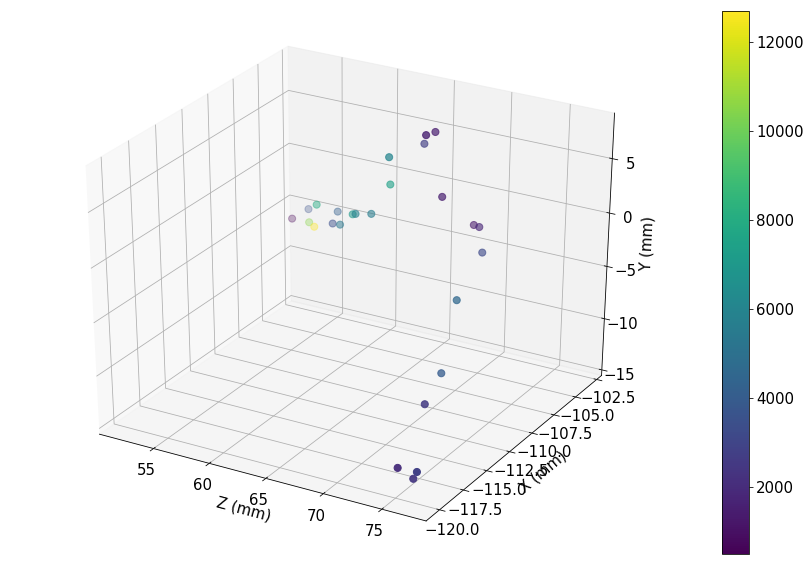

In [9]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

evts     = list(set(group.groups))
nhits    = group.time.count().values
index    = np.argsort(nhits)[-2]
evt      = evts[index]
data     = group.get_group(evt)
mappable = ax.scatter(data.Z, data.X, data.Y, c=data.E, s=50)
print(nhits[index], full[full.event == evt].E.sum())

fig.set_size_inches(15, 10)
fig.colorbar(mappable)
ax.set_xlabel('Z (mm)')
ax.set_ylabel('X (mm)')
ax.set_zlabel('Y (mm)')

6     25
7     25
8     25
9     25
10    25
11    25
12    25
13    25
14    25
15    25
16    25
17    25
18    25
19    25
20    25
21    25
22    25
23    25
24    25
Name: Nsipm, dtype: uint16


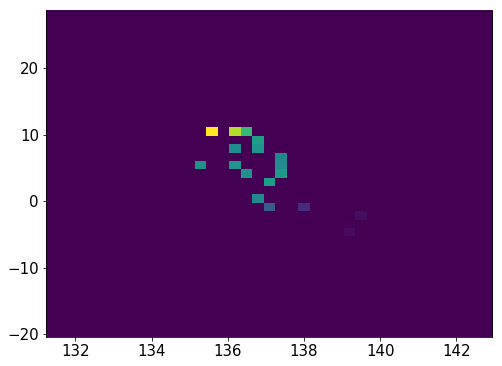

1898275    27
1898276    27
1898277    27
1898278    27
1898279    27
1898280    27
1898281    27
1898282    27
1898283    27
1898284    27
1898285    27
1898286    27
1898288    27
1898289    27
1898290    27
1898291    27
1898294    27
1898295    27
1898296    27
1898297    27
1898298    27
1898299    27
Name: Nsipm, dtype: uint16


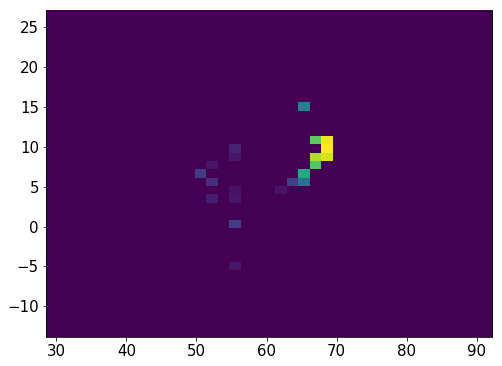

931772    25
931773    25
931774    25
931780    25
931781    25
931782    25
931783    25
931784    25
931785    25
931786    25
931787    25
931788    25
931789    25
Name: Nsipm, dtype: uint16


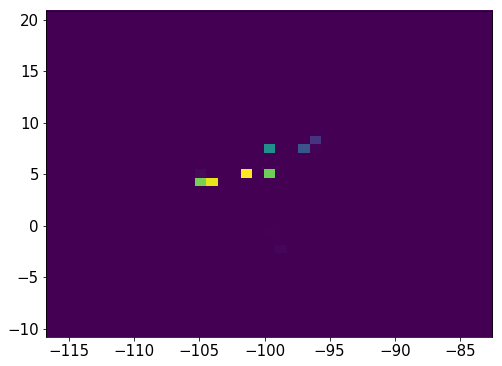

931791    30
931792    30
931793    30
931794    30
931795    30
931796    30
931797    30
931798    30
931799    30
931800    30
931801    30
931802    30
931803    30
931804    30
931805    30
931812    30
931813    30
931814    30
931815    30
Name: Nsipm, dtype: uint16


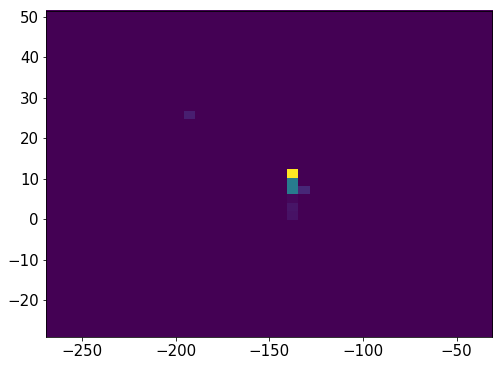

931820    30
931821    30
931822    30
931823    30
931824    30
931825    30
931826    30
931827    30
931828    30
931829    30
931830    30
931831    30
931832    30
931833    30
931834    30
931835    30
931836    30
931837    30
931838    30
931839    30
Name: Nsipm, dtype: uint16


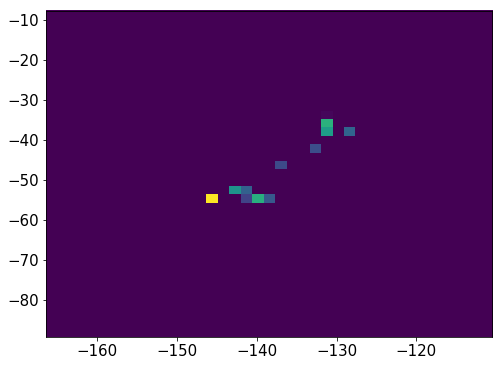

32    29
33    29
34    29
35    29
36    29
37    29
38    29
39    29
40    29
41    29
42    29
43    29
44    29
45    29
46    29
Name: Nsipm, dtype: uint16


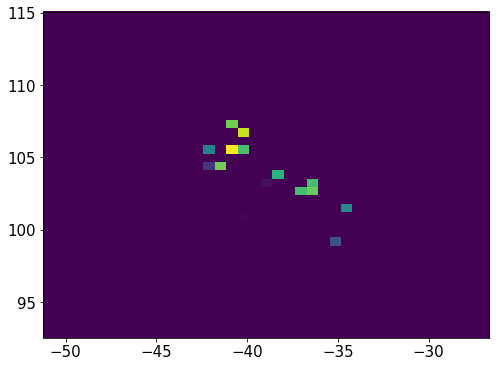

931844    34
931845    34
931846    34
931847    34
931848    34
931849    34
931850    34
931851    34
931852    34
931853    34
931854    34
931855    34
931856    34
931857    34
931858    34
Name: Nsipm, dtype: uint16


Exception ignored in: 'zmq.backend.cython.message.Frame.__dealloc__'
Traceback (most recent call last):
  File "zmq/backend/cython/checkrc.pxd", line 12, in zmq.backend.cython.checkrc._check_rc (zmq/backend/cython/message.c:4294)
KeyboardInterrupt


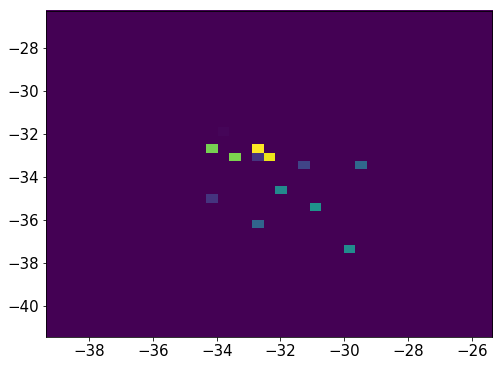

51    20
52    20
53    20
54    20
55    20
56    20
57    20
58    20
59    20
60    20
61    20
62    20
63    20
64    20
65    20
66    20
67    20
69    20
70    20
71    20
72    20
73    20
74    20
75    20
76    20
77    20
78    20
79    20
80    20
81    20
82    20
83    20
Name: Nsipm, dtype: uint16


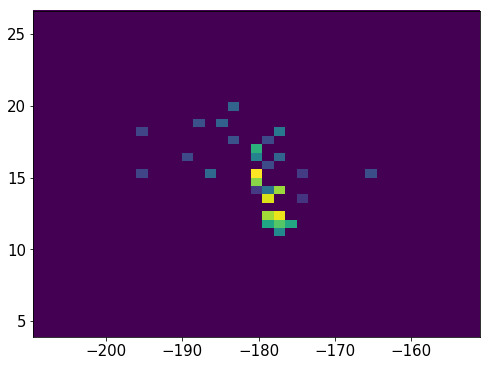

88     25
89     25
90     25
91     25
92     25
93     25
94     25
95     25
96     25
97     25
98     25
99     25
100    25
101    25
102    25
103    25
104    25
105    25
106    25
Name: Nsipm, dtype: uint16


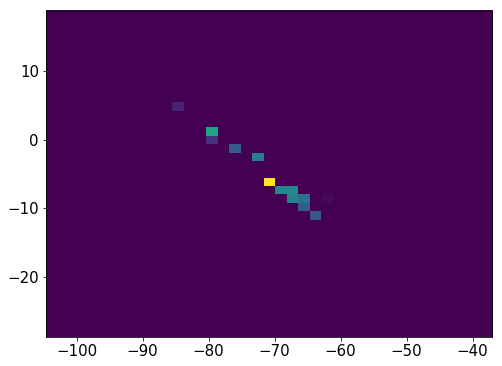

931863    32
931864    32
931865    32
931866    32
931867    32
931868    32
931869    32
931870    32
931871    32
931872    32
931873    32
931874    32
931875    32
931876    32
931877    32
Name: Nsipm, dtype: uint16


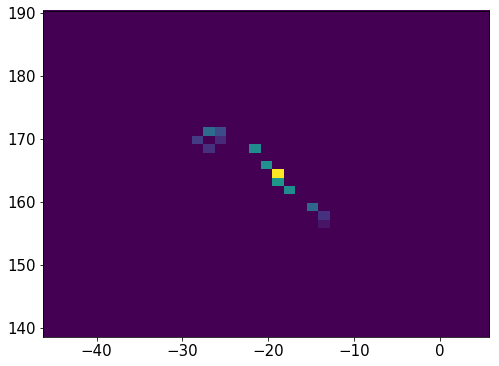

931881    25
931882    25
931883    25
931884    25
931885    25
931886    25
931887    25
931888    25
931889    25
931890    25
931891    25
931892    25
931893    25
931894    25
931895    25
931896    25
931897    25
Name: Nsipm, dtype: uint16


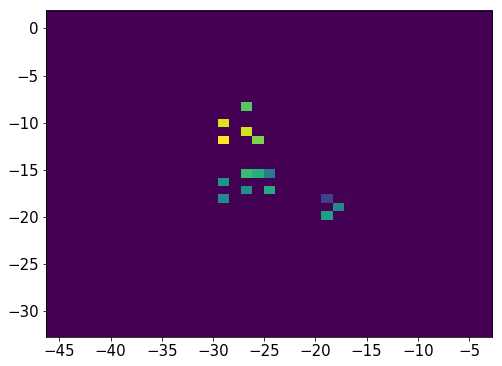

931902    25
931903    25
931904    25
931905    25
931906    25
931907    25
931908    25
931909    25
931910    25
931911    25
931912    25
931913    25
931914    25
931915    25
931916    25
931917    25
931918    25
931919    25
931920    25
931921    25
931922    25
931923    25
931924    25
931925    25
931926    25
931930     3
931931     3
931932     3
931933     3
931934     3
931935     3
931936     3
931937     3
931938     3
931939     3
931940     3
Name: Nsipm, dtype: uint16


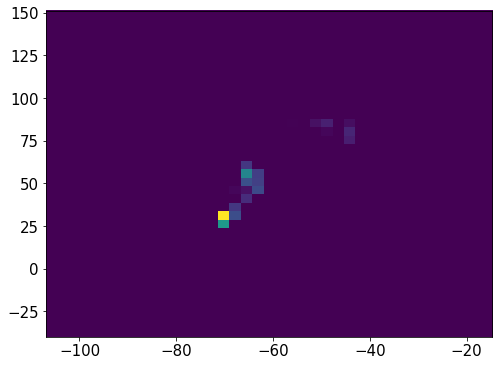

1898305    27
1898306    27
1898307    27
1898308    27
1898309    27
1898310    27
1898311    27
1898312    27
1898313    27
1898314    27
1898315    27
1898316    27
1898317    27
1898318    27
1898319    27
1898321    27
Name: Nsipm, dtype: uint16


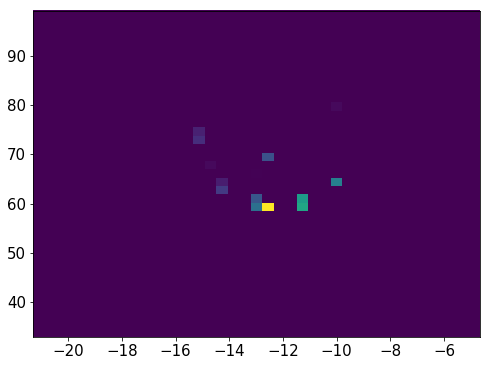

110    21
111    21
112    21
113    21
114    21
115    21
116    21
117    21
118    21
119    21
120    21
121    21
122    21
123    21
124    21
125    21
126    21
127    21
128    21
129    21
130    21
131    21
132    21
133    21
Name: Nsipm, dtype: uint16


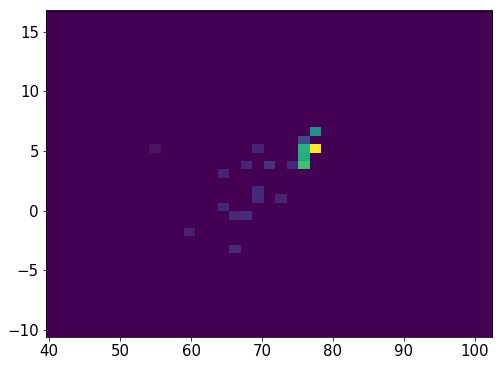

137    23
138    23
139    23
140    23
141    23
142    23
143    23
144    23
145    23
146    23
147    23
148    23
149    23
150    23
151    23
152    23
153    23
154    23
155    23
156    23
157    23
158    23
159    23
160    23
161    23
162    23
Name: Nsipm, dtype: uint16


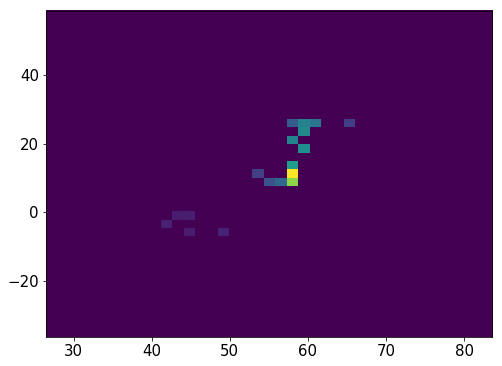

166    20
167    20
168    20
169    20
170    20
171    20
172    20
173    20
174    20
175    20
176    20
177    20
178    20
179    20
180    20
181    20
182    20
183    20
Name: Nsipm, dtype: uint16


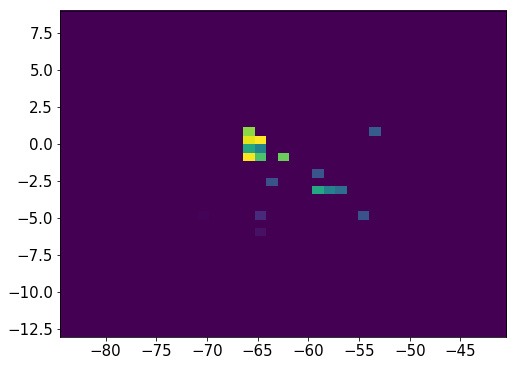

931945    27
931946    27
931947    27
931948    27
931949    27
931950    27
931951    27
931952    27
931953    27
931954    27
931955    27
931956    27
931957    27
931958    27
931959    27
931960    27
931961    27
931962    27
931963    27
Name: Nsipm, dtype: uint16


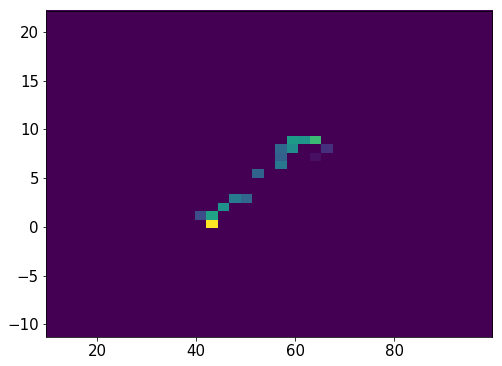

931967    31
931968    31
931969    31
931970    31
931971    31
931972    31
931973    31
931974    31
931975    31
931976    31
931977    31
931978    31
931979    31
931980    31
931981    31
Name: Nsipm, dtype: uint16


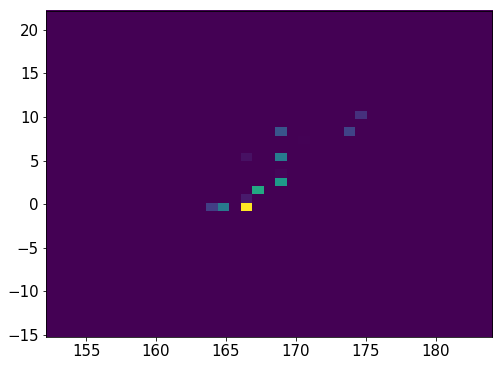

189    38
190    38
191    38
192    38
193    38
195    38
197    38
198    38
199    38
200    38
201    38
202    38
203    38
204    38
205    38
206    38
207    38
208    38
209    38
210    38
211    38
212    38
213    38
214    38
215    38
216    38
217    38
218    38
219    38
220    38
221    38
222    38
223    38
Name: Nsipm, dtype: uint16


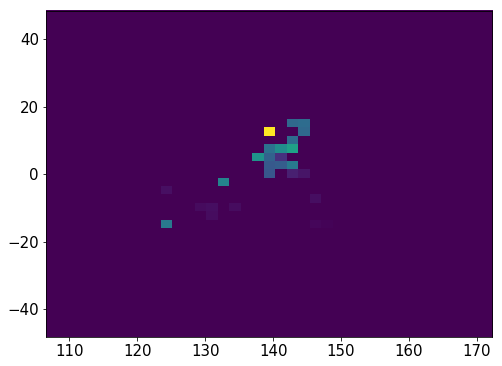

224    23
225    23
226    23
227    23
228    23
229    23
230    23
231    23
232    23
233    23
234    23
235    23
236    23
237    23
238    23
Name: Nsipm, dtype: uint16


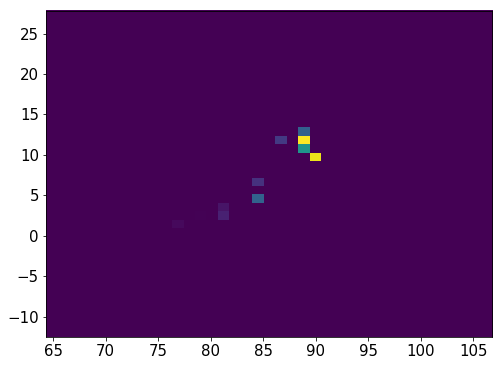

932075    27
932076    27
932077    27
932078    27
932079    27
932080    27
932081    27
932082    27
932083    27
932084    27
932085    27
932086    27
932087    27
932088    27
932089    27
932090    27
932091    27
932092    27
932093    27
932094    27
Name: Nsipm, dtype: uint16


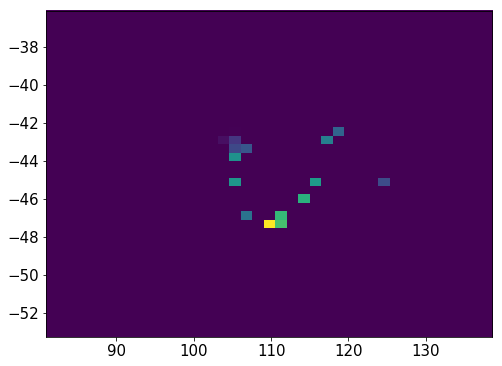

243    27
244    27
245    27
246    27
247    27
248    27
249    27
250    27
251    27
252    27
253    27
254    27
255    27
256    27
Name: Nsipm, dtype: uint16


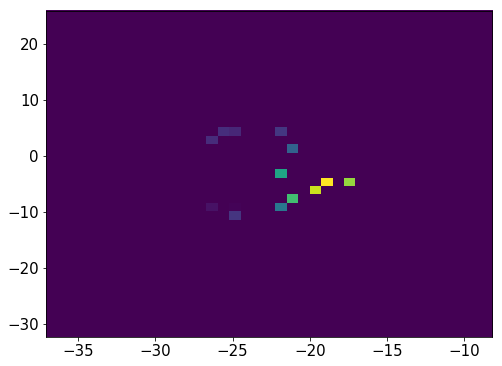

932137    25
932138    25
932139    25
932140    25
932141    25
932142    25
932143    25
932144    25
932145    25
932146    25
932147    25
932148    25
932149    25
932150    25
932151    25
932152    25
932153    25
932154    25
932155    25
932156    25
932157    25
Name: Nsipm, dtype: uint16


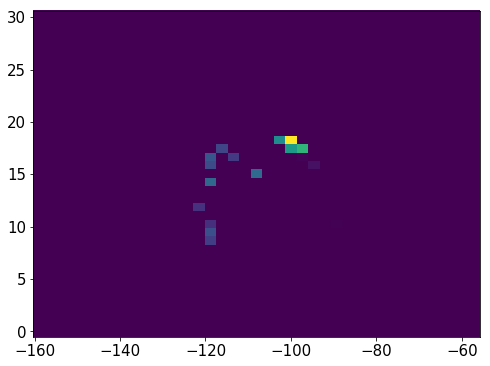

261    26
262    26
263    26
264    26
265    26
266    26
267    26
268    26
269    26
270    26
271    26
272    26
273    26
274    26
275    26
276    26
Name: Nsipm, dtype: uint16


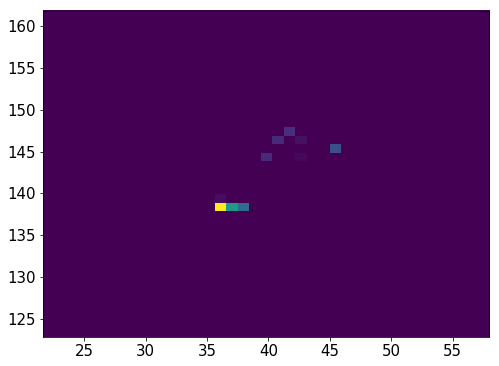

932162    27
932163    27
932164    27
932165    27
932166    27
932167    27
932168    27
932169    27
932170    27
932171    27
932172    27
932173    27
932174    27
932175    27
932176    27
932177    27
Name: Nsipm, dtype: uint16


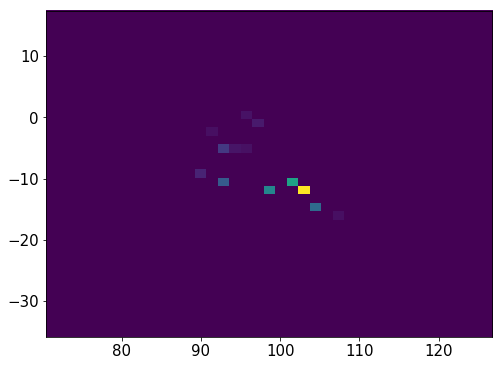

280    29
281    29
282    29
283    29
284    29
285    29
286    29
287    29
288    29
289    29
290    29
Name: Nsipm, dtype: uint16


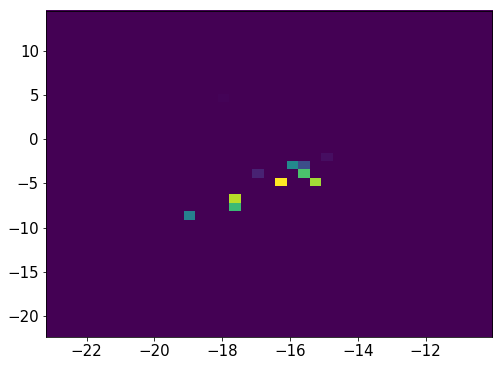

932183    21
932184    21
932185    21
932186    21
932187    21
932188    21
932189    21
932190    21
932191    21
932192    21
932193    21
932194    21
932195    21
932196    21
932197    21
932198    21
932199    21
932209     5
932210     5
932211     5
932212     5
932213     5
932214     5
932215     5
932216     5
932217     5
932218     5
Name: Nsipm, dtype: uint16


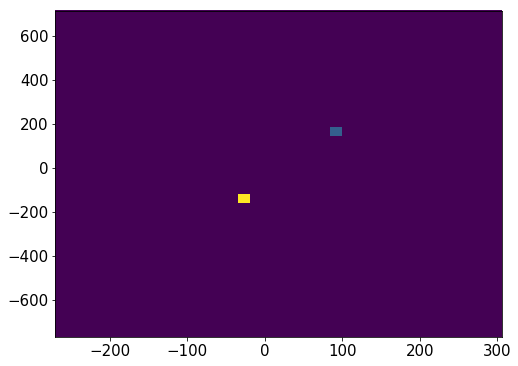

1514466    30
1514467    30
1514468    30
1514469    30
1514470    30
1514471    30
1514472    30
1514473    30
1514474    30
1514475    30
1514476    30
1514477    30
1514478    30
1514479    30
1514480    30
1514481    30
1514482    30
1514483    30
1514484    30
1514485    30
1514486    30
Name: Nsipm, dtype: uint16


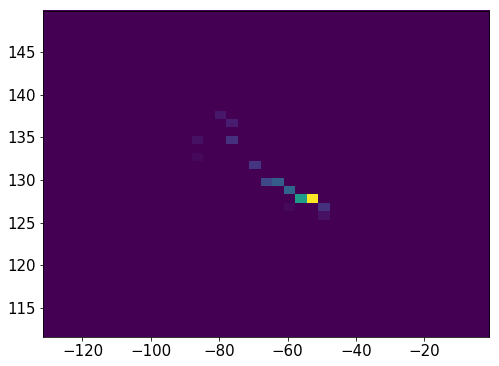

932221    25
932222    25
932223    25
932224    25
932225    25
932226    25
932227    25
932228    25
932229    25
932230    25
932231    25
932232    25
932233    25
932234    25
Name: Nsipm, dtype: uint16


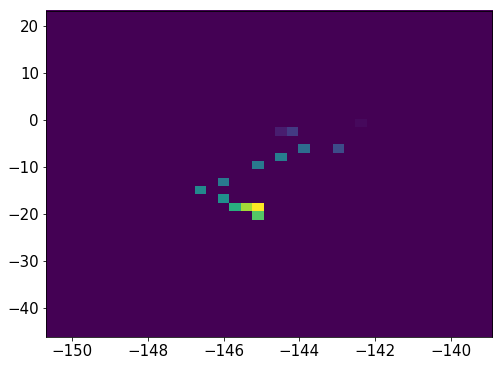

932239    24
932240    24
932241    24
932242    24
932243    24
932244    24
932245    24
932246    24
932247    24
932248    24
932249    24
932250    24
932251    24
932252    24
932253    24
932254    24
932255    24
932256    24
Name: Nsipm, dtype: uint16


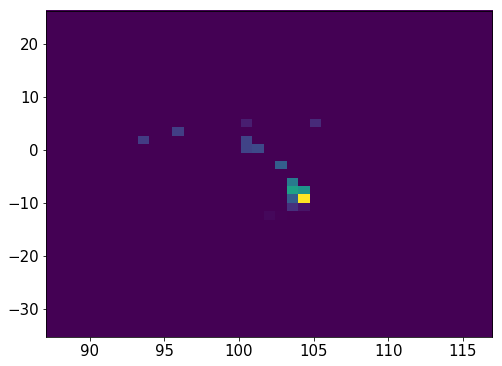

2138841    38
2138842    38
2138843    38
2138844    38
2138845    38
2138846    38
2138847    38
2138848    38
2138849    38
2138850    38
2138851    38
2138852    38
2138853    38
2138854    38
2138855    38
2138856    38
2138857    38
Name: Nsipm, dtype: uint16


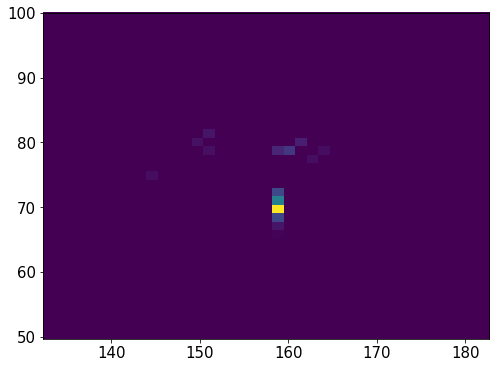

932261    28
932262    28
932263    28
932264    28
932265    28
932266    28
932267    28
932268    28
932269    28
932270    28
932271    28
932272    28
932273    28
932274    28
Name: Nsipm, dtype: uint16


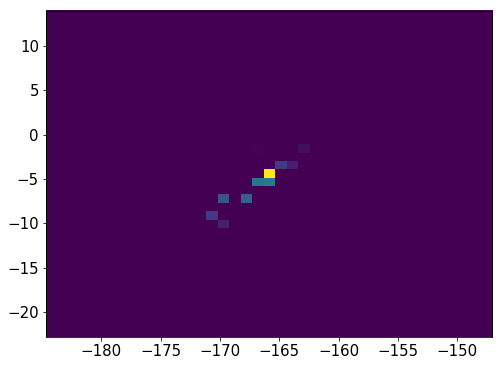

295    34
296    34
297    34
298    34
299    34
300    34
301    34
302    34
303    34
304    34
305    34
306    34
307    34
308    34
309    34
310    34
311    34
312    34
313    34
314    34
315    34
316    34
317    34
318    34
Name: Nsipm, dtype: uint16


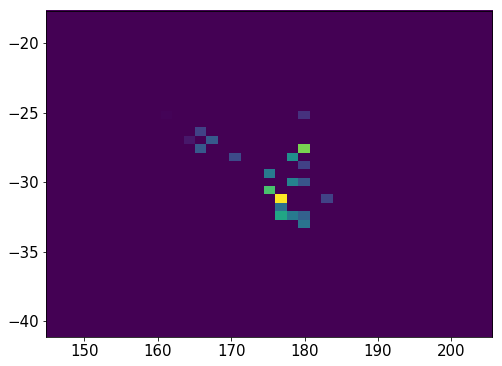

932306    23
932307    23
932308    23
932309    23
932310    23
932311    23
932312    23
932313    23
932314    23
932315    23
932316    23
932317    23
932318    23
932319    23
932320    23
932321    23
932322    23
932323    23
932324    23
932329     1
932330     1
932331     1
932332     1
932334     1
Name: Nsipm, dtype: uint16


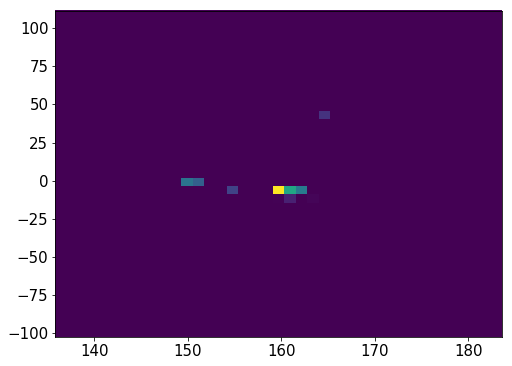

932339    24
932340    24
932341    24
932342    24
932343    24
932344    24
932345    24
932346    24
932347    24
932348    24
932349    24
932350    24
932351    24
932352    24
932353    24
932354    24
932355    24
932356    24
932357    24
Name: Nsipm, dtype: uint16


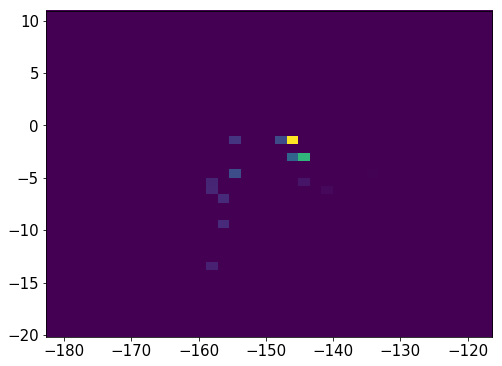

323    27
324    27
325    27
326    27
327    27
328    27
329    27
330    27
331    27
332    27
Name: Nsipm, dtype: uint16


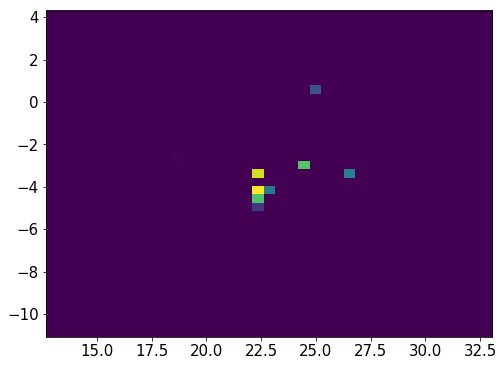

932362    20
932363    20
932364    20
932365    20
932366    20
932367    20
932368    20
932369    20
932370    20
932371    20
932372    20
932373    20
932374    20
932375    20
932376    20
932377    20
932378    20
932379    20
932380    20
932381    20
932382    20
932383    20
932384    20
932385    20
932386    20
932387    20
932388    20
932389    20
932390    20
932391    20
932392    20
932393    20
Name: Nsipm, dtype: uint16


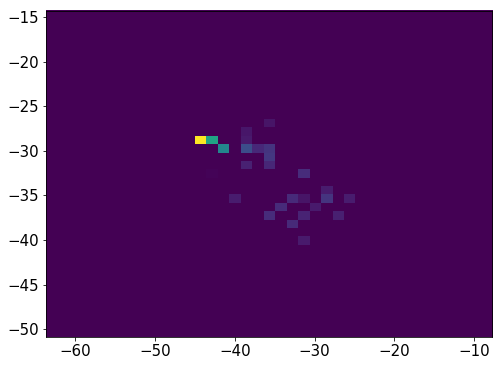

932398    21
932399    21
932400    21
932401    21
932402    21
932403    21
932404    21
932405    21
932406    21
932407    21
932408    21
932409    21
932410    21
932411    21
932412    21
932413    21
932414    21
932415    21
932416    21
932417    21
932418    21
932419    21
932420    21
932421    21
932422    21
932423    21
Name: Nsipm, dtype: uint16


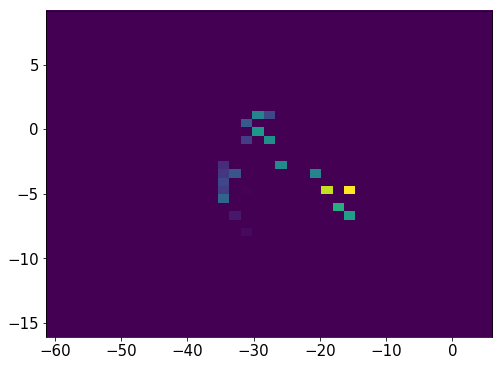

932428    31
932429    31
932430    31
932431    31
932432    31
932433    31
932434    31
932435    31
932436    31
932437    31
932438    31
932439    31
932440    31
932441    31
932442    31
932443    31
932444    31
932445    31
932446    31
932447    31
932448    31
932449    31
932450    31
932451    31
932452    31
932453    31
932454    31
932458    31
932459    31
932460    31
932461    31
932462    31
932463    31
932464    31
932465    31
932466    31
932467    31
932468    31
932469    31
932470    31
932471    31
932472    31
932473    31
932474    31
Name: Nsipm, dtype: uint16


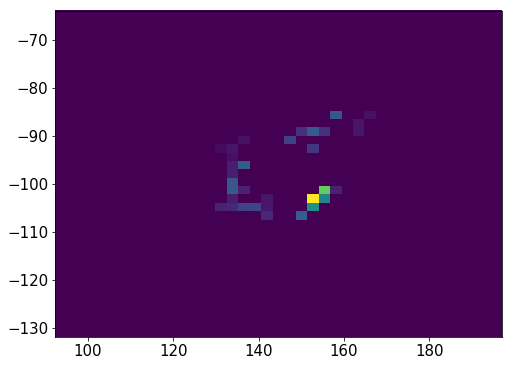

932480    19
932481    19
932482    19
932483    19
932484    19
932485    19
932486    19
932487    19
932488    19
932489    19
932490    19
932491    19
932492    19
932493    19
932494    19
932495    19
932496    19
Name: Nsipm, dtype: uint16


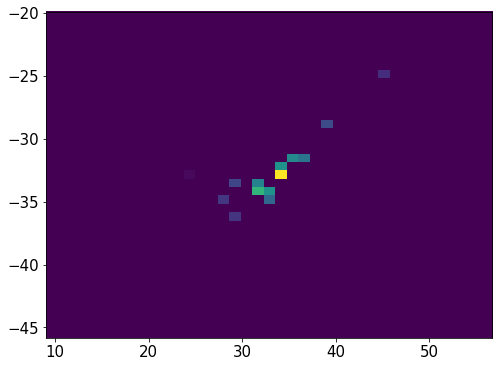

337    20
338    20
339    20
340    20
341    20
342    20
343    20
344    20
345    20
346    20
347    20
348    20
349    20
350    20
Name: Nsipm, dtype: uint16


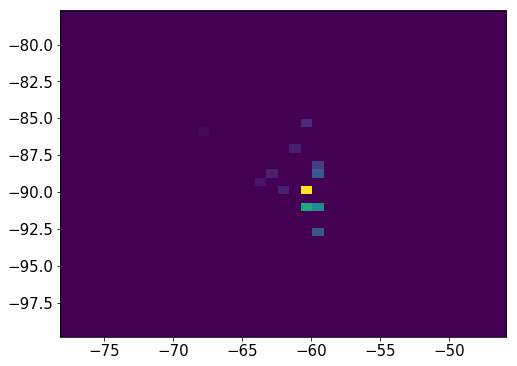

354    28
355    28
356    28
357    28
358    28
359    28
360    28
361    28
362    28
363    28
364    28
365    28
366    28
367    28
368    28
369    28
Name: Nsipm, dtype: uint16


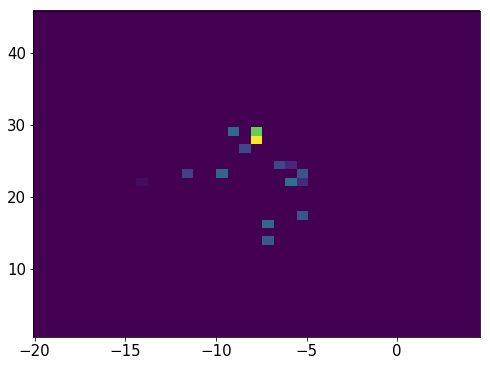

1662990    38
1662991    38
1662992    38
1662993    38
1662994    38
1662995    38
1662996    38
1662997    38
1662998    38
1662999    38
1663000    38
Name: Nsipm, dtype: uint16


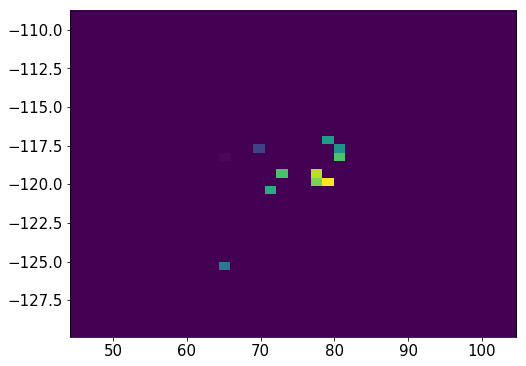

932500    26
932501    26
932502    26
932503    26
932504    26
932505    26
932506    26
932507    26
932508    26
932509    26
932510    26
932511    26
932512    26
932513    26
932514    26
932515    26
932516    26
932517    26
932518    26
Name: Nsipm, dtype: uint16


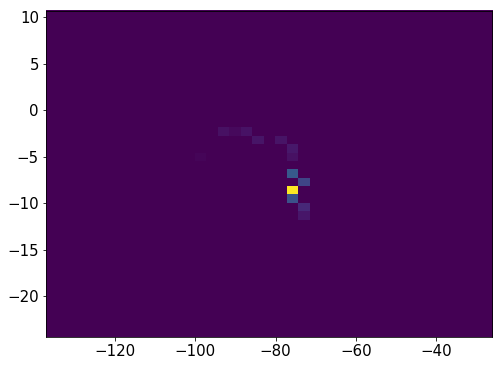

373    24
374    24
375    24
376    24
377    24
378    24
379    24
380    24
381    24
382    24
383    24
384    24
385    24
386    24
387    24
388    24
389    24
390    24
391    24
392    24
393    24
394    24
Name: Nsipm, dtype: uint16


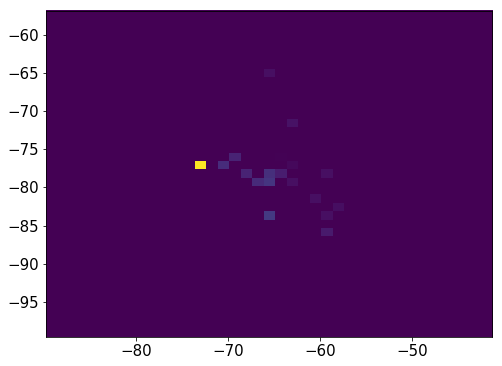

932522    24
932523    24
932524    24
932525    24
932526    24
932527    24
932528    24
932529    24
932530    24
932531    24
932535    11
932536    11
932537    11
932538    11
932539    11
932540    11
Name: Nsipm, dtype: uint16


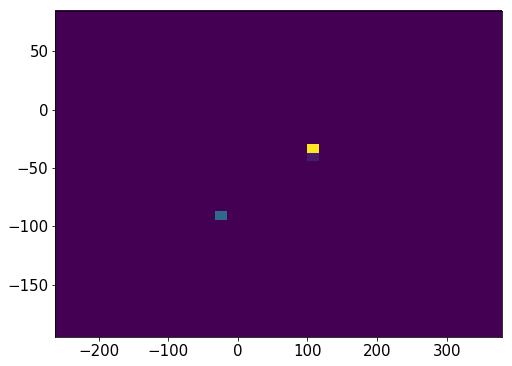

399    28
400    28
401    28
402    28
403    28
404    28
405    28
406    28
407    28
408    28
409    28
410    28
411    28
412    28
Name: Nsipm, dtype: uint16


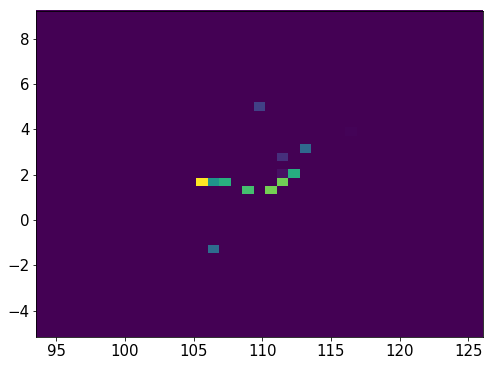

932543    30
932544    30
932545    30
932546    30
932547    30
932548    30
932549    30
932550    30
932551    30
932552    30
932553    30
932554    30
932555    30
932556    30
932557    30
932558    30
932559    30
Name: Nsipm, dtype: uint16


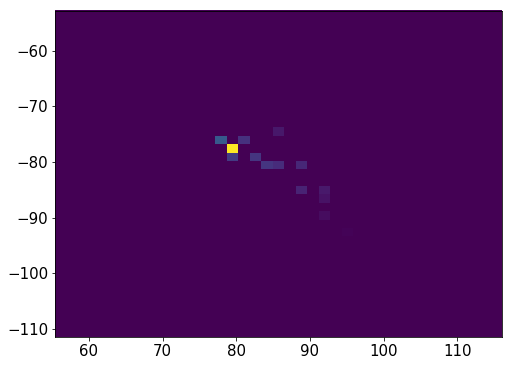

932563    28
932564    28
932565    28
932566    28
932567    28
932568    28
932569    28
932570    28
932571    28
932572    28
932573    28
932574    28
932575    28
932576    28
932577    28
932578    28
932579    28
932580    28
932581    28
932582    28
Name: Nsipm, dtype: uint16


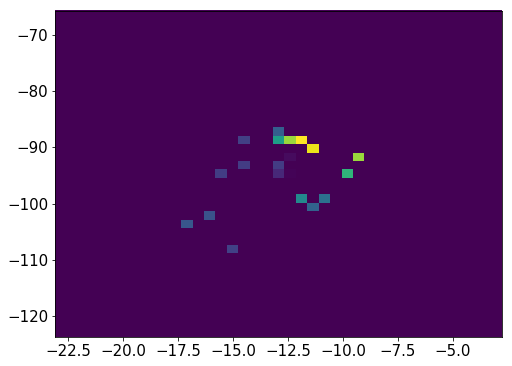

932587    48
932588    48
932589    48
932590    48
932591    48
932592    48
932595    48
932596    48
932597    48
932598    48
932599    48
932600    48
932601    48
932602    48
932603    48
932604    48
932605    48
932606    48
932607    48
932608    48
932609    48
932610    48
932611    48
932612    48
932613    48
932614    48
932615    48
932616    48
932617    48
932618    48
932619    48
932620    48
932621    48
932622    48
932623    48
Name: Nsipm, dtype: uint16


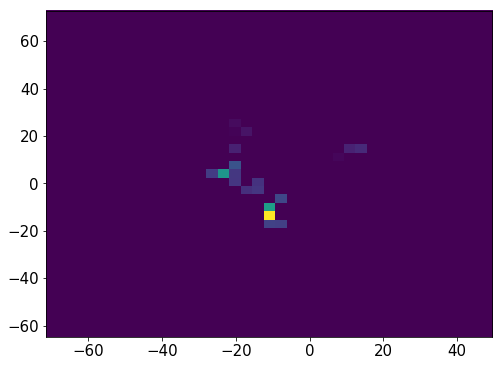

932624    35
932625    35
932626    35
932627    35
932628    35
932629    35
932630    35
932631    35
932632    35
932633    35
932634    35
932635    35
932641    35
932642    35
932643    35
932644    35
932645    35
Name: Nsipm, dtype: uint16


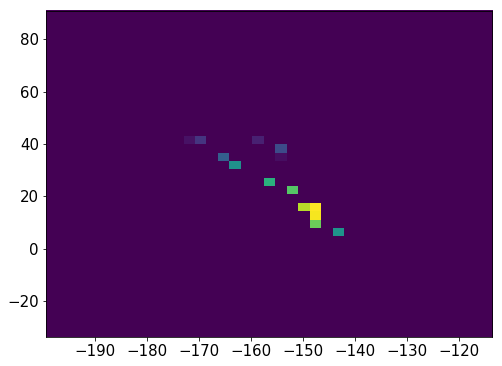

932649    29
932650    29
932651    29
932652    29
932653    29
932654    29
932655    29
932656    29
932657    29
932658    29
932659    29
932660    29
932661    29
932662    29
932663    29
932664    29
Name: Nsipm, dtype: uint16


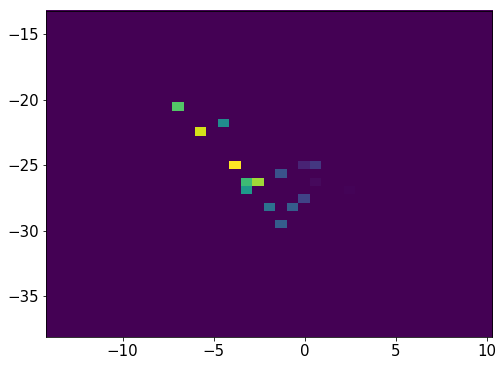

448    22
449    22
450    22
451    22
452    22
453    22
454    22
455    22
456    22
457    22
458    22
459    22
460    22
461    22
462    22
463    22
464    22
465    22
466    22
Name: Nsipm, dtype: uint16


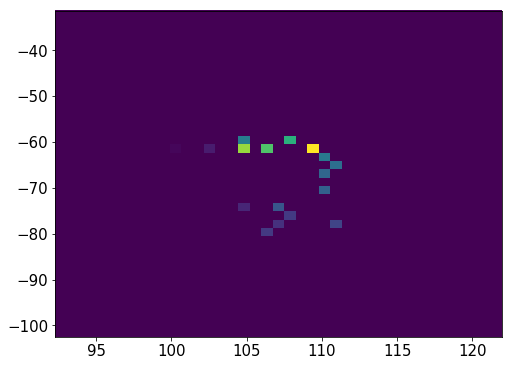

470    23
471    23
472    23
473    23
474    23
475    23
476    23
477    23
478    23
479    23
480    23
481    23
482    23
483    23
484    23
Name: Nsipm, dtype: uint16


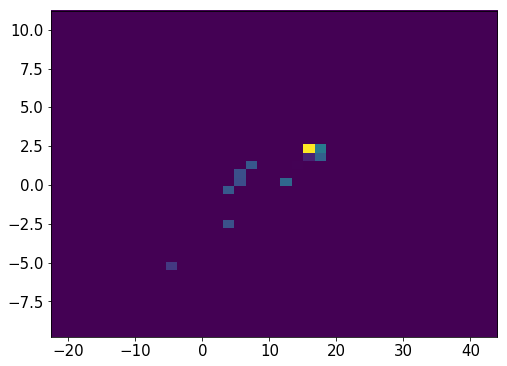

932669    25
932670    25
932671    25
932672    25
932673    25
932674    25
932675    25
932676    25
932677    25
932678    25
932679    25
Name: Nsipm, dtype: uint16


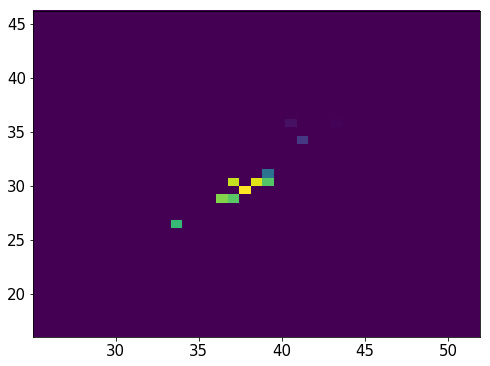

932685    22
932686    22
932687    22
932688    22
932689    22
932690    22
932691    22
932692    22
932697    10
932698    10
932699    10
932700    10
932701    10
932702    10
932703    10
932704    10
932705    10
932706    10
932707    10
932708    10
932709    10
932710    10
932711    10
932712    10
932713    10
932717     9
932718     9
932719     9
932720     9
932721     9
932722     9
932723     9
932724     9
932725     9
932726     9
932727     9
932728     9
932729     9
932730     9
932731     9
Name: Nsipm, dtype: uint16


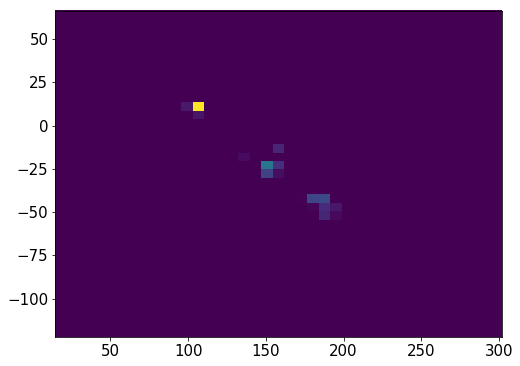

538    20
539    20
540    20
541    20
542    20
543    20
544    20
545    20
546    20
547    20
548    20
549    20
550    20
Name: Nsipm, dtype: uint16


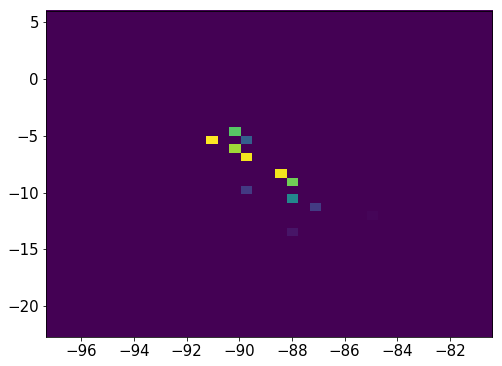

932736    35
932737    35
932738    35
932739    35
932740    35
932741    35
932742    35
932743    35
932744    35
932745    35
932750     2
932751     2
932752     2
932753     2
932758     6
932759     6
932760     6
932761     6
932762     6
932763     6
932764     6
Name: Nsipm, dtype: uint16


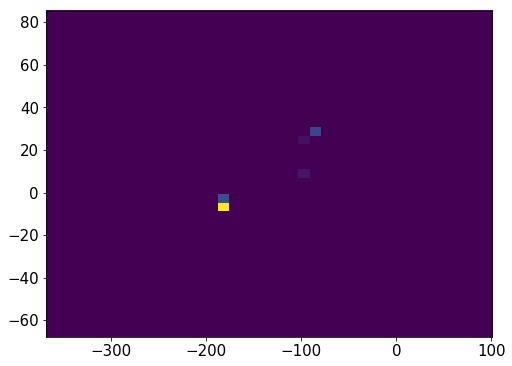

555    23
556    23
557    23
558    23
559    23
560    23
561    23
562    23
563    23
564    23
565    23
566    23
567    23
568    23
569    23
570    23
571    23
572    23
573    23
574    23
Name: Nsipm, dtype: uint16


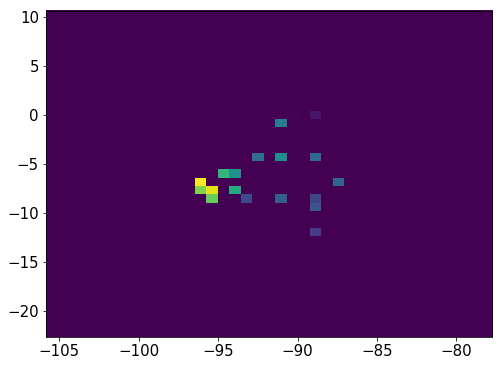

580    26
581    26
582    26
583    26
584    26
585    26
586    26
587    26
588    26
589    26
590    26
591    26
592    26
593    26
594    26
Name: Nsipm, dtype: uint16


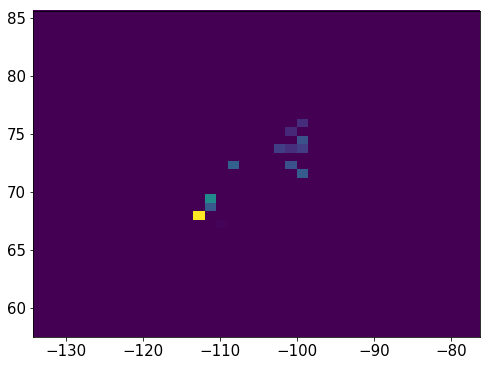

599    17
600    17
601    17
602    17
603    17
604    17
605    17
606    17
607    17
608    17
609    17
610    17
611    17
612    17
613    17
617     2
618     2
619     2
620     2
626    10
627    10
628    10
629    10
630    10
631    10
632    10
633    10
Name: Nsipm, dtype: uint16


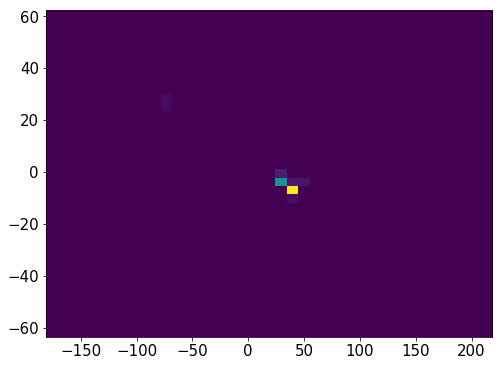

638    29
639    29
640    29
641    29
642    29
643    29
644    29
645    29
646    29
647    29
648    29
Name: Nsipm, dtype: uint16


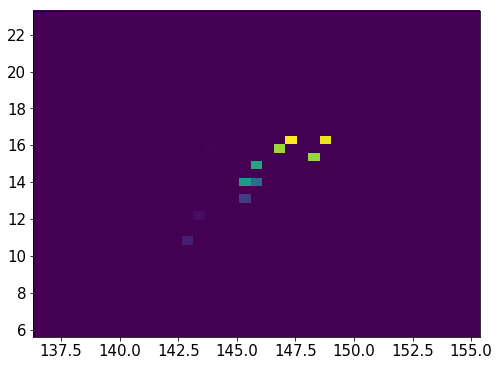

932784    24
932785    24
932786    24
932787    24
932788    24
932789    24
932790    24
932791    24
932792    24
932793    24
932794    24
932795    24
932796    24
932797    24
932798    24
932799    24
932800    24
932801    24
932802    24
932803    24
932804    24
932805    24
932806    24
932807    24
932815     6
932816     6
932817     6
932819     6
932821     6
932822     6
932823     6
932824     6
932825     6
932826     6
932827     6
Name: Nsipm, dtype: uint16


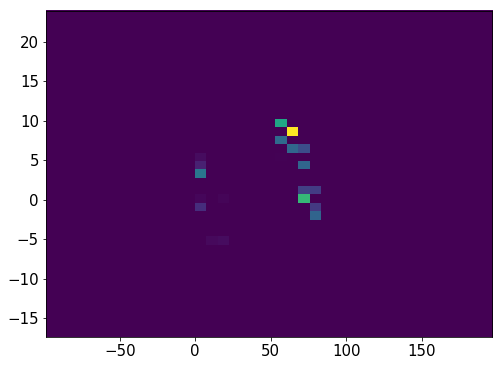

932833    21
932834    21
932835    21
932836    21
932837    21
932838    21
932839    21
932840    21
932841    21
932842    21
932843    21
932844    21
932845    21
932846    21
932847    21
932848    21
932849    21
932850    21
Name: Nsipm, dtype: uint16


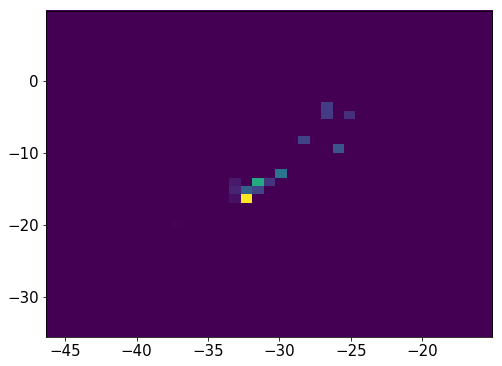

653    27
654    27
655    27
656    27
657    27
658    27
659    27
660    27
661    27
662    27
663    27
664    27
665    27
666    27
667    27
668    27
669    27
670    27
671    27
672    27
673    27
674    27
675    27
676    27
677    27
Name: Nsipm, dtype: uint16


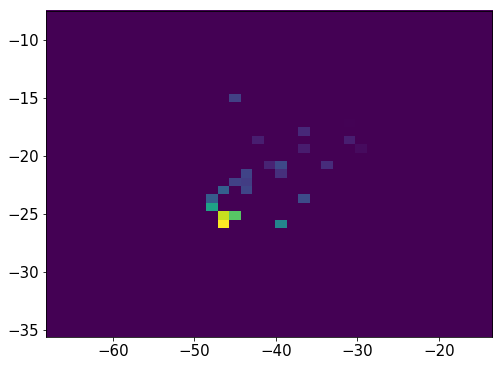

683    53
684    53
685    53
686    53
687    53
688    53
689    53
690    53
691    53
692    53
693    53
694    53
695    53
696    53
697    53
698    53
699    53
700    53
701    53
702    53
703    53
704    53
705    53
706    53
707    53
708    53
709    53
710    53
711    53
712    53
713    53
Name: Nsipm, dtype: uint16


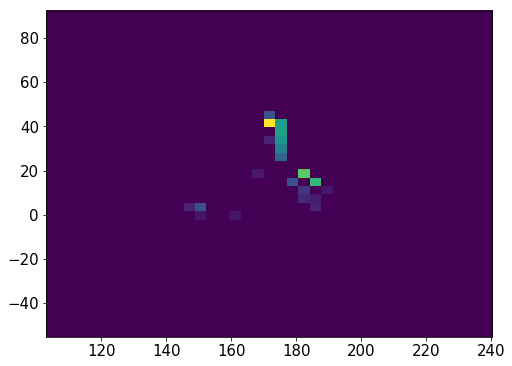

720    24
721    24
722    24
723    24
724    24
725    24
726    24
727    24
728    24
729    24
730    24
731    24
732    24
733    24
734    24
735    24
736    24
737    24
Name: Nsipm, dtype: uint16


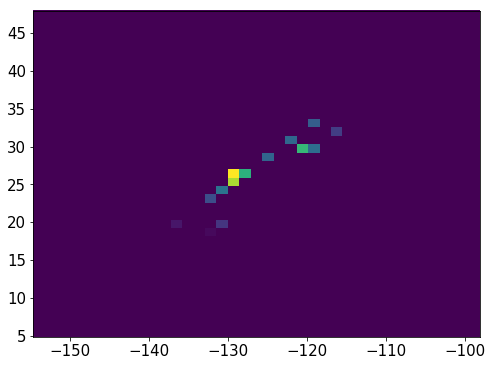

742    29
743    29
744    29
745    29
746    29
747    29
748    29
749    29
750    29
751    29
752    29
753    29
Name: Nsipm, dtype: uint16


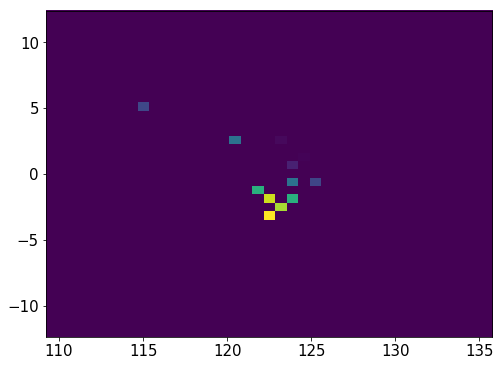

757    23
758    23
759    23
760    23
761    23
762    23
763    23
764    23
765    23
766    23
767    23
768    23
769    23
770    23
771    23
772    23
773    23
774    23
775    23
776    23
Name: Nsipm, dtype: uint16


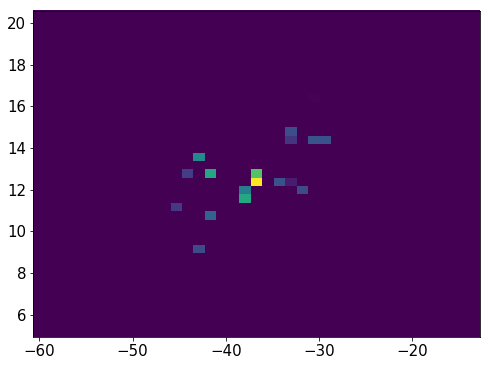

1898403    23
1898404    23
1898405    23
1898406    23
1898407    23
1898408    23
1898409    23
1898410    23
1898411    23
1898412    23
1898413    23
1898414    23
1898415    23
1898416    23
Name: Nsipm, dtype: uint16


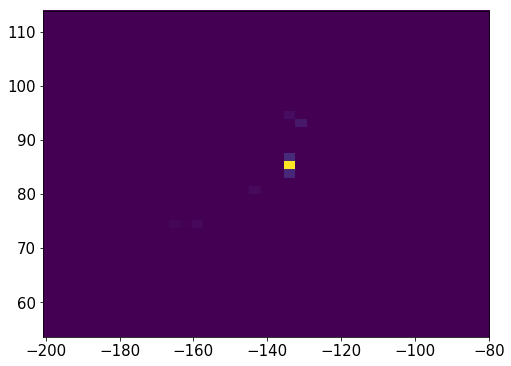

782    25
783    25
784    25
785    25
786    25
787    25
788    25
789    25
790    25
791    25
792    25
793    25
794    25
795    25
796    25
797    25
Name: Nsipm, dtype: uint16


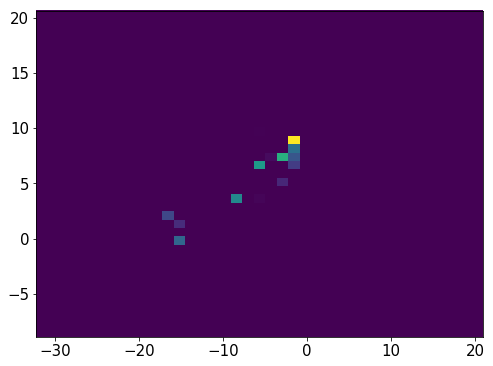

932910    25
932911    25
932912    25
932913    25
932914    25
932915    25
932916    25
932917    25
932918    25
932919    25
932920    25
932921    25
932922    25
932923    25
932924    25
932925    25
932926    25
932927    25
932928    25
932929    25
932930    25
932931    25
932932    25
932933    25
932934    25
932936    25
932937    25
932938    25
932939    25
932940    25
932941    25
932942    25
932943    25
Name: Nsipm, dtype: uint16


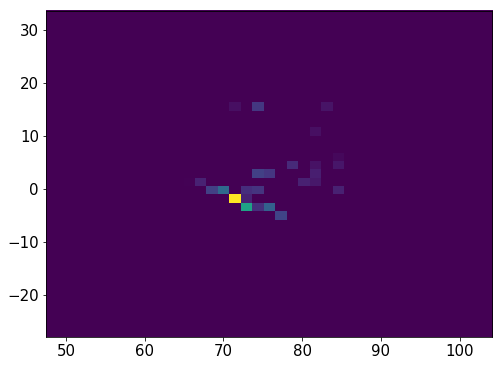

802    34
804    34
806    34
807    34
809    34
810    34
811    34
812    34
813    34
814    34
815    34
816    34
817    34
818    34
819    34
820    34
821    34
822    34
823    34
824    34
825    34
826    34
827    34
828    34
829    34
Name: Nsipm, dtype: uint16


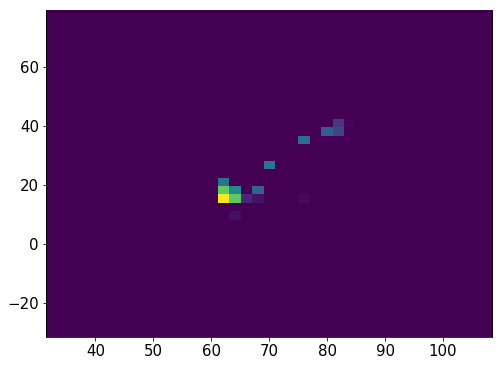

830    24
831    24
832    24
833    24
834    24
835    24
836    24
837    24
838    24
839    24
840    24
841    24
842    24
843    24
844    24
845    24
846    24
Name: Nsipm, dtype: uint16


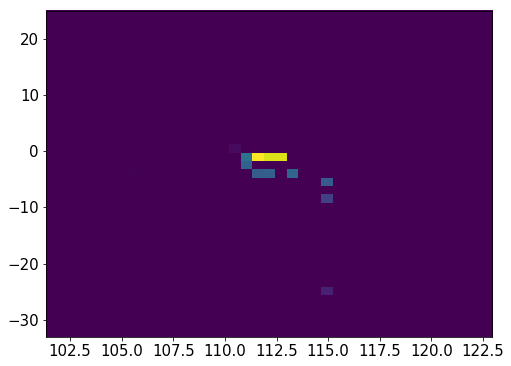

932967    33
932968    33
932969    33
932970    33
932971    33
932972    33
932973    33
932974    33
932975    33
932976    33
Name: Nsipm, dtype: uint16


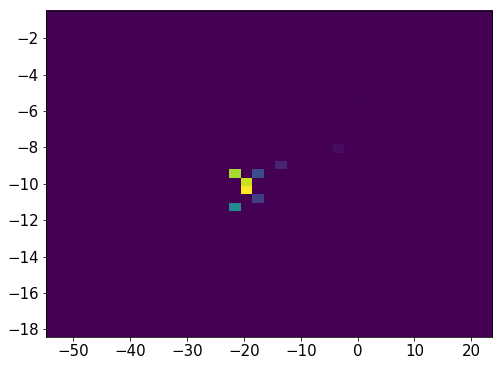

932980    33
932981    33
932982    33
932983    33
932984    33
932985    33
932986    33
932987    33
932988    33
932989    33
932990    33
932991    33
932992    33
932993    33
932994    33
932995    33
932996    33
932997    33
932998    33
932999    33
933000    33
933001    33
933002    33
933003    33
933004    33
Name: Nsipm, dtype: uint16


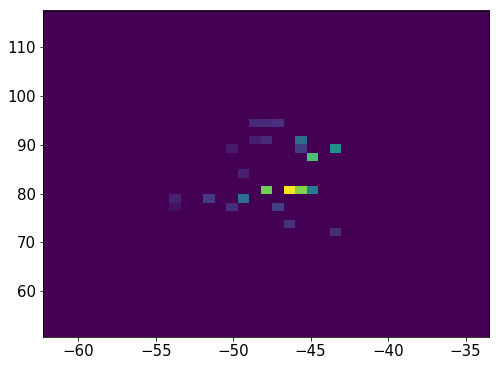

933008    21
933009    21
933010    21
933011    21
933012    21
933013    21
933014    21
933015    21
933016    21
933017    21
933018    21
933019    21
933020    21
933021    21
933022    21
933023    21
933024    21
933025    21
Name: Nsipm, dtype: uint16


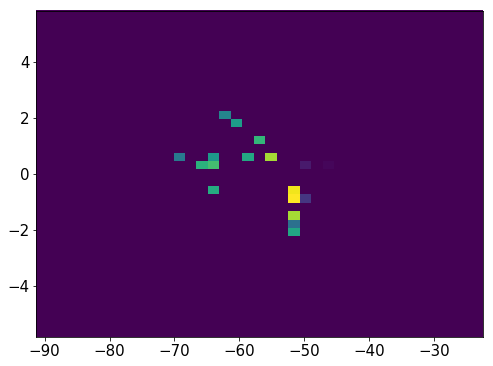

933030    23
933031    23
933032    23
933033    23
933034    23
933035    23
933036    23
933037    23
933038    23
933039    23
933040    23
933041    23
933042    23
933043    23
933044    23
933045    23
933046    23
933047    23
933048    23
933049    23
933050    23
933051    23
933052    23
933053    23
Name: Nsipm, dtype: uint16


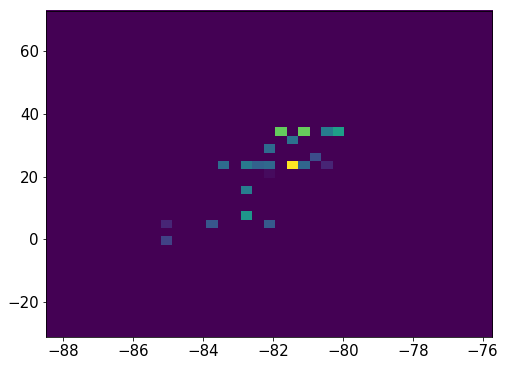

1898456    24
1898457    24
1898458    24
1898459    24
1898460    24
1898461    24
1898462    24
1898463    24
1898464    24
1898465    24
1898466    24
1898467    24
1898472     2
1898473     2
1898474     2
1898475     2
1898476     2
Name: Nsipm, dtype: uint16


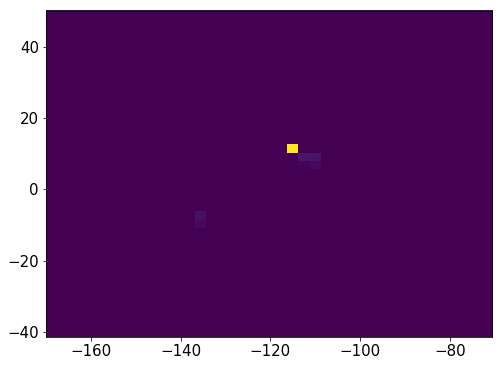

933057    34
933058    34
933059    34
933060    34
933061    34
933062    34
933063    34
933064    34
933065    34
933066    34
933067    34
933068    34
933069    34
933070    34
933071    34
933072    34
933073    34
933074    34
933075    34
933076    34
933077    34
933078    34
Name: Nsipm, dtype: uint16


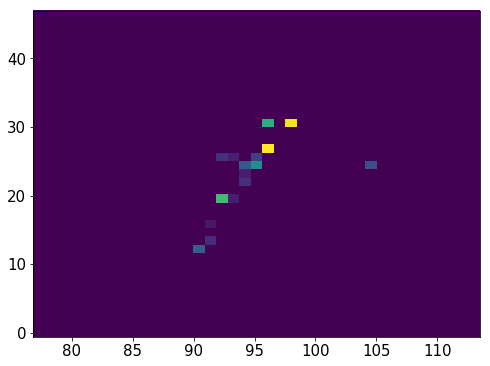

850    25
851    25
852    25
853    25
854    25
855    25
856    25
857    25
858    25
859    25
860    25
861    25
862    25
863    25
864    25
865    25
866    25
867    25
868    25
869    25
870    25
871    25
872    25
873    25
Name: Nsipm, dtype: uint16


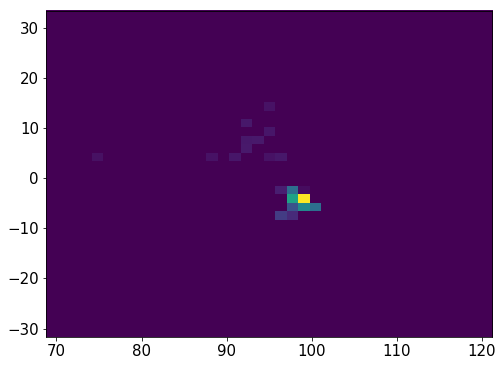

933083    24
933084    24
933085    24
933086    24
933087    24
933088    24
933089    24
933090    24
933091    24
933092    24
933093    24
933094    24
933095    24
933096    24
933097    24
933098    24
933099    24
933100    24
933101    24
933102    24
933103    24
933104    24
Name: Nsipm, dtype: uint16


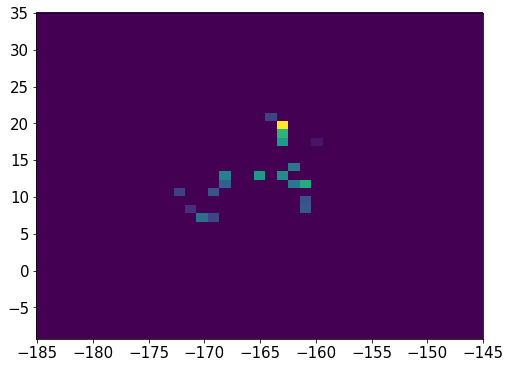

879    24
880    24
881    24
882    24
883    24
884    24
885    24
886    24
887    24
888    24
889    24
890    24
891    24
892    24
893    24
894    24
895    24
896    24
897    24
898    24
899    24
900    24
901    24
902    24
903    24
904    24
907     1
908     1
909     1
910     1
911     1
Name: Nsipm, dtype: uint16


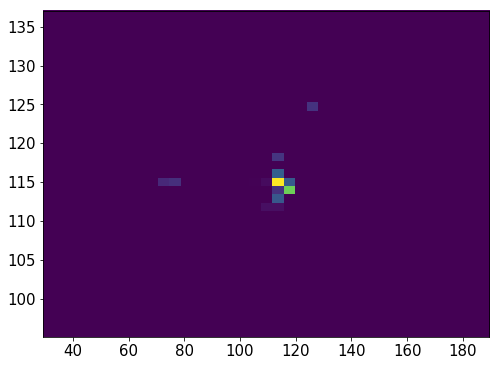

915    25
916    25
917    25
918    25
919    25
920    25
921    25
922    25
923    25
924    25
925    25
926    25
927    25
928    25
929    25
930    25
931    25
932    25
933    25
934    25
935    25
936    25
937    25
938    25
Name: Nsipm, dtype: uint16


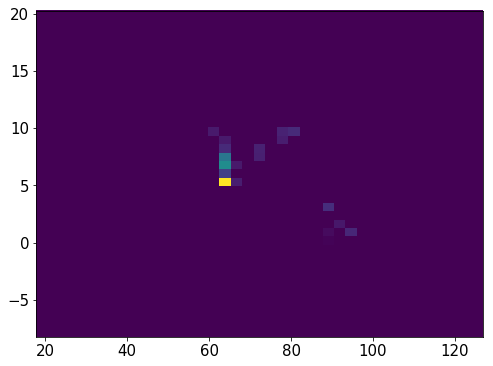

944    21
945    21
946    21
947    21
948    21
949    21
950    21
951    21
952    21
953    21
954    21
955    21
956    21
957    21
958    21
959    21
960    21
961    21
962    21
963    21
Name: Nsipm, dtype: uint16


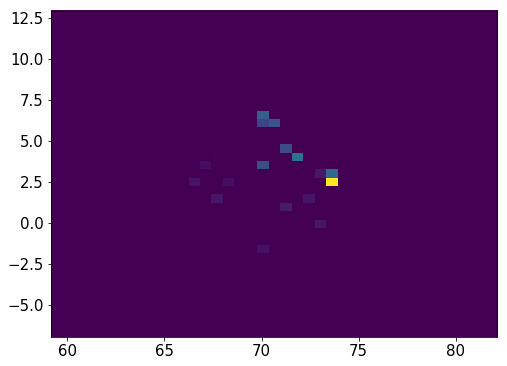

933110    29
933111    29
933112    29
933113    29
933114    29
933115    29
933116    29
933117    29
933118    29
933119    29
933120    29
Name: Nsipm, dtype: uint16


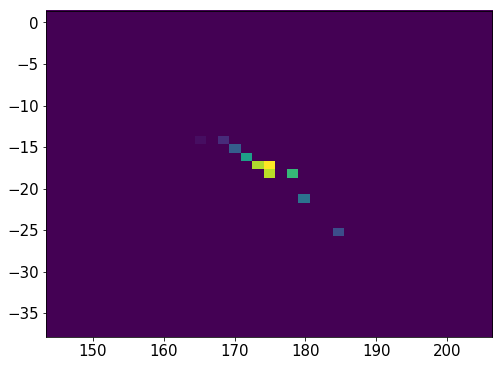

967    29
968    29
969    29
970    29
971    29
972    29
973    29
974    29
975    29
976    29
977    29
978    29
979    29
980    29
981    29
Name: Nsipm, dtype: uint16


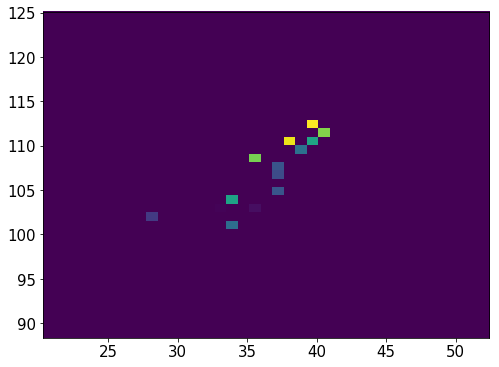

933123    33
933124    33
933125    33
933126    33
933127    33
933128    33
933129    33
933130    33
933131    33
Name: Nsipm, dtype: uint16


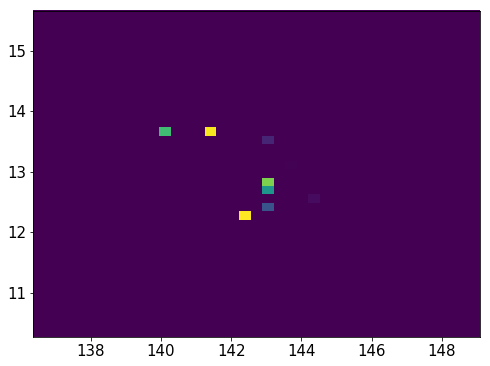

985     39
986     39
987     39
988     39
989     39
990     39
991     39
992     39
993     39
994     39
995     39
996     39
997     39
998     39
999     39
1000    39
1001    39
1002    39
1003    39
1004    39
1005    39
Name: Nsipm, dtype: uint16


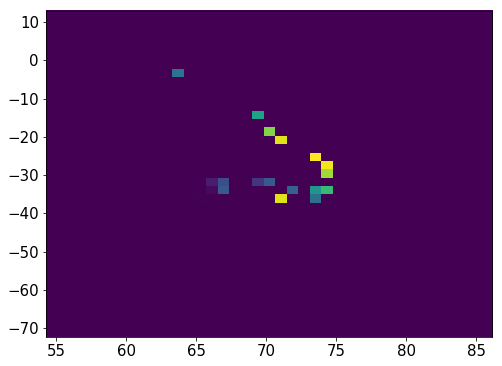

1010    34
1011    34
1012    34
1013    34
1014    34
1015    34
1016    34
1017    34
1018    34
1019    34
1020    34
1021    34
Name: Nsipm, dtype: uint16


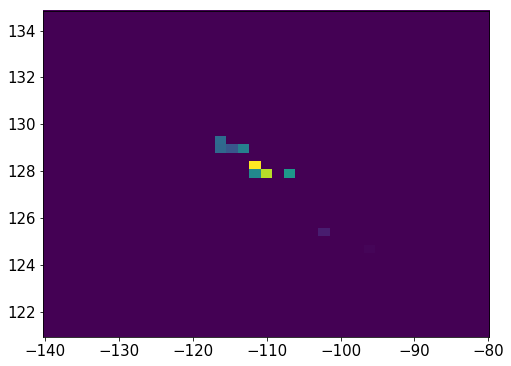

933165    23
933166    23
933167    23
933168    23
933169    23
933170    23
933171    23
933172    23
933173    23
933174    23
933175    23
933176    23
933177    23
933178    23
933179    23
933180    23
933181    23
933182    23
933183    23
933184    23
933185    23
Name: Nsipm, dtype: uint16


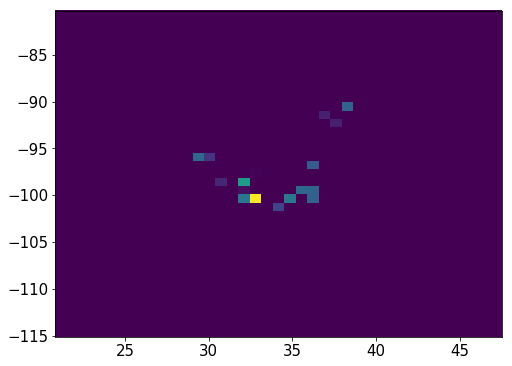

1026    28
1027    28
1028    28
1029    28
1030    28
1031    28
1032    28
1033    28
1034    28
1035    28
1036    28
1037    28
1038    28
1039    28
1040    28
1041    28
1042    28
1043    28
1044    28
1045    28
1046    28
1047    28
1051    28
1054    28
Name: Nsipm, dtype: uint16


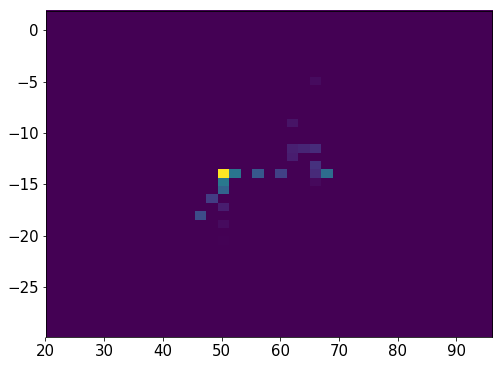

933190    34
933191    34
933192    34
933193    34
933194    34
933195    34
933196    34
933197    34
933198    34
933199    34
933200    34
933201    34
933202    34
933203    34
933204    34
933205    34
933206    34
933207    34
933208    34
933209    34
933210    34
933211    34
933212    34
933213    34
933214    34
933215    34
933216    34
933217    34
933218    34
933219    34
933220    34
933221    34
933227     9
933228     9
933229     9
933230     9
933231     9
933232     9
933233     9
933234     9
933235     9
933236     9
933237     9
933238     9
933239     9
933240     9
933242     9
933244     9
Name: Nsipm, dtype: uint16


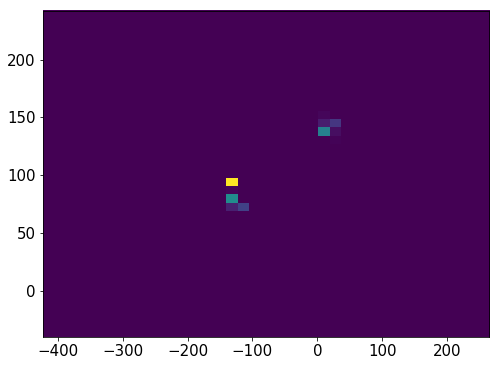

1063    34
1064    34
1065    34
1066    34
1067    34
1068    34
1069    34
1070    34
1071    34
1072    34
1073    34
1074    34
1075    34
1076    34
Name: Nsipm, dtype: uint16


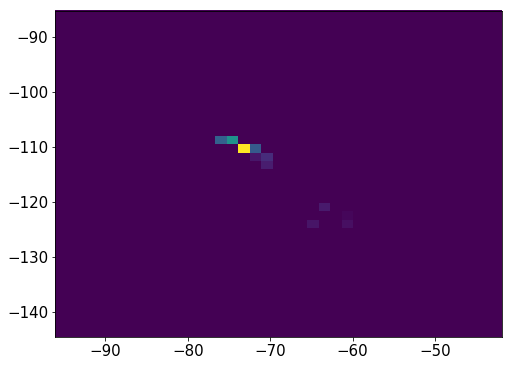

1081    39
1082    39
1083    39
1084    39
1086    39
1087    39
1088    39
1089    39
1090    39
1091    39
1092    39
1093    39
1094    39
1095    39
1096    39
1097    39
1098    39
1099    39
1100    39
1101    39
1102    39
1103    39
1104    39
1105    39
1106    39
1107    39
1113    11
1114    11
1115    11
1116    11
1117    11
1118    11
1119    11
1120    11
1121    11
1122    11
Name: Nsipm, dtype: uint16


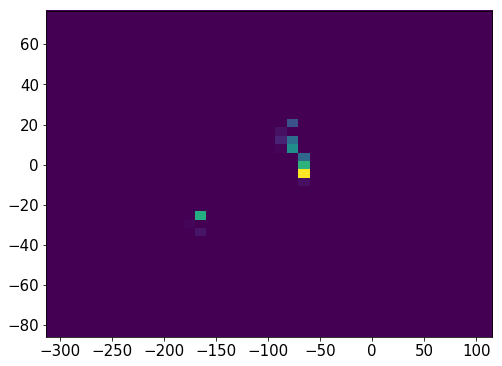

1131    21
1132    21
1133    21
1134    21
1135    21
1136    21
1137    21
1138    21
1139    21
1140    21
1141    21
1142    21
1143    21
1144    21
1145    21
1146    21
1147    21
1148    21
1149    21
1150    21
1151    21
1152    21
1153    21
Name: Nsipm, dtype: uint16


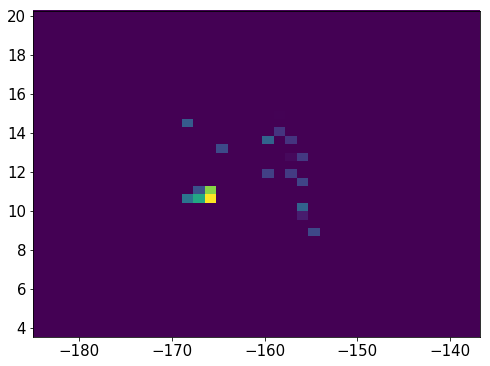

2007192    31
2007193    31
2007194    31
2007195    31
2007196    31
2007197    31
2007198    31
2007199    31
2007200    31
2007201    31
2007202    31
2007203    31
2007204    31
2007205    31
2007206    31
2007208    31
Name: Nsipm, dtype: uint16


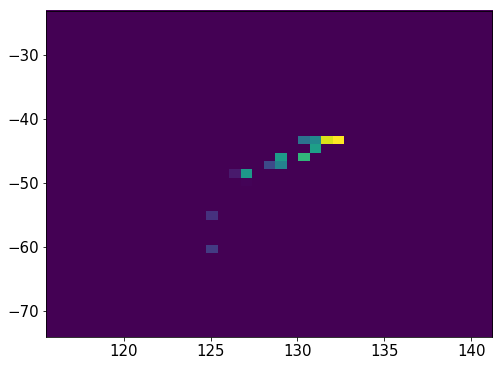

933275    28
933276    28
933277    28
933278    28
933279    28
933280    28
933281    28
933282    28
933283    28
933284    28
933285    28
933286    28
933287    28
933288    28
933289    28
933290    28
933291    28
933292    28
933293    28
933294    28
933295    28
Name: Nsipm, dtype: uint16


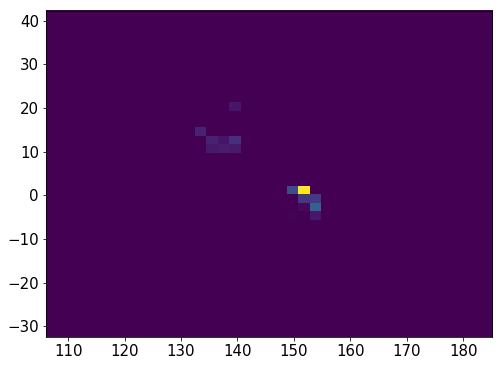

933300    27
933301    27
933302    27
933303    27
933304    27
933305    27
933306    27
933307    27
933308    27
933309    27
933310    27
933311    27
933312    27
933313    27
933314    27
933315    27
933316    27
933317    27
933318    27
933319    27
933320    27
933321    27
933322    27
933323    27
933324    27
933325    27
933326    27
Name: Nsipm, dtype: uint16


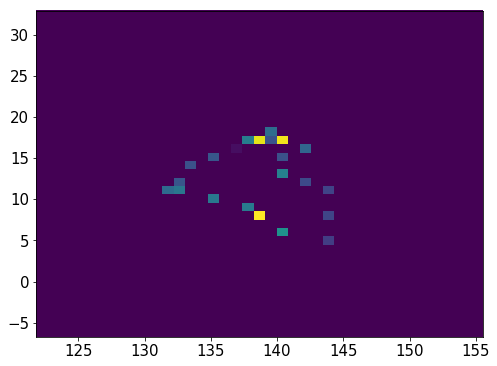

1158    24
1159    24
1160    24
1161    24
1162    24
1163    24
1164    24
1165    24
1166    24
1167    24
1168    24
1169    24
1170    24
1171    24
1172    24
1173    24
1174    24
1175    24
1176    24
1182    24
1183    24
1184    24
1185    24
1186    24
Name: Nsipm, dtype: uint16


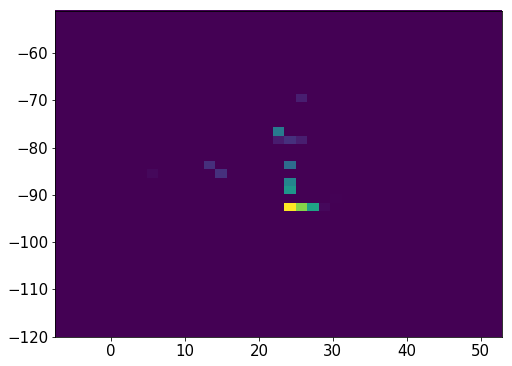

1190    23
1191    23
1192    23
1193    23
1194    23
1195    23
1196    23
1197    23
1198    23
1199    23
1200    23
1201    23
1202    23
1203    23
1204    23
1205    23
1206    23
Name: Nsipm, dtype: uint16


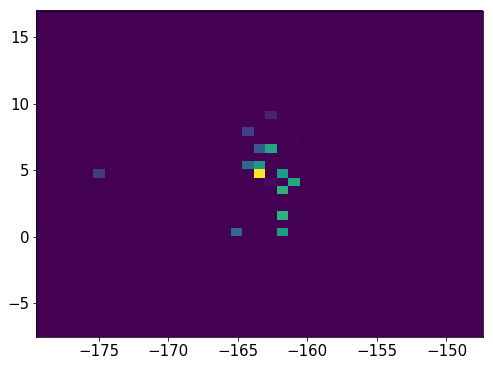

1210    18
1211    18
1212    18
1213    18
1214    18
1215    18
1216    18
1217    18
1218    18
1219    18
1220    18
1221    18
1222    18
Name: Nsipm, dtype: uint16


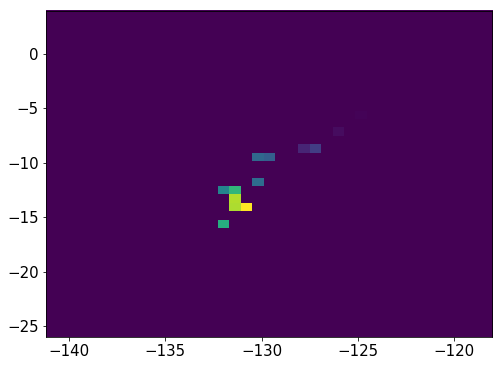

1228    28
1229    28
1230    28
1231    28
1232    28
1233    28
1234    28
1235    28
1236    28
1237    28
1238    28
1239    28
1240    28
Name: Nsipm, dtype: uint16


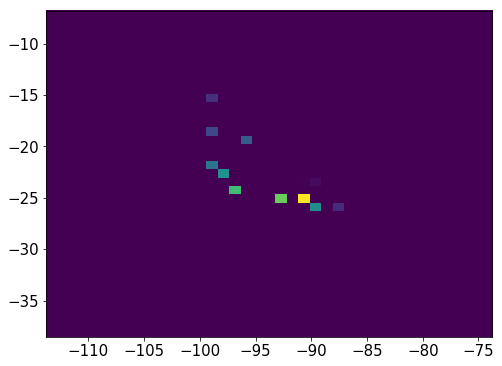

933381    25
933382    25
933383    25
933384    25
933385    25
933386    25
933387    25
933388    25
933389    25
933390    25
933391    25
933392    25
933393    25
933394    25
933395    25
933396    25
933397    25
933398    25
933399    25
933400    25
933401    25
Name: Nsipm, dtype: uint16


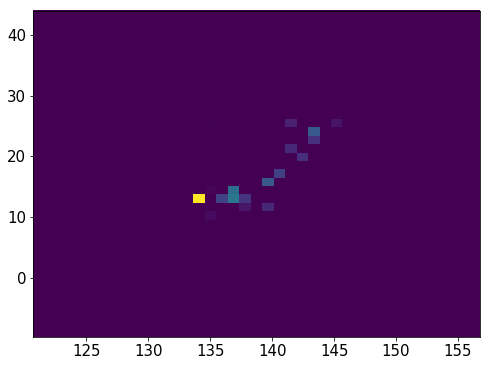

1245    26
1246    26
1247    26
1248    26
1249    26
1250    26
1251    26
1252    26
1253    26
1254    26
1255    26
1256    26
1257    26
1258    26
1259    26
Name: Nsipm, dtype: uint16


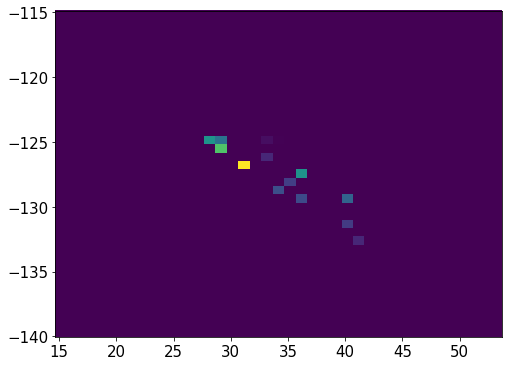

933429    20
933430    20
933431    20
933432    20
933433    20
933434    20
933435    20
933436    20
933437    20
933438    20
933439    20
933440    20
933441    20
933442    20
933443    20
933444    20
933445    20
933446    20
933447    20
Name: Nsipm, dtype: uint16


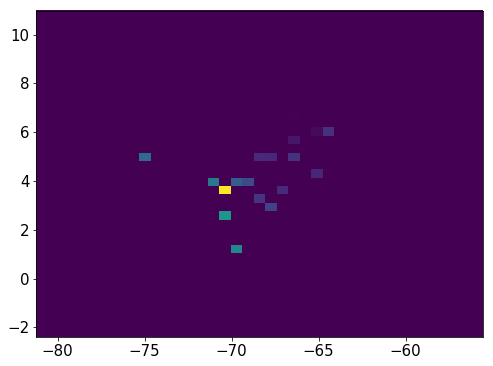

1263    21
1264    21
1265    21
1266    21
1267    21
1268    21
1269    21
1270    21
1271    21
1272    21
1273    21
1274    21
1275    21
1276    21
1277    21
1278    21
1279    21
1280    21
1281    21
1282    21
1283    21
Name: Nsipm, dtype: uint16


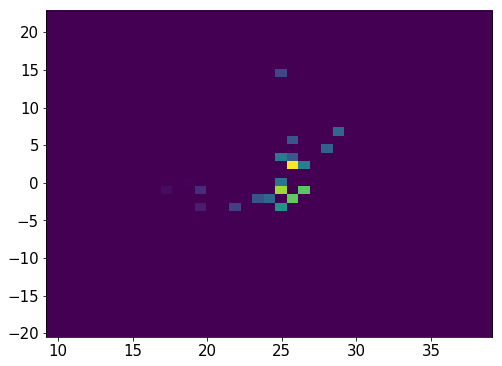

1287    25
1288    25
1289    25
1290    25
1291    25
1292    25
1293    25
1294    25
1295    25
1296    25
1297    25
1298    25
1299    25
1300    25
1301    25
1302    25
1303    25
1304    25
1305    25
1306    25
Name: Nsipm, dtype: uint16


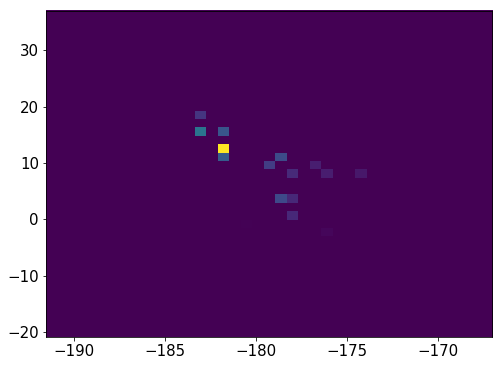

1311    20
1312    20
1313    20
1314    20
1315    20
1316    20
1317    20
1318    20
1319    20
1320    20
1321    20
1322    20
1323    20
1324    20
1325    20
1326    20
1327    20
1328    20
1329    20
1330    20
1331    20
1332    20
1333    20
1334    20
1335    20
1336    20
1337    20
Name: Nsipm, dtype: uint16


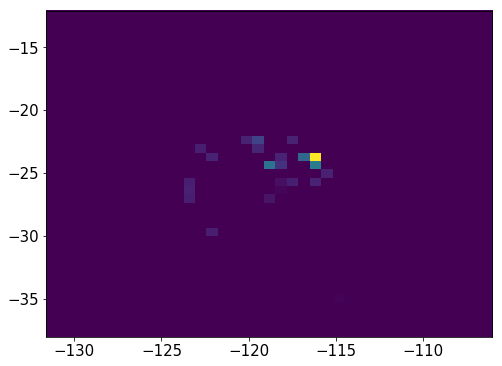

1344    21
1345    21
1346    21
1347    21
1348    21
1349    21
1350    21
1351    21
1352    21
1353    21
1354    21
1355    21
1356    21
1357    21
1358    21
1359    21
1360    21
1361    21
1362    21
Name: Nsipm, dtype: uint16


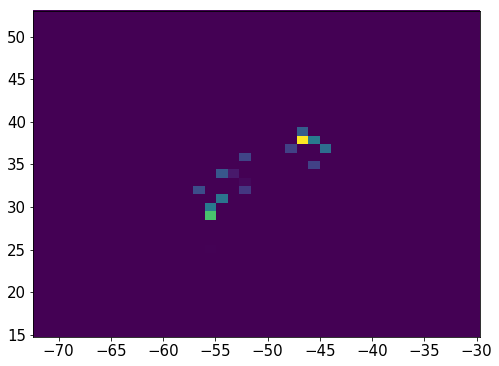

933453    30
933454    30
933455    30
933456    30
933457    30
933458    30
933459    30
933460    30
933461    30
933462    30
933463    30
933464    30
933465    30
933466    30
933467    30
933468    30
Name: Nsipm, dtype: uint16


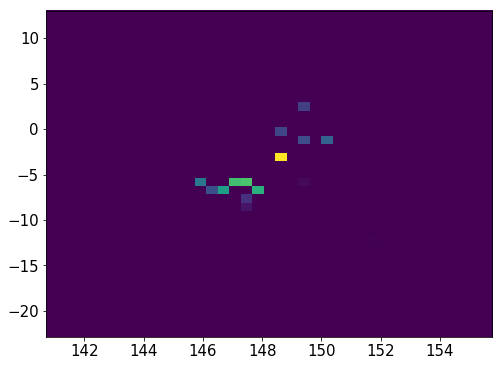

1367    23
1368    23
1369    23
1370    23
1371    23
1372    23
1373    23
1374    23
1375    23
1376    23
1377    23
1378    23
1379    23
1380    23
1381    23
1382    23
1383    23
1384    23
1385    23
1386    23
Name: Nsipm, dtype: uint16


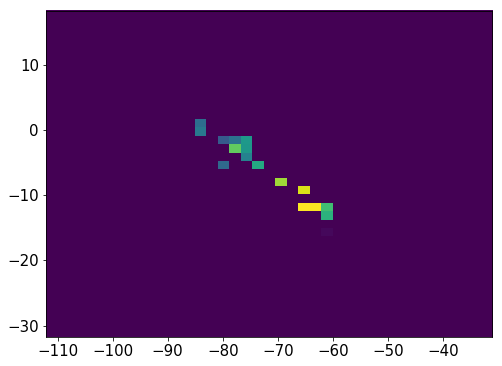

933474    33
933475    33
933476    33
933477    33
933478    33
933479    33
933480    33
933481    33
933482    33
933483    33
933484    33
933485    33
933486    33
933487    33
Name: Nsipm, dtype: uint16


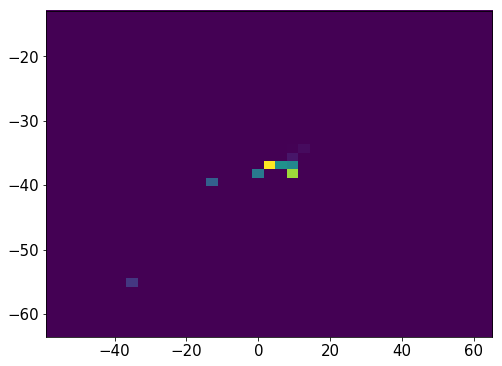

1412    26
1413    26
1417    26
1418    26
1419    26
1420    26
1421    26
1422    26
1423    26
1424    26
1425    26
1426    26
1427    26
1428    26
1429    26
1430    26
1431    26
1432    26
1433    26
1434    26
1435    26
Name: Nsipm, dtype: uint16


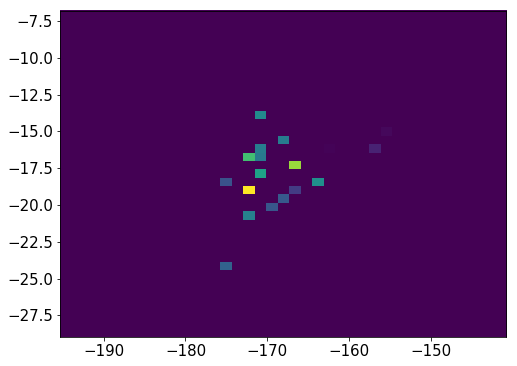

1436    22
1437    22
1438    22
1439    22
1440    22
1441    22
1442    22
1443    22
1444    22
1445    22
1446    22
1447    22
1448    22
1449    22
1450    22
1451    22
1452    22
1453    22
1454    22
1455    22
1456    22
1457    22
1458    22
1459    22
1460    22
1461    22
Name: Nsipm, dtype: uint16


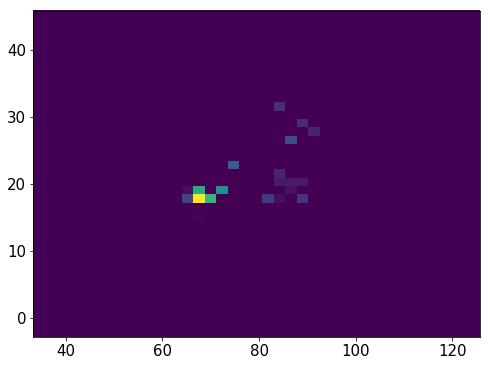

2268590    26
2268591    26
2268592    26
2268593    26
2268594    26
2268595    26
2268596    26
2268597    26
2268598    26
2268599    26
2268600    26
2268601    26
2268602    26
2268603    26
2268604    26
2268605    26
2268606    26
2268607    26
2268608    26
2268609    26
2268610    26
2268611    26
2268612    26
2268613    26
2268614    26
2268615    26
2268616    26
2268617    26
2268618    26
2268619    26
Name: Nsipm, dtype: uint16


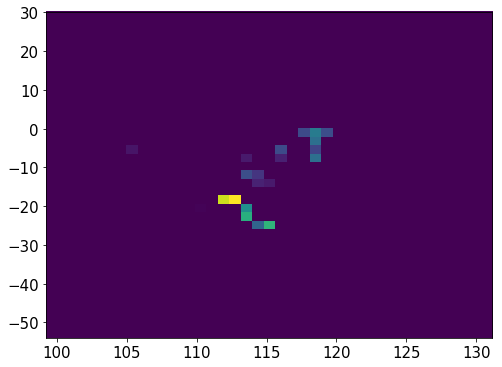

933492    26
933493    26
933494    26
933495    26
933496    26
933497    26
933498    26
933499    26
933500    26
933501    26
933502    26
933503    26
933504    26
933509     5
933510     5
933511     5
933512     5
933513     5
933514     5
933515     5
933516     5
Name: Nsipm, dtype: uint16


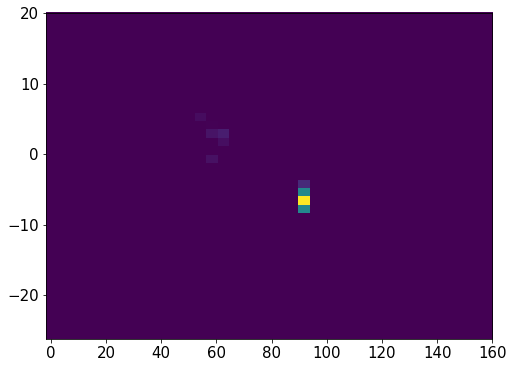

933520    19
933521    19
933522    19
933523    19
933524    19
933525    19
933526    19
933527    19
933528    19
933529    19
933530    19
Name: Nsipm, dtype: uint16


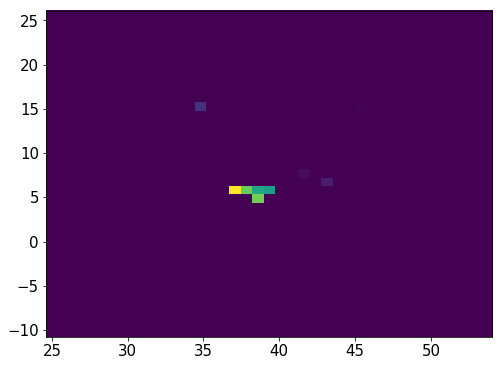

1466    29
1467    29
1468    29
1469    29
1470    29
1471    29
1472    29
1473    29
1474    29
1475    29
1476    29
1477    29
1478    29
1479    29
1480    29
1481    29
1482    29
1483    29
1484    29
Name: Nsipm, dtype: uint16


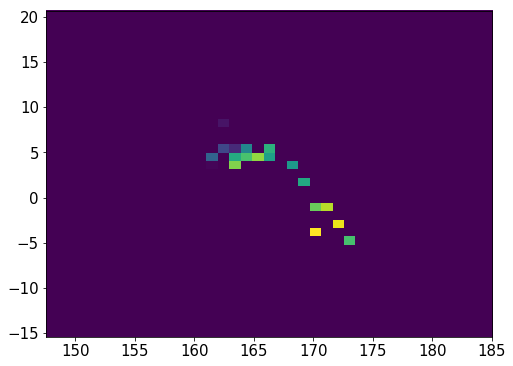

933534    30
933535    30
933536    30
933537    30
933538    30
933539    30
933540    30
933541    30
933542    30
933543    30
933544    30
933545    30
933546    30
933549     2
933550     2
933551     2
933552     2
933553     2
933554     2
933555     2
933556     2
933557     2
Name: Nsipm, dtype: uint16


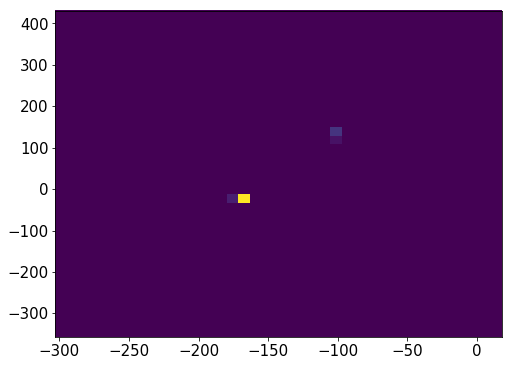

1490    23
1491    23
1492    23
1493    23
1494    23
1495    23
1496    23
1497    23
1498    23
1499    23
1500    23
1501    23
1502    23
1503    23
1504    23
1505    23
1506    23
1507    23
1508    23
1509    23
1510    23
1511    23
1512    23
Name: Nsipm, dtype: uint16


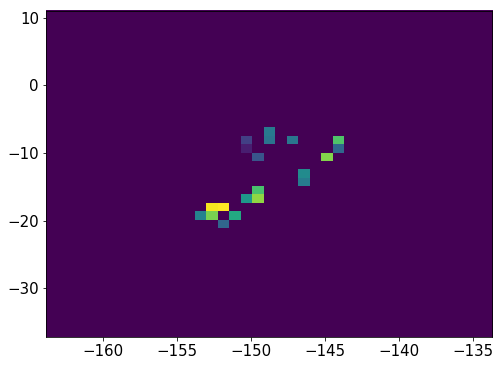

1518    24
1519    24
1520    24
1521    24
1522    24
1523    24
1524    24
1525    24
1526    24
1527    24
1528    24
1529    24
1530    24
1531    24
1532    24
1533    24
1534    24
1535    24
1536    24
Name: Nsipm, dtype: uint16


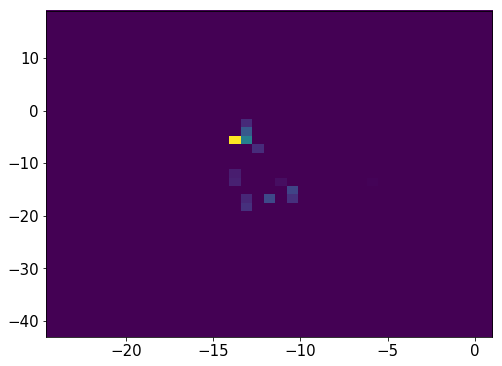

933562    19
933563    19
933564    19
933565    19
933566    19
933567    19
933568    19
933569    19
933570    19
933571    19
933572    19
933573    19
933574    19
933575    19
933576    19
933577    19
933578    19
933579    19
933580    19
933581    19
933582    19
933583    19
933584    19
Name: Nsipm, dtype: uint16


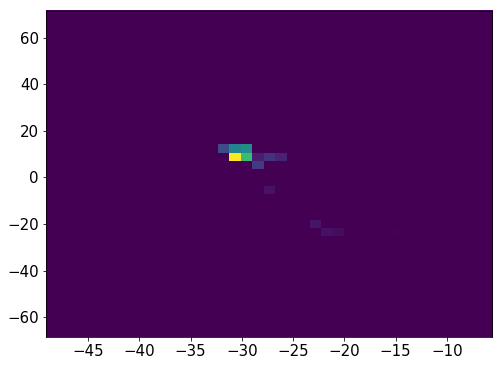

568672    25
568673    25
568674    25
568675    25
568676    25
568677    25
568678    25
568679    25
568680    25
568681    25
568682    25
568683    25
568684    25
568685    25
568686    25
568687    25
Name: Nsipm, dtype: uint16


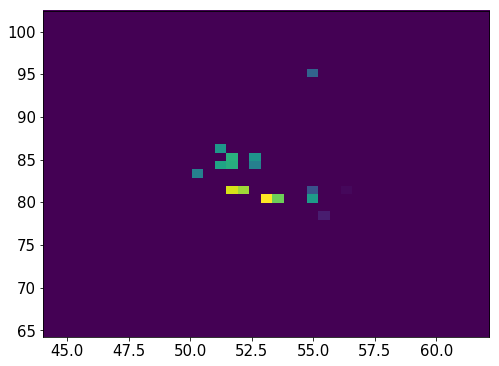

1540    32
1541    32
1542    32
1543    32
1544    32
1545    32
1546    32
1547    32
1548    32
1549    32
1550    32
1551    32
1552    32
1553    32
1554    32
1555    32
1556    32
1557    32
1558    32
1559    32
1560    32
1561    32
1562    32
1563    32
1564    32
1565    32
1566    32
1567    32
1568    32
1570     4
1571     4
1572     4
1573     4
1574     4
1575     4
1576     4
1578     4
Name: Nsipm, dtype: uint16


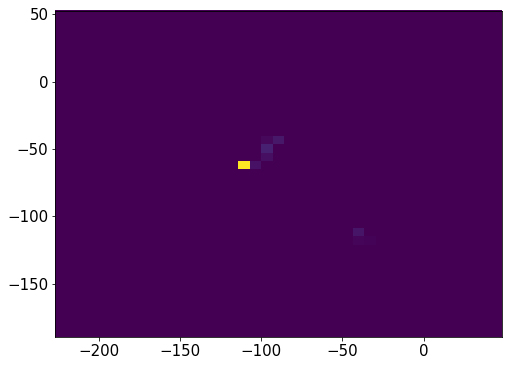

933589    32
933590    32
933591    32
933592    32
933593    32
933594    32
933595    32
933596    32
933597    32
933598    32
933599    32
933600    32
933601    32
933602    32
933603    32
933604    32
933605    32
933606    32
Name: Nsipm, dtype: uint16


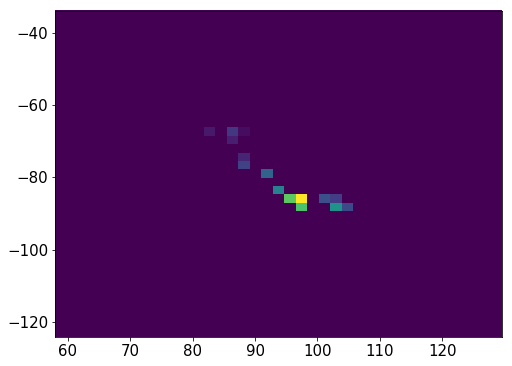

1584    35
1585    35
1586    35
1587    35
1588    35
1589    35
1590    35
1591    35
1592    35
1593    35
1594    35
1595    35
1596    35
1597    35
1598    35
1599    35
1600    35
1601    35
1602    35
1603    35
1604    35
1605    35
1606    35
Name: Nsipm, dtype: uint16


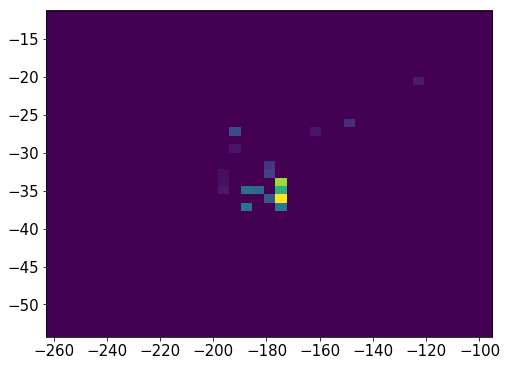

1611    28
1612    28
1613    28
1614    28
1615    28
1616    28
1617    28
1618    28
1619    28
1620    28
1621    28
1622    28
1623    28
1624    28
1625    28
1626    28
1627    28
1628    28
1629    28
Name: Nsipm, dtype: uint16


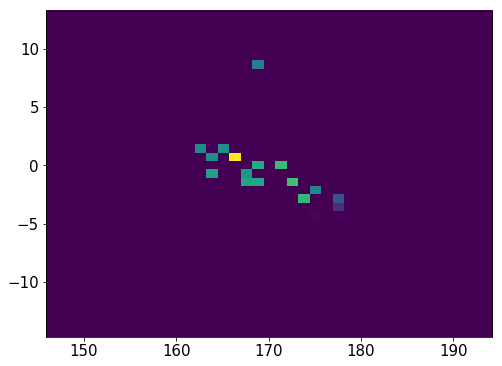

1634    24
1635    24
1636    24
1637    24
1638    24
1639    24
1640    24
1641    24
1642    24
1643    24
1644    24
1645    24
1646    24
1647    24
1648    24
1649    24
1650    24
1651    24
1652    24
1660    24
1661    24
1662    24
1663    24
1664    24
Name: Nsipm, dtype: uint16


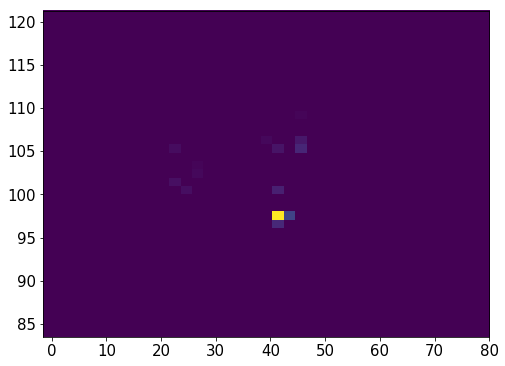

933691    28
933692    28
933693    28
933694    28
933695    28
933696    28
933697    28
933698    28
933699    28
933700    28
933701    28
933702    28
933703    28
933704    28
Name: Nsipm, dtype: uint16


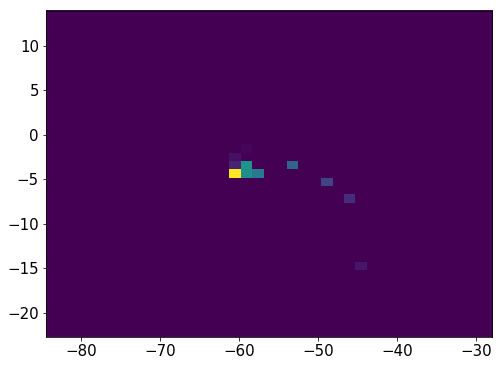

932099    26
932100    26
932101    26
932102    26
932103    26
932104    26
932105    26
932106    26
932107    26
932108    26
932109    26
932110    26
932111    26
932112    26
932113    26
932114    26
932115    26
932116    26
932117    26
932118    26
932119    26
932120    26
932121    26
932122    26
932123    26
932124    26
932126    26
932127    26
932128    26
932129    26
932130    26
932131    26
Name: Nsipm, dtype: uint16


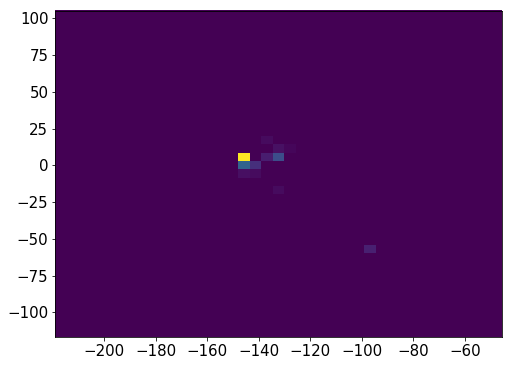

933727    19
933728    19
933729    19
933730    19
933731    19
933732    19
933733    19
933734    19
933735    19
933736    19
933737    19
933738    19
933739    19
933740    19
933741    19
933742    19
933743    19
933744    19
933745    19
933746    19
933747    19
933748    19
933749    19
933750    19
933751    19
933752    19
933753    19
933754    19
933755    19
933756    19
933757    19
933758    19
933759    19
933760    19
933761    19
933762    19
Name: Nsipm, dtype: uint16


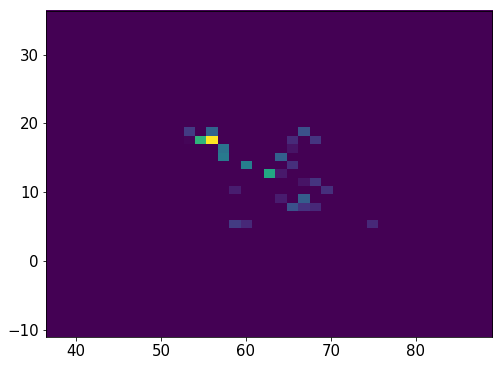

933766    35
933767    35
933768    35
933769    35
933770    35
933771    35
933772    35
933773    35
933774    35
933775    35
933776    35
933777    35
933778    35
933779    35
933780    35
933781    35
Name: Nsipm, dtype: uint16


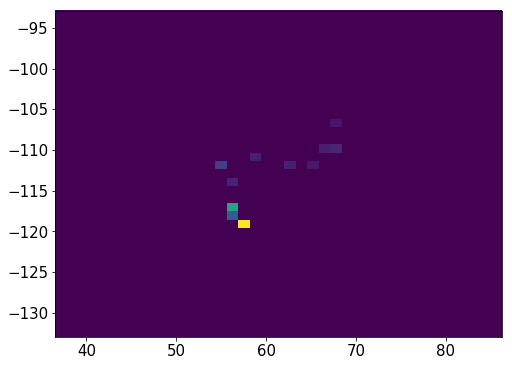

933785    30
933786    30
933787    30
933788    30
933789    30
933790    30
933791    30
933792    30
933793    30
933794    30
933795    30
933796    30
Name: Nsipm, dtype: uint16


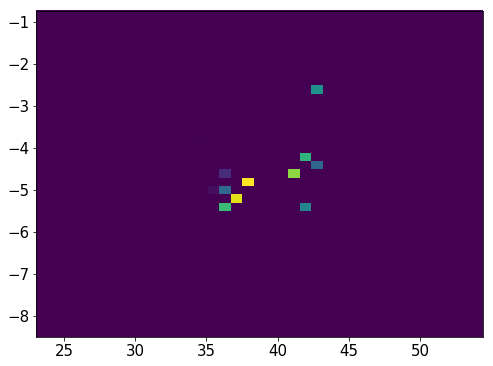

1668    22
1669    22
1670    22
1671    22
1672    22
1673    22
1674    22
1675    22
1676    22
1677    22
1678    22
1679    22
1680    22
1681    22
1682    22
1683    22
1687    22
1688    22
1689    22
Name: Nsipm, dtype: uint16


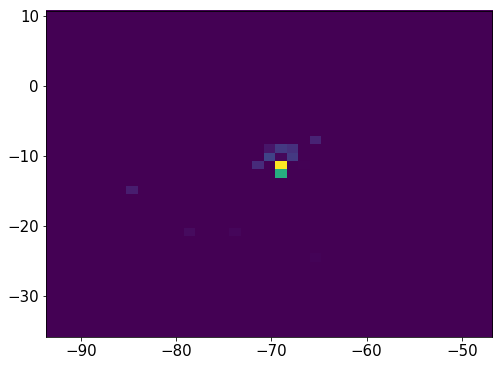

933802    34
933803    34
933804    34
933805    34
933806    34
933807    34
933808    34
933809    34
933810    34
933811    34
933812    34
933813    34
933814    34
933815    34
Name: Nsipm, dtype: uint16


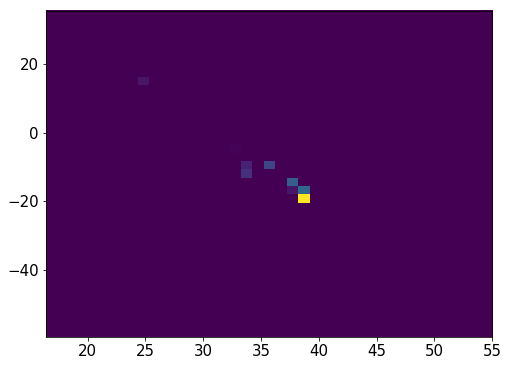

933819    26
933820    26
933821    26
933822    26
933823    26
933824    26
933825    26
933826    26
933827    26
933828    26
933829    26
933830    26
933831    26
933832    26
933833    26
Name: Nsipm, dtype: uint16


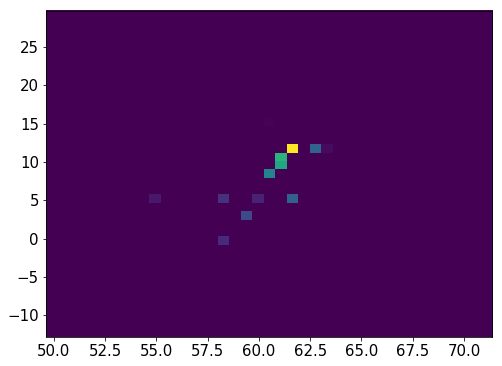

933837    25
933838    25
933839    25
933840    25
933841    25
933842    25
933843    25
933844    25
933845    25
933846    25
933847    25
933848    25
933849    25
933850    25
933851    25
933852    25
933853    25
933854    25
933855    25
933856    25
933857    25
933858    25
933859    25
933860    25
933861    25
933862    25
933863    25
933864    25
933865    25
933866    25
Name: Nsipm, dtype: uint16


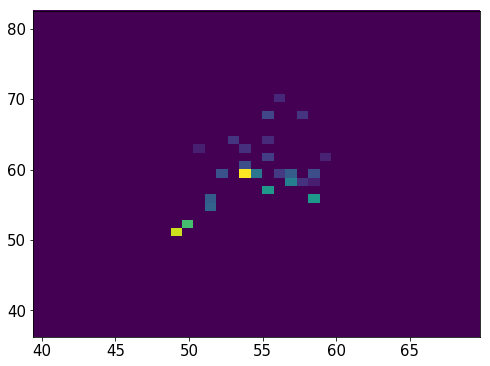

933872    27
933873    27
933874    27
933875    27
933876    27
933877    27
933878    27
933879    27
933880    27
933881    27
933882    27
933883    27
933884    27
933885    27
933886    27
Name: Nsipm, dtype: uint16


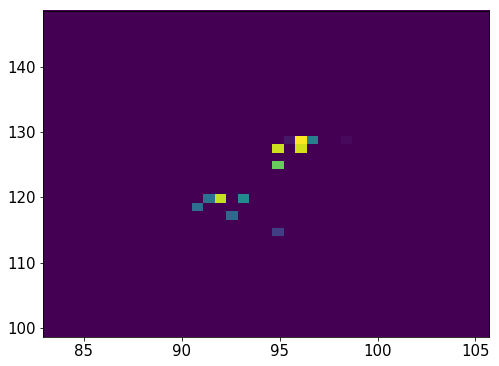

1696    32
1697    32
1698    32
1699    32
1700    32
1701    32
1702    32
1703    32
1704    32
1705    32
1706    32
1707    32
1708    32
1709    32
1710    32
Name: Nsipm, dtype: uint16


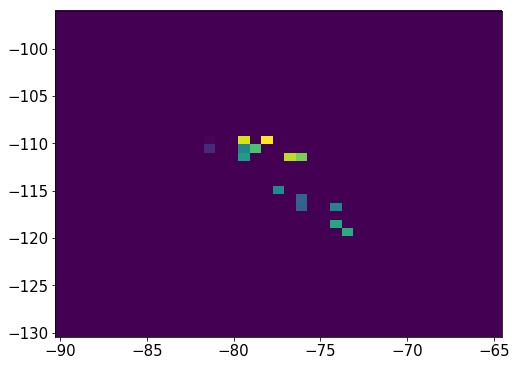

933889    24
933890    24
933891    24
933892    24
933893    24
933894    24
933895    24
933896    24
933897    24
933898    24
933899    24
933900    24
933901    24
933902    24
933903    24
933904    24
Name: Nsipm, dtype: uint16


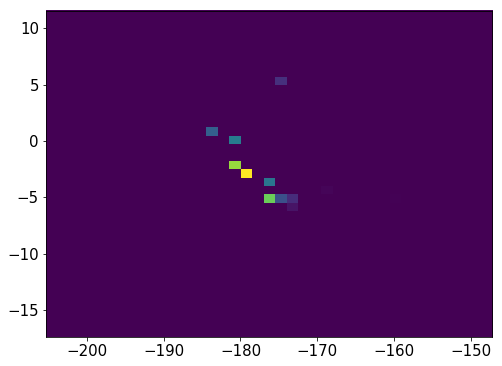

935321    25
935322    25
935323    25
935324    25
935325    25
935326    25
935327    25
935328    25
935329    25
935330    25
935331    25
935332    25
935333    25
935334    25
935335    25
935340    25
935341    25
935342    25
935343    25
935344    25
935345    25
Name: Nsipm, dtype: uint16


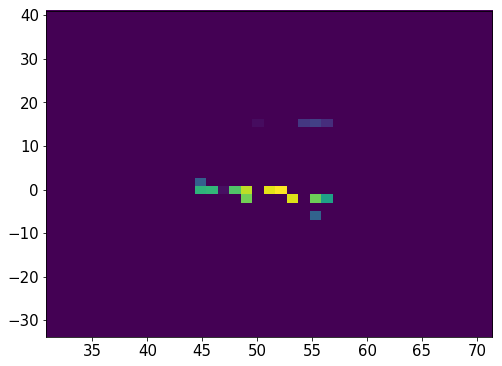

1663221    26
1663222    26
1663223    26
1663224    26
1663225    26
1663226    26
1663227    26
1663228    26
1663229    26
1663230    26
1663231    26
1663232    26
1663233    26
Name: Nsipm, dtype: uint16


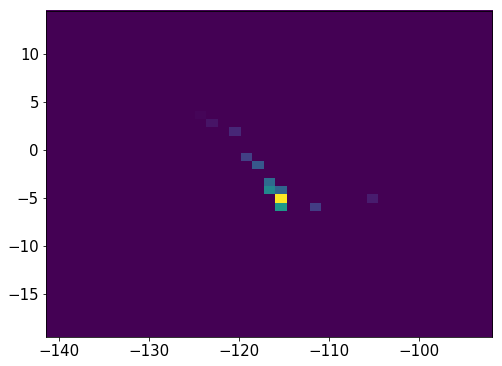

1715    21
1716    21
1717    21
1718    21
1719    21
1720    21
1721    21
1722    21
1723    21
1724    21
1725    21
1726    21
1727    21
1728    21
1729    21
1730    21
1731    21
1732    21
1733    21
Name: Nsipm, dtype: uint16


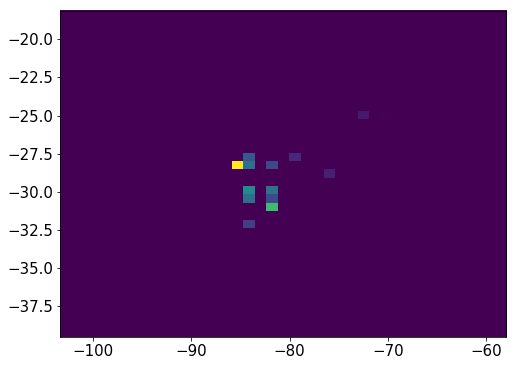

1738    30
1739    30
1740    30
1741    30
1742    30
1743    30
1744    30
1745    30
1746    30
1747    30
1748    30
1749    30
1750    30
1751    30
1752    30
1753    30
Name: Nsipm, dtype: uint16


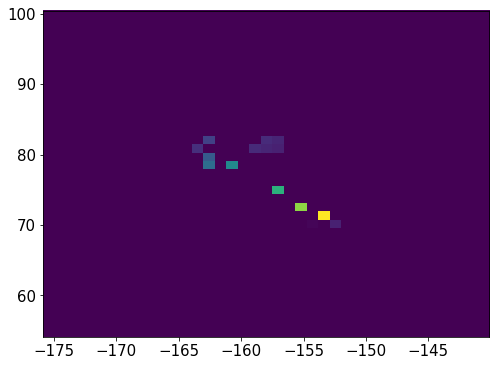

1758    24
1759    24
1760    24
1761    24
1762    24
1763    24
1764    24
1765    24
1766    24
1767    24
1768    24
1769    24
1770    24
1771    24
1772    24
1773    24
1774    24
1775    24
1776    24
1777    24
1778    24
Name: Nsipm, dtype: uint16


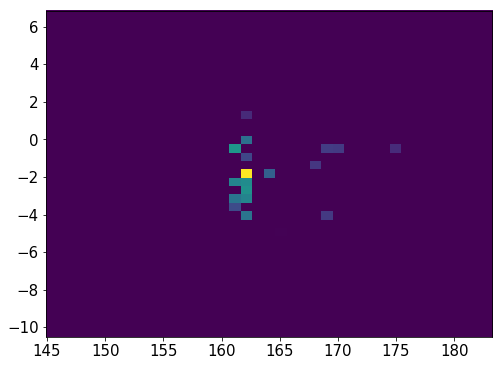

1783    30
1784    30
1785    30
1786    30
1787    30
1788    30
1789    30
1790    30
1791    30
1792    30
1793    30
1794    30
1795    30
1796    30
1797    30
1798    30
1799    30
1800    30
1801    30
1802    30
1803    30
1804    30
1805    30
1806    30
1807    30
1808    30
1809    30
1810    30
1811    30
1812    30
Name: Nsipm, dtype: uint16


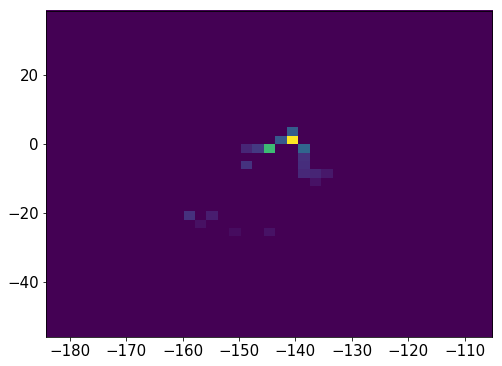

1814    26
1815    26
1816    26
1817    26
1818    26
1819    26
1820    26
1821    26
1822    26
1823    26
1824    26
1825    26
1826    26
1827    26
1828    26
1829    26
1830    26
Name: Nsipm, dtype: uint16


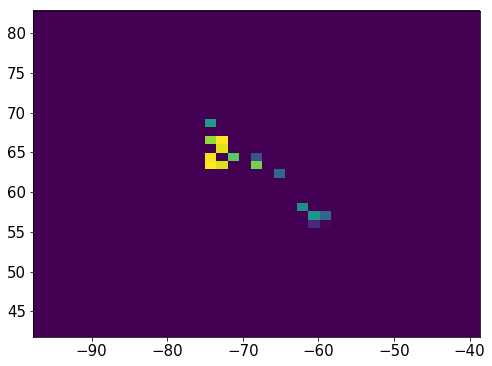

1836    27
1837    27
1838    27
1839    27
1840    27
1841    27
1842    27
1843    27
1844    27
1845    27
1846    27
1847    27
1848    27
1849    27
1850    27
1851    27
1852    27
1853    27
1854    27
1855    27
1856    27
1857    27
1858    27
1859    27
Name: Nsipm, dtype: uint16


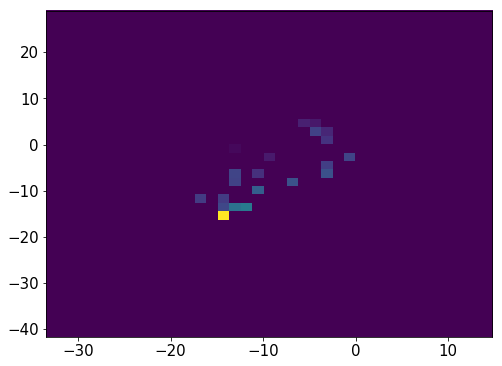

1864    22
1865    22
1866    22
1867    22
1868    22
1869    22
1870    22
1871    22
1872    22
1873    22
1874    22
1875    22
1876    22
1877    22
1878    22
1879    22
1880    22
1886     8
1887     8
1888     8
1889     8
1890     8
1891     8
1892     8
1893     8
1894     8
Name: Nsipm, dtype: uint16


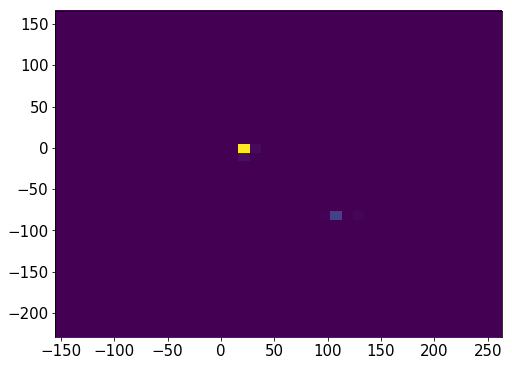

1897    23
1898    23
1899    23
1900    23
1901    23
1902    23
1903    23
1904    23
1905    23
1906    23
1907    23
1908    23
1909    23
1910    23
1911    23
1912    23
1913    23
1914    23
1915    23
1916    23
1917    23
Name: Nsipm, dtype: uint16


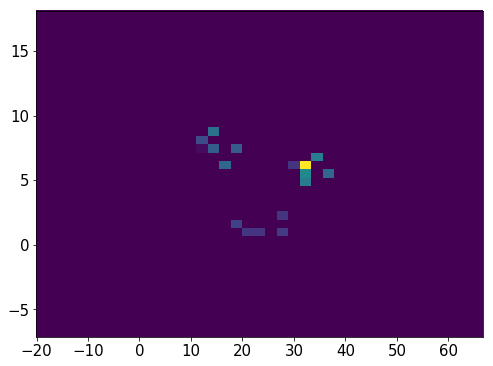

1923    23
1924    23
1925    23
1926    23
1927    23
1928    23
1929    23
1930    23
1931    23
1932    23
1933    23
1934    23
1935    23
1936    23
Name: Nsipm, dtype: uint16


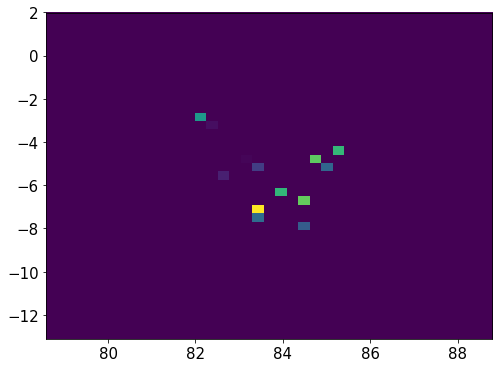

935452    23
935453    23
935454    23
935455    23
935456    23
935457    23
935458    23
935459    23
935460    23
935461    23
935462    23
935463    23
935464    23
935465    23
935466    23
935467    23
935468    23
935469    23
Name: Nsipm, dtype: uint16


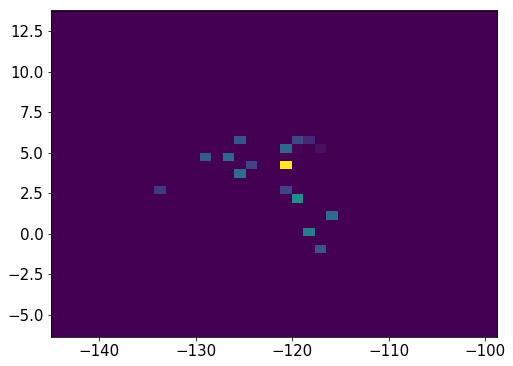

1941    34
1942    34
1943    34
1944    34
1945    34
1946    34
1947    34
1948    34
1949    34
1950    34
1951    34
1952    34
1953    34
1954    34
1955    34
1956    34
1957    34
1958    34
1959    34
Name: Nsipm, dtype: uint16


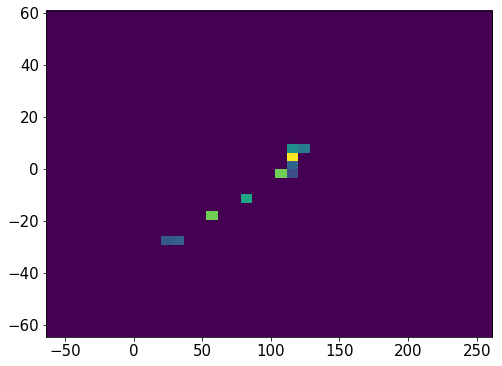

935496    38
935497    38
935498    38
935499    38
935500    38
935501    38
935502    38
935503    38
935504    38
935505    38
935506    38
935507    38
935508    38
935509    38
935510    38
935511    38
935512    38
935513    38
935514    38
Name: Nsipm, dtype: uint16


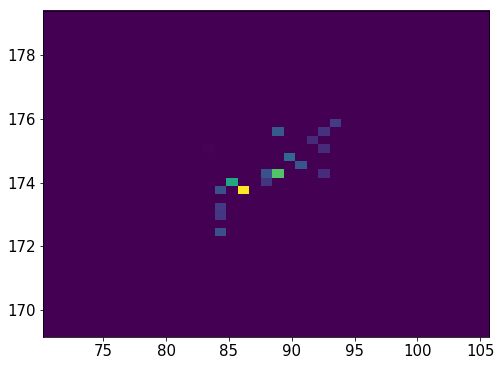

1964    24
1965    24
1966    24
1967    24
1968    24
1969    24
1970    24
1971    24
1972    24
1973    24
1974    24
1975    24
1976    24
1977    24
1978    24
1979    24
1980    24
1981    24
1982    24
1983    24
1984    24
1985    24
1986    24
1987    24
1988    24
1989    24
1990    24
1991    24
Name: Nsipm, dtype: uint16


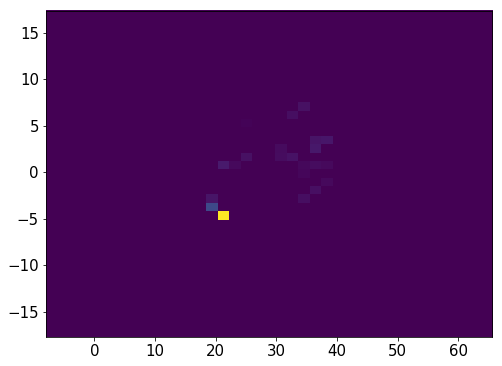

1996    24
1997    24
1998    24
1999    24
2000    24
2001    24
2002    24
2003    24
2004    24
2005    24
2006    24
2007    24
2008    24
Name: Nsipm, dtype: uint16


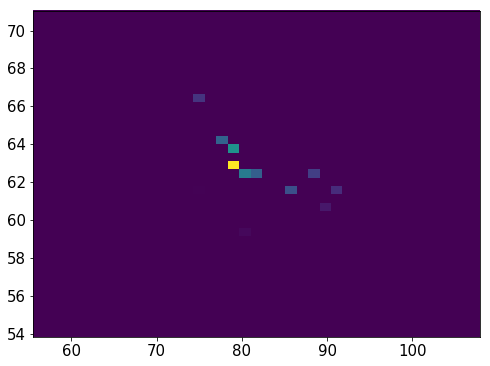

2013    22
2014    22
2015    22
2016    22
2017    22
2018    22
2019    22
2020    22
2021    22
2022    22
2023    22
2024    22
2025    22
2026    22
2027    22
2028    22
2029    22
2030    22
2031    22
Name: Nsipm, dtype: uint16


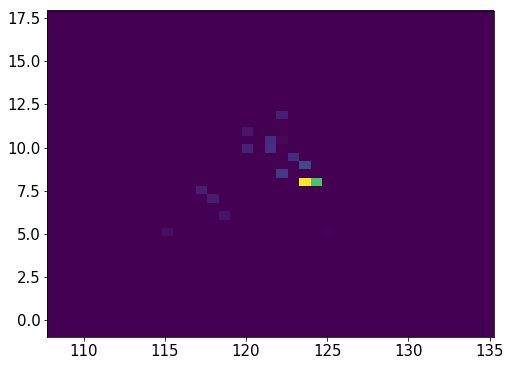

935519    21
935520    21
935521    21
935522    21
935523    21
935524    21
935525    21
935526    21
935527    21
935528    21
935529    21
935535     9
935536     9
935537     9
935538     9
935539     9
935540     9
935541     9
935542     9
935543     9
935544     9
Name: Nsipm, dtype: uint16


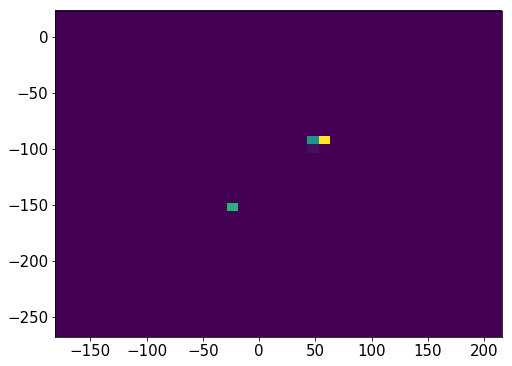

935549    29
935550    29
935551    29
935552    29
935553    29
935554    29
935555    29
935556    29
935557    29
935558    29
935559    29
935560    29
935561    29
935562    29
935563    29
935564    29
935565    29
935566    29
935567    29
935568    29
935569    29
935570    29
935571    29
Name: Nsipm, dtype: uint16


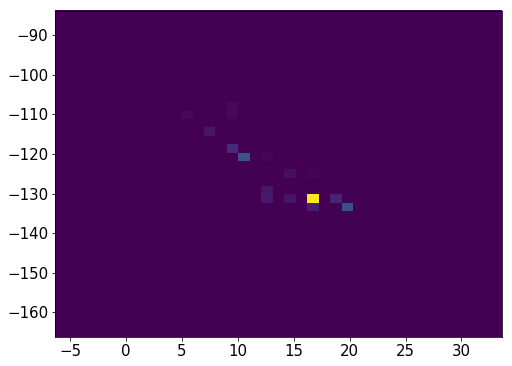

935575    30
935576    30
935577    30
935578    30
935579    30
935580    30
935581    30
935582    30
935583    30
935584    30
935585    30
935586    30
935587    30
935588    30
935589    30
Name: Nsipm, dtype: uint16


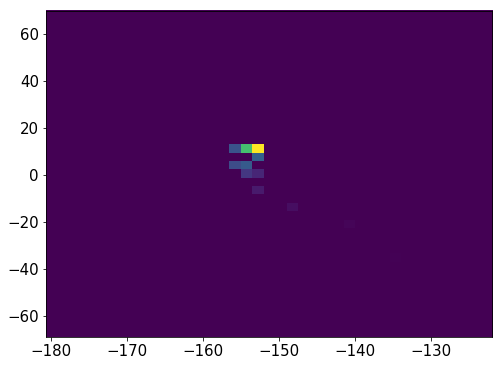

2035    24
2036    24
2037    24
2038    24
2039    24
2040    24
2041    24
2042    24
2043    24
2044    24
2045    24
2046    24
2047    24
2048    24
Name: Nsipm, dtype: uint16


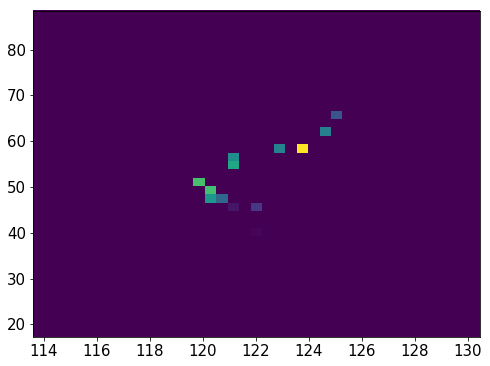

2052    23
2053    23
2054    23
2055    23
2056    23
2057    23
2058    23
2059    23
2060    23
2061    23
2062    23
2063    23
2064    23
2065    23
2066    23
2067    23
2068    23
2069    23
2070    23
2071    23
2072    23
2073    23
2074    23
2075    23
2076    23
2077    23
2078    23
2079    23
2080    23
2081    23
Name: Nsipm, dtype: uint16


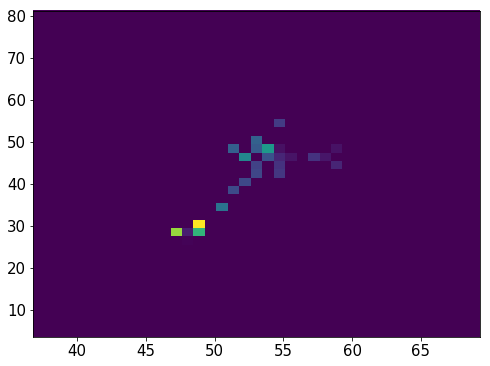

935616    26
935617    26
935618    26
935619    26
935620    26
935621    26
935622    26
935623    26
935624    26
935625    26
935626    26
935627    26
935628    26
935629    26
935630    26
935631    26
935635    26
935636    26
935637    26
935638    26
Name: Nsipm, dtype: uint16


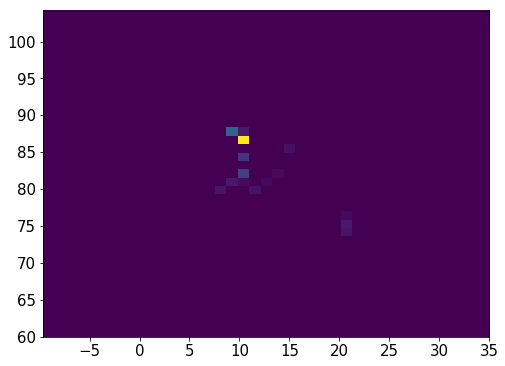

935641    40
935642    40
935643    40
935644    40
935645    40
935646    40
935647    40
935648    40
935649    40
935650    40
935651    40
935652    40
935653    40
935654    40
935655    40
935656    40
935657    40
935658    40
935659    40
935660    40
935661    40
935662    40
935663    40
935664    40
935665    40
935666    40
935667    40
935668    40
935669    40
935670    40
935671    40
935672    40
935673    40
935674    40
Name: Nsipm, dtype: uint16


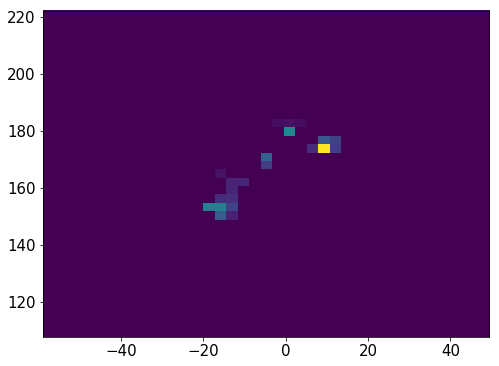

935677    27
935678    27
935679    27
935680    27
935681    27
935682    27
935683    27
935684    27
935685    27
935686    27
935687    27
935688    27
935689    27
935690    27
935691    27
935692    27
935694    27
Name: Nsipm, dtype: uint16


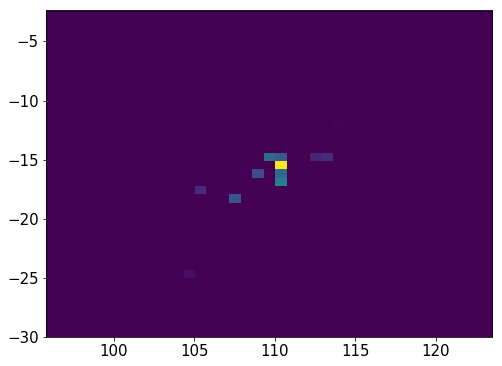

935698    24
935699    24
935700    24
935701    24
935702    24
935703    24
935704    24
935705    24
935706    24
935707    24
935708    24
935709    24
935710    24
Name: Nsipm, dtype: uint16


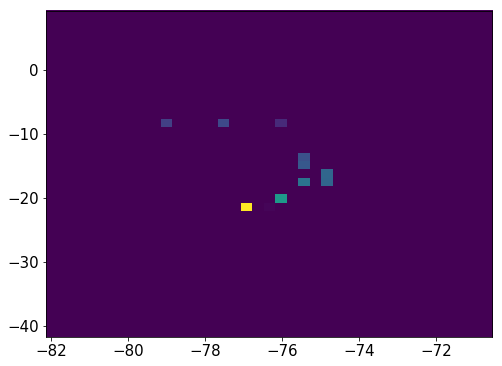

2085    21
2086    21
2087    21
2088    21
2089    21
2090    21
2091    21
2092    21
2093    21
2094    21
2095    21
2096    21
2097    21
2098    21
2099    21
2100    21
Name: Nsipm, dtype: uint16


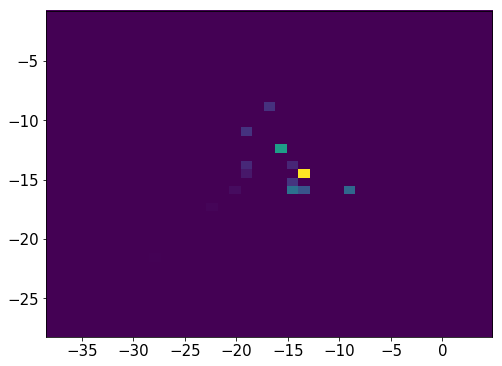

935729    28
935730    28
935731    28
935732    28
935733    28
935734    28
935735    28
935736    28
935737    28
935738    28
935739    28
935740    28
935741    28
935742    28
935743    28
935744    28
935745    28
935746    28
935747    28
935748    28
935749    28
935750    28
Name: Nsipm, dtype: uint16


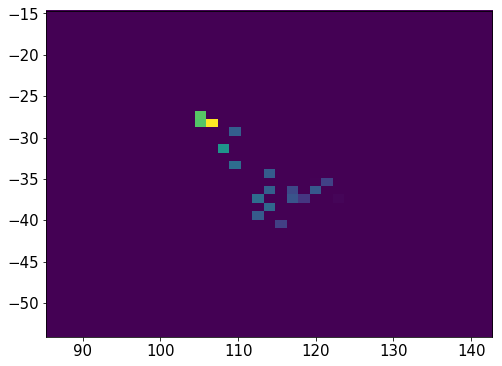

935754    28
935755    28
935756    28
935757    28
935758    28
935759    28
935760    28
935761    28
935762    28
935763    28
935764    28
935765    28
935766    28
935767    28
935768    28
935769    28
935770    28
935771    28
935772    28
935773    28
935774    28
Name: Nsipm, dtype: uint16


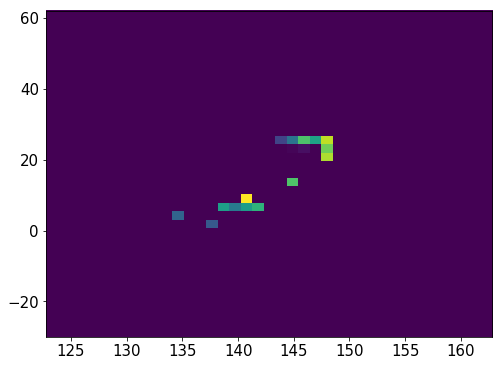

2106    31
2107    31
2108    31
2109    31
2110    31
2111    31
2112    31
2113    31
2114    31
2115    31
2116    31
Name: Nsipm, dtype: uint16


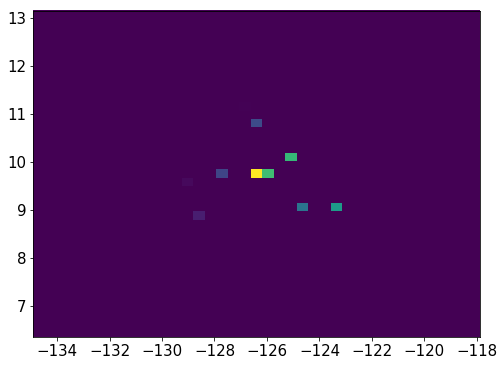

935778    21
935779    21
935780    21
935781    21
935782    21
935783    21
935784    21
935785    21
935786    21
935787    21
935788    21
935789    21
935790    21
935791    21
935792    21
935793    21
935794    21
935795    21
935796    21
935797    21
935798    21
935799    21
935800    21
935801    21
935802    21
935803    21
935804    21
Name: Nsipm, dtype: uint16


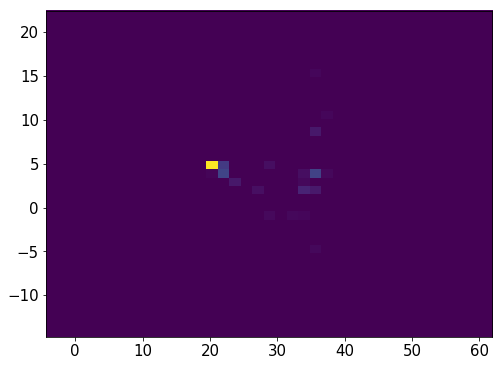

935810    30
935811    30
935812    30
935813    30
935814    30
935815    30
935816    30
935817    30
935818    30
935819    30
935820    30
935821    30
935822    30
935823    30
935824    30
935825    30
935826    30
935827    30
Name: Nsipm, dtype: uint16


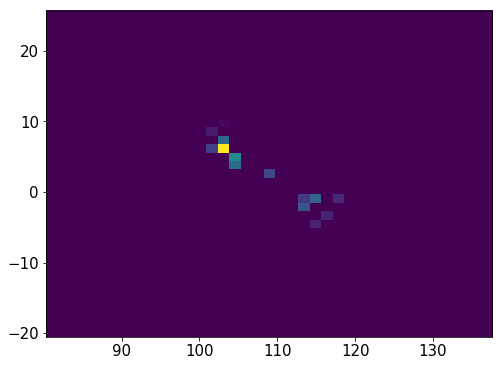

2121    27
2122    27
2123    27
2124    27
2125    27
2126    27
2127    27
2128    27
2129    27
2130    27
2131    27
2132    27
2133    27
2134    27
2135    27
2136    27
2137    27
2138    27
2139    27
Name: Nsipm, dtype: uint16


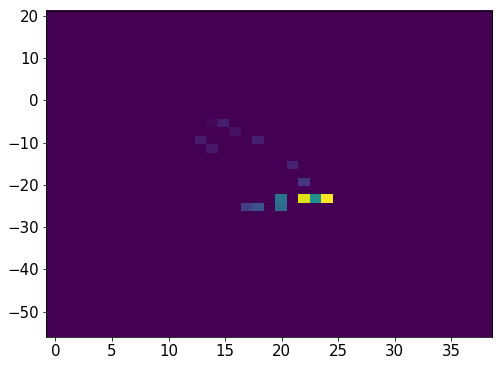

2145    34
2146    34
2147    34
2148    34
2149    34
2150    34
2151    34
2152    34
2153    34
2154    34
2155    34
2156    34
2157    34
Name: Nsipm, dtype: uint16


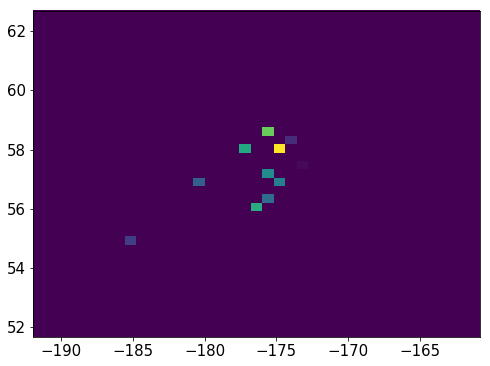

2163    23
2164    23
2165    23
2166    23
2167    23
2168    23
2169    23
2170    23
2171    23
2172    23
2173    23
2174    23
2175    23
2176    23
2177    23
2178    23
2179    23
2180    23
2181    23
2182    23
2183    23
2184    23
2185    23
2186    23
Name: Nsipm, dtype: uint16


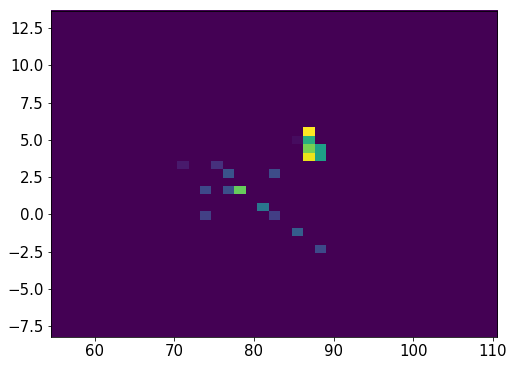

935855    18
935856    18
935857    18
935858    18
935859    18
935860    18
935861    18
935862    18
935863    18
935864    18
935865    18
935866    18
935867    18
935868    18
Name: Nsipm, dtype: uint16


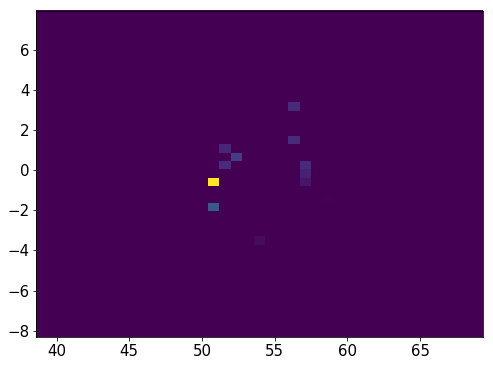

935874    30
935875    30
935876    30
935877    30
935878    30
935879    30
935880    30
935881    30
935882    30
935883    30
935884    30
935885    30
935886    30
935887    30
935888    30
935889    30
935890    30
935891    30
935892    30
935893    30
935894    30
935895    30
935899    11
935900    11
935901    11
935902    11
935903    11
935904    11
935905    11
Name: Nsipm, dtype: uint16


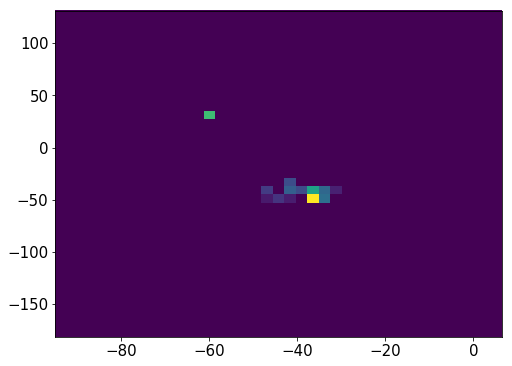

935910    32
935911    32
935912    32
935913    32
935914    32
935915    32
935916    32
935917    32
935918    32
935919    32
935920    32
935921    32
Name: Nsipm, dtype: uint16


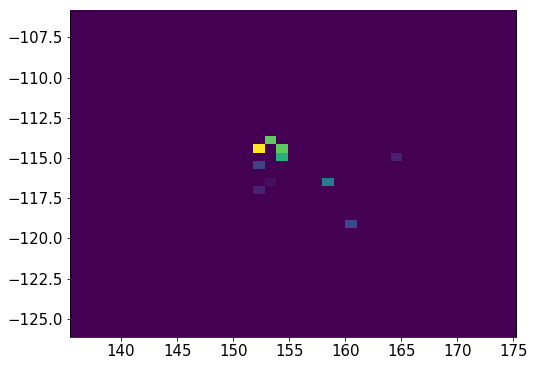

2192    28
2193    28
2194    28
2195    28
2196    28
2197    28
2198    28
2199    28
2200    28
2201    28
2202    28
2203    28
2204    28
2205    28
2206    28
2207    28
2208    28
2209    28
2210    28
2211    28
2212    28
2213    28
2214    28
2215    28
2216    28
2217    28
2219    28
2221    28
2222    28
2223    28
2224    28
2225    28
2226    28
2227    28
2228    28
2229    28
2230    28
Name: Nsipm, dtype: uint16


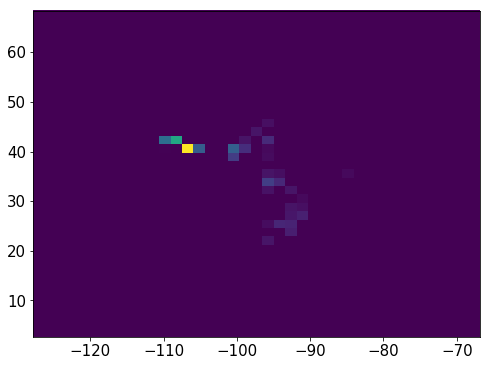

935956    45
935957    45
935958    45
935959    45
935960    45
935961    45
935962    45
935963    45
935964    45
935965    45
935966    45
935967    45
935968    45
935969    45
935970    45
935971    45
935972    45
Name: Nsipm, dtype: uint16


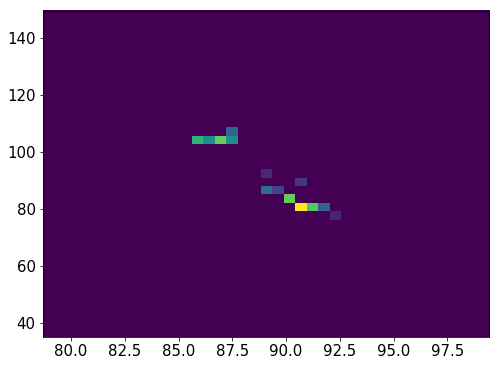

2234    29
2235    29
2236    29
2237    29
2238    29
2239    29
2240    29
2241    29
2242    29
2243    29
2244    29
2245    29
2246    29
2247    29
2248    29
2249    29
2250    29
2251    29
2252    29
2253    29
2254    29
2255    29
2256    29
2257    29
2258    29
2259    29
Name: Nsipm, dtype: uint16


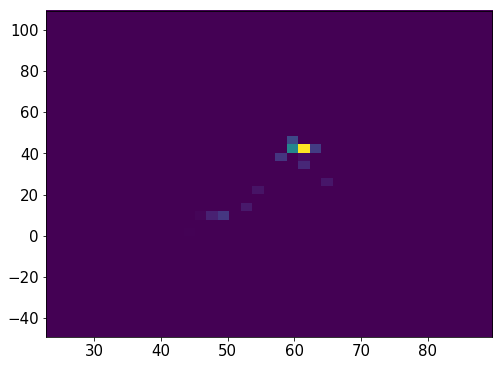

2264    27
2265    27
2266    27
2267    27
2268    27
2269    27
2270    27
2271    27
2272    27
2273    27
2274    27
2275    27
2276    27
2277    27
Name: Nsipm, dtype: uint16


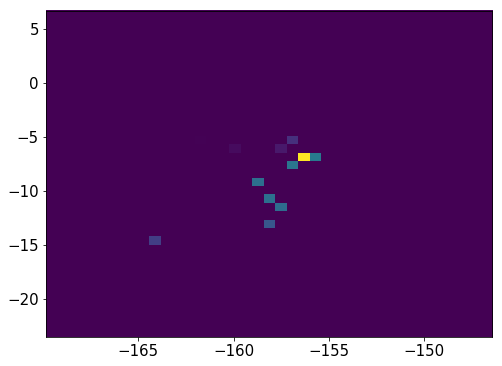

2282    14
2283    14
2284    14
2285    14
2286    14
2287    14
2288    14
2289    14
2290    14
2291    14
2292    14
2293    14
2294    14
2295    14
2296    14
2297    14
2298    14
2299    14
2300    14
2301    14
2302    14
Name: Nsipm, dtype: uint16


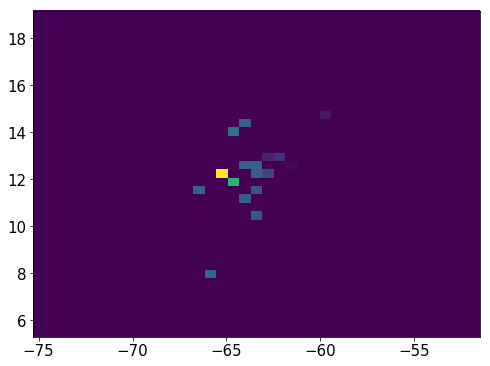

2309    24
2310    24
2311    24
2312    24
2313    24
2314    24
2315    24
2316    24
2317    24
2318    24
2319    24
2320    24
Name: Nsipm, dtype: uint16


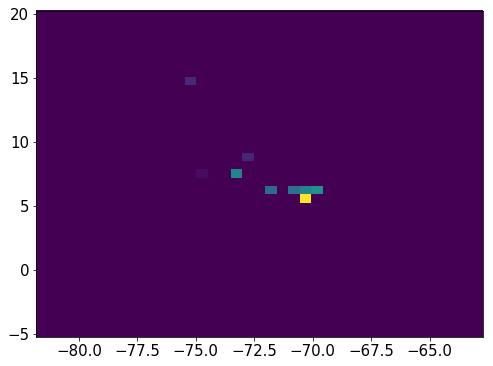

2325    32
2326    32
2327    32
2328    32
2329    32
2330    32
2331    32
2332    32
2333    32
2334    32
2335    32
2336    32
2337    32
2338    32
2339    32
2340    32
2341    32
2342    32
2343    32
2344    32
2345    32
2346    32
2347    32
2348    32
2349    32
2350    32
2351    32
2352    32
Name: Nsipm, dtype: uint16


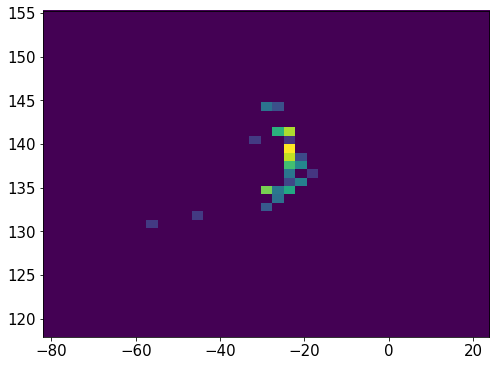

2356    32
2357    32
2358    32
2359    32
2360    32
2361    32
2362    32
2363    32
2364    32
2365    32
2366    32
2367    32
2368    32
2369    32
Name: Nsipm, dtype: uint16


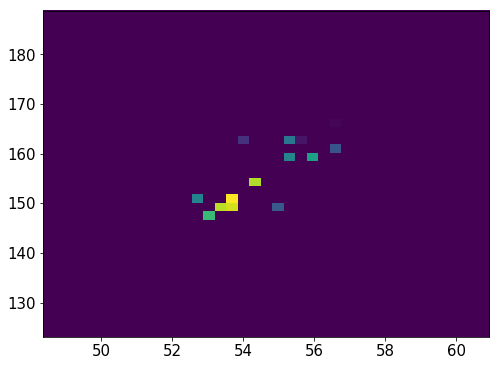

2373    28
2374    28
2375    28
2376    28
2377    28
2378    28
2379    28
2380    28
2381    28
2382    28
2383    28
2384    28
2385    28
2386    28
2387    28
2388    28
2389    28
2390    28
2391    28
2392    28
2393    28
2394    28
2395    28
2396    28
2397    28
Name: Nsipm, dtype: uint16


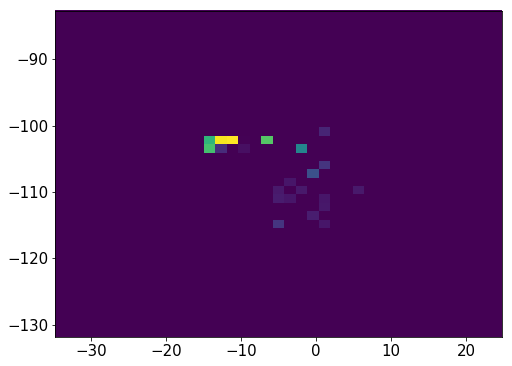

935994    21
935995    21
935996    21
935997    21
935998    21
935999    21
936000    21
936001    21
936002    21
936003    21
936004    21
936005    21
Name: Nsipm, dtype: uint16


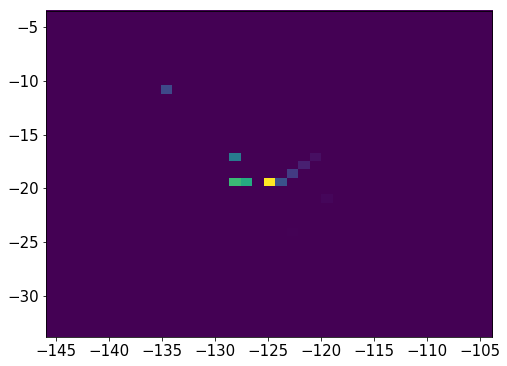

2403    23
2404    23
2405    23
2406    23
2407    23
2408    23
2409    23
2410    23
2411    23
2412    23
2413    23
2414    23
2415    23
2416    23
2417    23
Name: Nsipm, dtype: uint16


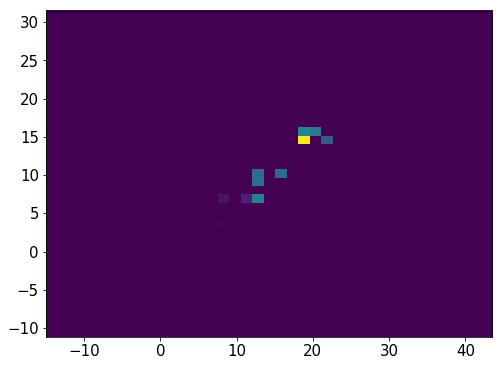

2422    26
2423    26
2424    26
2425    26
2426    26
2427    26
2428    26
2429    26
2430    26
2431    26
2432    26
2433    26
2434    26
2435    26
2436    26
Name: Nsipm, dtype: uint16


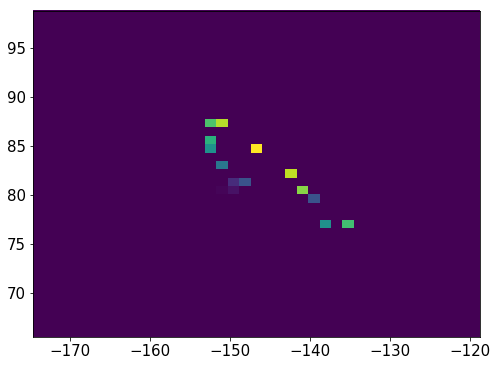

2441    37
2442    37
2443    37
2444    37
2445    37
2446    37
2447    37
2448    37
2449    37
2450    37
2451    37
2452    37
2453    37
2454    37
2455    37
2456    37
2457    37
2458    37
2459    37
2460    37
2461    37
2462    37
Name: Nsipm, dtype: uint16


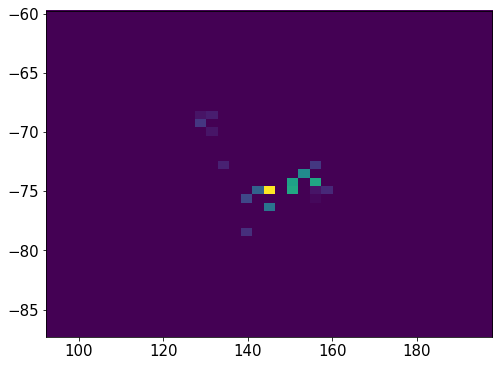

2464    23
2465    23
2466    23
2467    23
2468    23
2469    23
2470    23
2471    23
2472    23
2473    23
2474    23
2475    23
2476    23
2477    23
2478    23
2479    23
2480    23
2481    23
2482    23
2483    23
2484    23
2485    23
2486    23
2487    23
2488    23
2489    23
2490    23
2491    23
2492    23
2493    23
Name: Nsipm, dtype: uint16


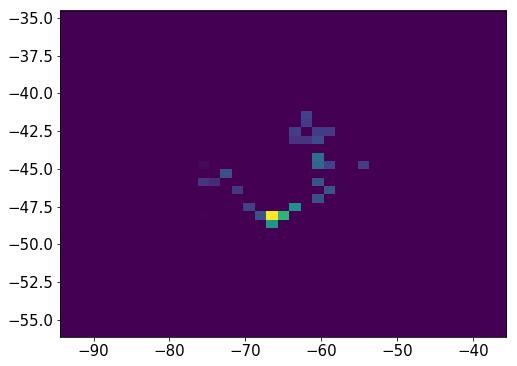

936010    22
936011    22
936012    22
936013    22
936014    22
936015    22
936016    22
936017    22
936018    22
936019    22
936020    22
936021    22
936022    22
936023    22
936024    22
936025    22
936026    22
936027    22
936028    22
936029    22
936030    22
Name: Nsipm, dtype: uint16


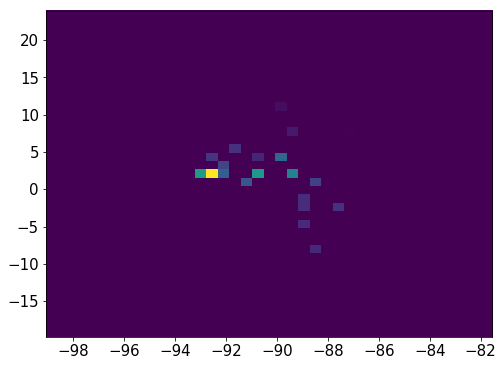

2498    25
2499    25
2500    25
2501    25
2502    25
2503    25
2504    25
2505    25
2506    25
2507    25
2508    25
2509    25
2510    25
2511    25
2512    25
2513    25
2514    25
2515    25
Name: Nsipm, dtype: uint16


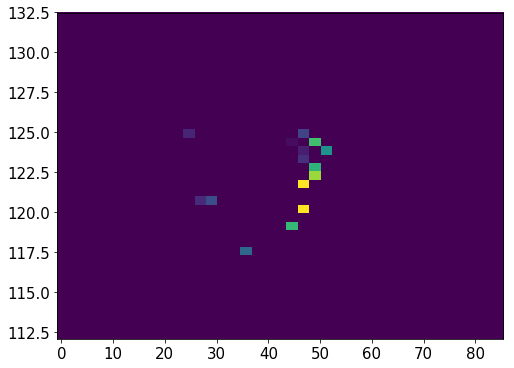

2518    24
2519    24
2520    24
2521    24
2522    24
2523    24
2524    24
2525    24
2526    24
2527    24
2528    24
2529    24
2530    24
2531    24
2532    24
2533    24
2540     1
2541     1
2542     1
Name: Nsipm, dtype: uint16


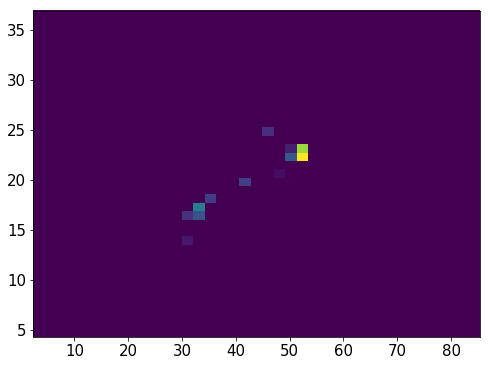

2547    35
2548    35
2549    35
2550    35
2551    35
2552    35
2553    35
2554    35
2555    35
2556    35
2557    35
2558    35
2559    35
2560    35
2561    35
2562    35
2563    35
2564    35
2566    35
2567    35
2569    35
2570    35
2571    35
2572    35
2573    35
2574    35
2575    35
2576    35
2577    35
2578    35
2579    35
2580    35
2581    35
2582    35
2583    35
2584    35
2585    35
2586    35
2587    35
2588    35
2589    35
2590    35
2591    35
2592    35
2593    35
2594    35
2595    35
2596    35
2597    35
2598    35
2599    35
2600    35
2601    35
Name: Nsipm, dtype: uint16


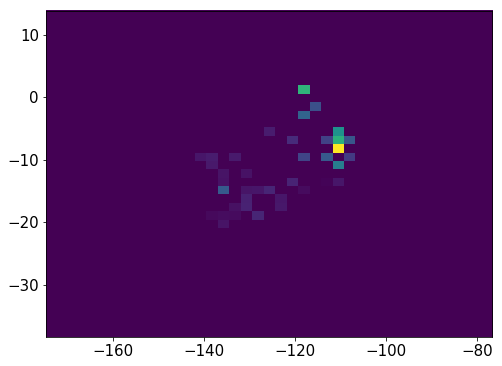

2606    19
2607    19
2608    19
2609    19
2610    19
2611    19
2612    19
2613    19
2614    19
2615    19
2616    19
2617    19
2618    19
2619    19
2620    19
2621    19
2622    19
2623    19
2624    19
2625    19
2626    19
2627    19
2628    19
2629    19
2630    19
2631    19
2632    19
2633    19
2634    19
2635    19
2636    19
2637    19
2638    19
Name: Nsipm, dtype: uint16


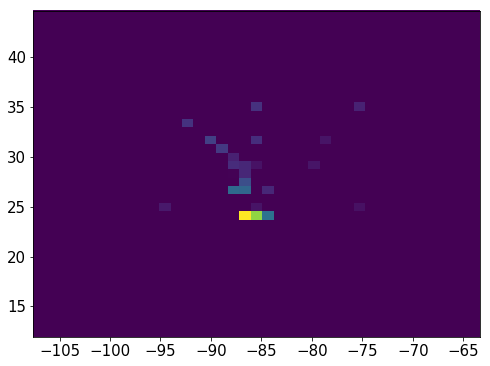

936112    41
936113    41
936114    41
936115    41
936116    41
936117    41
936118    41
936119    41
936120    41
936121    41
936122    41
936123    41
936124    41
936125    41
936126    41
936127    41
936128    41
936129    41
936130    41
Name: Nsipm, dtype: uint16


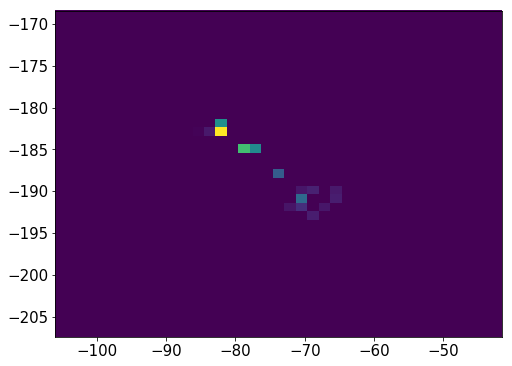

936135    26
936136    26
936137    26
936138    26
936139    26
936140    26
936141    26
936142    26
936143    26
936144    26
936145    26
936146    26
936147    26
936148    26
936149    26
936150    26
936151    26
Name: Nsipm, dtype: uint16


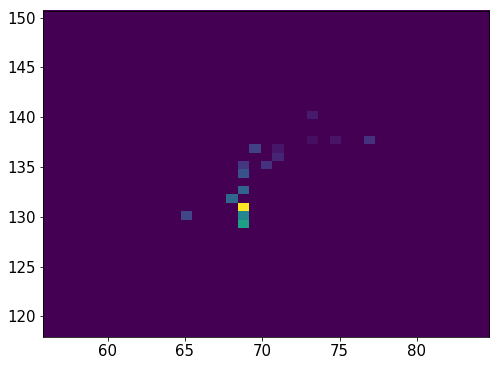

936155    25
936156    25
936157    25
936158    25
936159    25
936160    25
936161    25
936162    25
936163    25
936164    25
936165    25
936166    25
936167    25
936168    25
936169    25
936170    25
936173    25
936175    25
936176    25
936177    25
936178    25
936179    25
936180    25
936181    25
936182    25
936183    25
Name: Nsipm, dtype: uint16


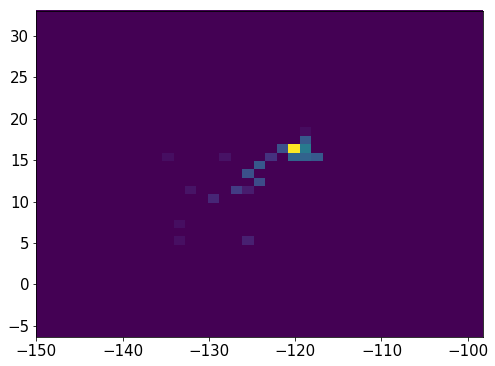

2643    24
2644    24
2645    24
2646    24
2647    24
2648    24
2649    24
2650    24
2651    24
2652    24
2653    24
2654    24
2655    24
2656    24
2657    24
2658    24
Name: Nsipm, dtype: uint16


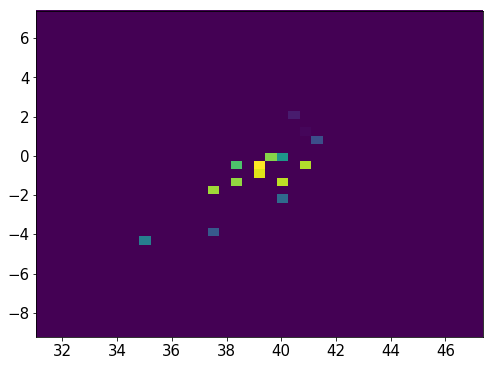

2664    22
2665    22
2666    22
2667    22
2668    22
2669    22
2670    22
2671    22
2672    22
2673    22
2674    22
2675    22
2676    22
2677    22
2678    22
2679    22
2680    22
2681    22
2682    22
2683    22
Name: Nsipm, dtype: uint16


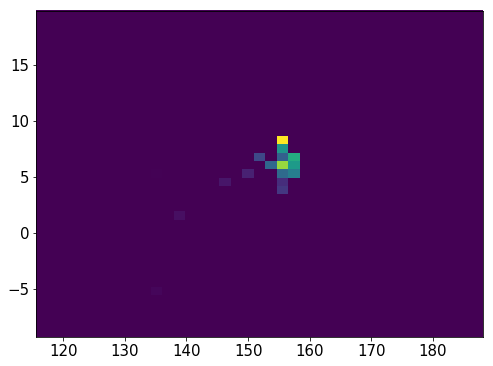

936208    27
936209    27
936210    27
936211    27
936212    27
936213    27
936214    27
936215    27
936216    27
936217    27
936218    27
936219    27
936220    27
936221    27
936222    27
936223    27
Name: Nsipm, dtype: uint16


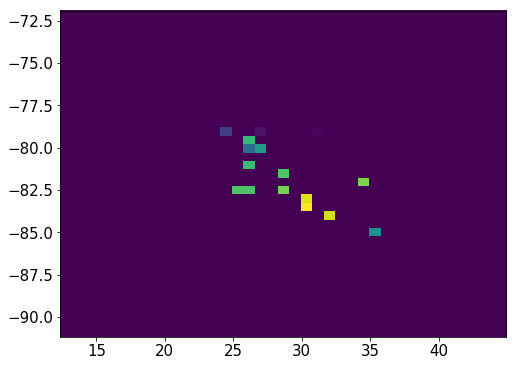

936228    32
936229    32
936230    32
936231    32
936232    32
936233    32
936234    32
936235    32
936236    32
936237    32
936238    32
936239    32
Name: Nsipm, dtype: uint16


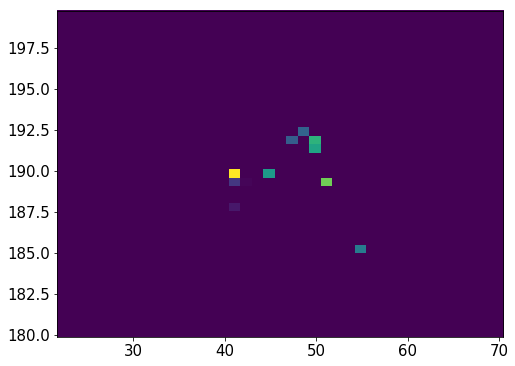

936243    19
936244    19
936245    19
936246    19
936247    19
936248    19
936249    19
936250    19
936251    19
936256     7
936257     7
936258     7
936259     7
936260     7
936261     7
936262     7
936263     7
936264     7
936265     7
Name: Nsipm, dtype: uint16


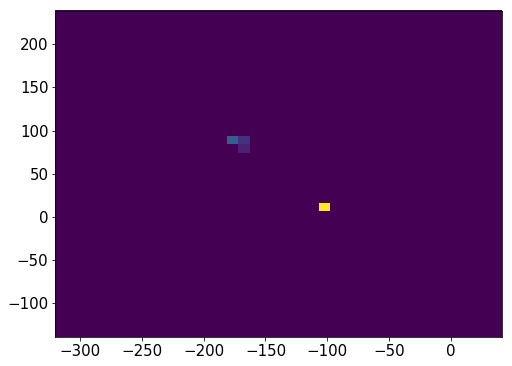

936270    21
936271    21
936272    21
936273    21
936274    21
936275    21
936276    21
936277    21
936278    21
936279    21
936280    21
936281    21
936282    21
Name: Nsipm, dtype: uint16


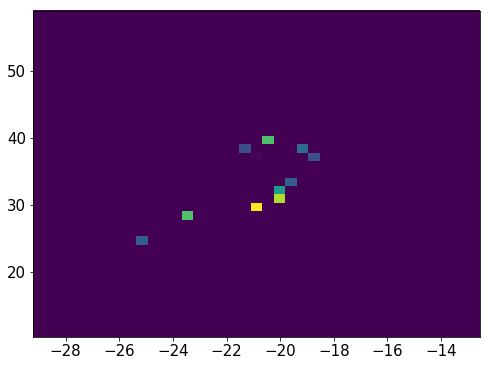

2688    22
2689    22
2690    22
2691    22
2692    22
2693    22
2694    22
2695    22
2696    22
2697    22
2698    22
2701    22
2703    22
2705    22
2706    22
2707    22
2708    22
2713    22
2714    22
Name: Nsipm, dtype: uint16


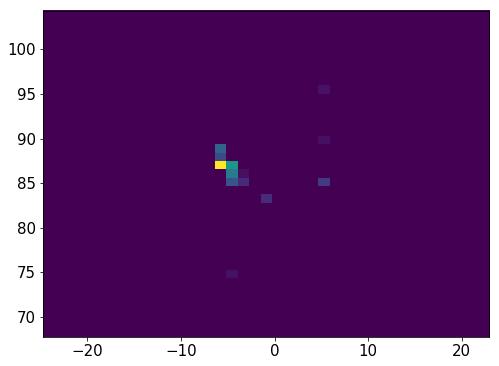

936286    42
936287    42
936288    42
936289    42
936290    42
936291    42
936292    42
936293    42
936294    42
936295    42
936296    42
936297    42
936298    42
Name: Nsipm, dtype: uint16


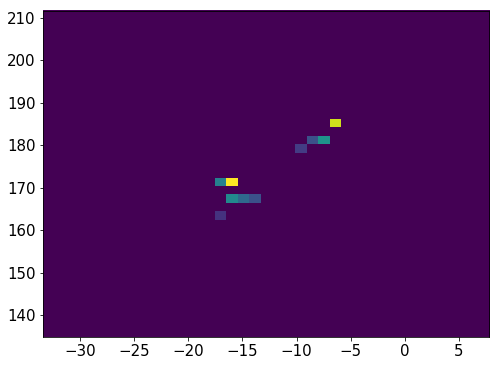

2721    44
2723    44
2724    44
2725    44
2726    44
2727    44
2728    44
2729    44
2730    44
2731    44
2732    44
2733    44
2734    44
2735    44
2736    44
2737    44
2738    44
2739    44
2740    44
2741    44
2742    44
2743    44
2744    44
Name: Nsipm, dtype: uint16


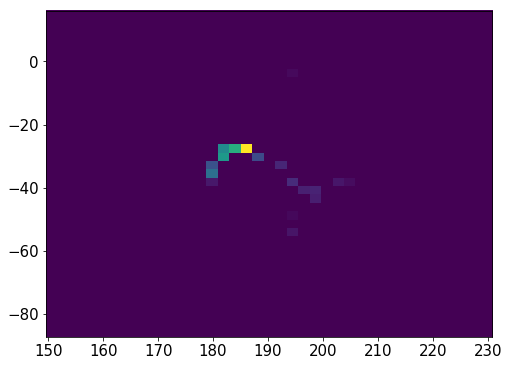

2747    24
2748    24
2749    24
2750    24
2751    24
2752    24
2753    24
2754    24
2755    24
2756    24
2757    24
2758    24
2759    24
2760    24
2761    24
2762    24
2763    24
2764    24
2765    24
2766    24
2767    24
2768    24
2769    24
2770    24
2773    24
2774    24
2775    24
2776    24
2777    24
2778    24
2779    24
2780    24
2781    24
Name: Nsipm, dtype: uint16


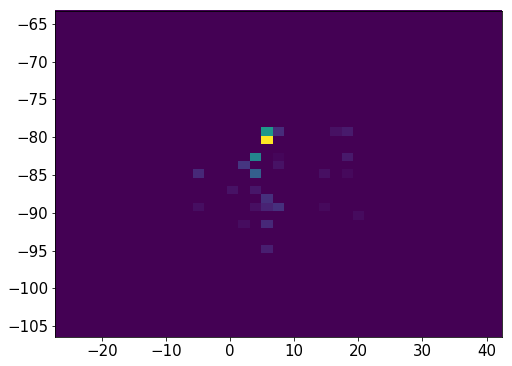

936329    26
936330    26
936331    26
936332    26
936333    26
936334    26
936335    26
936336    26
936337    26
936338    26
936339    26
936340    26
936341    26
936342    26
936343    26
936344    26
936345    26
936346    26
Name: Nsipm, dtype: uint16


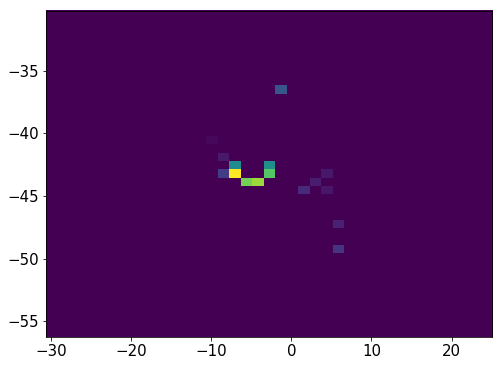

2788    22
2789    22
2790    22
2791    22
2792    22
2793    22
2794    22
2795    22
2796    22
2797    22
2798    22
2799    22
2800    22
2801    22
2802    22
2804    22
2805    22
2806    22
2810     5
2811     5
2812     5
2813     5
2814     5
2815     5
2816     5
2817     5
2818     5
2819     5
Name: Nsipm, dtype: uint16


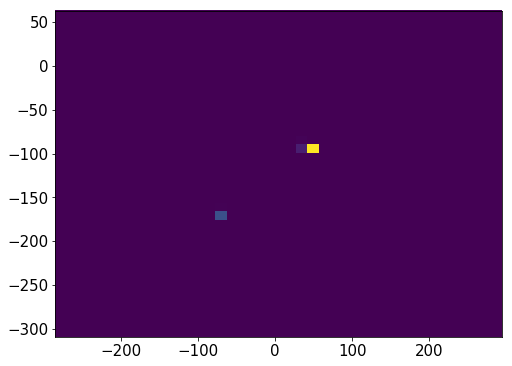

936347    26
936348    26
936349    26
936350    26
936351    26
936352    26
936353    26
936354    26
936355    26
936356    26
936357    26
936358    26
936359    26
936360    26
936361    26
936362    26
936363    26
936364    26
Name: Nsipm, dtype: uint16


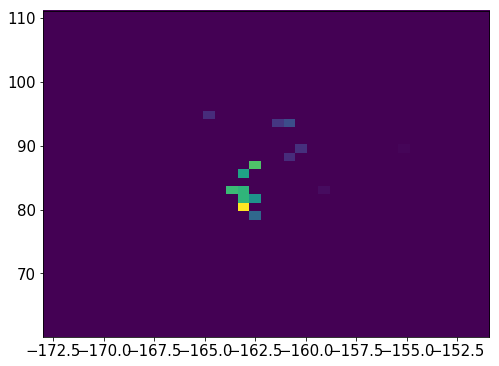

2824    21
2825    21
2826    21
2827    21
2828    21
2829    21
2830    21
2831    21
2832    21
2833    21
2834    21
2835    21
2836    21
2838    21
2839    21
2840    21
2841    21
2842    21
2843    21
2844    21
2845    21
2846    21
2847    21
2848    21
2849    21
2850    21
Name: Nsipm, dtype: uint16


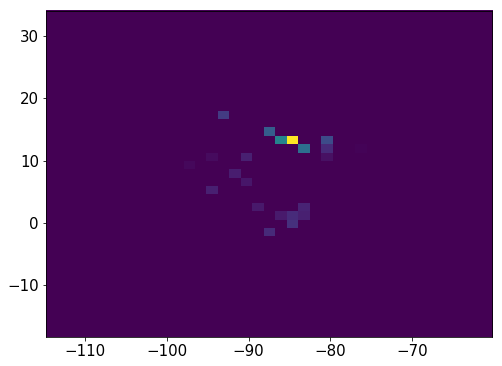

936370    27
936371    27
936372    27
936373    27
936374    27
936375    27
936376    27
936377    27
936378    27
936379    27
936380    27
936381    27
936382    27
936383    27
936384    27
936385    27
Name: Nsipm, dtype: uint16


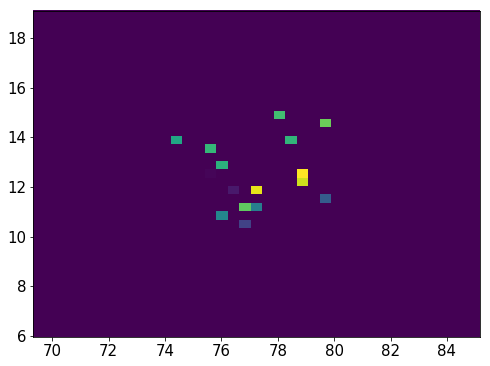

2855    108
2856    108
2857    108
2858    108
2859    108
2860    108
2861    108
2862    108
2863    108
2864    108
2865    108
2866    108
2867    108
2868    108
2869    108
2870    108
2871    108
2872    108
2873    108
2874    108
2875    108
2876    108
2877    108
2878    108
2879    108
2880    108
2881    108
2882    108
2883    108
2884    108
       ... 
2975    108
2976    108
2977    108
2978    108
2979    108
2980    108
2981    108
2982    108
2983    108
2984    108
2985    108
2986    108
2987    108
2988    108
2989    108
2990    108
2991    108
2992    108
2993    108
2994    108
2995    108
2996    108
2997    108
2998    108
2999    108
3000    108
3001    108
3002    108
3003    108
3004    108
Name: Nsipm, dtype: uint16


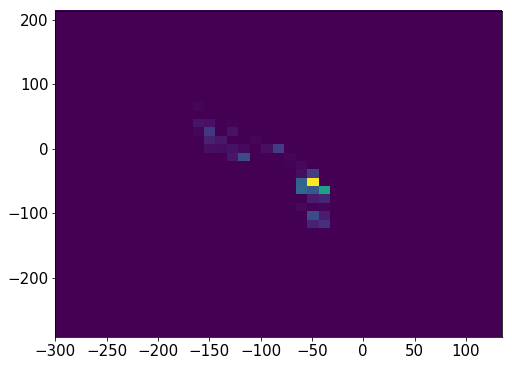

936409    22
936410    22
936411    22
936412    22
936413    22
936414    22
936415    22
936416    22
936417    22
936418    22
936419    22
936420    22
936421    22
936422    22
Name: Nsipm, dtype: uint16


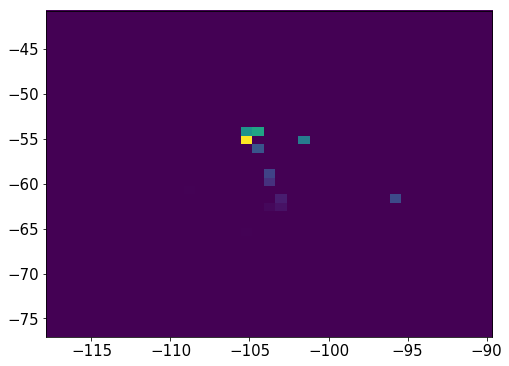

3010    32
3011    32
3012    32
3013    32
3014    32
3015    32
3016    32
3017    32
3018    32
3019    32
3020    32
3021    32
3022    32
3023    32
Name: Nsipm, dtype: uint16


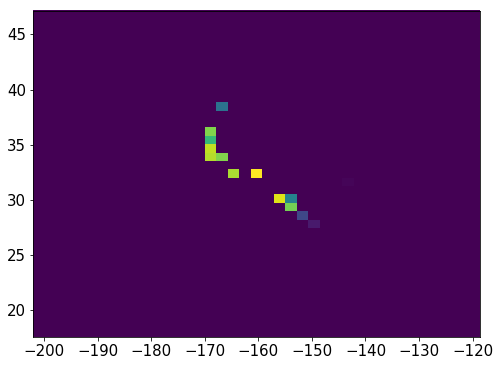

936465    31
936466    31
936468    31
936469    31
936470    31
936471    31
936472    31
936473    31
936474    31
936475    31
936476    31
936477    31
936478    31
936479    31
936480    31
936481    31
936482    31
936483    31
936484    31
936485    31
936486    31
936487    31
936488    31
936489    31
936490    31
936491    31
936492    31
Name: Nsipm, dtype: uint16


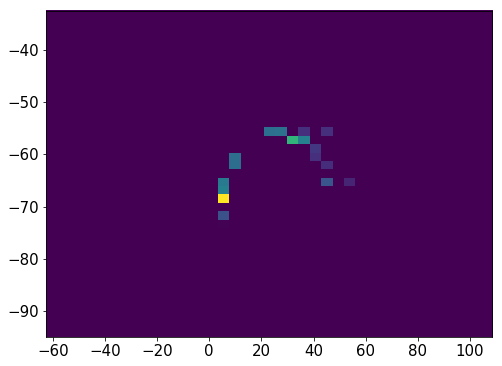

1663428    19
1663429    19
1663430    19
1663431    19
1663432    19
1663433    19
1663434    19
1663435    19
1663436    19
1663437    19
1663438    19
1663439    19
1663440    19
1663441    19
1663442    19
1663443    19
1663444    19
1663445    19
1663446    19
1663447    19
1663448    19
1663449    19
1663450    19
1663451    19
Name: Nsipm, dtype: uint16


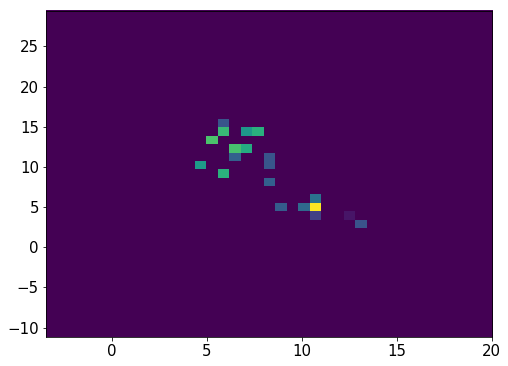

936493    22
936494    22
936495    22
936496    22
936497    22
936498    22
936499    22
936500    22
936501    22
936502    22
936503    22
936504    22
936505    22
936506    22
936507    22
936508    22
936509    22
Name: Nsipm, dtype: uint16


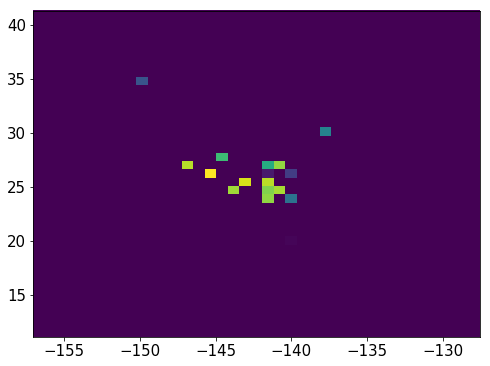

3028    20
3029    20
3030    20
3031    20
3032    20
3033    20
3034    20
3035    20
3036    20
3037    20
3038    20
3039    20
3040    20
3041    20
3042    20
3043    20
3044    20
3045    20
3046    20
3047    20
3048    20
3049    20
3050    20
3056     1
3057     1
3058     1
3059     1
3060     1
Name: Nsipm, dtype: uint16


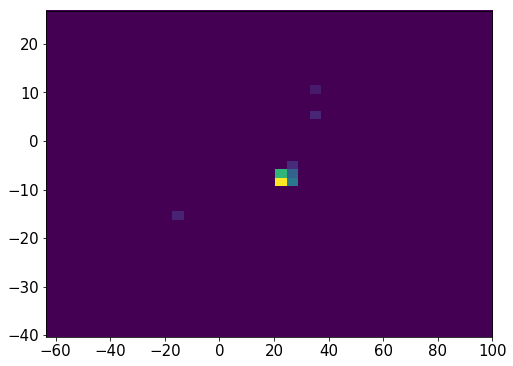

3066    26
3067    26
3068    26
3069    26
3070    26
3071    26
3072    26
3073    26
3074    26
3075    26
3076    26
3077    26
3078    26
3079    26
3080    26
3081    26
3082    26
3083    26
3084    26
3085    26
3086    26
3087    26
3088    26
3089    26
3090    26
Name: Nsipm, dtype: uint16


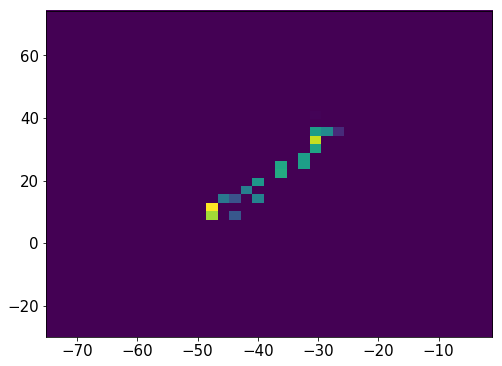

936514    22
936515    22
936516    22
936517    22
936518    22
936519    22
936520    22
936521    22
936522    22
936523    22
936524    22
936525    22
936526    22
936527    22
936528    22
936529    22
936530    22
936531    22
936532    22
936533    22
936534    22
936535    22
936536    22
936537    22
936538    22
936539    22
936540    22
936541    22
936542    22
936543    22
936544    22
Name: Nsipm, dtype: uint16


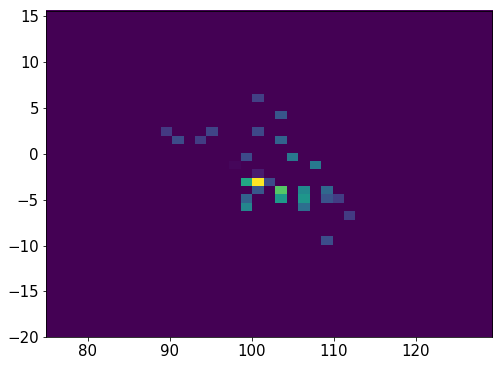

3095    25
3096    25
3097    25
3098    25
3099    25
3100    25
3101    25
3102    25
3103    25
3104    25
3105    25
3106    25
3107    25
3108    25
3109    25
3110    25
3111    25
3112    25
3113    25
3114    25
Name: Nsipm, dtype: uint16


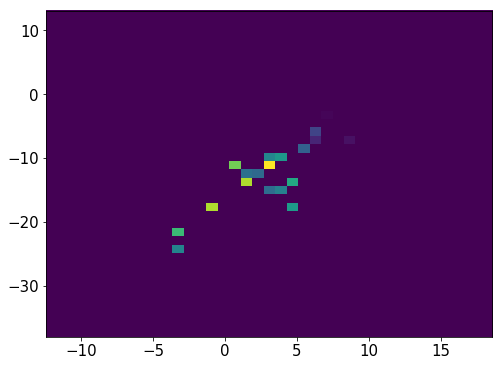

3119    26
3120    26
3121    26
3122    26
3123    26
3124    26
3125    26
3126    26
3127    26
3128    26
3129    26
3130    26
3131    26
3132    26
3133    26
3134    26
Name: Nsipm, dtype: uint16


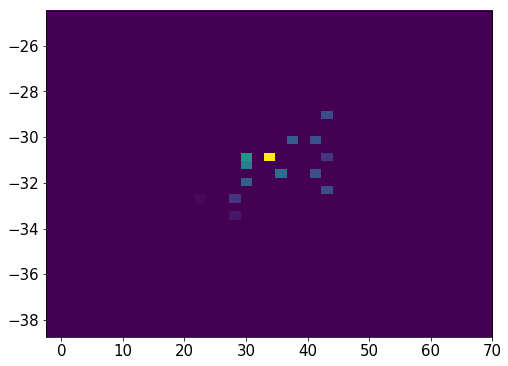

3153    20
3154    20
3155    20
3156    20
3157    20
3158    20
3159    20
3160    20
3161    20
3162    20
3163    20
Name: Nsipm, dtype: uint16


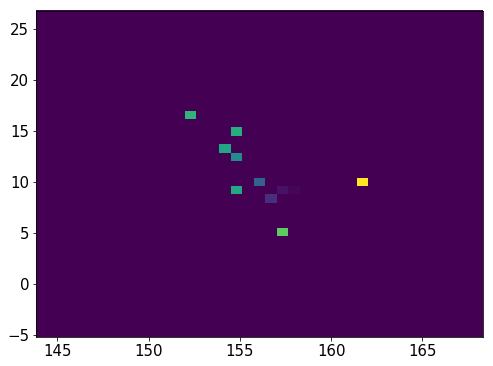

3164    24
3165    24
3166    24
3167    24
3168    24
3169    24
3170    24
3171    24
3172    24
3173    24
3174    24
3175    24
3176    24
3177    24
3178    24
3179    24
3180    24
3181    24
3182    24
3183    24
3184    24
3185    24
3192    24
3193    24
3194    24
3195    24
Name: Nsipm, dtype: uint16


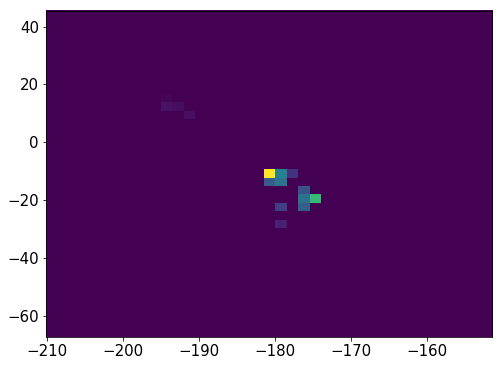

3198    22
3199    22
3200    22
3201    22
3202    22
3203    22
3204    22
3205    22
3206    22
3207    22
3208    22
3209    22
3210    22
3211    22
3212    22
3213    22
3214    22
3215    22
3216    22
Name: Nsipm, dtype: uint16


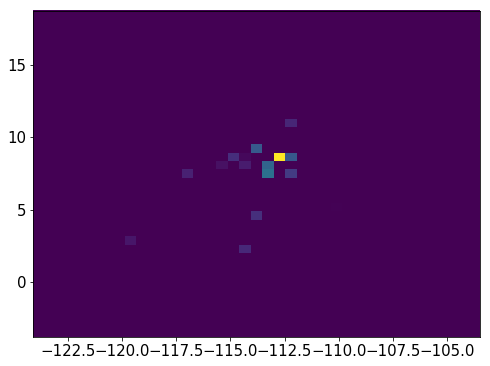

936608    24
936609    24
936610    24
936611    24
936612    24
936613    24
936614    24
936615    24
936616    24
936617    24
936618    24
936619    24
936620    24
936621    24
936622    24
936623    24
936624    24
936625    24
Name: Nsipm, dtype: uint16


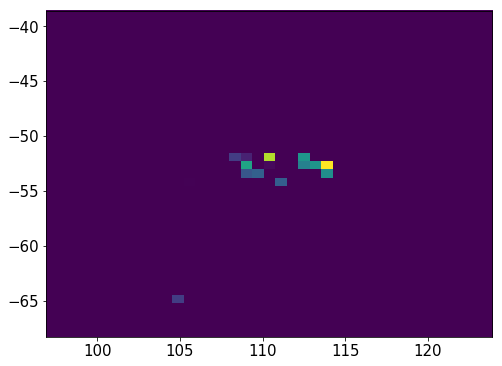

3221    30
3222    30
3223    30
3224    30
3225    30
3226    30
3227    30
3228    30
3229    30
3230    30
3231    30
3232    30
3233    30
3234    30
3235    30
Name: Nsipm, dtype: uint16


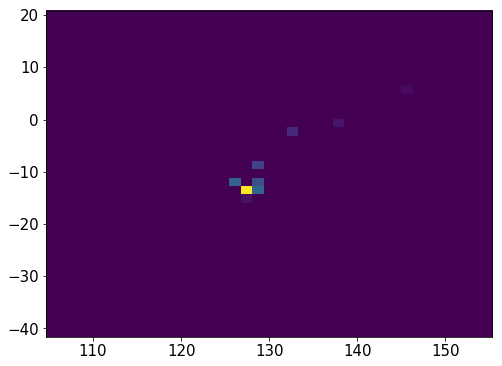

936630    27
936631    27
936632    27
936633    27
936634    27
936635    27
936636    27
936637    27
936638    27
936639    27
936640    27
936641    27
936642    27
936643    27
936644    27
936645    27
936646    27
936647    27
936648    27
Name: Nsipm, dtype: uint16


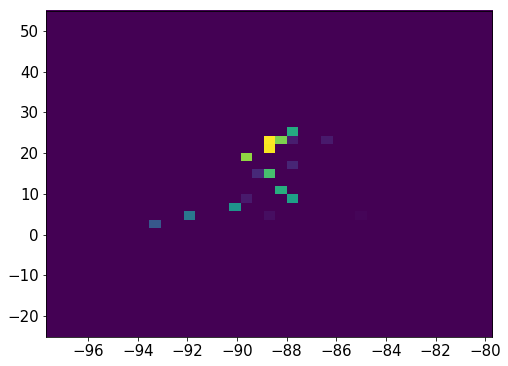

3242    22
3243    22
3244    22
3245    22
3246    22
3247    22
3248    22
3249    22
3250    22
3251    22
3252    22
3253    22
3254    22
3255    22
3256    22
3257    22
3258    22
3259    22
3260    22
3265    22
3266    22
3267    22
3269    22
3270    22
3271    22
3272    22
Name: Nsipm, dtype: uint16


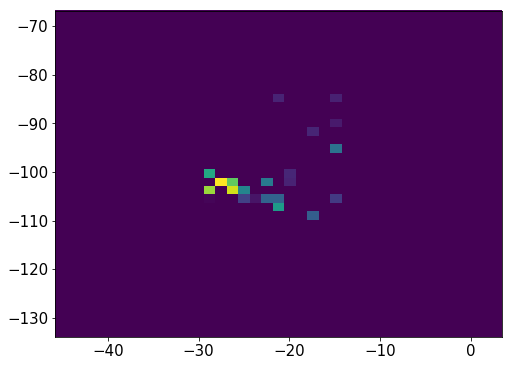

3278    35
3279    35
3280    35
3281    35
3282    35
3283    35
3284    35
3285    35
3286    35
3287    35
3288    35
3289    35
3290    35
3291    35
3292    35
3293    35
3294    35
3295    35
3296    35
Name: Nsipm, dtype: uint16


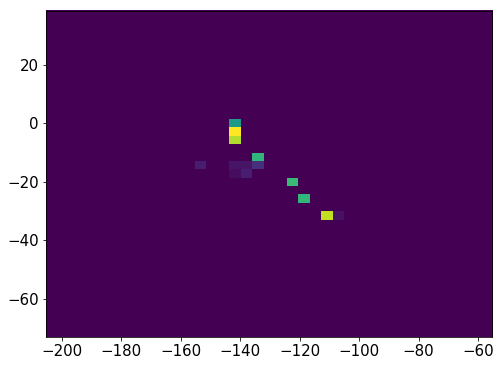

936653    28
936654    28
936655    28
936656    28
936657    28
936658    28
936659    28
936660    28
936661    28
936662    28
936663    28
936664    28
936665    28
936667    28
936668    28
936669    28
936670    28
936671    28
936672    28
936673    28
936674    28
936675    28
936676    28
936677    28
936678    28
936680    28
936682    28
936683    28
936684    28
936687    28
936689    28
936690    28
936691    28
936692    28
936693    28
936694    28
936695    28
Name: Nsipm, dtype: uint16


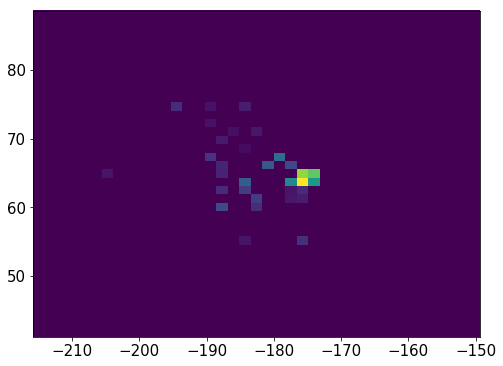

3301    37
3302    37
3303    37
3304    37
3305    37
3306    37
3307    37
3308    37
3309    37
3310    37
3311    37
3312    37
3313    37
3314    37
3315    37
3316    37
3317    37
3318    37
3319    37
3320    37
3321    37
3322    37
3323    37
3324    37
3325    37
Name: Nsipm, dtype: uint16


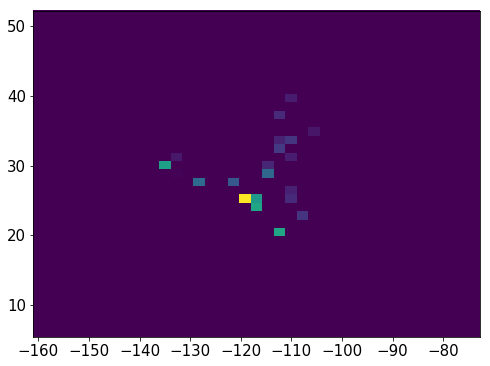

3330    20
3331    20
3332    20
3333    20
3334    20
3335    20
3336    20
3337    20
3338    20
3339    20
3340    20
3341    20
3342    20
3343    20
3344    20
3345    20
3346    20
3347    20
3348    20
3349    20
3350    20
3351    20
3359     2
3360     2
3361     2
3362     2
3363     2
3364     2
Name: Nsipm, dtype: uint16


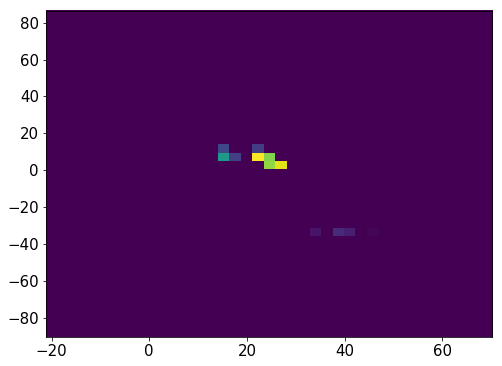

936744    26
936745    26
936746    26
936747    26
936748    26
936749    26
936750    26
936751    26
936752    26
936753    26
936754    26
936755    26
936756    26
936757    26
936758    26
936759    26
936760    26
936761    26
936762    26
936763    26
Name: Nsipm, dtype: uint16


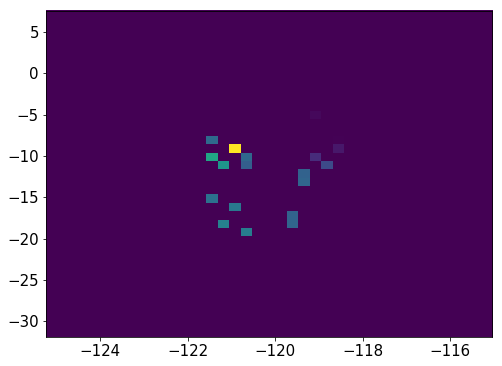

936769    20
936770    20
936771    20
936772    20
936773    20
936774    20
936775    20
936776    20
936777    20
936778    20
936779    20
936780    20
936781    20
936782    20
936783    20
936784    20
936785    20
936786    20
936787    20
Name: Nsipm, dtype: uint16


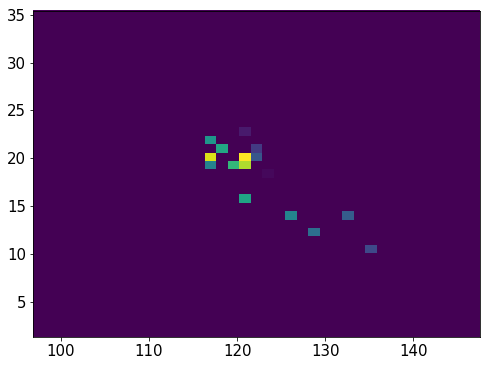

3370    27
3371    27
3372    27
3373    27
3374    27
3375    27
3376    27
3377    27
3378    27
3379    27
3380    27
3381    27
3382    27
Name: Nsipm, dtype: uint16


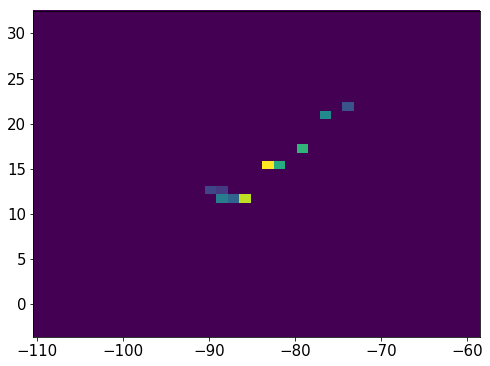

3386    20
3387    20
3388    20
3389    20
3390    20
3391    20
3392    20
3393    20
3394    20
3395    20
3396    20
3397    20
3398    20
3399    20
3400    20
3401    20
3402    20
3403    20
3404    20
3405    20
3406    20
3407    20
Name: Nsipm, dtype: uint16


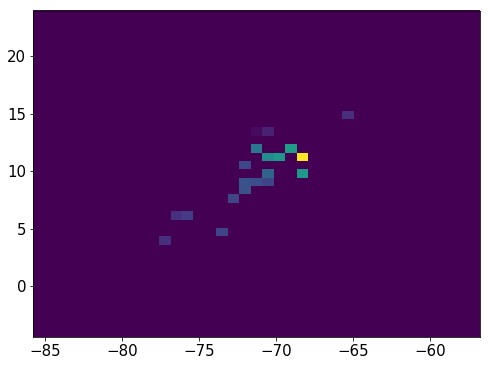

936853    21
936854    21
936855    21
936856    21
936857    21
936858    21
936859    21
936860    21
936861    21
936862    21
936863    21
936864    21
936865    21
936866    21
936867    21
936868    21
936869    21
936870    21
936871    21
936872    21
936873    21
936874    21
936875    21
936876    21
936877    21
Name: Nsipm, dtype: uint16


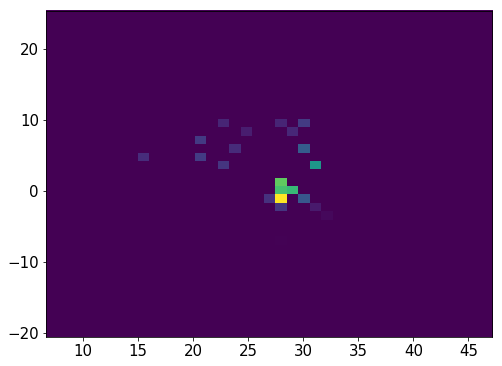

936882    29
936883    29
936884    29
936885    29
936886    29
936887    29
936888    29
936889    29
936890    29
936891    29
936892    29
936893    29
936894    29
Name: Nsipm, dtype: uint16


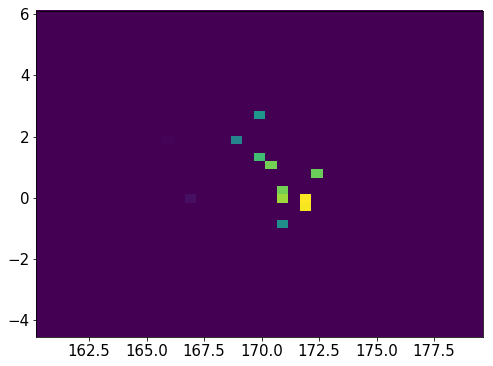

936899    24
936900    24
936901    24
936902    24
936903    24
936904    24
936905    24
936906    24
936907    24
936908    24
936909    24
936910    24
936911    24
936912    24
936913    24
936914    24
936915    24
936917    24
936922     1
936923     1
936924     1
936925     1
936927     1
936928     1
Name: Nsipm, dtype: uint16


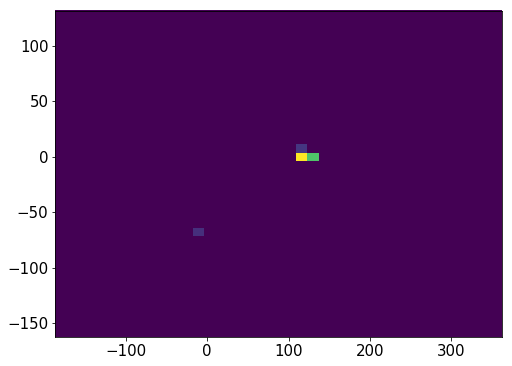

3412    22
3413    22
3414    22
3415    22
3416    22
3417    22
3418    22
3419    22
3420    22
3421    22
3422    22
3423    22
3424    22
3425    22
3426    22
3427    22
3428    22
3429    22
3431    22
3432    22
3433    22
3434    22
3435    22
3436    22
3437    22
3438    22
3439    22
Name: Nsipm, dtype: uint16


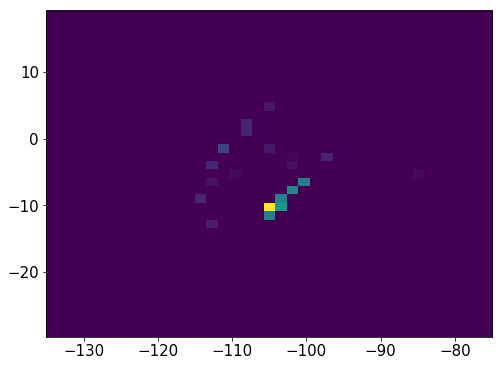

3444    31
3445    31
3446    31
3447    31
3448    31
3449    31
3450    31
3451    31
3452    31
3453    31
3454    31
3455    31
3456    31
3457    31
Name: Nsipm, dtype: uint16


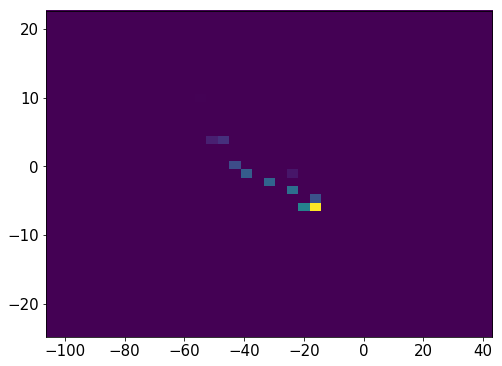

3461    26
3462    26
3463    26
3464    26
3465    26
3466    26
3467    26
3468    26
3469    26
3470    26
3471    26
3472    26
3473    26
3474    26
3475    26
3476    26
3477    26
3478    26
3479    26
3480    26
3481    26
3482    26
Name: Nsipm, dtype: uint16


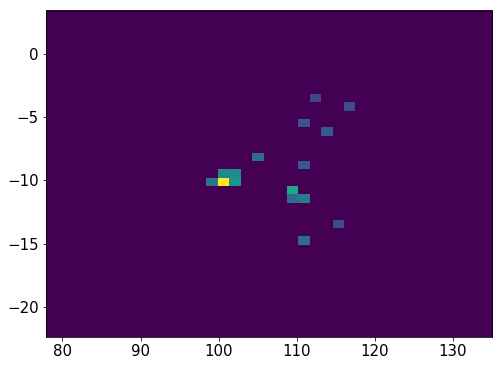

936933    27
936934    27
936935    27
936936    27
936937    27
936938    27
936939    27
936940    27
936941    27
936942    27
936943    27
936944    27
936945    27
936946    27
936947    27
936948    27
936949    27
936950    27
Name: Nsipm, dtype: uint16


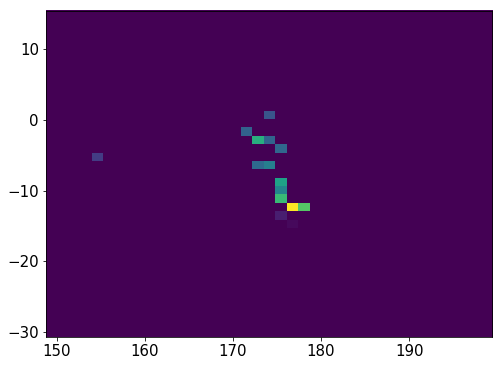

936956    23
936957    23
936958    23
936959    23
936960    23
936961    23
936962    23
936963    23
936964    23
936965    23
936966    23
936967    23
936968    23
936969    23
936970    23
936971    23
936972    23
936973    23
Name: Nsipm, dtype: uint16


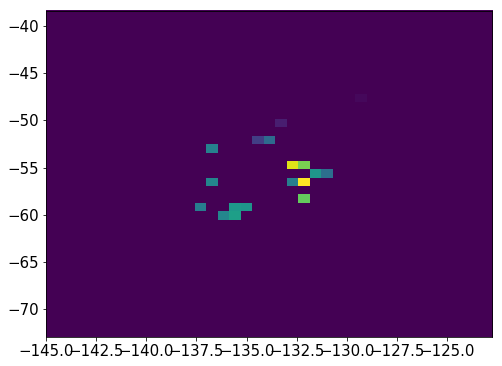

936979    30
936980    30
936981    30
936982    30
936983    30
936984    30
936985    30
936986    30
936987    30
936988    30
936989    30
936990    30
936991    30
936992    30
936993    30
936994    30
936995    30
936996    30
936997    30
936998    30
936999    30
937000    30
937001    30
937002    30
937003    30
937004    30
937005    30
Name: Nsipm, dtype: uint16


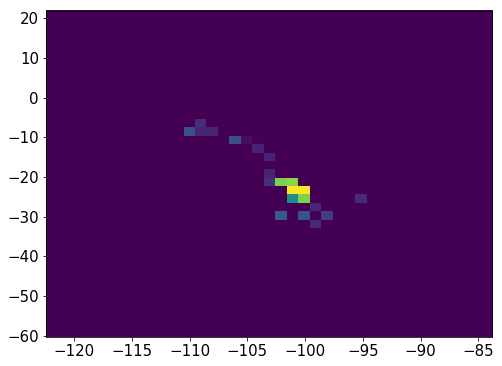

937011    31
937012    31
937013    31
937014    31
937015    31
937016    31
937017    31
937018    31
937019    31
937020    31
937021    31
937022    31
937023    31
937024    31
937025    31
937026    31
937027    31
937028    31
937029    31
937030    31
937031    31
Name: Nsipm, dtype: uint16


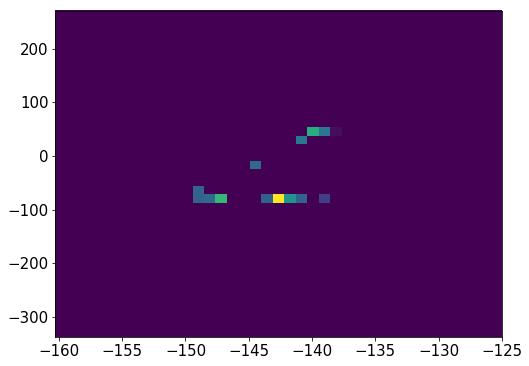

937037    27
937038    27
937039    27
937040    27
937041    27
937042    27
937043    27
937044    27
937045    27
937046    27
937047    27
937048    27
937053     2
937054     2
937055     2
Name: Nsipm, dtype: uint16


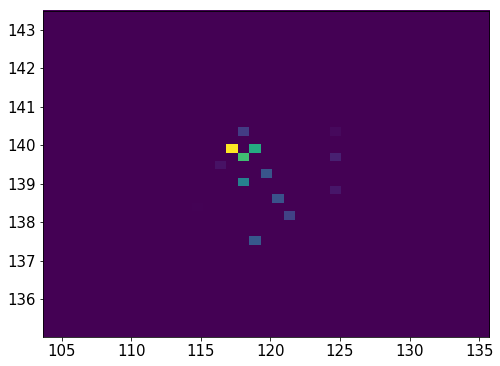

3487    26
3488    26
3489    26
3490    26
3491    26
3492    26
3493    26
3494    26
3495    26
3496    26
3497    26
Name: Nsipm, dtype: uint16


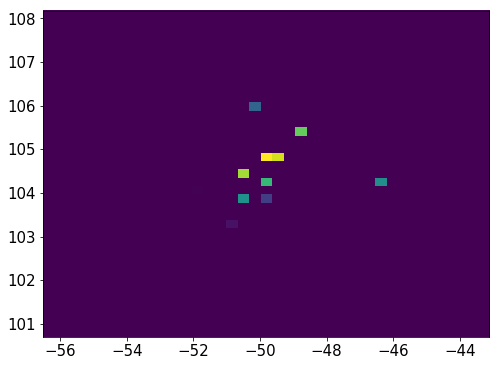

937082    21
937083    21
937084    21
937085    21
937086    21
937087    21
937088    21
937089    21
937090    21
937091    21
937092    21
937093    21
937094    21
937095    21
937096    21
937097    21
937098    21
937099    21
Name: Nsipm, dtype: uint16


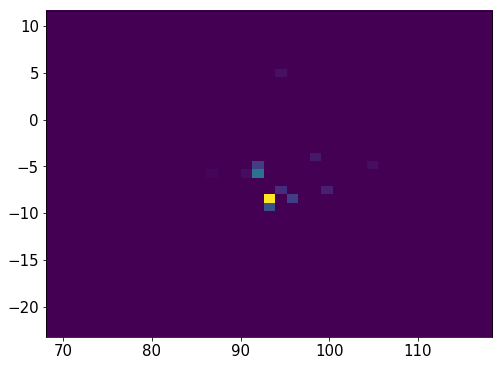

1470597    26
1470598    26
1470599    26
1470600    26
1470601    26
1470602    26
1470603    26
1470604    26
1470605    26
1470606    26
1470607    26
1470608    26
1470609    26
1470610    26
1470617    26
1470618    26
1470619    26
1470620    26
1470621    26
Name: Nsipm, dtype: uint16


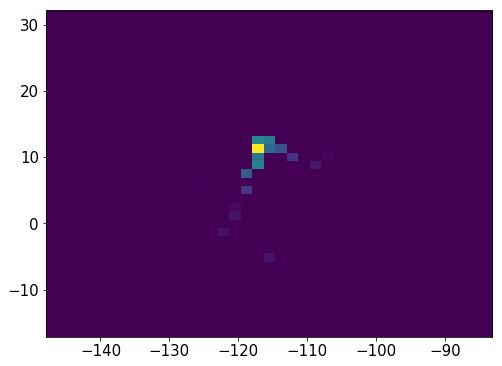

3503    22
3504    22
3505    22
3506    22
3507    22
3508    22
3509    22
3510    22
3511    22
3512    22
3513    22
3514    22
3515    22
3516    22
3517    22
3518    22
3519    22
3522    22
3523    22
3524    22
3525    22
3526    22
3527    22
3528    22
3529    22
3530    22
3531    22
3532    22
Name: Nsipm, dtype: uint16


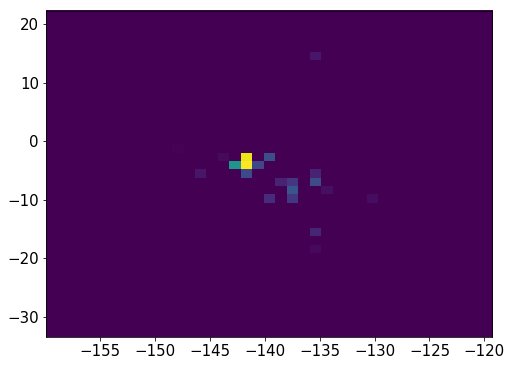

937103    19
937104    19
937105    19
937106    19
937107    19
937108    19
937109    19
937110    19
937111    19
937112    19
937113    19
937114    19
937115    19
937116    19
937117    19
937121    20
937122    20
937123    20
937124    20
937125    20
937126    20
937127    20
937128    20
Name: Nsipm, dtype: uint16


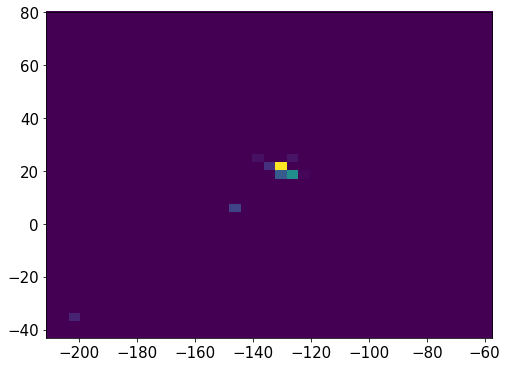

3541    47
3542    47
3543    47
3544    47
3545    47
3546    47
3547    47
3548    47
3549    47
3550    47
3551    47
3552    47
3553    47
3554    47
3555    47
Name: Nsipm, dtype: uint16


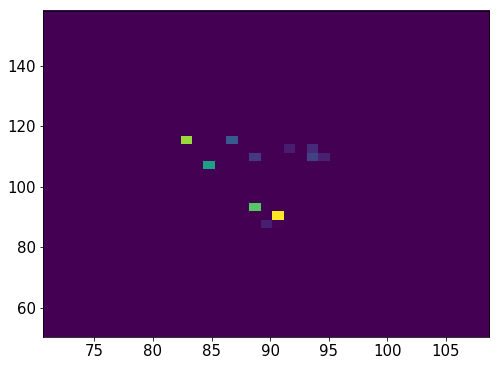

3559    26
3560    26
3561    26
3562    26
3563    26
3564    26
3565    26
3566    26
3567    26
3568    26
3569    26
3570    26
3571    26
3572    26
3573    26
3574    26
3575    26
Name: Nsipm, dtype: uint16


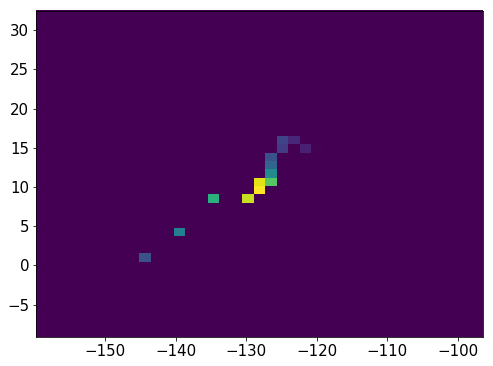

3581    21
3582    21
3583    21
3584    21
3585    21
3586    21
3587    21
3588    21
3589    21
3590    21
3591    21
3592    21
3593    21
3594    21
3595    21
3596    21
3597    21
3598    21
3599    21
3600    21
3601    21
3602    21
3603    21
3604    21
Name: Nsipm, dtype: uint16


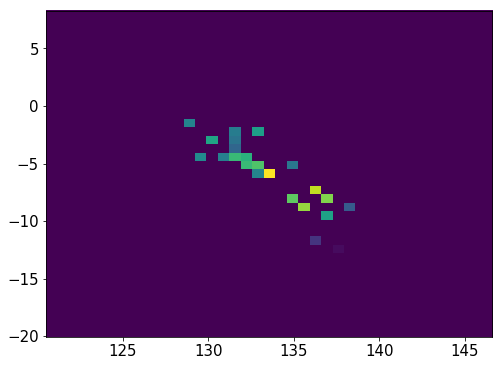

937172    44
937173    44
937174    44
937175    44
937176    44
937177    44
937178    44
937179    44
937180    44
937181    44
937182    44
937183    44
937184    44
937185    44
937186    44
937187    44
937188    44
937189    44
937190    44
937191    44
937192    44
937193    44
937194    44
937195    44
Name: Nsipm, dtype: uint16


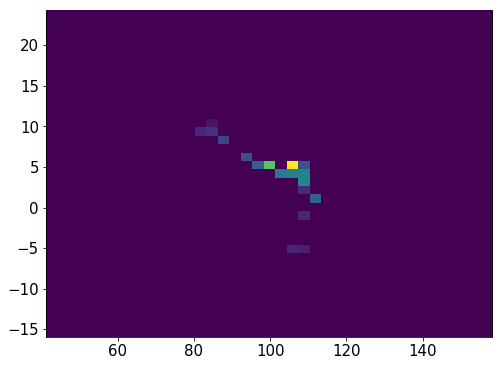

3609    22
3610    22
3611    22
3612    22
3613    22
3614    22
3615    22
3616    22
3617    22
3618    22
3619    22
3620    22
3621    22
3622    22
3623    22
Name: Nsipm, dtype: uint16


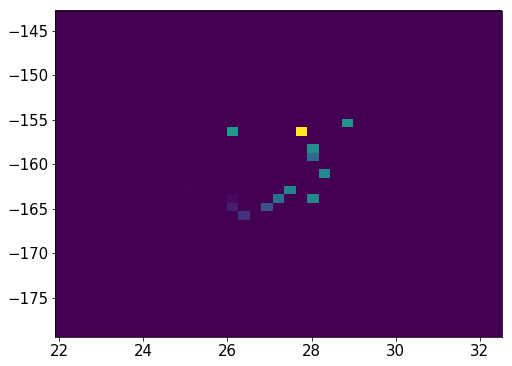

3629    22
3630    22
3631    22
3632    22
3633    22
3634    22
3635    22
3636    22
3637    22
3638    22
3639    22
3640    22
3641    22
3642    22
3643    22
3644    22
3645    22
3646    22
3647    22
3648    22
3649    22
3650    22
3651    22
3652    22
3653    22
Name: Nsipm, dtype: uint16


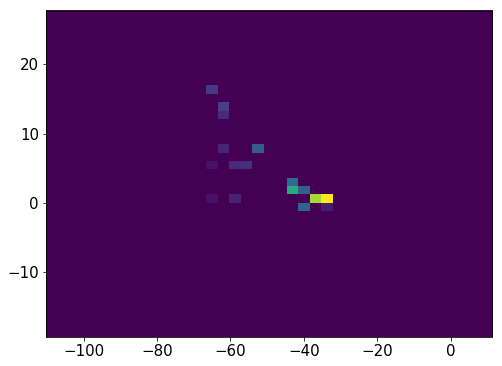

937226    27
937227    27
937228    27
937229    27
937230    27
937231    27
937232    27
937233    27
937234    27
937235    27
937236    27
937237    27
937238    27
937239    27
937240    27
937241    27
937242    27
937243    27
937244    27
937245    27
937246    27
937247    27
937248    27
937249    27
937250    27
937251    27
Name: Nsipm, dtype: uint16


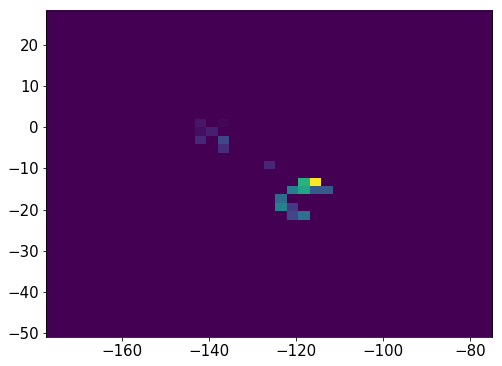

937257    23
937258    23
937259    23
937260    23
937261    23
937262    23
937263    23
937264    23
937265    23
937266    23
937267    23
937268    23
937269    23
937270    23
937271    23
937272    23
937273    23
937274    23
937275    23
Name: Nsipm, dtype: uint16


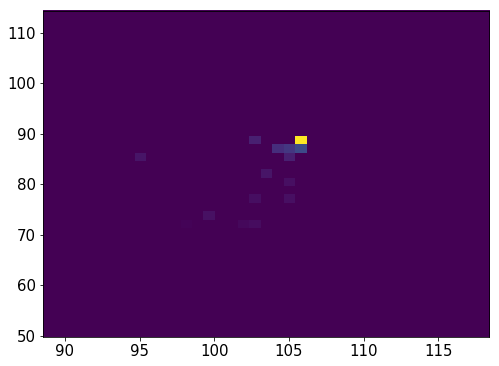

3657    23
3658    23
3659    23
3660    23
3661    23
3662    23
3663    23
3664    23
3665    23
3666    23
3667    23
3668    23
3669    23
3670    23
3671    23
3672    23
3673    23
3674    23
3680     9
3681     9
3682     9
3683     9
3684     9
3685     9
3686     9
Name: Nsipm, dtype: uint16


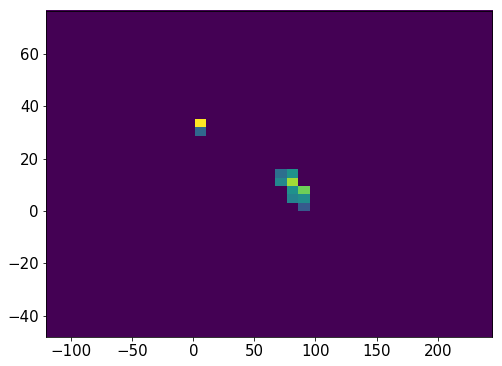

937280    29
937281    29
937282    29
937283    29
937284    29
937285    29
937286    29
937287    29
937288    29
937289    29
937290    29
937291    29
937292    29
937293    29
937294    29
937295    29
937296    29
937297    29
937298    29
937299    29
937300    29
937301    29
937302    29
937304     9
937305     9
937306     9
937307     9
937308     9
937309     9
937310     9
937311     9
937312     9
937313     9
Name: Nsipm, dtype: uint16


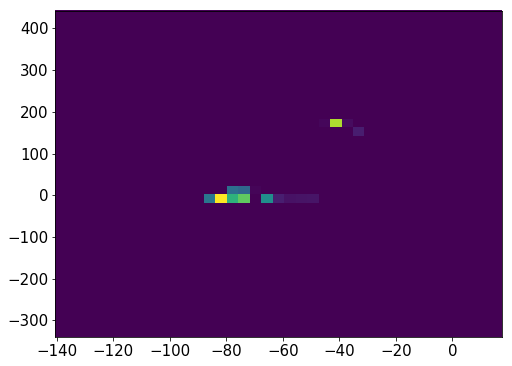

937319    29
937320    29
937321    29
937322    29
937323    29
937324    29
937325    29
937326    29
937327    29
937328    29
937329    29
937330    29
937331    29
937332    29
937333    29
937334    29
937335    29
937336    29
Name: Nsipm, dtype: uint16


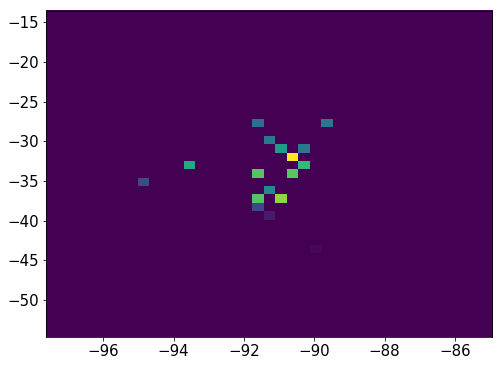

937340    33
937341    33
937342    33
937343    33
937344    33
937345    33
937346    33
937347    33
937348    33
937349    33
937350    33
937351    33
937352    33
937353    33
937354    33
937355    33
937356    33
937358    33
937359    33
937360    33
937361    33
937362    33
937363    33
937364    33
937365    33
937366    33
937368    33
937373    33
937374    33
937375    33
937376    33
Name: Nsipm, dtype: uint16


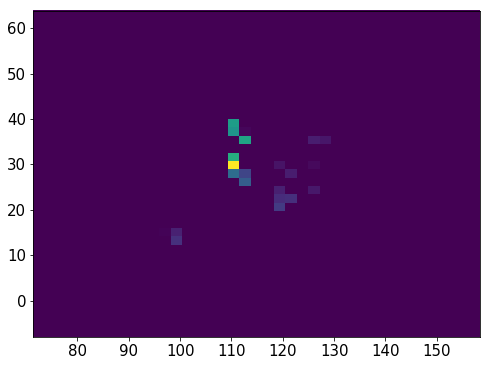

3692    36
3693    36
3694    36
3695    36
3696    36
3697    36
3698    36
3699    36
3700    36
3701    36
3702    36
3703    36
3709     2
3710     2
3711     2
3712     2
Name: Nsipm, dtype: uint16


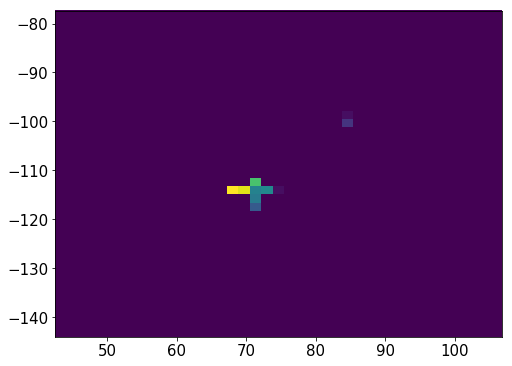

3717    32
3718    32
3719    32
3720    32
3721    32
3722    32
3723    32
3724    32
3725    32
3726    32
3727    32
3728    32
3729    32
3730    32
3731    32
3732    32
3733    32
Name: Nsipm, dtype: uint16


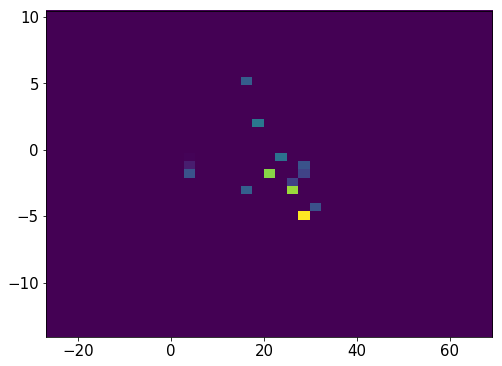

3737    30
3738    30
3739    30
3740    30
3741    30
3742    30
3743    30
3744    30
3745    30
3746    30
3747    30
3748    30
3749    30
3750    30
3751    30
3752    30
Name: Nsipm, dtype: uint16


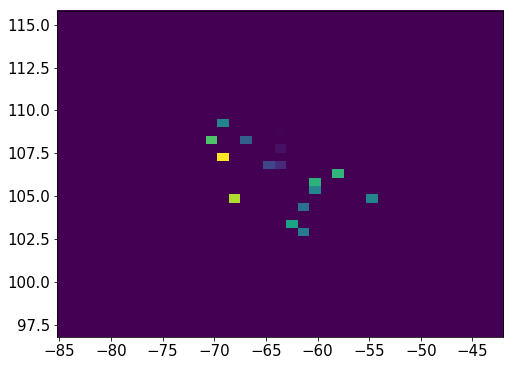

3756    28
3757    28
3758    28
3759    28
3760    28
3761    28
3762    28
3763    28
3764    28
3765    28
3766    28
3767    28
3768    28
3769    28
3770    28
3771    28
3772    28
3773    28
3774    28
3775    28
3776    28
3777    28
3778    28
3779    28
3780    28
3781    28
3782    28
3783    28
Name: Nsipm, dtype: uint16


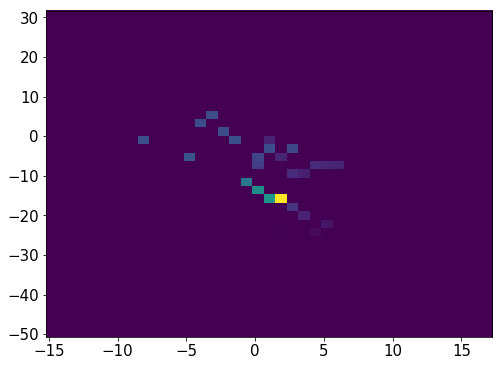

1899037    21
1899038    21
1899039    21
1899040    21
1899041    21
1899042    21
1899043    21
1899044    21
1899045    21
1899046    21
1899047    21
1899048    21
1899049    21
Name: Nsipm, dtype: uint16


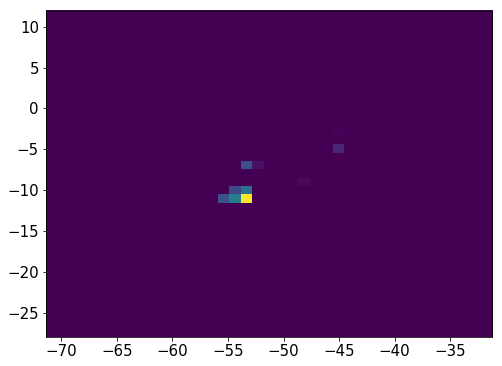

937417    28
937418    28
937419    28
937420    28
937421    28
937422    28
937423    28
937424    28
937425    28
937426    28
937427    28
937428    28
937429    28
937430    28
937431    28
937432    28
937433    28
937434    28
937435    28
Name: Nsipm, dtype: uint16


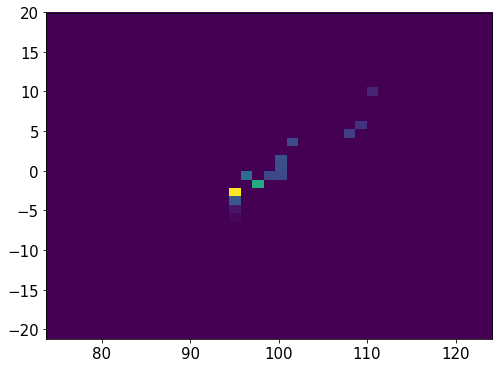

3789    40
3790    40
3791    40
3792    40
3793    40
3794    40
3795    40
3796    40
3797    40
3798    40
3799    40
3800    40
Name: Nsipm, dtype: uint16


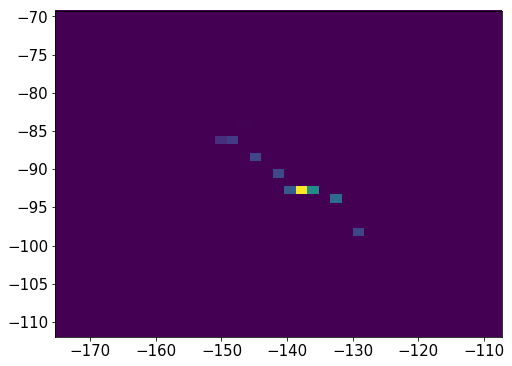

3804    41
3805    41
3806    41
3807    41
3808    41
3809    41
3810    41
3811    41
3812    41
3813    41
3814    41
3815    41
3816    41
3817    41
3818    41
3819    41
3820    41
3821    41
3822    41
3823    41
3824    41
3825    41
3826    41
3827    41
3828    41
3829    41
3830    41
Name: Nsipm, dtype: uint16


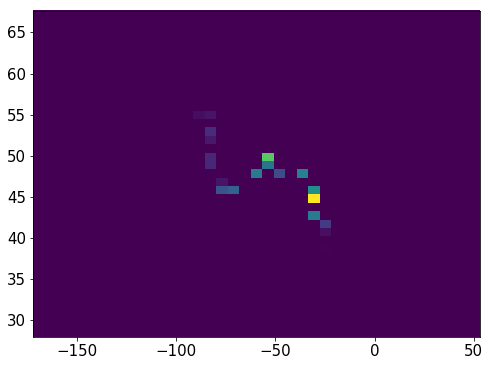

3835    25
3836    25
3837    25
3838    25
3839    25
3840    25
3841    25
3842    25
3843    25
3844    25
3845    25
3846    25
3847    25
3848    25
3849    25
3854     1
3855     1
3856     1
3857     1
Name: Nsipm, dtype: uint16


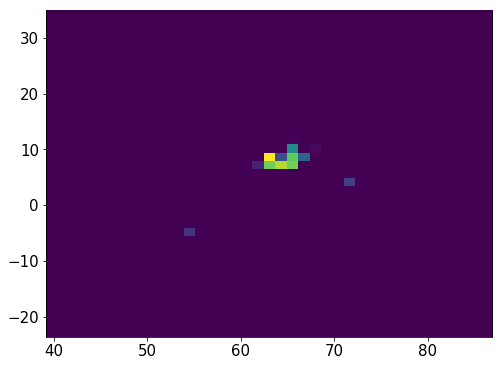

1663597    34
1663598    34
1663599    34
1663600    34
1663601    34
1663602    34
1663603    34
1663604    34
1663605    34
1663606    34
1663607    34
1663608    34
1663609    34
1663610    34
1663611    34
Name: Nsipm, dtype: uint16


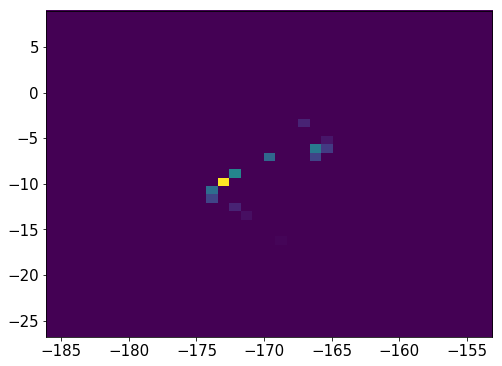

937467    25
937468    25
937469    25
937470    25
937471    25
937472    25
937473    25
937474    25
937475    25
937476    25
937477    25
937478    25
937479    25
937480    25
937481    25
937482    25
937483    25
937485    25
Name: Nsipm, dtype: uint16


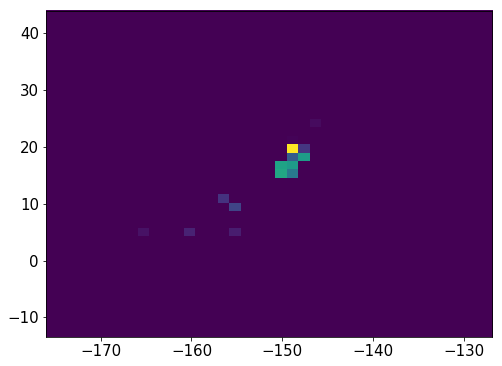

937491    30
937492    30
937493    30
937494    30
937495    30
937496    30
937497    30
937498    30
937499    30
937504     8
937505     8
937506     8
937507     8
937508     8
937509     8
Name: Nsipm, dtype: uint16


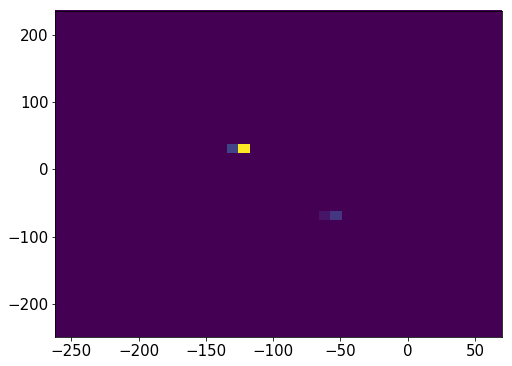

937512    25
937513    25
937514    25
937515    25
937516    25
937517    25
937518    25
937519    25
937520    25
937521    25
937522    25
937523    25
937524    25
937525    25
937526    25
937527    25
937528    25
937529    25
937530    25
937531    25
937532    25
937539     1
937540     1
937541     1
937542     1
937543     1
Name: Nsipm, dtype: uint16


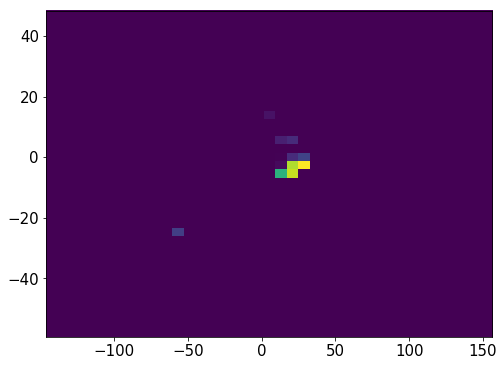

3863    22
3864    22
3865    22
3866    22
3867    22
3868    22
3869    22
3870    22
3871    22
3872    22
3873    22
3874    22
3875    22
3876    22
3877    22
3878    22
3879    22
3880    22
3881    22
Name: Nsipm, dtype: uint16


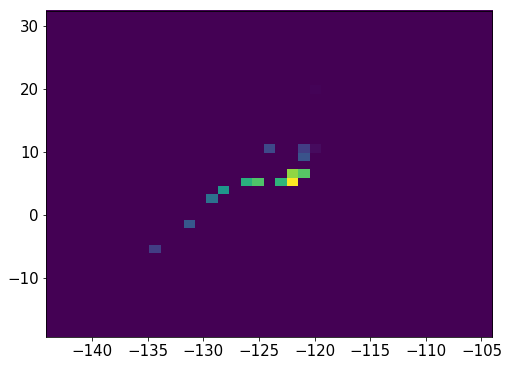

3886    24
3887    24
3888    24
3889    24
3890    24
3891    24
3892    24
3893    24
3894    24
3895    24
3896    24
3897    24
3898    24
3899    24
3900    24
3901    24
3902    24
3903    24
Name: Nsipm, dtype: uint16


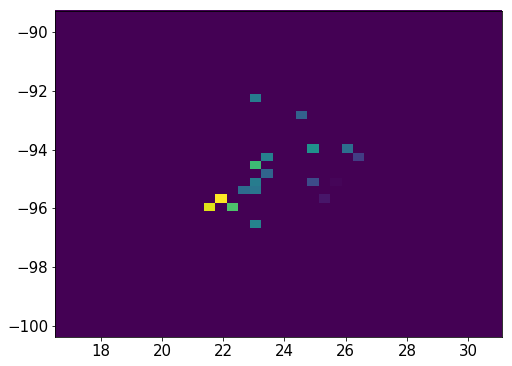

3908    24
3909    24
3910    24
3911    24
3912    24
3913    24
3914    24
3915    24
3916    24
3917    24
3918    24
3919    24
3920    24
3921    24
3922    24
3923    24
Name: Nsipm, dtype: uint16


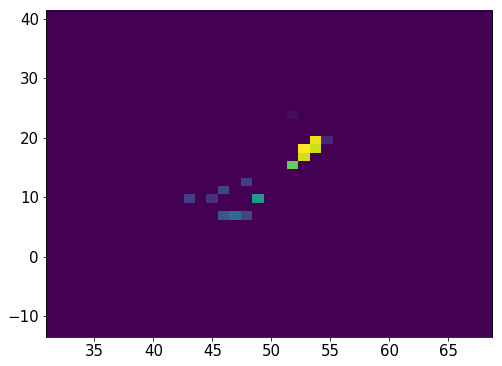

937589    24
937590    24
937591    24
937592    24
937593    24
937594    24
937595    24
937596    24
937597    24
937598    24
937599    24
937600    24
937601    24
937602    24
937603    24
937604    24
937605    24
937606    24
937607    24
937612     2
937613     2
937614     2
937615     2
Name: Nsipm, dtype: uint16


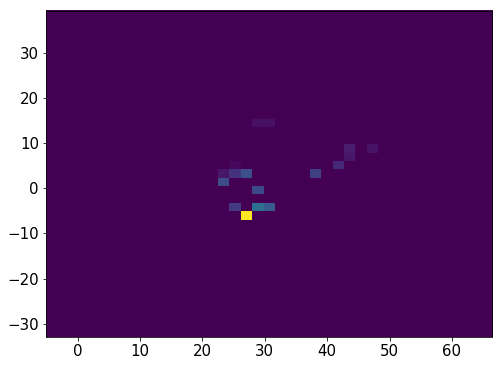

937621    27
937622    27
937623    27
937624    27
937625    27
937626    27
937627    27
937628    27
937629    27
937630    27
937631    27
937632    27
937633    27
937634    27
937635    27
937636    27
937637    27
937638    27
937639    27
937640    27
937641    27
937642    27
937643    27
Name: Nsipm, dtype: uint16


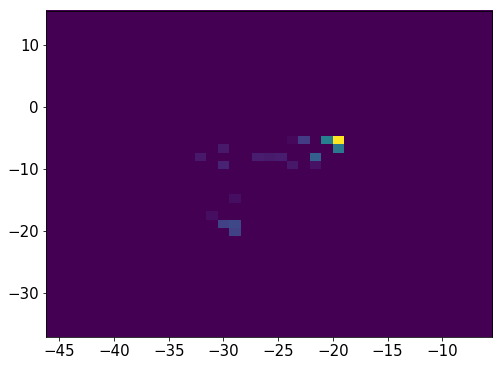

937647    24
937648    24
937649    24
937650    24
937651    24
937652    24
937653    24
937654    24
937655    24
937656    24
937657    24
937658    24
Name: Nsipm, dtype: uint16


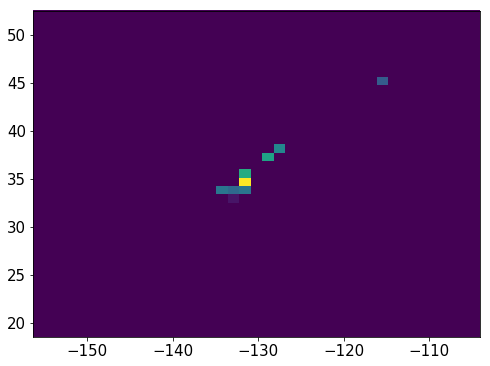

3928    26
3929    26
3930    26
3931    26
3932    26
3933    26
3934    26
3935    26
3936    26
3937    26
3938    26
3939    26
3940    26
3941    26
3942    26
3943    26
3944    26
3945    26
3946    26
3947    26
3951    26
3952    26
3953    26
Name: Nsipm, dtype: uint16


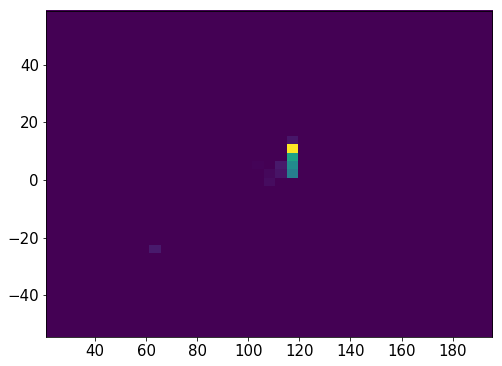

3960    28
3961    28
3962    28
3963    28
3964    28
3965    28
3966    28
3967    28
3968    28
3969    28
3970    28
3971    28
3972    28
3973    28
3983     1
3984     1
3985     1
3986     1
Name: Nsipm, dtype: uint16


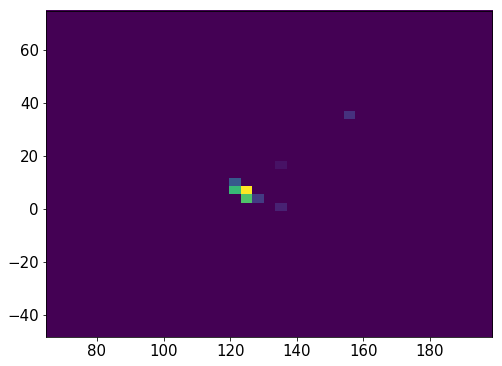

417    26
418    26
419    26
420    26
421    26
422    26
423    26
424    26
425    26
426    26
427    26
428    26
429    26
430    26
431    26
432    26
433    26
439     3
440     3
441     3
442     3
443     3
Name: Nsipm, dtype: uint16


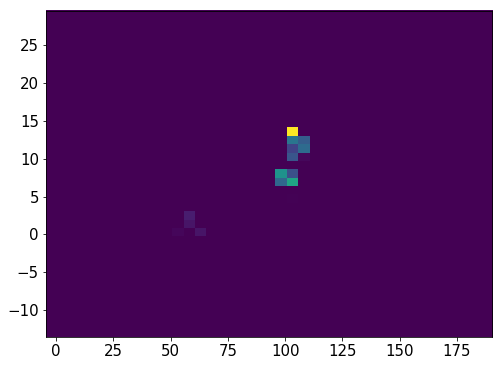

3990    28
3991    28
3992    28
3993    28
3994    28
3995    28
3996    28
3997    28
3998    28
3999    28
4000    28
4001    28
Name: Nsipm, dtype: uint16


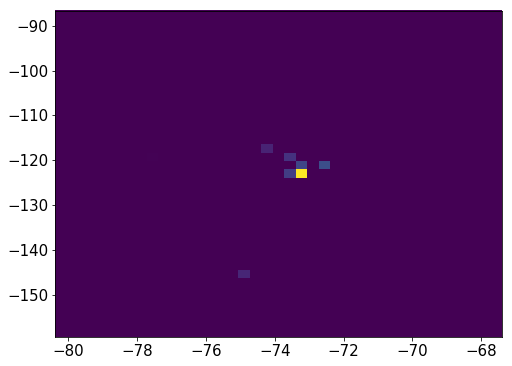

937704    33
937705    33
937706    33
937707    33
937708    33
937709    33
937710    33
937711    33
937712    33
937713    33
937714    33
937715    33
937716    33
937717    33
Name: Nsipm, dtype: uint16


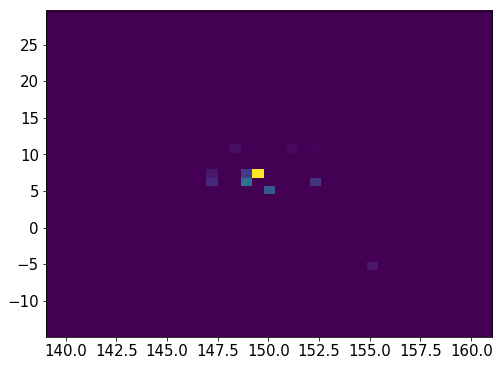

937720    40
937721    40
937722    40
937723    40
937724    40
937725    40
937726    40
937727    40
937728    40
937729    40
937730    40
937731    40
937732    40
937733    40
937734    40
937735    40
937736    40
937737    40
Name: Nsipm, dtype: uint16


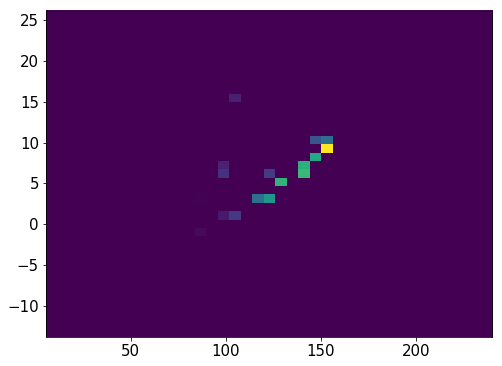

4005    24
4006    24
4007    24
4008    24
4009    24
4010    24
4011    24
4012    24
4013    24
4014    24
4015    24
4016    24
4017    24
4018    24
4019    24
4020    24
4021    24
4022    24
4023    24
4024    24
4025    24
4026    24
4027    24
4028    24
Name: Nsipm, dtype: uint16


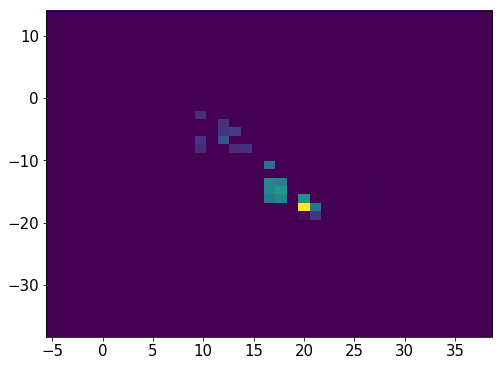

4034    22
4035    22
4036    22
4037    22
4038    22
4039    22
4040    22
4041    22
4042    22
4043    22
4044    22
4045    22
4046    22
4050    22
4051    22
4052    22
4053    22
4054    22
4055    22
4056    22
4057    22
Name: Nsipm, dtype: uint16


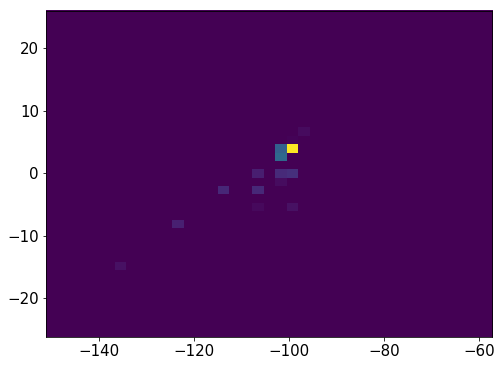

4061    24
4062    24
4063    24
4064    24
4065    24
4066    24
4067    24
4068    24
4069    24
4070    24
4071    24
4072    24
4073    24
4074    24
4075    24
4076    24
4077    24
Name: Nsipm, dtype: uint16


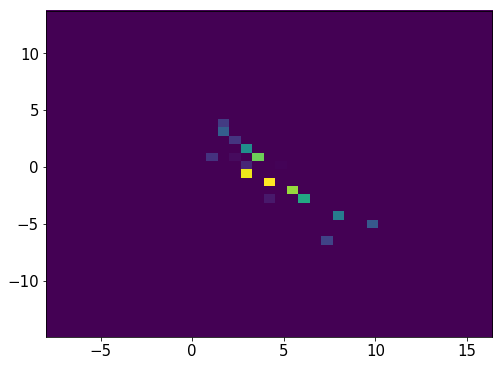

937770    25
937771    25
937772    25
937773    25
937774    25
937775    25
937776    25
937777    25
937778    25
937779    25
937780    25
937781    25
937782    25
937783    25
937784    25
937785    25
Name: Nsipm, dtype: uint16


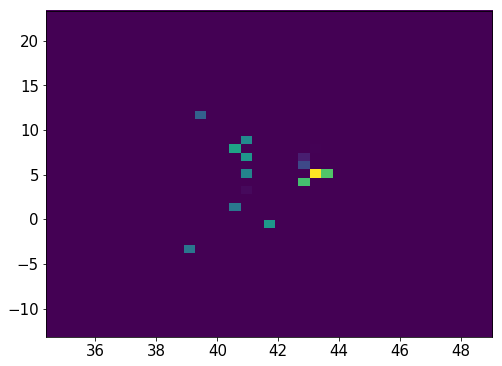

937790    31
937791    31
937792    31
937793    31
937794    31
937795    31
937796    31
937797    31
937798    31
937799    31
937800    31
937801    31
937802    31
937803    31
937804    31
937805    31
Name: Nsipm, dtype: uint16


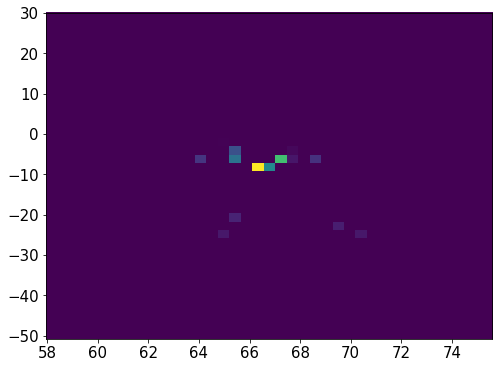

4083    56
4084    56
4085    56
4086    56
4087    56
4088    56
4089    56
4090    56
4091    56
4092    56
4093    56
4094    56
4095    56
4096    56
4097    56
4098    56
4099    56
Name: Nsipm, dtype: uint16


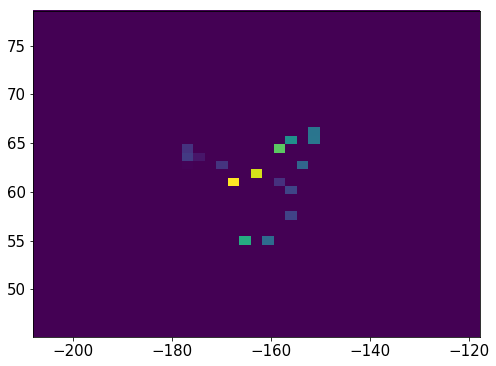

489    25
490    25
491    25
492    25
493    25
494    25
495    25
496    25
497    25
498    25
499    25
500    25
501    25
502    25
503    25
504    25
505    25
506    25
507    25
Name: Nsipm, dtype: uint16


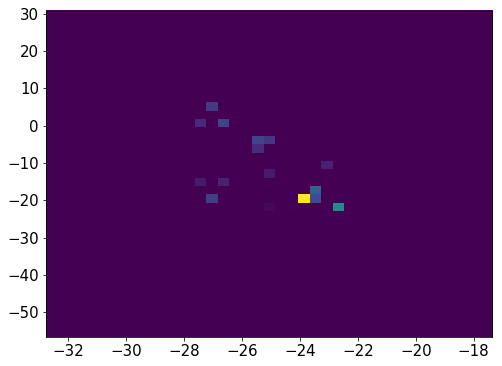

937811    28
937812    28
937813    28
937814    28
937815    28
937816    28
937817    28
937818    28
937819    28
937820    28
937821    28
937822    28
937823    28
937824    28
937825    28
937826    28
937827    28
937828    28
937829    28
937830    28
937831    28
937832    28
937833    28
Name: Nsipm, dtype: uint16


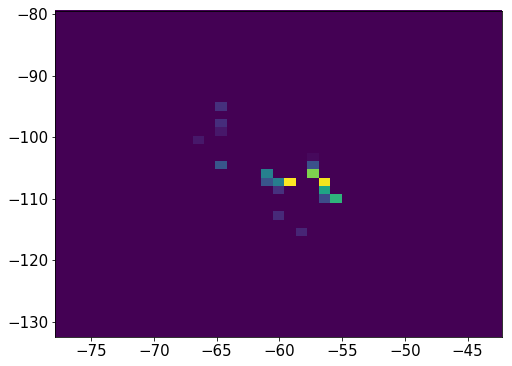

4104    19
4105    19
4106    19
4107    19
4108    19
4109    19
4110    19
4111    19
4112    19
4113    19
4114    19
4115    19
4116    19
4117    19
4118    19
4119    19
Name: Nsipm, dtype: uint16


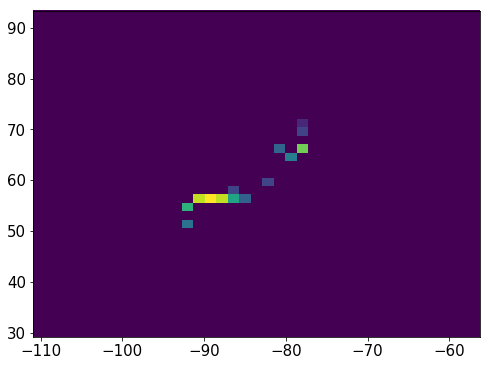

512    33
513    33
514    33
515    33
516    33
517    33
518    33
519    33
520    33
521    33
522    33
523    33
524    33
525    33
526    33
527    33
530     3
531     3
532     3
533     3
534     3
535     3
Name: Nsipm, dtype: uint16


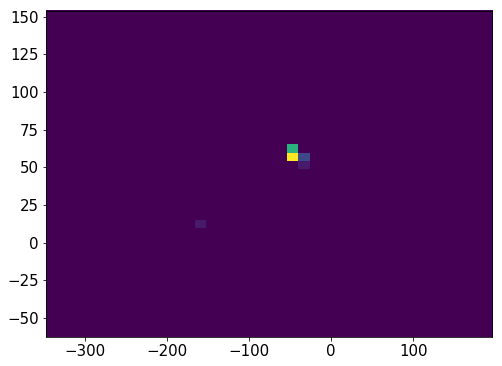

4124    47
4125    47
4126    47
4127    47
4128    47
4129    47
4130    47
4131    47
4132    47
4133    47
4134    47
4135    47
4136    47
4137    47
4138    47
4139    47
4140    47
4141    47
4142    47
4143    47
4144    47
4145    47
4146    47
4147    47
4148    47
4149    47
4150    47
4151    47
4152    47
4153    47
4154    47
4155    47
4156    47
4157    47
4158    47
Name: Nsipm, dtype: uint16


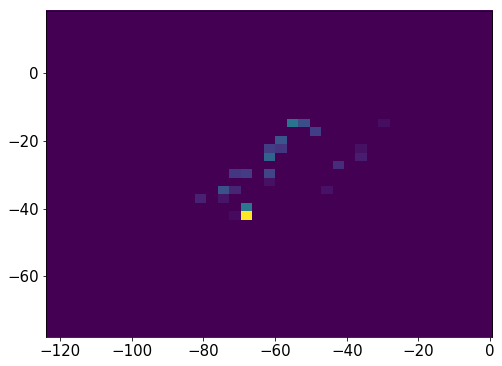

1663661    20
1663662    20
1663663    20
1663664    20
1663665    20
1663666    20
1663667    20
1663668    20
1663669    20
1663670    20
1663671    20
1663672    20
1663673    20
1663674    20
1663681     1
1663682     1
1663683     1
1663684     1
Name: Nsipm, dtype: uint16


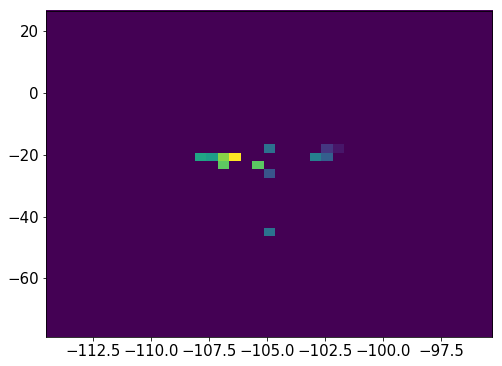

937932    26
937933    26
937934    26
937935    26
937936    26
937937    26
937938    26
937939    26
937940    26
937941    26
937942    26
937943    26
937944    26
937945    26
937946    26
937947    26
937948    26
937949    26
937950    26
937951    26
937952    26
937953    26
937954    26
Name: Nsipm, dtype: uint16


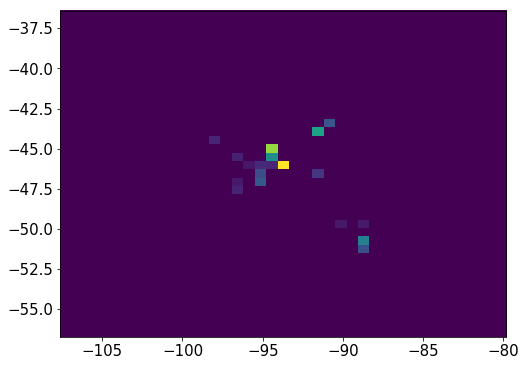

4164    20
4165    20
4166    20
4167    20
4168    20
4169    20
4170    20
4171    20
4172    20
4173    20
4174    20
4175    20
4176    20
4177    20
4178    20
4179    20
4180    20
4181    20
4182    20
4183    20
4184    20
4185    20
4186    20
4187    20
4188    20
4189    20
4190    20
4191    20
Name: Nsipm, dtype: uint16


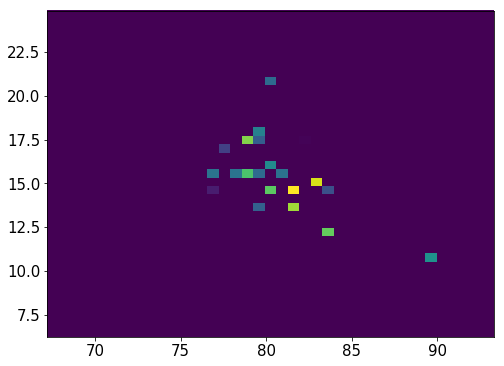

937959    31
937960    31
937961    31
937962    31
937963    31
937964    31
937965    31
937966    31
937967    31
937968    31
937969    31
937970    31
937971    31
937972    31
937973    31
937974    31
937975    31
937976    31
937977    31
937978    31
937979    31
937980    31
937981    31
Name: Nsipm, dtype: uint16


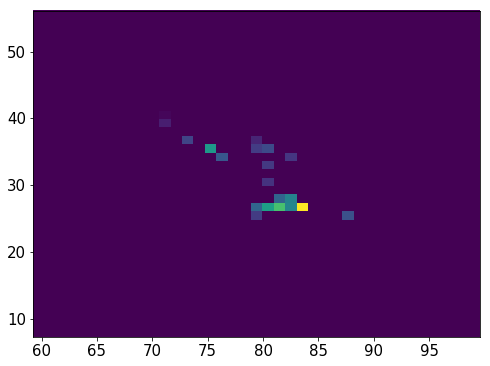

937985    25
937986    25
937987    25
937988    25
937989    25
937990    25
937991    25
937992    25
937993    25
937994    25
937995    25
937996    25
937997    25
937998    25
937999    25
938000    25
938001    25
938002    25
938003    25
938004    25
938005    25
938010    25
Name: Nsipm, dtype: uint16


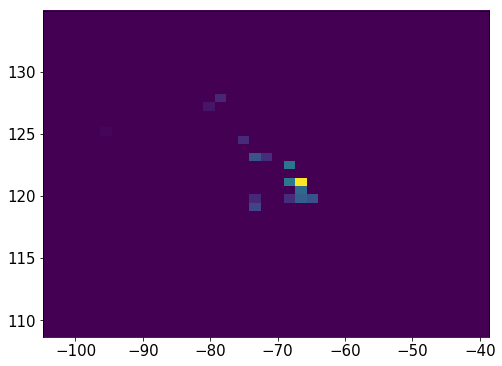

1663689    31
1663690    31
1663691    31
1663692    31
1663693    31
1663694    31
1663695    31
1663696    31
1663697    31
1663698    31
1663699    31
1663700    31
1663701    31
1663702    31
1663703    31
1663704    31
1663705    31
1663706    31
1663707    31
1663708    31
Name: Nsipm, dtype: uint16


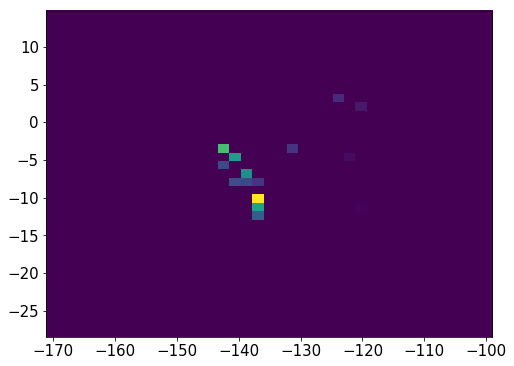

938014    29
938015    29
938016    29
938017    29
938018    29
938019    29
938020    29
938021    29
938022    29
938023    29
938024    29
Name: Nsipm, dtype: uint16


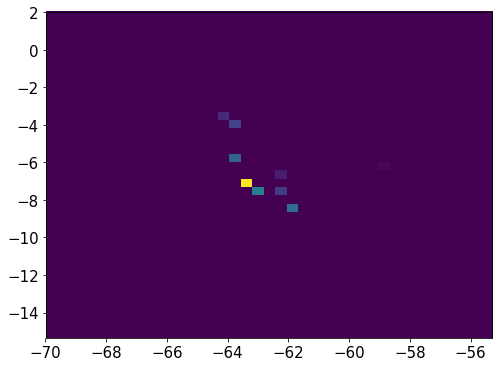

938029    27
938030    27
938031    27
938032    27
938037    27
938038    27
938039    27
938040    27
938041    27
938042    27
938043    27
938044    27
938045    27
938046    27
938047    27
Name: Nsipm, dtype: uint16


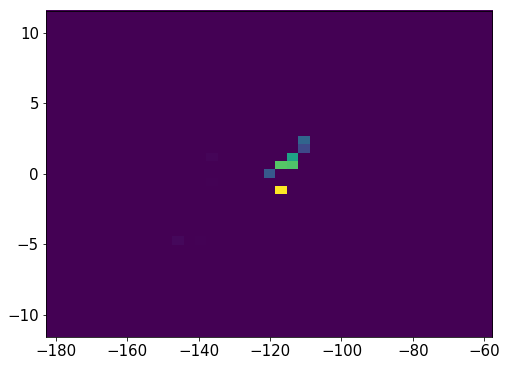

4196    18
4197    18
4198    18
4199    18
4200    18
4201    18
4202    18
4203    18
4204    18
4205    18
4206    18
4207    18
4208    18
4209    18
4210    18
4211    18
4212    18
4217    18
4218    18
4219    18
4225     1
4226     1
4227     1
4228     1
4229     1
4230     1
Name: Nsipm, dtype: uint16


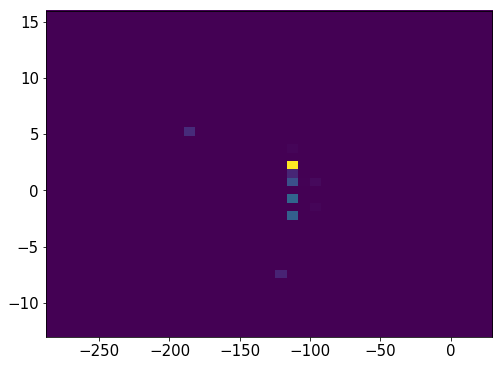

938048    30
938049    30
938050    30
938051    30
938052    30
938053    30
938054    30
938055    30
938056    30
938057    30
938058    30
938059    30
938060    30
938061    30
938062    30
938064    30
938065    30
938066    30
938067    30
938068    30
938069    30
938070    30
Name: Nsipm, dtype: uint16


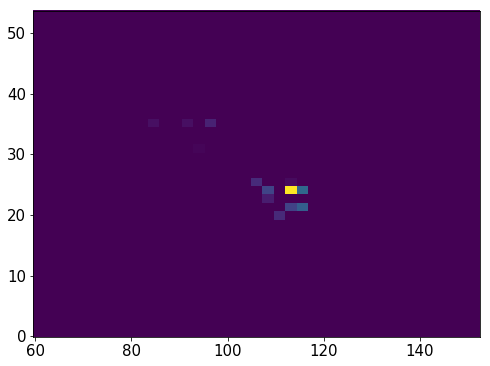

4234    24
4236    24
4237    24
4238    24
4239    24
4240    24
4241    24
4242    24
4243    24
4244    24
4245    24
4246    24
4247    24
4248    24
4249    24
4250    24
4251    24
4252    24
4253    24
4254    24
4255    24
4256    24
4257    24
4264    24
4265    24
4266    24
4267    24
Name: Nsipm, dtype: uint16


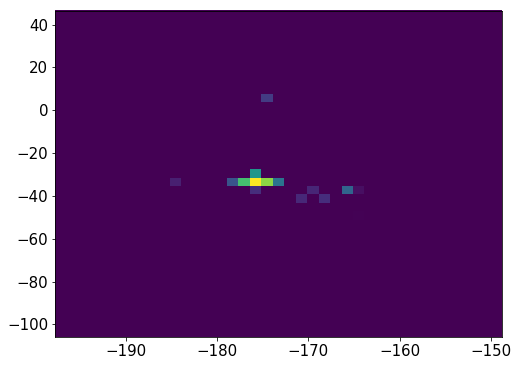

4270    31
4271    31
4272    31
4273    31
4274    31
4275    31
4276    31
4277    31
4278    31
4279    31
4280    31
4281    31
4282    31
4283    31
4284    31
Name: Nsipm, dtype: uint16


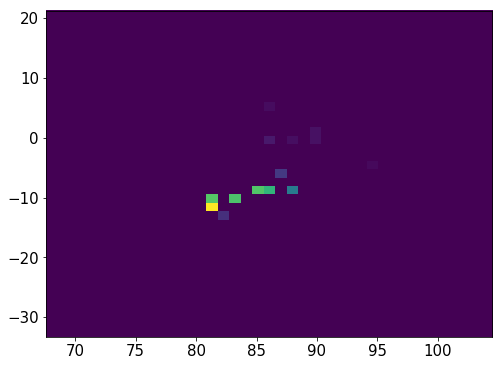

4287    28
4288    28
4289    28
4290    28
4291    28
4292    28
4293    28
4294    28
4295    28
4296    28
4297    28
4298    28
4299    28
4300    28
4301    28
4302    28
4303    28
4304    28
4305    28
4306    28
4307    28
4308    28
Name: Nsipm, dtype: uint16


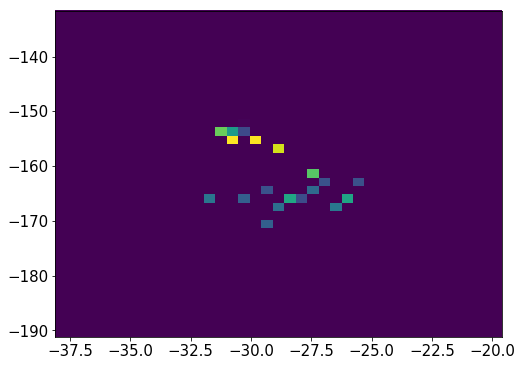

4314    32
4315    32
4316    32
4317    32
4318    32
4319    32
4320    32
4321    32
4322    32
4323    32
4324    32
4325    32
4327    32
4328    32
4329    32
4330    32
Name: Nsipm, dtype: uint16


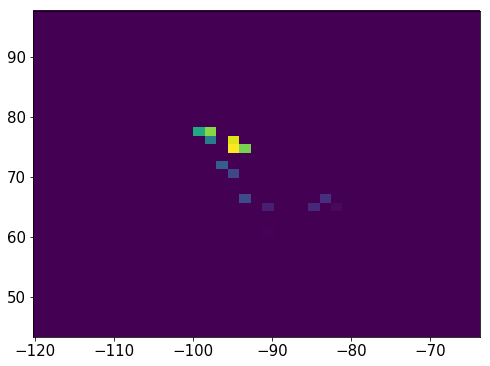

1899206    33
1899207    33
1899208    33
1899209    33
1899210    33
1899211    33
1899212    33
1899213    33
1899214    33
1899215    33
1899216    33
1899217    33
1899218    33
1899219    33
1899220    33
1899221    33
1899222    33
1899223    33
1899224    33
1899225    33
Name: Nsipm, dtype: uint16


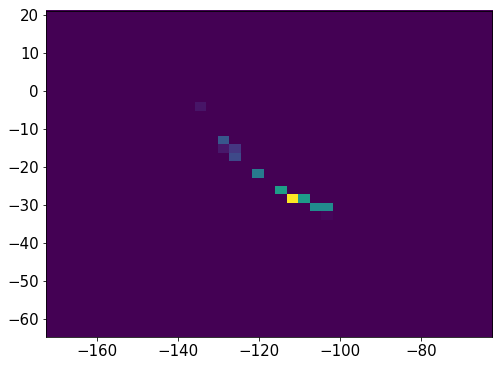

4334    26
4335    26
4336    26
4337    26
4338    26
4339    26
4340    26
4341    26
4342    26
4343    26
4344    26
4345    26
4346    26
4347    26
4348    26
4349    26
4350    26
4354     1
4355     1
4356     1
4357     1
4358     1
Name: Nsipm, dtype: uint16


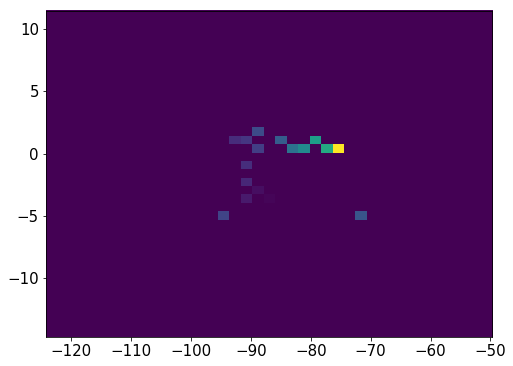

4363    28
4364    28
4365    28
4366    28
4367    28
4368    28
4369    28
4370    28
4371    28
4372    28
4373    28
4374    28
4375    28
4376    28
4377    28
4378    28
Name: Nsipm, dtype: uint16


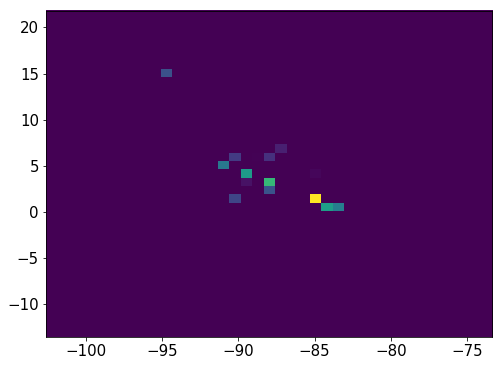

4383    20
4384    20
4385    20
4386    20
4387    20
4388    20
4389    20
4390    20
4391    20
4392    20
Name: Nsipm, dtype: uint16


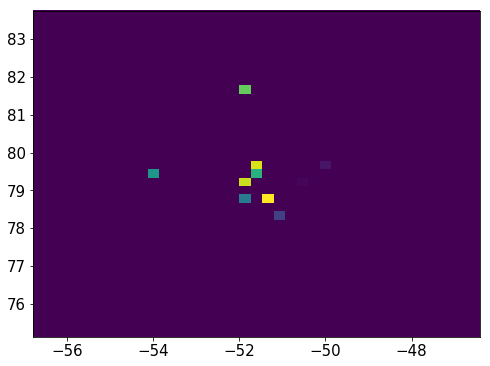

938138    17
938139    17
938140    17
938141    17
938142    17
938143    17
938144    17
938145    17
938146    17
938147    17
938148    17
938149    17
938150    17
938151    17
938152    17
938153    17
938154    17
Name: Nsipm, dtype: uint16


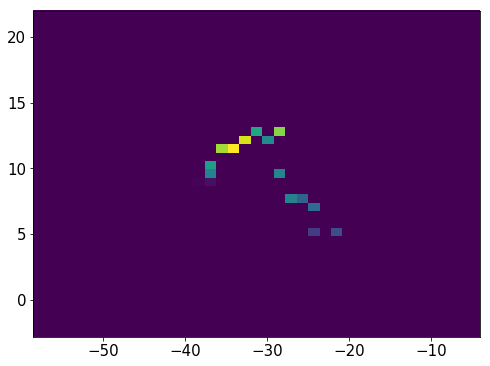

938160    24
938161    24
938162    24
938163    24
938164    24
938165    24
938166    24
938167    24
938168    24
938169    24
938170    24
938171    24
938172    24
938173    24
938174    24
938175    24
938176    24
938177    24
938178    24
938179    24
938180    24
938181    24
938182    24
938183    24
938184    24
938188     2
938189     2
938190     2
938191     2
Name: Nsipm, dtype: uint16


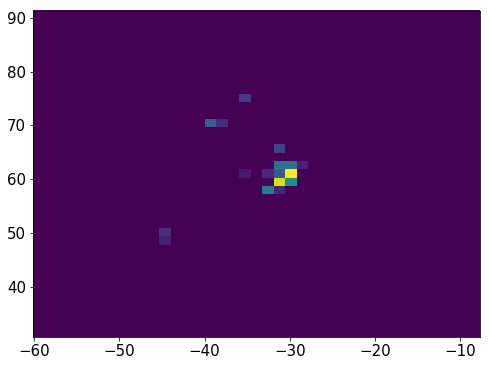

4397    23
4398    23
4399    23
4400    23
4401    23
4402    23
4403    23
4404    23
4405    23
4406    23
4407    23
4408    23
4409    23
4410    23
4411    23
4412    23
4413    23
4414    23
4415    23
4416    23
4417    23
4418    23
4419    23
4420    23
Name: Nsipm, dtype: uint16


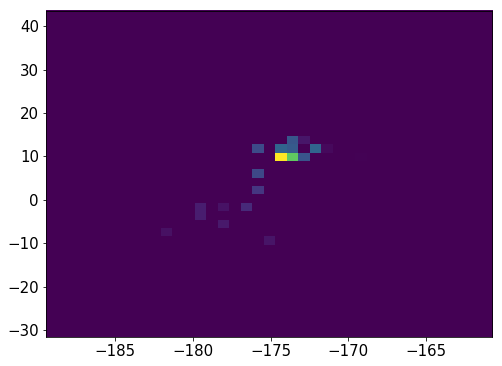

4426    30
4427    30
4428    30
4429    30
4430    30
4431    30
4432    30
4433    30
4434    30
4435    30
4436    30
4437    30
4438    30
4439    30
4440    30
Name: Nsipm, dtype: uint16


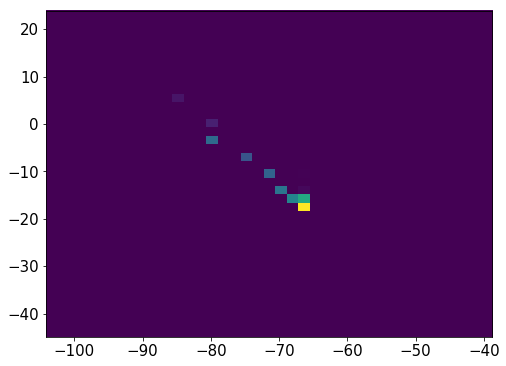

938195    28
938196    28
938197    28
938198    28
938199    28
938200    28
938201    28
938202    28
938203    28
938204    28
938205    28
938206    28
938207    28
938208    28
938209    28
938210    28
938211    28
938212    28
938213    28
938214    28
938215    28
938216    28
938217    28
Name: Nsipm, dtype: uint16


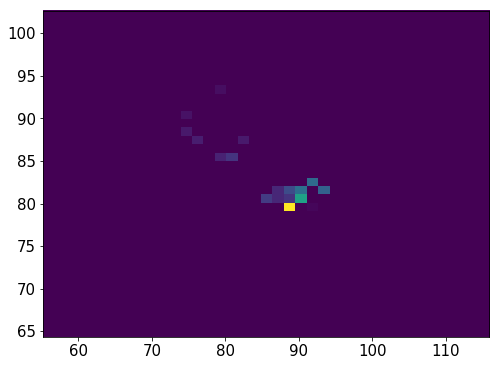

1899230    27
1899231    27
1899232    27
1899233    27
1899234    27
1899235    27
1899236    27
1899237    27
1899238    27
1899239    27
1899240    27
1899241    27
1899242    27
1899243    27
1899244    27
1899245    27
1899246    27
1899247    27
1899248    27
1899249    27
Name: Nsipm, dtype: uint16


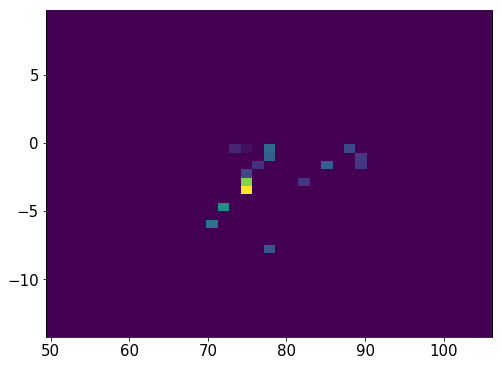

4445    24
4446    24
4447    24
4448    24
4449    24
4450    24
4451    24
4452    24
4453    24
4454    24
4455    24
4456    24
4457    24
4458    24
4459    24
4460    24
Name: Nsipm, dtype: uint16


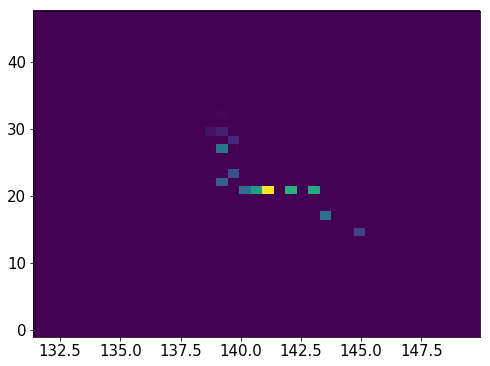

1663764    27
1663765    27
1663766    27
1663767    27
1663768    27
1663769    27
1663770    27
1663771    27
1663772    27
1663773    27
1663774    27
1663775    27
1663776    27
1663777    27
1663778    27
1663779    27
Name: Nsipm, dtype: uint16


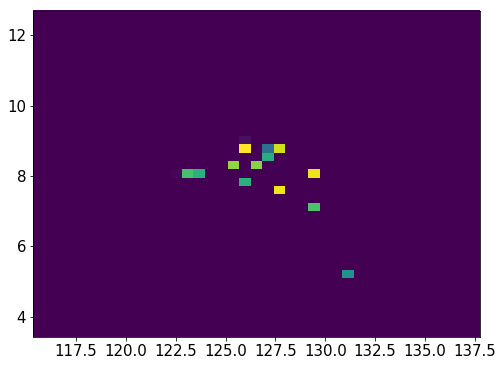

4465    32
4466    32
4467    32
4468    32
4469    32
4470    32
4471    32
4472    32
4473    32
4474    32
4475    32
4476    32
4477    32
4478    32
4479    32
Name: Nsipm, dtype: uint16


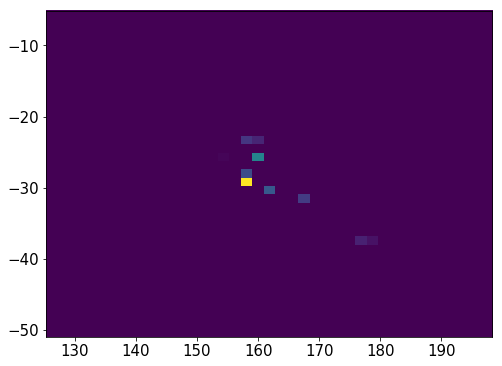

4484    25
4485    25
4486    25
4487    25
4488    25
4489    25
4490    25
4491    25
4492    25
4493    25
4494    25
4495    25
4496    25
4497    25
4498    25
4499    25
Name: Nsipm, dtype: uint16


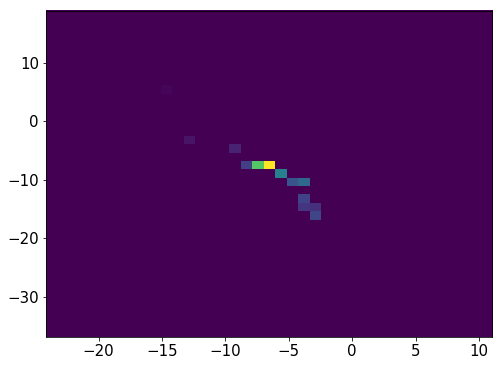

4504    29
4505    29
4506    29
4507    29
4508    29
4509    29
4510    29
4511    29
4512    29
4513    29
4514    29
4515    29
4516    29
4517    29
4518    29
4519    29
Name: Nsipm, dtype: uint16


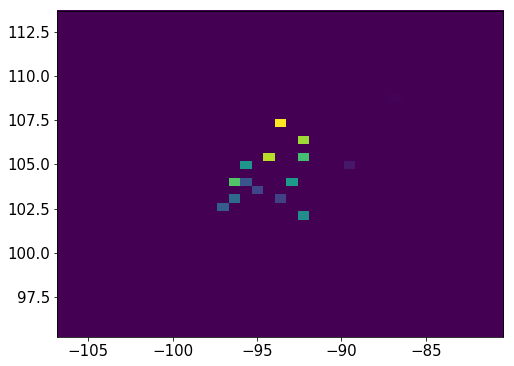

4524    22
4525    22
4526    22
4527    22
4528    22
4529    22
4530    22
4531    22
4532    22
4533    22
4534    22
4535    22
4536    22
4537    22
4538    22
4539    22
4540    22
4541    22
4542    22
4543    22
4548    16
4549    16
4550    16
4551    16
4554     2
4555     2
4556     2
4557     2
4558     2
Name: Nsipm, dtype: uint16


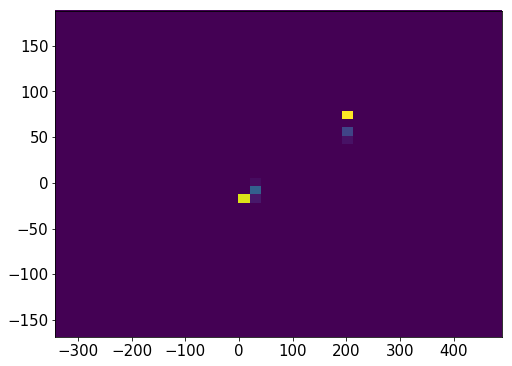

682566    39
682567    39
682568    39
682569    39
682570    39
682571    39
682572    39
682573    39
682574    39
682575    39
682576    39
Name: Nsipm, dtype: uint16


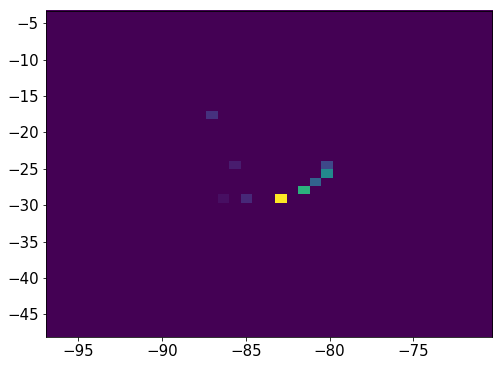

938276    21
938277    21
938278    21
938279    21
938280    21
938281    21
938282    21
938283    21
938284    21
938285    21
938286    21
938287    21
938288    21
938289    21
938290    21
938291    21
938292    21
938293    21
938294    21
938295    21
938296    21
938297    21
938298    21
938299    21
938300    21
Name: Nsipm, dtype: uint16


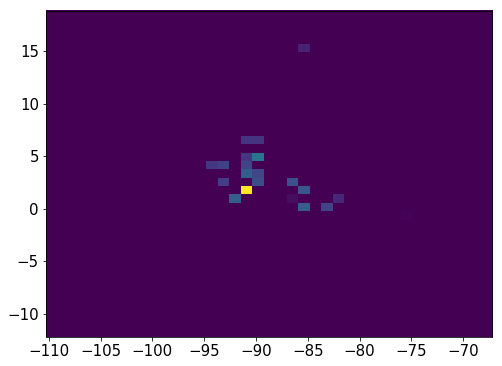

4563    29
4564    29
4565    29
4566    29
4567    29
4568    29
4569    29
4570    29
4571    29
4572    29
4576    29
4577    29
4578    29
4579    29
4580    29
4581    29
4582    29
4583    29
4585    29
4586    29
4587    29
4588    29
4589    29
Name: Nsipm, dtype: uint16


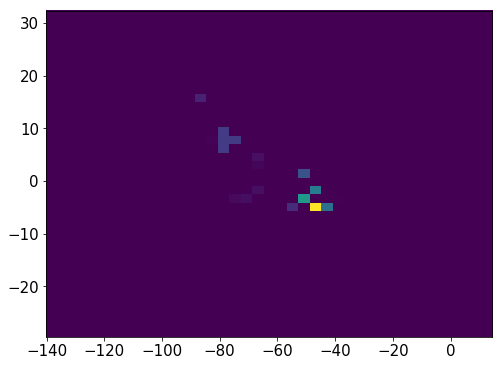

938305    23
938306    23
938307    23
938308    23
938309    23
938310    23
938311    23
938312    23
938313    23
938314    23
938315    23
938316    23
938317    23
938318    23
938319    23
938320    23
938321    23
Name: Nsipm, dtype: uint16


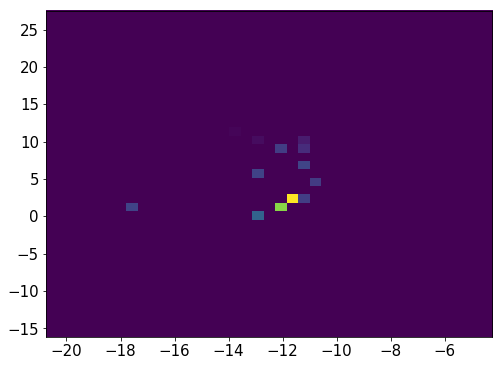

938327    21
938328    21
938329    21
938330    21
938331    21
938332    21
938333    21
938334    21
938335    21
938336    21
938337    21
938338    21
938339    21
938340    21
938341    21
938342    21
938343    21
938344    21
938345    21
938346    21
938347    21
938348    21
938349    21
Name: Nsipm, dtype: uint16


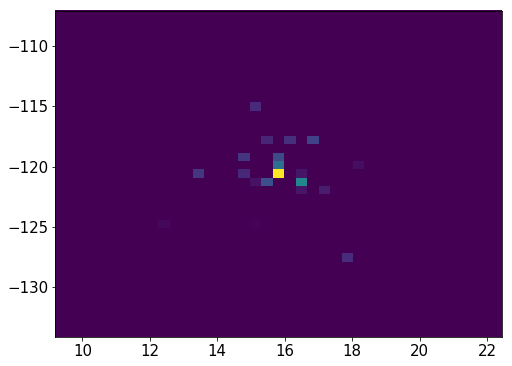

938354    22
938355    22
938356    22
938357    22
938358    22
938359    22
938360    22
938361    22
938362    22
938363    22
938364    22
938365    22
938366    22
938367    22
938368    22
938369    22
938370    22
938371    22
938372    22
938373    22
938374    22
938375    22
938376    22
938377    22
938378    22
938379    22
938380    22
938381    22
938382    22
938383    22
Name: Nsipm, dtype: uint16


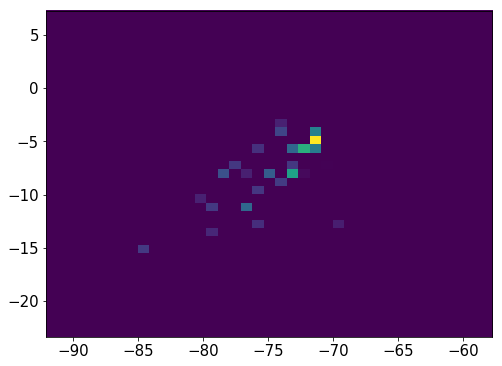

4594    23
4595    23
4596    23
4597    23
4598    23
4599    23
4600    23
4601    23
4602    23
4603    23
4604    23
4605    23
Name: Nsipm, dtype: uint16


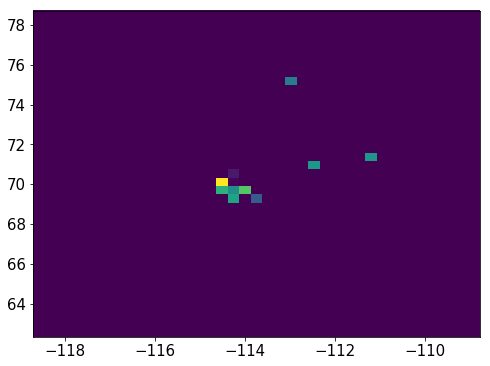

4610    23
4611    23
4612    23
4613    23
4614    23
4615    23
4616    23
4617    23
4618    23
4619    23
4620    23
4621    23
4622    23
4623    23
4624    23
4625    23
4627    23
4628    23
4629    23
4630    23
4631    23
4632    23
4635    23
Name: Nsipm, dtype: uint16


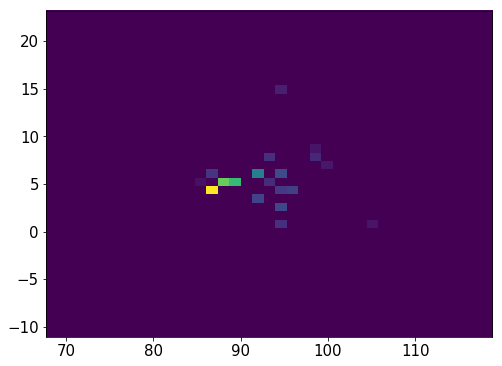

938405    26
938406    26
938407    26
938408    26
938409    26
938410    26
938411    26
938412    26
938413    26
938414    26
938415    26
938416    26
938417    26
938418    26
938419    26
938420    26
938421    26
938422    26
938423    26
938424    26
938425    26
938426    26
938427    26
938428    26
938430    26
938431    26
938433    26
938435    26
938436    26
938437    26
938438    26
938439    26
938440    26
Name: Nsipm, dtype: uint16


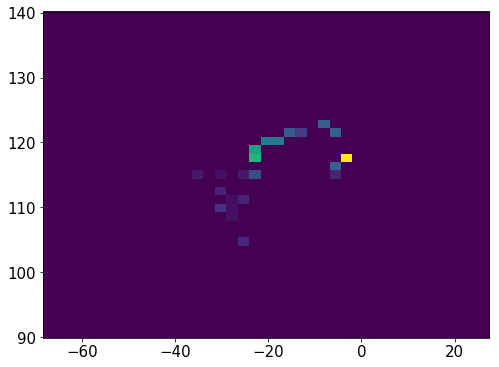

4643    28
4644    28
4645    28
4646    28
4647    28
4648    28
4649    28
4650    28
4651    28
4652    28
4653    28
4654    28
4655    28
4656    28
4657    28
4658    28
4659    28
4660    28
4661    28
4662    28
4666     4
4667     4
4668     4
4669     4
4670     4
4671     4
Name: Nsipm, dtype: uint16


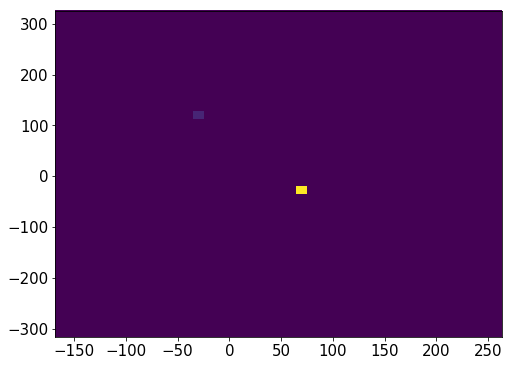

4676    29
4677    29
4678    29
4679    29
4680    29
4681    29
4682    29
4683    29
4684    29
4685    29
4686    29
4687    29
4688    29
4689    29
4690    29
Name: Nsipm, dtype: uint16


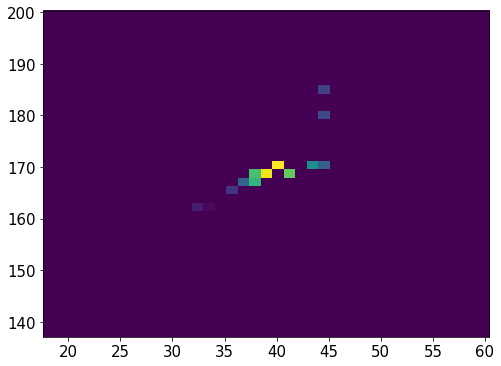

4694    31
4695    31
4696    31
4697    31
4698    31
4699    31
4700    31
4701    31
4702    31
4703    31
4704    31
4705    31
Name: Nsipm, dtype: uint16


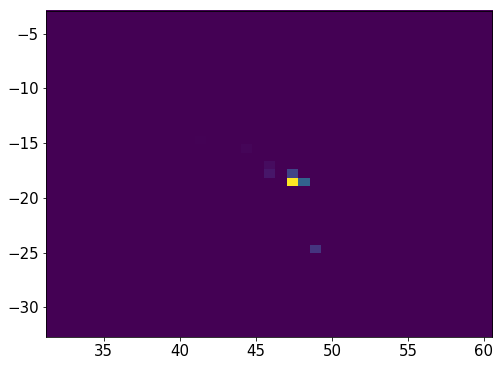

938446    28
938447    28
938448    28
938449    28
938450    28
938451    28
938452    28
938453    28
938454    28
938455    28
938456    28
938457    28
938458    28
938459    28
938460    28
938461    28
938462    28
938463    28
Name: Nsipm, dtype: uint16


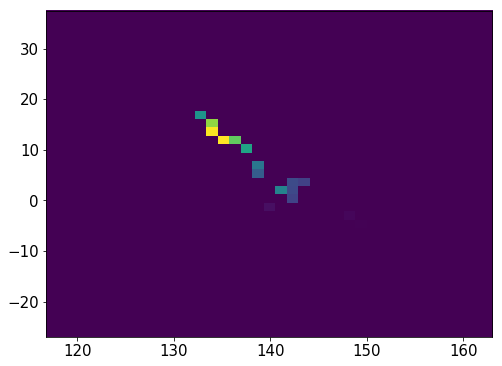

4710    21
4711    21
4712    21
4713    21
4714    21
4715    21
4716    21
4717    21
4718    21
4719    21
4720    21
4721    21
4722    21
4723    21
4724    21
4725    21
4726    21
4727    21
4728    21
4729    21
4730    21
Name: Nsipm, dtype: uint16


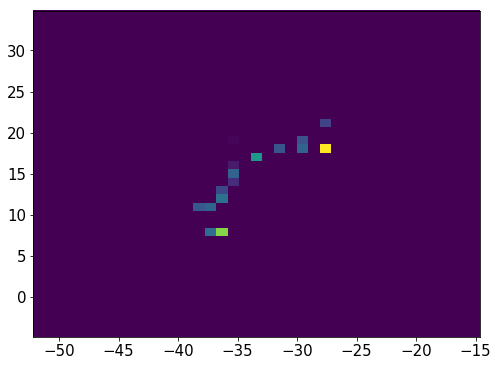

938489    28
938490    28
938491    28
938492    28
938493    28
938494    28
938495    28
938496    28
938497    28
938498    28
938499    28
938500    28
938501    28
938502    28
938503    28
938504    28
938505    28
938506    28
Name: Nsipm, dtype: uint16


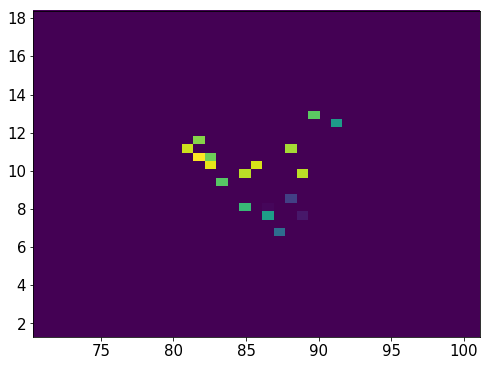

938511    24
938512    24
938513    24
938514    24
938517    24
938518    24
938519    24
938520    24
938521    24
938522    24
938523    24
938524    24
938525    24
938526    24
938527    24
938528    24
938529    24
938530    24
Name: Nsipm, dtype: uint16


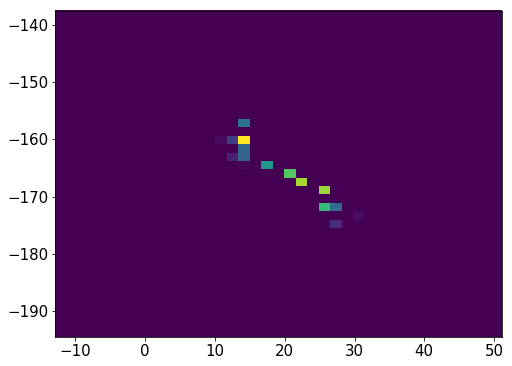

938531    23
938532    23
938533    23
938534    23
938535    23
938536    23
938537    23
938538    23
938539    23
938540    23
938541    23
938542    23
938543    23
938544    23
938545    23
938546    23
938548    23
938550    23
938551    23
938552    23
938553    23
938554    23
938555    23
938556    23
938557    23
938558    23
Name: Nsipm, dtype: uint16


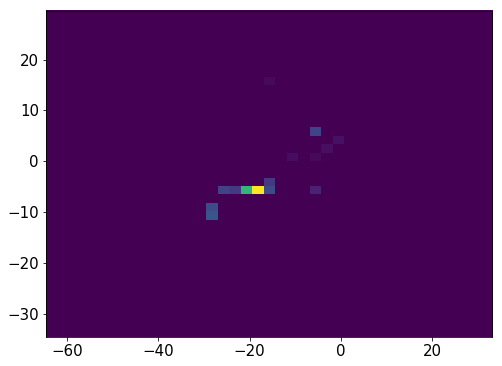

4735    25
4736    25
4737    25
4738    25
4739    25
4740    25
4741    25
4742    25
4743    25
4744    25
4745    25
4746    25
Name: Nsipm, dtype: uint16


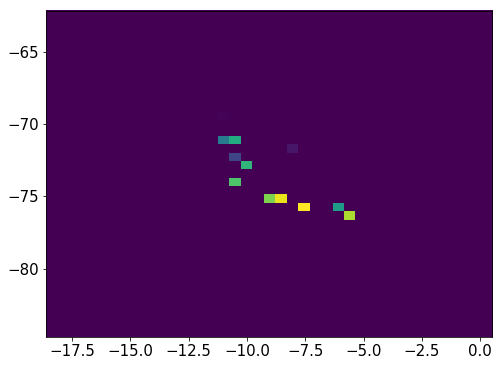

4751    27
4752    27
4753    27
4754    27
4755    27
4756    27
4757    27
4758    27
4759    27
4760    27
4761    27
4762    27
4763    27
4764    27
4765    27
4766    27
4767    27
4768    27
4769    27
Name: Nsipm, dtype: uint16


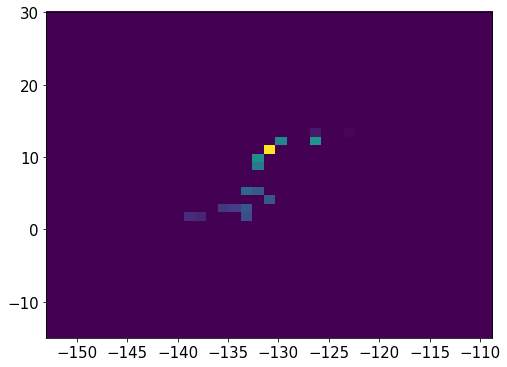

4775    29
4776    29
4777    29
4778    29
4779    29
4780    29
4781    29
4782    29
4783    29
4784    29
4785    29
4791     1
4792     1
4793     1
4794     1
4795     1
Name: Nsipm, dtype: uint16


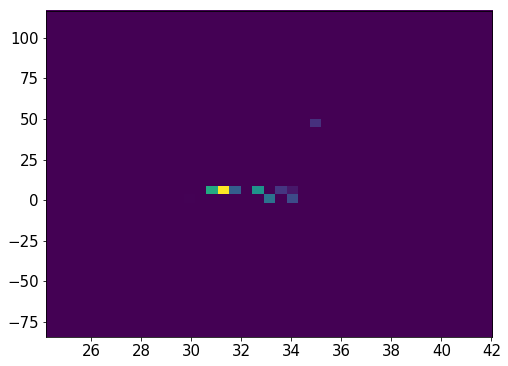

938589    31
938590    31
938591    31
938592    31
938593    31
938594    31
938595    31
938596    31
938597    31
938598    31
938599    31
938600    31
938601    31
938602    31
938603    31
Name: Nsipm, dtype: uint16


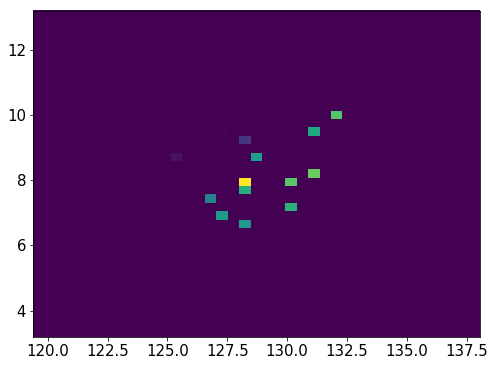

1899254    34
1899255    34
1899256    34
1899257    34
1899258    34
1899259    34
1899260    34
1899261    34
1899262    34
1899263    34
1899264    34
1899265    34
1899266    34
1899267    34
1899268    34
1899269    34
1899270    34
1899271    34
1899272    34
1899273    34
1899274    34
1899275    34
1899276    34
Name: Nsipm, dtype: uint16


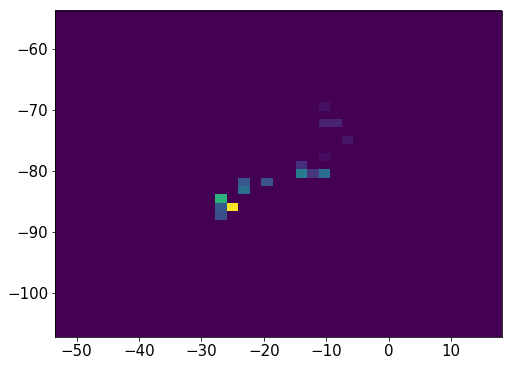

4799    23
4800    23
4801    23
4802    23
4803    23
4804    23
4805    23
4806    23
4807    23
4808    23
4809    23
4810    23
4811    23
4812    23
4813    23
4814    23
4815    23
4816    23
4817    23
4818    23
4819    23
4820    23
4821    23
4822    23
Name: Nsipm, dtype: uint16


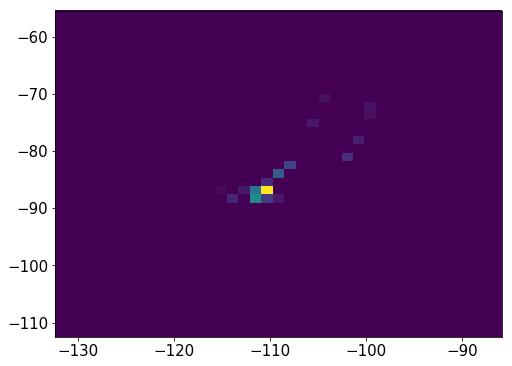

4829    30
4830    30
4831    30
4832    30
4833    30
4834    30
4835    30
4836    30
4837    30
4838    30
4839    30
4840    30
4841    30
4842    30
4843    30
4844    30
4845    30
4846    30
4847    30
4848    30
4849    30
Name: Nsipm, dtype: uint16


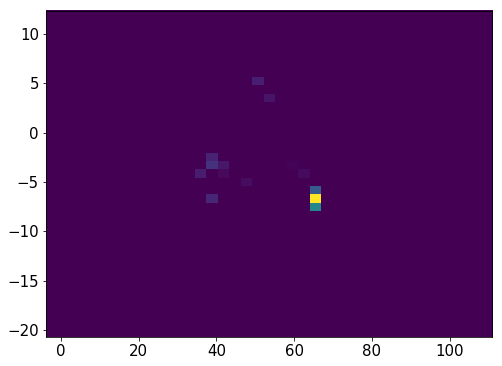

938609    24
938610    24
938611    24
938612    24
938613    24
938614    24
938615    24
938616    24
938617    24
938618    24
938619    24
938620    24
938621    24
938622    24
Name: Nsipm, dtype: uint16


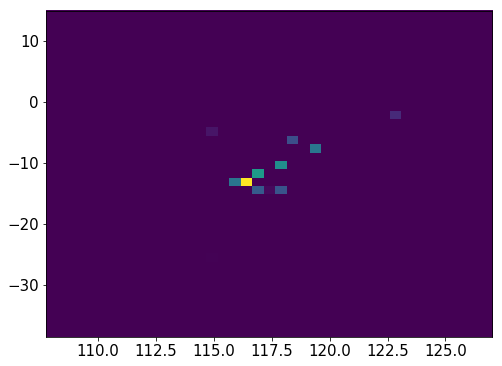

4854    30
4855    30
4856    30
4857    30
4858    30
4859    30
4860    30
4861    30
4864    30
4865    30
4866    30
4867    30
4868    30
4869    30
4870    30
4871    30
4872    30
4873    30
4874    30
4875    30
4876    30
4877    30
Name: Nsipm, dtype: uint16


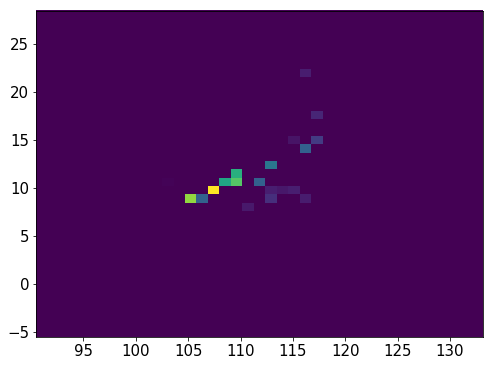

4883    29
4884    29
4885    29
4886    29
4887    29
4888    29
4889    29
4890    29
4891    29
4892    29
4893    29
4894    29
4898     4
4899     4
4900     4
Name: Nsipm, dtype: uint16


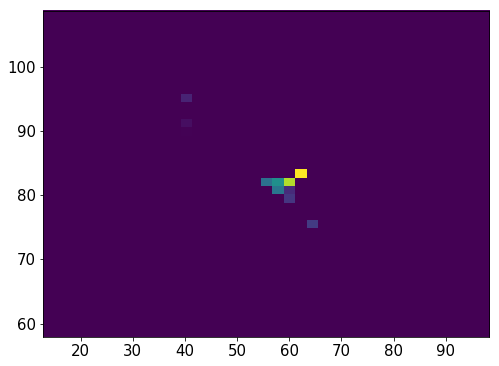

938625    21
938626    21
938627    21
938628    21
938629    21
938630    21
938631    21
938632    21
938633    21
938634    21
938635    21
938636    21
938637    21
938638    21
938639    21
938640    21
938641    21
938642    21
938643    21
938644    21
938645    21
938646    21
938647    21
938648    21
Name: Nsipm, dtype: uint16


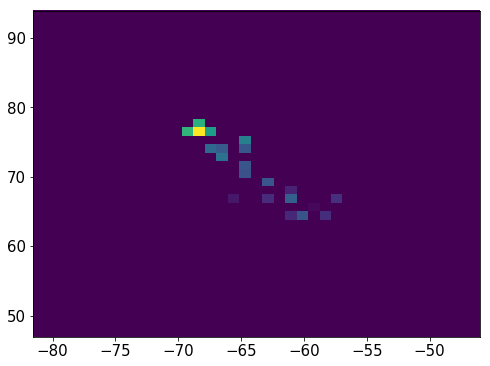

4904    23
4905    23
4906    23
4907    23
4908    23
4909    23
4910    23
4911    23
4912    23
4913    23
4914    23
4915    23
4916    23
4917    23
4918    23
4919    23
4920    23
4921    23
4922    23
4923    23
4924    23
4929    19
4930    19
4931    19
4932    19
4933    19
4934    19
4935    19
4936    19
4937    19
Name: Nsipm, dtype: uint16


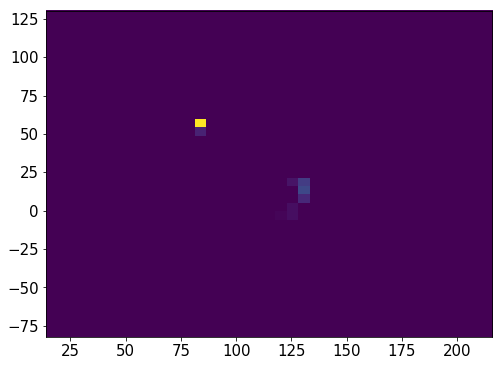

938653    29
938654    29
938655    29
938656    29
938657    29
938658    29
938659    29
938660    29
938661    29
938662    29
938663    29
938664    29
938665    29
938666    29
938667    29
938668    29
938673     1
938674     1
938675     1
938676     1
938677     1
938678     1
Name: Nsipm, dtype: uint16


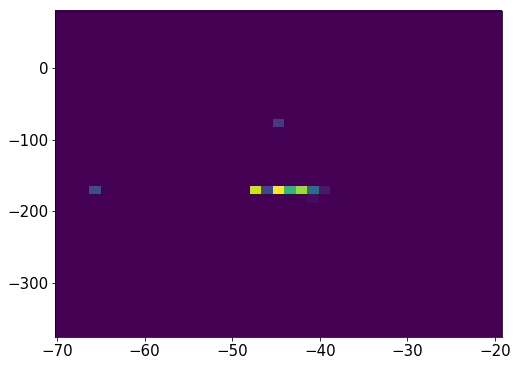

4941    19
4942    19
4943    19
4944    19
4945    19
4946    19
4947    19
4948    19
4949    19
4950    19
4951    19
4952    19
4953    19
4954    19
4955    19
4956    19
4957    19
4958    19
4959    19
Name: Nsipm, dtype: uint16


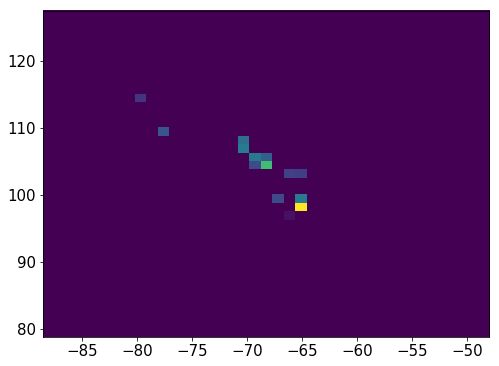

4963    23
4964    23
4965    23
4966    23
4967    23
4968    23
4969    23
4970    23
4971    23
4972    23
4973    23
4974    23
4975    23
4976    23
4977    23
4978    23
4979    23
4980    23
4981    23
4982    23
4983    23
4984    23
4985    23
Name: Nsipm, dtype: uint16


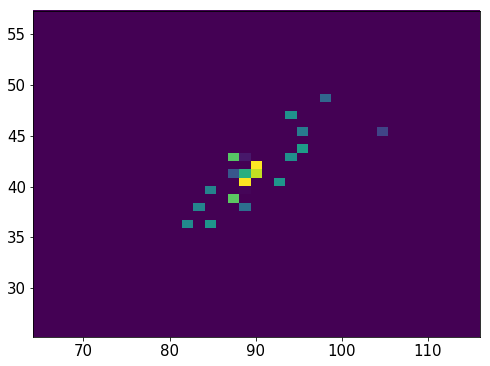

938704    22
938705    22
938706    22
938707    22
938708    22
938709    22
938710    22
938711    22
938712    22
938713    22
938714    22
938715    22
938716    22
938717    22
938718    22
938719    22
938720    22
938721    22
938722    22
938723    22
938724    22
938725    22
938726    22
938727    22
938728    22
Name: Nsipm, dtype: uint16


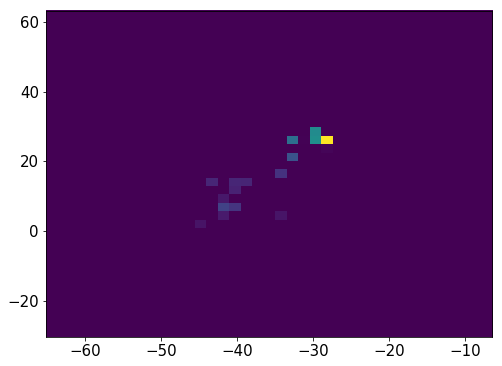

4989    24
4990    24
4991    24
4992    24
4993    24
4994    24
4995    24
4996    24
4997    24
4998    24
4999    24
5000    24
5001    24
5002    24
Name: Nsipm, dtype: uint16


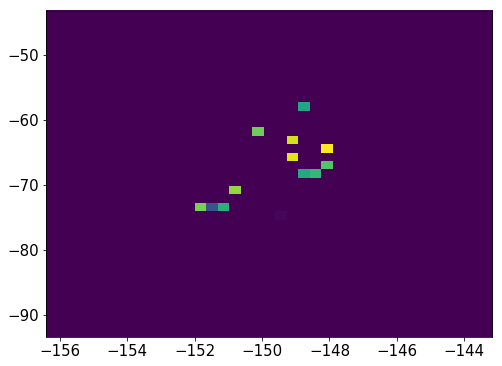

938762    30
938763    30
938764    30
938765    30
938766    30
938767    30
938768    30
938769    30
938770    30
938771    30
938772    30
938773    30
938774    30
938775    30
938776    30
Name: Nsipm, dtype: uint16


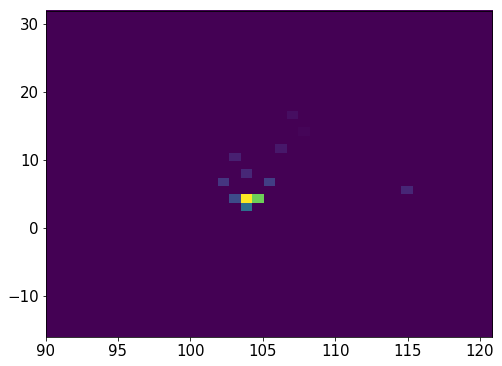

5008    26
5009    26
5010    26
5011    26
5012    26
5013    26
5014    26
5015    26
5016    26
5017    26
5018    26
5019    26
5020    26
5024     5
5025     5
5026     5
5027     5
5028     5
5029     5
5030     5
Name: Nsipm, dtype: uint16


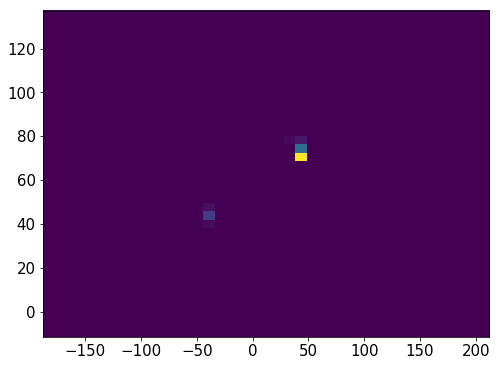

5035    32
5036    32
5037    32
5038    32
5039    32
5040    32
5041    32
5042    32
5043    32
5044    32
5045    32
5046    32
5047    32
5048    32
5049    32
5050    32
5051    32
5052    32
5053    32
5054    32
Name: Nsipm, dtype: uint16


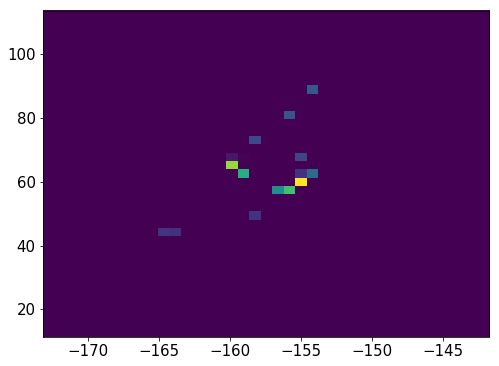

5058    28
5059    28
5060    28
5061    28
5062    28
5063    28
5064    28
5065    28
5066    28
5067    28
5068    28
5069    28
5070    28
5071    28
5072    28
5073    28
5074    28
5075    28
Name: Nsipm, dtype: uint16


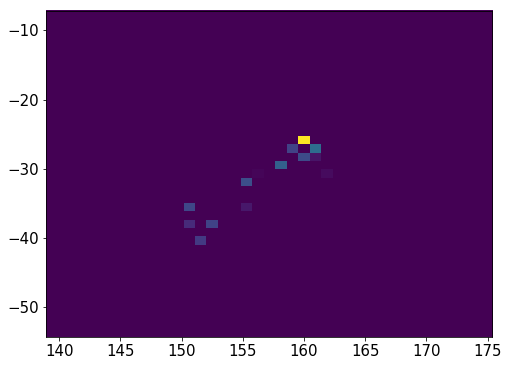

938781    30
938782    30
938783    30
938784    30
938785    30
938786    30
938787    30
938788    30
938789    30
938790    30
938791    30
938792    30
938793    30
938794    30
938795    30
938796    30
938797    30
938798    30
Name: Nsipm, dtype: uint16


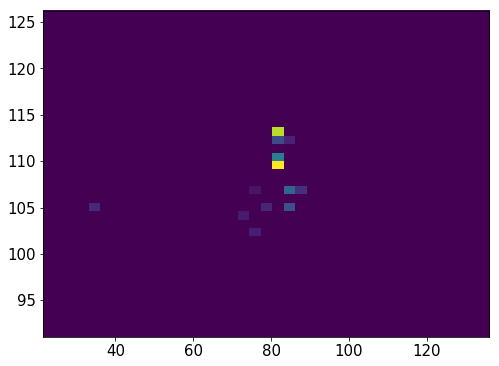

5079    26
5080    26
5081    26
5082    26
5083    26
5084    26
5085    26
5086    26
5087    26
5088    26
5089    26
5090    26
5091    26
5092    26
5093    26
5094    26
5095    26
5096    26
Name: Nsipm, dtype: uint16


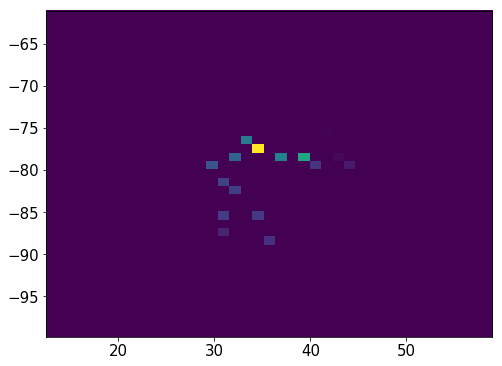

938804    21
938805    21
938806    21
938807    21
938808    21
938809    21
938810    21
938811    21
938812    21
938813    21
938814    21
938815    21
938816    21
938817    21
938818    21
Name: Nsipm, dtype: uint16


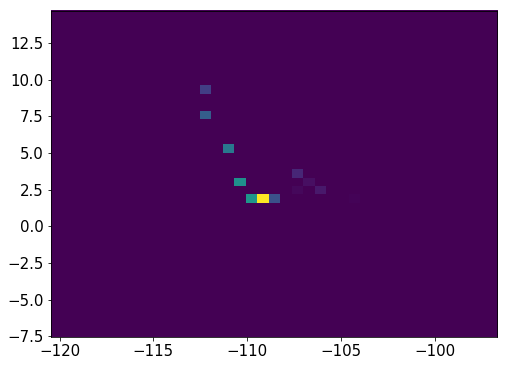

938823    30
938824    30
938825    30
938826    30
938827    30
938828    30
938829    30
938830    30
938834     7
938835     7
938836     7
938837     7
938838     7
938839     7
938840     7
938841     7
938842     7
Name: Nsipm, dtype: uint16


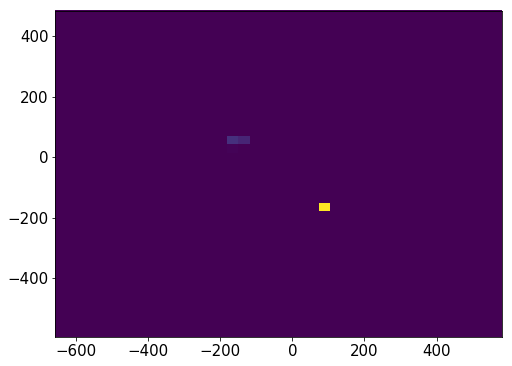

5116    32
5117    32
5118    32
5119    32
5120    32
5121    32
5122    32
5123    32
5124    32
5125    32
5126    32
5127    32
5128    32
5129    32
5130    32
5131    32
Name: Nsipm, dtype: uint16


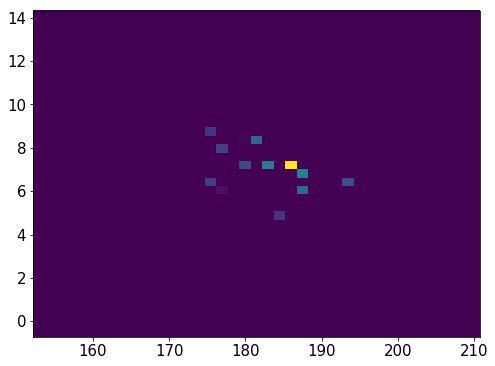

938847    21
938848    21
938849    21
938850    21
938851    21
938852    21
938853    21
938854    21
938855    21
938856    21
938857    21
938858    21
938859    21
Name: Nsipm, dtype: uint16


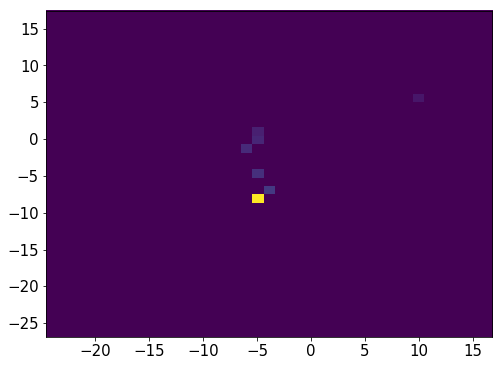

5137    21
5138    21
5139    21
5140    21
5141    21
5142    21
5143    21
5144    21
5145    21
5146    21
5147    21
5148    21
5149    21
5150    21
5151    21
5152    21
5153    21
5154    21
5155    21
5156    21
Name: Nsipm, dtype: uint16


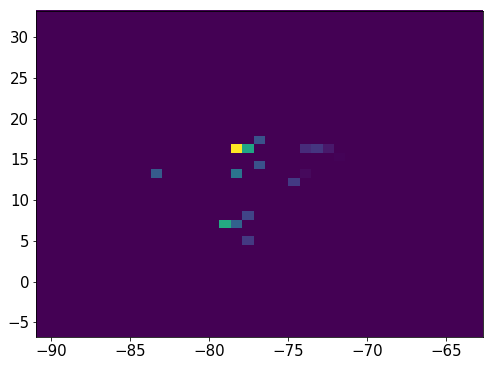

938864    28
938865    28
938866    28
938867    28
938868    28
938869    28
938870    28
938871    28
938872    28
938873    28
938874    28
938875    28
938876    28
938877    28
938878    28
938879    28
938880    28
938881    28
938882    28
938883    28
938884    28
938885    28
938886    28
938887    28
938888    28
938889    28
938890    28
938891    28
Name: Nsipm, dtype: uint16


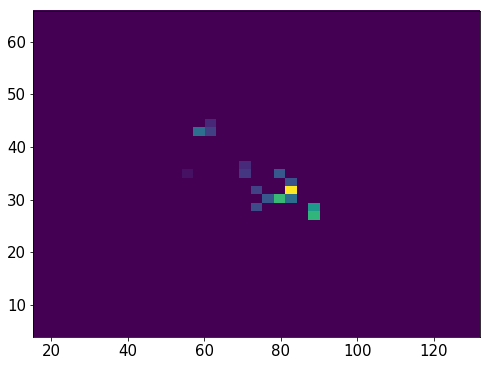

938895    24
938896    24
938897    24
938898    24
938899    24
938900    24
938901    24
938902    24
938903    24
938904    24
938905    24
938906    24
938907    24
938908    24
938909    24
938910    24
938911    24
938912    24
Name: Nsipm, dtype: uint16


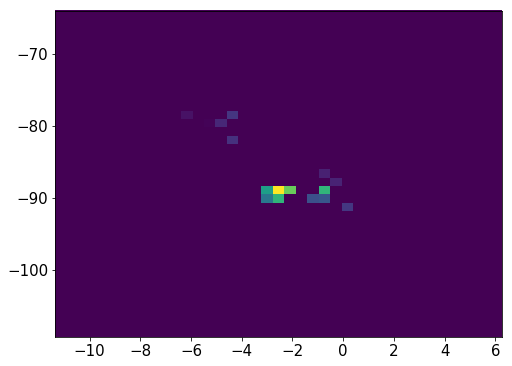

5161    24
5162    24
5163    24
5164    24
5165    24
5166    24
5167    24
5168    24
5169    24
5170    24
5171    24
5172    24
5173    24
5174    24
5175    24
5176    24
5177    24
5178    24
5179    24
5180    24
Name: Nsipm, dtype: uint16


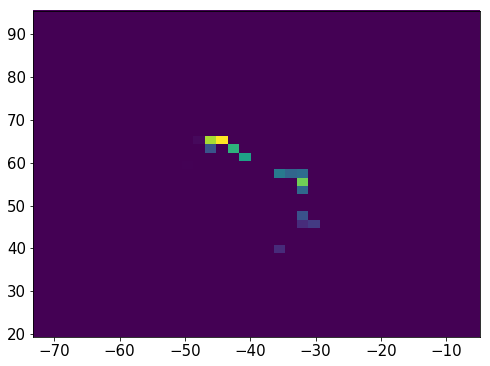

938916    28
938917    28
938918    28
938919    28
938920    28
938921    28
938922    28
938923    28
938924    28
938925    28
938926    28
938927    28
938928    28
938929    28
938930    28
938931    28
938932    28
938933    28
938934    28
Name: Nsipm, dtype: uint16


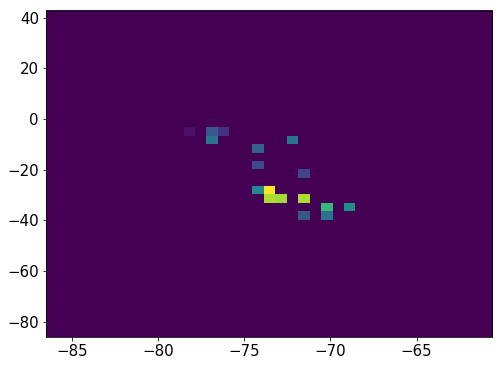

938939    35
938940    35
938941    35
938942    35
938943    35
938944    35
938945    35
938946    35
938947    35
938948    35
938949    35
938950    35
938951    35
Name: Nsipm, dtype: uint16


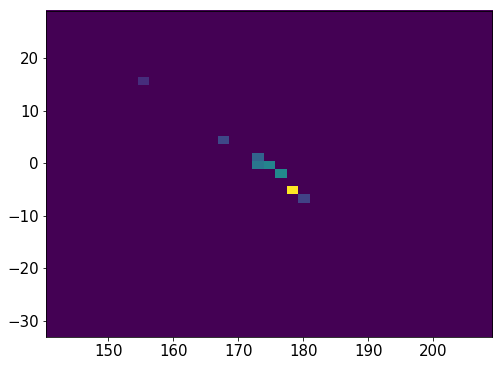

938956    21
938957    21
938958    21
938959    21
938960    21
938961    21
938962    21
938963    21
938964    21
938965    21
938966    21
938967    21
938968    21
938969    21
938970    21
938971    21
938972    21
938973    21
938974    21
938975    21
938976    21
938977    21
Name: Nsipm, dtype: uint16


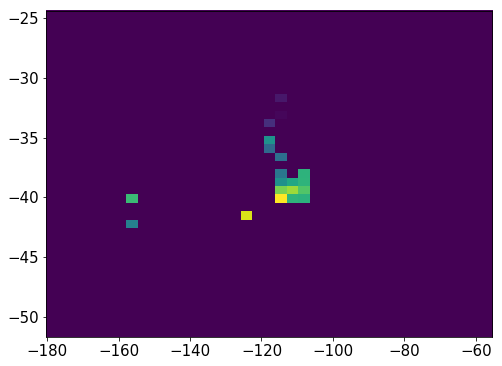

5204    29
5205    29
5206    29
5207    29
5208    29
5209    29
5210    29
5211    29
5212    29
5213    29
5214    29
5215    29
5216    29
5217    29
5218    29
5219    29
5220    29
Name: Nsipm, dtype: uint16


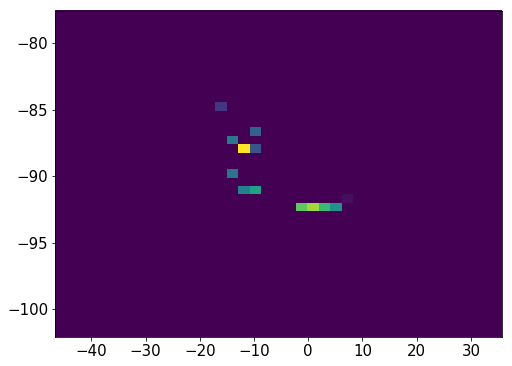

938983    19
938984    19
938985    19
938986    19
938987    19
938988    19
938989    19
938990    19
938991    19
938992    19
938993    19
938994    19
938995    19
938996    19
938997    19
938998    19
938999    19
939000    19
939001    19
939002    19
939003    19
Name: Nsipm, dtype: uint16


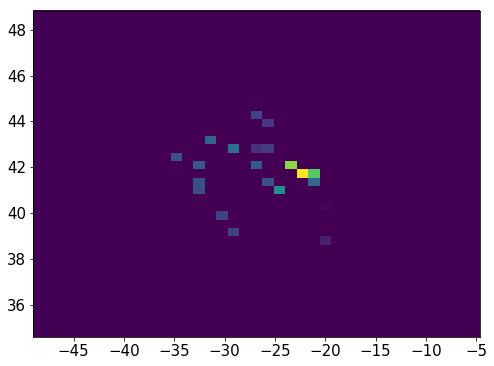

939008    26
939009    26
939010    26
939011    26
939012    26
939013    26
939014    26
939015    26
939016    26
939017    26
939018    26
939019    26
939020    26
939021    26
939022    26
939023    26
939024    26
939025    26
939026    26
939033     3
939034     3
939035     3
939036     3
939037     3
939038     3
939039     3
Name: Nsipm, dtype: uint16


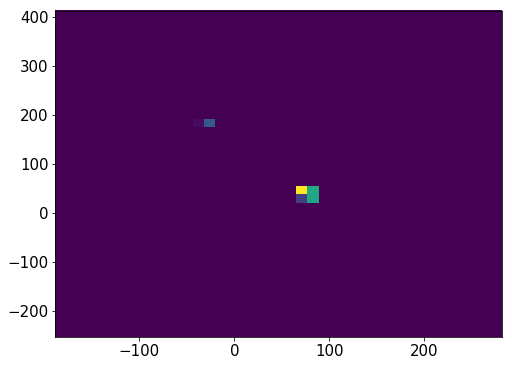

5243    32
5244    32
5245    32
5246    32
5247    32
5248    32
5249    32
5250    32
5251    32
5252    32
5253    32
5254    32
5255    32
5256    32
5257    32
Name: Nsipm, dtype: uint16


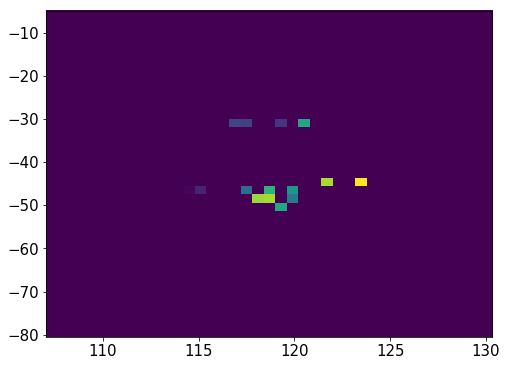

939043    22
939044    22
939045    22
939046    22
939047    22
939048    22
939049    22
939050    22
939051    22
939052    22
939053    22
939054    22
939055    22
939056    22
939057    22
939058    22
Name: Nsipm, dtype: uint16


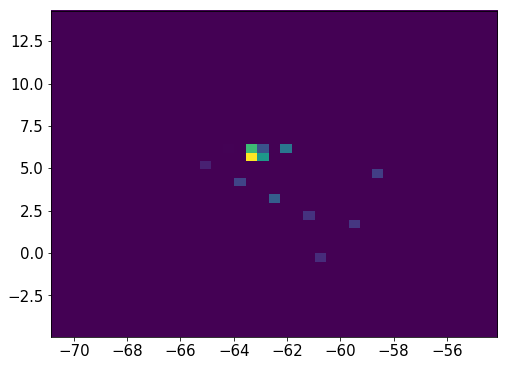

5262    19
5263    19
5264    19
5265    19
5266    19
5267    19
5268    19
5269    19
5270    19
5271    19
5272    19
5273    19
5274    19
5275    19
5276    19
5277    19
5278    19
5279    19
5280    19
5281    19
5282    19
Name: Nsipm, dtype: uint16


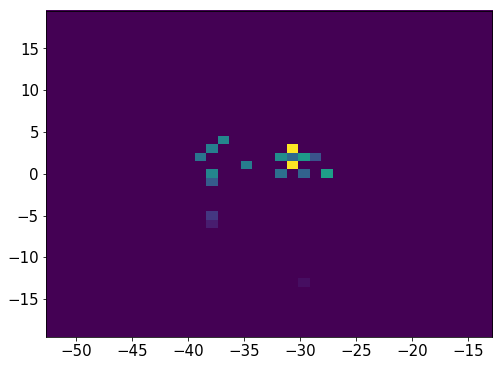

939063    23
939064    23
939065    23
939066    23
939067    23
939068    23
939069    23
939070    23
939071    23
939072    23
939073    23
939074    23
939075    23
939076    23
939077    23
939078    23
939079    23
939080    23
939081    23
939082    23
939083    23
Name: Nsipm, dtype: uint16


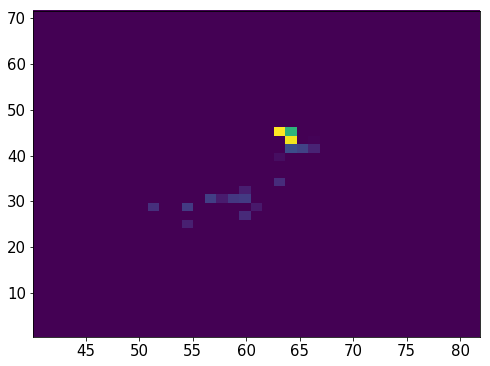

939088    24
939089    24
939090    24
939091    24
939092    24
939093    24
939094    24
939095    24
939096    24
939097    24
939098    24
939099    24
939100    24
939101    24
939102    24
939103    24
939104    24
939105    24
939106    24
939107    24
939108    24
939109    24
939110    24
939111    24
939112    24
Name: Nsipm, dtype: uint16


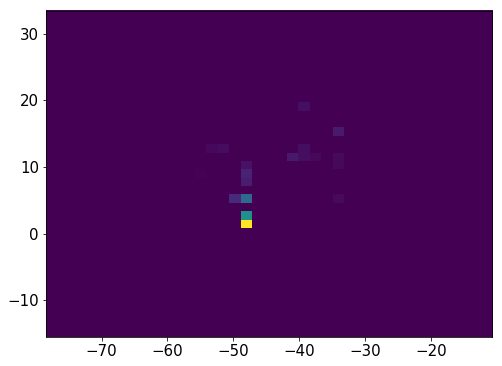

939117    50
939118    50
939119    50
939120    50
939121    50
939122    50
939123    50
939124    50
939125    50
939126    50
939127    50
939128    50
939129    50
939130    50
939131    50
939132    50
939133    50
939134    50
939135    50
939136    50
939137    50
939138    50
939139    50
939140    50
939141    50
939142    50
939143    50
939144    50
939145    50
939146    50
939147    50
Name: Nsipm, dtype: uint16


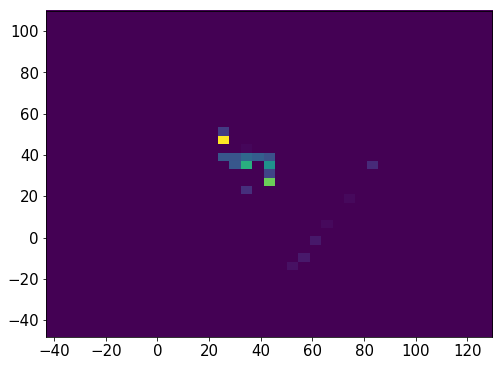

939148    35
939149    35
939150    35
939151    35
939152    35
939153    35
939154    35
939155    35
939156    35
939157    35
939158    35
939159    35
939160    35
939161    35
939162    35
939163    35
939164    35
939165    35
939166    35
939167    35
939168    35
939169    35
939170    35
939171    35
939172    35
939173    35
939174    35
939175    35
939176    35
939177    35
939178    35
939179    35
939180    35
939181    35
939182    35
939183    35
939184    35
939185    35
939186    35
939187    35
Name: Nsipm, dtype: uint16


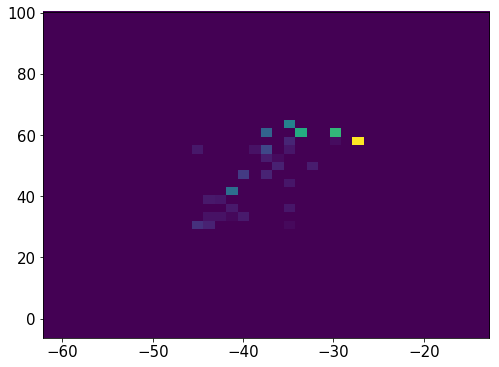

5307    35
5308    35
5309    35
5310    35
5311    35
5312    35
5313    35
5314    35
5315    35
Name: Nsipm, dtype: uint16


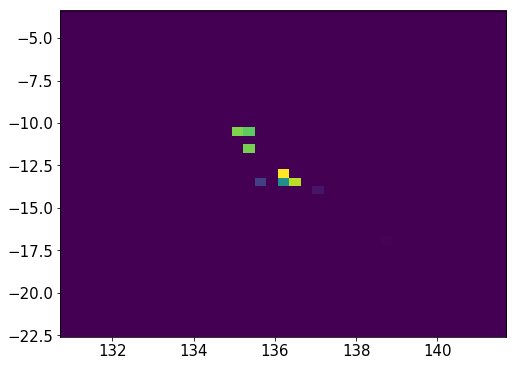

939192    25
939193    25
939194    25
939195    25
939196    25
939197    25
939198    25
939199    25
939200    25
939201    25
939202    25
939203    25
939204    25
939205    25
939206    25
939207    25
939208    25
939209    25
939210    25
939211    25
939212    25
Name: Nsipm, dtype: uint16


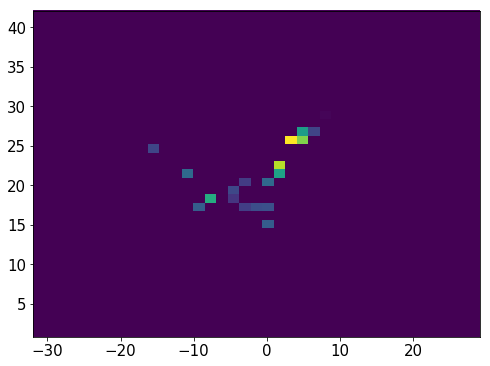

5321    31
5322    31
5323    31
5324    31
5325    31
5326    31
5327    31
5328    31
5329    31
5330    31
5331    31
5332    31
5333    31
5334    31
5335    31
5336    31
5337    31
5338    31
Name: Nsipm, dtype: uint16


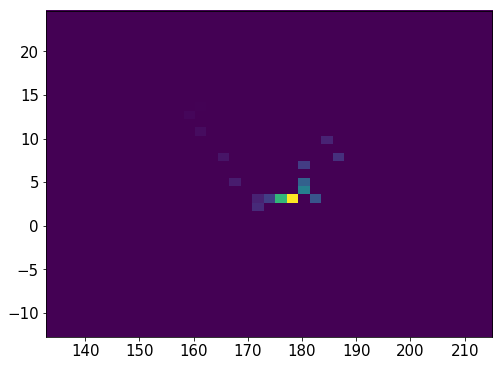

939217    29
939218    29
939219    29
939220    29
939221    29
939222    29
939223    29
939224    29
939225    29
939226    29
939227    29
939228    29
939229    29
939230    29
939231    29
939232    29
Name: Nsipm, dtype: uint16


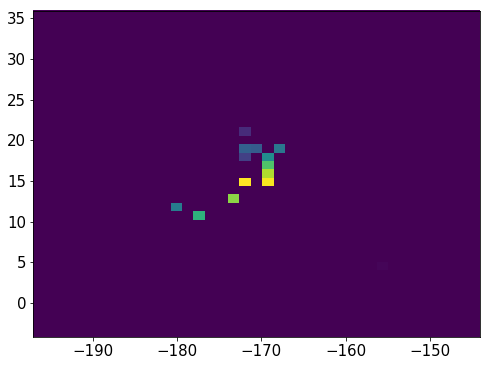

5344    25
5345    25
5346    25
5347    25
5348    25
5349    25
5350    25
5351    25
5352    25
5353    25
5354    25
5355    25
5356    25
5357    25
5358    25
5359    25
5360    25
5361    25
5362    25
5363    25
5364    25
Name: Nsipm, dtype: uint16


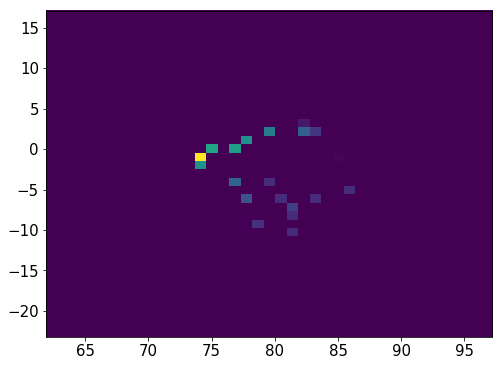

5370    17
5371    17
5372    17
5373    17
5374    17
5375    17
5376    17
5377    17
5378    17
5379    17
5380    17
5383    17
5384    17
5385    17
5386    17
5387    17
5388    17
5389    17
5390    17
5391    17
5392    17
5393    17
Name: Nsipm, dtype: uint16


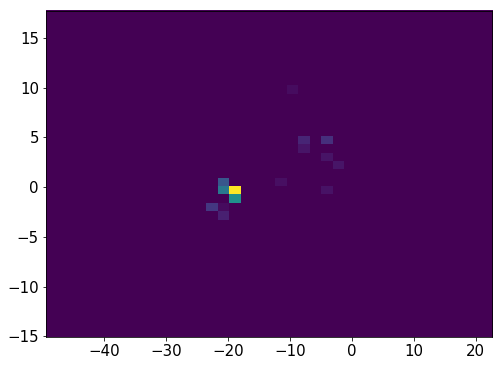

5398    26
5399    26
5400    26
5401    26
5402    26
5403    26
5404    26
5405    26
5406    26
5407    26
5408    26
5409    26
5410    26
5411    26
5412    26
Name: Nsipm, dtype: uint16


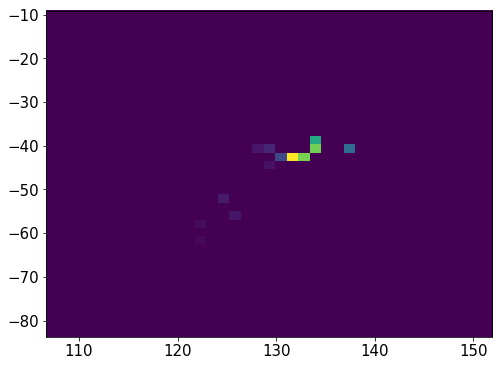

5417    23
5418    23
5419    23
5420    23
5421    23
5422    23
5423    23
5424    23
5425    23
5426    23
5427    23
5428    23
Name: Nsipm, dtype: uint16


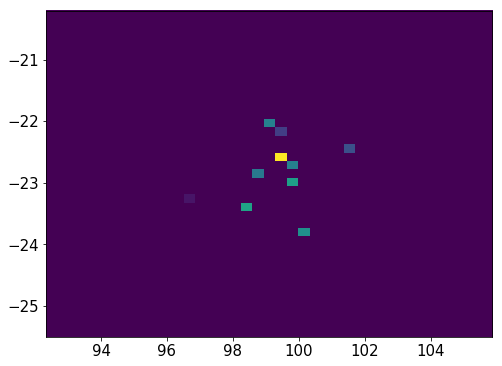

939237    32
939238    32
939239    32
939240    32
939241    32
939242    32
939243    32
939244    32
939245    32
939246    32
939247    32
Name: Nsipm, dtype: uint16


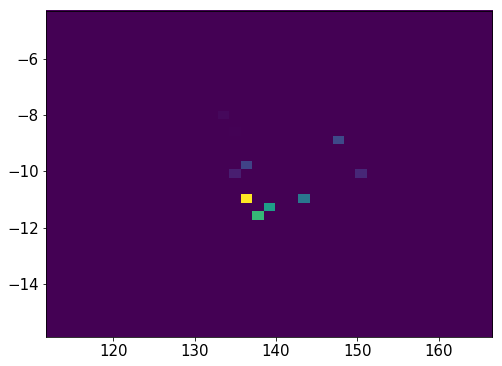

939252    28
939253    28
939254    28
939255    28
939256    28
939257    28
939258    28
939259    28
939260    28
939261    28
939262    28
939263    28
939264    28
939265    28
939266    28
939267    28
939268    28
939269    28
939270    28
939271    28
939272    28
939273    28
939274    28
939275    28
Name: Nsipm, dtype: uint16


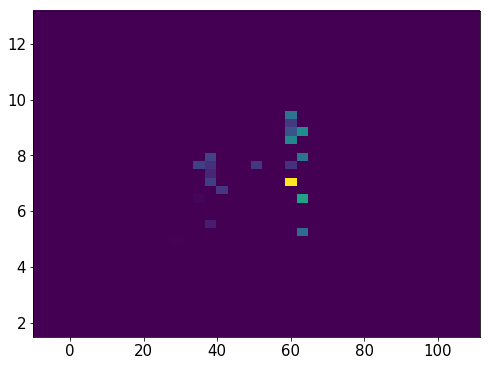

5432    25
5433    25
5434    25
5435    25
5436    25
5437    25
5438    25
5439    25
5440    25
5441    25
5442    25
5443    25
5444    25
5445    25
5446    25
5447    25
Name: Nsipm, dtype: uint16


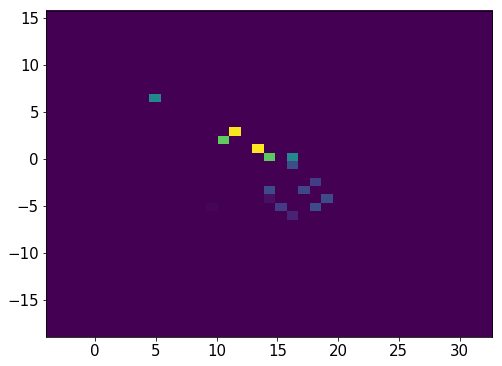

5452    27
5453    27
5454    27
5455    27
5456    27
5457    27
5458    27
5459    27
5460    27
5461    27
5462    27
5463    27
5464    27
5465    27
5466    27
5467    27
Name: Nsipm, dtype: uint16


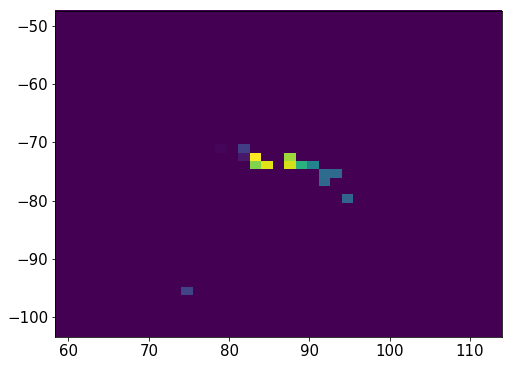

5471    24
5472    24
5473    24
5474    24
5475    24
5476    24
5477    24
5478    24
5479    24
5480    24
5481    24
5482    24
Name: Nsipm, dtype: uint16


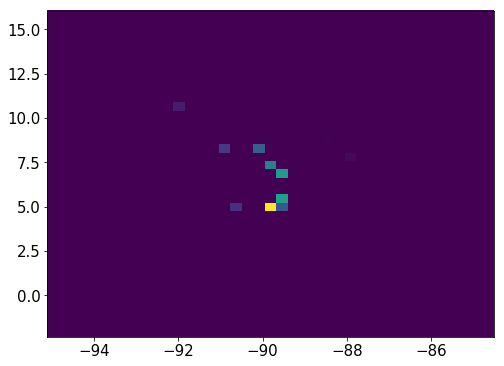

939304    35
939305    35
939306    35
939307    35
939308    35
939309    35
939310    35
939311    35
939312    35
939313    35
939314    35
939315    35
939316    35
Name: Nsipm, dtype: uint16


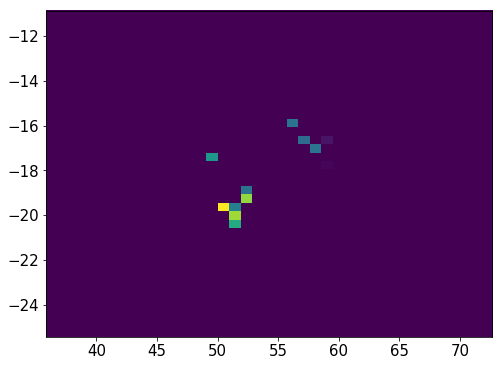

939321    22
939322    22
939323    22
939324    22
939325    22
939326    22
939327    22
939328    22
939329    22
939330    22
939331    22
939332    22
939333    22
939334    22
939335    22
939336    22
939337    22
939338    22
939339    22
939340    22
939341    22
Name: Nsipm, dtype: uint16


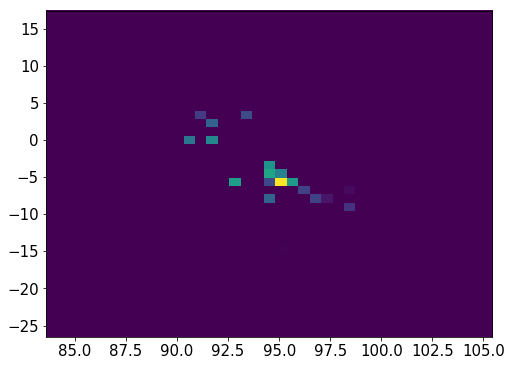

5487    23
5488    23
5489    23
5490    23
5491    23
5492    23
5493    23
5494    23
Name: Nsipm, dtype: uint16


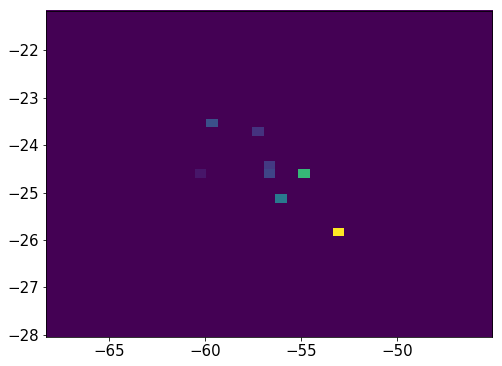

5499    29
5500    29
5501    29
5502    29
5503    29
5504    29
5505    29
5506    29
5507    29
5508    29
5509    29
5510    29
5511    29
5512    29
5513    29
5514    29
5515    29
5516    29
5517    29
5518    29
5519    29
Name: Nsipm, dtype: uint16


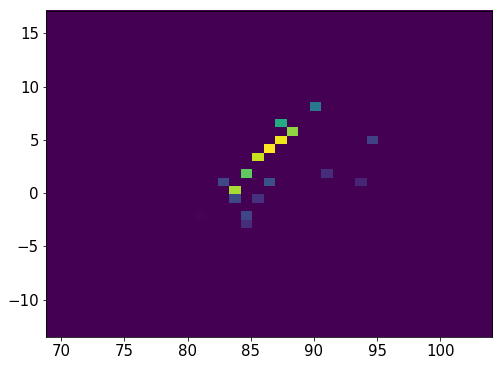

939374    29
939375    29
939376    29
939377    29
939378    29
939379    29
939380    29
939381    29
939382    29
939383    29
939384    29
939385    29
939386    29
Name: Nsipm, dtype: uint16


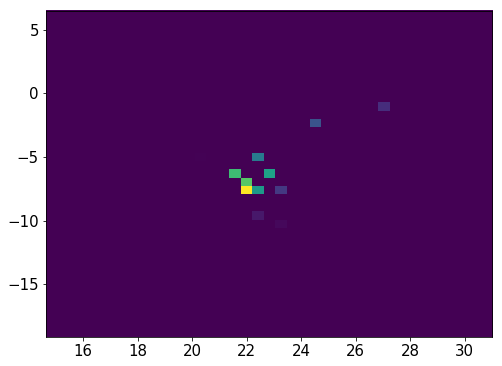

939391    36
939392    36
939393    36
939394    36
939395    36
939396    36
939397    36
939398    36
939399    36
939400    36
939401    36
939402    36
939403    36
939404    36
939405    36
939406    36
939407    36
939408    36
939409    36
939410    36
939411    36
939412    36
939413    36
Name: Nsipm, dtype: uint16


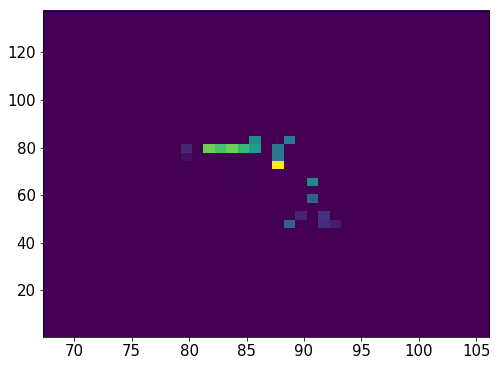

939418    27
939419    27
939420    27
939421    27
939422    27
939423    27
939424    27
939425    27
939426    27
939427    27
939428    27
939429    27
939430    27
939431    27
939432    27
939433    27
939434    27
939435    27
939436    27
939437    27
939438    27
939439    27
939440    27
939441    27
939442    27
939443    27
Name: Nsipm, dtype: uint16


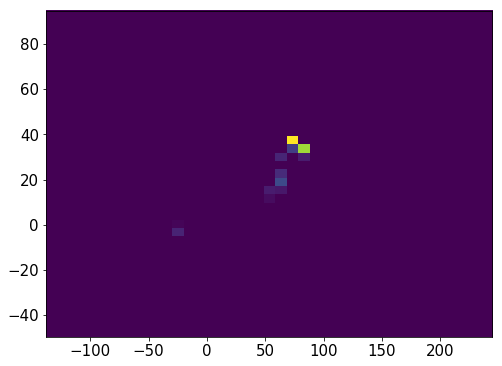

639932    32
639933    32
639934    32
639935    32
639936    32
639937    32
639938    32
639939    32
639940    32
639941    32
639942    32
639943    32
639944    32
639945    32
639946    32
639947    32
639948    32
Name: Nsipm, dtype: uint16


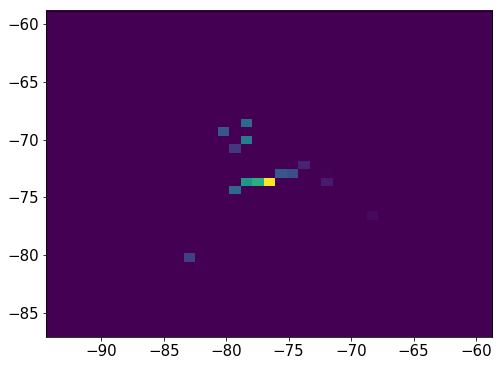

939447    36
939448    36
939449    36
939450    36
939451    36
939452    36
939453    36
939454    36
939455    36
939456    36
939457    36
939458    36
939459    36
939460    36
939463    36
939464    36
939465    36
939466    36
939467    36
939468    36
939469    36
Name: Nsipm, dtype: uint16


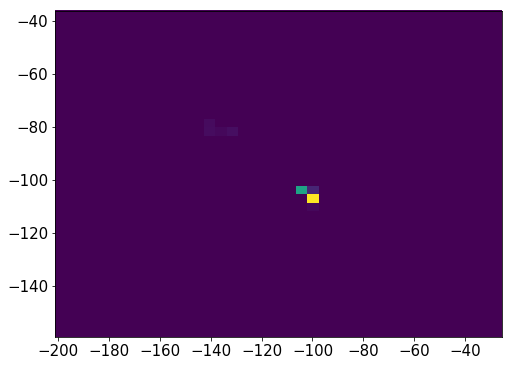

5523    26
5524    26
5525    26
5526    26
5527    26
5528    26
5529    26
5530    26
5531    26
5532    26
5533    26
5534    26
5539     1
5540     1
5541     1
Name: Nsipm, dtype: uint16


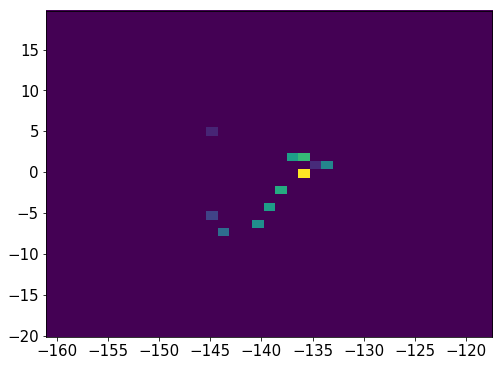

939474    39
939475    39
939476    39
939477    39
939478    39
939479    39
939480    39
939481    39
939482    39
939483    39
939484    39
939485    39
939486    39
939487    39
939488    39
939489    39
939490    39
Name: Nsipm, dtype: uint16


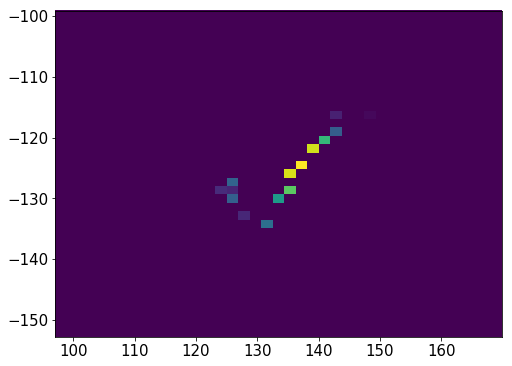

5547    25
5548    25
5549    25
5550    25
5551    25
5552    25
5553    25
5554    25
5555    25
5556    25
5557    25
5558    25
5559    25
5564    14
5565    14
5566    14
5567    14
5568    14
5573    14
5574    14
5575    14
5576    14
5577    14
5578    14
5579    14
5580    14
5581    14
Name: Nsipm, dtype: uint16


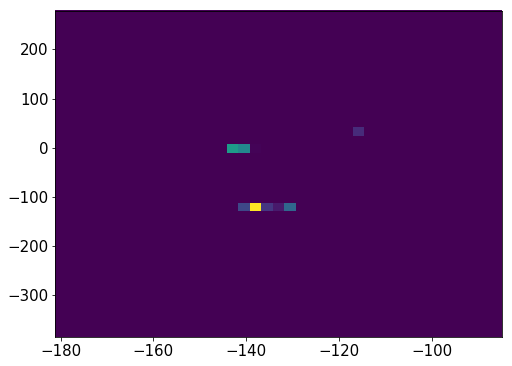

5585    24
5586    24
5587    24
5588    24
5589    24
5590    24
5591    24
5592    24
5593    24
5594    24
5595    24
5596    24
5597    24
5598    24
5599    24
5600    24
5601    24
5602    24
5603    24
5604    24
5605    24
5606    24
5607    24
5608    24
5609    24
5610    24
5611    24
5612    24
5613    24
5614    24
5615    24
Name: Nsipm, dtype: uint16


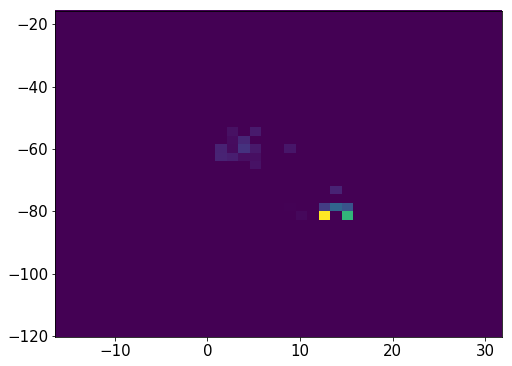

5619    25
5620    25
5621    25
5622    25
5623    25
5624    25
5625    25
5626    25
5627    25
5628    25
5629    25
5630    25
5631    25
5632    25
5633    25
Name: Nsipm, dtype: uint16


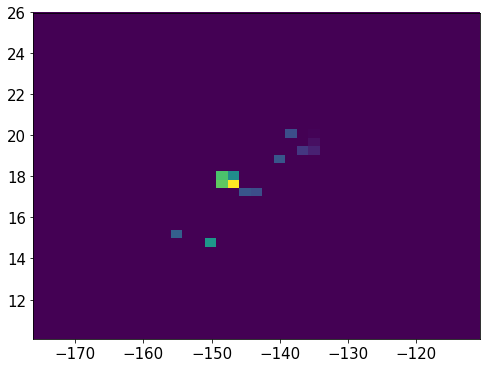

5638    24
5639    24
5640    24
5641    24
5642    24
5643    24
5644    24
5645    24
5646    24
5647    24
5648    24
5649    24
5650    24
5651    24
5652    24
5653    24
5654    24
5655    24
5656    24
5657    24
5658    24
5659    24
5660    24
Name: Nsipm, dtype: uint16


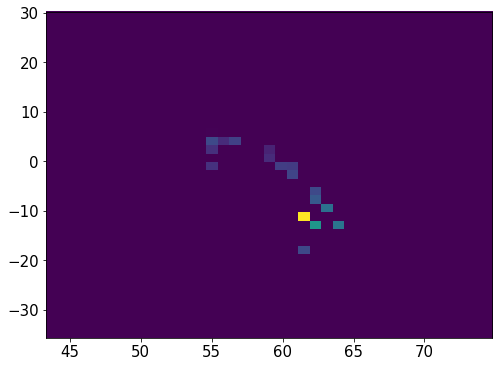

5664    23
5665    23
5666    23
5667    23
5668    23
5669    23
5670    23
5671    23
5672    23
5673    23
5674    23
5675    23
5676    23
5677    23
5678    23
5679    23
5680    23
5681    23
5682    23
5683    23
5684    23
5685    23
5686    23
Name: Nsipm, dtype: uint16


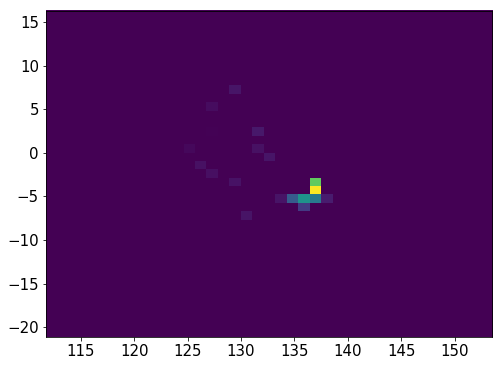

932949    25
932950    25
932951    25
932952    25
932953    25
932954    25
932955    25
932956    25
932957    25
932958    25
932959    25
932960    25
932961    25
Name: Nsipm, dtype: uint16


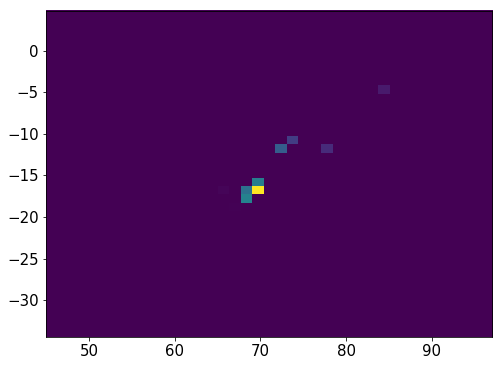

5692    29
5693    29
5694    29
5695    29
5696    29
5697    29
5698    29
5699    29
5700    29
5703    16
5704    16
5705    16
5706    16
5707    16
5708    16
5709    16
5715     2
5716     2
5717     2
5724     2
5725     2
5726     2
5727     2
5728     2
5729     2
Name: Nsipm, dtype: uint16


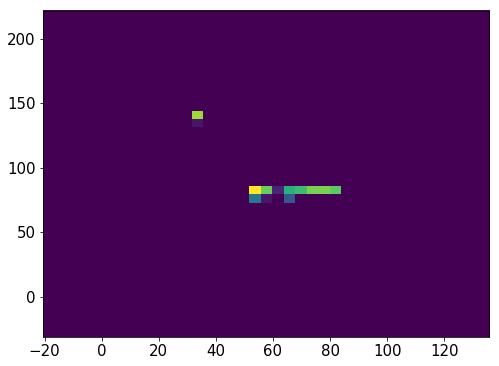

939544    27
939545    27
939546    27
939547    27
939548    27
939549    27
939550    27
939551    27
939552    27
939553    27
939554    27
939555    27
939556    27
939557    27
939558    27
939559    27
939560    27
939561    27
Name: Nsipm, dtype: uint16


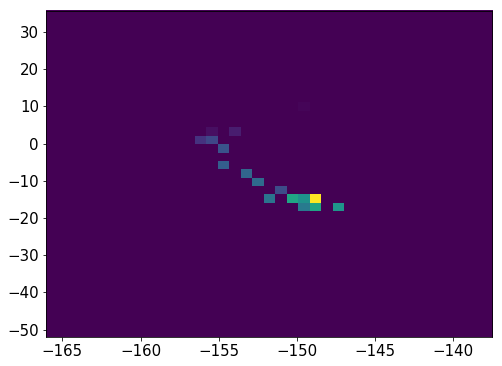

5734    26
5735    26
5736    26
5737    26
5738    26
5739    26
5740    26
5741    26
5742    26
5743    26
5744    26
5745    26
5746    26
5747    26
Name: Nsipm, dtype: uint16


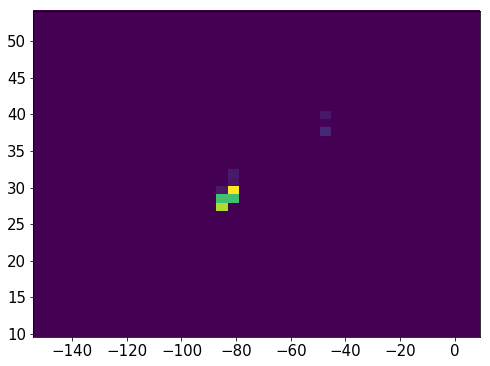

939565    29
939566    29
939567    29
939568    29
939569    29
939570    29
939571    29
939572    29
939573    29
939576    12
939577    12
939578    12
939579    12
939580    12
939581    12
939582    12
939583    12
939584    12
939585    12
939586    12
939587    12
Name: Nsipm, dtype: uint16


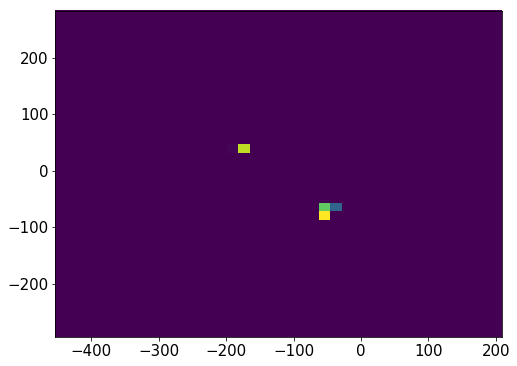

5753    28
5754    28
5755    28
5756    28
5757    28
5758    28
5759    28
5760    28
5761    28
5762    28
5763    28
5764    28
5765    28
5766    28
5767    28
5768    28
5769    28
5770    28
5771    28
5772    28
5773    28
Name: Nsipm, dtype: uint16


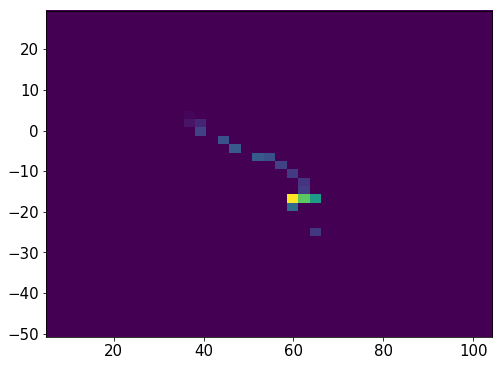

5778    23
5779    23
5780    23
5781    23
5782    23
5783    23
5784    23
5785    23
5786    23
5787    23
5788    23
5789    23
5790    23
5791    23
5792    23
5793    23
5794    23
5795    23
5796    23
5797    23
Name: Nsipm, dtype: uint16


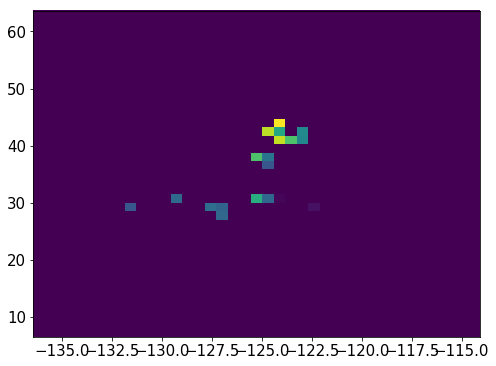

5803    29
5804    29
5805    29
5806    29
5807    29
5808    29
5809    29
5810    29
5811    29
5812    29
5813    29
5814    29
5815    29
5816    29
5817    29
5818    29
Name: Nsipm, dtype: uint16


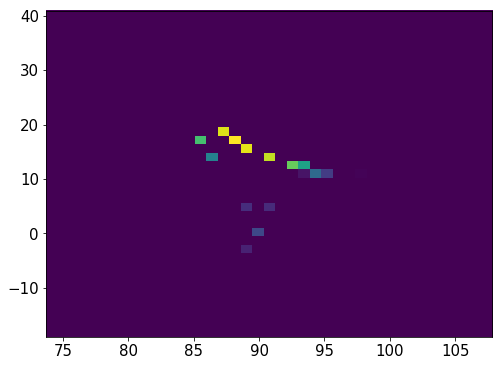

5823    32
5824    32
5825    32
5826    32
5827    32
5828    32
5829    32
5830    32
5831    32
5832    32
5833    32
5834    32
5835    32
5836    32
5841     9
5842     9
5843     9
5844     9
5845     9
5846     9
5847     9
5848     9
Name: Nsipm, dtype: uint16


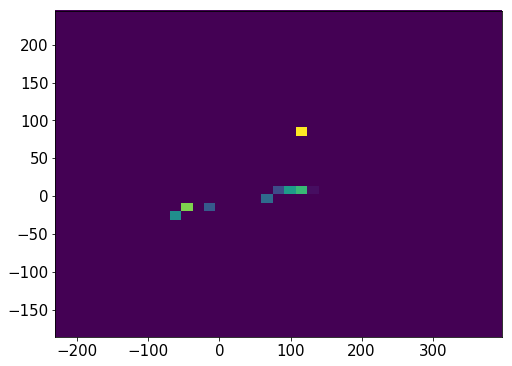

5853    24
5854    24
5855    24
5856    24
5857    24
5858    24
5859    24
5860    24
5861    24
5862    24
5863    24
5864    24
5865    24
5866    24
5867    24
5868    24
5869    24
5870    24
5871    24
5872    24
5873    24
5874    24
5875    24
5876    24
5881     6
5882     6
5883     6
5884     6
5885     6
5886     6
5887     6
5888     6
Name: Nsipm, dtype: uint16


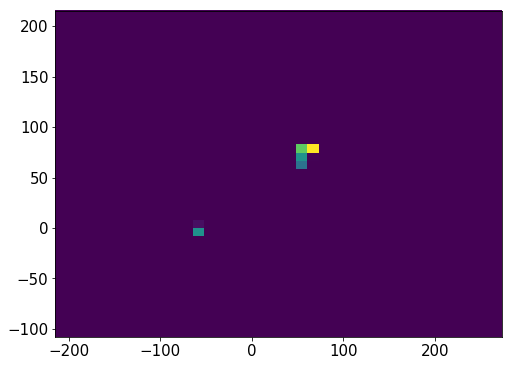

939649    23
939650    23
939651    23
939652    23
939653    23
939654    23
939655    23
939656    23
939657    23
939658    23
939659    23
939660    23
939661    23
939662    23
939663    23
939664    23
939665    23
939666    23
939667    23
939668    23
Name: Nsipm, dtype: uint16


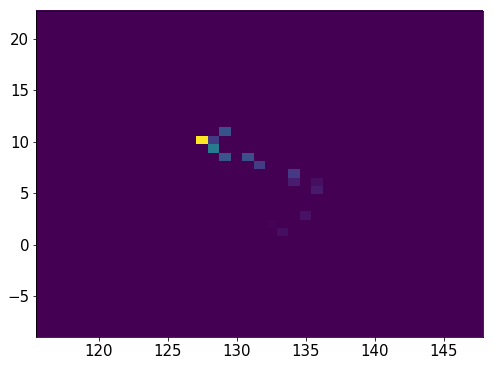

5891    22
5892    22
5893    22
5894    22
5895    22
5896    22
5897    22
5898    22
5899    22
5900    22
5901    22
Name: Nsipm, dtype: uint16


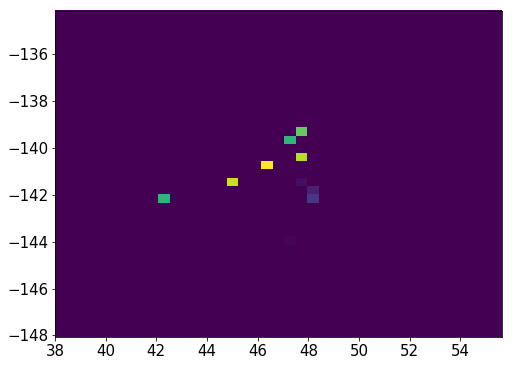

939674    21
939675    21
939676    21
939677    21
939678    21
939679    21
939680    21
939681    21
939682    21
939683    21
939684    21
939685    21
939686    21
939687    21
939688    21
939689    21
Name: Nsipm, dtype: uint16


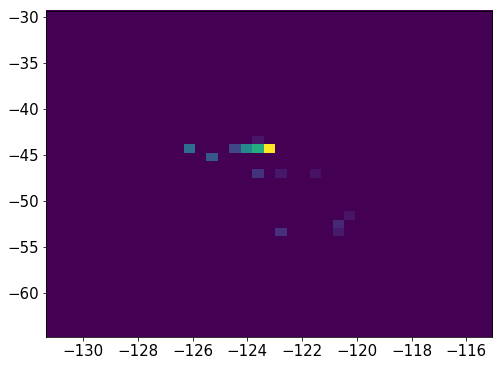

939691    20
939692    20
939693    20
939694    20
939695    20
939696    20
939697    20
939698    20
939699    20
939700    20
939701    20
939702    20
939703    20
939704    20
939705    20
939706    20
939707    20
939708    20
939709    20
939710    20
939711    20
939712    20
939718    14
939719    14
939720    14
939721    14
939722    14
939726    14
939727    14
939728    14
939729    14
939730    14
939731    14
939732    14
939733    14
939734    14
939735    14
939736    14
939737    14
939738    14
939739    14
939740    14
939741    14
939742    14
939743    14
Name: Nsipm, dtype: uint16


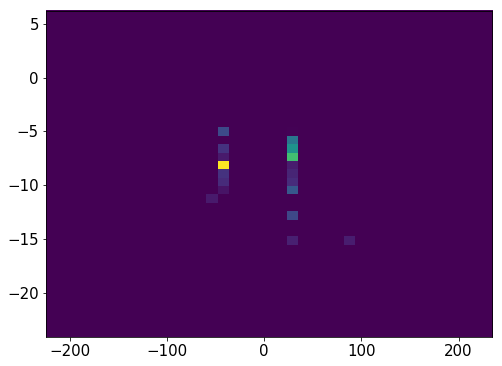

5931    27
5932    27
5933    27
5934    27
5935    27
5936    27
5937    27
5938    27
5939    27
5940    27
5941    27
5942    27
5943    27
5944    27
5945    27
5947    27
5948    27
Name: Nsipm, dtype: uint16


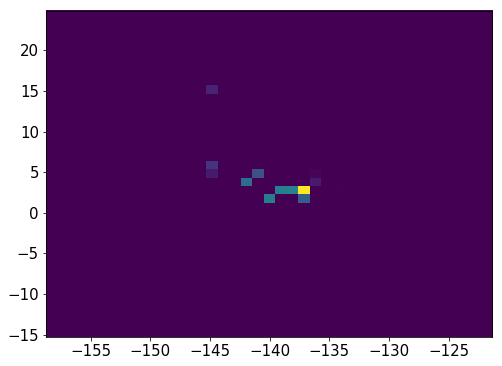

939748    32
939749    32
939750    32
939751    32
939752    32
939753    32
939754    32
939755    32
939756    32
939757    32
939758    32
939759    32
939760    32
939761    32
939762    32
Name: Nsipm, dtype: uint16


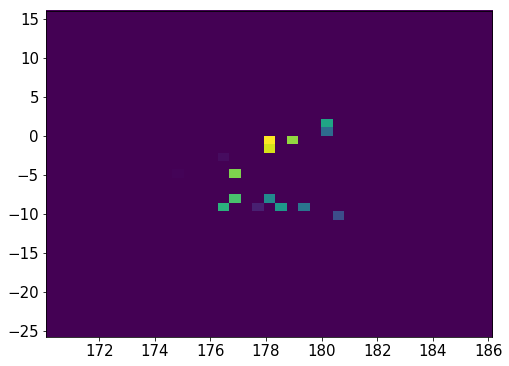

5954    32
5955    32
5956    32
5957    32
5958    32
5959    32
5960    32
5961    32
5962    32
5963    32
5964    32
5965    32
5966    32
5967    32
Name: Nsipm, dtype: uint16


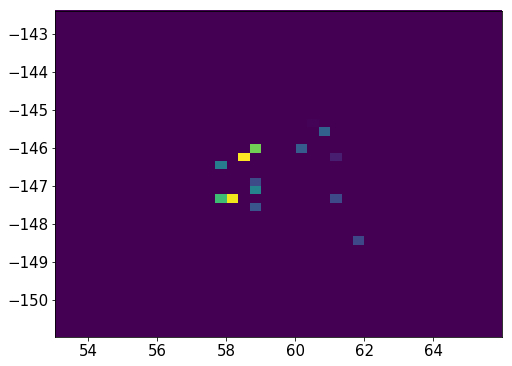

1899451    21
1899452    21
1899453    21
1899454    21
1899455    21
1899456    21
1899457    21
1899458    21
1899459    21
1899460    21
1899461    21
1899462    21
1899463    21
1899464    21
1899465    21
1899466    21
1899467    21
1899468    21
1899469    21
1899470    21
1899471    21
Name: Nsipm, dtype: uint16


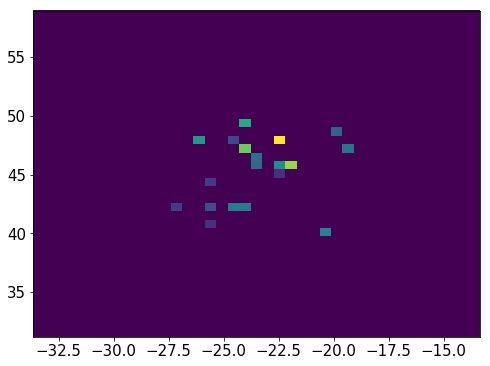

939766    30
939767    30
939768    30
939769    30
939770    30
939771    30
939772    30
939773    30
939774    30
939775    30
939776    30
939777    30
939778    30
939779    30
939780    30
939781    30
939782    30
939783    30
939784    30
939785    30
939786    30
939787    30
939788    30
939789    30
939790    30
939791    30
939792    30
939793    30
939794    30
939795    30
939798    30
939799    30
939800    30
939801    30
939802    30
939803    30
939804    30
939805    30
Name: Nsipm, dtype: uint16


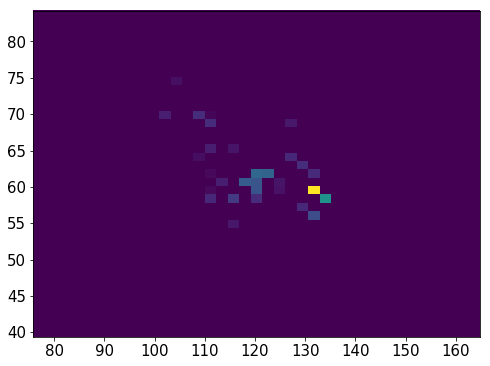

939811    25
939812    25
939813    25
939814    25
939815    25
939816    25
939817    25
939818    25
939819    25
939820    25
939821    25
939822    25
939823    25
939824    25
939825    25
939826    25
939827    25
939828    25
939832     1
939833     1
939834     1
939835     1
Name: Nsipm, dtype: uint16


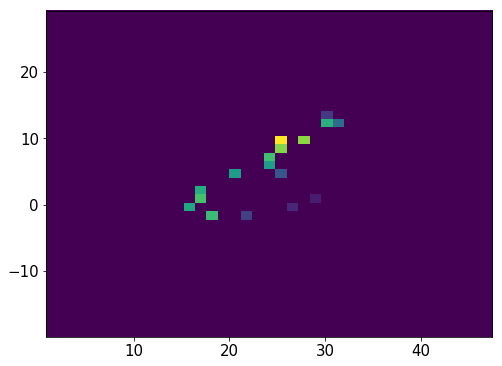

939842    34
939843    34
939844    34
939845    34
939846    34
939847    34
939848    34
939849    34
939850    34
939851    34
939852    34
939853    34
939854    34
939855    34
Name: Nsipm, dtype: uint16


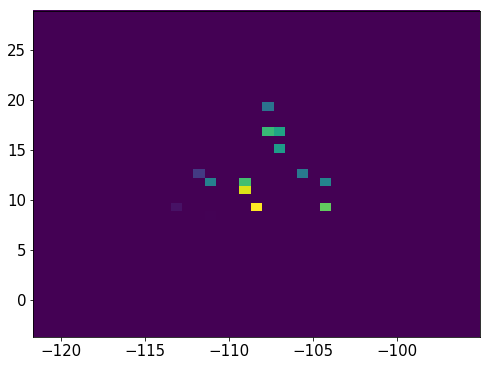

5972    31
5973    31
5974    31
5975    31
5976    31
5977    31
5978    31
5979    31
5980    31
5981    31
5982    31
5983    31
5984    31
5985    31
Name: Nsipm, dtype: uint16


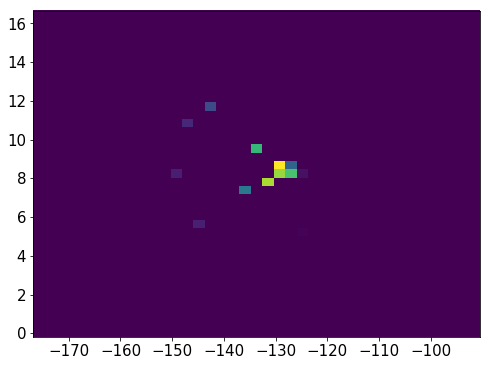

5991    25
5992    25
5993    25
5994    25
5995    25
5996    25
5997    25
5998    25
5999    25
6000    25
6001    25
6002    25
6003    25
6004    25
6005    25
6006    25
6007    25
6008    25
6009    25
6010    25
6011    25
6012    25
6013    25
6014    25
Name: Nsipm, dtype: uint16


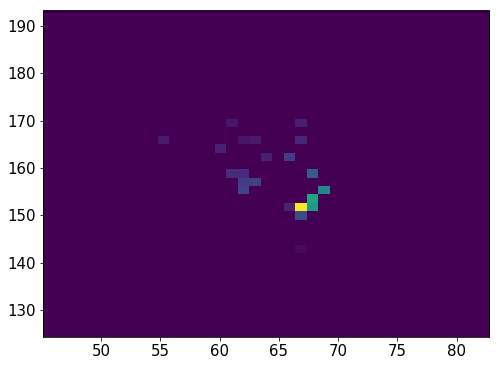

939885    27
939886    27
939887    27
939888    27
939889    27
939890    27
939891    27
939892    27
939893    27
939894    27
939895    27
939896    27
939897    27
939898    27
939899    27
939900    27
Name: Nsipm, dtype: uint16


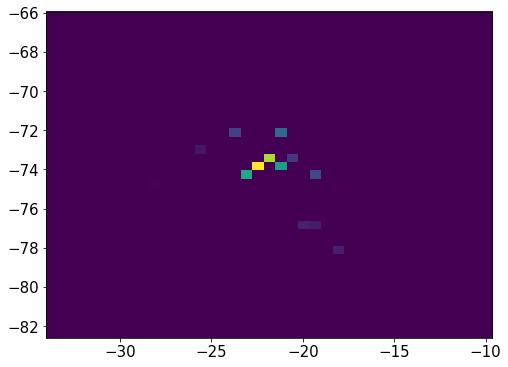

6017    31
6018    31
6019    31
6020    31
6021    31
6022    31
6023    31
6024    31
6025    31
6026    31
6027    31
6028    31
6029    31
6030    31
6031    31
6032    31
Name: Nsipm, dtype: uint16


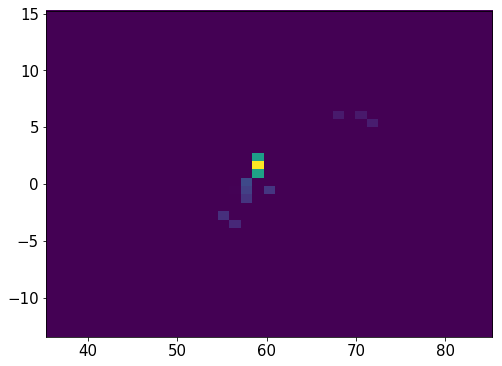

939906    16
939907    16
939908    16
939909    16
939910    16
939911    16
939912    16
939913    16
939914    16
939915    16
939916    16
939917    16
939918    16
939919    16
939920    16
939921    16
939922    16
939923    16
939924    16
939926    16
939927    16
939928    16
939929    16
939930    16
Name: Nsipm, dtype: uint16


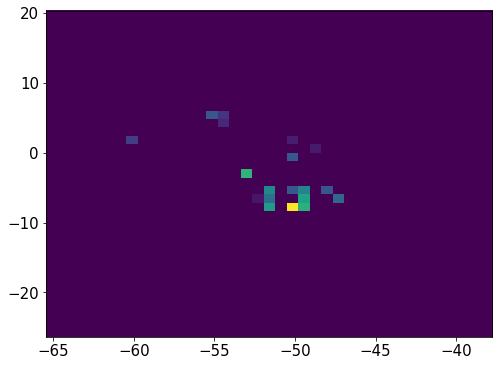

6036    22
6037    22
6038    22
6039    22
6040    22
6041    22
6042    22
6043    22
6044    22
6045    22
6046    22
6051     9
6052     9
6053     9
6054     9
6055     9
6056     9
6057     9
6058     9
6059     9
6060     9
Name: Nsipm, dtype: uint16


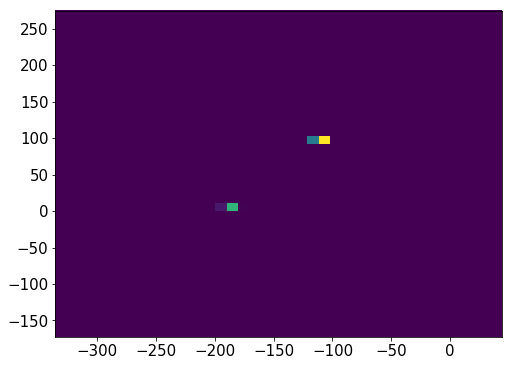

939936    30
939937    30
939938    30
939939    30
939940    30
939941    30
939942    30
939943    30
939944    30
939945    30
939946    30
939947    30
939948    30
939949    30
939950    30
939951    30
939952    30
939953    30
939954    30
939955    30
939956    30
939957    30
939958    30
939959    30
Name: Nsipm, dtype: uint16


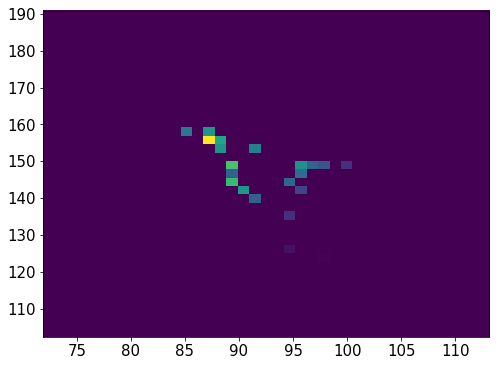

6065    24
6066    24
6067    24
6068    24
6069    24
6070    24
6071    24
6072    24
6073    24
6074    24
6075    24
6076    24
6077    24
6078    24
6079    24
6080    24
6084    18
6085    18
6086    18
6087    18
6088    18
6089    18
6090    18
6091    18
6092    18
6093    18
6094    18
6095    18
Name: Nsipm, dtype: uint16


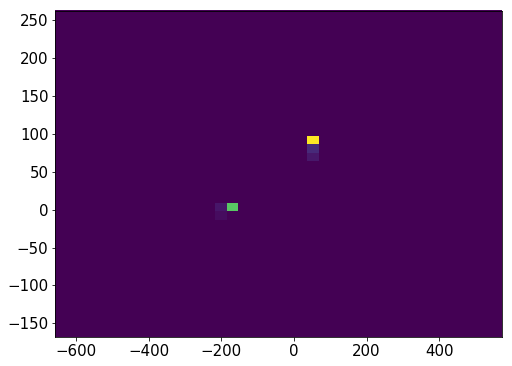

6099    23
6100    23
6101    23
6107    23
6108    23
6109    23
6110    23
6111    23
6112    23
6113    23
6114    23
6115    23
6116    23
6117    23
6118    23
6119    23
6120    23
6121    23
Name: Nsipm, dtype: uint16


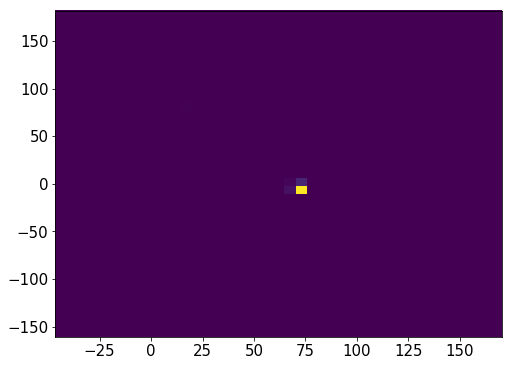

939963    27
939964    27
939965    27
939966    27
939967    27
939968    27
939969    27
939970    27
939971    27
939972    27
939973    27
939974    27
939975    27
939976    27
939977    27
939978    27
939979    27
939980    27
939981    27
939982    27
Name: Nsipm, dtype: uint16


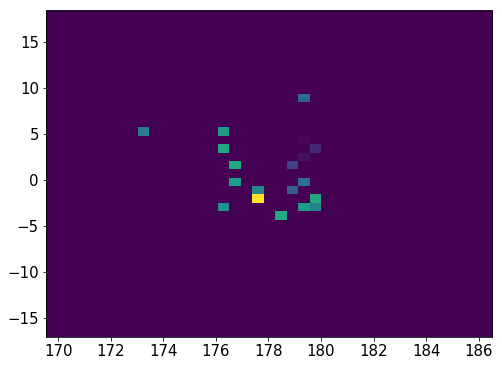

6122    24
6123    24
6124    24
6125    24
6126    24
6127    24
6128    24
6129    24
6130    24
6131    24
6132    24
6133    24
6134    24
6135    24
6136    24
6137    24
6138    24
6139    24
6140    24
6142    24
6143    24
Name: Nsipm, dtype: uint16


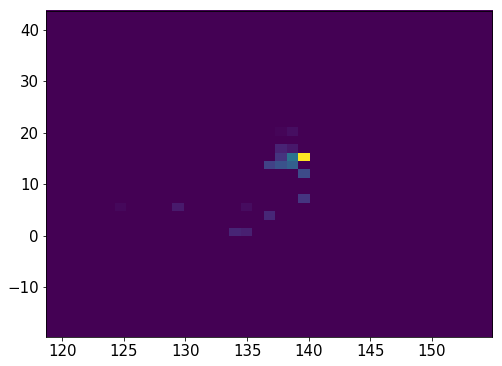

6148    36
6149    36
6150    36
6151    36
6152    36
6153    36
6154    36
6155    36
6156    36
6157    36
6158    36
6159    36
6160    36
6161    36
6162    36
Name: Nsipm, dtype: uint16


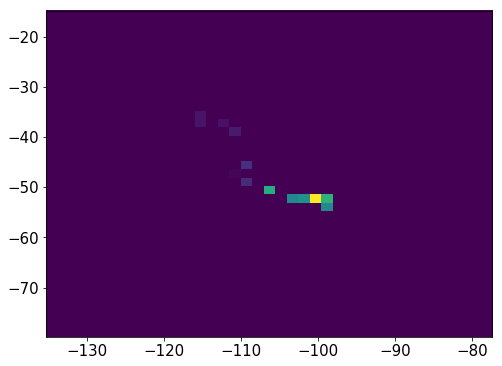

940003    28
940004    28
940005    28
940006    28
940007    28
940008    28
940009    28
940010    28
940011    28
940012    28
940013    28
940014    28
940015    28
940017    28
940019    28
940020    28
940021    28
940022    28
940023    28
940024    28
940025    28
940026    28
940027    28
940028    28
940029    28
940030    28
940031    28
940032    28
Name: Nsipm, dtype: uint16


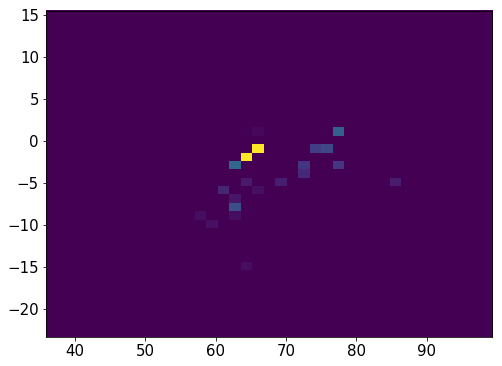

940037    27
940038    27
940039    27
940040    27
940041    27
940042    27
940043    27
940044    27
940045    27
940046    27
940047    27
940048    27
940049    27
940051    27
940052    27
940053    27
940054    27
940055    27
940056    27
940057    27
940058    27
940059    27
Name: Nsipm, dtype: uint16


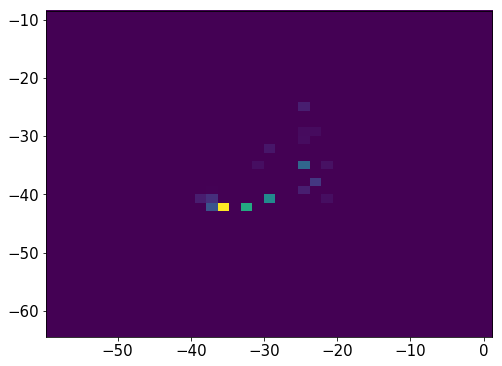

940065    31
940066    31
940067    31
940068    31
940069    31
940070    31
940071    31
940072    31
940073    31
940074    31
940075    31
940076    31
940077    31
940078    31
940079    31
940080    31
940081    31
940082    31
940083    31
940084    31
940085    31
940088    31
940089    31
940090    31
940091    31
940092    31
940093    31
940094    31
940095    31
940096    31
940097    31
Name: Nsipm, dtype: uint16


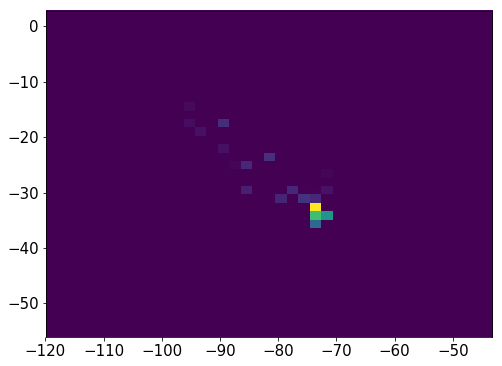

6166    28
6167    28
6168    28
6169    28
6170    28
6171    28
6172    28
6173    28
6174    28
6175    28
6176    28
6177    28
6178    28
6179    28
6180    28
6181    28
6182    28
6183    28
Name: Nsipm, dtype: uint16


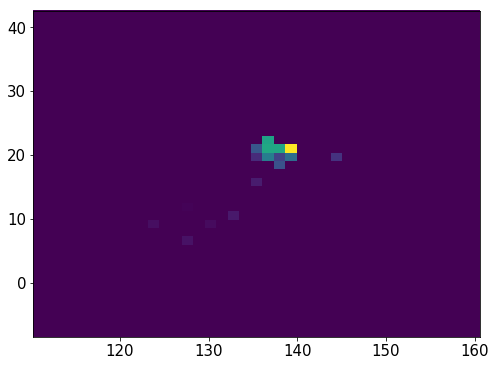

940122    31
940123    31
940124    31
940125    31
940126    31
940127    31
940128    31
940129    31
940130    31
940131    31
940132    31
940133    31
940134    31
940135    31
940136    31
940137    31
940138    31
940139    31
940140    31
940141    31
Name: Nsipm, dtype: uint16


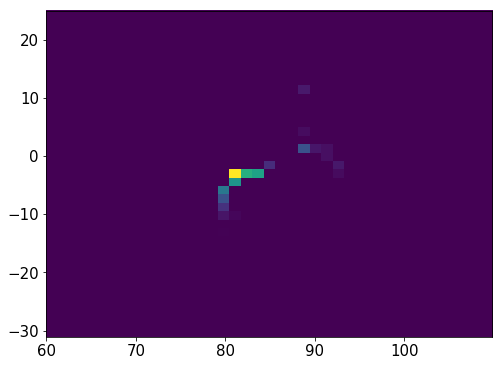

6187    24
6188    24
6189    24
6190    24
6191    24
6192    24
6193    24
6194    24
6195    24
6196    24
6197    24
6198    24
6199    24
6200    24
6201    24
6202    24
6203    24
6204    24
6205    24
6206    24
6207    24
6208    24
6209    24
6210    24
6211    24
6212    24
6213    24
6214    24
6215    24
6216    24
6217    24
6218    24
6219    24
6220    24
6221    24
6222    24
6223    24
6224    24
6225    24
Name: Nsipm, dtype: uint16


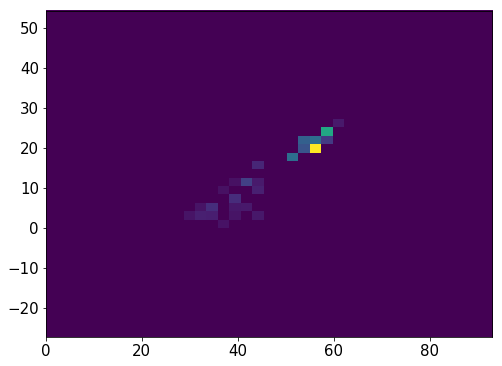

6229    22
6230    22
6231    22
6232    22
6233    22
6234    22
6235    22
6236    22
6237    22
6238    22
6239    22
6240    22
6241    22
6242    22
6243    22
6244    22
6245    22
6246    22
6247    22
6248    22
6249    22
6250    22
Name: Nsipm, dtype: uint16


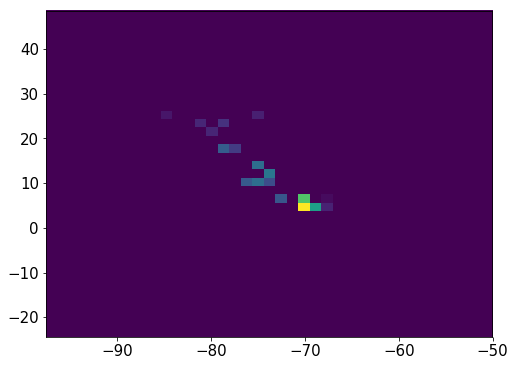

6254    30
6255    30
6256    30
6257    30
6258    30
6259    30
6261    30
6262    30
6263    30
6264    30
6265    30
6266    30
6267    30
6268    30
6269    30
6270    30
6271    30
6272    30
6273    30
6274    30
6275    30
Name: Nsipm, dtype: uint16


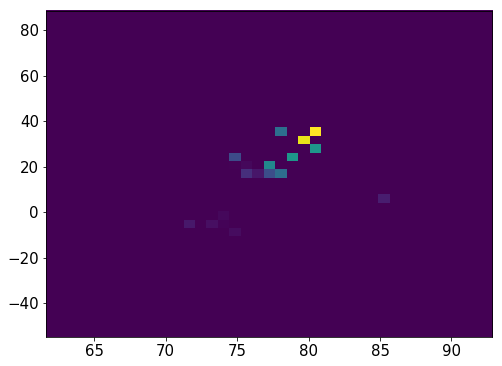

6276    22
6277    22
6278    22
6279    22
6280    22
6281    22
6282    22
6283    22
6284    22
6285    22
6286    22
6287    22
6288    22
6289    22
6290    22
6291    22
6292    22
6293    22
6294    22
6295    22
6300    22
6301    22
6302    22
6303    22
6304    22
6305    22
6306    22
6307    22
6308    22
6309    22
Name: Nsipm, dtype: uint16


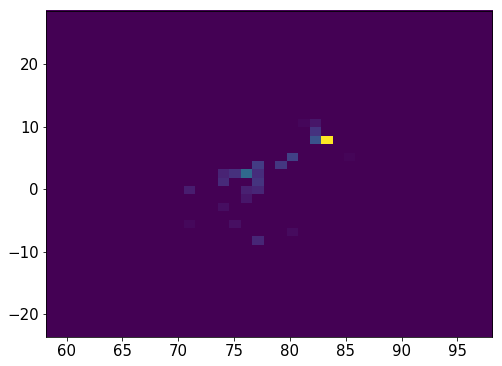

940168    36
940169    36
940170    36
940171    36
940172    36
940173    36
940174    36
940175    36
940176    36
940177    36
940178    36
940179    36
940180    36
940181    36
940182    36
Name: Nsipm, dtype: uint16


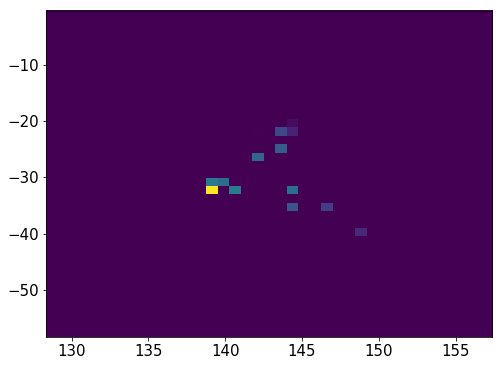

1664237    24
1664238    24
1664239    24
1664240    24
1664241    24
1664242    24
1664243    24
1664244    24
1664245    24
1664246    24
1664247    24
1664248    24
1664249    24
1664250    24
1664251    24
1664252    24
1664253    24
1664254    24
1664255    24
1664256    24
1664257    24
1664258    24
1664259    24
Name: Nsipm, dtype: uint16


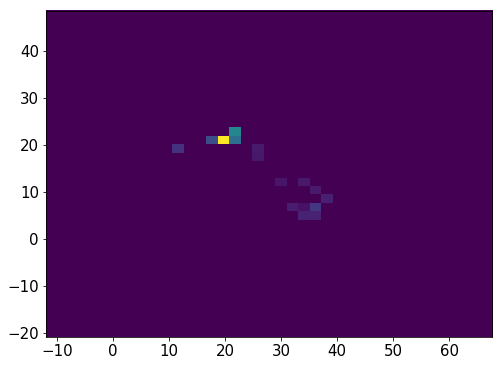

940186    28
940187    28
940188    28
940189    28
940190    28
940191    28
940192    28
940193    28
940194    28
940195    28
940196    28
940197    28
940198    28
940199    28
Name: Nsipm, dtype: uint16


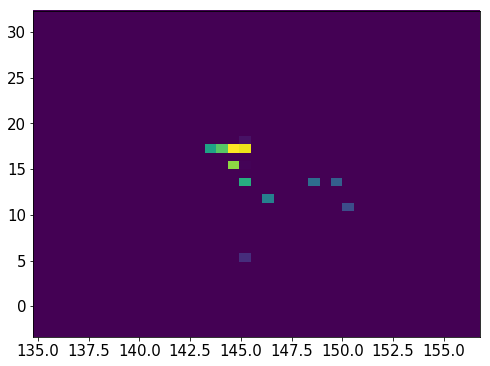

6314    28
6315    28
6316    28
6317    28
6318    28
6319    28
6320    28
6321    28
6322    28
6323    28
6324    28
6325    28
6326    28
6327    28
6328    28
6329    28
6330    28
6331    28
6332    28
6333    28
6334    28
Name: Nsipm, dtype: uint16


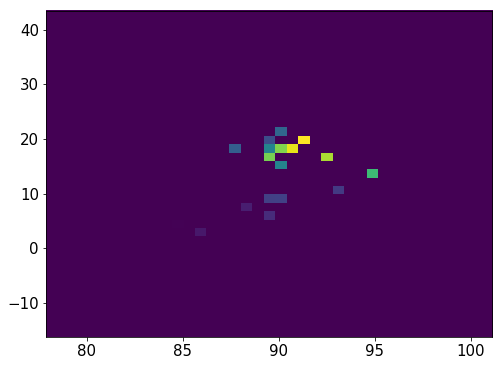

2269510    23
2269511    23
2269512    23
2269513    23
2269514    23
2269515    23
2269516    23
2269517    23
2269518    23
2269519    23
2269520    23
2269521    23
2269522    23
2269523    23
2269524    23
2269525    23
Name: Nsipm, dtype: uint16


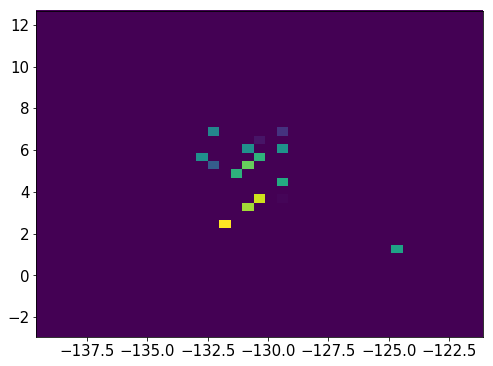

6339    26
6340    26
6341    26
6342    26
6343    26
6344    26
6345    26
6346    26
6347    26
6348    26
6349    26
6350    26
6351    26
6352    26
6353    26
6354    26
6355    26
Name: Nsipm, dtype: uint16


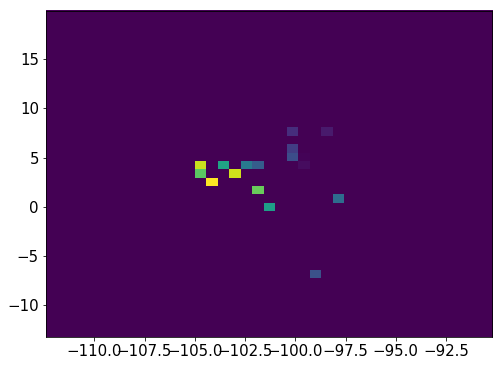

940203    24
940204    24
940205    24
940206    24
940207    24
940208    24
940209    24
940210    24
940211    24
940212    24
940213    24
Name: Nsipm, dtype: uint16


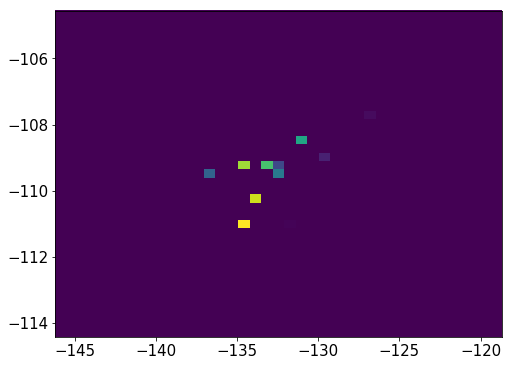

6361    35
6362    35
6363    35
6364    35
6365    35
6366    35
6367    35
6368    35
6369    35
6370    35
6371    35
6372    35
6373    35
6374    35
6375    35
6376    35
6377    35
6378    35
6379    35
6380    35
6381    35
6382    35
Name: Nsipm, dtype: uint16


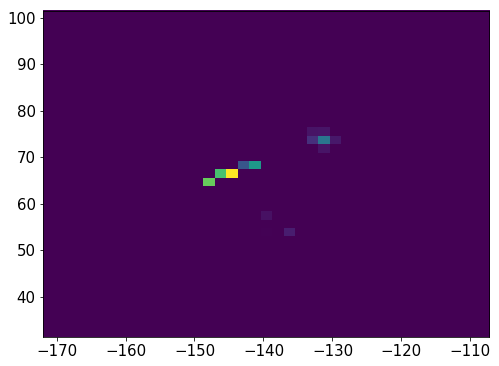

6387    42
6388    42
6389    42
6390    42
6391    42
6392    42
6393    42
6394    42
6395    42
6396    42
Name: Nsipm, dtype: uint16


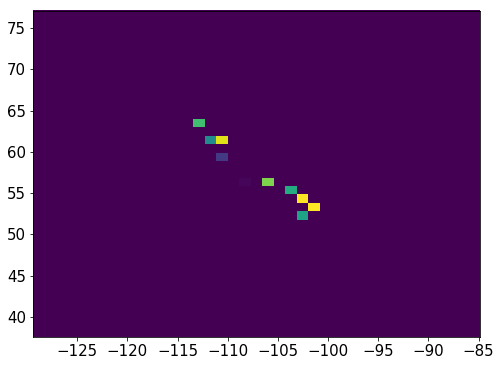

1664264    61
1664265    61
1664266    61
1664267    61
1664268    61
1664269    61
1664270    61
1664271    61
1664272    61
1664273    61
1664274    61
1664275    61
1664276    61
1664277    61
1664280    61
1664281    61
1664282    61
1664283    61
1664284    61
1664285    61
1664286    61
1664287    61
1664288    61
Name: Nsipm, dtype: uint16


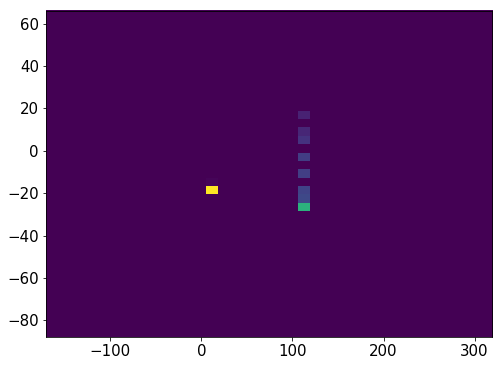

6401    27
6402    27
6403    27
6404    27
6405    27
6406    27
6407    27
6408    27
6409    27
6410    27
6411    27
6412    27
6413    27
6414    27
6415    27
6416    27
6417    27
6418    27
6419    27
6420    27
6421    27
6422    27
Name: Nsipm, dtype: uint16


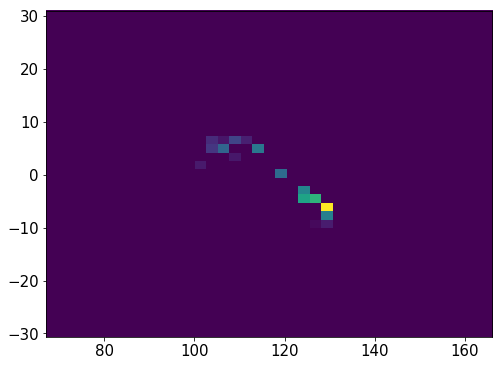

940218    24
940219    24
940220    24
940221    24
940222    24
940223    24
940224    24
940225    24
940226    24
940227    24
940228    24
940229    24
940230    24
940231    24
940232    24
940233    24
940234    24
940235    24
Name: Nsipm, dtype: uint16


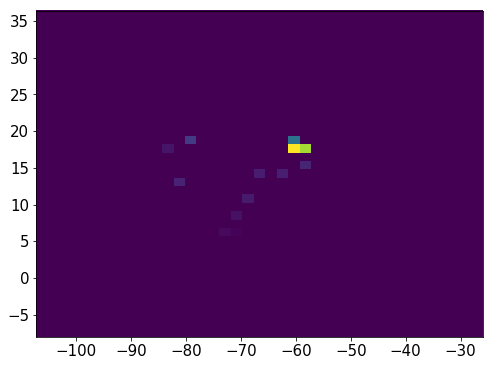

6426    20
6427    20
6428    20
6429    20
6430    20
6431    20
6432    20
6433    20
6434    20
6435    20
6436    20
6437    20
6438    20
6439    20
6440    20
Name: Nsipm, dtype: uint16


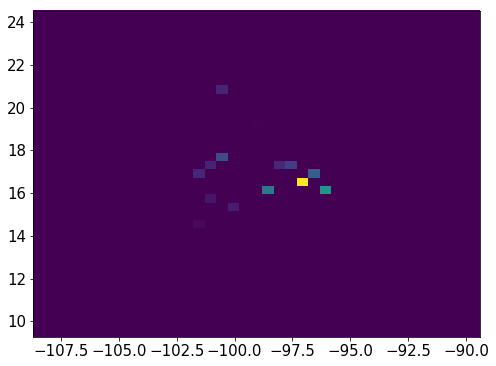

940242    32
940243    32
940244    32
940245    32
940246    32
940247    32
940248    32
940249    32
940250    32
940251    32
940252    32
940253    32
940254    32
940255    32
940256    32
Name: Nsipm, dtype: uint16


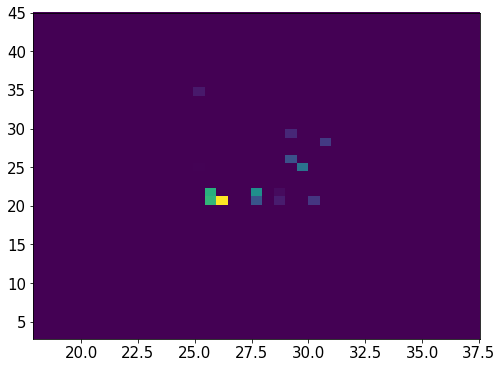

940261    31
940262    31
940263    31
940264    31
940265    31
940266    31
940267    31
940268    31
940269    31
940270    31
Name: Nsipm, dtype: uint16


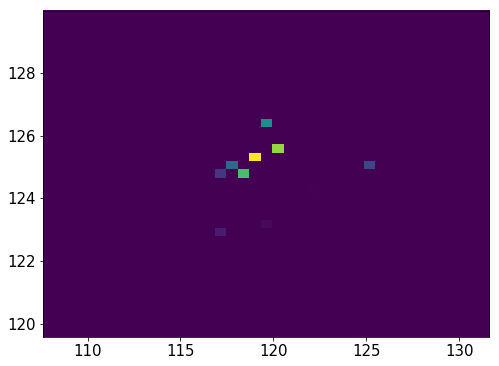

6446    25
6447    25
6448    25
6449    25
6450    25
6451    25
6452    25
6453    25
6454    25
6455    25
6456    25
6457    25
6458    25
6459    25
6460    25
6461    25
6462    25
6465    25
6466    25
6467    25
Name: Nsipm, dtype: uint16


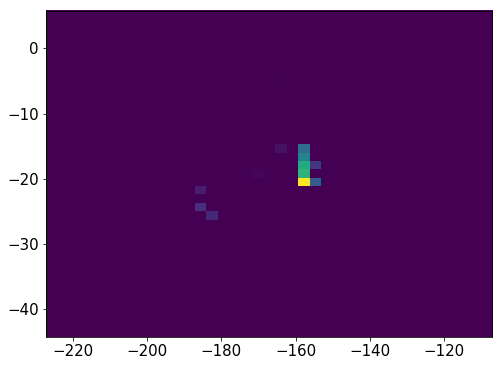

6469    30
6470    30
6471    30
6472    30
6473    30
6474    30
6475    30
6476    30
6477    30
6478    30
6479    30
6480    30
6481    30
6482    30
6487     2
6488     2
6489     2
6490     2
6491     2
Name: Nsipm, dtype: uint16


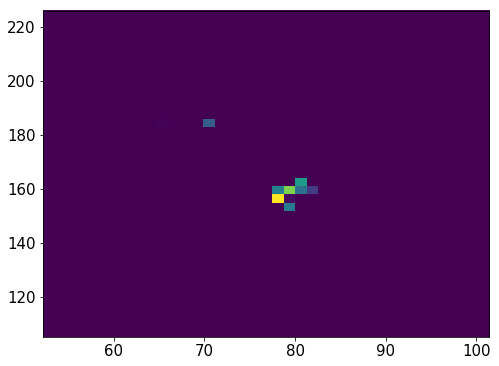

940295    36
940296    36
940297    36
940298    36
940299    36
940300    36
940301    36
940302    36
940303    36
940304    36
940305    36
940306    36
940307    36
940308    36
940312     2
940313     2
940314     2
940315     2
Name: Nsipm, dtype: uint16


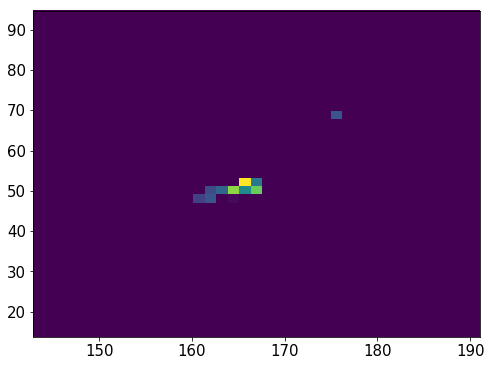

6503    23
6504    23
6505    23
6506    23
6507    23
6508    23
6510    23
6511    23
6512    23
6513    23
6514    23
6515    23
6516    23
6517    23
6518    23
6519    23
6520    23
Name: Nsipm, dtype: uint16


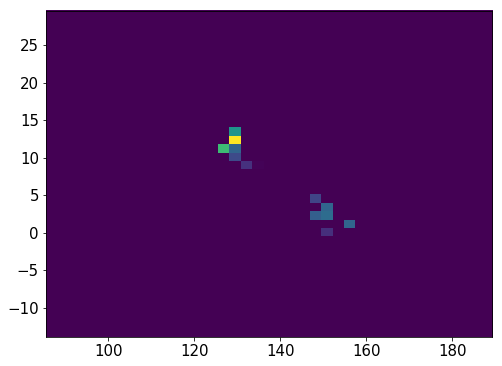

6523    23
6524    23
6525    23
6526    23
6527    23
6528    23
6529    23
6530    23
6531    23
6532    23
6533    23
6534    23
6535    23
6536    23
6537    23
6538    23
6539    23
6540    23
6541    23
Name: Nsipm, dtype: uint16


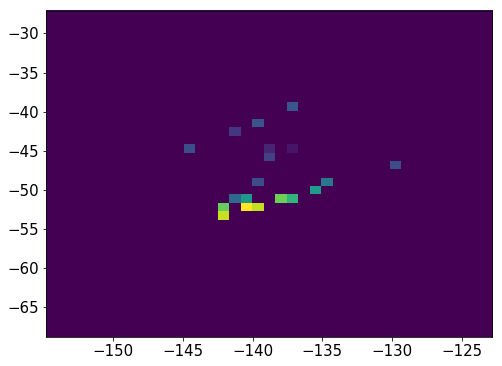

940338    21
940339    21
940340    21
940341    21
940342    21
940343    21
940344    21
940345    21
940346    21
940347    21
940348    21
940349    21
940350    21
940351    21
940352    21
940353    21
940354    21
940355    21
940356    21
940357    21
940358    21
940359    21
Name: Nsipm, dtype: uint16


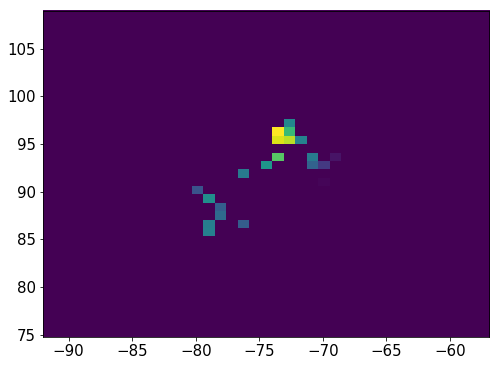

6546    25
6547    25
6548    25
6549    25
6550    25
6551    25
6552    25
6553    25
6554    25
6555    25
6556    25
6557    25
6558    25
6559    25
6560    25
6561    25
6562    25
6563    25
6564    25
6565    25
6566    25
6567    25
6568    25
6569    25
Name: Nsipm, dtype: uint16


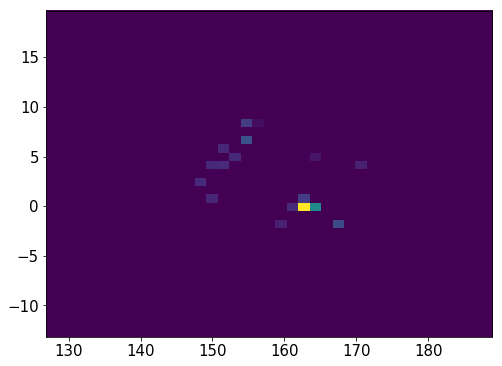

6573    28
6574    28
6575    28
6576    28
6577    28
6578    28
6579    28
6580    28
6581    28
6582    28
6583    28
6584    28
6585    28
6586    28
6587    28
6588    28
6589    28
6590    28
6591    28
6592    28
6593    28
6594    28
6595    28
6596    28
6597    28
6598    28
6599    28
6600    28
6601    28
6602    28
6603    28
6605    28
6607    28
6608    28
Name: Nsipm, dtype: uint16


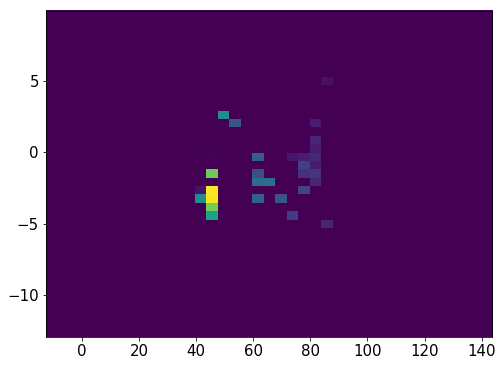

940390    34
940391    34
940392    34
940393    34
940394    34
940395    34
940396    34
940397    34
940398    34
940399    34
940400    34
940401    34
940402    34
940403    34
Name: Nsipm, dtype: uint16


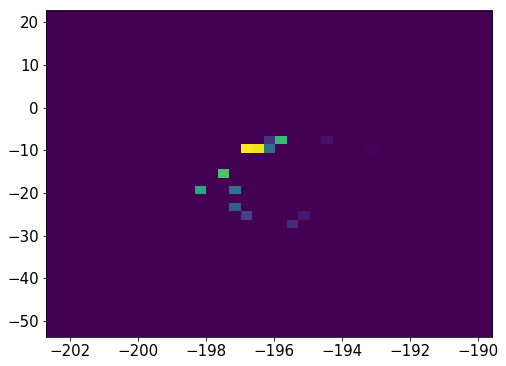

940407    28
940408    28
940409    28
940410    28
940411    28
940412    28
940413    28
940414    28
940415    28
940416    28
940417    28
940418    28
940419    28
940420    28
940421    28
Name: Nsipm, dtype: uint16


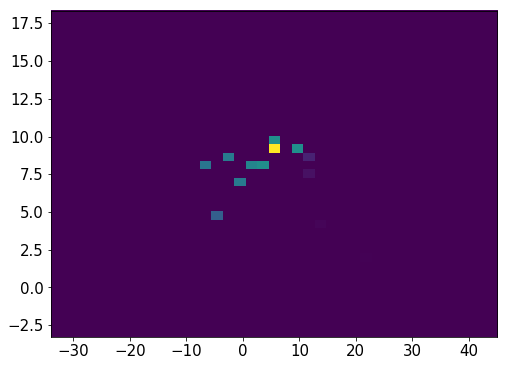

6615    30
6616    30
6617    30
6618    30
6619    30
6620    30
6621    30
6622    30
6623    30
6624    30
6625    30
6626    30
6627    30
Name: Nsipm, dtype: uint16


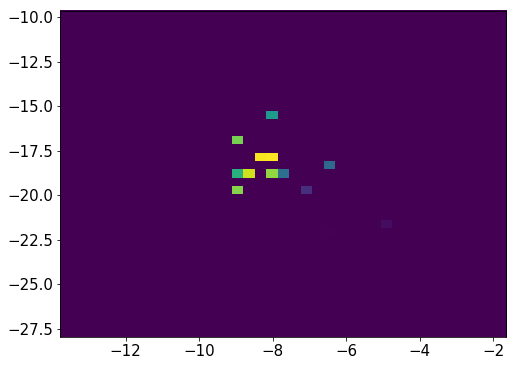

1664293    22
1664294    22
1664295    22
1664296    22
1664297    22
1664298    22
1664299    22
1664300    22
1664301    22
1664302    22
1664303    22
1664304    22
1664305    22
1664306    22
1664307    22
1664308    22
1664309    22
1664310    22
1664311    22
1664312    22
1664313    22
1664314    22
1664315    22
1664316    22
1664317    22
Name: Nsipm, dtype: uint16


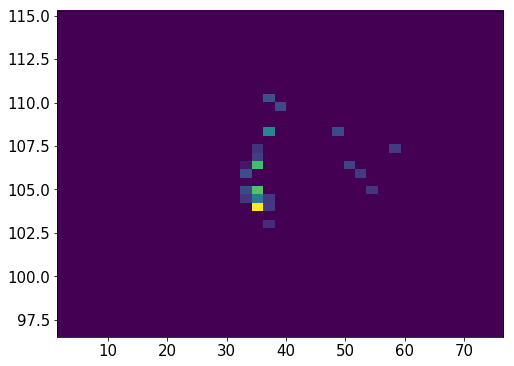

6633    25
6634    25
6635    25
6636    25
6637    25
6638    25
6639    25
6640    25
6641    25
6642    25
6643    25
6644    25
6645    25
6646    25
6647    25
6648    25
6649    25
Name: Nsipm, dtype: uint16


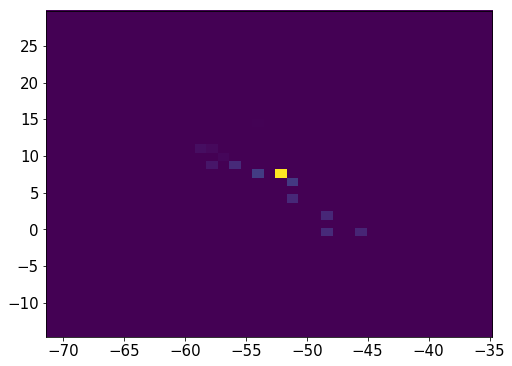

6654    21
6655    21
6656    21
6657    21
6658    21
6659    21
6660    21
6661    21
6662    21
6663    21
6664    21
6665    21
6666    21
6667    21
6668    21
6669    21
6670    21
6671    21
Name: Nsipm, dtype: uint16


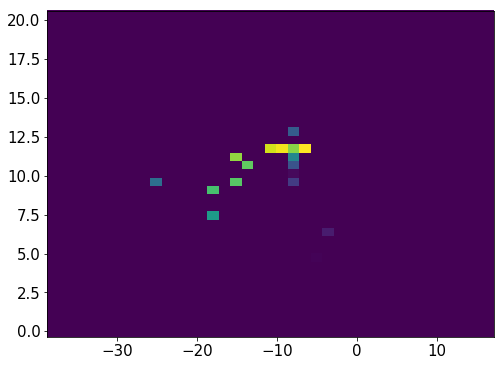

6676    23
6677    23
6678    23
6679    23
6680    23
6681    23
6682    23
6683    23
6684    23
6685    23
6686    23
6687    23
6688    23
6689    23
6690    23
6691    23
6692    23
6693    23
6694    23
Name: Nsipm, dtype: uint16


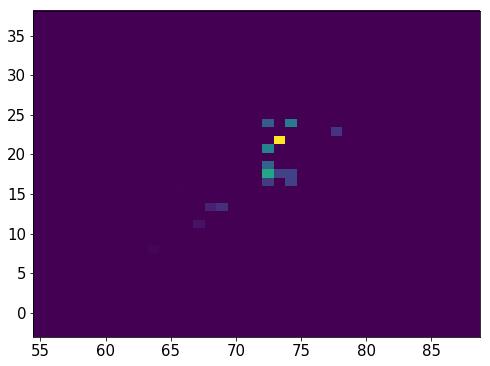

6700    28
6701    28
6702    28
6703    28
6704    28
6705    28
6706    28
6707    28
6708    28
6709    28
6710    28
6711    28
6712    28
6713    28
6714    28
6715    28
6716    28
6722     2
6723     2
6724     2
6725     2
6726     2
Name: Nsipm, dtype: uint16


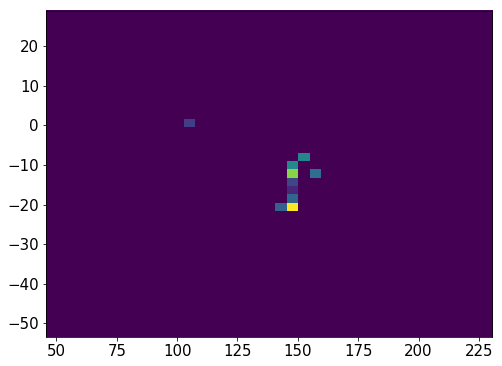

940447    28
940448    28
940449    28
940450    28
940451    28
940452    28
940453    28
940454    28
940455    28
940456    28
940457    28
940458    28
940459    28
940460    28
940461    28
940462    28
940466    28
940468    28
940469    28
940470    28
940471    28
940472    28
Name: Nsipm, dtype: uint16


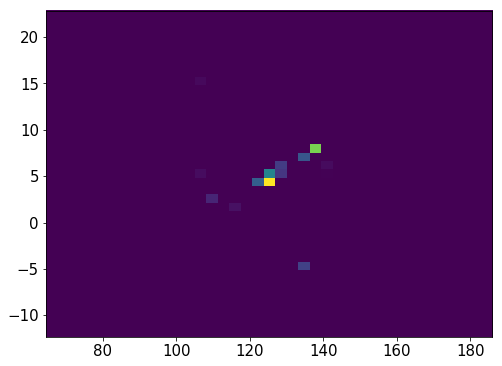

940476    30
940477    30
940478    30
940479    30
940480    30
940481    30
940482    30
940483    30
940484    30
940485    30
940486    30
940487    30
940488    30
940489    30
940490    30
940491    30
940492    30
940493    30
940494    30
940495    30
Name: Nsipm, dtype: uint16


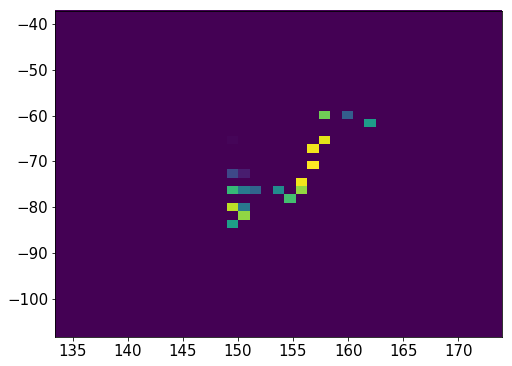

6732    27
6733    27
6734    27
6735    27
6736    27
6737    27
6738    27
6739    27
6740    27
6741    27
6742    27
6743    27
6744    27
6745    27
6746    27
6747    27
6748    27
6749    27
Name: Nsipm, dtype: uint16


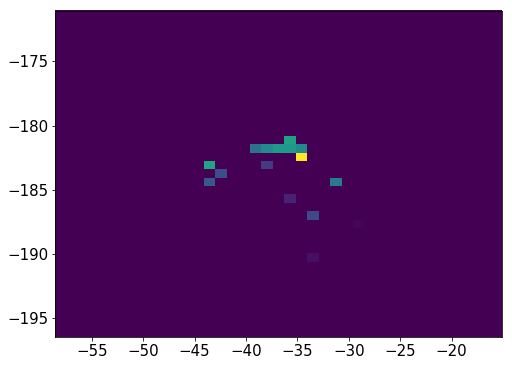

6753    28
6754    28
6755    28
6756    28
6757    28
6758    28
6759    28
6760    28
6761    28
6762    28
6763    28
6764    28
6765    28
6766    28
6767    28
6768    28
Name: Nsipm, dtype: uint16


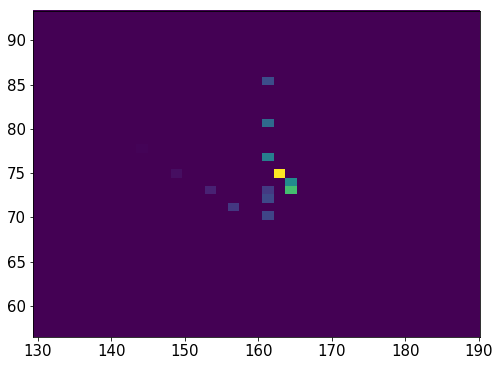

6774    22
6775    22
6776    22
6777    22
6778    22
6779    22
6780    22
6781    22
6782    22
6783    22
6784    22
6785    22
6786    22
6787    22
Name: Nsipm, dtype: uint16


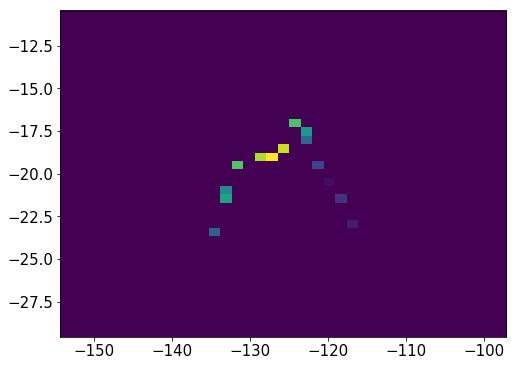

6792    22
6793    22
6794    22
6795    22
6796    22
6797    22
6798    22
6799    22
6800    22
6801    22
6802    22
6803    22
6804    22
6805    22
6806    22
Name: Nsipm, dtype: uint16


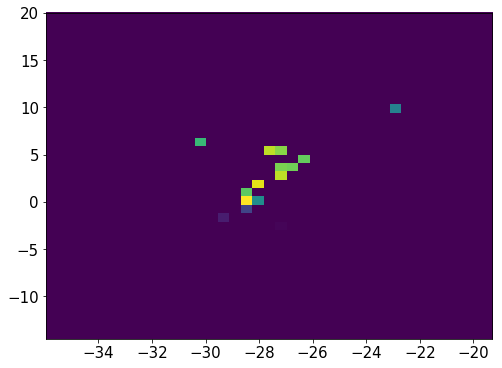

940529    52
940530    52
940531    52
940532    52
940533    52
940534    52
940535    52
940536    52
940537    52
940538    52
940539    52
940540    52
940541    52
940542    52
940543    52
940544    52
940545    52
940546    52
940547    52
940548    52
940549    52
940550    52
940551    52
940552    52
940553    52
940554    52
Name: Nsipm, dtype: uint16


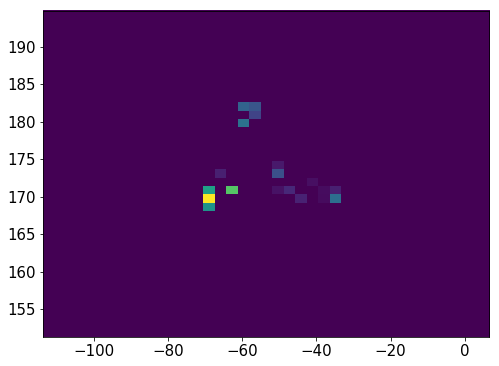

940558    31
940559    31
940560    31
940561    31
940562    31
940563    31
940564    31
940565    31
940566    31
940567    31
940568    31
940569    31
940570    31
940571    31
940572    31
940573    31
940574    31
940575    31
940576    31
940577    31
940578    31
940579    31
Name: Nsipm, dtype: uint16


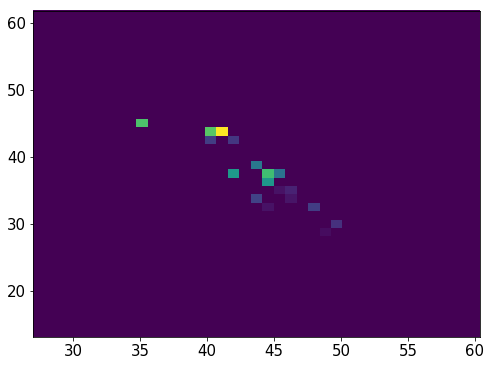

6812    28
6813    28
6814    28
6815    28
6816    28
6817    28
6818    28
6819    28
6820    28
6821    28
6822    28
6823    28
6829     1
6831     1
6832     1
6833     1
6834     1
Name: Nsipm, dtype: uint16


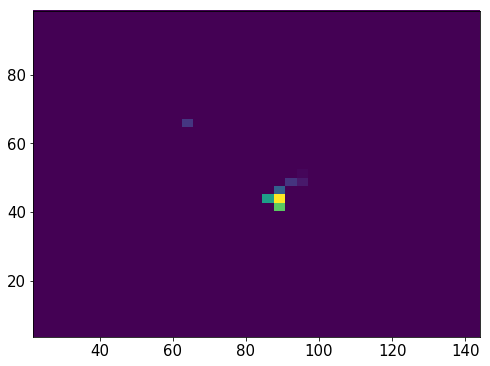

6838    28
6839    28
6840    28
6841    28
6842    28
6843    28
6844    28
6845    28
6846    28
6847    28
6848    28
6849    28
6850    28
6851    28
6852    28
Name: Nsipm, dtype: uint16


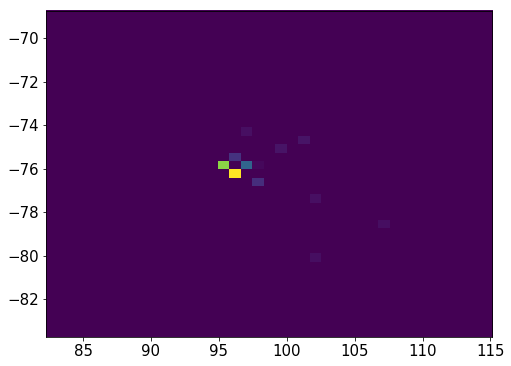

6853    41
6854    41
6855    41
6856    41
6857    41
6858    41
6859    41
6860    41
6861    41
6862    41
6863    41
6864    41
6865    41
6866    41
6867    41
6868    41
6869    41
6870    41
6871    41
Name: Nsipm, dtype: uint16


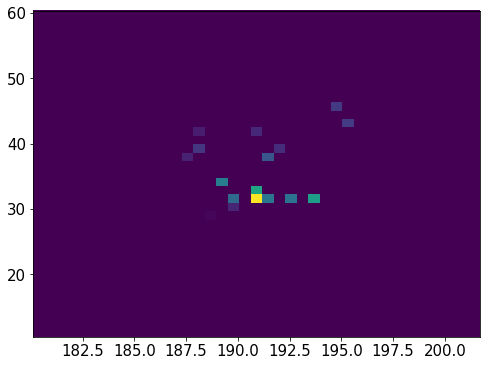

6875    35
6876    35
6877    35
6878    35
6879    35
6880    35
6881    35
6882    35
6883    35
6884    35
6885    35
6886    35
6887    35
6888    35
6889    35
6890    35
6891    35
6892    35
6893    35
6894    35
6895    35
6896    35
Name: Nsipm, dtype: uint16


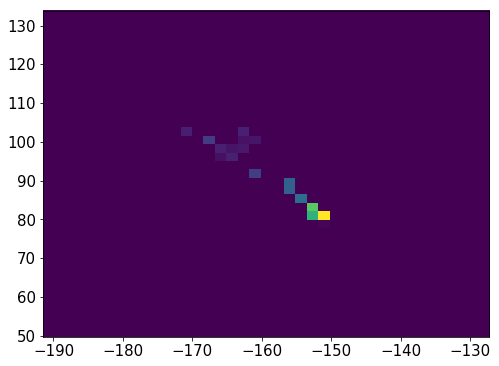

933137    26
933138    26
933139    26
933140    26
933141    26
933142    26
933143    26
933144    26
933145    26
933146    26
933147    26
933148    26
933149    26
933150    26
933151    26
933152    26
933153    26
933154    26
933155    26
933156    26
933157    26
933158    26
933159    26
933160    26
Name: Nsipm, dtype: uint16


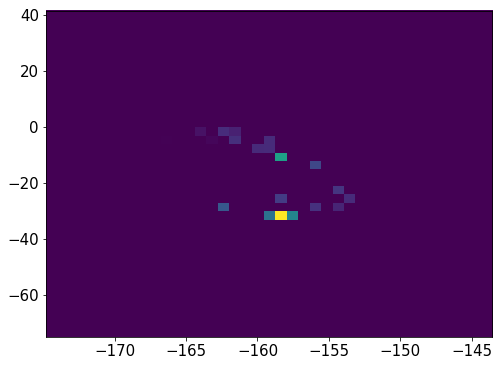

1899699    26
1899700    26
1899701    26
1899702    26
1899703    26
1899704    26
1899705    26
1899706    26
1899707    26
1899708    26
1899709    26
1899710    26
1899711    26
Name: Nsipm, dtype: uint16


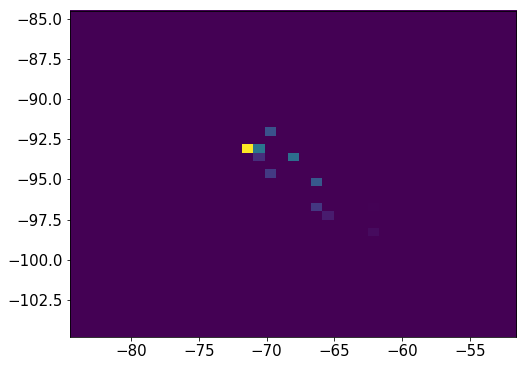

6901    27
6902    27
6903    27
6904    27
6905    27
6906    27
6907    27
6908    27
6909    27
6910    27
6911    27
6912    27
6913    27
6914    27
6915    27
6916    27
6917    27
6918    27
6919    27
Name: Nsipm, dtype: uint16


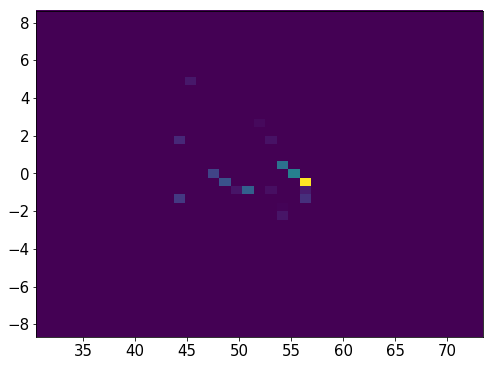

1664381    26
1664382    26
1664383    26
1664384    26
1664385    26
1664386    26
1664387    26
1664388    26
1664389    26
1664390    26
1664391    26
1664392    26
1664393    26
1664394    26
1664395    26
1664396    26
Name: Nsipm, dtype: uint16


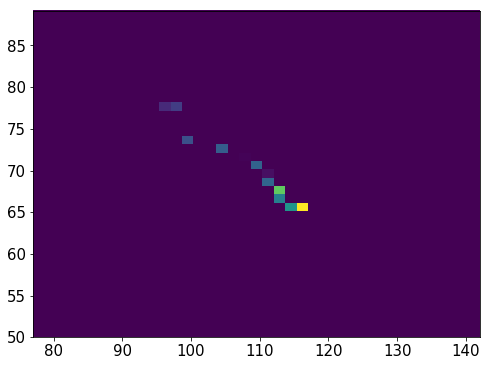

6923    24
6924    24
6925    24
6926    24
6927    24
6928    24
6929    24
6930    24
6931    24
6932    24
6933    24
6934    24
6935    24
6936    24
6937    24
6943     1
6944     1
6945     1
6946     1
Name: Nsipm, dtype: uint16


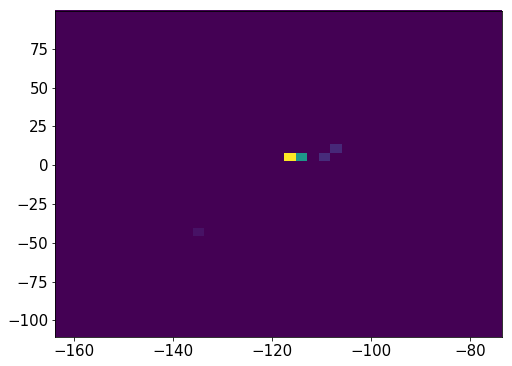

6953    20
6954    20
6955    20
6956    20
6957    20
6958    20
6959    20
6960    20
6961    20
6962    20
6963    20
6964    20
6965    20
Name: Nsipm, dtype: uint16


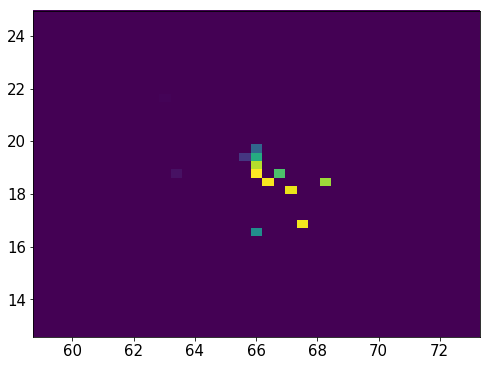

1664401    26
1664402    26
1664403    26
1664404    26
1664405    26
1664406    26
1664407    26
1664408    26
1664409    26
1664410    26
1664411    26
1664412    26
1664413    26
1664414    26
1664415    26
1664416    26
1664417    26
1664418    26
Name: Nsipm, dtype: uint16


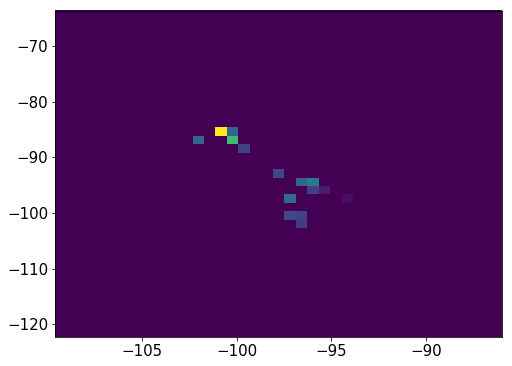

940666    31
940667    31
940668    31
940669    31
940670    31
940671    31
940672    31
940673    31
940674    31
940675    31
940676    31
940677    31
940678    31
940679    31
940681    31
940682    31
940683    31
940684    31
940685    31
940686    31
940687    31
940688    31
940689    31
Name: Nsipm, dtype: uint16


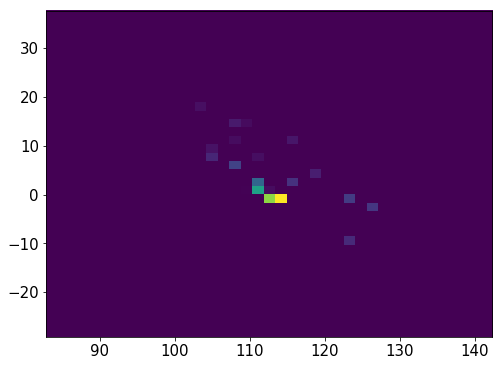

6970    40
6971    40
6972    40
6973    40
6974    40
6975    40
6976    40
6977    40
6978    40
6979    40
6980    40
6981    40
6982    40
6983    40
6984    40
6985    40
6986    40
6987    40
6988    40
6989    40
6990    40
6991    40
6992    40
6993    40
6994    40
6995    40
6996    40
6997    40
6998    40
6999    40
7000    40
7001    40
7002    40
7003    40
7004    40
7005    40
7006    40
Name: Nsipm, dtype: uint16


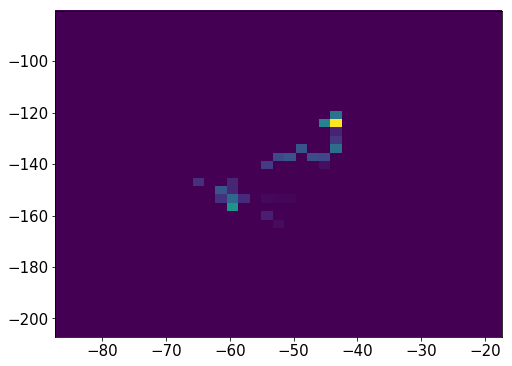

1899740    36
1899741    36
1899742    36
1899743    36
1899744    36
1899745    36
1899746    36
1899747    36
1899748    36
1899749    36
1899750    36
1899751    36
1899752    36
1899753    36
1899754    36
1899755    36
1899756    36
1899761    36
1899764    36
1899765    36
1899766    36
1899767    36
1899768    36
1899776    15
1899777    15
1899778    15
1899779    15
1899780    15
1899781    15
1899782    15
1899783    15
1899784    15
1899785    15
1899786    15
1899787    15
1899788    15
Name: Nsipm, dtype: uint16


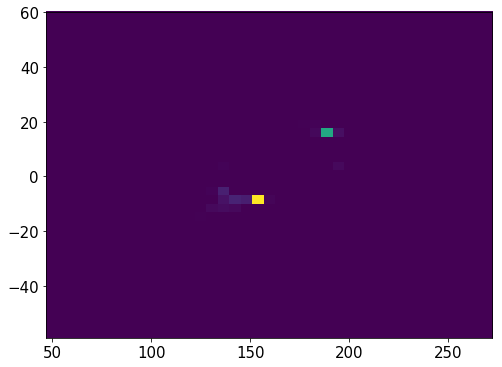

7010    50
7011    50
7012    50
7013    50
7014    50
7015    50
7016    50
7017    50
7018    50
7019    50
7020    50
7021    50
7022    50
7023    50
Name: Nsipm, dtype: uint16


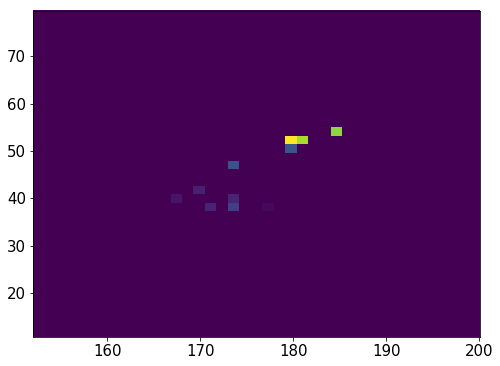

7027    21
7028    21
7029    21
7030    21
7031    21
7032    21
7033    21
7034    21
7035    21
7036    21
7037    21
7038    21
7039    21
7040    21
7041    21
7042    21
7043    21
7044    21
7045    21
7046    21
7047    21
7051    21
7052    21
7053    21
7054    21
7055    21
Name: Nsipm, dtype: uint16


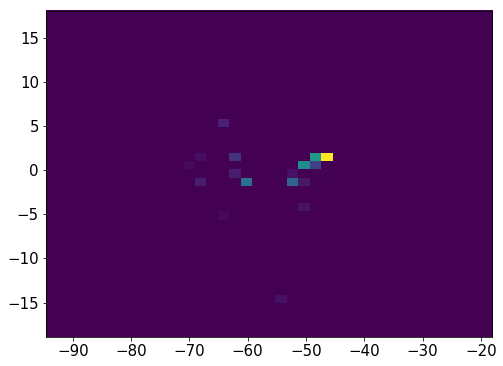

7061    25
7062    25
7063    25
7064    25
7065    25
7066    25
7067    25
7068    25
7069    25
7070    25
7071    25
7072    25
7073    25
7074    25
7075    25
7076    25
7077    25
7078    25
Name: Nsipm, dtype: uint16


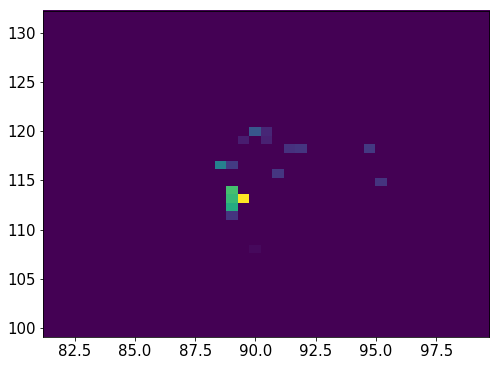

7083    34
7084    34
7085    34
7086    34
7087    34
7088    34
7089    34
7090    34
7091    34
7092    34
7093    34
7094    34
7095    34
7096    34
7097    34
7098    34
7099    34
Name: Nsipm, dtype: uint16


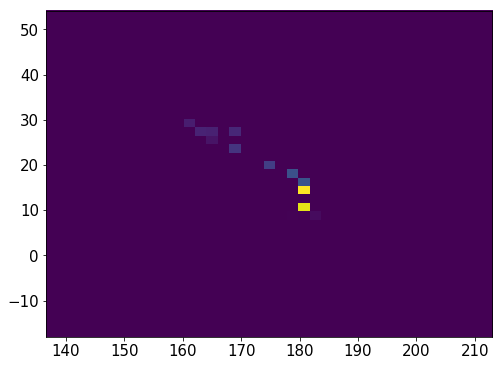

7103    22
7104    22
7105    22
7106    22
7107    22
7108    22
7109    22
7110    22
7111    22
7112    22
7113    22
7114    22
7115    22
7116    22
7117    22
7118    22
7122    22
7125    22
7130    22
7131    22
7133    22
7134    22
7135    22
7136    22
7142    22
7143    22
7144    22
7145    22
7146    22
7153     3
7154     3
7155     3
7156     3
7157     3
7161     6
7162     6
7163     6
7164     6
7165     6
7166     6
7171     1
7172     1
7173     1
7174     1
7175     1
Name: Nsipm, dtype: uint16


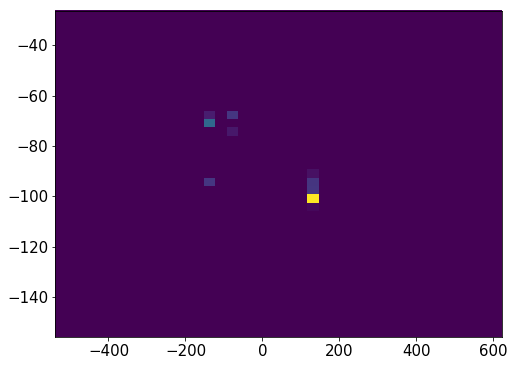

940741    27
940742    27
940743    27
940744    27
940745    27
940746    27
940747    27
940748    27
940749    27
940750    27
940751    27
940752    27
940753    27
940754    27
940755    27
940756    27
940757    27
940758    27
940767    27
940768    27
940769    27
940770    27
940771    27
Name: Nsipm, dtype: uint16


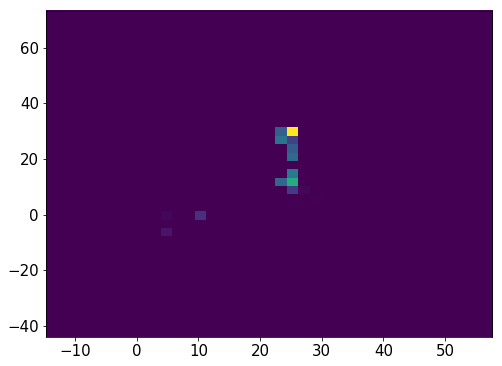

7180    21
7181    21
7182    21
7183    21
7184    21
7185    21
7186    21
7187    21
7188    21
7189    21
7190    21
7191    21
7192    21
7193    21
7194    21
7195    21
7196    21
7197    21
7198    21
7199    21
Name: Nsipm, dtype: uint16


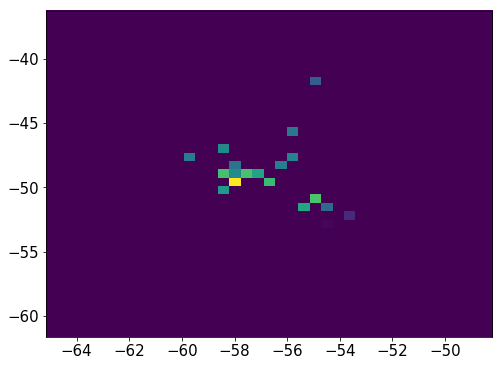

7204    27
7205    27
7206    27
7207    27
7208    27
7209    27
7210    27
7211    27
7212    27
7213    27
7214    27
Name: Nsipm, dtype: uint16


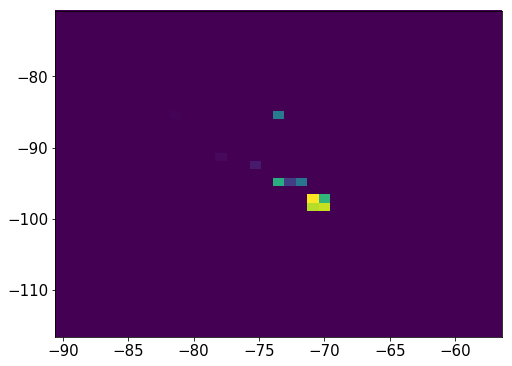

940797    24
940798    24
940799    24
940800    24
940801    24
940802    24
940803    24
940804    24
940805    24
940806    24
940807    24
940808    24
940809    24
940810    24
Name: Nsipm, dtype: uint16


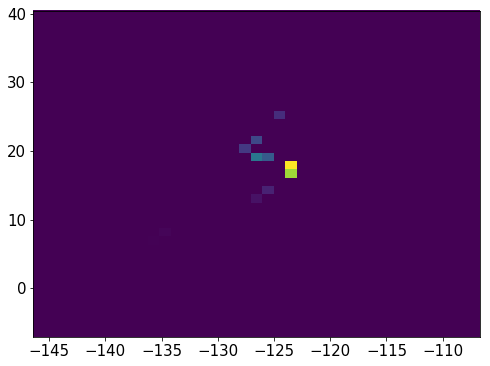

7221    20
7222    20
7223    20
7224    20
7225    20
7226    20
7227    20
7228    20
7229    20
7230    20
7231    20
7232    20
7233    20
7234    20
7235    20
7236    20
Name: Nsipm, dtype: uint16


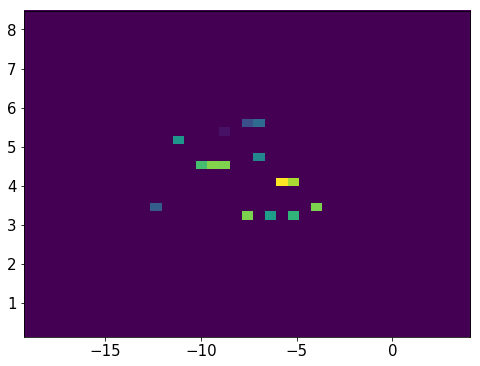

7240    20
7241    20
7242    20
7243    20
7244    20
7245    20
7246    20
7247    20
7248    20
7249    20
7250    20
7251    20
7252    20
Name: Nsipm, dtype: uint16


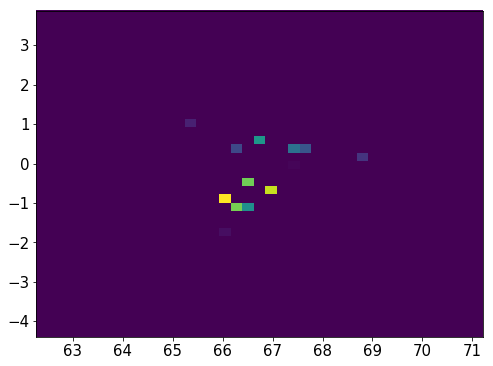

7257    26
7258    26
7259    26
7260    26
7261    26
7262    26
7263    26
7264    26
7265    26
7270     5
7271     5
7272     5
7273     5
7274     5
7275     5
7276     5
7277     5
7278     5
7279     5
7280     5
7281     5
Name: Nsipm, dtype: uint16


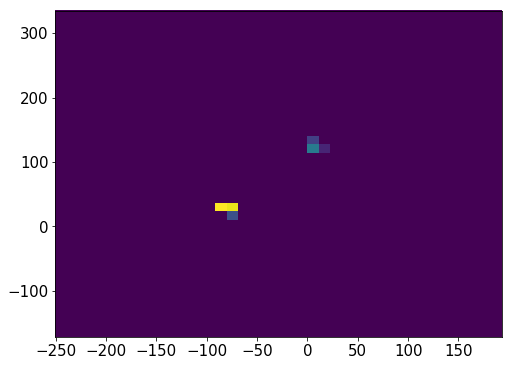

7287    26
7288    26
7289    26
7290    26
7291    26
7292    26
7293    26
7294    26
7295    26
7296    26
7297    26
7298    26
7299    26
7300    26
7301    26
7302    26
7303    26
7304    26
Name: Nsipm, dtype: uint16


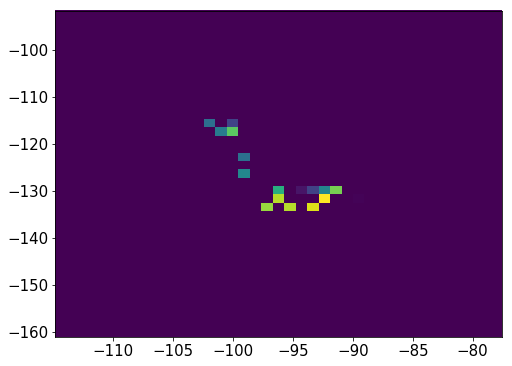

940839    28
940840    28
940841    28
940842    28
940843    28
940844    28
940845    28
940846    28
940847    28
940848    28
940849    28
940850    28
940851    28
940852    28
940853    28
940854    28
940855    28
940856    28
940857    28
940858    28
940859    28
Name: Nsipm, dtype: uint16


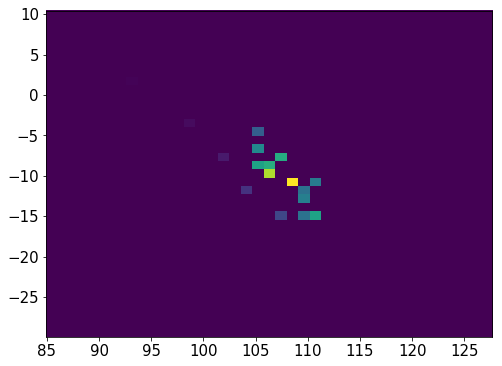

7308    34
7309    34
7310    34
7311    34
7312    34
7313    34
7314    34
7315    34
7316    34
7317    34
7318    34
7319    34
7320    34
7321    34
7322    34
7323    34
7324    34
7325    34
7326    34
7327    34
Name: Nsipm, dtype: uint16


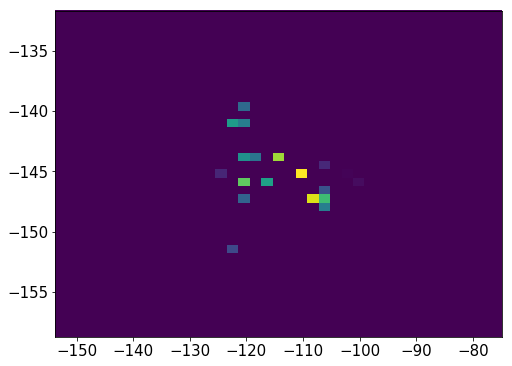

7331    25
7332    25
7333    25
7334    25
7335    25
7336    25
7337    25
7338    25
7339    25
7340    25
7341    25
7342    25
7343    25
7344    25
7345    25
Name: Nsipm, dtype: uint16


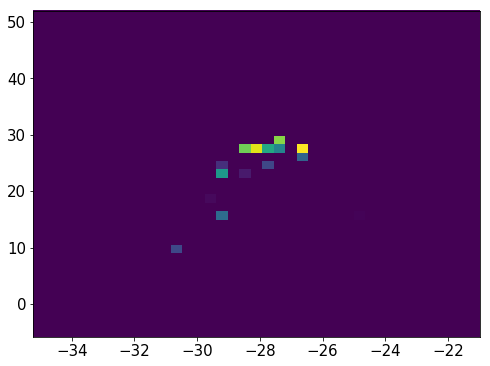

940864    43
940865    43
940866    43
940867    43
940868    43
940869    43
940870    43
940871    43
940872    43
940873    43
940874    43
940875    43
940876    43
940877    43
940878    43
940879    43
940880    43
940881    43
940882    43
940883    43
940884    43
940885    43
940886    43
940891     8
940892     8
940893     8
940894     8
940895     8
940896     8
940897     8
940898     8
940899     8
940900     8
Name: Nsipm, dtype: uint16


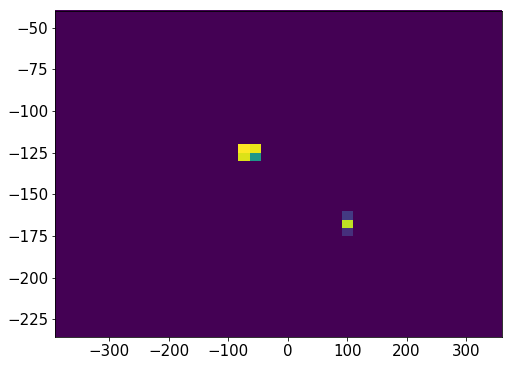

7350    27
7351    27
7352    27
7353    27
7354    27
7355    27
7356    27
7357    27
7358    27
7359    27
7360    27
7361    27
7362    27
7363    27
7364    27
7365    27
7366    27
7367    27
7368    27
7369    27
7370    27
7371    27
Name: Nsipm, dtype: uint16


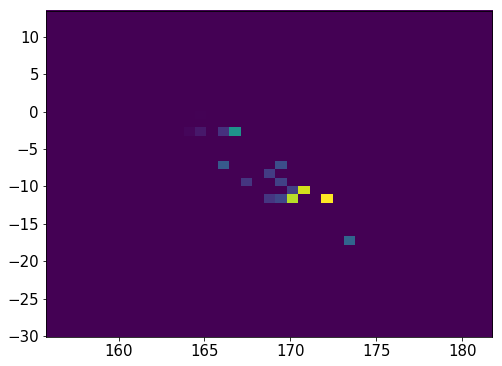

940903    37
940904    37
940905    37
940906    37
940907    37
940908    37
940909    37
940910    37
940911    37
940912    37
940913    37
940914    37
Name: Nsipm, dtype: uint16


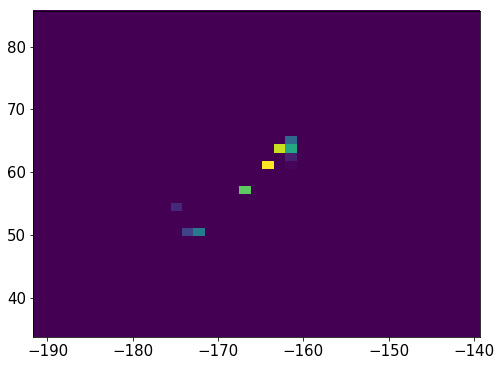

940918    23
940919    23
940920    23
940921    23
940922    23
940923    23
940924    23
940925    23
940926    23
940927    23
940928    23
940929    23
940930    23
940931    23
940933    23
940934    23
940935    23
940936    23
940937    23
940938    23
940939    23
940940    23
940941    23
940942    23
940944    23
940945    23
940946    23
940948    23
940949    23
940950    23
940951    23
940952    23
940953    23
Name: Nsipm, dtype: uint16


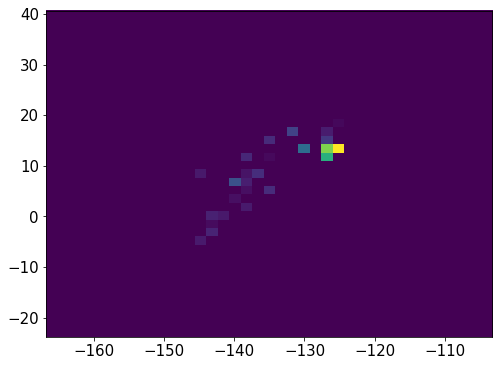

7377    32
7378    32
7379    32
7380    32
7384    32
7385    32
7386    32
7387    32
7388    32
7389    32
7390    32
7391    32
7392    32
7393    32
7394    32
7395    32
7396    32
7397    32
7398    32
7399    32
7400    32
Name: Nsipm, dtype: uint16


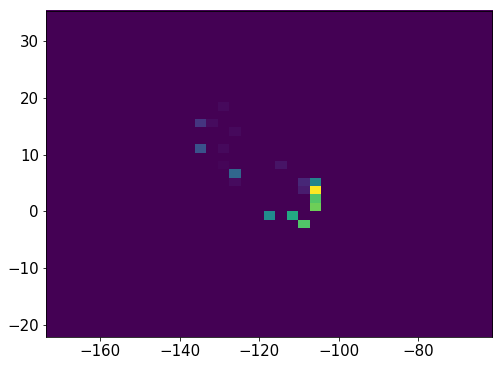

940959    27
940960    27
940961    27
940962    27
940963    27
940964    27
940965    27
940966    27
940967    27
940968    27
940969    27
940970    27
940971    27
940972    27
940973    27
940974    27
940975    27
Name: Nsipm, dtype: uint16


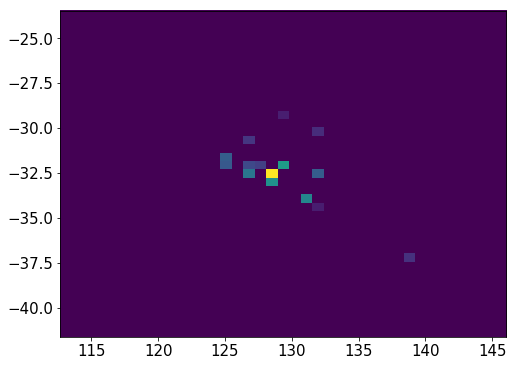

7402    23
7403    23
7404    23
7405    23
7406    23
7407    23
7408    23
7409    23
7410    23
7411    23
7412    23
7413    23
7414    23
7415    23
7416    23
7417    23
7418    23
7419    23
7420    23
7421    23
7422    23
7423    23
7424    23
7425    23
Name: Nsipm, dtype: uint16


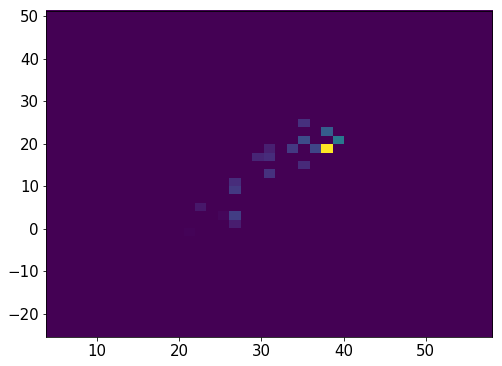

7431    27
7432    27
7433    27
7434    27
7435    27
7436    27
7437    27
7438    27
7439    27
7440    27
7441    27
Name: Nsipm, dtype: uint16


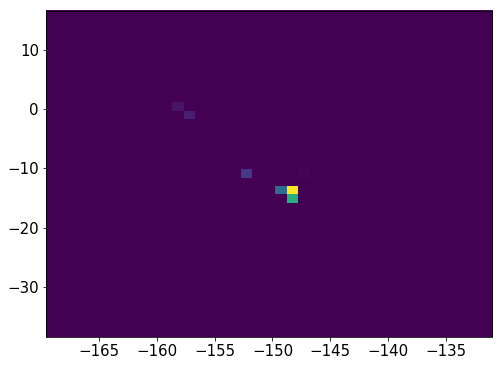

7447    23
7448    23
7449    23
7450    23
7451    23
7452    23
7453    23
7454    23
7455    23
7456    23
7457    23
7458    23
7459    23
7460    23
7461    23
7462    23
7463    23
7464    23
7465    23
7466    23
7467    23
7468    23
7469    23
Name: Nsipm, dtype: uint16


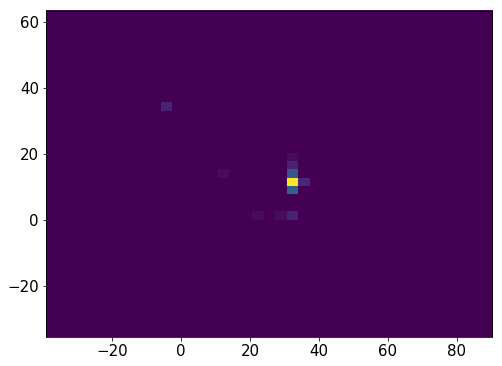

940980    24
940981    24
940982    24
940983    24
940984    24
940985    24
940986    24
940987    24
940988    24
940989    24
940990    24
940991    24
940992    24
940993    24
940994    24
940995    24
940996    24
Name: Nsipm, dtype: uint16


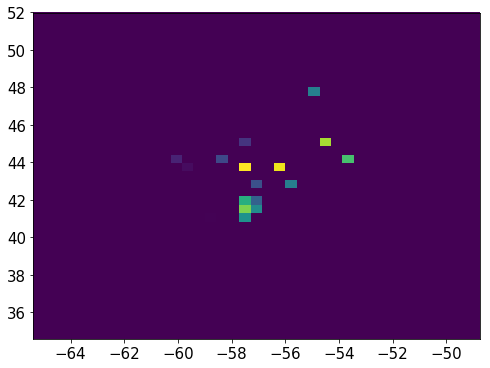

941000    27
941001    27
941002    27
941003    27
941004    27
941005    27
941006    27
941007    27
941008    27
941009    27
941010    27
941011    27
941012    27
941013    27
941014    27
941015    27
941016    27
941017    27
941018    27
941019    27
941020    27
941021    27
941022    27
941023    27
941028     2
941029     2
941030     2
941031     2
941032     2
941033     2
941034     2
Name: Nsipm, dtype: uint16


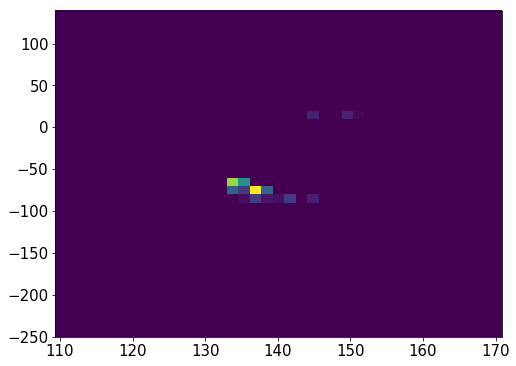

7474    21
7475    21
7476    21
7477    21
7478    21
7479    21
7480    21
7481    21
7482    21
7483    21
7484    21
7485    21
7486    21
7487    21
7488    21
7489    21
7490    21
7491    21
Name: Nsipm, dtype: uint16


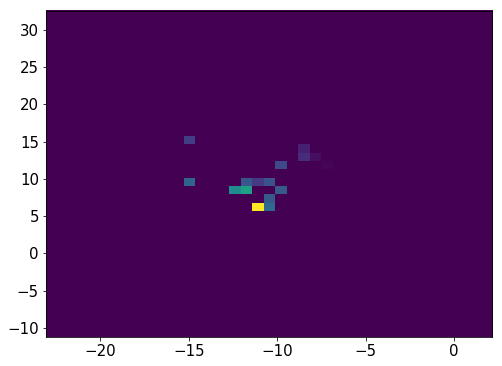

7496    24
7497    24
7498    24
7499    24
7500    24
7501    24
7502    24
7503    24
7504    24
7505    24
7506    24
7507    24
7508    24
7509    24
7510    24
7511    24
7512    24
7513    24
7514    24
7515    24
7516    24
Name: Nsipm, dtype: uint16


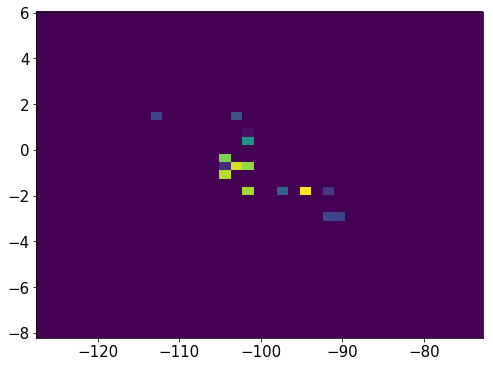

941069    22
941070    22
941071    22
941072    22
941073    22
941074    22
941075    22
941076    22
941077    22
941078    22
941079    22
941080    22
941081    22
941082    22
Name: Nsipm, dtype: uint16


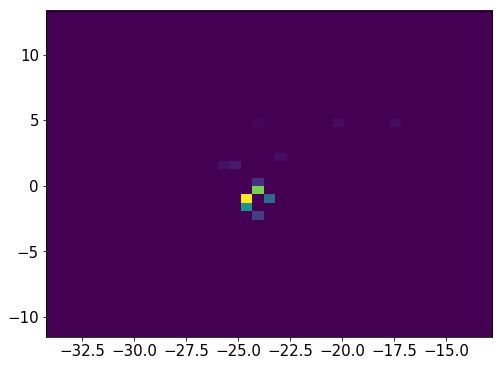

7522    30
7523    30
7524    30
7525    30
7526    30
7527    30
7528    30
7529    30
7530    30
7531    30
7532    30
7533    30
7534    30
7535    30
7536    30
7537    30
7538    30
7539    30
7540    30
7541    30
7542    30
7543    30
7544    30
Name: Nsipm, dtype: uint16


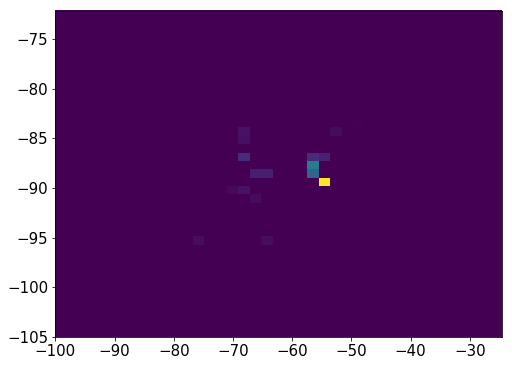

7551    35
7552    35
7553    35
7554    35
7555    35
7556    35
7557    35
7558    35
7559    35
7560    35
7561    35
7562    35
7563    35
7565    35
7566    35
7567    35
7568    35
7569    35
7570    35
7571    35
7572    35
Name: Nsipm, dtype: uint16


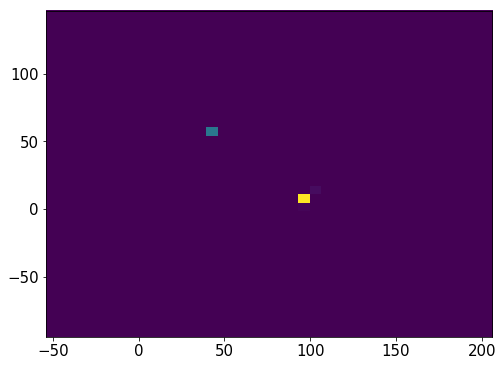

7582    26
7583    26
7584    26
7585    26
7586    26
7587    26
7588    26
7589    26
7590    26
7591    26
7592    26
7593    26
7594    26
7595    26
7596    26
7597    26
Name: Nsipm, dtype: uint16


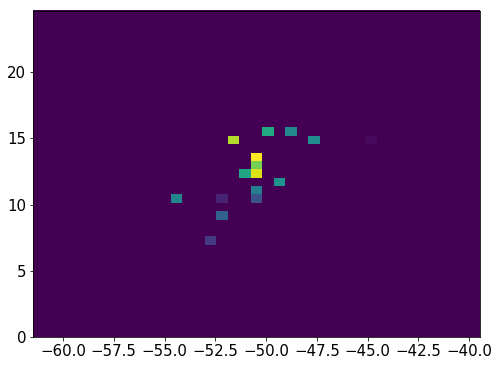

7600    26
7601    26
7602    26
7603    26
7604    26
7605    26
7606    26
7607    26
7608    26
7609    26
7610    26
7611    26
7612    26
7613    26
Name: Nsipm, dtype: uint16


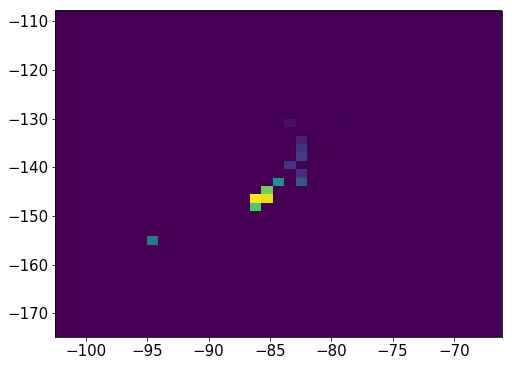

7617    48
7618    48
7619    48
7620    48
7621    48
7622    48
7623    48
7624    48
7625    48
7626    48
7627    48
7628    48
7629    48
7630    48
7631    48
7632    48
7633    48
7634    48
7635    48
7636    48
7637    48
7638    48
7639    48
7640    48
7641    48
7642    48
7643    48
7644    48
7645    48
7646    48
7647    48
7648    48
7649    48
7650    48
7651    48
7652    48
Name: Nsipm, dtype: uint16


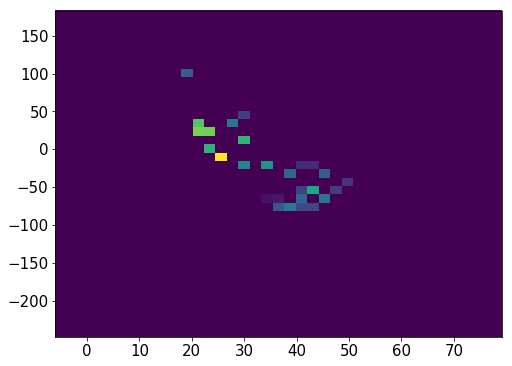

941140    20
941141    20
941142    20
941143    20
941144    20
941145    20
941146    20
941147    20
941148    20
941149    20
941150    20
941151    20
941152    20
941153    20
941154    20
941155    20
941156    20
941157    20
941158    20
941159    20
941160    20
941161    20
941162    20
941163    20
941164    20
941165    20
941166    20
941167    20
941168    20
Name: Nsipm, dtype: uint16


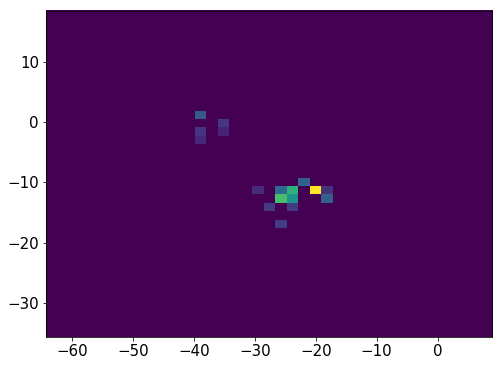

941173    23
941174    23
941175    23
941176    23
941177    23
941178    23
941179    23
941180    23
941181    23
941182    23
941183    23
941184    23
941188     4
941189     4
941190     4
941191     4
941194     2
941195     2
941196     2
941197     2
941198     2
941202     3
941203     3
941204     3
941205     3
941206     3
941207     3
Name: Nsipm, dtype: uint16


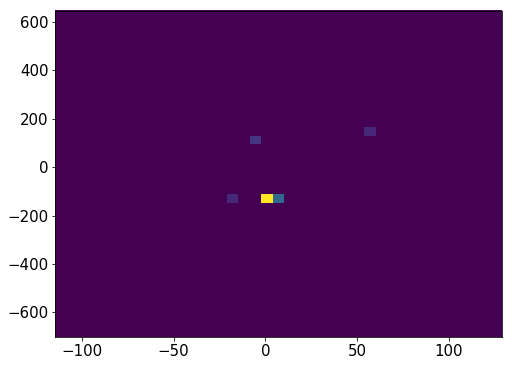

941212    23
941213    23
941214    23
941215    23
941216    23
941217    23
941218    23
941219    23
941220    23
941221    23
941222    23
941223    23
941224    23
941225    23
941226    23
941227    23
941228    23
941232     4
941233     4
941234     4
941235     4
941236     4
941237     4
941238     4
941239     4
Name: Nsipm, dtype: uint16


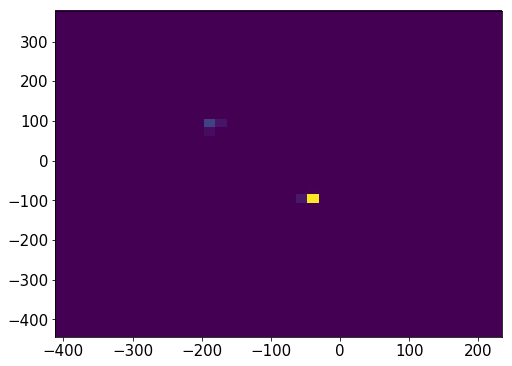

7657    21
7658    21
7659    21
7660    21
7663    21
7664    21
7665    21
7666    21
7667    21
7668    21
7669    21
7670    21
7671    21
7672    21
7673    21
7674    21
7675    21
7676    21
7677    21
Name: Nsipm, dtype: uint16


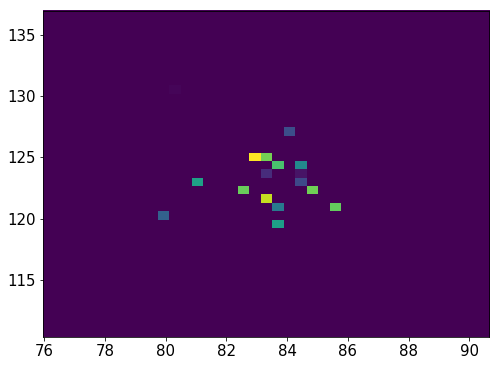

7679    27
7680    27
7681    27
7682    27
7683    27
7684    27
7685    27
7686    27
7687    27
7688    27
7689    27
7690    27
7691    27
7692    27
7693    27
7694    27
7695    27
7696    27
7697    27
7698    27
Name: Nsipm, dtype: uint16


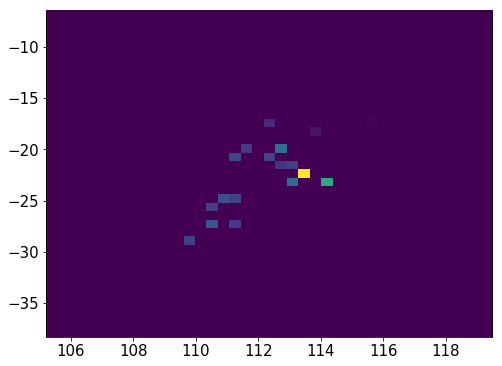

7702    27
7703    27
7704    27
7705    27
7706    27
7707    27
7708    27
7709    27
7710    27
7711    27
7712    27
7713    27
7714    27
7715    27
Name: Nsipm, dtype: uint16


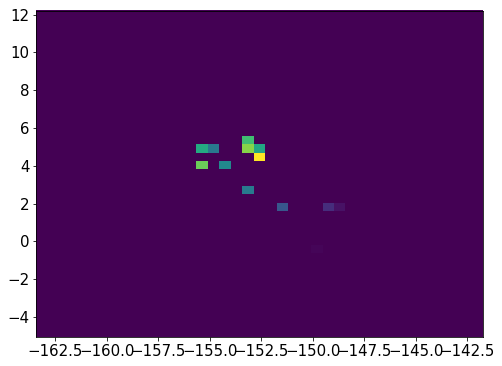

941260    32
941261    32
941262    32
941263    32
941264    32
941265    32
941266    32
941267    32
941268    32
941269    32
941270    32
941271    32
941272    32
941273    32
941274    32
941275    32
941276    32
941277    32
941278    32
Name: Nsipm, dtype: uint16


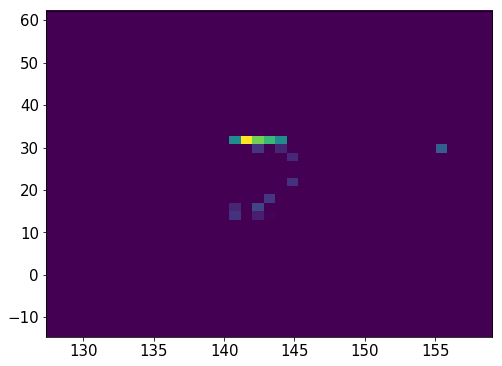

941283    25
941284    25
941285    25
941286    25
941287    25
941288    25
941289    25
941290    25
941291    25
941292    25
941293    25
941294    25
941295    25
941296    25
941297    25
941298    25
941299    25
941300    25
941301    25
941302    25
941303    25
Name: Nsipm, dtype: uint16


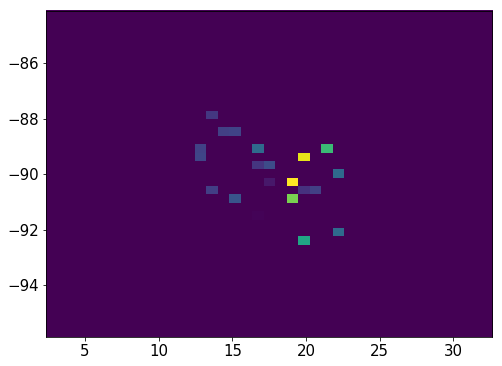

7721    30
7722    30
7723    30
7724    30
7725    30
7726    30
7727    30
7728    30
7729    30
7730    30
7731    30
7732    30
7733    30
7734    30
7735    30
7736    30
Name: Nsipm, dtype: uint16


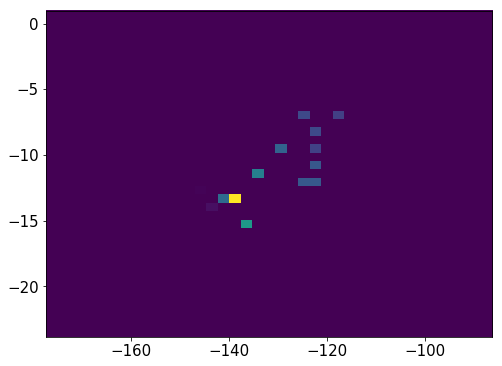

941307    27
941308    27
941309    27
941310    27
941311    27
941312    27
941313    27
941314    27
941315    27
941316    27
941317    27
941318    27
941319    27
941320    27
941321    27
941322    27
941327     4
941328     4
941329     4
941330     4
941331     4
941332     4
Name: Nsipm, dtype: uint16


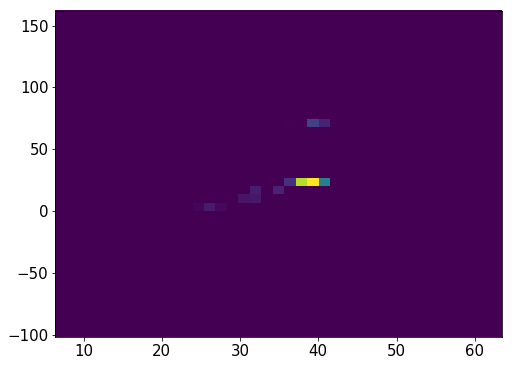

941339    25
941340    25
941341    25
941342    25
941343    25
941344    25
941345    25
941346    25
941347    25
941348    25
941349    25
941350    25
941351    25
941352    25
941353    25
Name: Nsipm, dtype: uint16


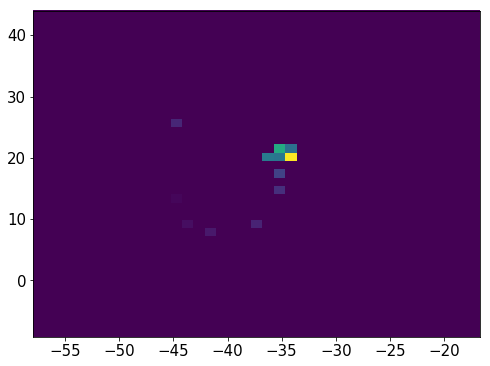

941357    27
941358    27
941359    27
941360    27
941361    27
941362    27
941363    27
941364    27
941365    27
941366    27
941367    27
941368    27
941369    27
941370    27
941371    27
941373    27
941374    27
941375    27
941376    27
941377    27
941378    27
941379    27
941380    27
941381    27
941382    27
941383    27
941384    27
941385    27
941386    27
941387    27
941388    27
941389    27
Name: Nsipm, dtype: uint16


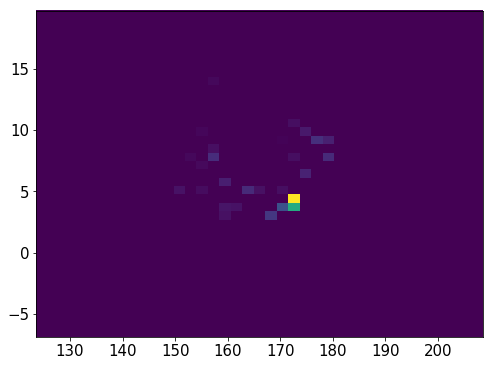

7741    19
7742    19
7743    19
7744    19
7745    19
7746    19
7747    19
7748    19
7749    19
7750    19
7751    19
7752    19
7753    19
7754    19
7755    19
7756    19
7757    19
7758    19
7759    19
7760    19
7761    19
7762    19
7763    19
Name: Nsipm, dtype: uint16


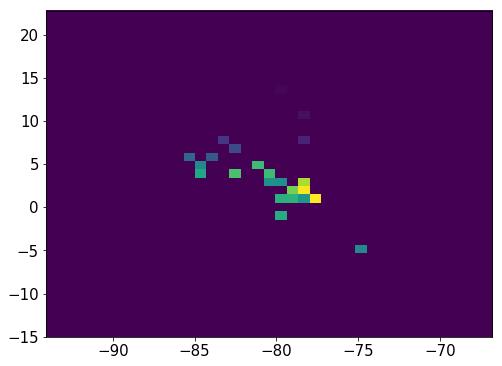

941394    17
941395    17
941396    17
941397    17
941398    17
941399    17
941400    17
941401    17
941402    17
941403    17
941404    17
941405    17
941406    17
941407    17
Name: Nsipm, dtype: uint16


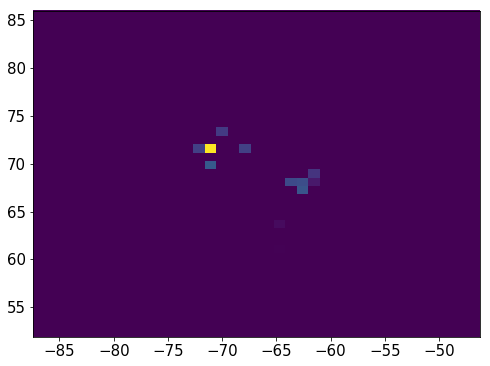

941412    20
941413    20
941414    20
941415    20
941416    20
941417    20
941418    20
941419    20
941420    20
941421    20
941422    20
941423    20
941424    20
941434    20
941435    20
941436    20
941437    20
941438    20
Name: Nsipm, dtype: uint16


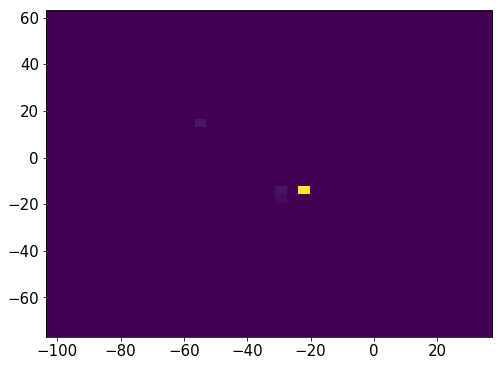

7768    27
7769    27
7770    27
7771    27
7772    27
7773    27
7774    27
7775    27
7776    27
7777    27
7778    27
7779    27
7780    27
7781    27
7782    27
7783    27
7784    27
7785    27
Name: Nsipm, dtype: uint16


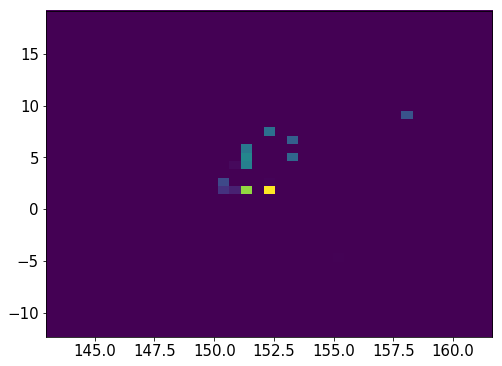

7791    27
7792    27
7793    27
7794    27
7795    27
7796    27
7797    27
7798    27
7799    27
7800    27
7801    27
7802    27
7803    27
7804    27
7805    27
7806    27
7807    27
Name: Nsipm, dtype: uint16


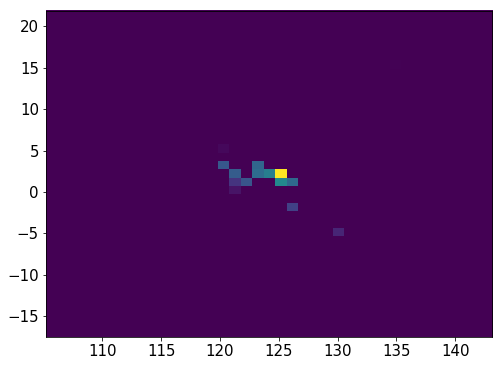

7811    28
7812    28
7813    28
7814    28
7815    28
7816    28
7817    28
7818    28
7819    28
7820    28
7821    28
7822    28
7823    28
7824    28
Name: Nsipm, dtype: uint16


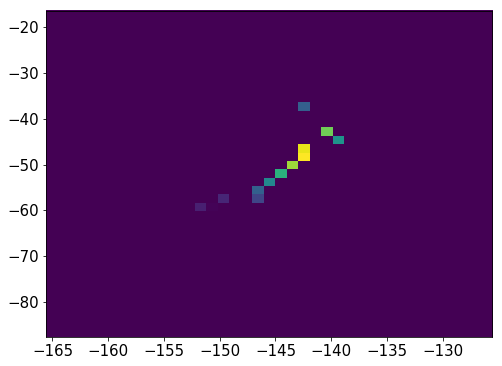

7829    26
7830    26
7831    26
7832    26
7833    26
7834    26
7835    26
7836    26
7837    26
7838    26
7839    26
7840    26
7841    26
7842    26
Name: Nsipm, dtype: uint16


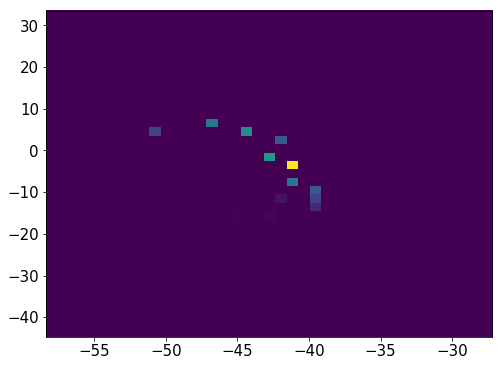

941495    41
941496    41
941497    41
941498    41
941499    41
941500    41
941501    41
941502    41
941503    41
941504    41
941505    41
941506    41
941507    41
941508    41
941509    41
941510    41
941511    41
941512    41
941513    41
941514    41
941515    41
941516    41
941517    41
941518    41
941519    41
941520    41
941521    41
Name: Nsipm, dtype: uint16


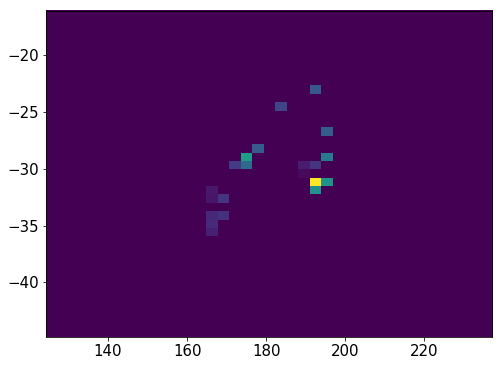

7848    23
7849    23
7850    23
7851    23
7852    23
7854    23
7856    23
7857    23
7858    23
7859    23
7860    23
7861    23
7862    23
7863    23
7864    23
7865    23
7866    23
7867    23
7868    23
7869    23
7870    23
7871    23
7872    23
7873    23
7874    23
7875    23
7876    23
Name: Nsipm, dtype: uint16


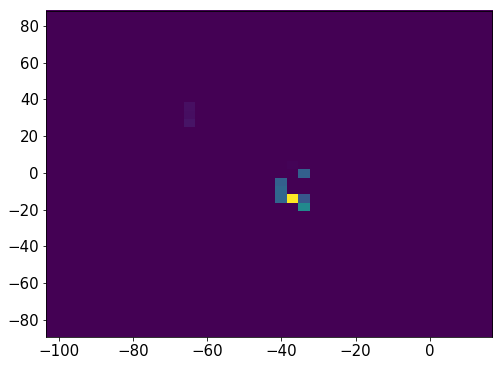

941525    26
941526    26
941527    26
941528    26
941529    26
941530    26
941531    26
941532    26
941533    26
941534    26
941535    26
941536    26
941537    26
941538    26
941539    26
941540    26
Name: Nsipm, dtype: uint16


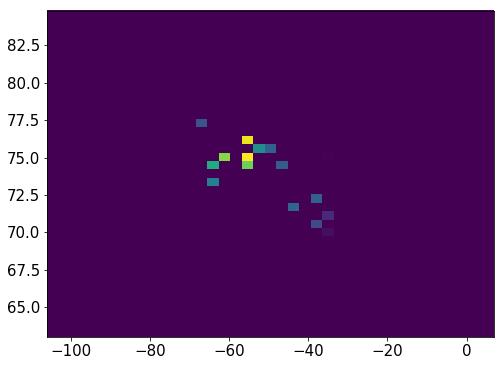

7877    15
7878    15
7879    15
7880    15
7881    15
7882    15
7883    15
7884    15
7885    15
7886    15
7887    15
7888    15
7889    15
7890    15
7891    15
7892    15
7893    15
7902     1
7903     1
7904     1
Name: Nsipm, dtype: uint16


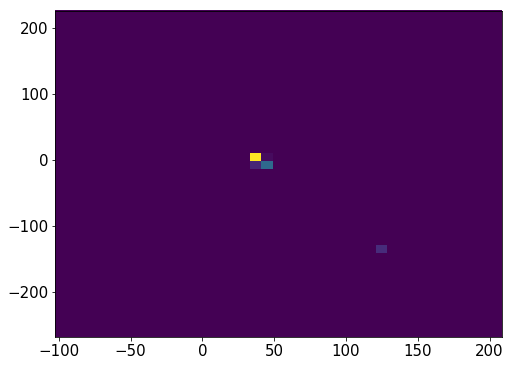

7914    27
7915    27
7916    27
7917    27
7918    27
7919    27
7920    27
7921    27
7922    27
7923    27
7924    27
7925    27
7926    27
7927    27
7928    27
7929    27
7930    27
7931    27
7932    27
7933    27
Name: Nsipm, dtype: uint16


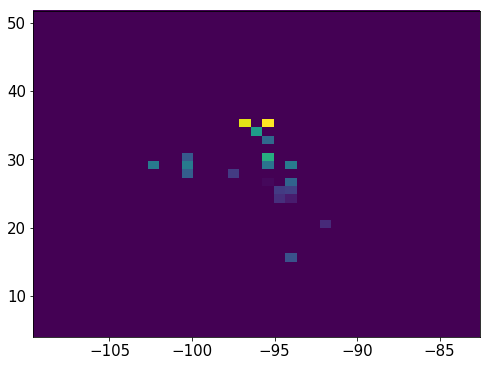

7937    25
7938    25
7939    25
7940    25
7941    25
7942    25
7943    25
7944    25
7945    25
7946    25
7947    25
7948    25
7949    25
7950    25
7951    25
7952    25
7953    25
7954    25
7955    25
7956    25
7957    25
7958    25
7959    25
7960    25
Name: Nsipm, dtype: uint16


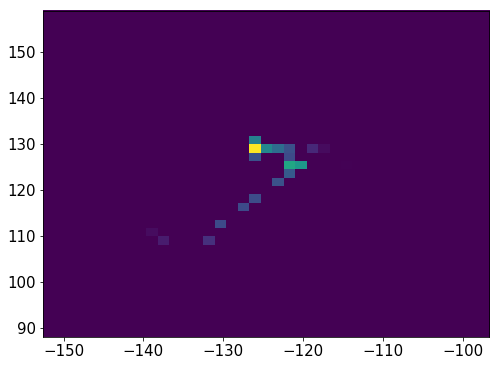

941544    26
941545    26
941546    26
941547    26
941548    26
941549    26
941550    26
941551    26
941552    26
941553    26
941554    26
941555    26
941556    26
941557    26
941558    26
941559    26
941560    26
Name: Nsipm, dtype: uint16


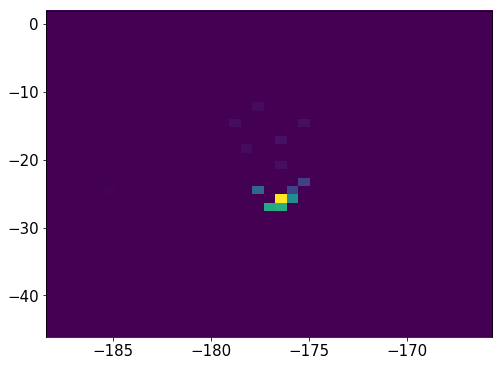

7963    27
7964    27
7965    27
7966    27
7967    27
7968    27
7969    27
7970    27
7971    27
7972    27
7973    27
7974    27
Name: Nsipm, dtype: uint16


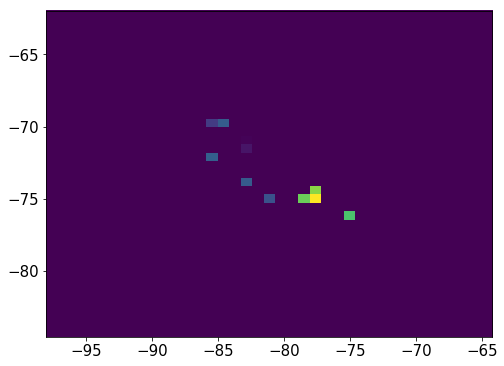

7979    24
7980    24
7981    24
7982    24
7983    24
7984    24
7985    24
7986    24
7987    24
7988    24
7989    24
7990    24
7991    24
7992    24
7993    24
7994    24
7995    24
7996    24
7997    24
7998    24
7999    24
8000    24
8001    24
8002    24
8003    24
8004    24
Name: Nsipm, dtype: uint16


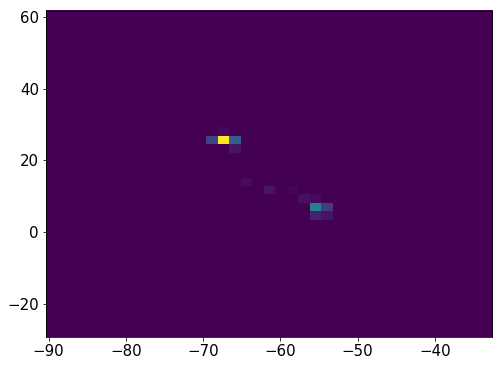

941583    32
941584    32
941585    32
941586    32
941587    32
941588    32
941589    32
941590    32
941591    32
941592    32
941593    32
941594    32
941595    32
941596    32
941597    32
941598    32
941599    32
941600    32
941601    32
Name: Nsipm, dtype: uint16


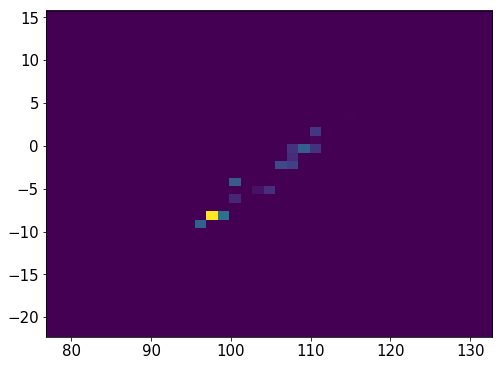

8009    26
8010    26
8011    26
8012    26
8013    26
8014    26
8015    26
8016    26
8017    26
8018    26
8019    26
8020    26
8021    26
8022    26
8023    26
8024    26
8025    26
8026    26
8027    26
8031     3
8032     3
8033     3
8034     3
8035     3
Name: Nsipm, dtype: uint16


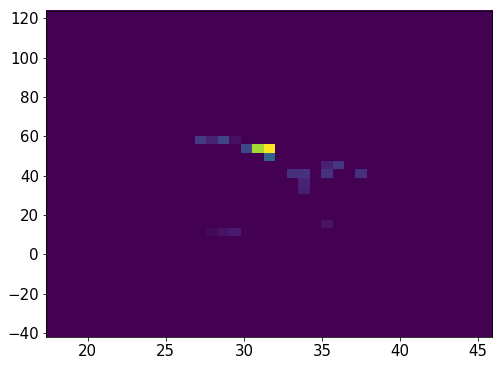

941607    40
941608    40
941609    40
941610    40
941611    40
941612    40
941613    40
941614    40
941615    40
941616    40
941617    40
941618    40
941619    40
Name: Nsipm, dtype: uint16


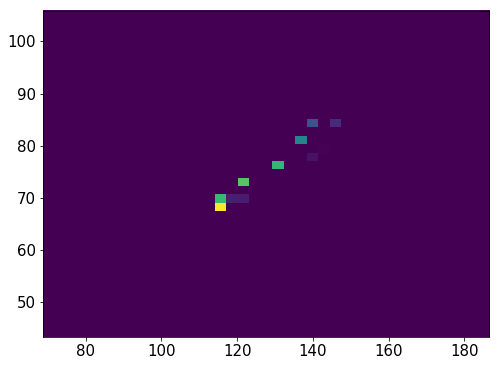

8039    29
8040    29
8041    29
8042    29
8043    29
8044    29
8045    29
8046    29
8047    29
8048    29
8049    29
8050    29
8051    29
8052    29
8053    29
8054    29
8055    29
8056    29
8057    29
8058    29
8059    29
8060    29
8061    29
8062    29
Name: Nsipm, dtype: uint16


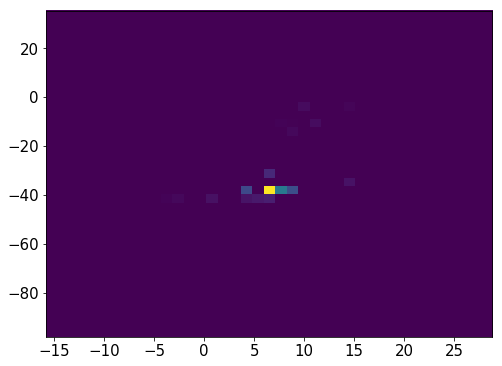

8063    24
8064    24
8065    24
8066    24
8067    24
8068    24
8069    24
8070    24
8071    24
8072    24
8073    24
8074    24
8075    24
8076    24
8077    24
8078    24
8079    24
8080    24
Name: Nsipm, dtype: uint16


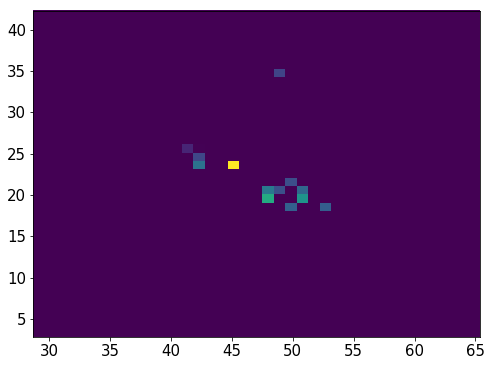

941638    31
941639    31
941640    31
941641    31
941642    31
941643    31
941644    31
941645    31
941646    31
941647    31
941648    31
941649    31
941650    31
941651    31
941652    31
Name: Nsipm, dtype: uint16


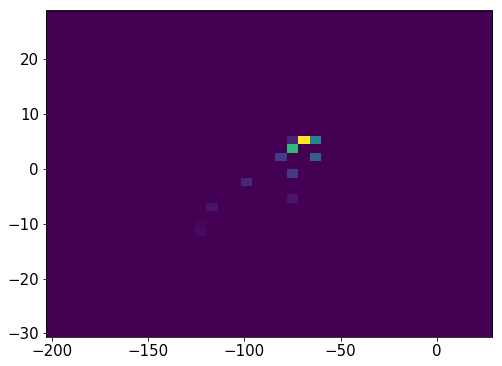

8085    33
8086    33
8087    33
8088    33
8089    33
8090    33
8091    33
8092    33
8093    33
8094    33
Name: Nsipm, dtype: uint16


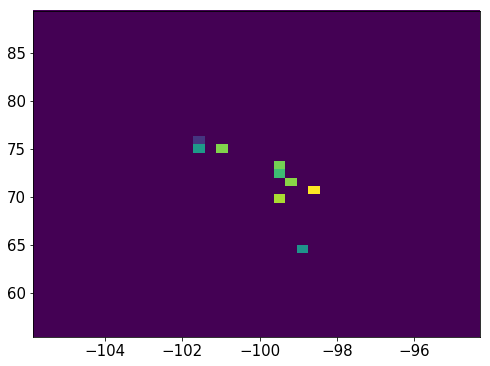

8099    27
8100    27
8101    27
8102    27
8103    27
8104    27
8105    27
8106    27
8107    27
8108    27
8109    27
8110    27
8111    27
8112    27
8113    27
Name: Nsipm, dtype: uint16


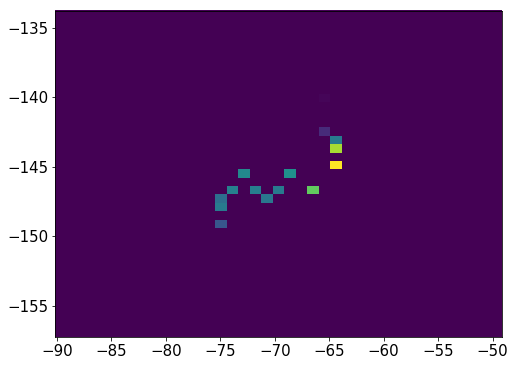

8118    26
8119    26
8120    26
8121    26
8122    26
8123    26
8124    26
8125    26
8126    26
8127    26
8128    26
8129    26
8130    26
8131    26
8137     6
8138     6
8139     6
8140     6
8141     6
8142     6
8143     6
8144     6
8145     6
Name: Nsipm, dtype: uint16


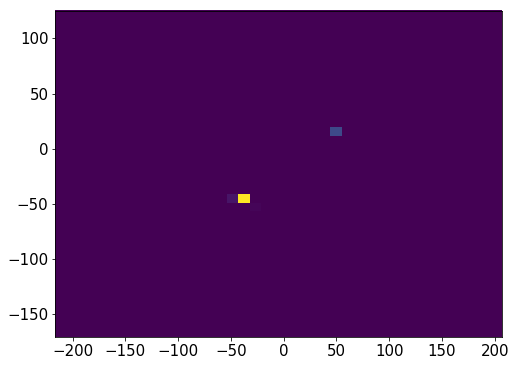

8149    38
8150    38
8151    38
8152    38
8153    38
8154    38
8155    38
8156    38
8157    38
8158    38
8159    38
8160    38
8161    38
8162    38
8163    38
8164    38
8165    38
8166    38
8167    38
8171     3
8172     3
8173     3
8174     3
8175     3
8180     3
8181     3
8182     3
8183     3
8184     3
Name: Nsipm, dtype: uint16


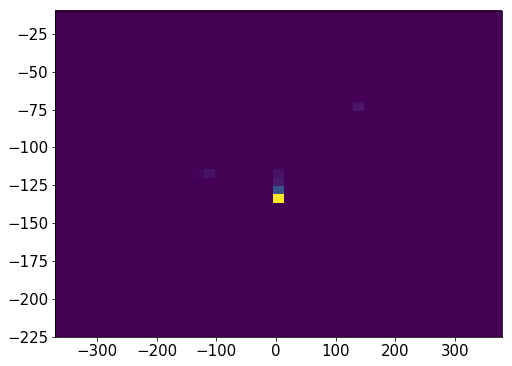

941657    21
941658    21
941659    21
941660    21
941661    21
941662    21
941663    21
941664    21
941665    21
941666    21
941667    21
941668    21
941669    21
941670    21
941671    21
941672    21
941673    21
941674    21
941679    21
941680    21
941681    21
941682    21
941683    21
Name: Nsipm, dtype: uint16


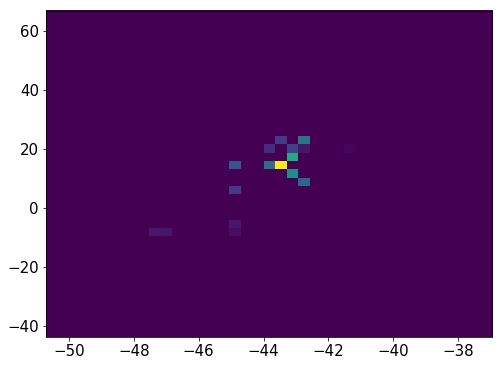

8188    33
8189    33
8190    33
8191    33
8192    33
8193    33
8194    33
8195    33
8196    33
8197    33
Name: Nsipm, dtype: uint16


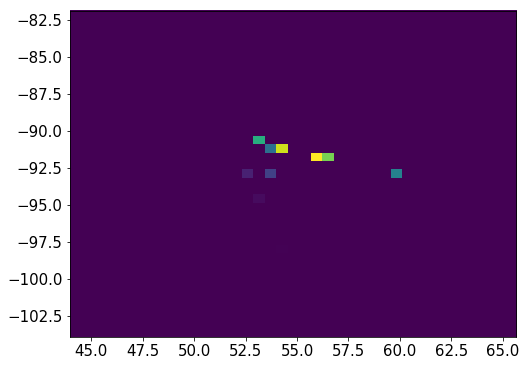

941687    22
941688    22
941689    22
941690    22
941691    22
941692    22
941693    22
941694    22
941695    22
941696    22
941697    22
941698    22
941699    22
941700    22
941701    22
941702    22
941703    22
941704    22
941705    22
941706    22
941707    22
941708    22
941709    22
941710    22
941711    22
941717     1
941718     1
941719     1
941720     1
Name: Nsipm, dtype: uint16


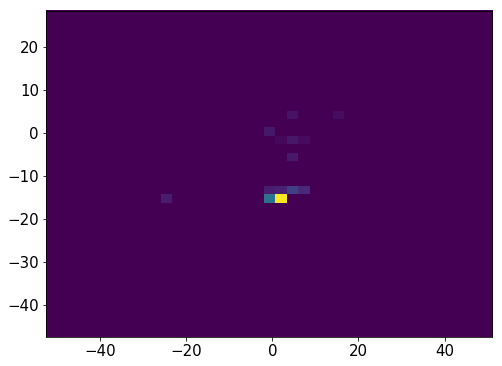

8201    27
8202    27
8203    27
8204    27
8205    27
8206    27
8207    27
8208    27
8209    27
8210    27
8211    27
8216     1
8217     1
8218     1
Name: Nsipm, dtype: uint16


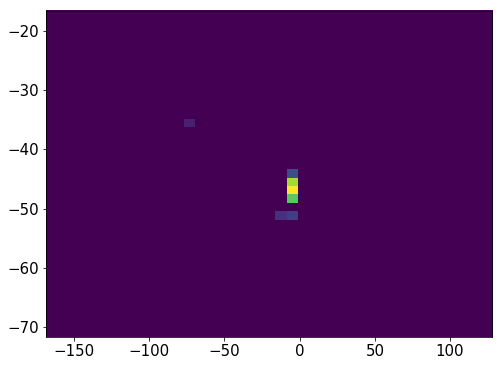

8223    21
8224    21
8225    21
8226    21
8227    21
8228    21
8229    21
8230    21
8231    21
8232    21
8233    21
8235    21
8236    21
8237    21
8238    21
8239    21
8240    21
8241    21
8242    21
8243    21
8244    21
8245    21
8246    21
Name: Nsipm, dtype: uint16


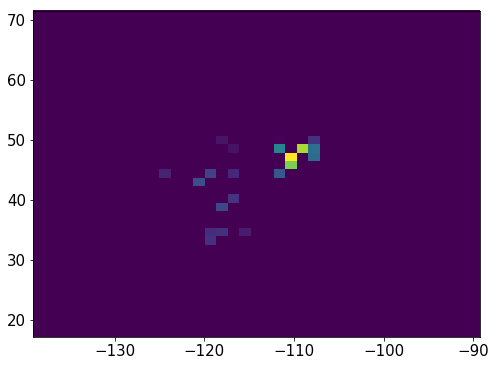

8254    25
8255    25
8256    25
8257    25
8258    25
8259    25
8260    25
8261    25
8262    25
8263    25
8264    25
8265    25
8266    25
8267    25
8268    25
8269    25
8270    25
8271    25
8272    25
8273    25
Name: Nsipm, dtype: uint16


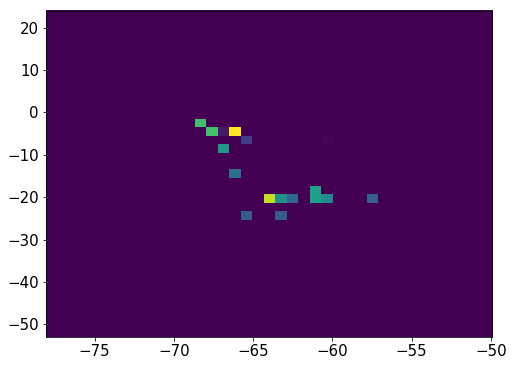

941750    30
941751    30
941752    30
941753    30
941754    30
941755    30
941756    30
941757    30
941758    30
941759    30
941760    30
941761    30
941762    30
941763    30
941764    30
941765    30
941766    30
941767    30
941768    30
941769    30
941770    30
941771    30
941772    30
941773    30
Name: Nsipm, dtype: uint16


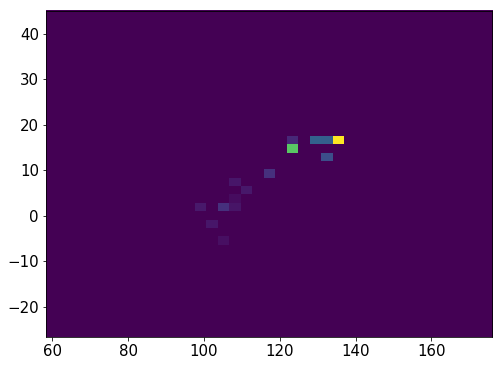

8278    25
8279    25
8280    25
8281    25
8282    25
8283    25
8284    25
8285    25
8286    25
8287    25
8288    25
8289    25
8290    25
8291    25
8292    25
8293    25
8294    25
8295    25
8296    25
8297    25
Name: Nsipm, dtype: uint16


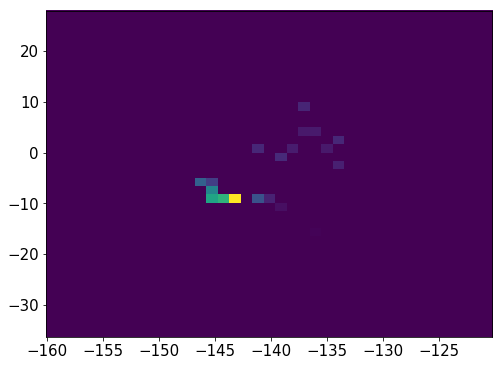

941799    30
941800    30
941801    30
941802    30
941803    30
941804    30
941805    30
941806    30
941807    30
941808    30
941809    30
941810    30
941811    30
941812    30
941813    30
941814    30
941815    30
941816    30
941817    30
941818    30
941819    30
941820    30
941821    30
Name: Nsipm, dtype: uint16


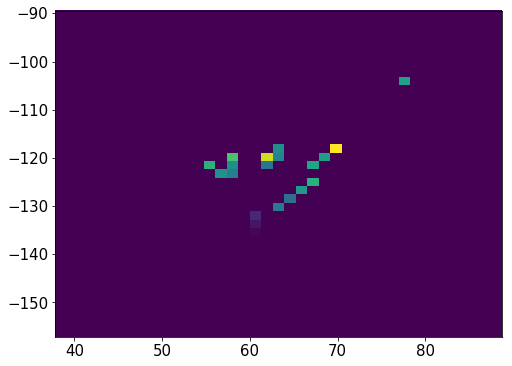

8303    26
8304    26
8305    26
8306    26
8307    26
8308    26
8309    26
8310    26
8311    26
8312    26
8313    26
8314    26
8315    26
8316    26
8317    26
8318    26
8319    26
8320    26
8321    26
8322    26
8323    26
8324    26
8325    26
8326    26
8327    26
Name: Nsipm, dtype: uint16


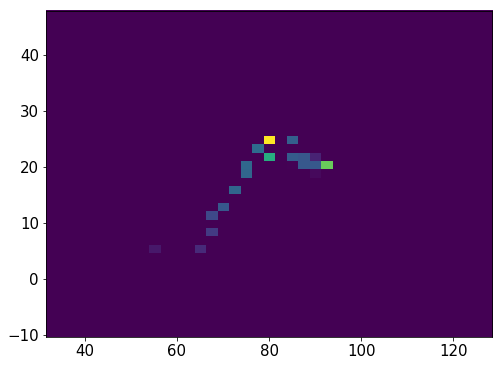

8330    58
8331    58
8332    58
8333    58
8334    58
8335    58
8336    58
8337    58
8338    58
8339    58
8340    58
8341    58
8342    58
8343    58
8344    58
8345    58
8346    58
8347    58
8348    58
8349    58
8350    58
8351    58
8352    58
8353    58
8354    58
8355    58
8356    58
8357    58
8358    58
8359    58
        ..
8368    58
8369    58
8370    58
8371    58
8372    58
8373    58
8374    58
8375    58
8376    58
8377    58
8378    58
8379    58
8380    58
8381    58
8382    58
8383    58
8384    58
8385    58
8386    58
8387    58
8388    58
8389    58
8390    58
8391    58
8392    58
8393    58
8394    58
8395    58
8396    58
8397    58
Name: Nsipm, dtype: uint16


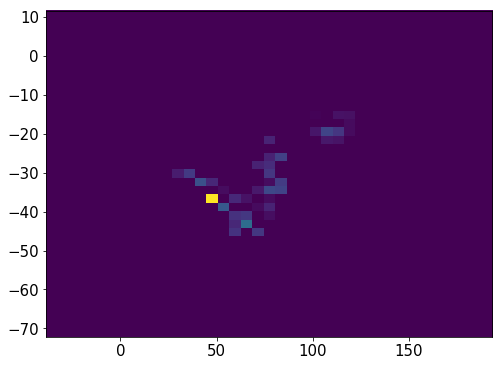

8398    24
8399    24
8400    24
8401    24
8402    24
8403    24
8404    24
8405    24
8406    24
8407    24
8408    24
Name: Nsipm, dtype: uint16


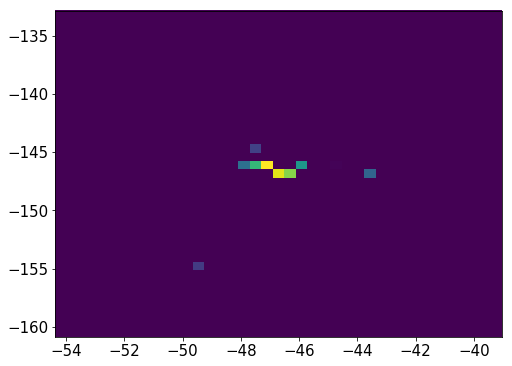

8413    22
8414    22
8415    22
8416    22
8417    22
8418    22
8419    22
8420    22
8421    22
8422    22
8423    22
8424    22
8425    22
8430    22
8431    22
8432    22
8433    22
8438     7
8439     7
8440     7
8441     7
8442     7
8443     7
8444     7
8445     7
Name: Nsipm, dtype: uint16


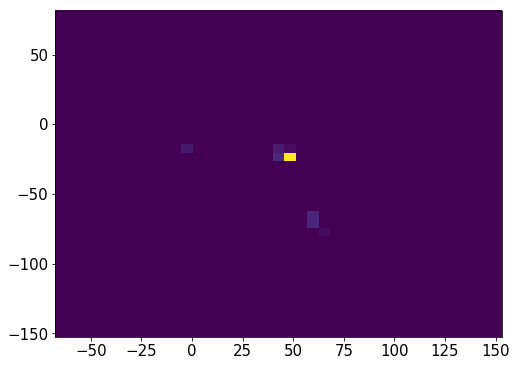

8450    30
8451    30
8452    30
8453    30
8454    30
8455    30
8456    30
8457    30
8458    30
8459    30
8460    30
8461    30
8462    30
8463    30
8464    30
8465    30
Name: Nsipm, dtype: uint16


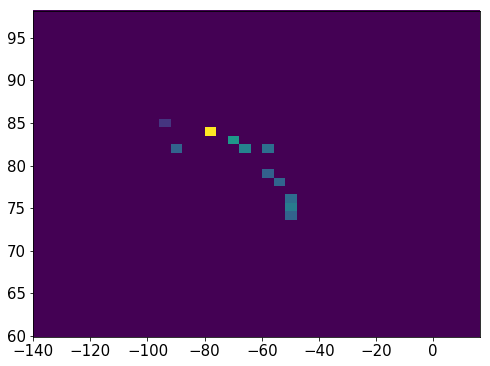

8469    21
8470    21
8471    21
8472    21
8473    21
8474    21
8475    21
8476    21
8477    21
8478    21
8479    21
8480    21
8481    21
8482    21
8483    21
8484    21
8485    21
Name: Nsipm, dtype: uint16


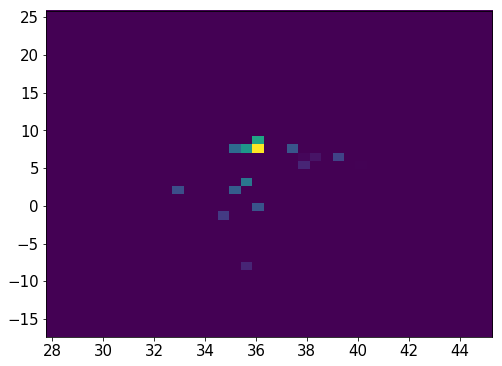

8489    22
8490    22
8491    22
8492    22
8493    22
8494    22
8495    22
8496    22
8497    22
8498    22
8499    22
Name: Nsipm, dtype: uint16


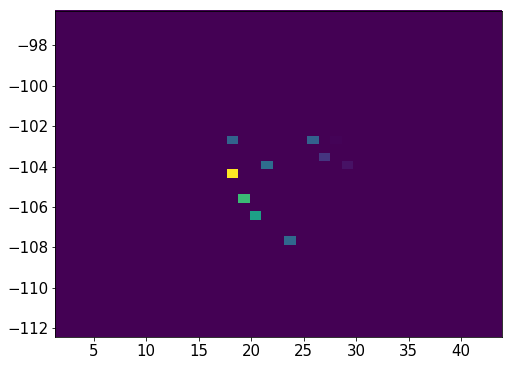

8503    22
8504    22
8505    22
8506    22
8507    22
8508    22
8509    22
8510    22
8511    22
8512    22
8513    22
8514    22
8518    16
8519    16
8520    16
8521    16
8522    16
8523    16
8524    16
8525    16
Name: Nsipm, dtype: uint16


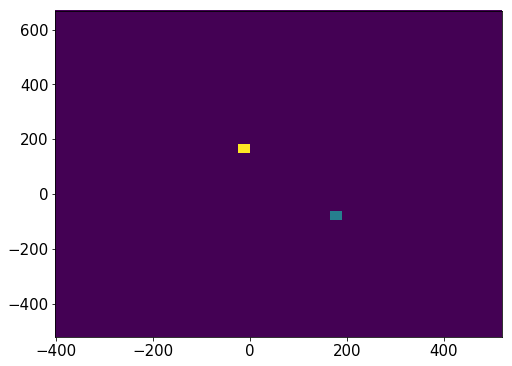

8531    20
8532    20
8533    20
8534    20
8535    20
8536    20
8537    20
8538    20
8539    20
8540    20
8541    20
8542    20
8543    20
8544    20
8545    20
8546    20
8547    20
8548    20
Name: Nsipm, dtype: uint16


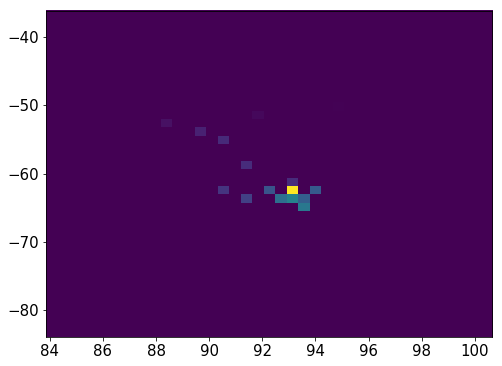

8553    24
8554    24
8555    24
8556    24
8557    24
8558    24
8559    24
8560    24
8561    24
8562    24
8563    24
8564    24
8565    24
8566    24
8567    24
8568    24
8569    24
8570    24
8571    24
8572    24
8573    24
8575     2
8576     2
8577     2
8578     2
8582     5
8583     5
8584     5
8585     5
8586     5
8587     5
8588     5
Name: Nsipm, dtype: uint16


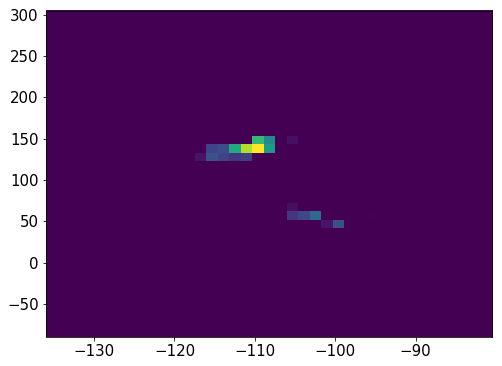

8590    34
8591    34
8592    34
8593    34
8594    34
8595    34
8596    34
8597    34
8598    34
8599    34
8600    34
8601    34
8602    34
8603    34
8604    34
8605    34
8606    34
8607    34
8608    34
8609    34
8610    34
8611    34
8612    34
8613    34
8614    34
8615    34
8616    34
Name: Nsipm, dtype: uint16


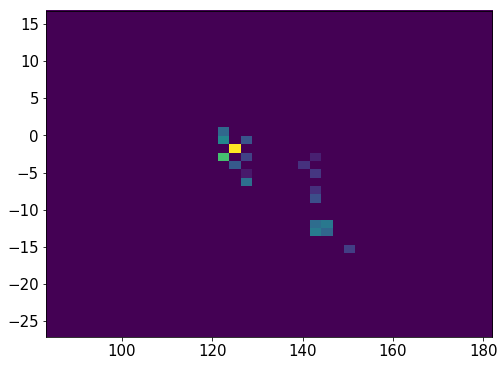

941887    25
941888    25
941889    25
941890    25
941891    25
941892    25
941893    25
941894    25
941895    25
941896    25
941897    25
941898    25
941899    25
941900    25
941901    25
941902    25
941903    25
941904    25
941905    25
941906    25
Name: Nsipm, dtype: uint16


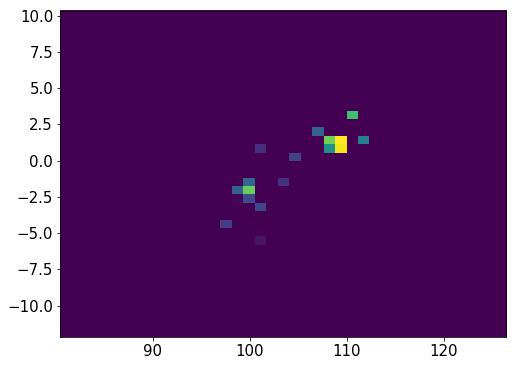

8620    22
8621    22
8622    22
8623    22
8624    22
8625    22
8626    22
8627    22
8628    22
8629    22
8630    22
8631    22
8632    22
8633    22
8634    22
8635    22
8636    22
8637    22
8638    22
8639    22
8640    22
8641    22
8642    22
8643    22
8644    22
8645    22
8646    22
8648    22
8649    22
8650    22
8655    17
8656    17
8657    17
8658    17
8659    17
8660    17
8661    17
8664    17
8665    17
8666    17
8667    17
8668    17
Name: Nsipm, dtype: uint16


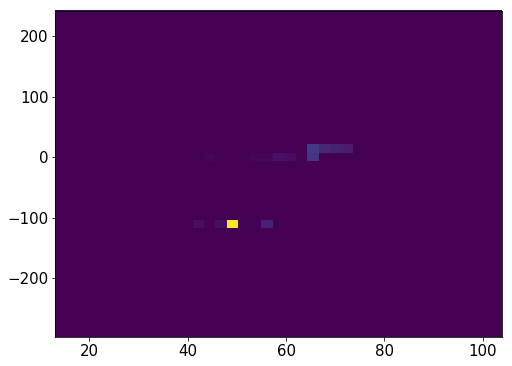

941910    24
941911    24
941912    24
941913    24
941914    24
941915    24
941916    24
941917    24
941918    24
941919    24
941920    24
941921    24
941922    24
941923    24
941924    24
941925    24
Name: Nsipm, dtype: uint16


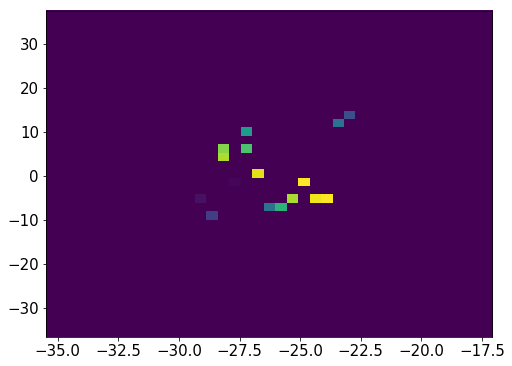

941932    27
941933    27
941934    27
941935    27
941936    27
941937    27
941938    27
941939    27
941940    27
941941    27
941942    27
941943    27
941944    27
941945    27
941946    27
Name: Nsipm, dtype: uint16


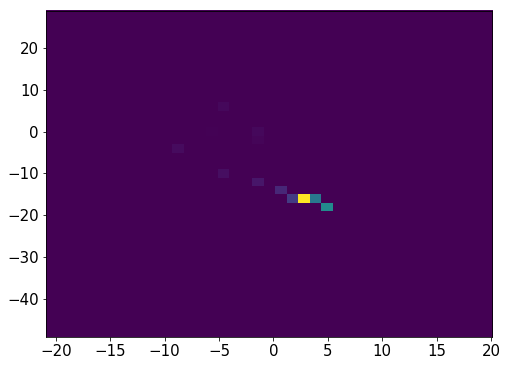

8672    16
8673    16
8674    16
8675    16
8676    16
8677    16
8678    16
8684     3
8685     3
8686     3
8687     3
8688     3
8689     3
8690     3
8691     3
Name: Nsipm, dtype: uint16


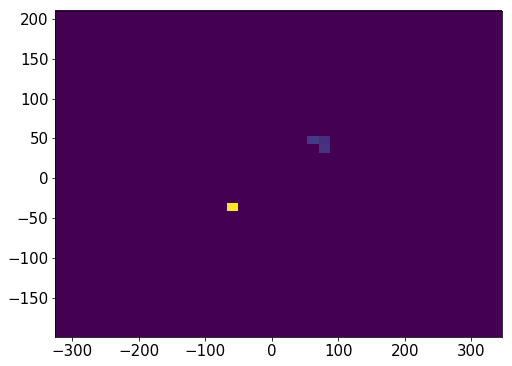

8696    41
8697    41
8698    41
8699    41
8700    41
8701    41
8702    41
8703    41
8704    41
8705    41
8706    41
8707    41
8708    41
8709    41
8710    41
8711    41
8712    41
8713    41
8714    41
Name: Nsipm, dtype: uint16


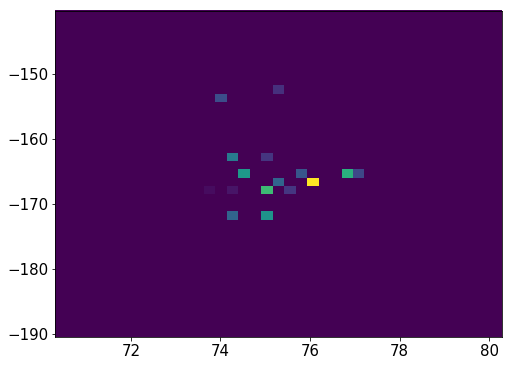

941976    28
941977    28
941978    28
941979    28
941980    28
941981    28
941982    28
941983    28
941984    28
941985    28
941986    28
941987    28
941988    28
941989    28
941990    28
941991    28
941992    28
941997     9
941998     9
941999     9
942000     9
942001     9
942002     9
942003     9
942004     9
942005     9
942006     9
Name: Nsipm, dtype: uint16


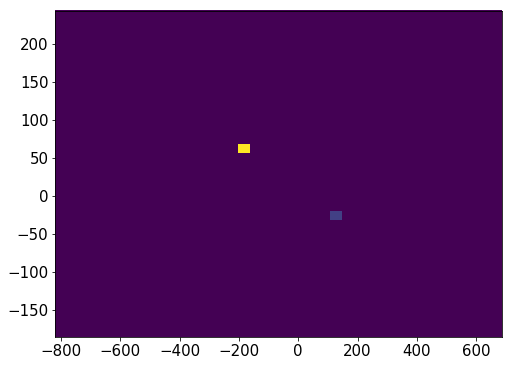

1664508    29
1664509    29
1664510    29
1664511    29
1664512    29
1664513    29
1664514    29
1664515    29
1664516    29
1664517    29
1664518    29
1664519    29
1664520    29
1664521    29
1664522    29
1664523    29
1664524    29
Name: Nsipm, dtype: uint16


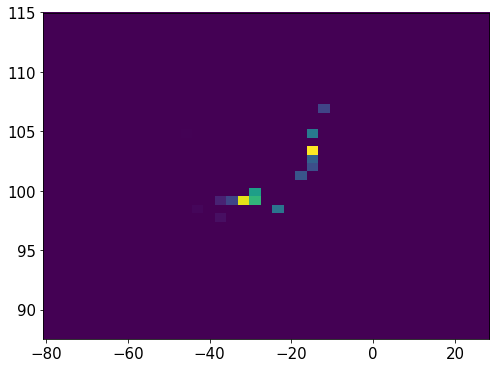

942011    24
942012    24
942013    24
942014    24
942015    24
942016    24
942017    24
942018    24
942019    24
942020    24
942021    24
942022    24
942023    24
942024    24
942025    24
Name: Nsipm, dtype: uint16


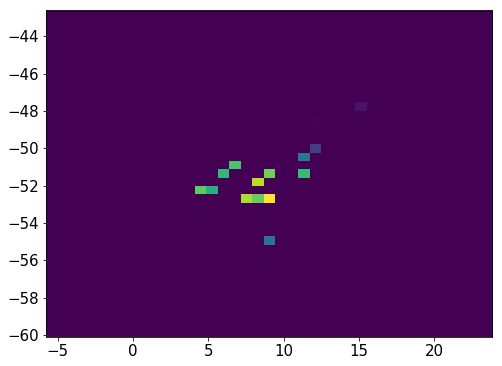

8718    26
8719    26
8720    26
8721    26
8722    26
8723    26
8724    26
8725    26
8726    26
8727    26
8728    26
8729    26
8730    26
8731    26
8732    26
8733    26
8734    26
8735    26
8736    26
8737    26
8738    26
Name: Nsipm, dtype: uint16


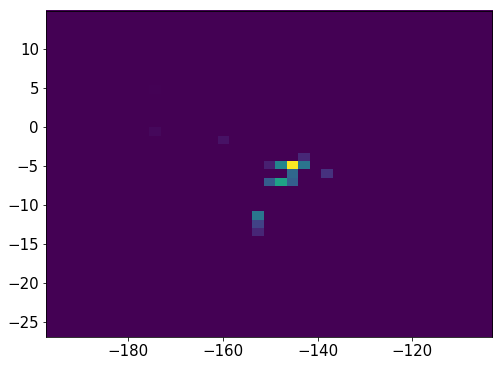

8744    21
8745    21
8746    21
8747    21
8748    21
8749    21
8750    21
8751    21
8752    21
8753    21
8754    21
8755    21
8756    21
8757    21
8758    21
8759    21
8760    21
8761    21
8762    21
8767     1
8768     1
8769     1
8770     1
8771     1
Name: Nsipm, dtype: uint16


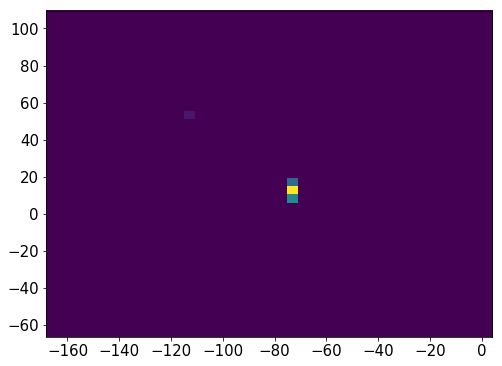

8777    23
8778    23
8779    23
8780    23
8781    23
8782    23
8783    23
8784    23
8785    23
8786    23
8787    23
8788    23
8789    23
8790    23
8791    23
8792    23
8793    23
8794    23
8795    23
8796    23
8797    23
8798    23
8799    23
8800    23
Name: Nsipm, dtype: uint16


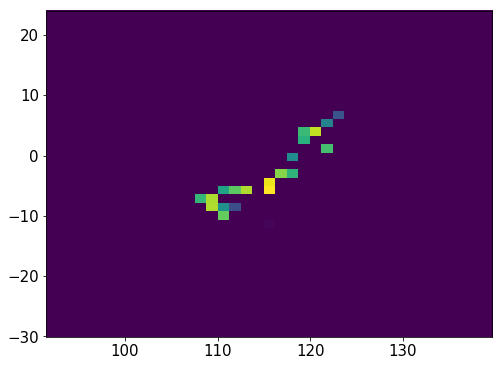

8804    24
8811    24
8812    24
8813    24
8814    24
8815    24
8816    24
8817    24
8818    24
8819    24
Name: Nsipm, dtype: uint16


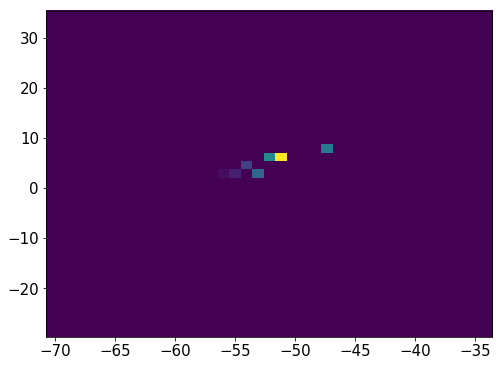

8820    24
8821    24
8822    24
8823    24
8824    24
8825    24
8826    24
8827    24
8828    24
8829    24
8830    24
8831    24
8832    24
8833    24
8834    24
8835    24
8836    24
8837    24
8838    24
8839    24
8840    24
8841    24
8842    24
8843    24
8844    24
8845    24
8846    24
8847    24
8848    24
8849    24
Name: Nsipm, dtype: uint16


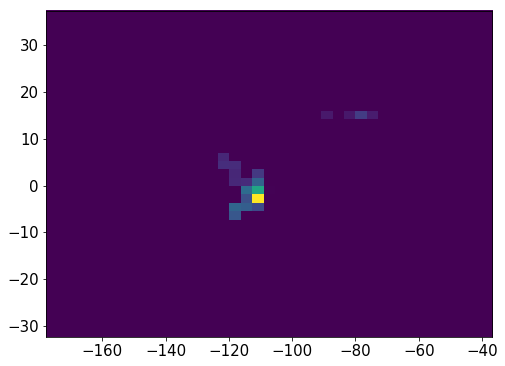

8854    22
8855    22
8856    22
8857    22
8858    22
8862    22
8863    22
8864    22
8865    22
8866    22
8867    22
8868    22
8869    22
8870    22
8871    22
8872    22
8873    22
8874    22
8875    22
8876    22
8877    22
8881     1
8882     1
8883     1
8884     1
8885     1
Name: Nsipm, dtype: uint16


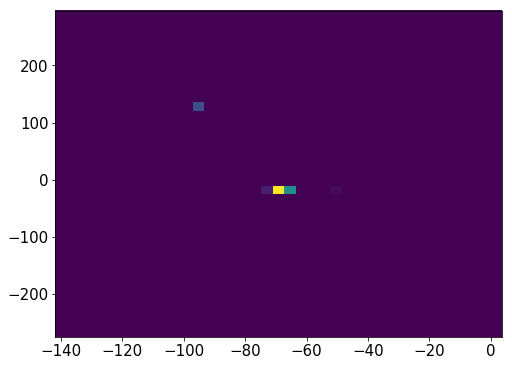

8892    23
8893    23
8894    23
8895    23
8896    23
8897    23
8898    23
8899    23
8900    23
8901    23
8902    23
8903    23
8904    23
8905    23
8906    23
8907    23
8908    23
8909    23
Name: Nsipm, dtype: uint16


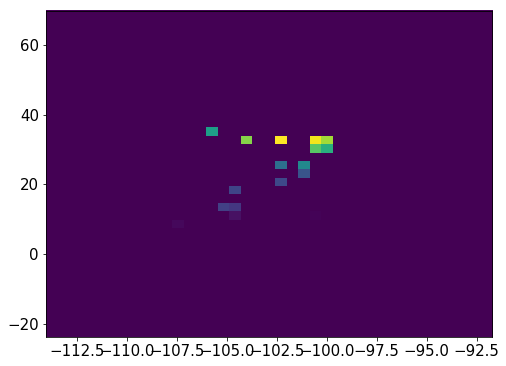

8916    25
8917    25
8918    25
8919    25
8920    25
8921    25
8922    25
8923    25
8924    25
8925    25
8926    25
8927    25
8928    25
8929    25
Name: Nsipm, dtype: uint16


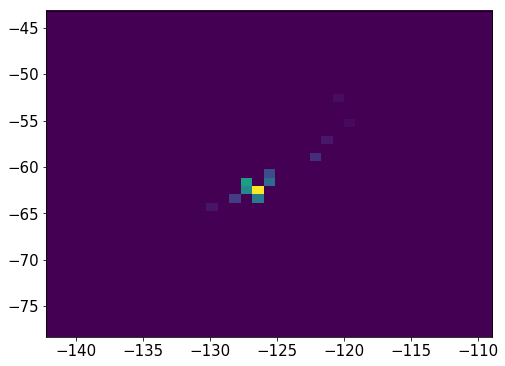

8931    21
8932    21
8933    21
8934    21
8935    21
8936    21
8937    21
8938    21
8939    21
8940    21
8941    21
8942    21
Name: Nsipm, dtype: uint16


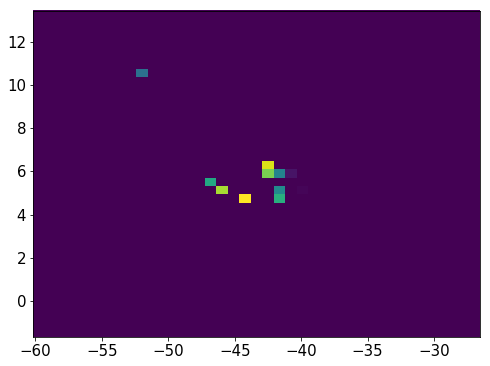

942125    29
942126    29
942127    29
942128    29
942129    29
942130    29
942131    29
942132    29
942133    29
942134    29
Name: Nsipm, dtype: uint16


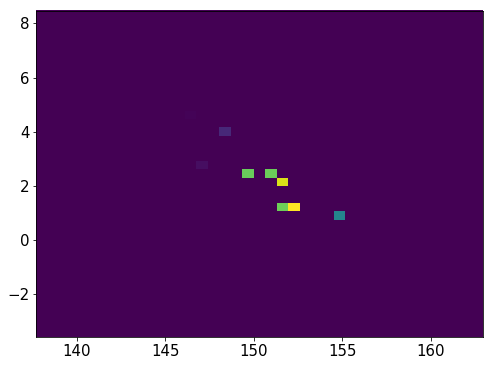

8948    28
8949    28
8950    28
8951    28
8952    28
8953    28
8954    28
8955    28
8956    28
8957    28
8958    28
8959    28
8960    28
8961    28
8962    28
8963    28
8964    28
8965    28
8966    28
8967    28
8968    28
8969    28
Name: Nsipm, dtype: uint16


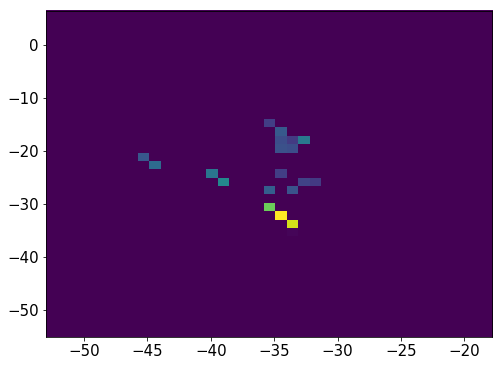

8972    34
8973    34
8974    34
8975    34
8976    34
8977    34
8978    34
8979    34
8980    34
8981    34
8982    34
8983    34
Name: Nsipm, dtype: uint16


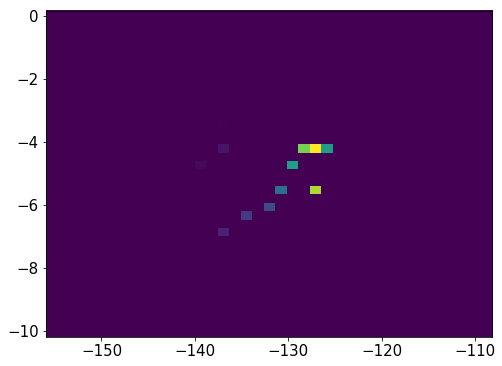

942139    27
942140    27
942141    27
942142    27
942143    27
942144    27
942145    27
942146    27
942147    27
942148    27
942149    27
942150    27
942151    27
942152    27
942153    27
Name: Nsipm, dtype: uint16


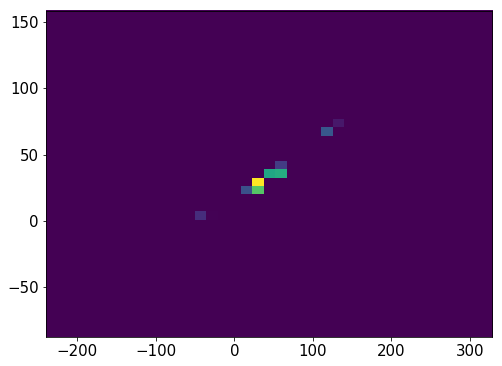

8988    27
8989    27
8990    27
8991    27
8992    27
8993    27
8994    27
8995    27
8996    27
8997    27
8998    27
8999    27
9000    27
9001    27
9002    27
9003    27
9004    27
9005    27
9006    27
Name: Nsipm, dtype: uint16


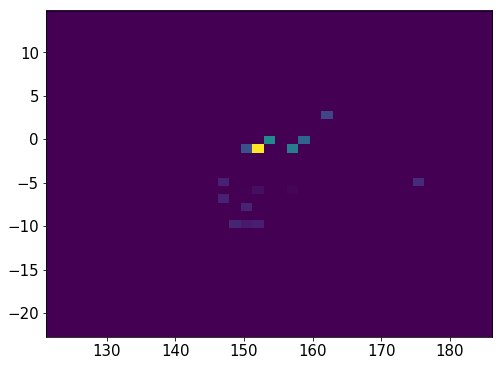

942157    26
942158    26
942159    26
942160    26
942161    26
942162    26
942163    26
942164    26
942165    26
942166    26
942167    26
942168    26
942169    26
942170    26
942171    26
942175     2
942176     2
942177     2
942178     2
942179     2
942180     2
Name: Nsipm, dtype: uint16


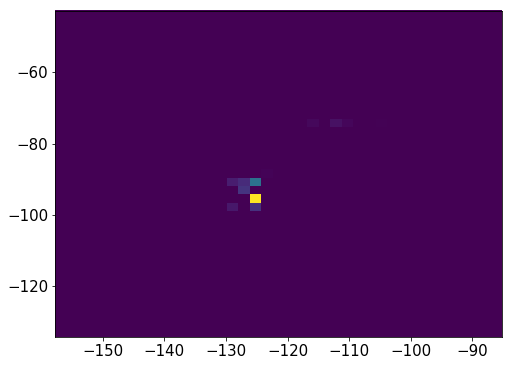

9011    25
9012    25
9013    25
9014    25
9015    25
9016    25
9017    25
9018    25
9019    25
9020    25
9021    25
9022    25
9023    25
9024    25
9029    11
9030    11
9031    11
9032    11
9033    11
9034    11
9035    11
9036    11
Name: Nsipm, dtype: uint16


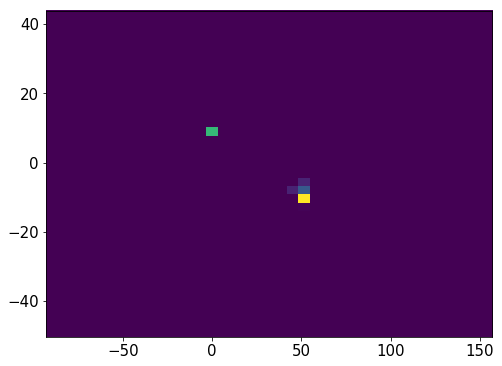

9041    28
9042    28
9043    28
9044    28
9045    28
9046    28
9047    28
9048    28
9049    28
9050    28
9051    28
Name: Nsipm, dtype: uint16


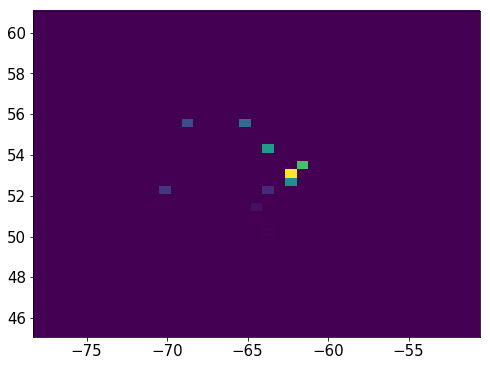

9056    32
9057    32
9058    32
9059    32
9060    32
9061    32
9062    32
9063    32
9064    32
9065    32
9066    32
9067    32
9068    32
9069    32
9070    32
9071    32
9072    32
9073    32
9074    32
Name: Nsipm, dtype: uint16


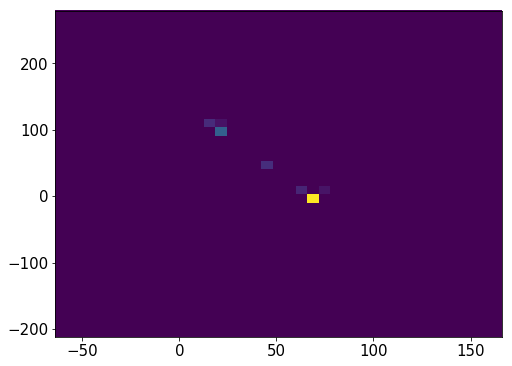

942185    26
942186    26
942187    26
942188    26
942189    26
942190    26
942191    26
942192    26
942193    26
942194    26
942195    26
942196    26
942197    26
942198    26
942199    26
942200    26
942201    26
942202    26
Name: Nsipm, dtype: uint16


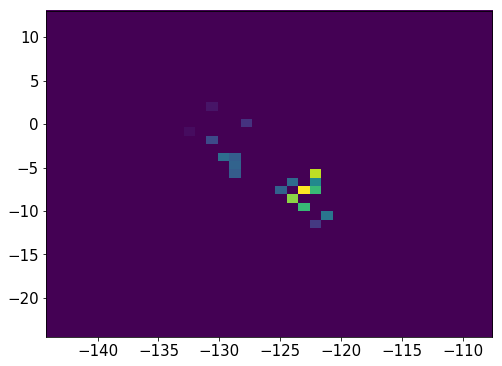

9078    28
9079    28
9080    28
9081    28
9082    28
9083    28
9084    28
9085    28
9086    28
9087    28
9088    28
9089    28
9090    28
9091    28
9092    28
9093    28
9094    28
9095    28
9096    28
9097    28
Name: Nsipm, dtype: uint16


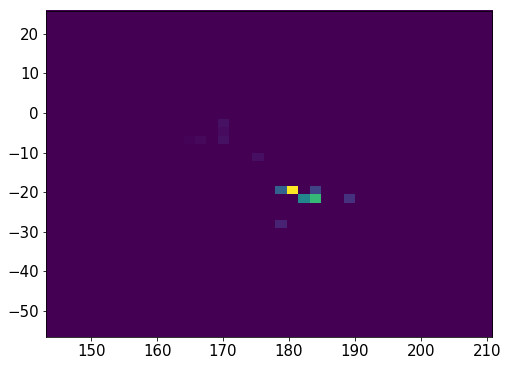

9104    21
9105    21
9106    21
9107    21
9108    21
9109    21
9110    21
9111    21
9112    21
9113    21
9114    21
9115    21
9116    21
9117    21
9118    21
9119    21
9120    21
9121    21
9122    21
9123    21
Name: Nsipm, dtype: uint16


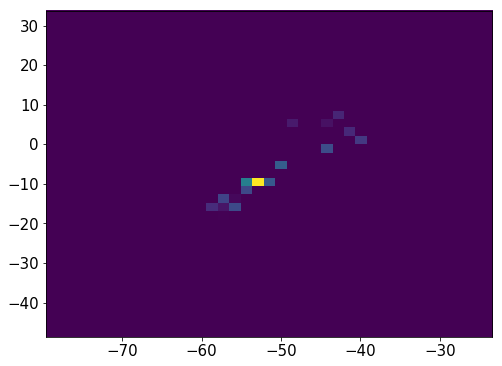

942206    53
942207    53
942208    53
942209    53
942210    53
942211    53
942212    53
942213    53
942214    53
942215    53
942216    53
942217    53
942218    53
942219    53
942220    53
942221    53
942222    53
942223    53
942224    53
942225    53
942226    53
942227    53
942228    53
942229    53
942230    53
942231    53
942232    53
942233    53
942234    53
942235    53
942236    53
942237    53
942238    53
942239    53
942240    53
942241    53
942242    53
942243    53
942244    53
942245    53
942246    53
942247    53
942248    53
942249    53
942250    53
942251    53
942252    53
942253    53
942254    53
942255    53
942256    53
Name: Nsipm, dtype: uint16


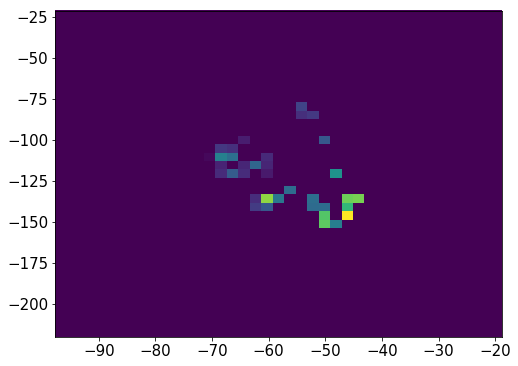

942258    31
942259    31
942260    31
942261    31
942262    31
942263    31
942264    31
942265    31
942266    31
942267    31
942268    31
942269    31
942270    31
942271    31
942272    31
942273    31
942274    31
942275    31
942276    31
942277    31
942278    31
Name: Nsipm, dtype: uint16


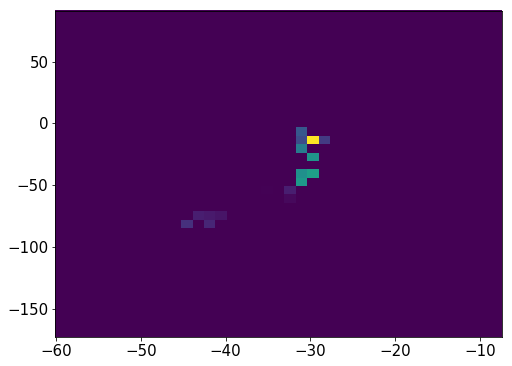

9127    25
9128    25
9129    25
9130    25
9131    25
9132    25
9133    25
9134    25
9135    25
9136    25
9137    25
9138    25
9139    25
9140    25
9141    25
9142    25
9143    25
9144    25
Name: Nsipm, dtype: uint16


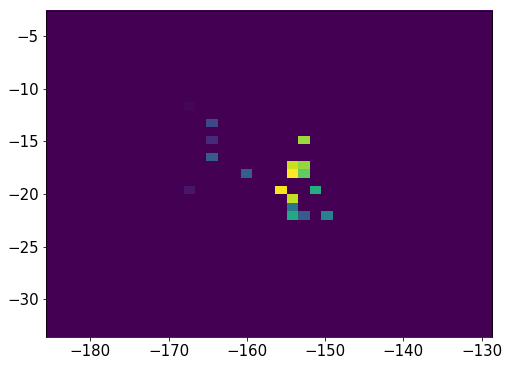

942282    28
942283    28
942284    28
942285    28
942286    28
942289    28
942290    28
942291    28
942292    28
942293    28
942294    28
942295    28
942296    28
942297    28
942298    28
942299    28
942300    28
942301    28
942302    28
942303    28
942304    28
942305    28
942306    28
942307    28
Name: Nsipm, dtype: uint16


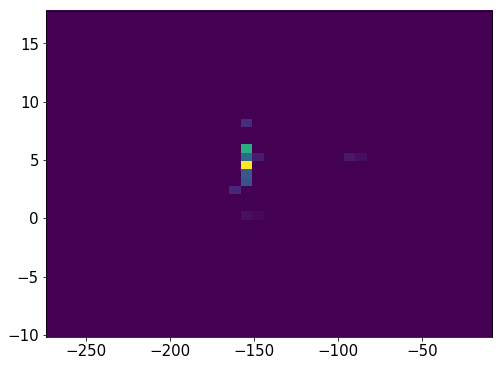

942308    29
942309    29
942310    29
942311    29
942312    29
942313    29
942314    29
942315    29
942316    29
942317    29
942318    29
942319    29
942320    29
942321    29
942322    29
942323    29
Name: Nsipm, dtype: uint16


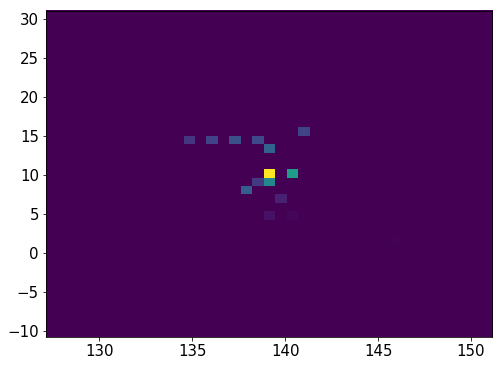

9150    17
9151    17
9152    17
9153    17
9154    17
9155    17
9156    17
9157    17
9158    17
9159    17
9160    17
9161    17
9162    17
9163    17
9164    17
9165    17
9166    17
9167    17
9168    17
9169    17
Name: Nsipm, dtype: uint16


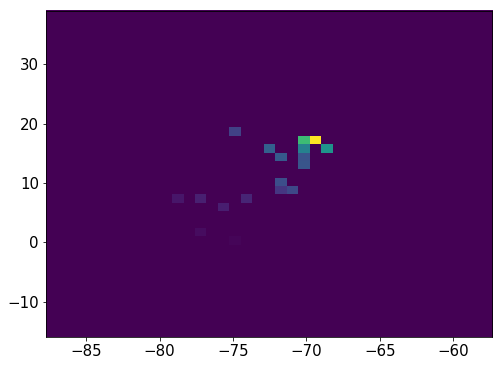

942350    30
942351    30
942352    30
942353    30
942354    30
942355    30
942356    30
942357    30
942358    30
942359    30
942360    30
942361    30
942362    30
942363    30
942364    30
942365    30
942366    30
942367    30
942368    30
942369    30
942370    30
942371    30
942372    30
942373    30
942374    30
Name: Nsipm, dtype: uint16


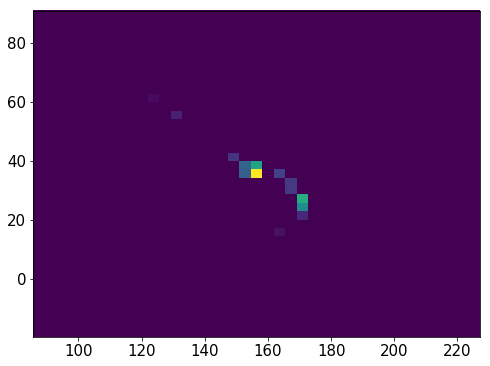

942378    25
942379    25
942380    25
942381    25
942382    25
942383    25
942384    25
942385    25
942386    25
942387    25
942388    25
942389    25
942390    25
942395    13
942396    13
942397    13
942398    13
942399    13
942400    13
942401    13
942402    13
942403    13
942404    13
942405    13
Name: Nsipm, dtype: uint16


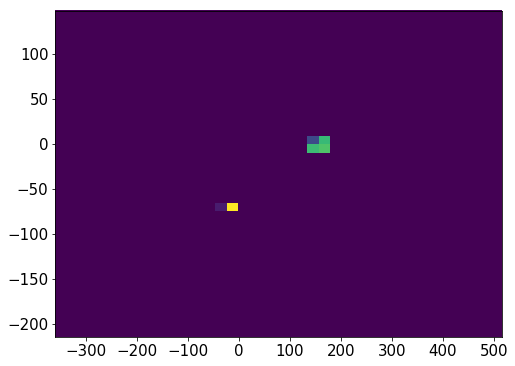

9173    26
9174    26
9175    26
9176    26
9177    26
9178    26
9179    26
9180    26
9181    26
9182    26
9183    26
9184    26
9185    26
9186    26
9187    26
9188    26
9189    26
9190    26
9191    26
9192    26
9193    26
9194    26
9195    26
9197    26
9198    26
9199    26
9200    26
9201    26
9202    26
9203    26
9204    26
9205    26
9206    26
Name: Nsipm, dtype: uint16


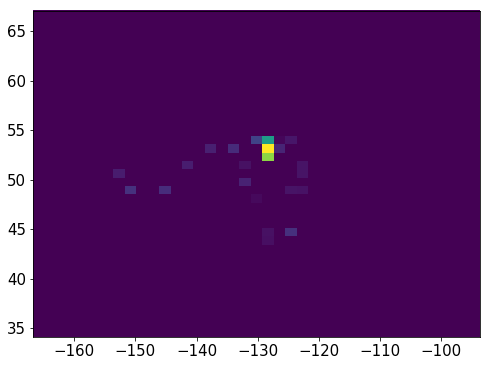

9209    39
9210    39
9211    39
9212    39
9213    39
9214    39
9215    39
9216    39
9217    39
9218    39
9219    39
9220    39
9221    39
9222    39
9223    39
9224    39
9225    39
9226    39
9227    39
9228    39
9229    39
9230    39
9231    39
9232    39
9233    39
9234    39
9235    39
9236    39
9237    39
Name: Nsipm, dtype: uint16


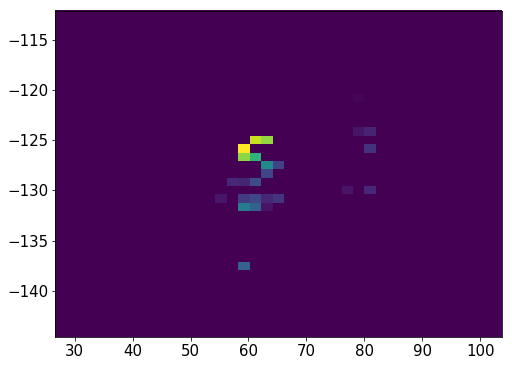

942448    38
942449    38
942450    38
942451    38
942452    38
942453    38
942454    38
942455    38
942456    38
942457    38
942458    38
942459    38
942460    38
942461    38
942462    38
942466    14
942467    14
942468    14
942469    14
942470    14
942471    14
942472    14
942473    14
942474    14
Name: Nsipm, dtype: uint16


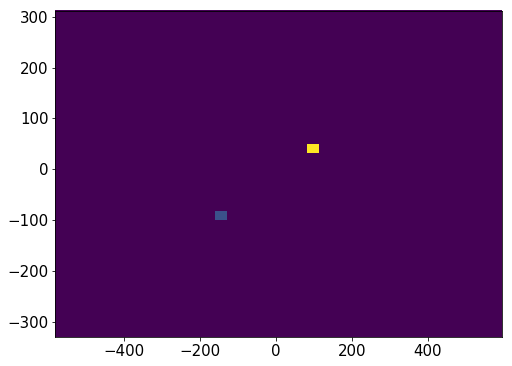

9242    31
9243    31
9244    31
9245    31
9246    31
9247    31
9248    31
9249    31
9250    31
9251    31
9252    31
9253    31
9254    31
9255    31
9256    31
9257    31
9258    31
9259    31
9260    31
9261    31
9262    31
9263    31
9264    31
9265    31
Name: Nsipm, dtype: uint16


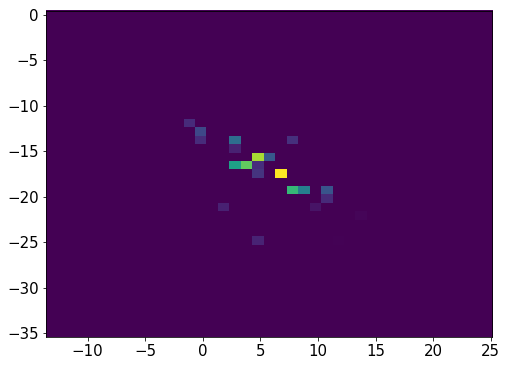

9270    27
9271    27
9272    27
9273    27
9274    27
9275    27
9276    27
9277    27
9278    27
9279    27
9280    27
9281    27
9282    27
9283    27
9284    27
9285    27
9286    27
9287    27
9288    27
9289    27
9290    27
9291    27
9292    27
9293    27
9294    27
9295    27
9296    27
9300     2
9301     2
9302     2
9303     2
Name: Nsipm, dtype: uint16


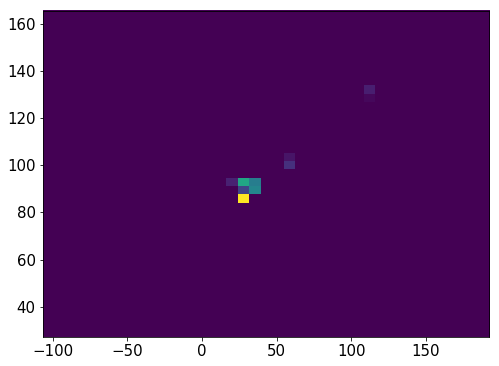

9308    26
9309    26
9310    26
9311    26
9312    26
9313    26
9314    26
9315    26
9316    26
9317    26
9318    26
9319    26
9320    26
9321    26
9322    26
9323    26
9324    26
9325    26
9326    26
9327    26
9328    26
9334    26
9335    26
9336    26
9337    26
9338    26
9339    26
Name: Nsipm, dtype: uint16


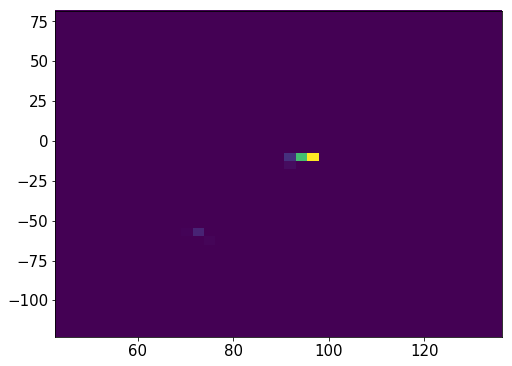

942520    24
942521    24
942522    24
942523    24
942524    24
942525    24
942526    24
942527    24
942528    24
942529    24
942530    24
942531    24
Name: Nsipm, dtype: uint16


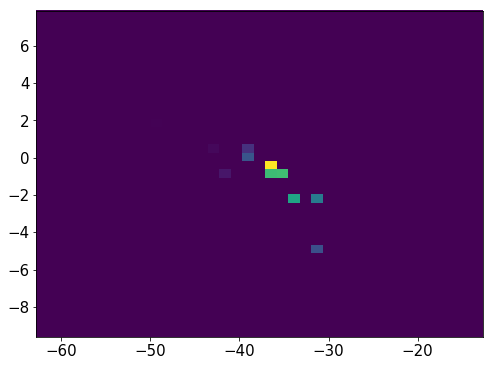

942536    25
942537    25
942538    25
942539    25
942540    25
942541    25
942542    25
942543    25
942544    25
942545    25
942546    25
942547    25
942548    25
942549    25
942550    25
942551    25
942552    25
942553    25
942554    25
942555    25
942556    25
Name: Nsipm, dtype: uint16


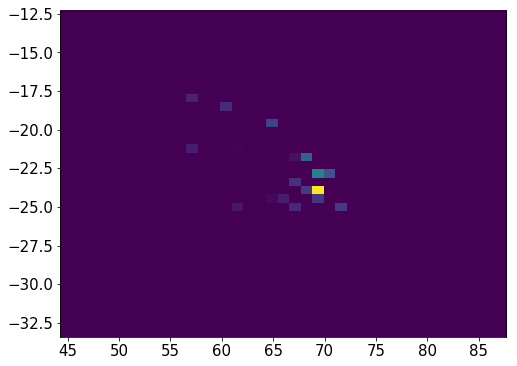

9342    22
9343    22
9344    22
9345    22
9346    22
9347    22
9348    22
9349    22
9350    22
9351    22
9352    22
9353    22
9354    22
9355    22
9356    22
9362     1
9363     1
9364     1
9365     1
9366     1
Name: Nsipm, dtype: uint16


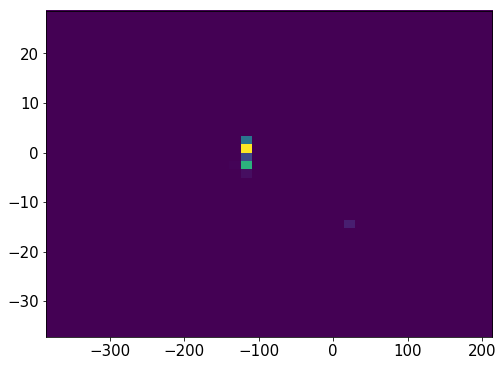

9372    27
9373    27
9374    27
9375    27
9379    27
9380    27
9381    27
9382    27
9383    27
9384    27
9385    27
9386    27
9387    27
9388    27
9389    27
9390    27
9391    27
9392    27
Name: Nsipm, dtype: uint16


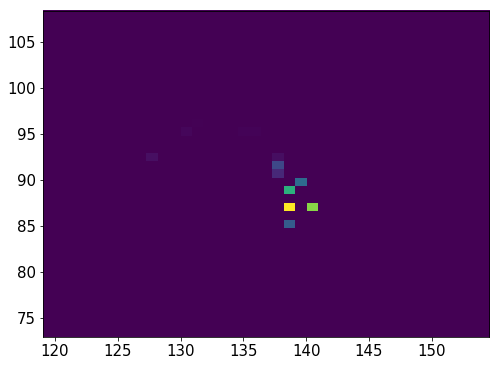

9393    24
9394    24
9395    24
9396    24
9397    24
9398    24
9399    24
9400    24
9401    24
9402    24
9403    24
9404    24
9405    24
9406    24
9407    24
9408    24
9409    24
9417     2
9418     2
9419     2
9420     2
9421     2
Name: Nsipm, dtype: uint16


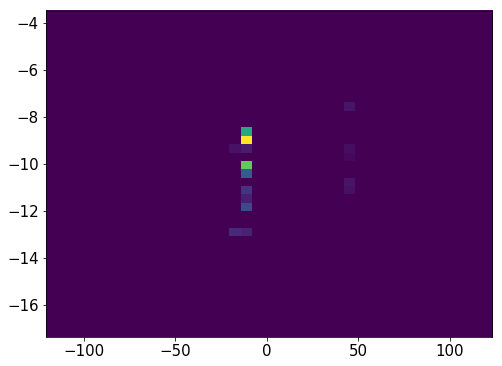

1391    30
1392    30
1393    30
1394    30
1395    30
1396    30
1397    30
1398    30
1399    30
1400    30
1401    30
1402    30
1403    30
1404    30
1405    30
1406    30
Name: Nsipm, dtype: uint16


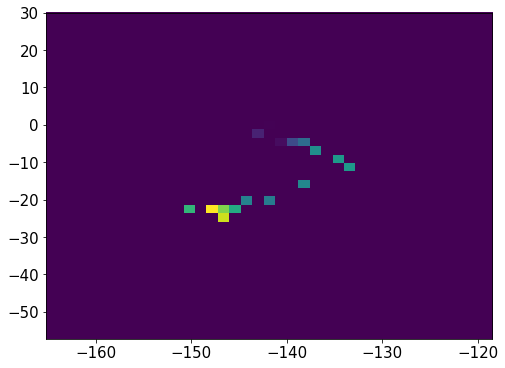

9426    21
9427    21
9428    21
9429    21
9430    21
9431    21
9432    21
9433    21
9434    21
9435    21
9436    21
9437    21
9438    21
9439    21
9440    21
9441    21
9442    21
9443    21
9444    21
9445    21
9446    21
Name: Nsipm, dtype: uint16


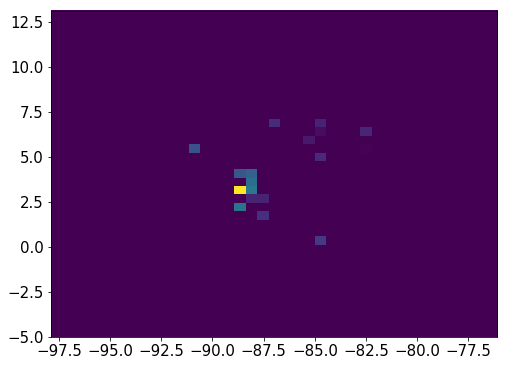

9451    44
9452    44
9453    44
9454    44
9455    44
9456    44
9457    44
9458    44
9459    44
9460    44
9461    44
9462    44
9463    44
9464    44
9465    44
9466    44
9467    44
Name: Nsipm, dtype: uint16


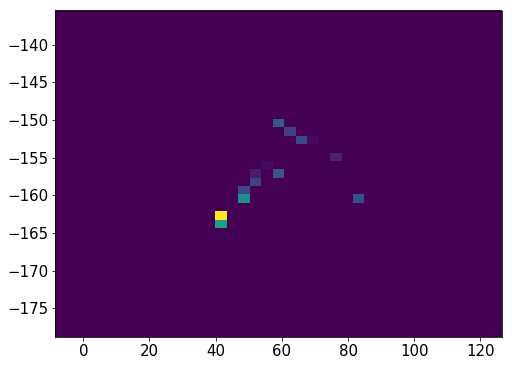

942585    25
942586    25
942587    25
942588    25
942589    25
942590    25
942591    25
942592    25
942593    25
942594    25
942595    25
942596    25
942597    25
942598    25
942599    25
942600    25
942601    25
942602    25
942603    25
942606    25
942607    25
942608    25
942609    25
942610    25
942611    25
Name: Nsipm, dtype: uint16


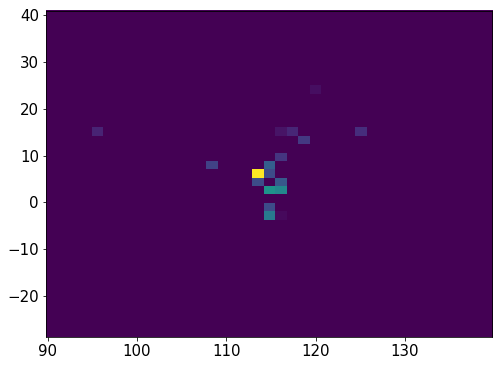

9471    28
9472    28
9473    28
9474    28
9475    28
9476    28
9477    28
9478    28
9479    28
9480    28
9481    28
9482    28
9483    28
9484    28
9485    28
9486    28
9487    28
9488    28
9489    28
Name: Nsipm, dtype: uint16


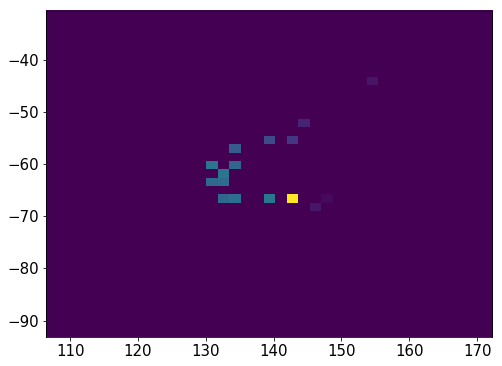

9493    32
9494    32
9495    32
9496    32
9497    32
9498    32
9499    32
9500    32
9501    32
9502    32
9503    32
9507     7
9508     7
9509     7
9510     7
9511     7
9512     7
Name: Nsipm, dtype: uint16


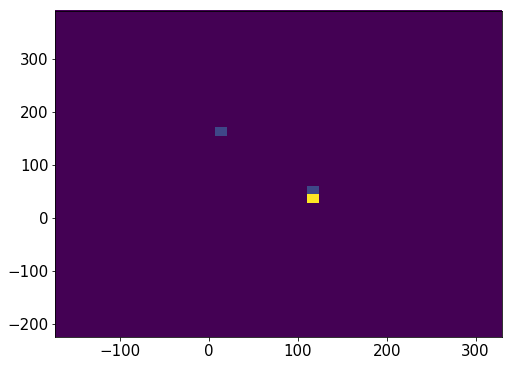

9516    42
9517    42
9518    42
9519    42
9520    42
9521    42
9522    42
9523    42
9524    42
9525    42
9526    42
9527    42
9528    42
9529    42
9530    42
Name: Nsipm, dtype: uint16


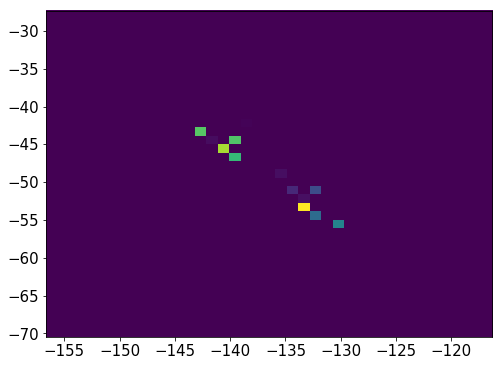

1664610    28
1664611    28
1664612    28
1664613    28
1664614    28
1664615    28
1664616    28
1664617    28
1664618    28
1664619    28
1664620    28
1664621    28
1664622    28
Name: Nsipm, dtype: uint16


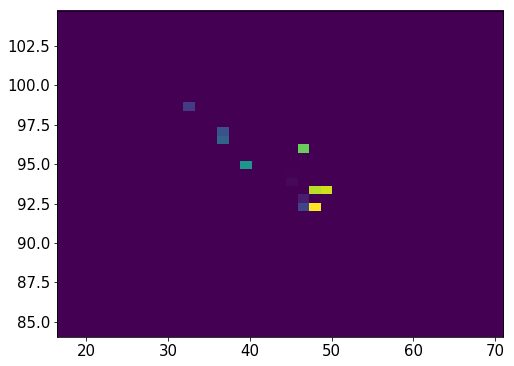

942643    27
942644    27
942645    27
942646    27
942647    27
942648    27
942649    27
942650    27
942651    27
942652    27
942653    27
942654    27
942655    27
942658    27
942659    27
942660    27
942661    27
942662    27
942663    27
942664    27
Name: Nsipm, dtype: uint16


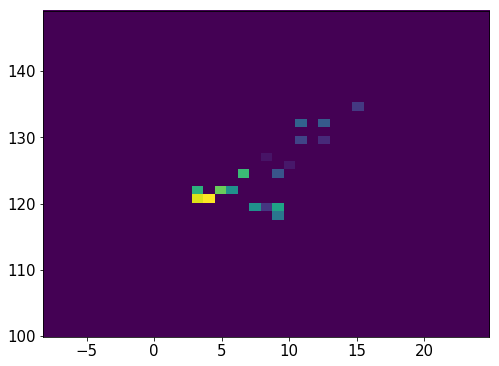

9535    28
9536    28
9537    28
9538    28
9539    28
9540    28
9541    28
9542    28
9543    28
9544    28
9545    28
9546    28
9547    28
9548    28
9549    28
Name: Nsipm, dtype: uint16


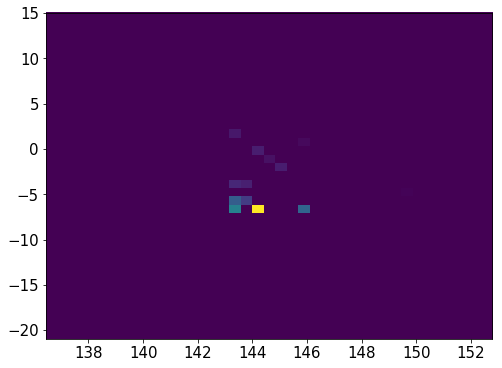

9554    26
9555    26
9556    26
9557    26
9558    26
9559    26
9560    26
9561    26
9562    26
9563    26
9564    26
9565    26
Name: Nsipm, dtype: uint16


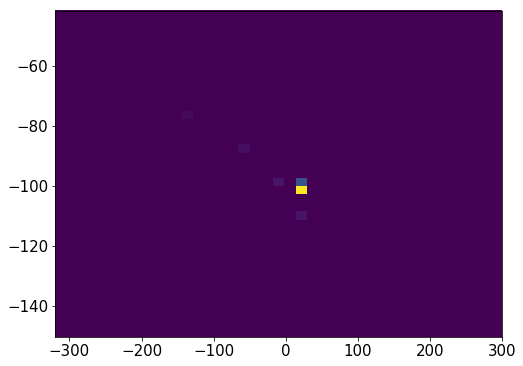

1664627    27
1664628    27
1664629    27
1664630    27
1664631    27
1664632    27
1664633    27
1664634    27
1664635    27
1664636    27
1664637    27
1664638    27
1664639    27
1664640    27
1664641    27
1664642    27
1664643    27
1664644    27
1664645    27
Name: Nsipm, dtype: uint16


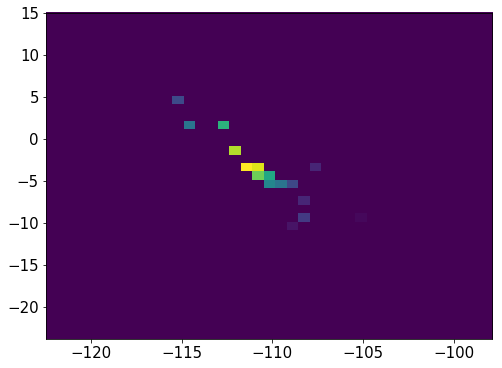

942668    26
942669    26
942670    26
942671    26
942672    26
942673    26
942674    26
942675    26
942676    26
942677    26
942678    26
942679    26
942680    26
942681    26
942682    26
942683    26
942684    26
942685    26
942686    26
942687    26
942688    26
942693     2
942694     2
942695     2
942696     2
942697     2
942698     2
Name: Nsipm, dtype: uint16


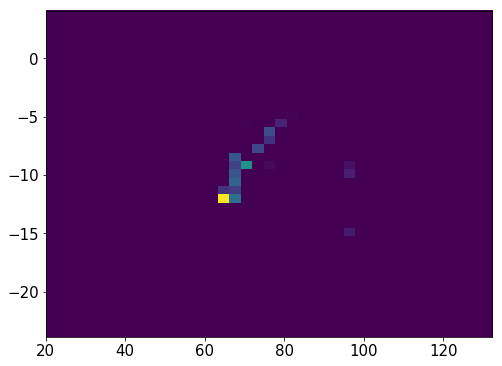

9570    27
9573    27
9574    27
9575    27
9576    27
9577    27
9578    27
9579    27
9580    27
9581    27
9582    27
9583    27
9584    27
9585    27
9586    27
9587    27
9588    27
9589    27
9590    27
9591    27
9592    27
9593    27
9594    27
9595    27
Name: Nsipm, dtype: uint16


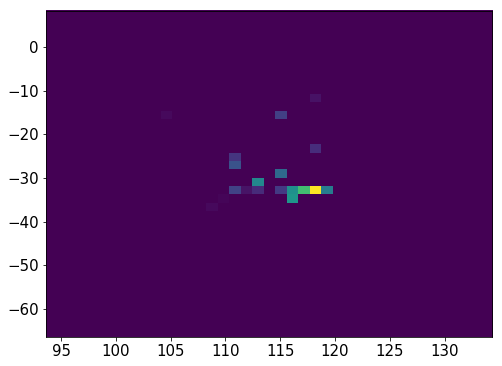

9596    19
9597    19
9598    19
9599    19
9600    19
9601    19
9602    19
9603    19
9604    19
9605    19
9606    19
9608    19
9609    19
9610    19
9611    19
9612    19
9613    19
9614    19
9615    19
9616    19
9617    19
Name: Nsipm, dtype: uint16


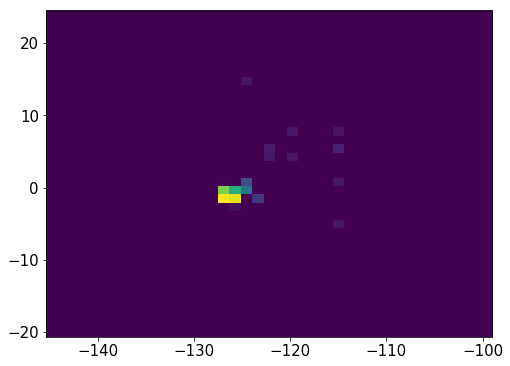

942704    24
942705    24
942706    24
942707    24
942708    24
942709    24
942710    24
942711    24
942712    24
942713    24
942714    24
Name: Nsipm, dtype: uint16


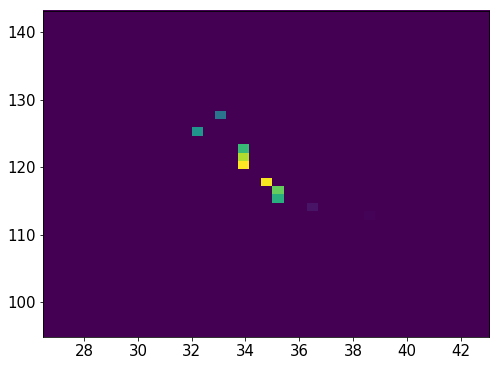

942719    27
942720    27
942721    27
942722    27
942723    27
942724    27
942725    27
942726    27
942727    27
942728    27
942729    27
942730    27
942731    27
942732    27
942733    27
942734    27
942735    27
Name: Nsipm, dtype: uint16


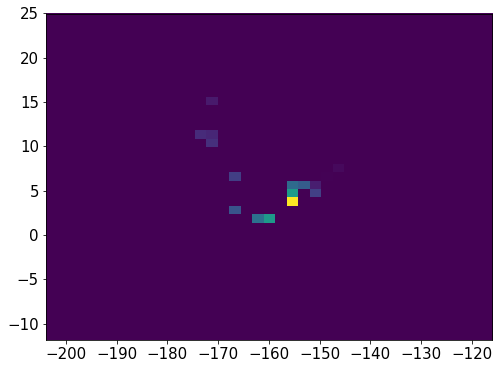

942739    23
942740    23
942741    23
942742    23
942743    23
942744    23
942745    23
942746    23
942747    23
942748    23
942749    23
942750    23
942751    23
942752    23
942753    23
942754    23
942755    23
942756    23
942757    23
942758    23
942759    23
942760    23
942761    23
942762    23
942763    23
Name: Nsipm, dtype: uint16


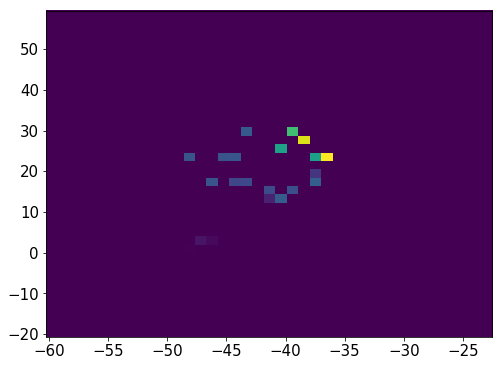

942768    30
942769    30
942770    30
942771    30
942772    30
942773    30
942774    30
942775    30
942776    30
942777    30
942778    30
942779    30
942780    30
942781    30
942782    30
942783    30
942784    30
942785    30
942786    30
Name: Nsipm, dtype: uint16


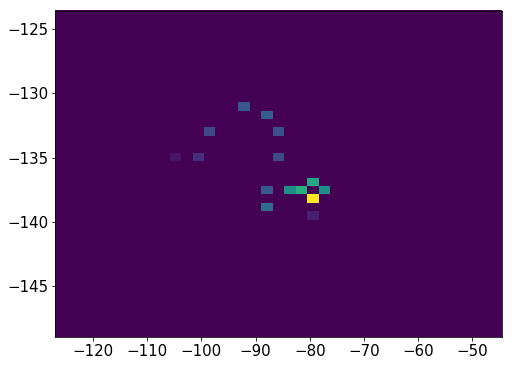

9622    27
9623    27
9624    27
9625    27
9626    27
9627    27
9628    27
9629    27
9630    27
9634    10
9635    10
9636    10
9637    10
9638    10
9639    10
9640    10
9641    10
9642    10
Name: Nsipm, dtype: uint16


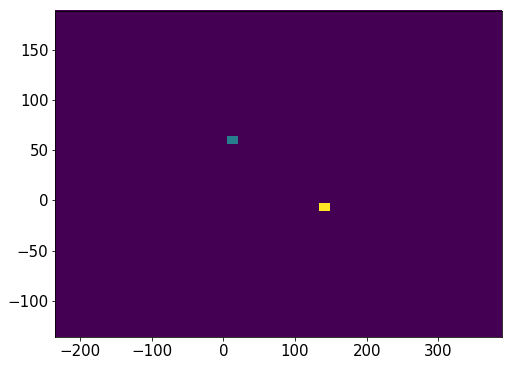

9647    27
9648    27
9649    27
9650    27
9651    27
9652    27
9653    27
9654    27
9655    27
9656    27
9657    27
9658    27
9659    27
9660    27
9661    27
9662    27
9663    27
9664    27
Name: Nsipm, dtype: uint16


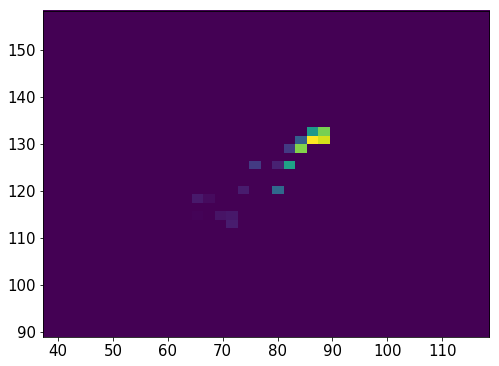

9668    33
9669    33
9670    33
9671    33
9672    33
9673    33
9674    33
9675    33
9676    33
Name: Nsipm, dtype: uint16


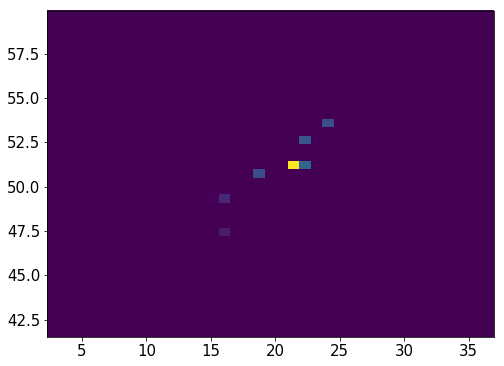

942809    26
942810    26
942811    26
942812    26
942813    26
942814    26
942815    26
942816    26
942817    26
942818    26
942819    26
942820    26
942821    26
942822    26
942823    26
942824    26
942825    26
942826    26
942827    26
942828    26
Name: Nsipm, dtype: uint16


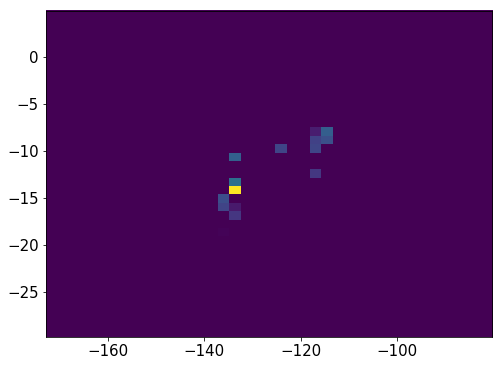

9680    26
9681    26
9682    26
9683    26
9684    26
9685    26
9686    26
9687    26
9688    26
9689    26
9690    26
9691    26
9692    26
9693    26
9694    26
9695    26
9696    26
9697    26
9698    26
Name: Nsipm, dtype: uint16


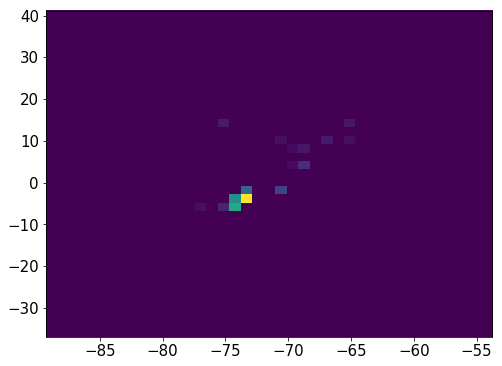

9702    21
9703    21
9704    21
9705    21
9706    21
9707    21
9708    21
9709    21
9710    21
9711    21
9712    21
9713    21
9714    21
9715    21
9721     1
9722     1
9723     1
9724     1
Name: Nsipm, dtype: uint16


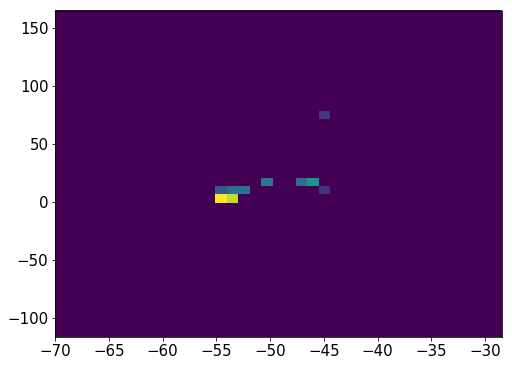

942857    20
942858    20
942859    20
942860    20
942861    20
942862    20
942863    20
942864    20
942865    20
942866    20
942867    20
942868    20
942869    20
942870    20
942874     4
942875     4
942876     4
942877     4
942878     4
942879     4
942883    12
942884    12
942885    12
942886    12
942887    12
942888    12
942889    12
942890    12
942891    12
942892    12
942893    12
Name: Nsipm, dtype: uint16


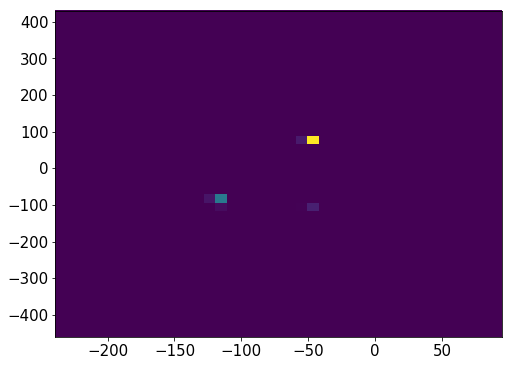

9730    20
9731    20
9732    20
9733    20
9734    20
9735    20
9736    20
9737    20
9738    20
9739    20
9740    20
9741    20
9742    20
9743    20
9744    20
Name: Nsipm, dtype: uint16


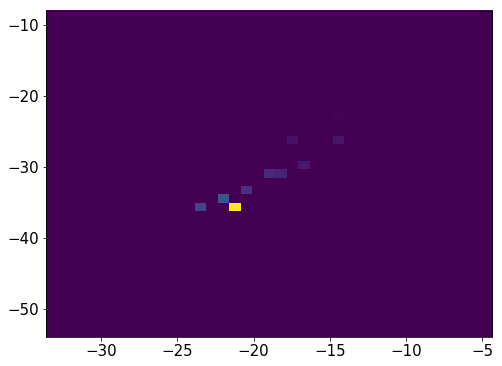

942898    32
942899    32
942900    32
942901    32
942902    32
942903    32
942904    32
942905    32
942906    32
942907    32
942908    32
942909    32
Name: Nsipm, dtype: uint16


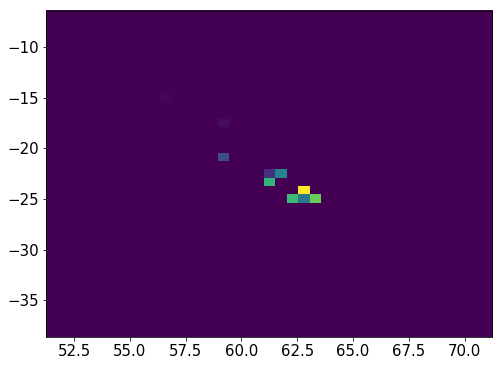

942914    23
942915    23
942916    23
942917    23
942918    23
942919    23
942920    23
942921    23
942922    23
942923    23
942924    23
942925    23
942926    23
942927    23
942928    23
942930    23
942932    23
942933    23
942935    23
942937    23
942938    23
942946    23
942951    23
Name: Nsipm, dtype: uint16


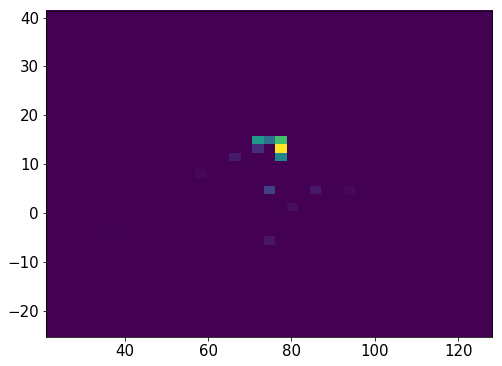

942957    33
942958    33
942959    33
942960    33
942961    33
942962    33
942963    33
942964    33
942965    33
942966    33
942967    33
942968    33
942969    33
942970    33
942971    33
942972    33
942973    33
Name: Nsipm, dtype: uint16


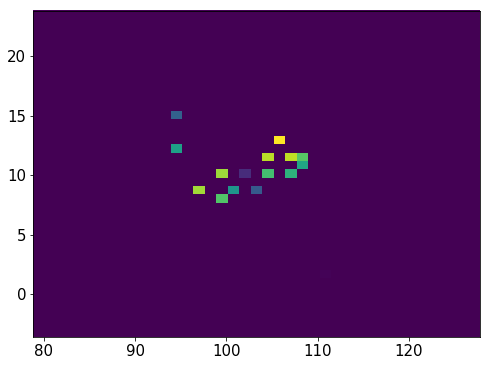

942977    35
942978    35
942979    35
942980    35
942981    35
942982    35
942983    35
942984    35
942985    35
942986    35
942987    35
942988    35
942989    35
942990    35
Name: Nsipm, dtype: uint16


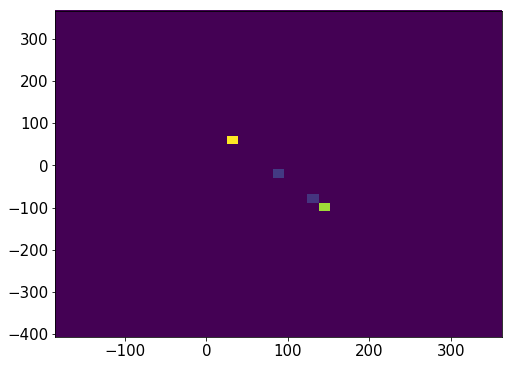

942994    28
942996    28
942997    28
942998    28
942999    28
943000    28
943001    28
943002    28
943003    28
943004    28
943005    28
943006    28
943007    28
943008    28
943009    28
943010    28
Name: Nsipm, dtype: uint16


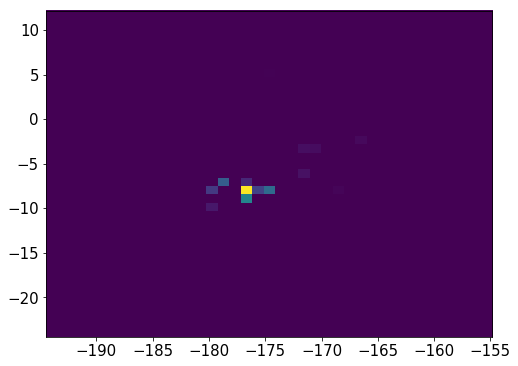

943014    23
943015    23
943016    23
943017    23
943018    23
943019    23
943020    23
943021    23
943022    23
943023    23
943024    23
943025    23
943026    23
943027    23
943028    23
943029    23
943030    23
943031    23
943033    23
943034    23
943035    23
943036    23
943037    23
943038    23
943039    23
943040    23
943041    23
Name: Nsipm, dtype: uint16


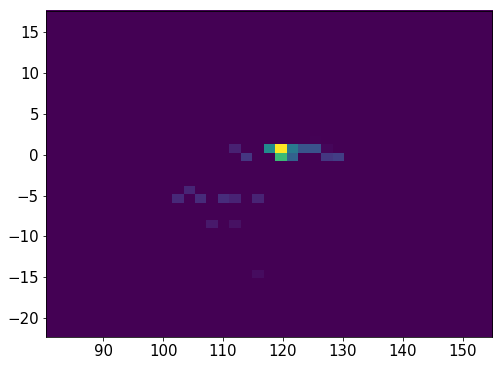

9749    28
9750    28
9751    28
9752    28
9753    28
9754    28
9755    28
9756    28
9760    10
9761    10
9762    10
9763    10
9764    10
9765    10
9766    10
9767    10
9768    10
Name: Nsipm, dtype: uint16


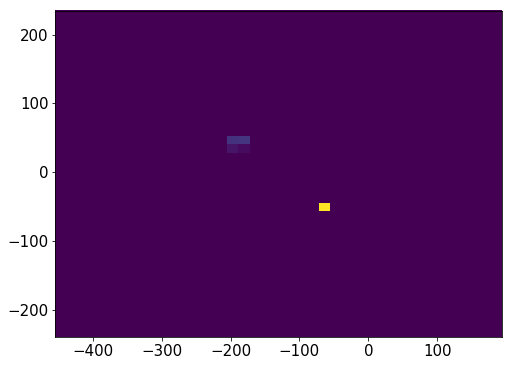

9773    30
9774    30
9775    30
9776    30
9777    30
9778    30
9779    30
9780    30
9781    30
9782    30
9783    30
9784    30
9785    30
9786    30
9787    30
9788    30
9789    30
9790    30
9791    30
9792    30
9793    30
9794    30
9795    30
9796    30
Name: Nsipm, dtype: uint16


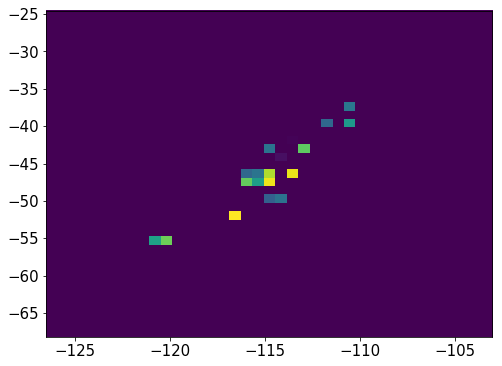

943047    41
943048    41
943049    41
943050    41
943051    41
943052    41
943053    41
943054    41
943055    41
943056    41
943057    41
943058    41
943059    41
943061    41
943062    41
943063    41
943064    41
943065    41
943066    41
943067    41
943068    41
943069    41
943070    41
943071    41
943072    41
Name: Nsipm, dtype: uint16


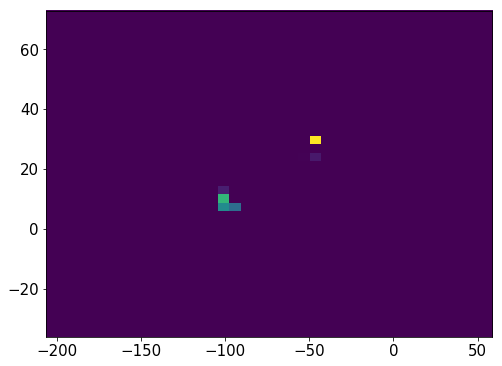

943076    27
943077    27
943078    27
943079    27
943080    27
943081    27
943082    27
943083    27
943084    27
943085    27
943086    27
943087    27
943088    27
Name: Nsipm, dtype: uint16


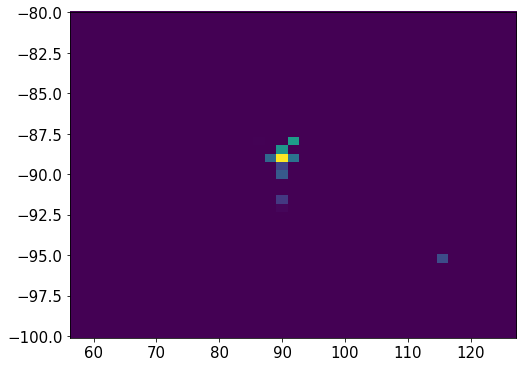

9801    24
9802    24
9803    24
9804    24
9805    24
9806    24
9807    24
9808    24
9809    24
9810    24
9811    24
9812    24
9813    24
9814    24
9815    24
9816    24
9817    24
9818    24
9819    24
9820    24
9821    24
9822    24
Name: Nsipm, dtype: uint16


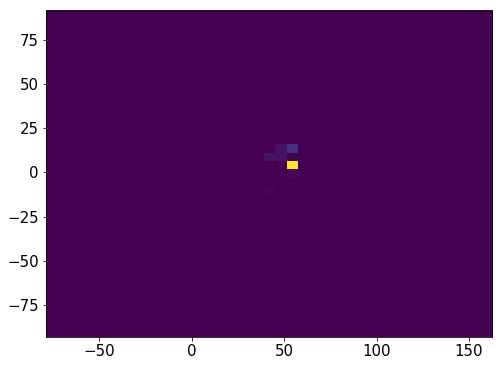

9823    23
9824    23
9825    23
9826    23
9827    23
9828    23
9829    23
9830    23
9831    23
9832    23
9833    23
9834    23
9835    23
9836    23
9837    23
9838    23
9839    23
Name: Nsipm, dtype: uint16


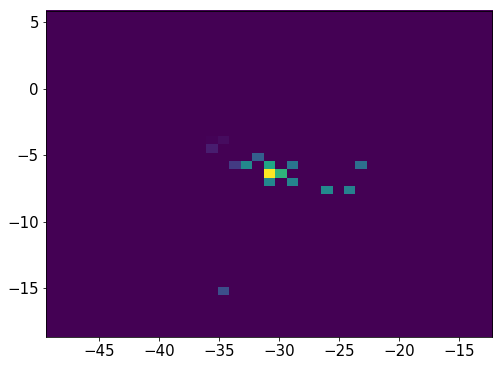

9844    23
9845    23
9846    23
9847    23
9848    23
9849    23
9850    23
9851    23
9852    23
9853    23
9856    23
9858    23
9859    23
9860    23
9862    23
Name: Nsipm, dtype: uint16


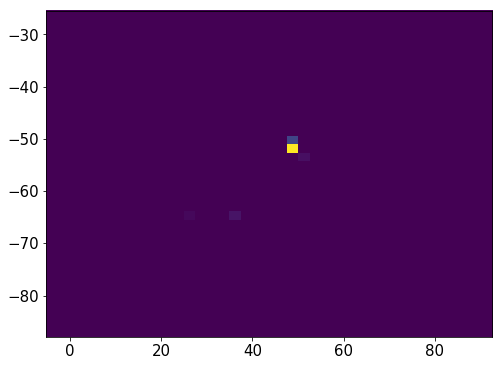

943111    19
943112    19
943113    19
943114    19
943115    19
943116    19
943117    19
943118    19
943119    19
943120    19
943121    19
943122    19
943123    19
943124    19
943125    19
943130     2
943131     2
943132     2
943133     2
943134     2
943135     2
943139     9
943140     9
943141     9
943142     9
943143     9
943144     9
943145     9
943146     9
943147     9
943153     1
943154     1
943155     1
943156     1
943157     1
Name: Nsipm, dtype: uint16


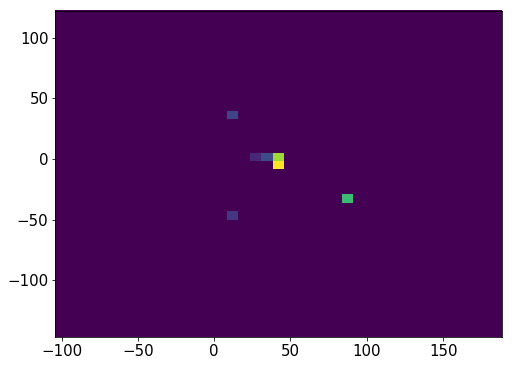

9866    34
9867    34
9868    34
9869    34
9870    34
9871    34
9872    34
9873    34
9874    34
9875    34
9876    34
9877    34
9878    34
9879    34
9880    34
9881    34
Name: Nsipm, dtype: uint16


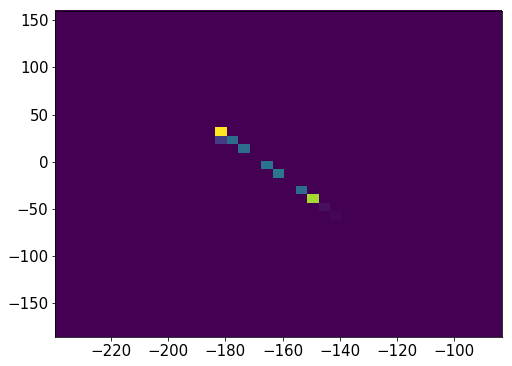

9886    20
9887    20
9888    20
9889    20
9890    20
9891    20
9892    20
9893    20
9894    20
9895    20
9896    20
9897    20
9898    20
9899    20
9900    20
9901    20
9902    20
9903    20
9904    20
Name: Nsipm, dtype: uint16


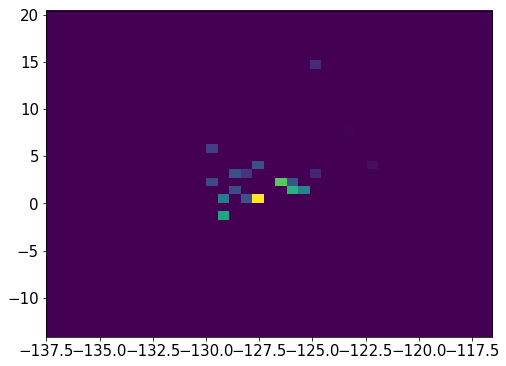

9911    35
9912    35
9913    35
9914    35
9915    35
9916    35
9917    35
9918    35
9919    35
9920    35
9921    35
9922    35
9923    35
9924    35
9929     1
9930     1
9931     1
9932     1
Name: Nsipm, dtype: uint16


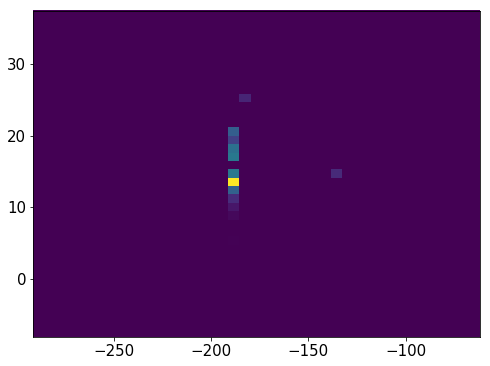

9938    38
9939    38
9940    38
9941    38
9942    38
9943    38
9944    38
9945    38
9946    38
9947    38
9948    38
9949    38
9950    38
9951    38
9952    38
9957    23
9958    23
9959    23
9960    23
9961    23
9962    23
9963    23
9964    23
9965    23
9966    23
9967    23
9968    23
9969    23
9970    23
9971    23
9972    23
9973    23
9974    23
9975    23
9976    23
Name: Nsipm, dtype: uint16


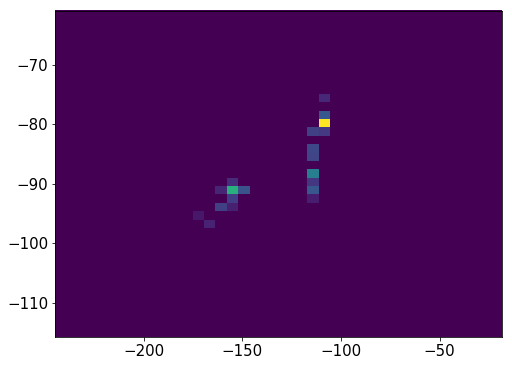

9980     23
9981     23
9982     23
9983     23
9984     23
9985     23
9986     23
9987     23
9988     23
9993     15
9994     15
9995     15
9996     15
9997     15
9998     15
9999     15
10000    15
10001    15
10002    15
10003    15
10004    15
10005    15
Name: Nsipm, dtype: uint16


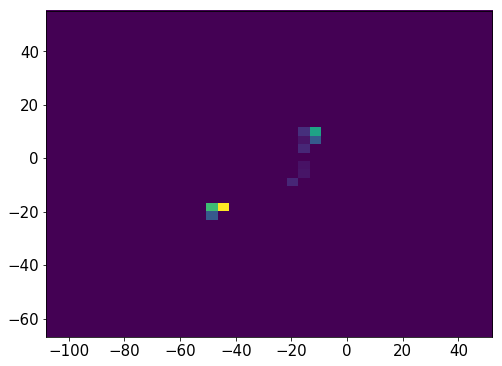

10009    23
10011    23
10012    23
10013    23
10014    23
10015    23
10016    23
10017    23
10018    23
10019    23
10020    23
10021    23
10022    23
10023    23
10024    23
10025    23
10026    23
10027    23
Name: Nsipm, dtype: uint16


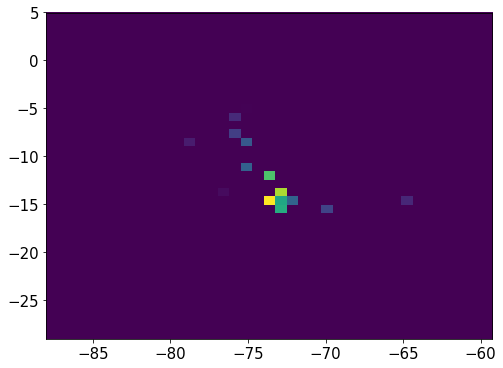

943184    27
943185    27
943186    27
943187    27
943188    27
943189    27
943190    27
943191    27
943192    27
943193    27
943194    27
943195    27
943196    27
943197    27
943198    27
943199    27
943205    11
943206    11
943207    11
943208    11
943209    11
943210    11
943211    11
943212    11
943213    11
943214    11
943215    11
943216    11
943217    11
943218    11
943219    11
Name: Nsipm, dtype: uint16


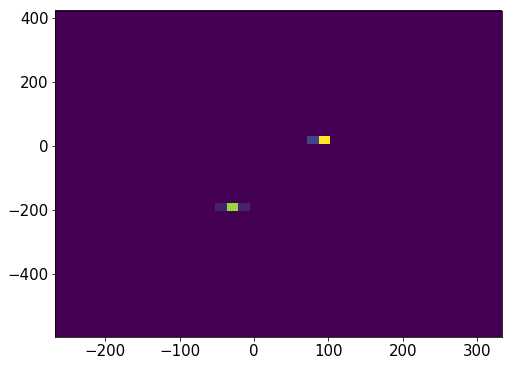

570328    30
570329    30
570330    30
570331    30
570332    30
570333    30
570334    30
570335    30
570336    30
570337    30
570338    30
570339    30
570340    30
570341    30
570342    30
570343    30
570344    30
570345    30
570346    30
570347    30
570348    30
570349    30
570350    30
570352    30
570353    30
570354    30
570355    30
570356    30
570357    30
570358    30
570359    30
Name: Nsipm, dtype: uint16


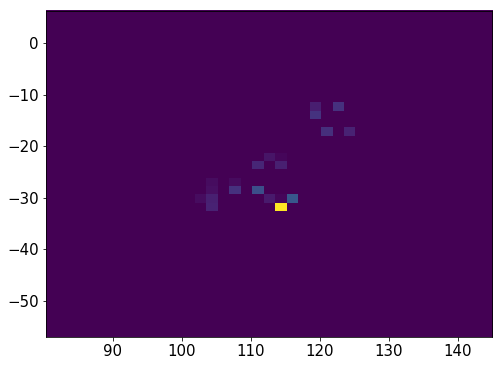

943224    35
943225    35
943226    35
943227    35
943228    35
943229    35
943230    35
943231    35
943232    35
943233    35
943234    35
943235    35
943236    35
943237    35
943238    35
943239    35
943240    35
943241    35
943242    35
943243    35
Name: Nsipm, dtype: uint16


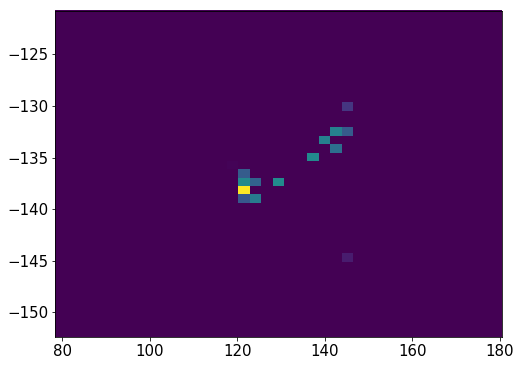

943247    24
943248    24
943249    24
943250    24
943251    24
943252    24
943253    24
943254    24
943255    24
943256    24
943257    24
943258    24
943259    24
943260    24
943261    24
943262    24
943263    24
Name: Nsipm, dtype: uint16


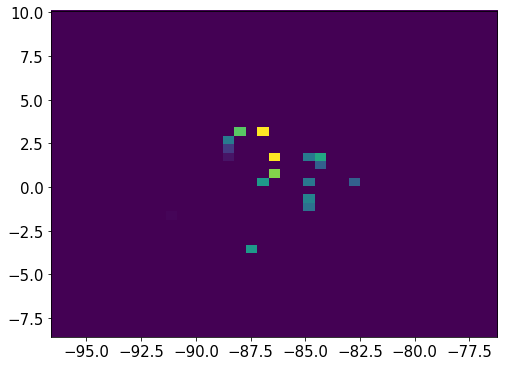

10032    37
10033    37
10034    37
10035    37
10036    37
10037    37
10038    37
10039    37
10040    37
10041    37
10042    37
10043    37
10044    37
10045    37
10046    37
Name: Nsipm, dtype: uint16


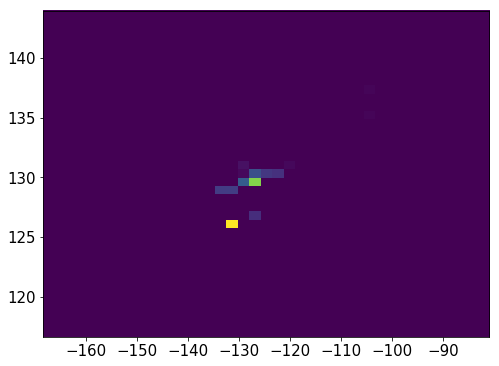

943268    22
943269    22
943270    22
943271    22
943272    22
943273    22
943274    22
943275    22
943276    22
943277    22
943278    22
943279    22
943280    22
943281    22
943282    22
943283    22
943284    22
943285    22
943286    22
943287    22
943288    22
943289    22
Name: Nsipm, dtype: uint16


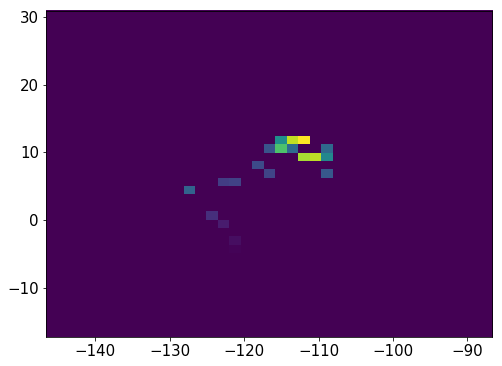

10052    26
10053    26
10054    26
10055    26
10056    26
10057    26
10058    26
10059    26
10060    26
10061    26
10062    26
Name: Nsipm, dtype: uint16


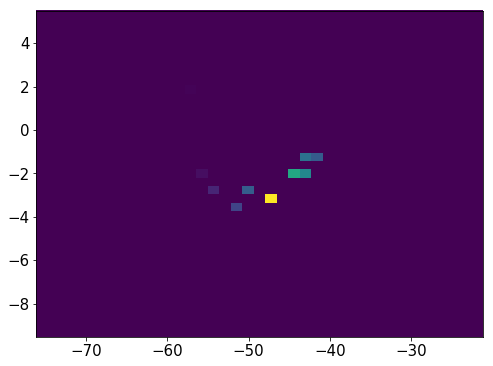

10067    20
10068    20
10069    20
10070    20
10071    20
10072    20
10073    20
10074    20
10075    20
10076    20
10077    20
10078    20
10079    20
10080    20
10081    20
10082    20
10083    20
10084    20
10085    20
10086    20
Name: Nsipm, dtype: uint16


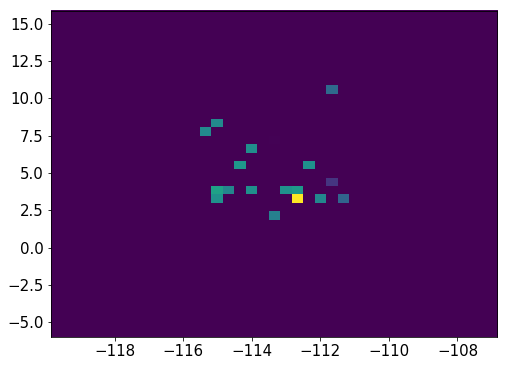

943319    27
943320    27
943321    27
943322    27
943323    27
943324    27
943325    27
943326    27
943327    27
943328    27
943329    27
943330    27
943331    27
943332    27
943333    27
943334    27
943335    27
943336    27
943337    27
943338    27
943339    27
943340    27
943341    27
943342    27
943343    27
Name: Nsipm, dtype: uint16


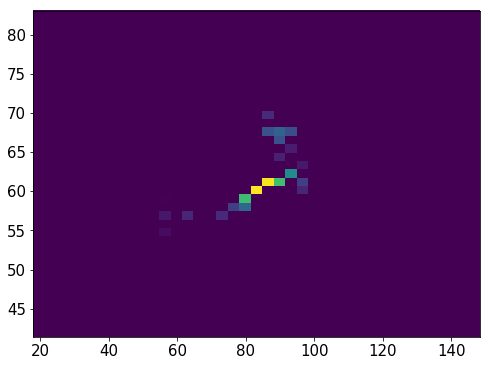

10091    28
10092    28
10093    28
10094    28
10095    28
10096    28
10097    28
10098    28
10099    28
10100    28
10101    28
10102    28
10103    28
10104    28
10105    28
10106    28
10107    28
10108    28
Name: Nsipm, dtype: uint16


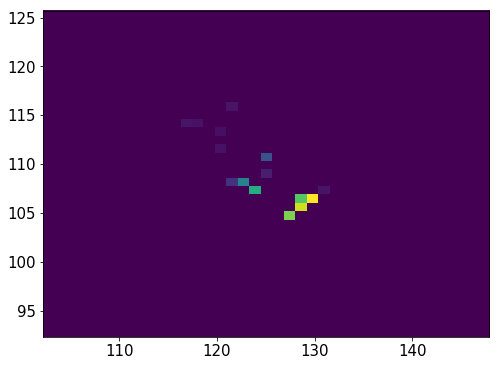

10110    30
10111    30
10112    30
10113    30
10114    30
10115    30
10116    30
10117    30
10118    30
10119    30
10120    30
10121    30
10122    30
10123    30
10124    30
10125    30
10126    30
10127    30
10128    30
10129    30
10130    30
10131    30
Name: Nsipm, dtype: uint16


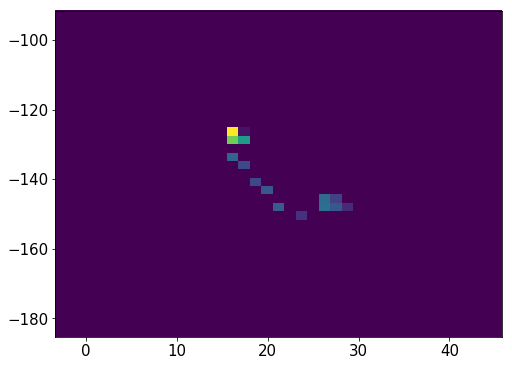

943348    23
943349    23
943350    23
943351    23
943352    23
943353    23
943354    23
943355    23
943356    23
943357    23
943358    23
943359    23
943360    23
943361    23
943362    23
943363    23
943364    23
943365    23
943366    23
Name: Nsipm, dtype: uint16


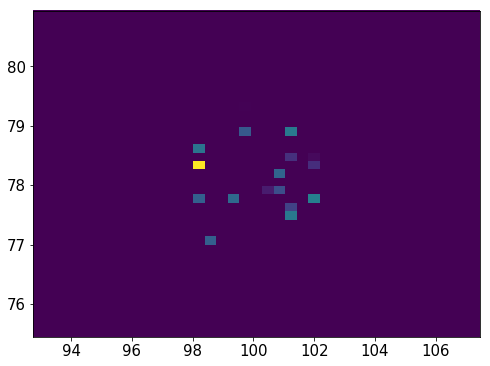

943374    25
943375    25
943376    25
943377    25
943378    25
943379    25
943380    25
943381    25
943382    25
943383    25
943384    25
943385    25
943386    25
943387    25
943388    25
943389    25
943390    25
943391    25
943392    25
943393    25
943394    25
943395    25
943396    25
Name: Nsipm, dtype: uint16


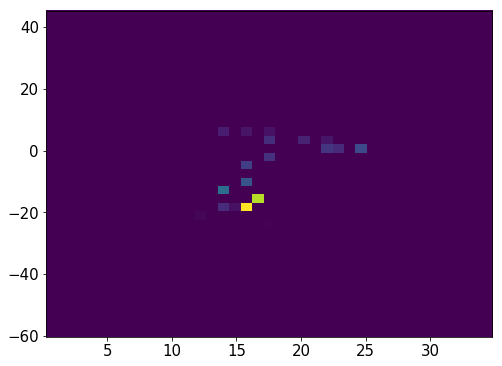

943402    24
943403    24
943404    24
943405    24
943406    24
943407    24
943408    24
943409    24
943410    24
943411    24
943412    24
943413    24
943414    24
943415    24
943416    24
943417    24
943418    24
943419    24
943420    24
943428     7
943429     7
943430     7
943431     7
943432     7
943433     7
943434     7
943435     7
943436     7
Name: Nsipm, dtype: uint16


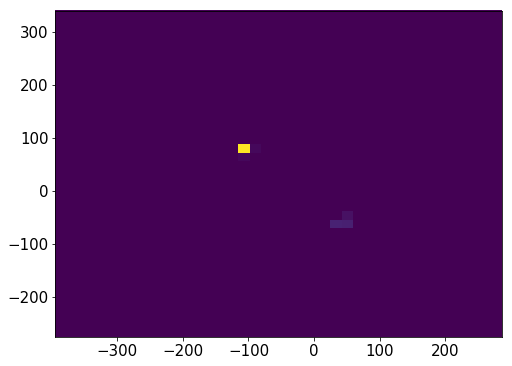

10212    25
10213    25
10214    25
10215    25
10216    25
10217    25
10218    25
10219    25
10220    25
10221    25
10222    25
10223    25
10224    25
10225    25
10226    25
10227    25
Name: Nsipm, dtype: uint16


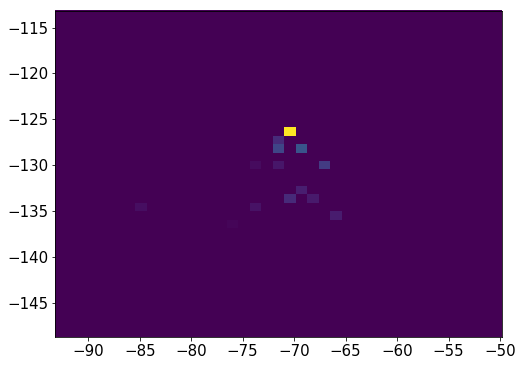

943441    27
943442    27
943443    27
943444    27
943445    27
943446    27
943447    27
943448    27
943449    27
943450    27
943451    27
943452    27
943453    27
943454    27
943455    27
943456    27
943457    27
943458    27
943459    27
943460    27
Name: Nsipm, dtype: uint16


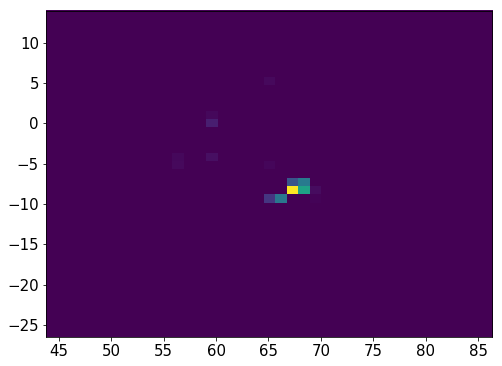

10245    23
10246    23
10247    23
10248    23
10249    23
10250    23
10251    23
10252    23
10253    23
10254    23
10255    23
10256    23
10257    23
10258    23
10259    23
10260    23
10261    23
Name: Nsipm, dtype: uint16


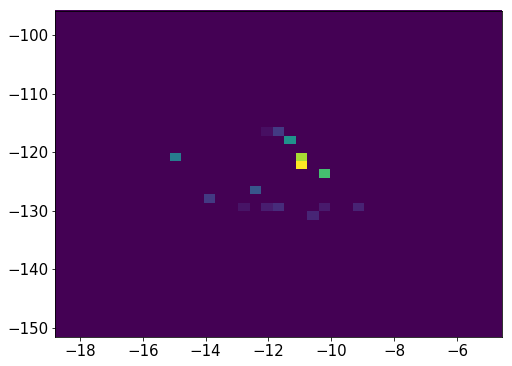

10262    17
10263    17
10264    17
10265    17
10266    17
10267    17
10268    17
10269    17
10270    17
10271    17
10272    17
10273    17
10278    14
10279    14
10280    14
10281    14
10282    14
10283    14
10284    14
10285    14
10286    14
10287    14
10288    14
10289    14
Name: Nsipm, dtype: uint16


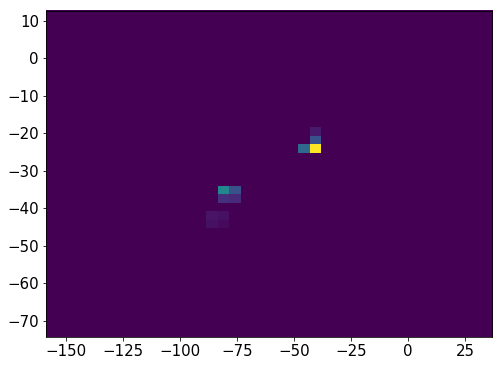

10293    18
10294    18
10295    18
10296    18
10297    18
10298    18
10299    18
10300    18
10301    18
10302    18
10303    18
10304    18
10305    18
10306    18
10307    18
10308    18
10309    18
10310    18
10311    18
10312    18
10313    18
Name: Nsipm, dtype: uint16


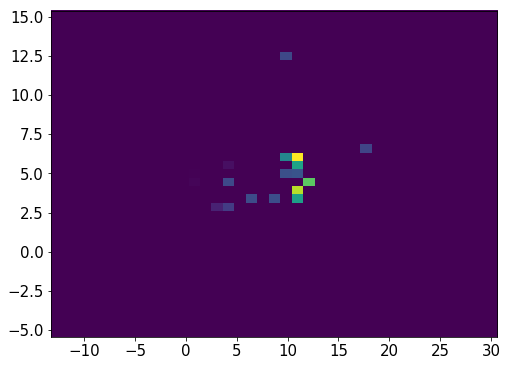

943477    25
943478    25
943479    25
943480    25
943481    25
943482    25
943483    25
943484    25
943485    25
943486    25
943487    25
943488    25
943489    25
943490    25
943491    25
943492    25
943493    25
943494    25
943495    25
Name: Nsipm, dtype: uint16


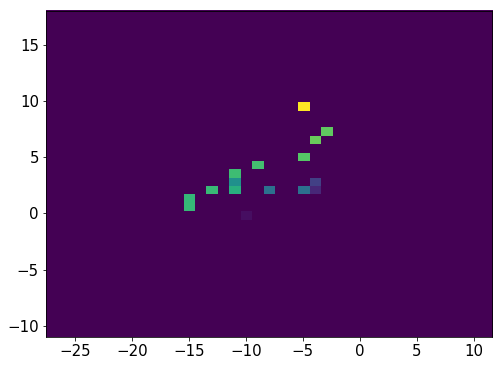

1664908    32
1664909    32
1664910    32
1664915    32
1664916    32
1664917    32
1664918    32
1664919    32
1664920    32
1664921    32
1664922    32
1664923    32
1664924    32
1664925    32
1664926    32
Name: Nsipm, dtype: uint16


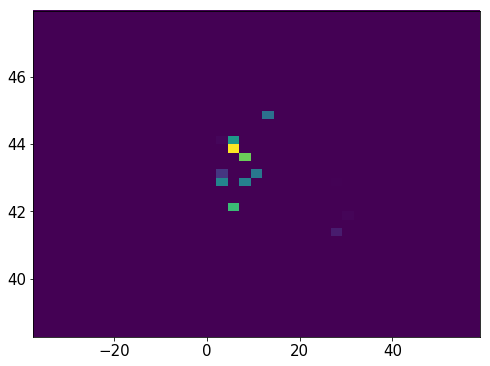

933610    25
933611    25
933612    25
933613    25
933614    25
933615    25
933616    25
933617    25
933618    25
933619    25
933639     6
933641     6
933642     6
933643     6
933644     6
933645     6
933646     6
933647     6
933648     6
933649     6
933654     1
933655     1
933656     1
933657     1
933658     1
933659     1
Name: Nsipm, dtype: uint16


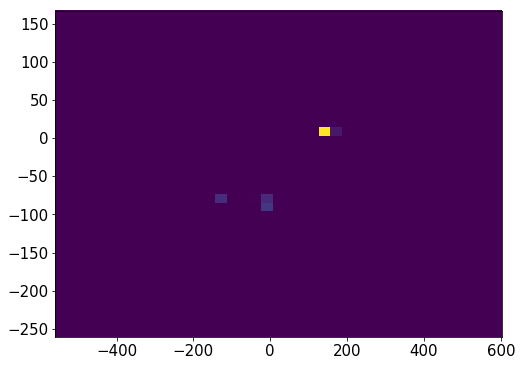

1900100    30
1900101    30
1900102    30
1900103    30
1900104    30
1900105    30
1900106    30
1900107    30
1900108    30
1900109    30
1900110    30
1900111    30
1900112    30
1900113    30
1900114    30
1900115    30
1900116    30
1900117    30
1900118    30
1900119    30
1900120    30
1900121    30
1900122    30
1900123    30
1900124    30
1900125    30
1900126    30
1900127    30
1900128    30
1900129    30
1900130    30
1900131    30
1900132    30
1900133    30
1900134    30
1900135    30
1900136    30
1900137    30
Name: Nsipm, dtype: uint16


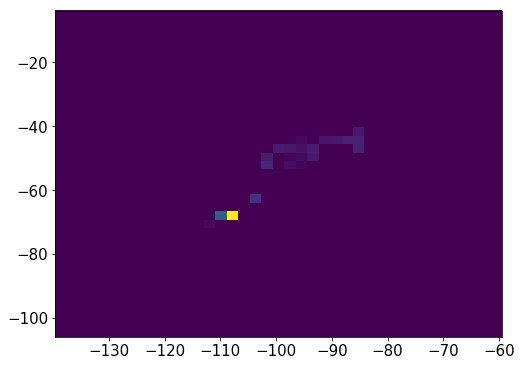

10319    30
10320    30
10321    30
10322    30
10323    30
10324    30
10325    30
10326    30
10327    30
10328    30
10329    30
10330    30
10331    30
10332    30
10333    30
10334    30
10335    30
10336    30
10337    30
10338    30
10339    30
10340    30
10341    30
10342    30
Name: Nsipm, dtype: uint16


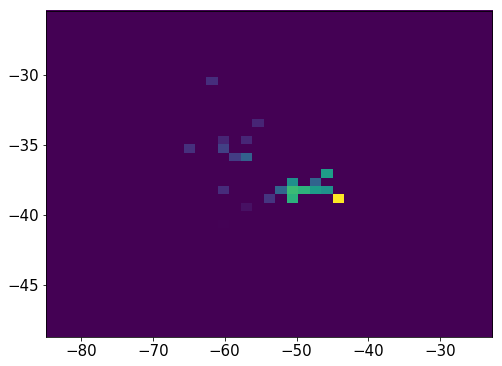

943500    28
943501    28
943502    28
943503    28
943504    28
943505    28
943506    28
943507    28
943508    28
943509    28
943510    28
943511    28
943512    28
943513    28
943514    28
943515    28
943516    28
943517    28
943518    28
943519    28
943520    28
943521    28
Name: Nsipm, dtype: uint16


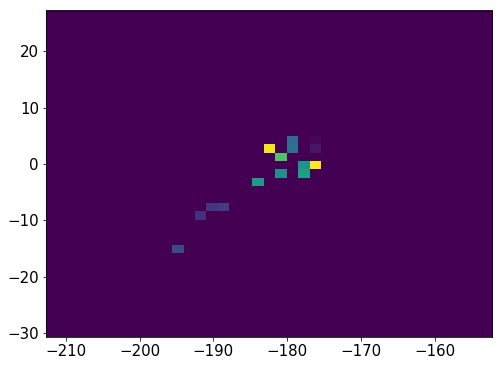

10346    30
10347    30
10348    30
10349    30
10350    30
10351    30
10352    30
10353    30
10354    30
10355    30
10356    30
10357    30
10358    30
10359    30
10360    30
10361    30
10362    30
Name: Nsipm, dtype: uint16


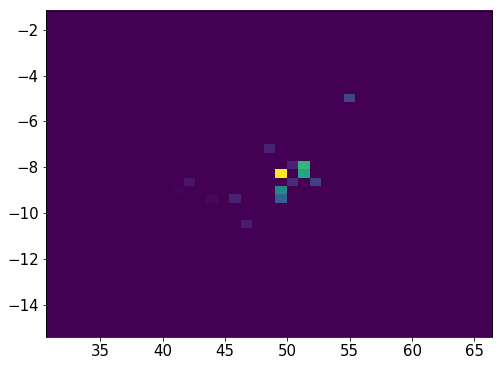

943526    25
943527    25
943528    25
943529    25
943530    25
943531    25
943532    25
943533    25
943534    25
943535    25
943536    25
943537    25
943538    25
943539    25
943540    25
943546    12
943547    12
943548    12
943549    12
943550    12
943551    12
943552    12
943553    12
943554    12
943555    12
943556    12
943557    12
943558    12
943559    12
943565     3
943566     3
943567     3
943568     3
943569     3
943570     3
943571     3
Name: Nsipm, dtype: uint16


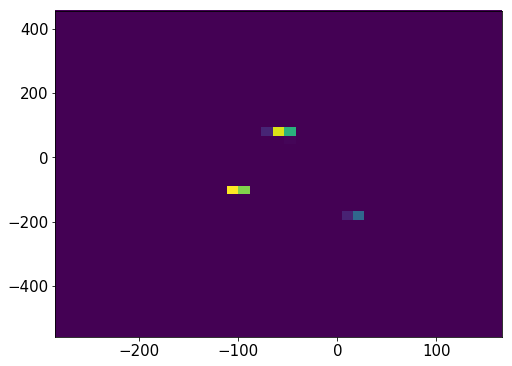

943586    18
943587    18
943588    18
943589    18
943590    18
943591    18
943592    18
943593    18
943594    18
943595    18
943596    18
943597    18
Name: Nsipm, dtype: uint16


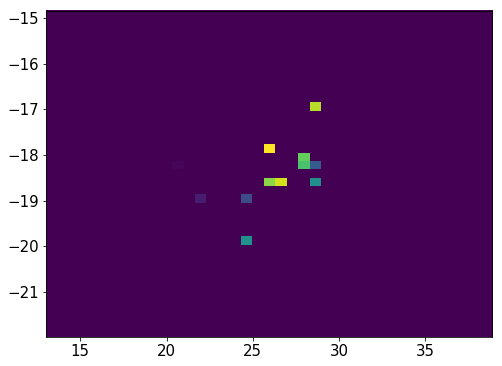

10367    22
10368    22
10369    22
10370    22
10371    22
10372    22
10373    22
10374    22
10375    22
10376    22
10377    22
10378    22
10379    22
10380    22
10381    22
10382    22
10383    22
10384    22
10385    22
Name: Nsipm, dtype: uint16


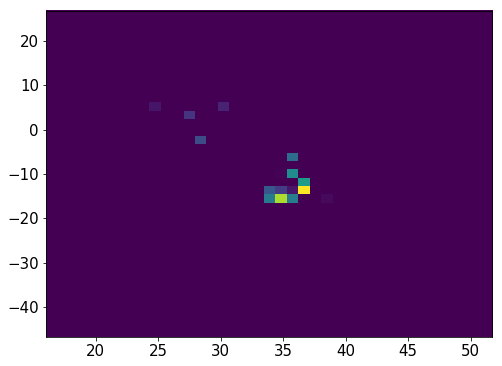

10389    21
10390    21
10391    21
10392    21
10393    21
10394    21
10395    21
10396    21
10397    21
10398    21
10399    21
10403    17
10404    17
10405    17
10406    17
10407    17
10408    17
10409    17
10410    17
10411    17
10412    17
Name: Nsipm, dtype: uint16


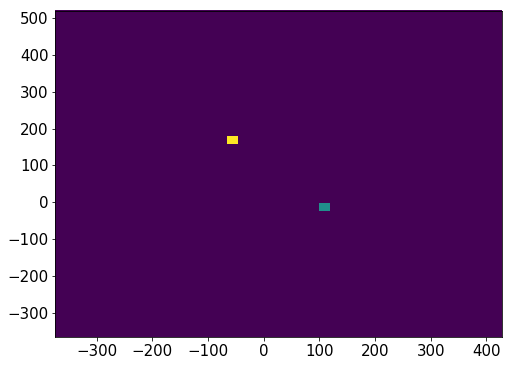

1664927    24
1664928    24
1664929    24
1664930    24
1664931    24
1664932    24
1664933    24
1664934    24
1664935    24
1664936    24
1664937    24
1664938    24
1664939    24
1664940    24
1664941    24
1664942    24
1664943    24
1664944    24
1664945    24
1664946    24
1664947    24
1664948    24
1664949    24
1664950    24
1664951    24
1664952    24
1664953    24
1664954    24
1664958    24
1664959    24
1664960    24
1664961    24
1664962    24
1664963    24
1664968    24
1664969    24
1664970    24
1664971    24
Name: Nsipm, dtype: uint16


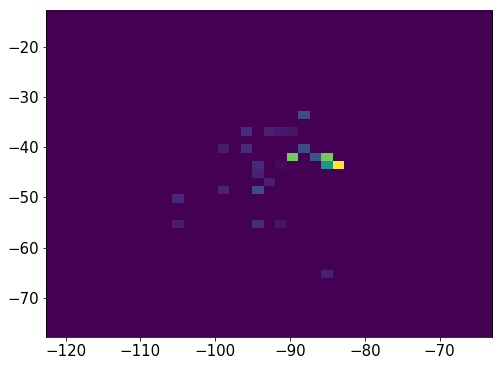

10417    23
10418    23
10419    23
10420    23
10421    23
10422    23
10423    23
10424    23
10425    23
10426    23
10427    23
10428    23
10429    23
10430    23
10431    23
10432    23
10433    23
10434    23
10435    23
10436    23
10437    23
10442    15
10443    15
10444    15
10445    15
10446    15
10447    15
10448    15
10449    15
10450    15
10451    15
10452    15
10453    15
10454    15
10455    15
10456    15
10465     6
10466     6
10467     6
10468     6
10469     6
10470     6
10471     6
10472     6
Name: Nsipm, dtype: uint16


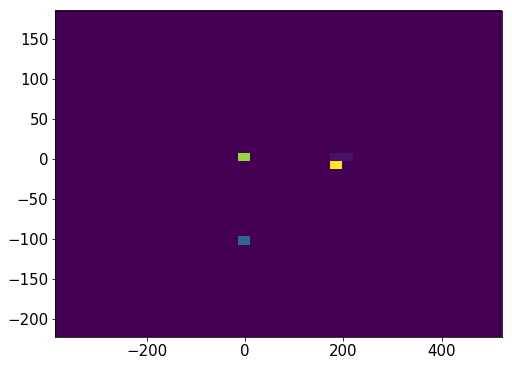

943601    31
943602    31
943603    31
943604    31
943605    31
943606    31
943607    31
943608    31
943609    31
943610    31
943611    31
943612    31
943613    31
943614    31
943620    31
943621    31
943622    31
943623    31
943624    31
943625    31
943626    31
943627    31
943628    31
Name: Nsipm, dtype: uint16


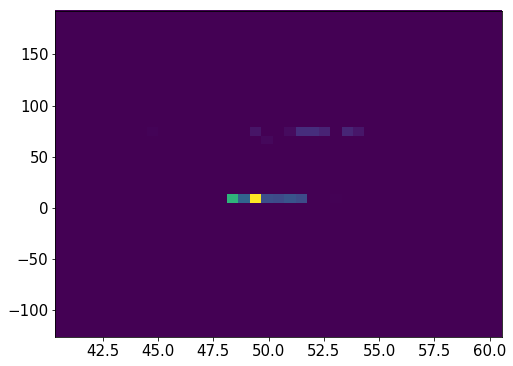

1664977    19
1664978    19
1664979    19
1664980    19
1664981    19
1664982    19
1664983    19
1664984    19
1664985    19
1664986    19
1664987    19
1664988    19
1664989    19
1664990    19
Name: Nsipm, dtype: uint16


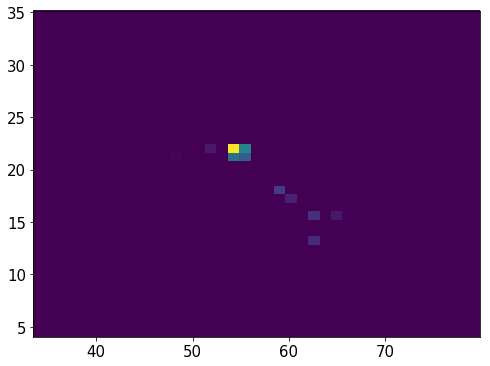

10477    31
10478    31
10479    31
10480    31
10481    31
10482    31
10483    31
10484    31
10485    31
10486    31
10487    31
10488    31
10489    31
10490    31
10491    31
10492    31
10493    31
10494    31
10495    31
10496    31
10497    31
10498    31
10499    31
10500    31
10501    31
10502    31
10503    31
10504    31
Name: Nsipm, dtype: uint16


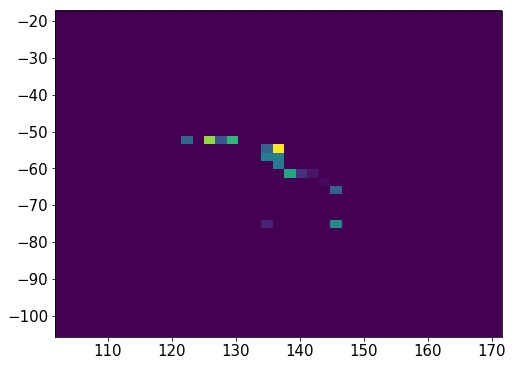

10506    20
10507    20
10508    20
10509    20
10510    20
10511    20
10512    20
10513    20
10514    20
10515    20
10516    20
10517    20
10518    20
Name: Nsipm, dtype: uint16


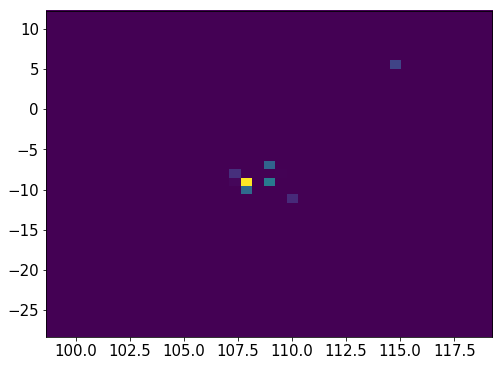

943631    28
943632    28
943633    28
943634    28
943635    28
943636    28
943637    28
943638    28
943639    28
943640    28
943641    28
943642    28
943643    28
943644    28
943645    28
943646    28
943647    28
943656    28
943657    28
943658    28
943659    28
943660    28
Name: Nsipm, dtype: uint16


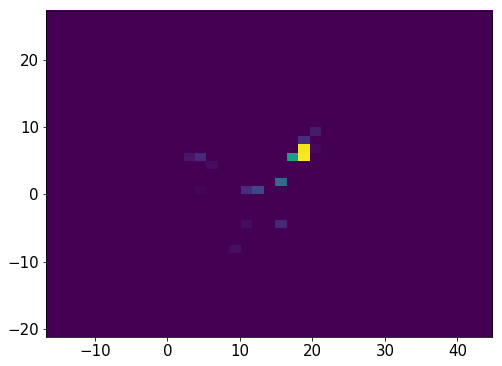

943663    26
943664    26
943665    26
943666    26
943667    26
943668    26
943669    26
943670    26
943671    26
943672    26
943673    26
943674    26
943675    26
943676    26
943677    26
943678    26
943679    26
943680    26
943681    26
Name: Nsipm, dtype: uint16


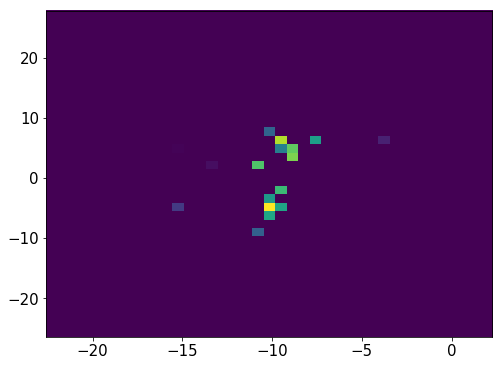

943686    32
943687    32
943688    32
943689    32
943690    32
943691    32
943692    32
943693    32
943694    32
943695    32
943696    32
943697    32
943698    32
943699    32
943700    32
943701    32
943702    32
943703    32
943704    32
943705    32
943706    32
943707    32
Name: Nsipm, dtype: uint16


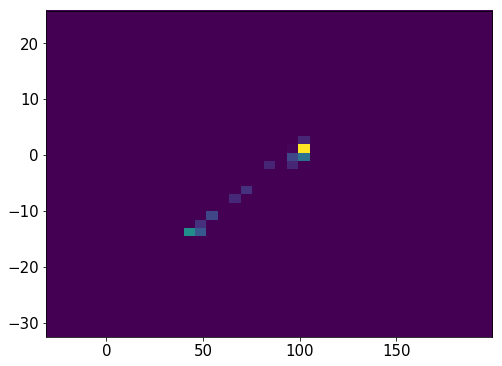

10524    21
10525    21
10526    21
10527    21
10528    21
10529    21
10530    21
10531    21
10532    21
10533    21
10534    21
10535    21
10536    21
10537    21
10538    21
Name: Nsipm, dtype: uint16


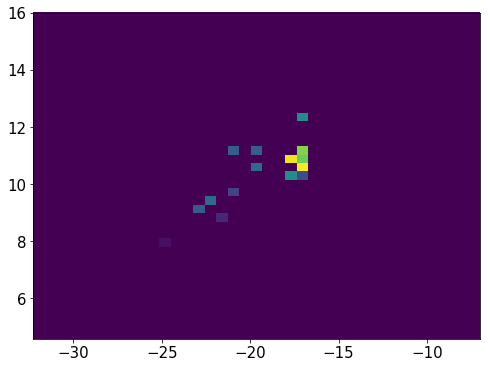

1664994    42
1664995    42
1664996    42
1664997    42
1664998    42
1664999    42
1665000    42
1665001    42
1665002    42
1665003    42
1665004    42
1665005    42
1665006    42
1665007    42
1665009    42
1665011    42
Name: Nsipm, dtype: uint16


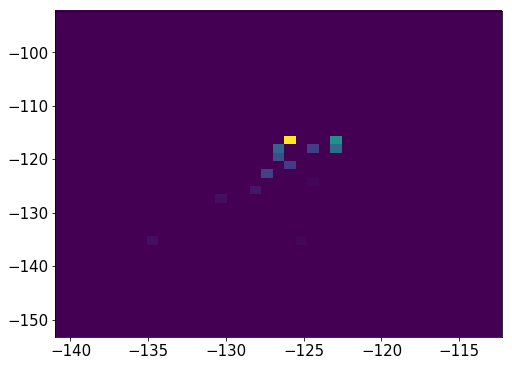

10543    22
10544    22
10545    22
10546    22
10547    22
10548    22
10549    22
10550    22
10551    22
10552    22
10553    22
10554    22
10555    22
10556    22
10557    22
Name: Nsipm, dtype: uint16


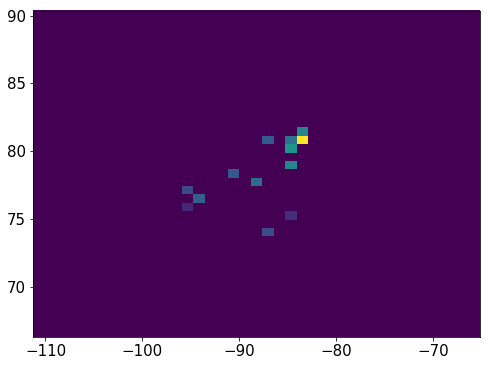

1900223    31
1900224    31
1900225    31
1900226    31
1900227    31
1900228    31
1900229    31
1900230    31
1900231    31
1900232    31
1900233    31
1900234    31
1900235    31
1900236    31
1900242    31
1900243    31
1900244    31
Name: Nsipm, dtype: uint16


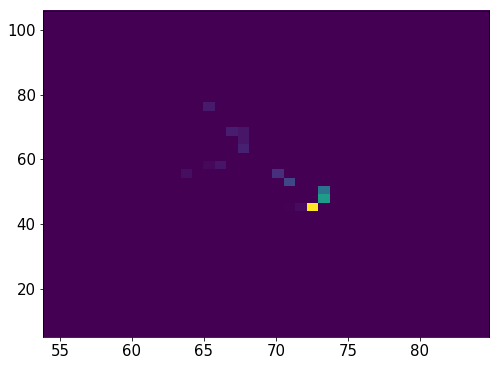

10562    34
10563    34
10564    34
10565    34
10566    34
10567    34
10568    34
10569    34
10570    34
10571    34
10572    34
10573    34
10574    34
10575    34
10576    34
10577    34
10578    34
10579    34
10580    34
10581    34
Name: Nsipm, dtype: uint16


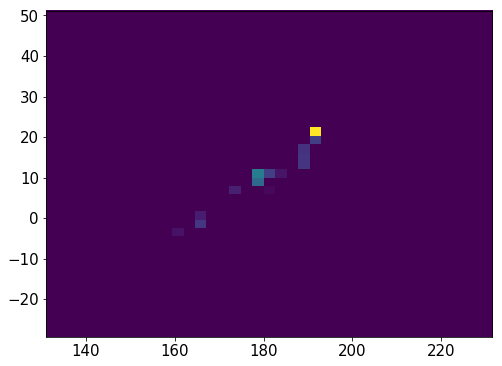

933708    40
933709    40
933710    40
933711    40
933712    40
933713    40
933714    40
933715    40
933716    40
933717    40
933718    40
933719    40
933720    40
933721    40
933722    40
933723    40
Name: Nsipm, dtype: uint16


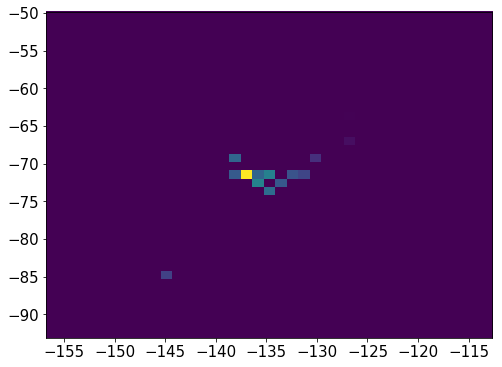

10587    20
10588    20
10589    20
10590    20
10591    20
10592    20
10593    20
10594    20
10595    20
10596    20
10597    20
10598    20
10599    20
10600    20
10601    20
10602    20
10603    20
Name: Nsipm, dtype: uint16


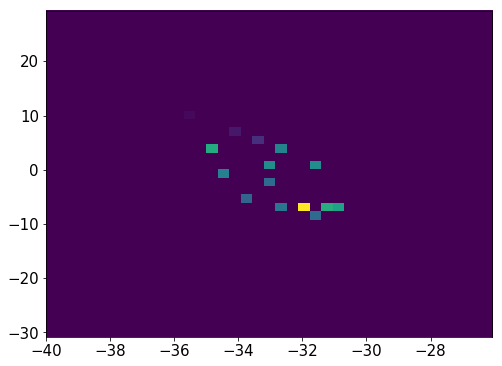

10608    31
10609    31
10610    31
10611    31
10612    31
10613    31
10614    31
10615    31
10616    31
10617    31
10618    31
10619    31
10620    31
10621    31
10622    31
10623    31
Name: Nsipm, dtype: uint16


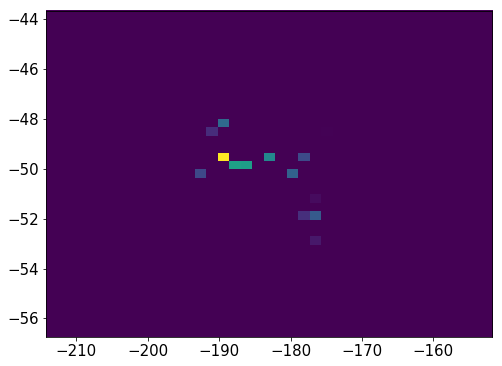

943730    29
943731    29
943732    29
943733    29
943734    29
943735    29
943736    29
943737    29
943738    29
943739    29
943740    29
943741    29
943742    29
943743    29
943744    29
943745    29
943746    29
943747    29
943748    29
943749    29
943750    29
Name: Nsipm, dtype: uint16


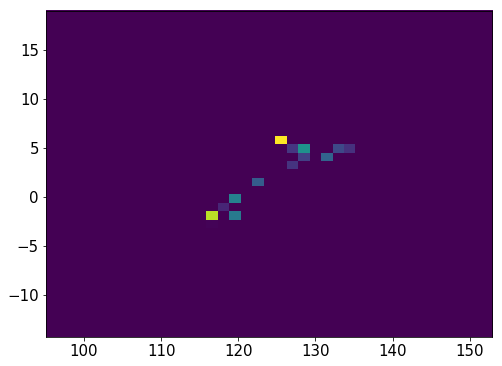

943756    22
943757    22
943758    22
943759    22
943760    22
943761    22
943762    22
943763    22
943764    22
943765    22
943766    22
943767    22
943768    22
943769    22
943770    22
943771    22
943772    22
943773    22
943774    22
943775    22
943776    22
Name: Nsipm, dtype: uint16


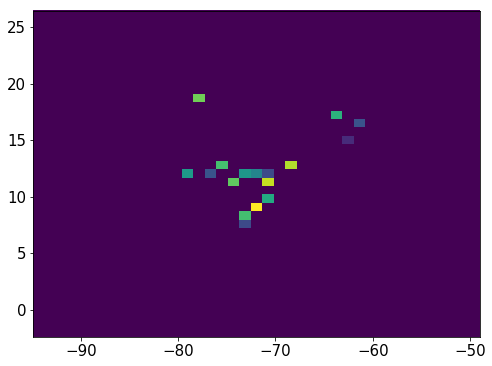

10628    20
10629    20
10630    20
10631    20
10632    20
10633    20
10634    20
10635    20
10636    20
10637    20
10638    20
10643     2
10644     2
10645     2
Name: Nsipm, dtype: uint16


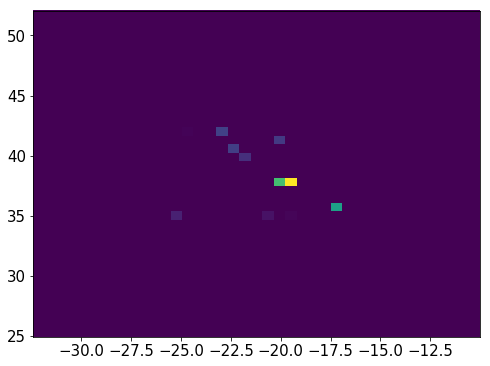

943781    28
943782    28
943783    28
943784    28
943785    28
943786    28
943787    28
943788    28
943789    28
943790    28
943791    28
943792    28
943793    28
943794    28
943795    28
943796    28
943797    28
943798    28
943799    28
943800    28
943801    28
943802    28
943803    28
943804    28
943805    28
943806    28
943807    28
943808    28
943809    28
Name: Nsipm, dtype: uint16


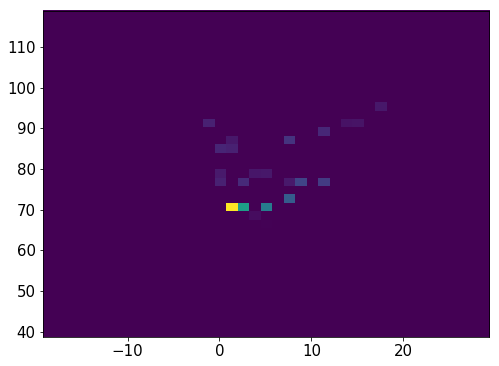

10650    31
10651    31
10652    31
10653    31
10654    31
10655    31
10656    31
10657    31
Name: Nsipm, dtype: uint16


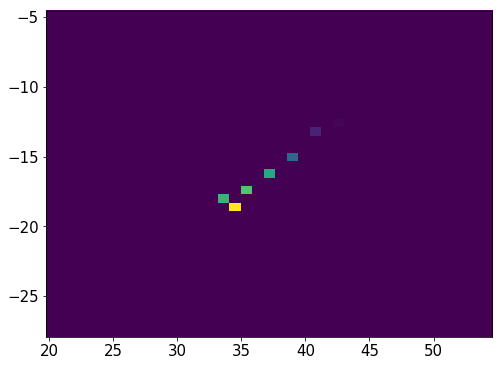

10662    19
10663    19
10664    19
10665    19
10666    19
10667    19
10668    19
10669    19
10670    19
10671    19
10672    19
10673    19
10674    19
10675    19
10676    19
10677    19
10678    19
10679    19
10680    19
Name: Nsipm, dtype: uint16


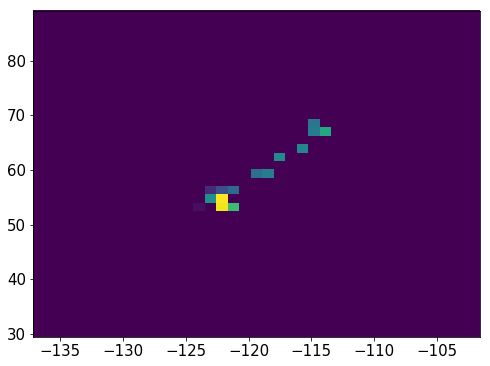

10686    31
10687    31
10688    31
10689    31
10693    31
10694    31
10695    31
10696    31
10697    31
10698    31
10699    31
10700    31
10701    31
10702    31
10703    31
10704    31
10705    31
10706    31
10707    31
10708    31
10709    31
Name: Nsipm, dtype: uint16


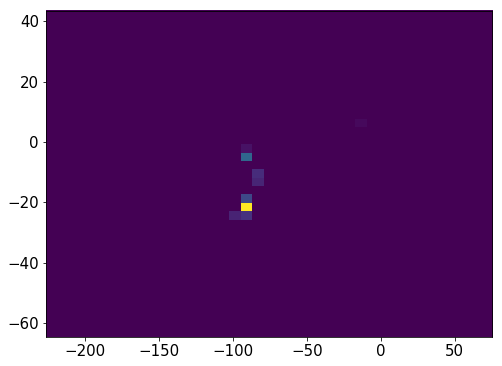

943831    26
943832    26
943833    26
943834    26
943835    26
943836    26
943837    26
943838    26
943839    26
943840    26
943841    26
943842    26
943843    26
943844    26
943845    26
Name: Nsipm, dtype: uint16


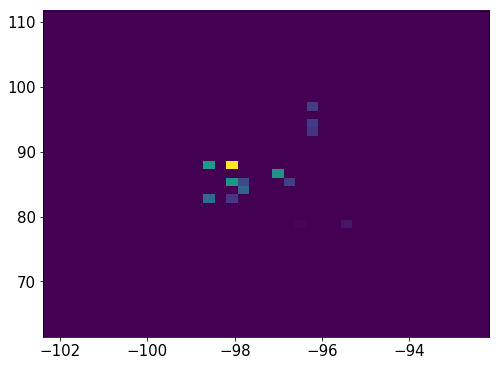

943852    25
943853    25
943854    25
943855    25
943856    25
943857    25
943858    25
943859    25
943860    25
943861    25
943862    25
943863    25
943864    25
943865    25
943866    25
943867    25
943868    25
Name: Nsipm, dtype: uint16


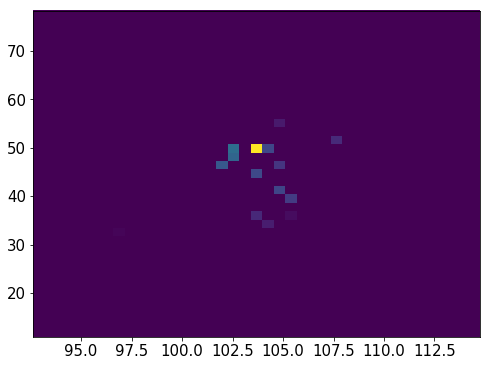

10710    33
10711    33
10712    33
10713    33
10714    33
10715    33
10716    33
10717    33
10718    33
10719    33
10720    33
10721    33
10722    33
10723    33
10724    33
10725    33
10726    33
10727    33
Name: Nsipm, dtype: uint16


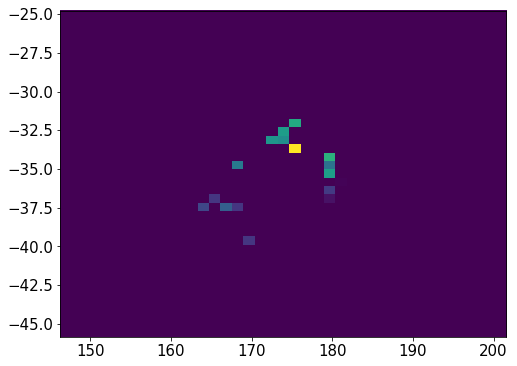

943873    26
943874    26
943875    26
943876    26
943877    26
943878    26
943879    26
943880    26
943881    26
943882    26
943883    26
943884    26
943885    26
943886    26
943887    26
943888    26
943889    26
943890    26
943891    26
943892    26
943893    26
943894    26
943895    26
943896    26
943897    26
943898    26
943899    26
Name: Nsipm, dtype: uint16


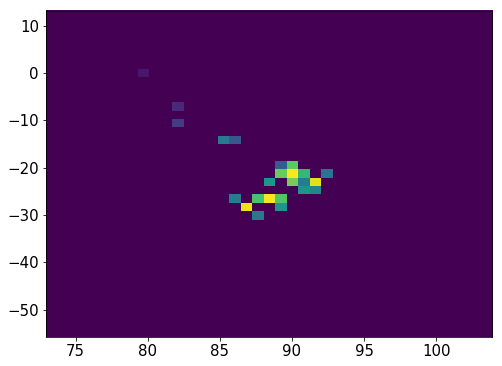

10732    25
10733    25
10734    25
10735    25
10736    25
10737    25
10738    25
10739    25
10740    25
10741    25
10742    25
10743    25
10744    25
10749     3
10750     3
10751     3
10752     3
10753     3
10754     3
Name: Nsipm, dtype: uint16


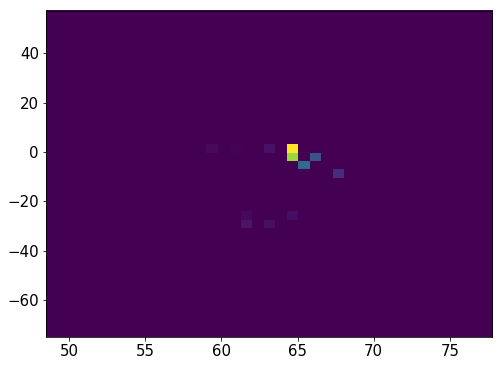

10759    28
10760    28
10761    28
10762    28
10763    28
10764    28
10765    28
10766    28
10767    28
10768    28
10769    28
10770    28
10771    28
10772    28
10774    28
10775    28
10776    28
10777    28
10778    28
10779    28
10780    28
10781    28
10782    28
10783    28
10784    28
10785    28
10786    28
10787    28
10788    28
10789    28
10790    28
10791    28
10792    28
10793    28
10794    28
10795    28
10796    28
10797    28
10798    28
10799    28
Name: Nsipm, dtype: uint16


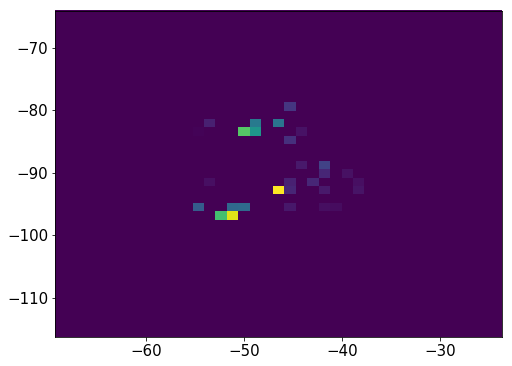

10803    30
10804    30
10805    30
10806    30
10807    30
10808    30
10809    30
10810    30
10811    30
10812    30
10813    30
10814    30
10815    30
10816    30
10817    30
10818    30
10819    30
10820    30
10821    30
10822    30
10823    30
10824    30
10825    30
10826    30
10827    30
Name: Nsipm, dtype: uint16


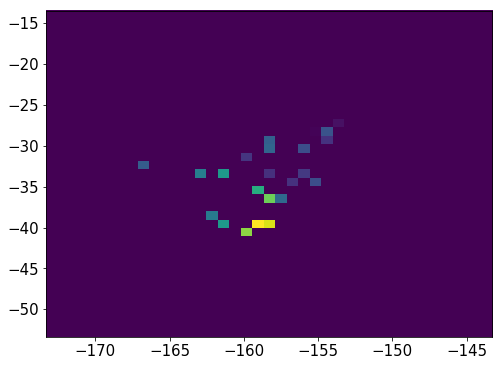

943968    40
943969    40
943970    40
943971    40
943972    40
943973    40
943974    40
943975    40
943976    40
943977    40
943978    40
943979    40
943980    40
943981    40
943982    40
Name: Nsipm, dtype: uint16


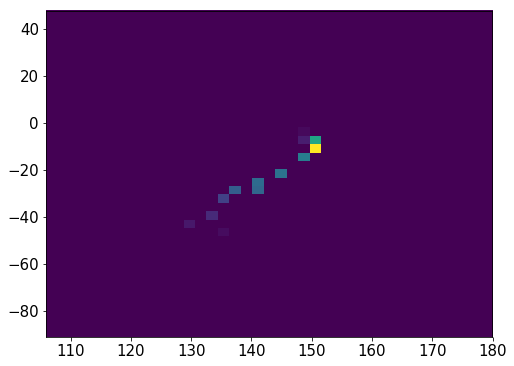

1665035    38
1665036    38
1665037    38
1665038    38
1665039    38
1665040    38
1665041    38
1665042    38
1665043    38
1665044    38
Name: Nsipm, dtype: uint16


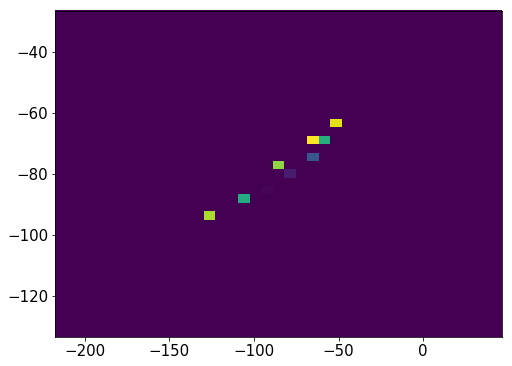

10831    23
10832    23
10833    23
10834    23
10835    23
10836    23
10837    23
10838    23
10839    23
10840    23
10841    23
10842    23
10843    23
10844    23
10845    23
10846    23
10847    23
10848    23
10849    23
Name: Nsipm, dtype: uint16


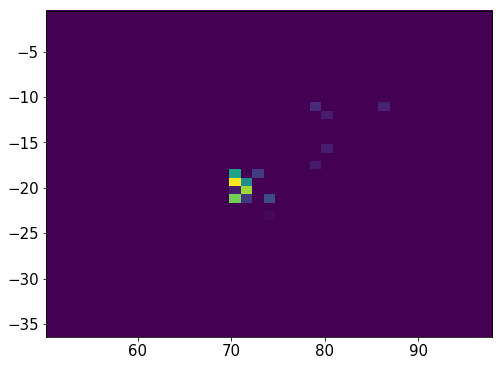

10856    22
10857    22
10858    22
10859    22
10860    22
10861    22
10862    22
10863    22
10864    22
10865    22
10866    22
10867    22
10868    22
10869    22
10870    22
10871    22
10872    22
10873    22
10874    22
10875    22
Name: Nsipm, dtype: uint16


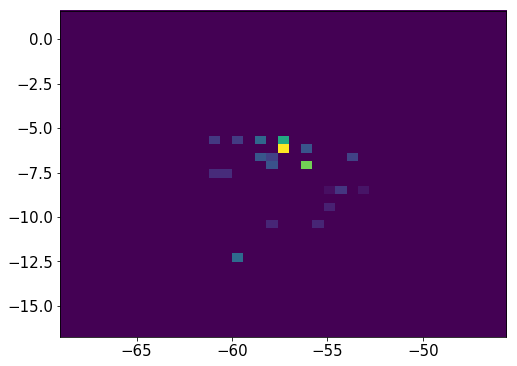

10879    23
10880    23
10881    23
10882    23
10883    23
10884    23
10885    23
10886    23
10887    23
10888    23
10889    23
10890    23
10891    23
10892    23
10893    23
10894    23
10895    23
10896    23
10897    23
10898    23
10899    23
10900    23
10901    23
10902    23
10903    23
Name: Nsipm, dtype: uint16


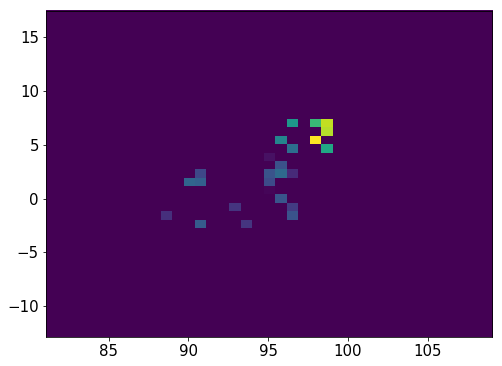

10909    20
10910    20
10911    20
10912    20
10913    20
10914    20
10915    20
10916    20
10917    20
10918    20
10919    20
10920    20
10921    20
10922    20
10923    20
10924    20
10925    20
10926    20
Name: Nsipm, dtype: uint16


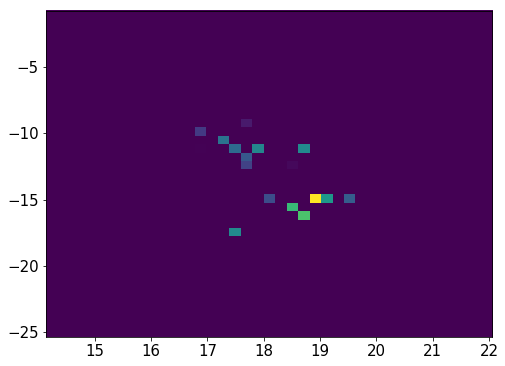

943986    21
943987    21
943988    21
943989    21
943990    21
943991    21
943992    21
943993    21
943994    21
943995    21
943996    21
943997    21
943998    21
943999    21
944000    21
944001    21
944002    21
944003    21
944004    21
Name: Nsipm, dtype: uint16


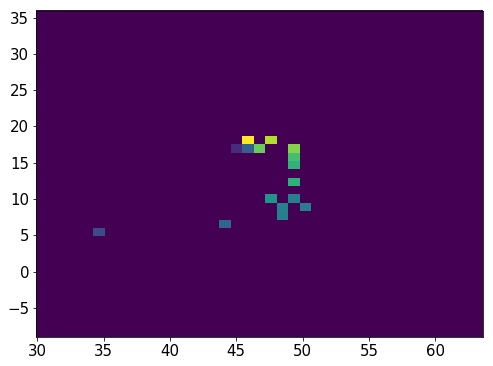

944009    33
944010    33
944011    33
944012    33
944013    33
944014    33
944015    33
944016    33
944017    33
944018    33
944019    33
944020    33
944021    33
944022    33
Name: Nsipm, dtype: uint16


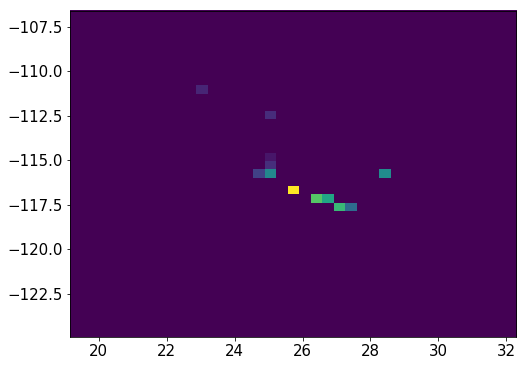

944027    29
944028    29
944029    29
944030    29
944031    29
944032    29
944033    29
944034    29
944035    29
944036    29
944037    29
944038    29
944043     4
944044     4
944045     4
944046     4
944047     4
944051     4
944052     4
944053     4
944054     4
944055     4
944056     4
944057     4
Name: Nsipm, dtype: uint16


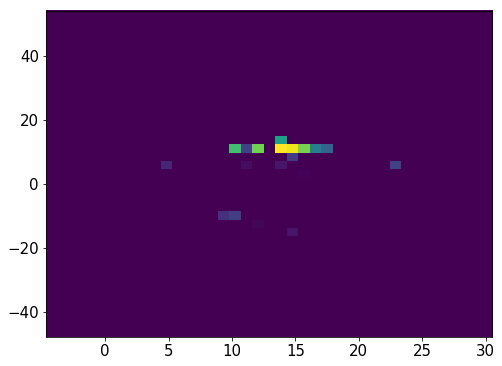

944060    25
944061    25
944062    25
944063    25
944064    25
944065    25
944066    25
944067    25
944068    25
944069    25
944070    25
944071    25
944072    25
944073    25
944074    25
944075    25
944077    25
944078    25
944079    25
944080    25
944081    25
944082    25
944083    25
944084    25
944085    25
944086    25
944087    25
Name: Nsipm, dtype: uint16


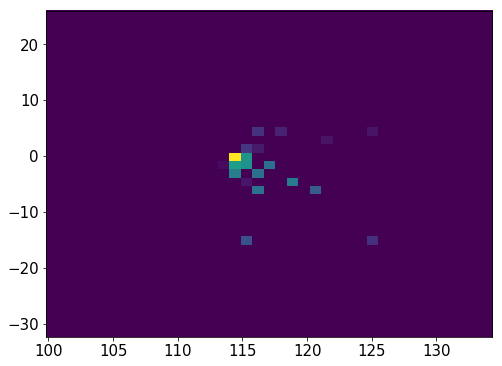

10932    23
10933    23
10934    23
10935    23
10936    23
10937    23
10938    23
10939    23
10940    23
10941    23
10942    23
10943    23
10944    23
10945    23
10946    23
10947    23
10948    23
10949    23
10950    23
Name: Nsipm, dtype: uint16


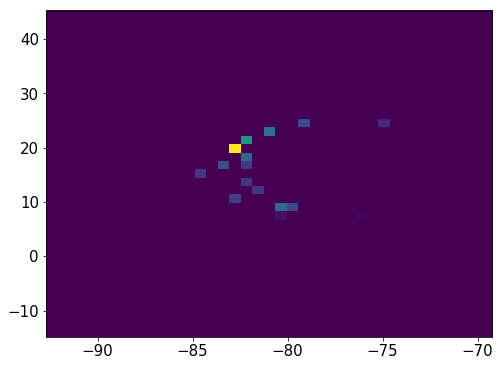

10954    25
10955    25
10956    25
10957    25
10958    25
10959    25
10960    25
10961    25
10962    25
10963    25
10964    25
10965    25
Name: Nsipm, dtype: uint16


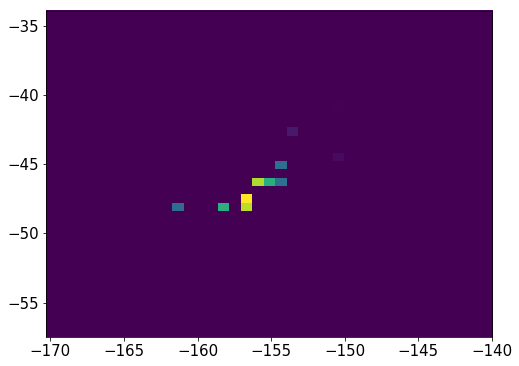

10971    24
10972    24
10973    24
10974    24
10975    24
10976    24
10977    24
10978    24
10979    24
10980    24
10981    24
10982    24
10983    24
10984    24
10985    24
10986    24
10987    24
10988    24
10989    24
10990    24
10991    24
Name: Nsipm, dtype: uint16


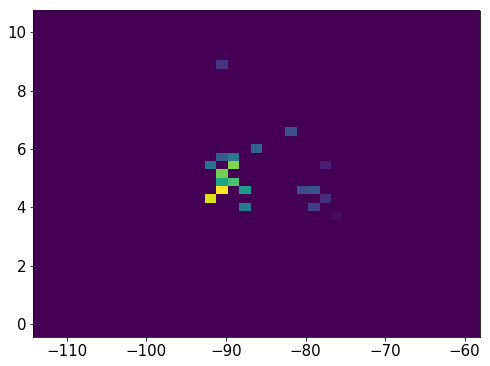

10995    26
10996    26
10997    26
10998    26
10999    26
11000    26
11001    26
11002    26
11003    26
11004    26
11005    26
11006    26
11007    26
11008    26
11009    26
Name: Nsipm, dtype: uint16


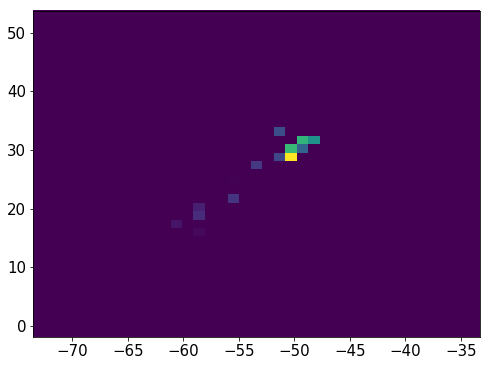

935273    27
935274    27
935275    27
935276    27
935277    27
935278    27
935279    27
935280    27
935281    27
935282    27
935283    27
935284    27
935285    27
935286    27
935287    27
935288    27
935289    27
935290    27
935291    27
935292    27
935293    27
935294    27
935297    27
935299    27
935301    27
935302    27
935303    27
935304    27
935305    27
935306    27
935307    27
935308    27
935309    27
935310    27
935311    27
935312    27
935313    27
935314    27
935315    27
Name: Nsipm, dtype: uint16


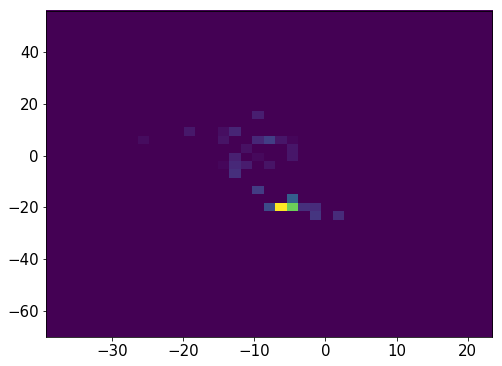

11015    33
11016    33
11017    33
11018    33
11019    33
11020    33
11021    33
11022    33
11023    33
11024    33
11025    33
11026    33
11027    33
11032    33
11033    33
11034    33
11035    33
11036    33
11044     6
11045     6
11046     6
11047     6
11048     6
11049     6
11050     6
11051     6
11052     6
Name: Nsipm, dtype: uint16


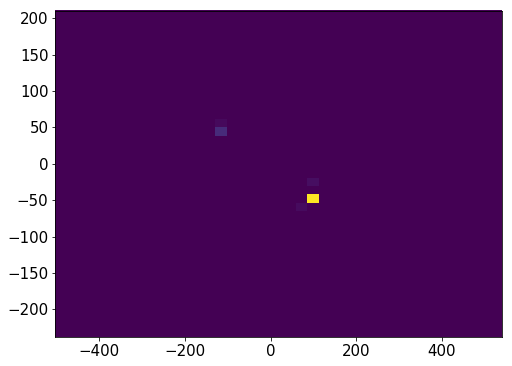

1665049    22
1665050    22
1665051    22
1665052    22
1665053    22
1665054    22
1665055    22
1665056    22
1665057    22
1665058    22
1665059    22
1665060    22
1665061    22
1665062    22
1665063    22
1665064    22
1665065    22
1665066    22
1665067    22
1665068    22
1665073    22
1665074    22
1665075    22
1665076    22
Name: Nsipm, dtype: uint16


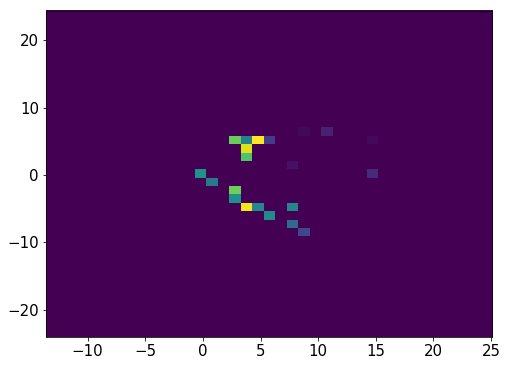

11057    25
11058    25
11059    25
11060    25
11061    25
11062    25
11063    25
11064    25
11065    25
11066    25
11067    25
11068    25
11069    25
11070    25
Name: Nsipm, dtype: uint16


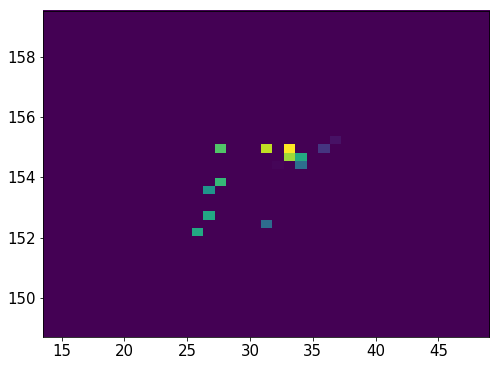

11075    18
11076    18
11077    18
11078    18
11079    18
11080    18
11081    18
11082    18
11083    18
11084    18
11085    18
11086    18
11087    18
11088    18
11089    18
11090    18
11091    18
11092    18
11093    18
11094    18
11095    18
11101     1
11102     1
11103     1
Name: Nsipm, dtype: uint16


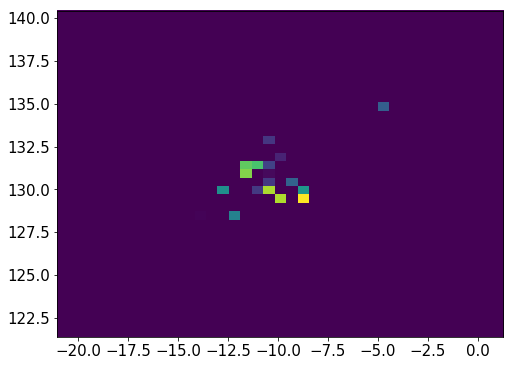

11107    35
11108    35
11109    35
11110    35
11111    35
11112    35
11113    35
11114    35
11115    35
11116    35
11117    35
11118    35
11119    35
11120    35
11121    35
11122    35
11123    35
11124    35
Name: Nsipm, dtype: uint16


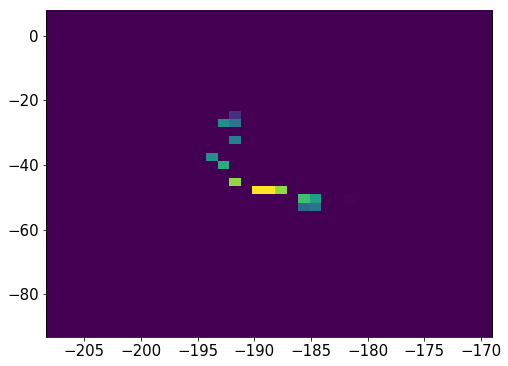

11129    26
11130    26
11131    26
11132    26
11133    26
11134    26
11135    26
11136    26
11137    26
11138    26
11139    26
11140    26
11141    26
11142    26
11143    26
11148     2
11149     2
11150     2
11151     2
11152     2
11153     2
Name: Nsipm, dtype: uint16


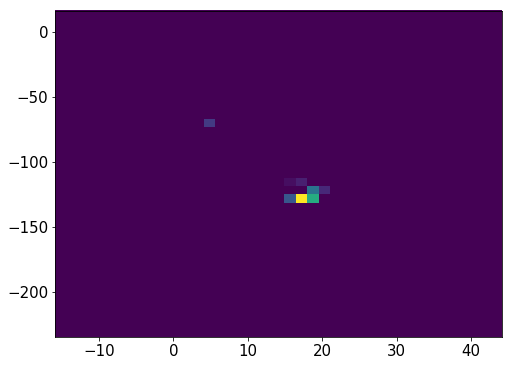

11158    31
11159    31
11160    31
11161    31
11162    31
11163    31
11164    31
11165    31
11166    31
11167    31
11168    31
11169    31
11170    31
11171    31
11172    31
11173    31
11174    31
11175    31
11176    31
11177    31
Name: Nsipm, dtype: uint16


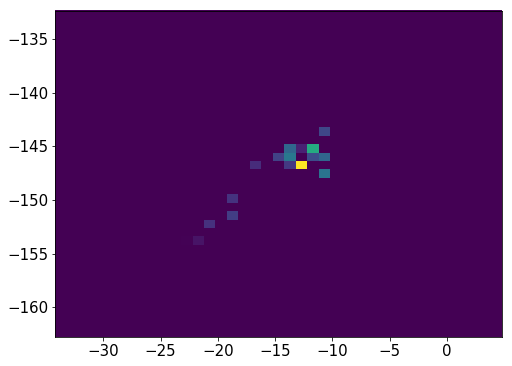

944112    23
944113    23
944114    23
944115    23
944116    23
944117    23
944118    23
944119    23
944120    23
944121    23
944122    23
944123    23
944124    23
944125    23
944126    23
Name: Nsipm, dtype: uint16


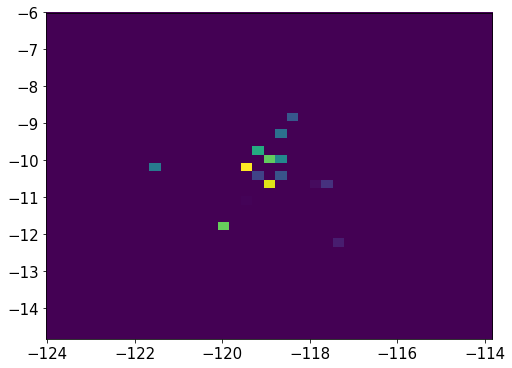

11181    29
11189    29
11190    29
11191    29
11192    29
11193    29
11194    29
11195    29
11196    29
11197    29
11198    29
11199    29
11200    29
11201    29
11202    29
11203    29
11204    29
11205    29
11206    29
Name: Nsipm, dtype: uint16


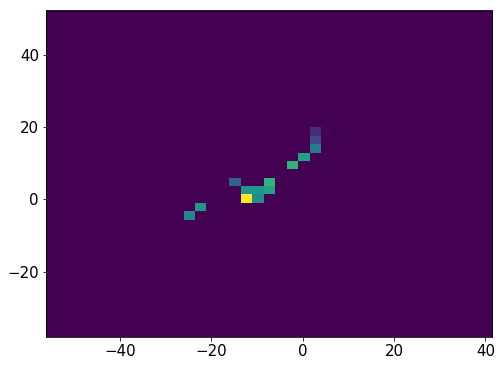

11207    31
11208    31
11209    31
11210    31
11211    31
11212    31
11213    31
11214    31
11215    31
11216    31
11217    31
11218    31
11219    31
11220    31
11221    31
Name: Nsipm, dtype: uint16


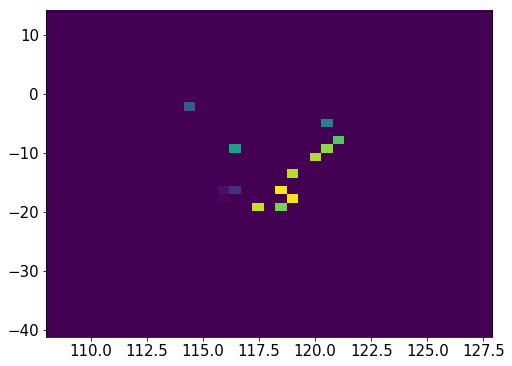

944148    26
944149    26
944150    26
944151    26
944152    26
944153    26
944154    26
944155    26
944156    26
944157    26
944158    26
944159    26
944160    26
944161    26
Name: Nsipm, dtype: uint16


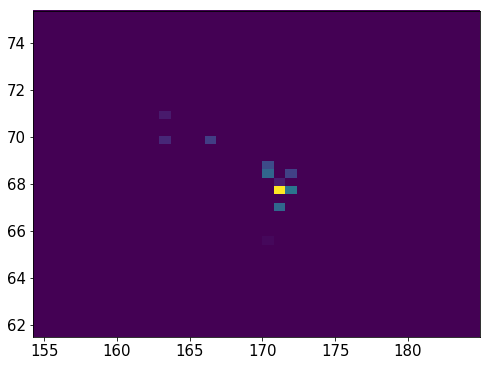

944165    29
944166    29
944167    29
944168    29
944169    29
944170    29
944171    29
944172    29
944173    29
944174    29
944175    29
944176    29
944177    29
944178    29
944179    29
944180    29
944181    29
944182    29
944183    29
944184    29
944185    29
944186    29
944187    29
944188    29
944189    29
944190    29
944191    29
944192    29
944193    29
944194    29
Name: Nsipm, dtype: uint16


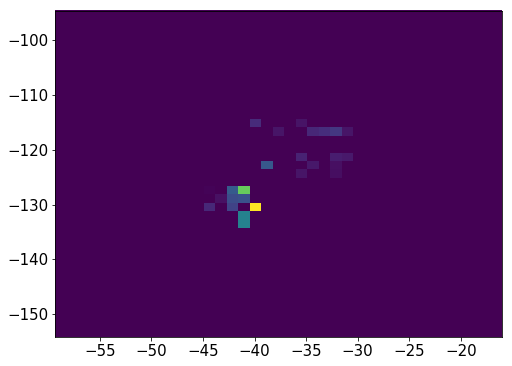

11226    38
11227    38
11228    38
11229    38
11230    38
11231    38
11232    38
11233    38
11234    38
11235    38
11236    38
11237    38
11238    38
11239    38
11240    38
11241    38
11242    38
11243    38
11244    38
11245    38
11246    38
11247    38
11248    38
11249    38
11250    38
11251    38
11252    38
11253    38
11254    38
11255    38
Name: Nsipm, dtype: uint16


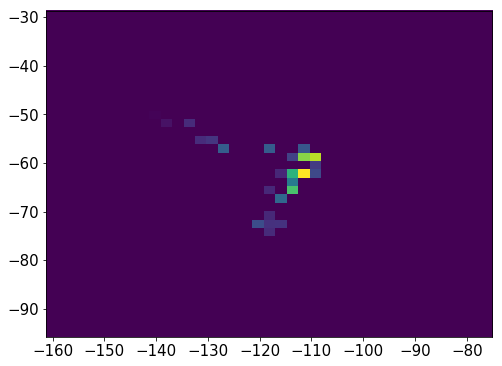

11259    31
11260    31
11261    31
11262    31
11263    31
11264    31
11265    31
11266    31
11267    31
11268    31
11269    31
11270    31
11271    31
11272    31
11273    31
11274    31
11275    31
11276    31
11277    31
11278    31
11279    31
11280    31
11281    31
11282    31
11283    31
11284    31
11285    31
11286    31
11287    31
11288    31
11290    31
11291    31
11292    31
11293    31
11294    31
11295    31
11296    31
11297    31
11298    31
11299    31
11300    31
11301    31
11302    31
11303    31
11304    31
Name: Nsipm, dtype: uint16


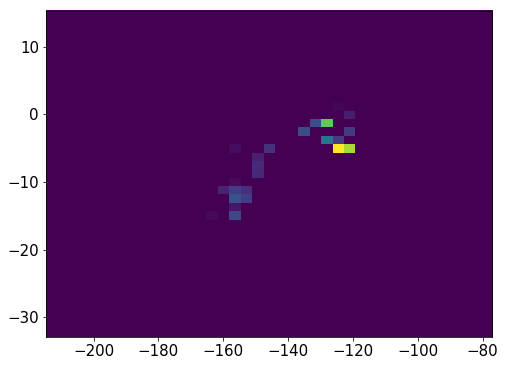

944223    31
944224    31
944225    31
944226    31
944227    31
944228    31
944229    31
944230    31
944231    31
944232    31
944233    31
944234    31
944235    31
944236    31
944237    31
944238    31
944239    31
944240    31
944241    31
944242    31
944243    31
Name: Nsipm, dtype: uint16


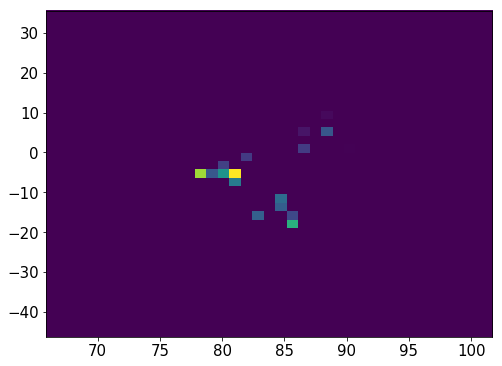

944248    28
944249    28
944250    28
944251    28
944252    28
944253    28
944254    28
944255    28
944256    28
944257    28
944258    28
944259    28
944260    28
Name: Nsipm, dtype: uint16


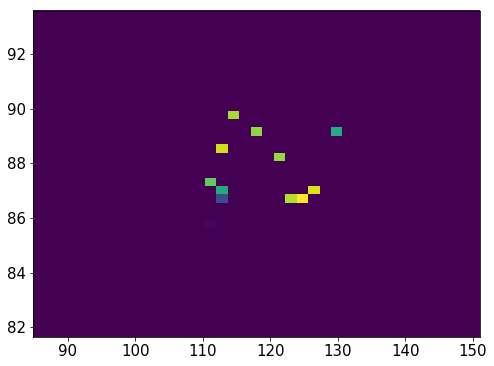

11308    30
11309    30
11310    30
11311    30
11312    30
11313    30
11314    30
11315    30
11316    30
11317    30
11318    30
11319    30
11320    30
11321    30
11322    30
11323    30
11324    30
11325    30
11326    30
11327    30
11328    30
Name: Nsipm, dtype: uint16


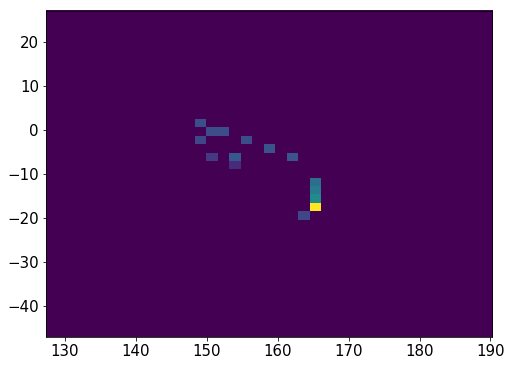

11335    21
11336    21
11337    21
11338    21
11339    21
11340    21
11341    21
11342    21
11343    21
11344    21
11345    21
11346    21
11347    21
11348    21
11349    21
11350    21
11351    21
11352    21
11353    21
Name: Nsipm, dtype: uint16


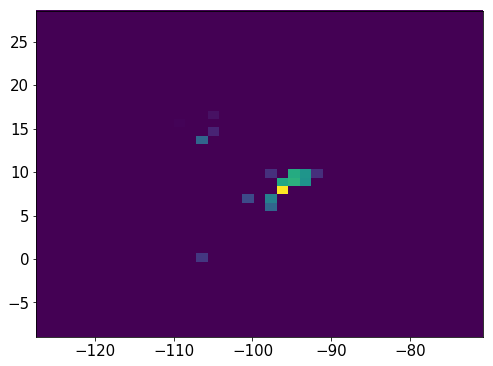

944264    17
944265    17
944266    17
944267    17
944268    17
944269    17
944270    17
944271    17
944272    17
944273    17
944274    17
944275    17
Name: Nsipm, dtype: uint16


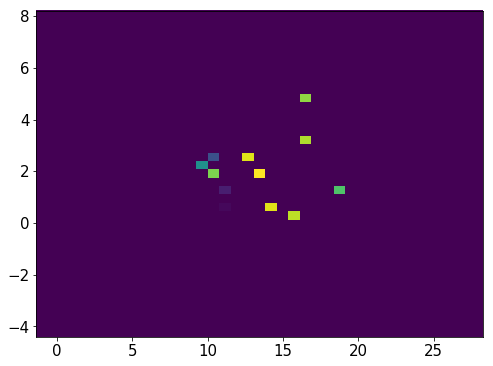

944281    32
944282    32
944283    32
944284    32
944285    32
944286    32
944287    32
944288    32
944289    32
944290    32
944291    32
944292    32
944293    32
944294    32
944295    32
944296    32
944297    32
944298    32
944299    32
944300    32
944301    32
944302    32
944303    32
944304    32
944305    32
944306    32
944307    32
944308    32
944309    32
944310    32
944311    32
944312    32
944313    32
944314    32
944315    32
944316    32
Name: Nsipm, dtype: uint16


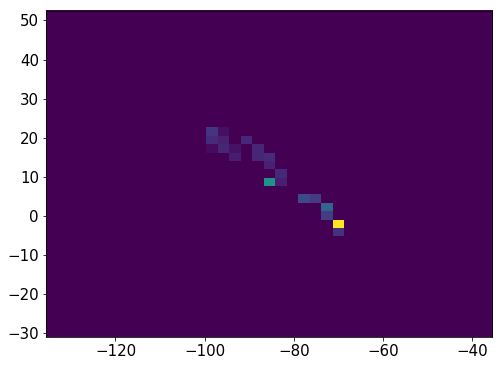

944321    23
944322    23
944323    23
944324    23
944325    23
944326    23
944327    23
944328    23
944329    23
944330    23
944331    23
944332    23
944333    23
944334    23
944335    23
944336    23
944337    23
944338    23
944339    23
944347     1
944348     1
944349     1
944350     1
Name: Nsipm, dtype: uint16


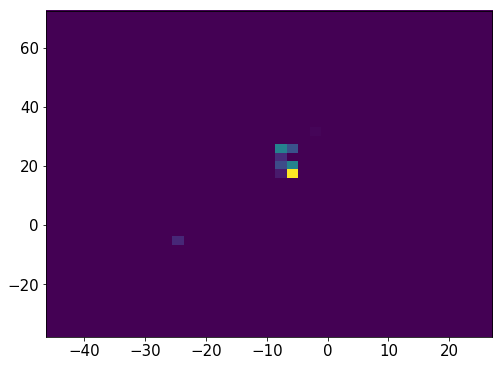

11359    23
11360    23
11361    23
11362    23
11363    23
11364    23
11365    23
11366    23
11367    23
11368    23
11369    23
11370    23
11371    23
11372    23
11373    23
11374    23
11375    23
11376    23
11377    23
11378    23
Name: Nsipm, dtype: uint16


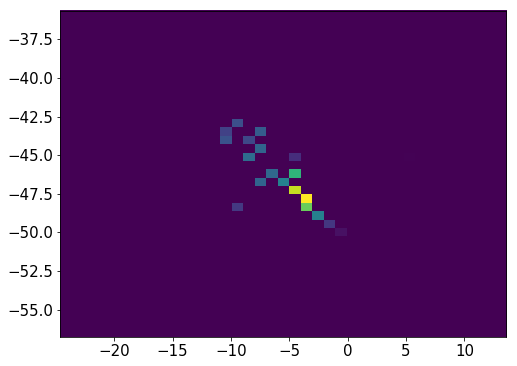

944355    19
944356    19
944357    19
944358    19
944359    19
944360    19
944361    19
944362    19
944363    19
944364    19
944365    19
944366    19
944367    19
944368    19
944369    19
944370    19
944371    19
944372    19
944373    19
944374    19
944375    19
944380     4
944381     4
944382     4
944383     4
944384     4
944385     4
944386     4
Name: Nsipm, dtype: uint16


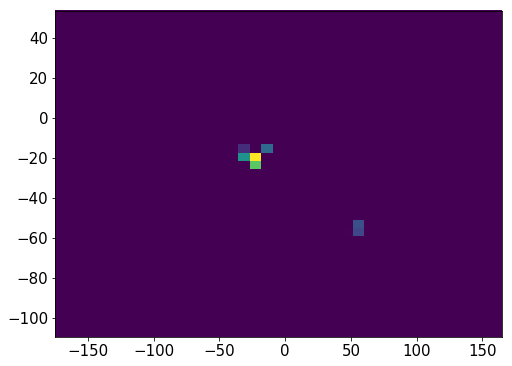

944391    24
944392    24
944393    24
944394    24
944395    24
944396    24
944397    24
944398    24
944399    24
944400    24
944401    24
944402    24
944403    24
944404    24
944405    24
944406    24
944407    24
944408    24
944409    24
944410    24
944411    24
944412    24
944413    24
944414    24
944415    24
944416    24
944417    24
944418    24
944419    24
944420    24
944426     1
944427     1
944428     1
944429     1
944430     1
Name: Nsipm, dtype: uint16


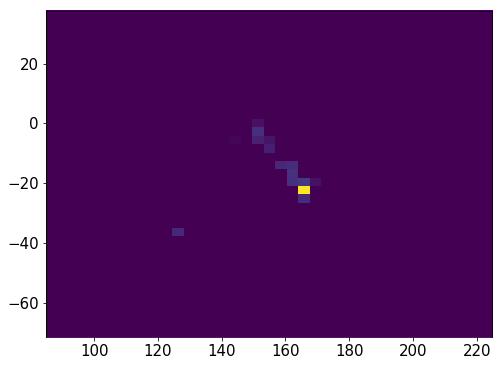

944435    37
944436    37
944437    37
944438    37
944439    37
944440    37
944441    37
944442    37
944443    37
944444    37
944445    37
944446    37
Name: Nsipm, dtype: uint16


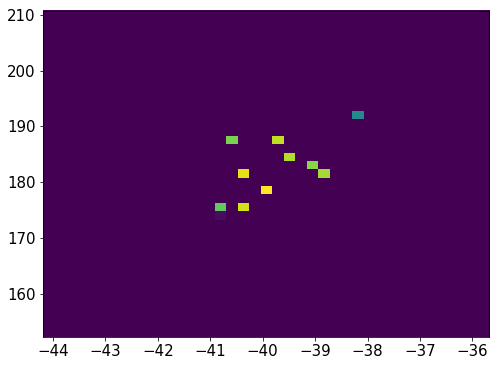

11384    22
11385    22
11386    22
11387    22
11388    22
11389    22
11390    22
11391    22
11392    22
11393    22
11394    22
11395    22
11396    22
11397    22
11398    22
11399    22
11400    22
11401    22
11402    22
11403    22
Name: Nsipm, dtype: uint16


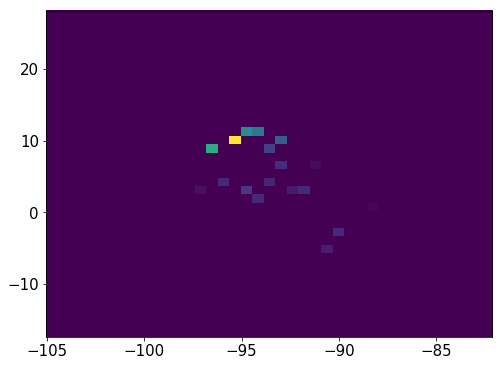

11409    25
11410    25
11411    25
11412    25
11413    25
11414    25
11415    25
11416    25
11417    25
11418    25
11419    25
11420    25
11421    25
11422    25
11430     1
11431     1
11432     1
11433     1
Name: Nsipm, dtype: uint16


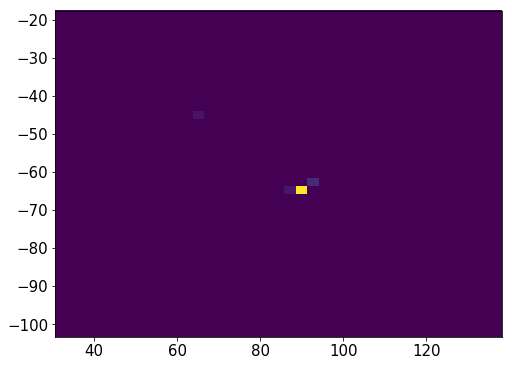

944515    39
944516    39
944517    39
944518    39
944519    39
944520    39
944521    39
944522    39
944523    39
944524    39
944525    39
944526    39
944527    39
944528    39
944529    39
944530    39
944531    39
944532    39
944533    39
944534    39
Name: Nsipm, dtype: uint16


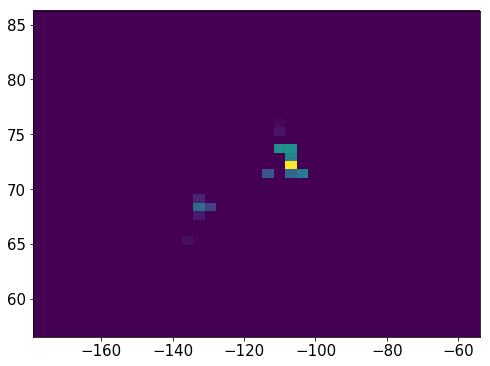

944537    35
944538    35
944539    35
944540    35
944541    35
944542    35
944543    35
944544    35
944545    35
944546    35
944547    35
944548    35
944549    35
944550    35
Name: Nsipm, dtype: uint16


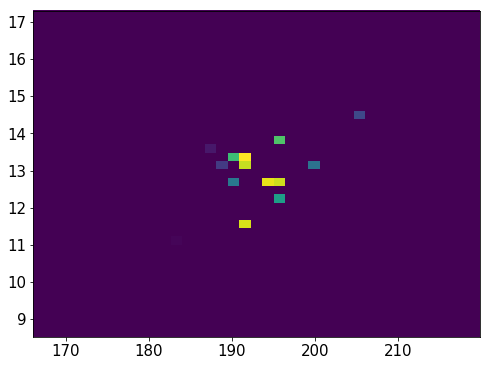

11457    22
11458    22
11459    22
11460    22
11461    22
11462    22
11463    22
11464    22
11465    22
11466    22
11467    22
11468    22
11469    22
11470    22
11471    22
11472    22
11477     1
11478     1
11479     1
11480     1
11481     1
Name: Nsipm, dtype: uint16


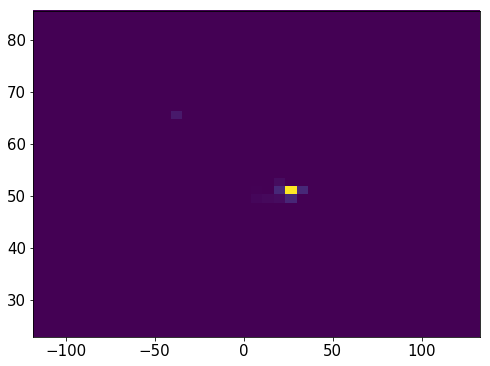

11486    29
11487    29
11488    29
11489    29
11490    29
11491    29
11492    29
11493    29
11494    29
11495    29
11496    29
11497    29
11498    29
11499    29
11500    29
11501    29
11502    29
11503    29
11504    29
11505    29
Name: Nsipm, dtype: uint16


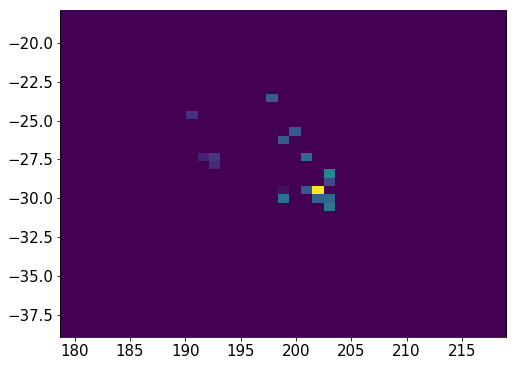

11511    37
11512    37
11513    37
11514    37
11515    37
11516    37
11517    37
11518    37
11519    37
11520    37
11521    37
11522    37
11523    37
11524    37
11527    37
11528    37
11529    37
11530    37
11531    37
11532    37
Name: Nsipm, dtype: uint16


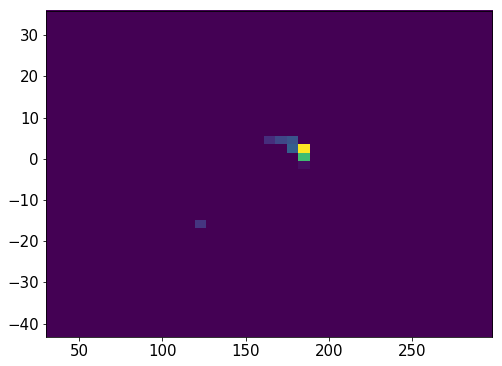

11536    25
11537    25
11538    25
11539    25
11540    25
11541    25
11542    25
11543    25
11544    25
11545    25
11546    25
11547    25
11548    25
11549    25
11550    25
11551    25
11552    25
Name: Nsipm, dtype: uint16


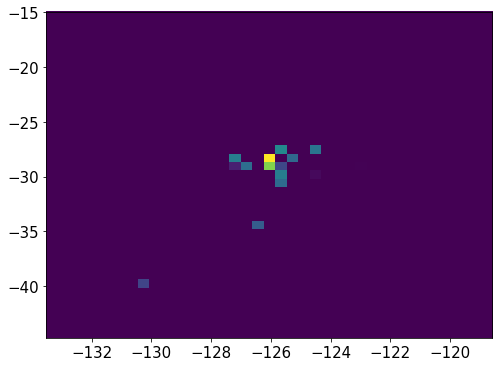

11557    23
11558    23
11559    23
11560    23
11561    23
11562    23
11563    23
11564    23
11565    23
11566    23
11567    23
11568    23
11569    23
11570    23
11571    23
11573    23
11574    23
11575    23
11576    23
11577    23
11578    23
11579    23
11580    23
11581    23
11582    23
11583    23
11584    23
11585    23
11586    23
11587    23
Name: Nsipm, dtype: uint16


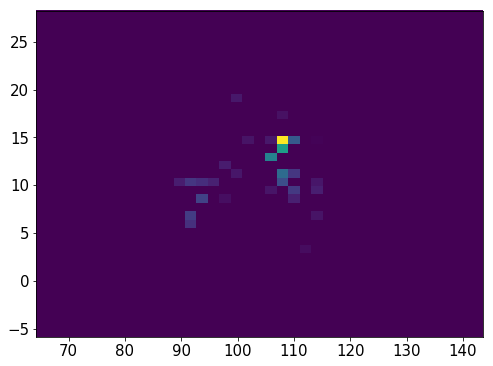

11592    25
11593    25
11594    25
11595    25
11596    25
11597    25
11598    25
11599    25
11600    25
11601    25
11602    25
11603    25
11604    25
11605    25
Name: Nsipm, dtype: uint16


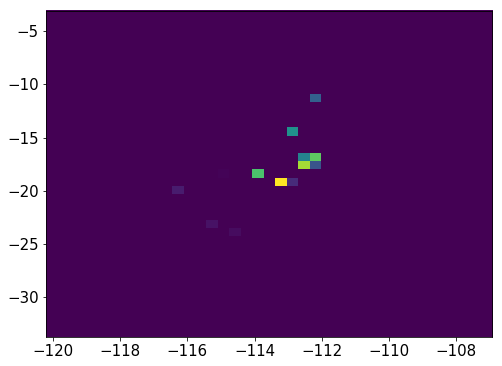

944625    28
944626    28
944627    28
944628    28
944629    28
944630    28
944631    28
944632    28
944633    28
944634    28
944639     3
944640     3
944641     3
944642     3
944643     3
Name: Nsipm, dtype: uint16


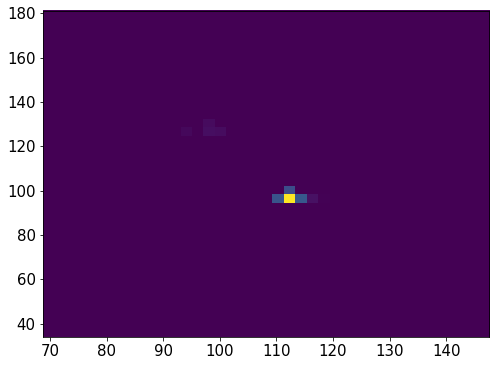

11611    23
11612    23
11613    23
11614    23
11615    23
11616    23
11617    23
11618    23
11619    23
11620    23
11621    23
11622    23
11623    23
11624    23
11625    23
11626    23
11627    23
11628    23
11629    23
11630    23
11631    23
11632    23
11633    23
11634    23
Name: Nsipm, dtype: uint16


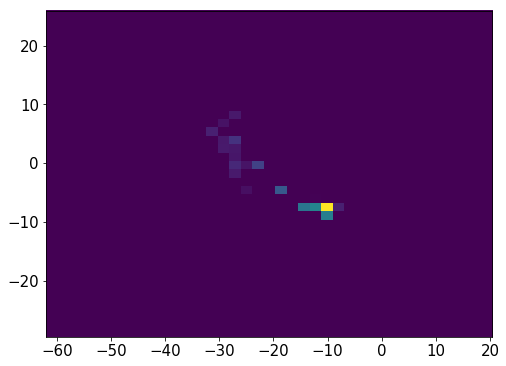

944646    24
944647    24
944648    24
944649    24
944650    24
944651    24
944652    24
944653    24
944654    24
944655    24
944656    24
944657    24
944658    24
944659    24
944660    24
944661    24
944662    24
944663    24
944664    24
944665    24
944666    24
944667    24
944668    24
944669    24
944670    24
944671    24
944674    24
944675    24
944676    24
944677    24
944678    24
944679    24
944680    24
944681    24
944682    24
944683    24
944685    24
944686    24
944687    24
944688    24
944689    24
Name: Nsipm, dtype: uint16


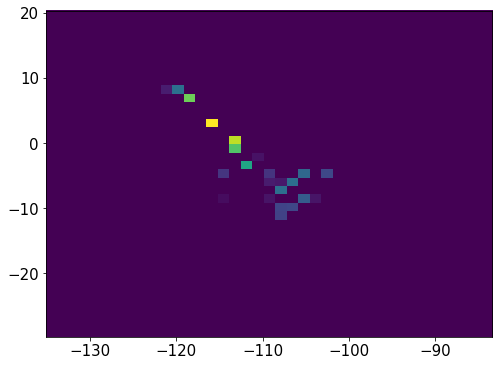

11640    35
11641    35
11642    35
11643    35
11644    35
11645    35
11646    35
11647    35
11648    35
11649    35
11650    35
11651    35
11652    35
11653    35
11654    35
11655    35
11656    35
11657    35
11658    35
11659    35
11660    35
Name: Nsipm, dtype: uint16


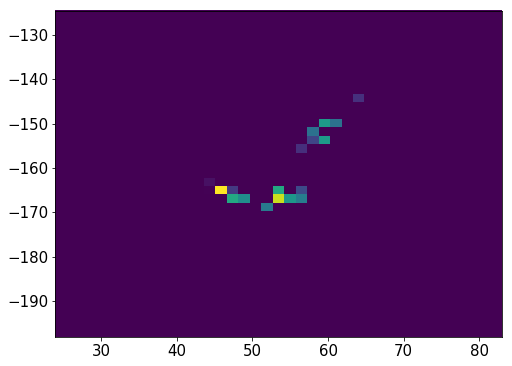

11663    27
11664    27
11665    27
11666    27
11667    27
11668    27
11669    27
11670    27
11671    27
11672    27
11673    27
11674    27
11675    27
11676    27
11677    27
11678    27
11679    27
11680    27
Name: Nsipm, dtype: uint16


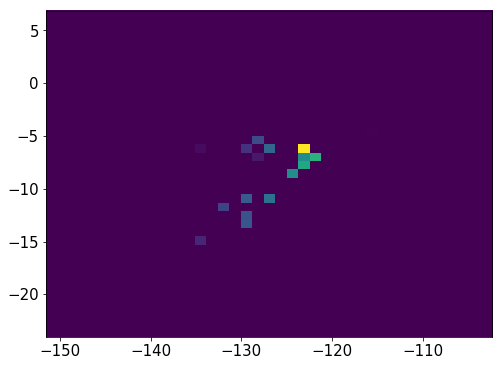

11684    22
11685    22
11686    22
11687    22
11688    22
11689    22
11690    22
11691    22
11692    22
11693    22
11694    22
11695    22
11696    22
11697    22
11698    22
11702    22
11703    22
11704    22
11705    22
11706    22
11707    22
11708    22
11709    22
11710    22
11711    22
Name: Nsipm, dtype: uint16


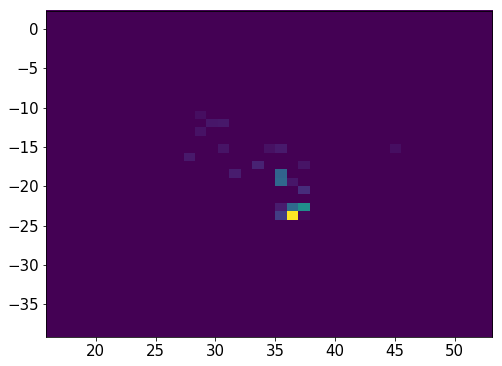

944714    20
944715    20
944716    20
944717    20
944718    20
944719    20
944720    20
944721    20
944722    20
944723    20
944724    20
944725    20
944726    20
944727    20
944728    20
944729    20
944730    20
944731    20
944732    20
Name: Nsipm, dtype: uint16


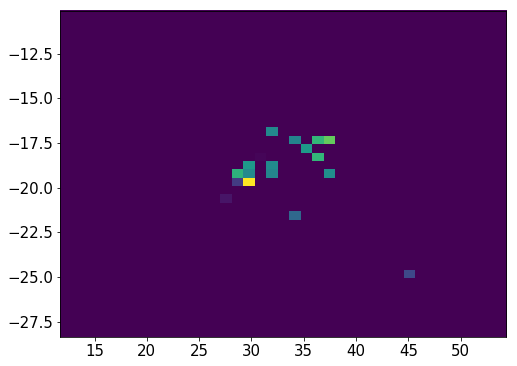

944738    24
944739    24
944740    24
944741    24
944742    24
944743    24
944744    24
944745    24
944746    24
944747    24
944748    24
944749    24
944750    24
944751    24
944752    24
944753    24
944754    24
944755    24
944756    24
944757    24
Name: Nsipm, dtype: uint16


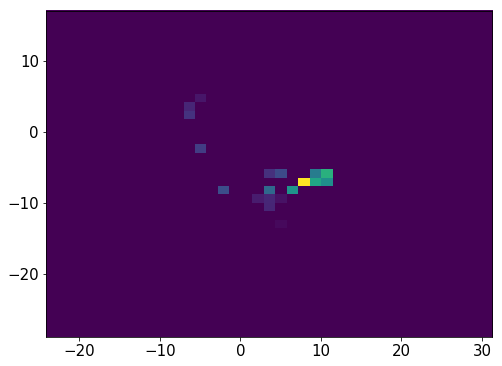

944761    23
944762    23
944763    23
944764    23
944765    23
944766    23
944767    23
944768    23
944769    23
944770    23
944771    23
944772    23
944773    23
944774    23
944775    23
944776    23
944777    23
944778    23
944779    23
944780    23
944781    23
944782    23
Name: Nsipm, dtype: uint16


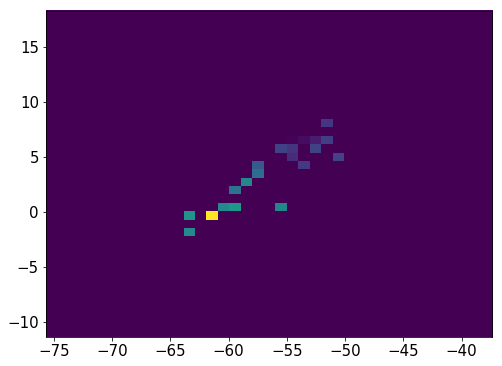

11763    31
11764    31
11765    31
11766    31
11767    31
11768    31
11769    31
11770    31
11771    31
11772    31
11773    31
11774    31
11775    31
11776    31
11777    31
11778    31
11779    31
11780    31
11781    31
11782    31
11783    31
11784    31
11785    31
11786    31
11787    31
11788    31
11789    31
11790    31
11792    31
11793    31
11794    31
11795    31
11796    31
11797    31
11798    31
11799    31
11800    31
11801    31
11802    31
11803    31
11804    31
11805    31
Name: Nsipm, dtype: uint16


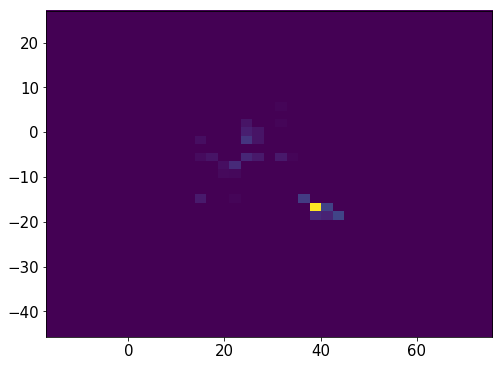

944788    24
944789    24
944790    24
944791    24
944792    24
944793    24
944794    24
944795    24
944796    24
944797    24
944798    24
944799    24
944800    24
944801    24
944802    24
944803    24
944804    24
944805    24
944806    24
944807    24
944808    24
944809    24
Name: Nsipm, dtype: uint16


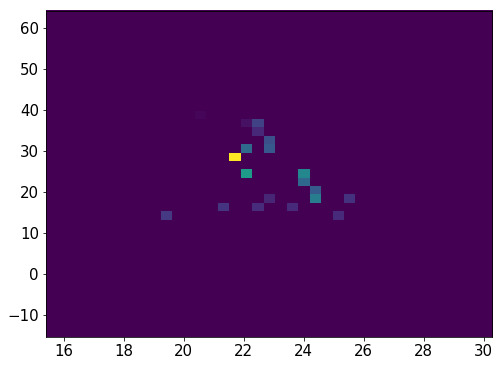

11811    19
11812    19
11813    19
11814    19
11815    19
11816    19
11817    19
11818    19
11819    19
11820    19
11821    19
11822    19
11823    19
11824    19
Name: Nsipm, dtype: uint16


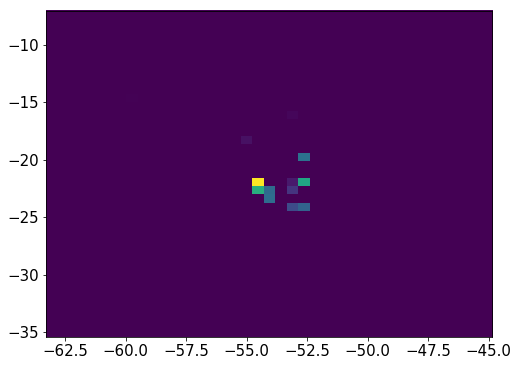

11829    30
11830    30
11831    30
11832    30
11833    30
11834    30
11835    30
11836    30
11837    30
Name: Nsipm, dtype: uint16


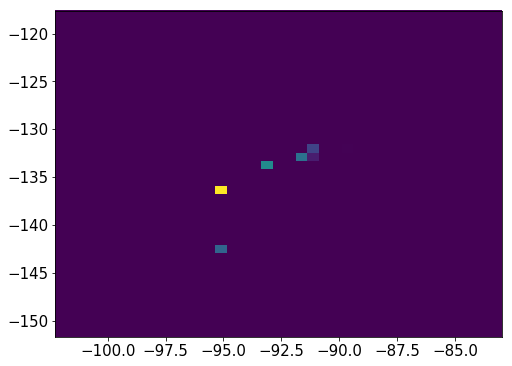

944845    22
944846    22
944847    22
944848    22
944849    22
944850    22
944851    22
944852    22
944853    22
944854    22
944855    22
944856    22
944857    22
944858    22
944859    22
Name: Nsipm, dtype: uint16


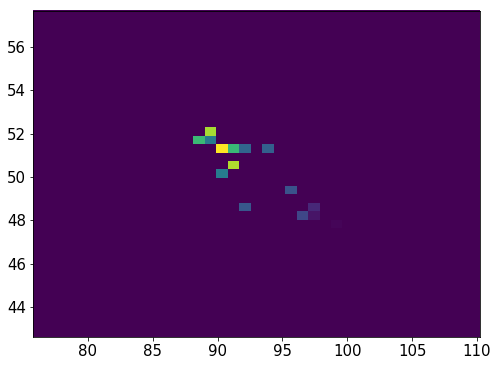

11843    24
11844    24
11845    24
11846    24
11847    24
11848    24
11849    24
11850    24
11851    24
11852    24
11853    24
11854    24
Name: Nsipm, dtype: uint16


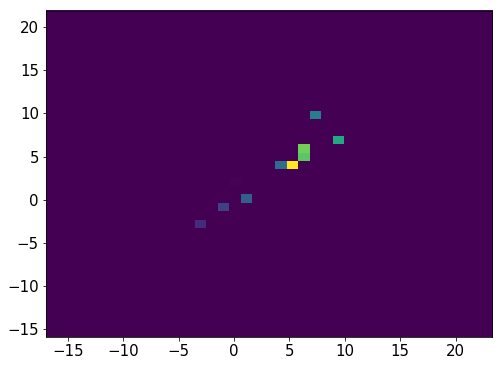

944901    25
944902    25
944903    25
944904    25
944905    25
944906    25
944907    25
944908    25
944909    25
944910    25
944911    25
944912    25
944913    25
944914    25
944915    25
Name: Nsipm, dtype: uint16


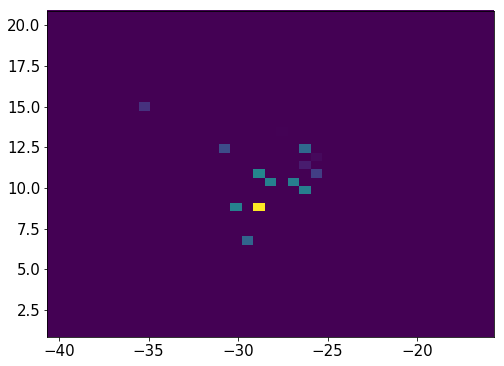

944920    19
944921    19
944922    19
944923    19
944924    19
944925    19
944926    19
944927    19
944928    19
944929    19
944930    19
944931    19
944932    19
944933    19
944934    19
944935    19
944936    19
944937    19
944938    19
944939    19
Name: Nsipm, dtype: uint16


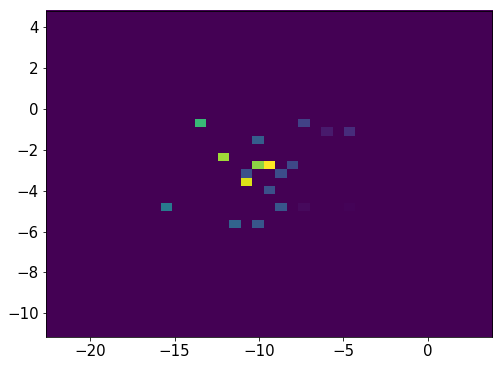

944944    28
944945    28
944946    28
944947    28
944948    28
944949    28
944950    28
944951    28
944952    28
944953    28
944954    28
944955    28
944956    28
944957    28
944958    28
944959    28
944960    28
944961    28
944966     2
944967     2
944968     2
944969     2
Name: Nsipm, dtype: uint16


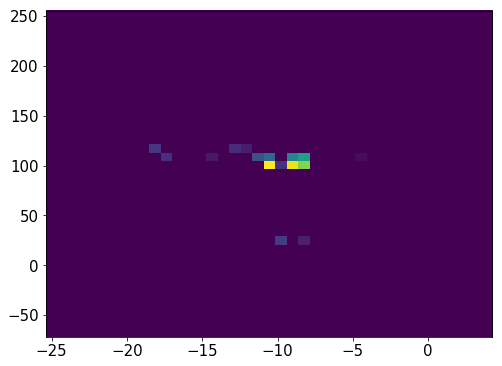

11860    32
11861    32
11862    32
11863    32
11864    32
11865    32
11866    32
11867    32
11868    32
11869    32
11870    32
Name: Nsipm, dtype: uint16


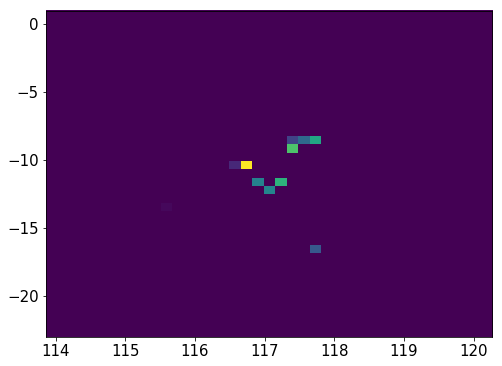

945006    32
945007    32
945008    32
945009    32
945010    32
945011    32
945012    32
945013    32
945014    32
945015    32
945016    32
945017    32
945018    32
945019    32
945020    32
Name: Nsipm, dtype: uint16


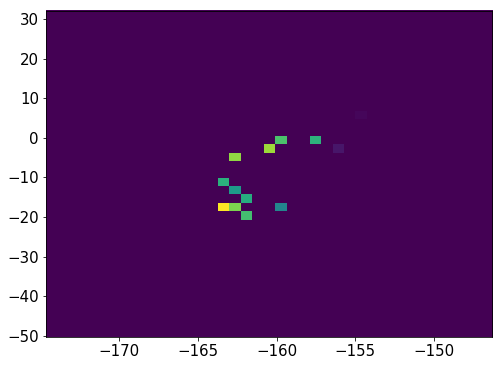

945024    22
945025    22
945026    22
945027    22
945028    22
945029    22
945030    22
945031    22
945032    22
945033    22
945034    22
945035    22
945036    22
945037    22
945043     4
945044     4
945045     4
945046     4
945047     4
945048     4
945049     4
Name: Nsipm, dtype: uint16


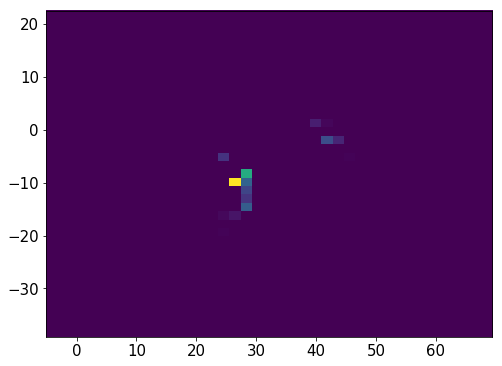

11874    20
11875    20
11876    20
11877    20
11878    20
11879    20
11880    20
11881    20
11882    20
11883    20
11884    20
11885    20
11886    20
11887    20
11888    20
11889    20
11890    20
11891    20
11892    20
11893    20
11894    20
11895    20
11896    20
11897    20
11898    20
Name: Nsipm, dtype: uint16


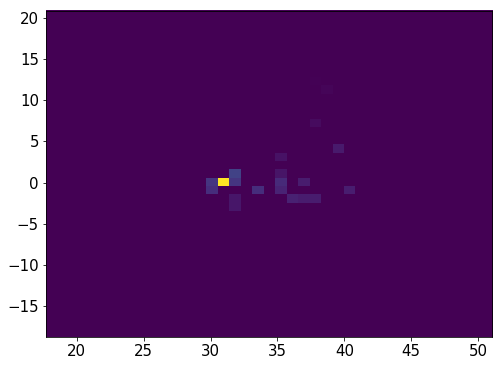

11905    28
11906    28
11907    28
11908    28
11909    28
11910    28
11911    28
11912    28
11913    28
11914    28
11915    28
11916    28
11917    28
11918    28
11919    28
11920    28
11921    28
Name: Nsipm, dtype: uint16


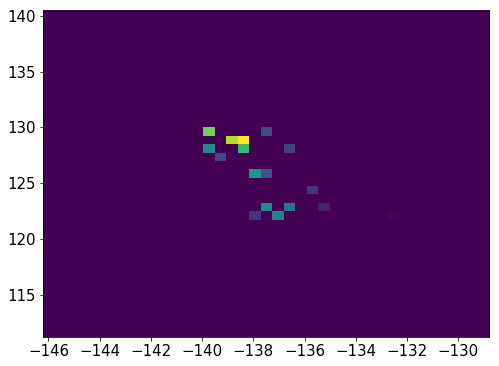

11927    29
11928    29
11929    29
11930    29
11931    29
11932    29
11933    29
11934    29
11935    29
11936    29
11937    29
11938    29
11939    29
11940    29
11941    29
11942    29
11943    29
11944    29
11948     4
11949     4
11950     4
11951     4
11952     4
Name: Nsipm, dtype: uint16


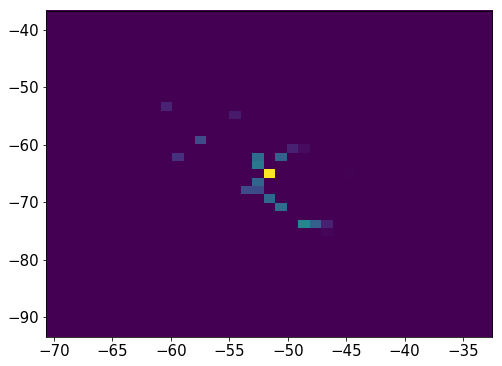

11958    14
11959    14
11960    14
11961    14
11962    14
11963    14
11964    14
11965    14
11966    14
11967    14
11968    14
11969    14
11970    14
11971    14
11972    14
11973    14
11974    14
11975    14
11976    14
11977    14
11978    14
11979    14
11980    14
11981    14
11982    14
11983    14
11984    14
11985    14
11986    14
11988    14
11990    14
11991    14
11993    14
11994    14
11995    14
11996    14
Name: Nsipm, dtype: uint16


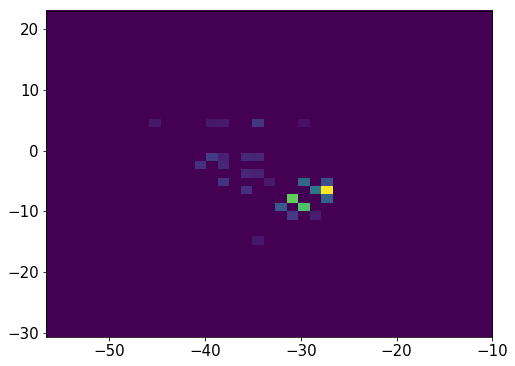

12001    23
12002    23
12003    23
12004    23
12005    23
12006    23
12007    23
12008    23
12009    23
12010    23
12011    23
12012    23
12013    23
12014    23
12015    23
12016    23
12017    23
12018    23
12019    23
12020    23
12021    23
12022    23
12027     2
12028     2
12029     2
12030     2
12031     2
Name: Nsipm, dtype: uint16


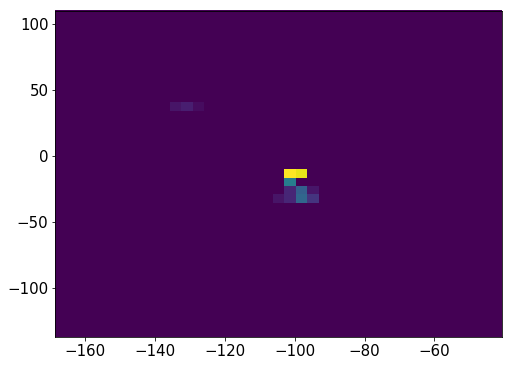

12036    23
12037    23
12038    23
12039    23
12040    23
12041    23
12042    23
12043    23
12044    23
12045    23
12046    23
Name: Nsipm, dtype: uint16


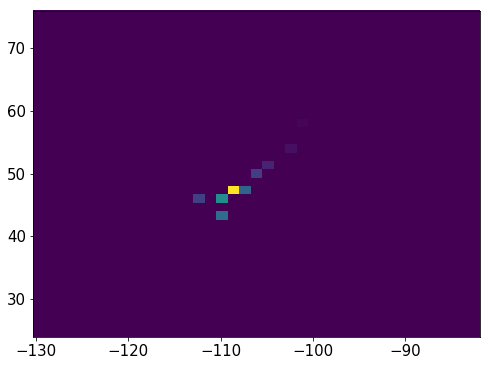

12051    40
12052    40
12053    40
12054    40
12055    40
12056    40
12057    40
12058    40
12059    40
12060    40
12061    40
Name: Nsipm, dtype: uint16


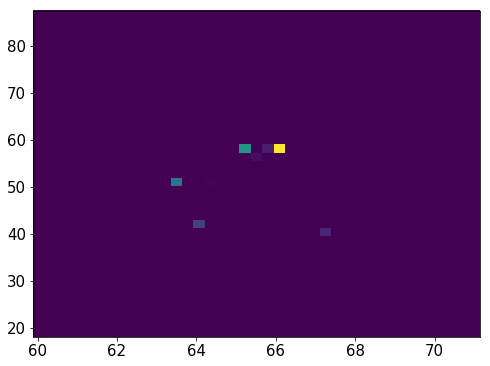

12066    35
12067    35
12068    35
12069    35
12070    35
12071    35
12072    35
12073    35
12074    35
12075    35
12076    35
12077    35
12078    35
12079    35
12080    35
12081    35
12082    35
12083    35
12084    35
12085    35
Name: Nsipm, dtype: uint16


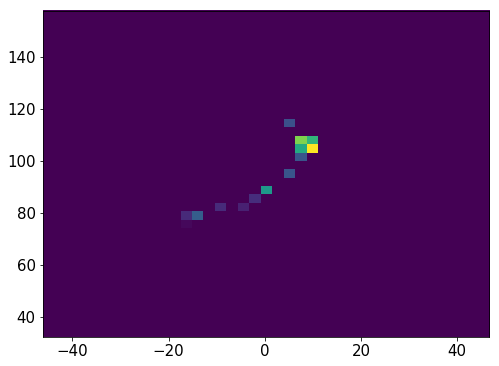

945103    21
945104    21
945105    21
945106    21
945107    21
945108    21
945109    21
945110    21
Name: Nsipm, dtype: uint16


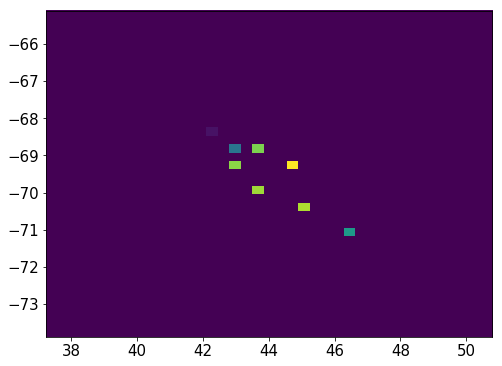

945114    30
945115    30
945116    30
945117    30
945118    30
945119    30
945120    30
945121    30
945122    30
945123    30
945124    30
945125    30
945126    30
945127    30
945128    30
945129    30
945130    30
945131    30
945132    30
945133    30
945134    30
945135    30
945136    30
945137    30
945138    30
945139    30
Name: Nsipm, dtype: uint16


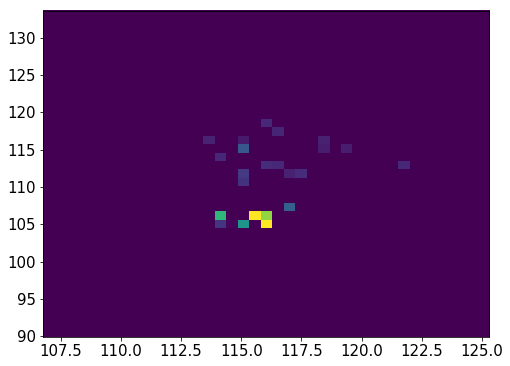

12114    29
12115    29
12116    29
12117    29
12118    29
12119    29
12120    29
12121    29
12122    29
12123    29
12124    29
12125    29
12126    29
12127    29
12128    29
12129    29
12130    29
Name: Nsipm, dtype: uint16


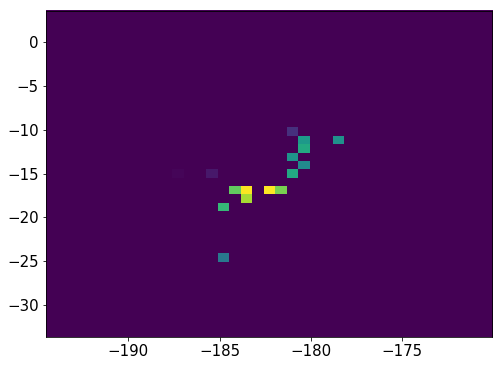

12134    27
12135    27
12136    27
12137    27
12138    27
12139    27
12140    27
12141    27
12142    27
12143    27
12144    27
12145    27
12146    27
12147    27
12148    27
Name: Nsipm, dtype: uint16


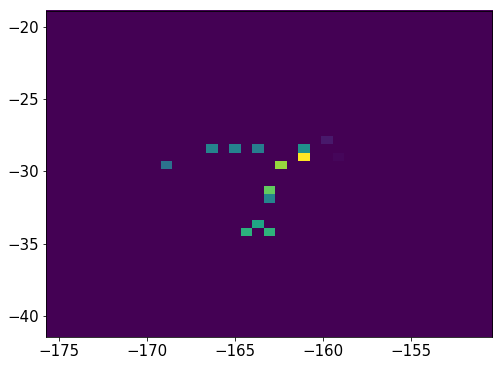

945144    23
945145    23
945146    23
945147    23
945148    23
945149    23
945150    23
945151    23
945152    23
945153    23
945154    23
945155    23
945156    23
945157    23
945162    10
945163    10
945164    10
945165    10
945166    10
945167    10
945168    10
945169    10
945170    10
945171    10
Name: Nsipm, dtype: uint16


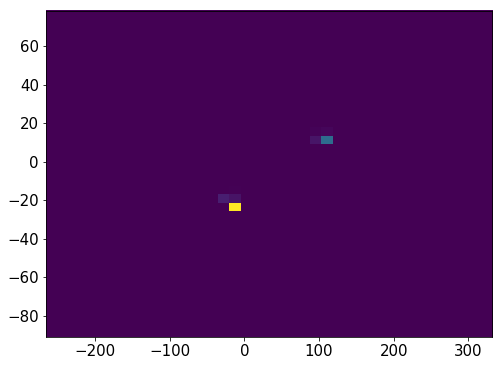

12153    34
12154    34
12155    34
12156    34
12157    34
12158    34
12159    34
12160    34
12161    34
12162    34
12163    34
12164    34
12165    34
Name: Nsipm, dtype: uint16


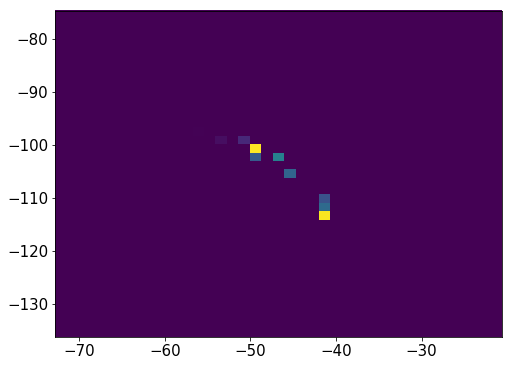

12170    32
12171    32
12172    32
12173    32
12174    32
12175    32
12176    32
12177    32
12178    32
12179    32
12180    32
12181    32
12182    32
12183    32
12184    32
12185    32
12186    32
Name: Nsipm, dtype: uint16


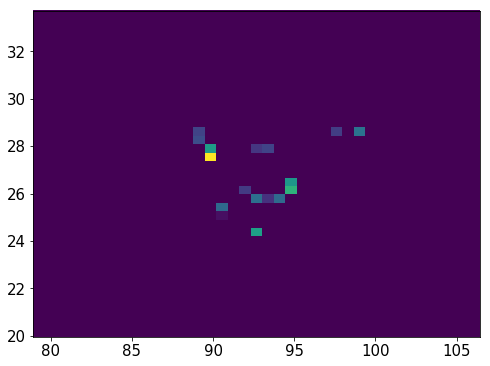

945175    36
945176    36
945177    36
945178    36
945179    36
945180    36
945181    36
945182    36
945183    36
945184    36
945185    36
945186    36
945187    36
945188    36
945189    36
945190    36
945191    36
945192    36
945193    36
945194    36
945195    36
Name: Nsipm, dtype: uint16


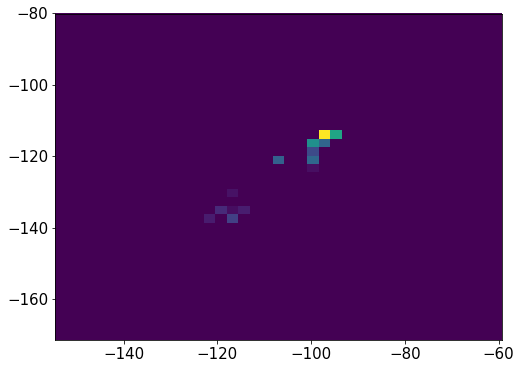

12190    23
12191    23
12192    23
12193    23
12194    23
12195    23
12196    23
12197    23
12198    23
12199    23
12200    23
12201    23
12202    23
12203    23
12204    23
12205    23
12206    23
Name: Nsipm, dtype: uint16


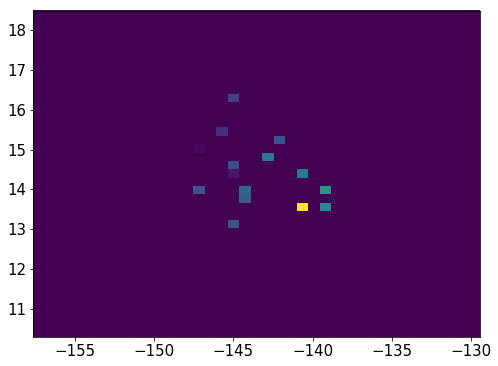

12211    28
12212    28
12213    28
12214    28
12215    28
12216    28
12217    28
12218    28
12219    28
12220    28
12221    28
12222    28
12223    28
12224    28
12226    28
12227    28
12228    28
12229    28
12230    28
12231    28
12235     4
12236     4
12237     4
12238     4
12239     4
Name: Nsipm, dtype: uint16


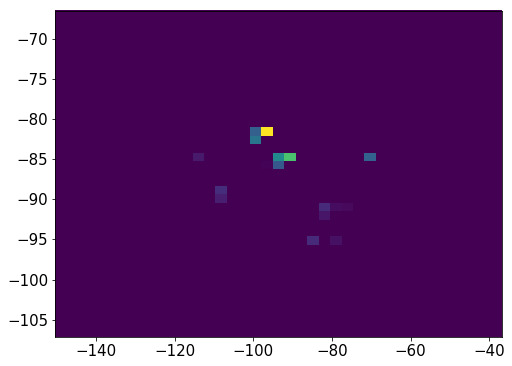

12243    28
12244    28
12245    28
12246    28
12247    28
12248    28
12249    28
12250    28
12251    28
12252    28
12253    28
12254    28
12255    28
12256    28
12257    28
12258    28
12259    28
Name: Nsipm, dtype: uint16


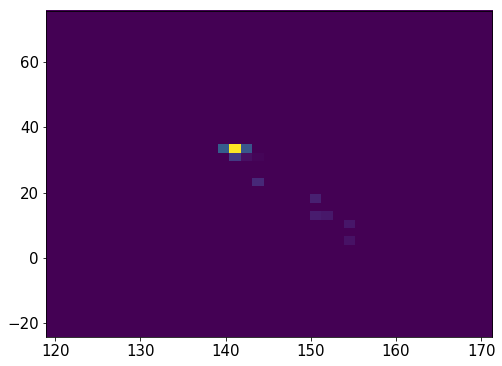

12263    17
12264    17
12265    17
12266    17
12267    17
12268    17
12269    17
12270    17
12271    17
12272    17
12273    17
12274    17
12275    17
12276    17
12277    17
12278    17
12279    17
12280    17
Name: Nsipm, dtype: uint16


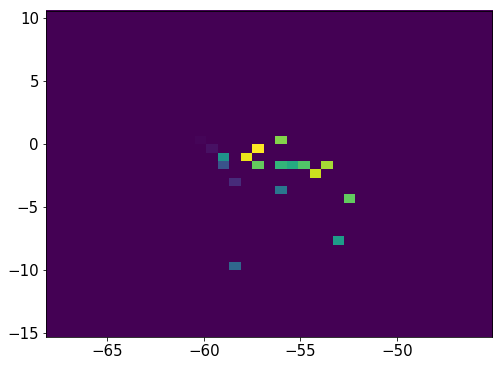

12287    43
12288    43
12289    43
12290    43
12291    43
12292    43
12293    43
12294    43
12295    43
12296    43
12297    43
12298    43
12302    43
12303    43
12304    43
12305    43
12306    43
12307    43
12308    43
12309    43
12312    43
12313    43
12314    43
12315    43
Name: Nsipm, dtype: uint16


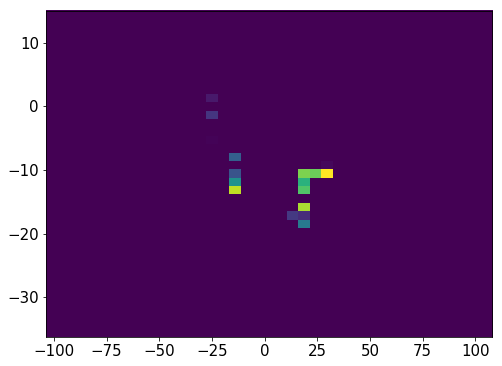

935369    26
935370    26
935371    26
935372    26
935373    26
935374    26
935375    26
935376    26
935377    26
935378    26
935379    26
935380    26
935381    26
935386     1
935387     1
935388     1
935389     1
935390     1
Name: Nsipm, dtype: uint16


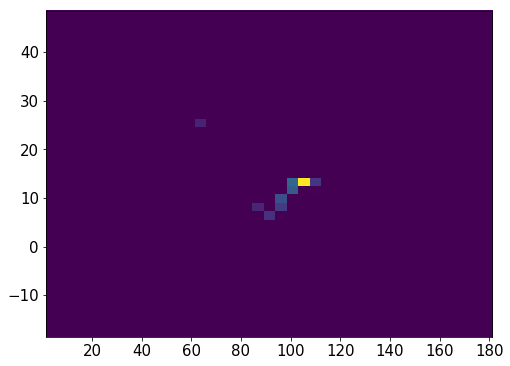

945232    27
945233    27
945234    27
945235    27
945236    27
945237    27
945238    27
945239    27
945240    27
945241    27
945243    27
945244    27
945245    27
945246    27
945247    27
945248    27
945249    27
945250    27
945251    27
945252    27
945253    27
945254    27
945258    27
945259    27
945260    27
945261    27
945262    27
Name: Nsipm, dtype: uint16


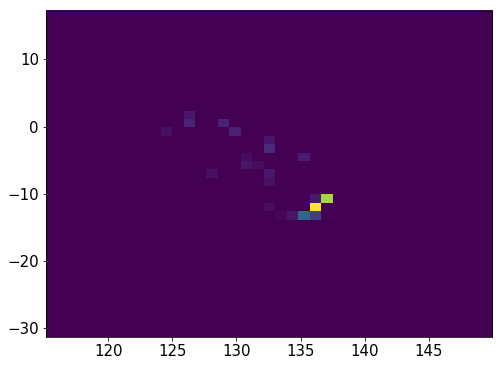

945267    33
945268    33
945269    33
945270    33
945271    33
945272    33
945273    33
945274    33
945275    33
945276    33
945277    33
945278    33
945279    33
945280    33
945281    33
945282    33
945283    33
945284    33
945285    33
945286    33
945290    12
945291    12
945292    12
945293    12
945294    12
945295    12
945296    12
945297    12
945298    12
945299    12
Name: Nsipm, dtype: uint16


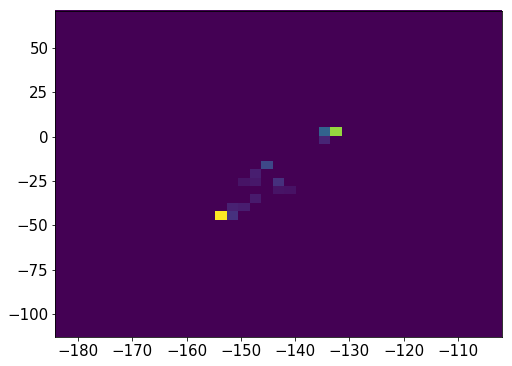

12317    22
12318    22
12319    22
12320    22
12321    22
12322    22
12323    22
12324    22
12325    22
12326    22
12327    22
12328    22
12329    22
12330    22
12331    22
12332    22
12333    22
12334    22
12335    22
12336    22
12337    22
Name: Nsipm, dtype: uint16


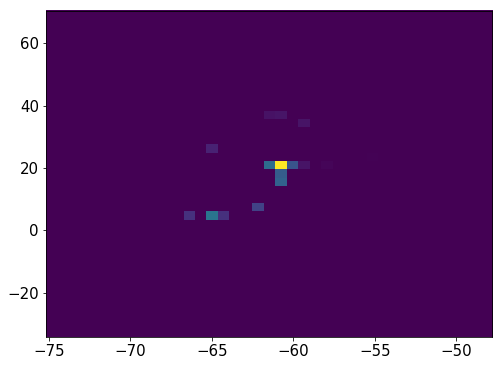

945327    21
945328    21
945329    21
945330    21
945331    21
945332    21
945333    21
945334    21
945335    21
945336    21
945337    21
945338    21
945339    21
945340    21
945341    21
945342    21
945343    21
945347    21
945348    21
945349    21
945350    21
945351    21
945352    21
945353    21
945354    21
Name: Nsipm, dtype: uint16


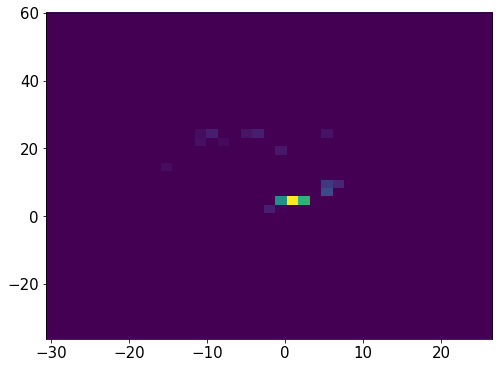

12343    24
12344    24
12345    24
12346    24
12347    24
12348    24
12349    24
12350    24
12351    24
12352    24
12353    24
12354    24
12355    24
12356    24
12357    24
12358    24
12359    24
12360    24
12361    24
12362    24
12363    24
12364    24
12365    24
12366    24
Name: Nsipm, dtype: uint16


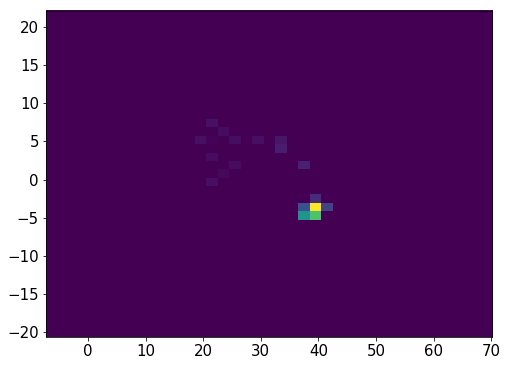

945361    32
945362    32
945363    32
945364    32
945365    32
945366    32
945367    32
945368    32
945369    32
945370    32
945371    32
945372    32
945373    32
945374    32
945375    32
945376    32
945377    32
945378    32
945379    32
945380    32
945381    32
945382    32
Name: Nsipm, dtype: uint16


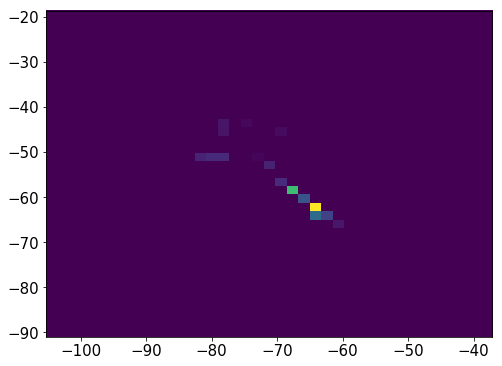

945384    20
945385    20
945386    20
945387    20
945388    20
945389    20
945390    20
945391    20
945392    20
945393    20
945394    20
945395    20
945401     4
945402     4
945403     4
945404     4
945405     4
945406     4
945407     4
Name: Nsipm, dtype: uint16


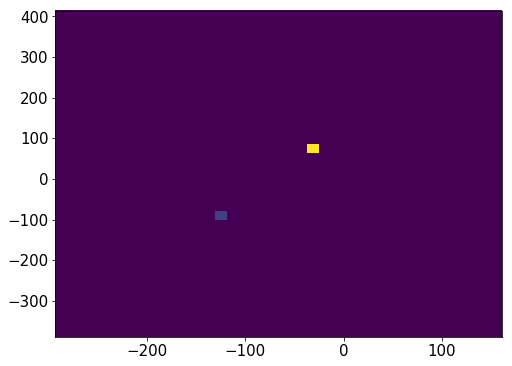

12372    25
12373    25
12374    25
12375    25
12376    25
12377    25
12378    25
12379    25
12380    25
12381    25
12382    25
12383    25
12384    25
12385    25
12386    25
12387    25
12388    25
12389    25
12390    25
12391    25
12392    25
Name: Nsipm, dtype: uint16


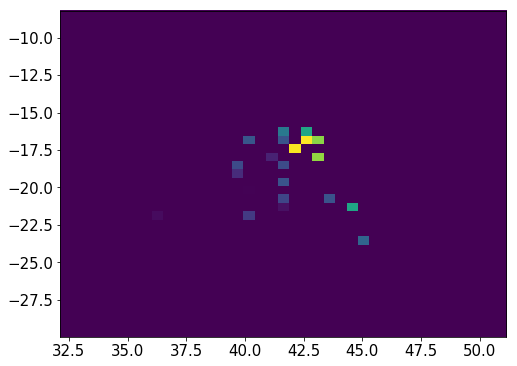

12403    25
12404    25
12405    25
12406    25
12407    25
12408    25
12409    25
12410    25
12411    25
12412    25
12413    25
12414    25
12415    25
12416    25
12417    25
12418    25
12419    25
12420    25
12421    25
12422    25
12425    25
12426    25
12427    25
12428    25
12429    25
Name: Nsipm, dtype: uint16


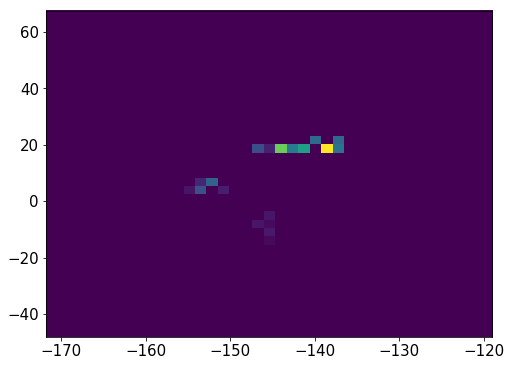

945433    24
945434    24
945435    24
945436    24
945437    24
945438    24
945439    24
945440    24
945441    24
945442    24
945443    24
945444    24
945445    24
945446    24
945447    24
Name: Nsipm, dtype: uint16


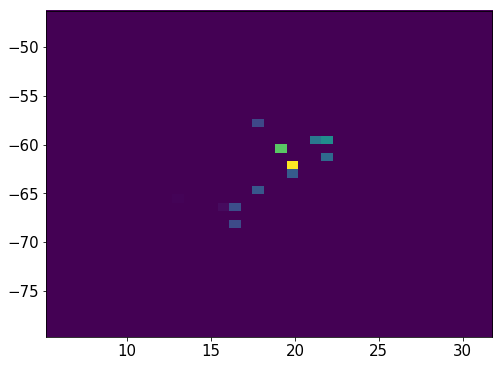

935397    30
935398    30
935399    30
935400    30
935401    30
935402    30
935403    30
935404    30
935405    30
935406    30
935407    30
935408    30
935409    30
935410    30
935417    30
935418    30
935419    30
935420    30
935421    30
Name: Nsipm, dtype: uint16


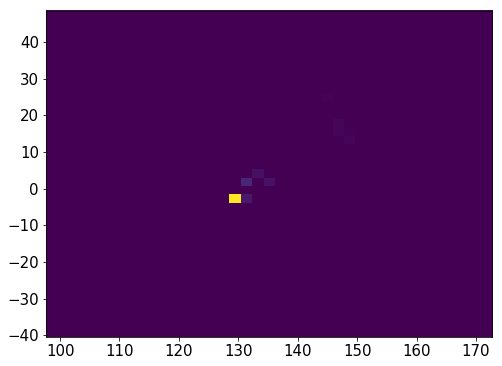

12433    21
12434    21
12435    21
12436    21
12437    21
12438    21
12439    21
12440    21
12441    21
12442    21
12443    21
12444    21
12445    21
12446    21
12447    21
12448    21
12449    21
12450    21
12451    21
12452    21
12453    21
12454    21
12455    21
Name: Nsipm, dtype: uint16


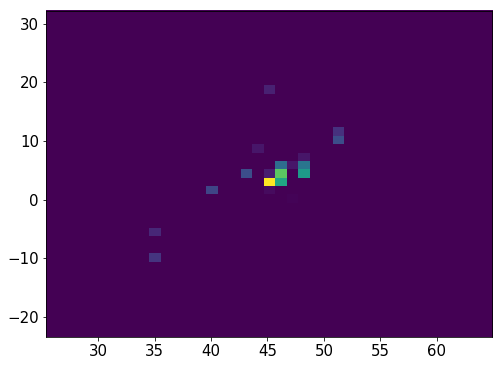

12461    25
12462    25
12463    25
12464    25
12465    25
12466    25
12467    25
12468    25
12469    25
12470    25
12471    25
12472    25
12473    25
Name: Nsipm, dtype: uint16


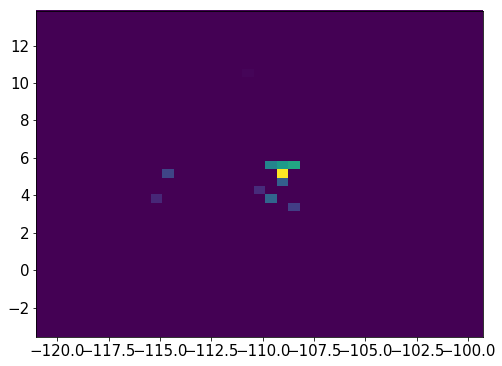

945495    29
945496    29
945497    29
945498    29
945499    29
945500    29
945501    29
945502    29
945503    29
945504    29
945505    29
945506    29
945507    29
945508    29
945509    29
945510    29
945511    29
945512    29
945513    29
945519     2
945520     2
945521     2
945522     2
945523     2
Name: Nsipm, dtype: uint16


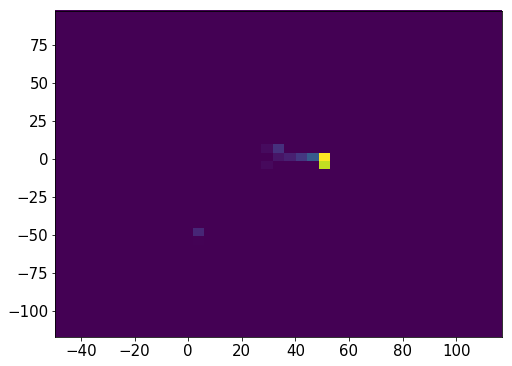

935424    27
935425    27
935426    27
935427    27
935428    27
935429    27
935430    27
935431    27
935432    27
935433    27
935434    27
935435    27
935436    27
935437    27
935438    27
935439    27
935440    27
935441    27
935442    27
935443    27
935444    27
Name: Nsipm, dtype: uint16


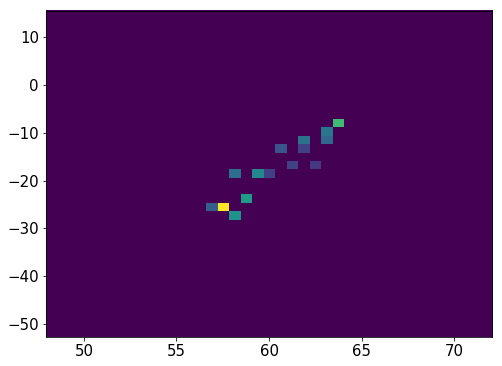

12479    26
12480    26
12481    26
12482    26
12483    26
12484    26
12485    26
12486    26
12487    26
12488    26
12489    26
Name: Nsipm, dtype: uint16


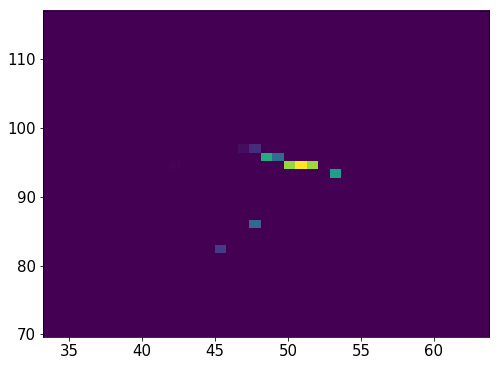

945528    24
945529    24
945530    24
945531    24
945532    24
945533    24
945534    24
945535    24
945536    24
945537    24
945538    24
945539    24
945540    24
945541    24
945542    24
Name: Nsipm, dtype: uint16


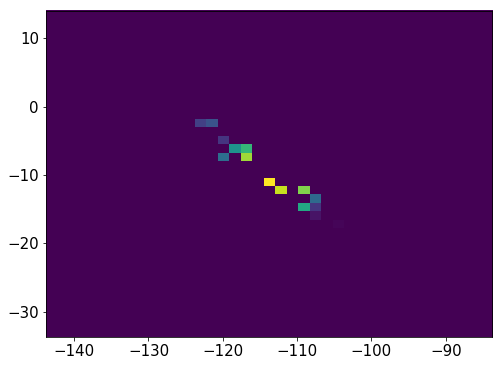

12494    28
12495    28
12496    28
12497    28
12498    28
12499    28
12500    28
12501    28
12502    28
12503    28
12504    28
12505    28
12506    28
12507    28
12508    28
Name: Nsipm, dtype: uint16


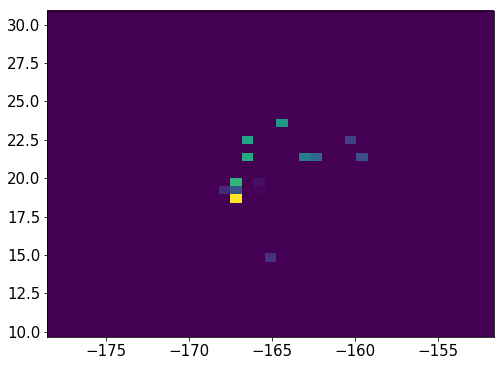

12513    29
12514    29
12515    29
12516    29
12517    29
12518    29
12519    29
12520    29
12521    29
12522    29
12523    29
12524    29
12525    29
12526    29
12527    29
12528    29
12529    29
12530    29
12531    29
12532    29
12533    29
12534    29
12535    29
12536    29
12537    29
12538    29
12539    29
Name: Nsipm, dtype: uint16


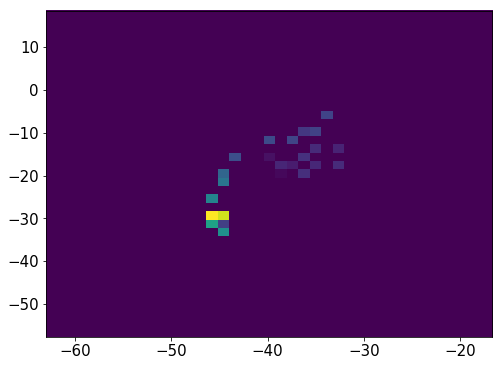

945548    30
945549    30
945550    30
945551    30
945552    30
945553    30
945554    30
945555    30
945556    30
945557    30
945558    30
945559    30
945560    30
945561    30
Name: Nsipm, dtype: uint16


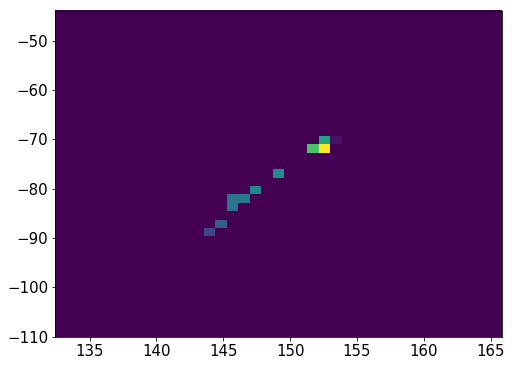

12543    24
12544    24
12545    24
12546    24
12547    24
12548    24
12549    24
12550    24
12551    24
12552    24
12553    24
12554    24
12555    24
12556    24
12557    24
12558    24
12559    24
12560    24
12561    24
Name: Nsipm, dtype: uint16


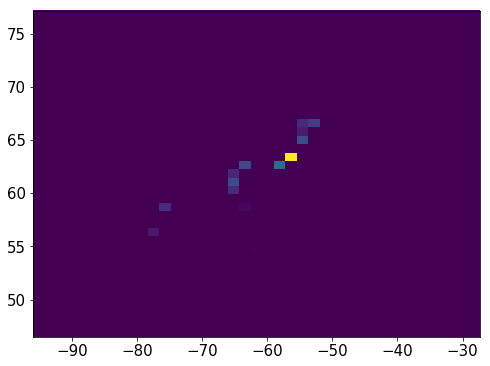

945566    27
945567    27
945568    27
945569    27
945570    27
945571    27
945572    27
945573    27
945574    27
945575    27
945576    27
945577    27
945578    27
945579    27
945580    27
945581    27
945582    27
945583    27
945584    27
945585    27
945586    27
945587    27
945588    27
Name: Nsipm, dtype: uint16


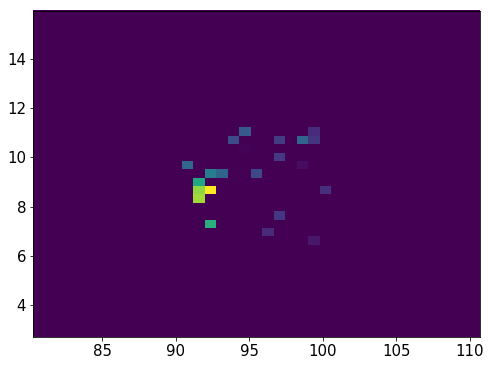

12565    31
12566    31
12567    31
12568    31
12569    31
12570    31
12571    31
12572    31
12573    31
12574    31
12575    31
12576    31
12577    31
12578    31
12579    31
12580    31
Name: Nsipm, dtype: uint16


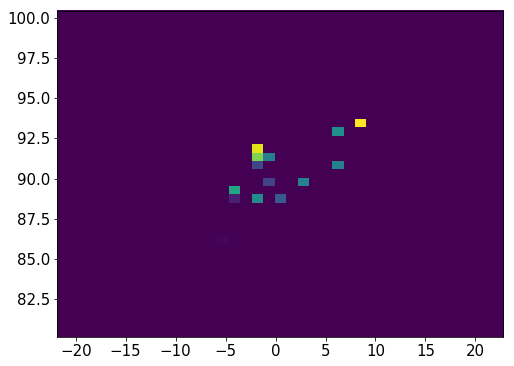

12584    23
12585    23
12586    23
12587    23
12588    23
12589    23
12590    23
12591    23
12592    23
12593    23
12594    23
12595    23
12596    23
Name: Nsipm, dtype: uint16


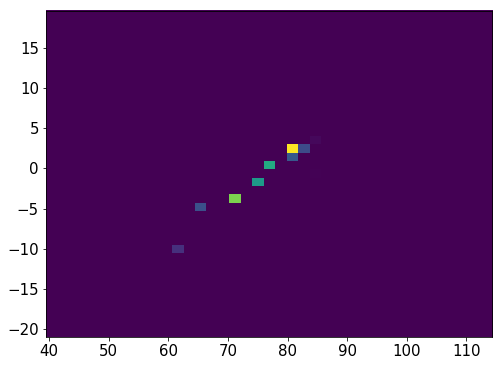

945593    21
945594    21
945595    21
945596    21
945597    21
945598    21
945599    21
945600    21
945601    21
945602    21
945603    21
945604    21
945605    21
945606    21
945607    21
945608    21
945609    21
945610    21
945611    21
945612    21
945613    21
945614    21
945615    21
945616    21
Name: Nsipm, dtype: uint16


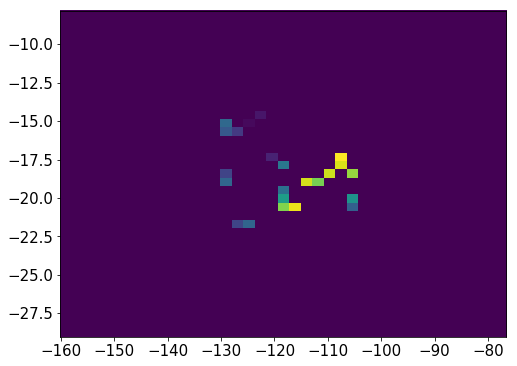

945620    23
945621    23
945622    23
945623    23
945624    23
945625    23
945626    23
945627    23
945630    11
945631    11
945632    11
945633    11
945634    11
945635    11
945636    11
945637    11
Name: Nsipm, dtype: uint16


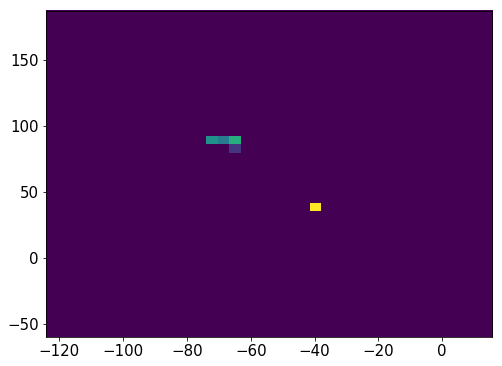

945642    26
945643    26
945644    26
945645    26
945646    26
945647    26
945648    26
945649    26
945650    26
945651    26
945652    26
945653    26
945654    26
945655    26
945656    26
945657    26
945658    26
945659    26
Name: Nsipm, dtype: uint16


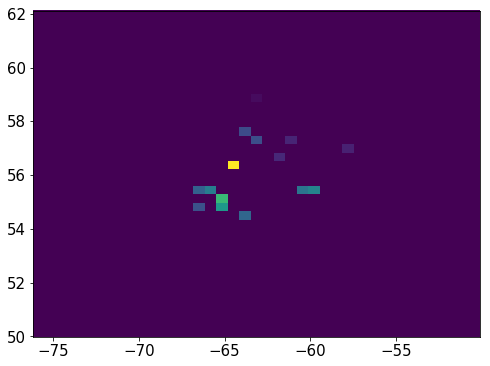

12602    31
12603    31
12604    31
12605    31
12606    31
12607    31
12608    31
12609    31
12610    31
12611    31
12612    31
12613    31
12614    31
12615    31
12616    31
12617    31
12618    31
12619    31
12620    31
12621    31
12622    31
12623    31
Name: Nsipm, dtype: uint16


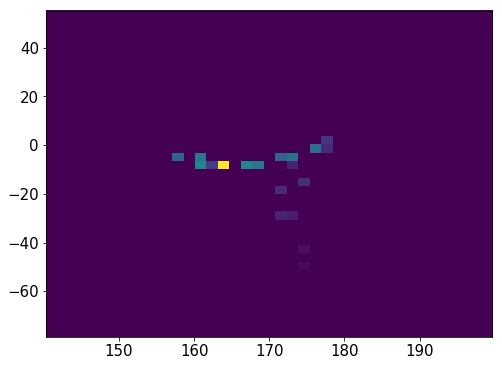

945682    28
945683    28
945684    28
945685    28
945686    28
945687    28
945688    28
945689    28
945690    28
945691    28
945692    28
945693    28
945694    28
945695    28
945696    28
945697    28
945698    28
945699    28
945703     7
945704     7
945705     7
945706     7
945707     7
945708     7
945709     7
945710     7
945711     7
945712     7
945713     7
945714     7
945715     7
Name: Nsipm, dtype: uint16


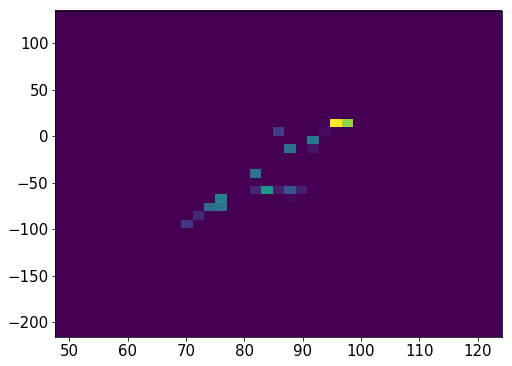

12627    18
12628    18
12629    18
12630    18
12631    18
12632    18
12633    18
12634    18
12635    18
12636    18
12637    18
12638    18
Name: Nsipm, dtype: uint16


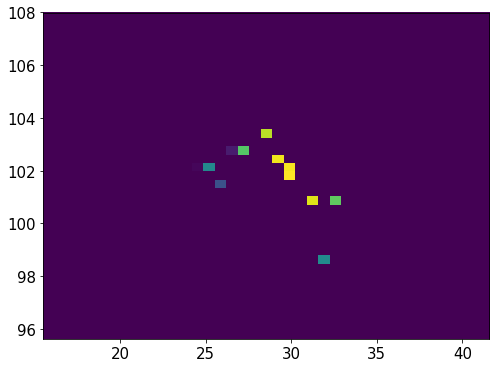

12642    26
12643    26
12644    26
12645    26
12646    26
12647    26
12648    26
12649    26
12650    26
12651    26
12652    26
12653    26
12654    26
12655    26
12656    26
12657    26
12658    26
12659    26
12661    26
12663    26
Name: Nsipm, dtype: uint16


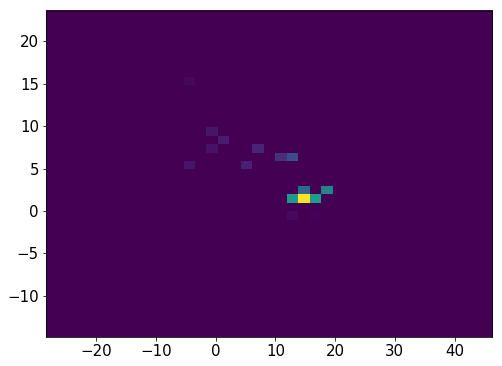

12667    21
12668    21
12669    21
12670    21
12671    21
12672    21
12673    21
12674    21
12675    21
12676    21
12677    21
12678    21
12679    21
12680    21
12681    21
12682    21
12683    21
12684    21
12685    21
12686    21
12687    21
12688    21
12689    21
12690    21
12691    21
12692    21
12694    21
12695    21
12696    21
12697    21
12698    21
12699    21
12700    21
12701    21
12702    21
12703    21
12704    21
12705    21
Name: Nsipm, dtype: uint16


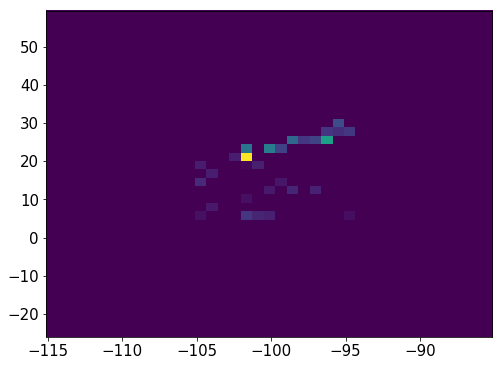

935473    29
935474    29
935475    29
935476    29
935477    29
935478    29
935479    29
935480    29
935481    29
935482    29
935483    29
935484    29
935485    29
935486    29
935487    29
935488    29
935489    29
935490    29
935491    29
Name: Nsipm, dtype: uint16


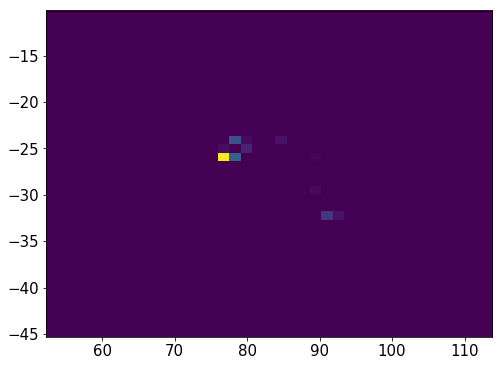

12709    51
12710    51
12711    51
12715    51
12716    51
12717    51
12718    51
12719    51
12720    51
12721    51
12722    51
12723    51
12724    51
12725    51
12726    51
12727    51
12728    51
12729    51
12730    51
12731    51
12732    51
12733    51
12734    51
12735    51
12736    51
12737    51
12738    51
12739    51
12740    51
12741    51
12742    51
12743    51
12744    51
12745    51
12746    51
12747    51
12748    51
12749    51
12750    51
12751    51
12752    51
12753    51
12754    51
12756    51
12757    51
12758    51
12759    51
12760    51
12761    51
12762    51
12763    51
12764    51
12765    51
12766    51
Name: Nsipm, dtype: uint16


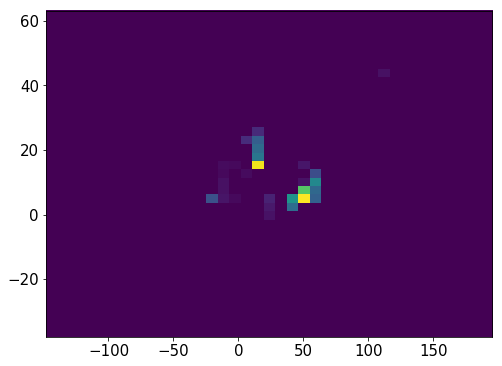

12767    23
12768    23
12769    23
12770    23
12771    23
12772    23
12773    23
12774    23
12775    23
12776    23
12777    23
12778    23
12779    23
12780    23
12781    23
12782    23
12783    23
12784    23
12785    23
Name: Nsipm, dtype: uint16


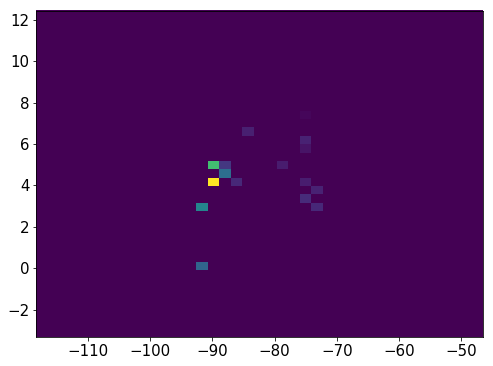

2270720    30
2270721    30
2270722    30
2270723    30
2270724    30
2270725    30
2270726    30
2270727    30
2270728    30
2270729    30
2270730    30
2270731    30
2270732    30
2270733    30
2270734    30
2270735    30
2270736    30
2270737    30
2270738    30
2270739    30
Name: Nsipm, dtype: uint16


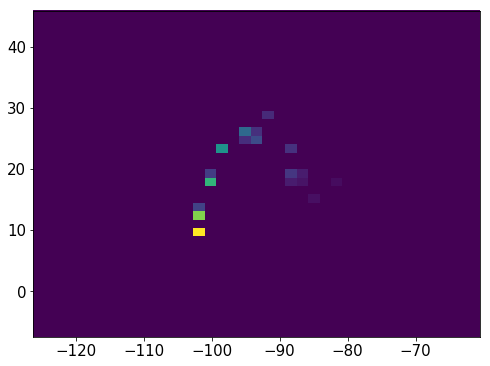

12791    25
12792    25
12793    25
12794    25
12795    25
12796    25
12797    25
12798    25
12799    25
12800    25
12801    25
12802    25
12803    25
12804    25
12807    25
12808    25
12809    25
12810    25
12811    25
12812    25
12813    25
12814    25
12815    25
12817    25
12818    25
12819    25
12820    25
12821    25
12822    25
12823    25
12824    25
12825    25
Name: Nsipm, dtype: uint16


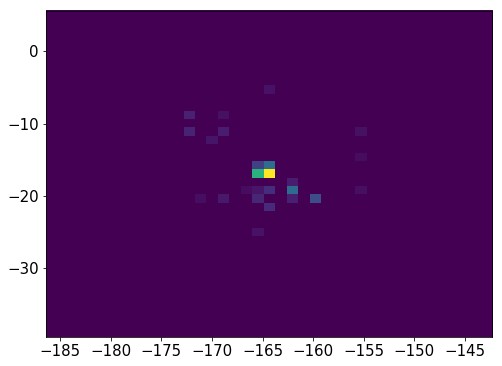

12830    21
12831    21
12832    21
12833    21
12834    21
12835    21
12836    21
12837    21
12838    21
12839    21
12840    21
12841    21
12842    21
12843    21
12844    21
Name: Nsipm, dtype: uint16


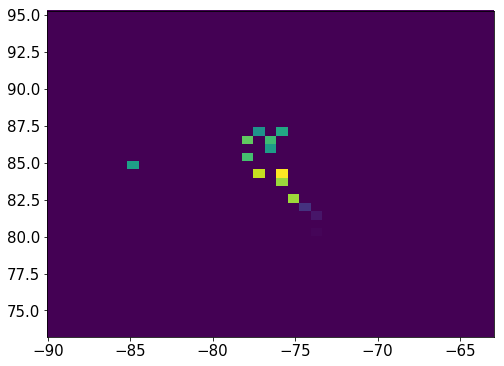

945789    38
945790    38
945791    38
945792    38
945793    38
945794    38
945795    38
945796    38
945797    38
945798    38
945799    38
945800    38
945801    38
945802    38
945803    38
945804    38
945805    38
945806    38
945807    38
945808    38
945809    38
945810    38
Name: Nsipm, dtype: uint16


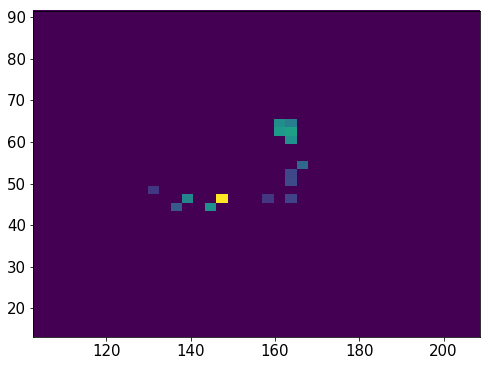

945815    31
945816    31
945817    31
945818    31
945819    31
945820    31
945821    31
945822    31
945823    31
945824    31
945825    31
945826    31
945827    31
945828    31
945829    31
945830    31
945831    31
945836     2
945837     2
945838     2
945839     2
945840     2
Name: Nsipm, dtype: uint16


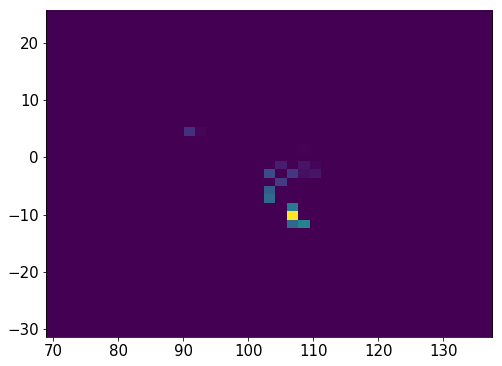

945845    33
945846    33
945847    33
945848    33
945849    33
945850    33
945851    33
945852    33
945853    33
945854    33
945855    33
945856    33
945857    33
945858    33
945859    33
945860    33
945861    33
945862    33
945863    33
945864    33
945865    33
945866    33
945867    33
945868    33
Name: Nsipm, dtype: uint16


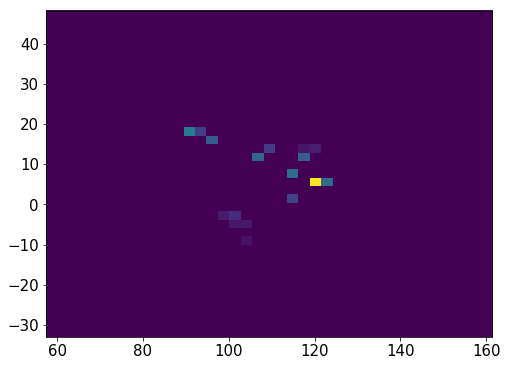

945873    27
945874    27
945875    27
945876    27
945877    27
945878    27
945879    27
945880    27
945881    27
945882    27
945883    27
945884    27
945885    27
945886    27
945887    27
945888    27
945889    27
945895     1
945896     1
945897     1
945898     1
945899     1
Name: Nsipm, dtype: uint16


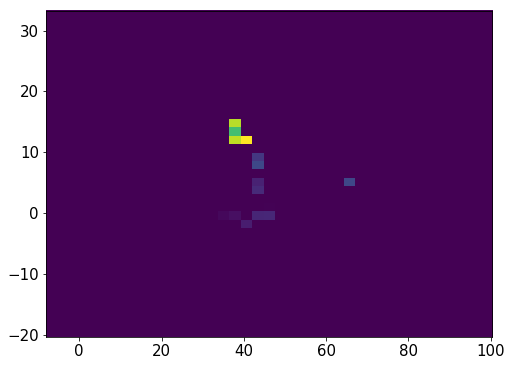

945903    32
945904    32
945905    32
945906    32
945907    32
945908    32
945909    32
945910    32
945911    32
945912    32
945913    32
945914    32
945915    32
945916    32
945917    32
945918    32
945919    32
Name: Nsipm, dtype: uint16


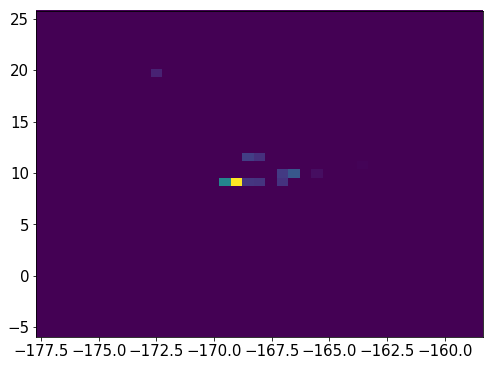

945925    23
945926    23
945927    23
945928    23
945929    23
945930    23
945931    23
945932    23
945933    23
945934    23
945935    23
945936    23
945937    23
945938    23
945939    23
945940    23
945941    23
945942    23
Name: Nsipm, dtype: uint16


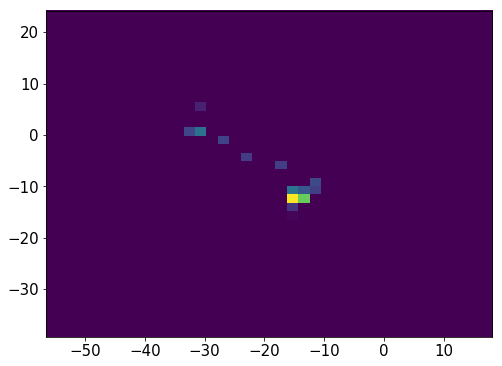

12849    29
12850    29
12851    29
12852    29
12853    29
12854    29
12855    29
12856    29
12857    29
12858    29
Name: Nsipm, dtype: uint16


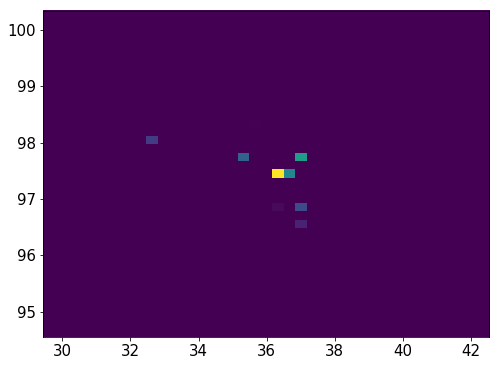

12863    33
12864    33
12865    33
12866    33
12867    33
12868    33
12869    33
12870    33
12871    33
12872    33
12873    33
12874    33
12875    33
12876    33
12877    33
12878    33
12879    33
12880    33
12881    33
12882    33
12883    33
12884    33
12885    33
12886    33
12887    33
Name: Nsipm, dtype: uint16


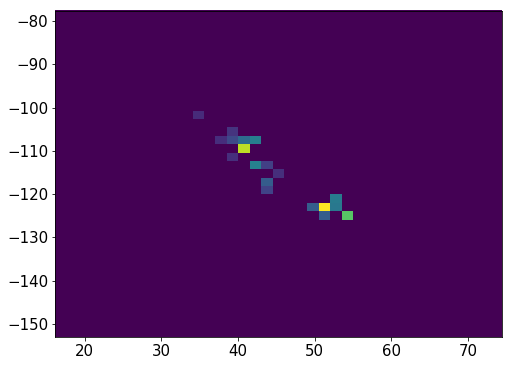

945986    27
945987    27
945988    27
945989    27
945990    27
945991    27
945992    27
945993    27
945994    27
945995    27
945996    27
945997    27
945998    27
Name: Nsipm, dtype: uint16


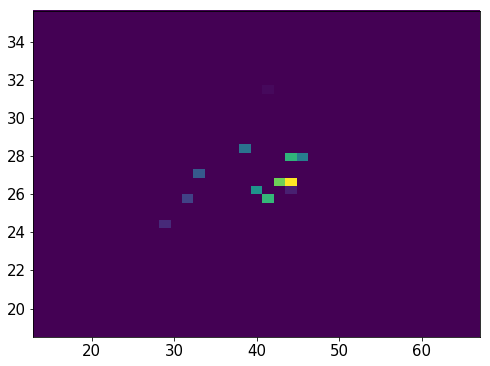

946002    23
946003    23
946004    23
946005    23
946006    23
946007    23
946008    23
946009    23
946010    23
946011    23
946012    23
946013    23
946014    23
946015    23
946016    23
946017    23
946018    23
946019    23
946020    23
946021    23
946022    23
946023    23
Name: Nsipm, dtype: uint16


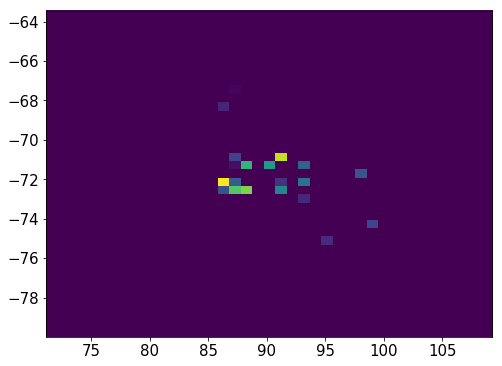

12890    21
12891    21
12892    21
12893    21
12894    21
12895    21
12896    21
12897    21
12898    21
12899    21
12900    21
12901    21
12902    21
12903    21
12904    21
12905    21
12906    21
12907    21
12908    21
12909    21
12910    21
12911    21
12912    21
Name: Nsipm, dtype: uint16


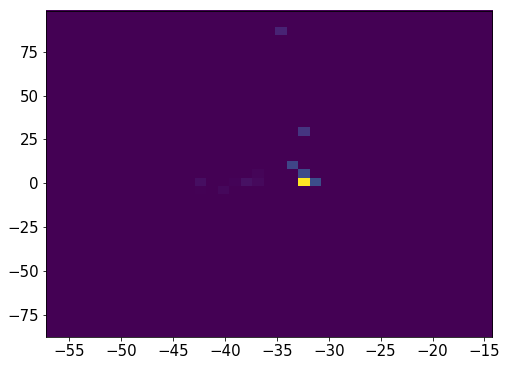

1900605    34
1900606    34
1900607    34
1900608    34
1900609    34
1900610    34
1900611    34
1900612    34
1900613    34
1900614    34
1900615    34
1900616    34
1900617    34
1900618    34
1900619    34
1900620    34
1900621    34
1900622    34
1900623    34
1900624    34
1900625    34
1900626    34
1900627    34
1900628    34
1900629    34
1900630    34
1900631    34
1900632    34
1900633    34
1900634    34
1900635    34
Name: Nsipm, dtype: uint16


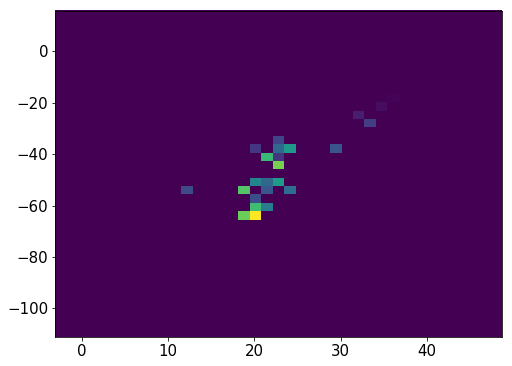

946028    25
946029    25
946030    25
946031    25
946032    25
946033    25
946035    25
946036    25
946037    25
946038    25
946039    25
946040    25
946041    25
946042    25
946043    25
946044    25
946045    25
946046    25
946047    25
946048    25
Name: Nsipm, dtype: uint16


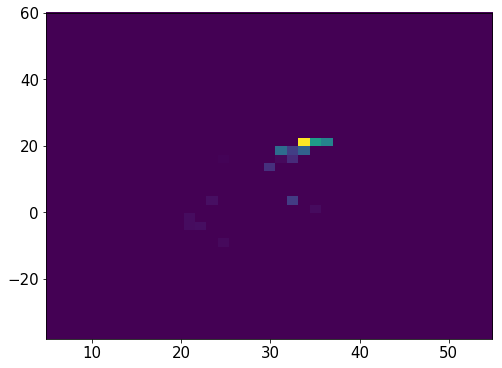

12918    25
12919    25
12920    25
12921    25
12922    25
12923    25
12924    25
12925    25
12926    25
12927    25
12928    25
12929    25
12930    25
12931    25
12932    25
Name: Nsipm, dtype: uint16


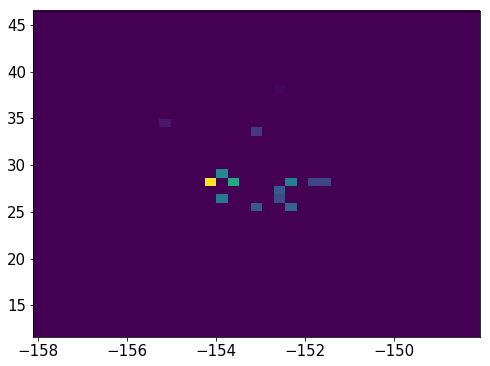

12937    23
12938    23
12939    23
12940    23
12941    23
12942    23
12943    23
12944    23
12945    23
12946    23
12947    23
12948    23
12949    23
12950    23
12951    23
12952    23
12953    23
12958     1
12959     1
12960     1
12961     1
Name: Nsipm, dtype: uint16


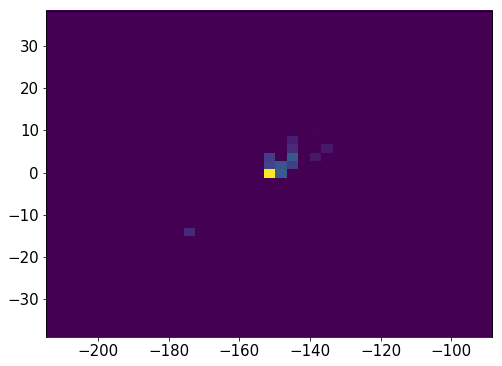

946074    27
946075    27
946076    27
946077    27
946078    27
946079    27
946080    27
946081    27
946082    27
946083    27
946084    27
946085    27
946086    27
946087    27
946088    27
Name: Nsipm, dtype: uint16


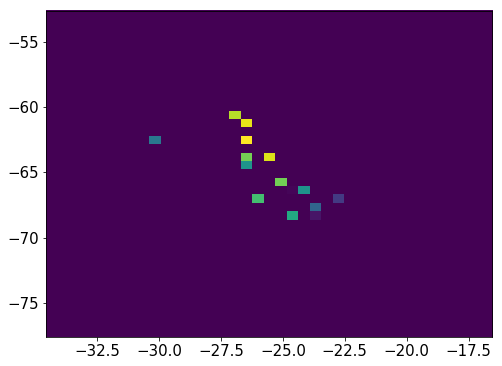

946094    23
946095    23
946096    23
946097    23
946098    23
946099    23
946100    23
946101    23
946102    23
946103    23
946104    23
946105    23
946106    23
946107    23
946108    23
946109    23
946110    23
946111    23
946112    23
946113    23
Name: Nsipm, dtype: uint16


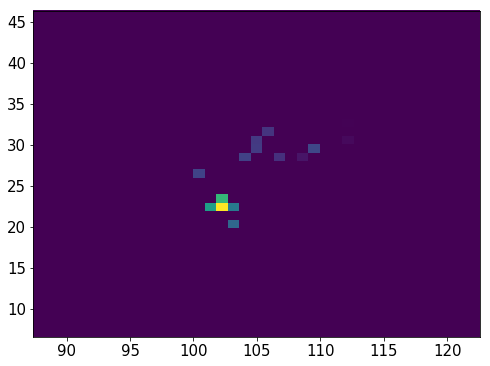

946119    33
946120    33
946121    33
946122    33
946123    33
946124    33
946125    33
946126    33
946127    33
946128    33
946129    33
946130    33
946131    33
946132    33
946133    33
946134    33
946135    33
946136    33
946137    33
946138    33
946139    33
946140    33
946141    33
946143    33
946145    33
946146    33
946147    33
946148    33
946149    33
946150    33
Name: Nsipm, dtype: uint16


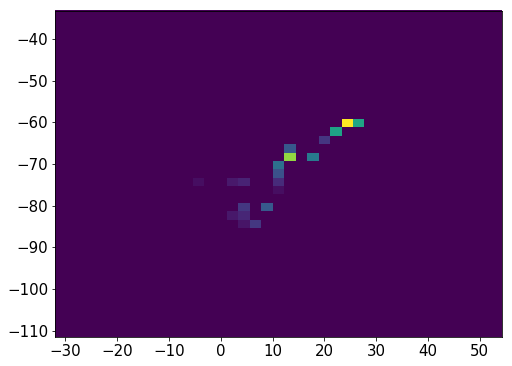

946156    26
946157    26
946158    26
946159    26
946160    26
946161    26
946162    26
946163    26
946164    26
946165    26
946166    26
946167    26
946168    26
946169    26
946170    26
946171    26
946172    26
946173    26
946174    26
Name: Nsipm, dtype: uint16


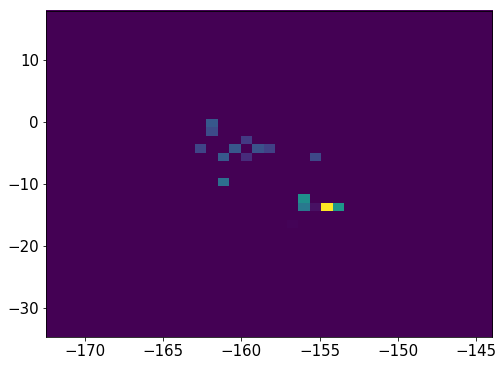

12966    35
12967    35
12968    35
12969    35
12970    35
12971    35
12972    35
12973    35
12974    35
12975    35
12976    35
12977    35
12978    35
12979    35
12980    35
12981    35
12982    35
12983    35
12984    35
12985    35
12986    35
12987    35
12988    35
12989    35
Name: Nsipm, dtype: uint16


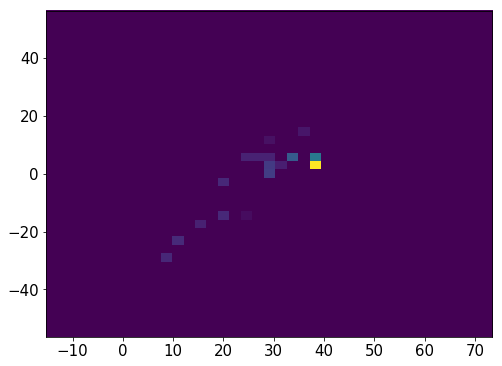

946202    22
946203    22
946204    22
946205    22
946206    22
946207    22
946208    22
946209    22
946210    22
946211    22
946212    22
946213    22
946214    22
946215    22
946216    22
946217    22
946218    22
946219    22
Name: Nsipm, dtype: uint16


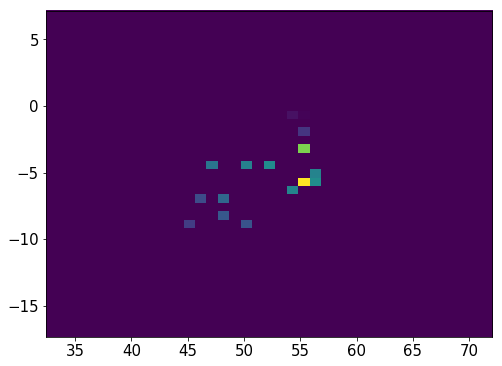

946225    23
946226    23
946227    23
946228    23
946229    23
946230    23
946231    23
946232    23
946233    23
946234    23
946235    23
946236    23
946237    23
946238    23
946239    23
946240    23
946241    23
946242    23
946243    23
946244    23
946245    23
946246    23
946247    23
946248    23
946249    23
946250    23
946251    23
946252    23
946253    23
Name: Nsipm, dtype: uint16


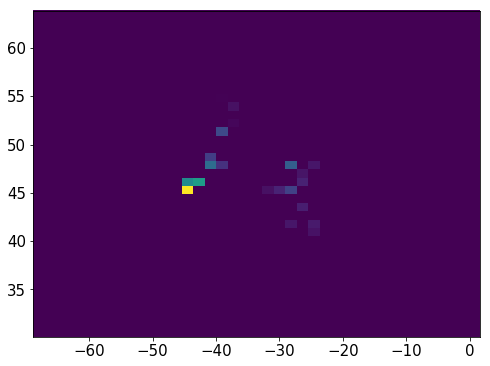

1900653    24
1900654    24
1900655    24
1900656    24
1900657    24
1900658    24
1900659    24
1900660    24
1900661    24
1900662    24
1900663    24
1900664    24
1900665    24
1900666    24
1900667    24
1900668    24
Name: Nsipm, dtype: uint16


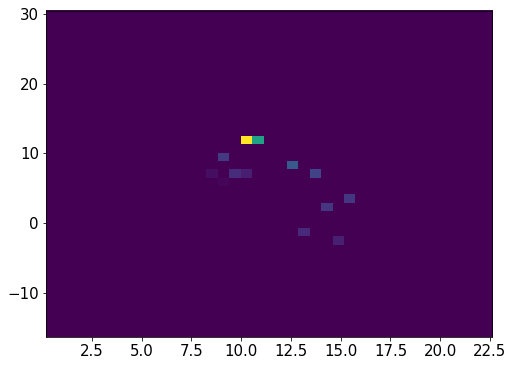

946258    23
946259    23
946260    23
946261    23
946262    23
946263    23
946264    23
946265    23
946266    23
946267    23
946268    23
946269    23
946270    23
946271    23
946272    23
946273    23
946274    23
946275    23
946276    23
946277    23
946278    23
Name: Nsipm, dtype: uint16


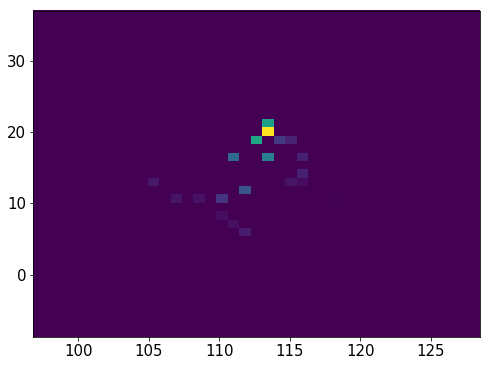

12996    34
12997    34
12998    34
12999    34
13000    34
13001    34
13002    34
13003    34
13004    34
13005    34
13006    34
13007    34
Name: Nsipm, dtype: uint16


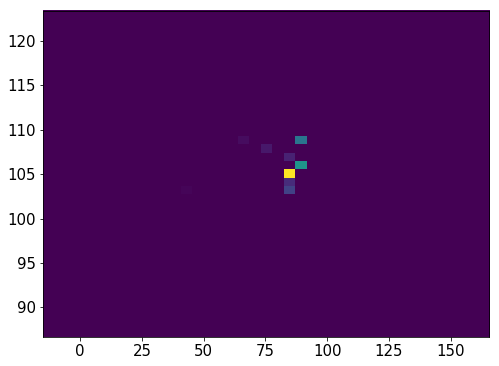

946290    36
946291    36
946292    36
946293    36
946294    36
946295    36
946296    36
946297    36
946298    36
946299    36
946300    36
946301    36
946302    36
946303    36
946304    36
946305    36
946306    36
946307    36
Name: Nsipm, dtype: uint16


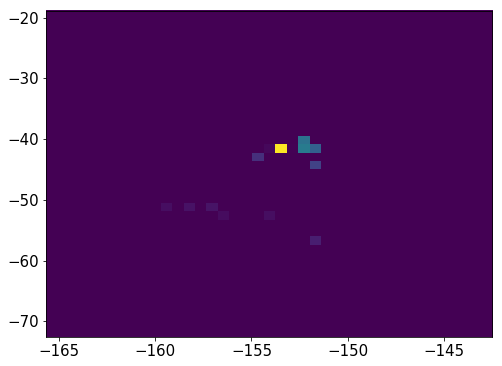

13013    27
13014    27
13015    27
13016    27
13017    27
13018    27
13019    27
13020    27
13021    27
13022    27
13023    27
13024    27
13025    27
13026    27
13027    27
13028    27
13029    27
13030    27
13031    27
13032    27
13033    27
13034    27
13035    27
Name: Nsipm, dtype: uint16


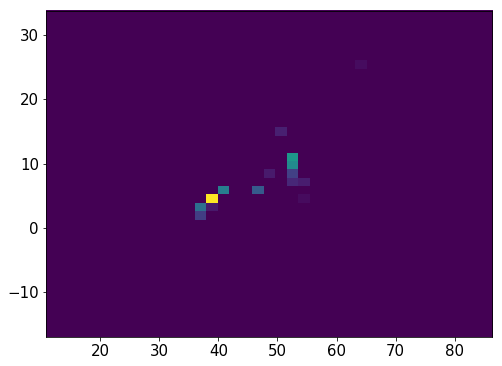

13039    31
13040    31
13041    31
13042    31
13043    31
13044    31
13045    31
13046    31
13047    31
13048    31
13049    31
13050    31
Name: Nsipm, dtype: uint16


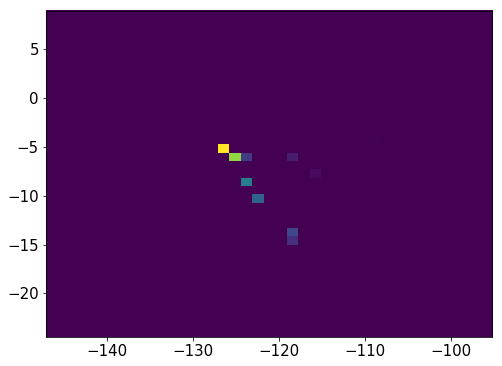

13056    18
13057    18
13058    18
13059    18
13060    18
13061    18
13062    18
13063    18
13064    18
13065    18
13066    18
13067    18
13068    18
13069    18
13070    18
13071    18
13072    18
13073    18
13074    18
13075    18
13077    18
13079    18
13080    18
13081    18
13082    18
13083    18
13084    18
13085    18
13087    18
13088    18
13089    18
13090    18
13091    18
13092    18
13093    18
Name: Nsipm, dtype: uint16


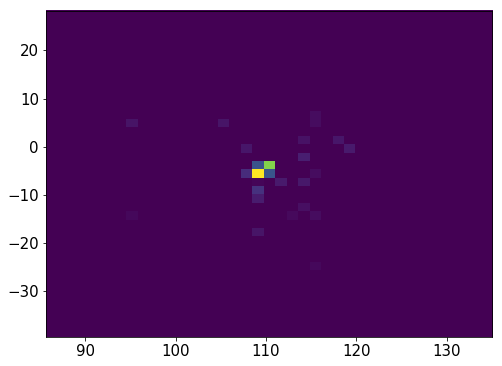

13100    33
13101    33
13102    33
13103    33
13104    33
13105    33
13106    33
13107    33
13108    33
13109    33
13110    33
13111    33
Name: Nsipm, dtype: uint16


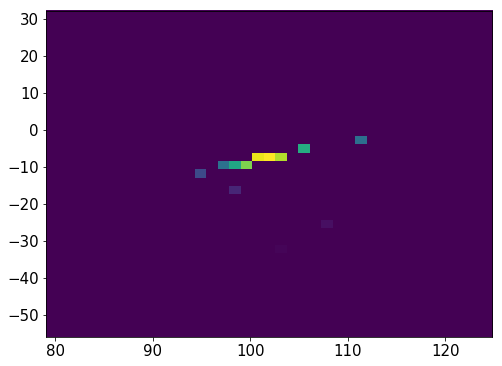

13117    24
13118    24
13119    24
13120    24
13121    24
13122    24
13123    24
13124    24
13125    24
13126    24
Name: Nsipm, dtype: uint16


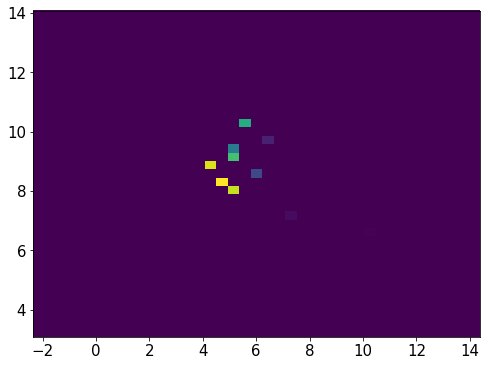

946312    20
946313    20
946314    20
946315    20
946316    20
946317    20
946318    20
946319    20
946320    20
946321    20
946322    20
946323    20
946324    20
946325    20
946326    20
946327    20
946331     3
946332     3
946333     3
946334     3
946335     3
946340    12
946341    12
946342    12
946343    12
946344    12
946345    12
946346    12
946347    12
946348    12
946349    12
Name: Nsipm, dtype: uint16


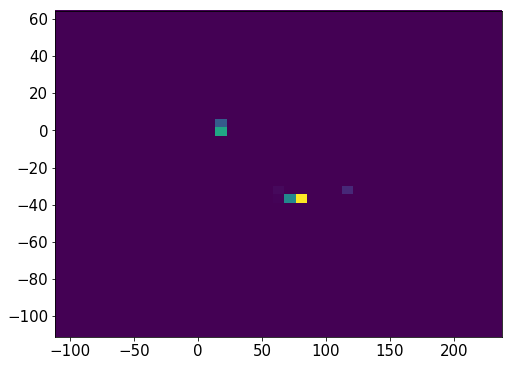

946354    25
946355    25
946356    25
946357    25
946358    25
946359    25
946360    25
946361    25
946362    25
946363    25
946364    25
946365    25
946366    25
946367    25
946368    25
946369    25
946371     7
946372     7
946373     7
946374     7
946375     7
946381     7
946382     7
946383     7
946384     7
946385     7
Name: Nsipm, dtype: uint16


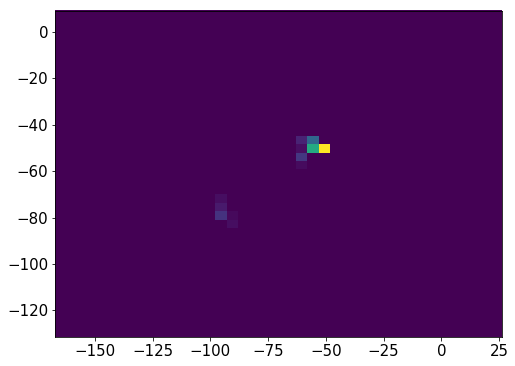

946390    27
946391    27
946392    27
946393    27
946394    27
946395    27
946396    27
946397    27
946398    27
946399    27
946400    27
946401    27
946402    27
946403    27
946404    27
946405    27
946406    27
Name: Nsipm, dtype: uint16


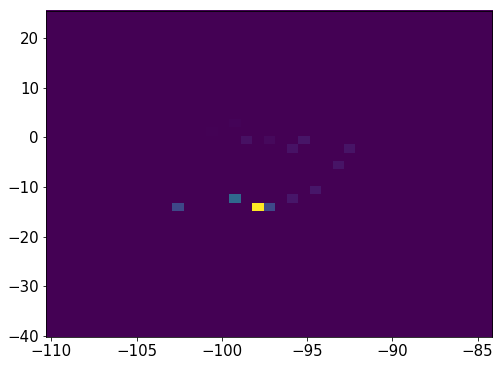

13131    25
13132    25
13133    25
13134    25
13135    25
13136    25
13137    25
13138    25
13139    25
13140    25
Name: Nsipm, dtype: uint16


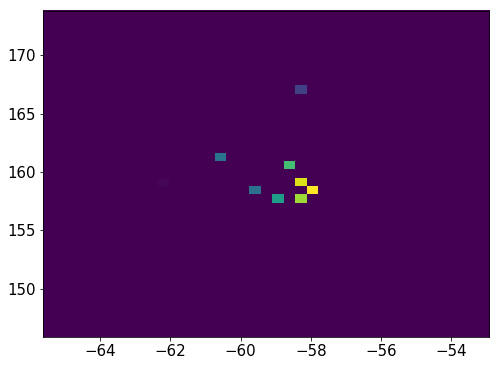

946440    30
946441    30
946442    30
946443    30
946444    30
946445    30
946446    30
946447    30
946448    30
946449    30
946450    30
946451    30
946452    30
946453    30
946454    30
946455    30
946456    30
946457    30
Name: Nsipm, dtype: uint16


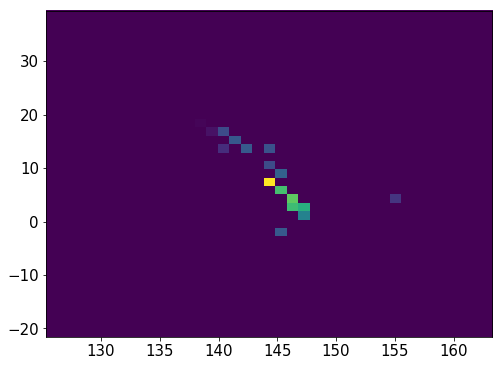

13146    24
13147    24
13148    24
13149    24
13150    24
13151    24
13152    24
13153    24
13154    24
13155    24
13156    24
13157    24
13158    24
13159    24
13160    24
Name: Nsipm, dtype: uint16


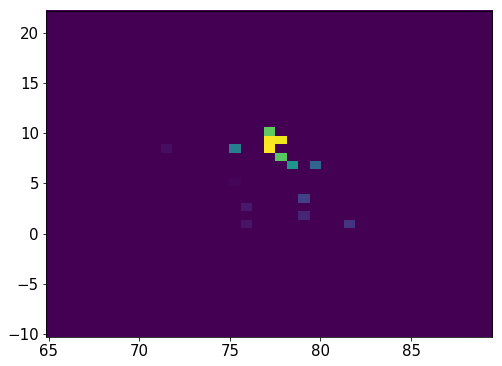

13165    20
13166    20
13167    20
13168    20
13169    20
13170    20
13171    20
13172    20
13173    20
13174    20
13175    20
13176    20
13177    20
13178    20
13179    20
13180    20
13181    20
13184    20
13185    20
13186    20
13187    20
13188    20
13189    20
13190    20
13191    20
13192    20
13193    20
Name: Nsipm, dtype: uint16


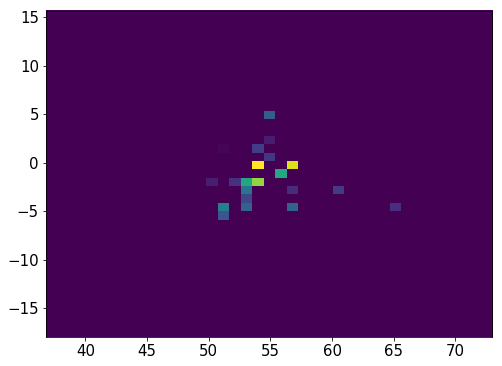

935596    31
935597    31
935598    31
935599    31
935600    31
935601    31
935602    31
935603    31
935604    31
935605    31
935606    31
935607    31
935608    31
935609    31
935610    31
935611    31
935612    31
Name: Nsipm, dtype: uint16


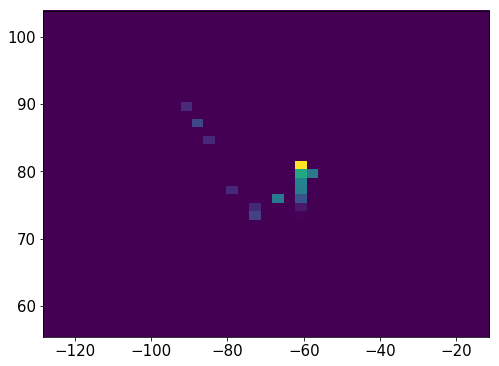

13200    22
13201    22
13202    22
13203    22
13204    22
13205    22
13206    22
13207    22
13208    22
13213    10
13214    10
13215    10
13216    10
13217    10
13218    10
13219    10
13220    10
13221    10
13222    10
Name: Nsipm, dtype: uint16


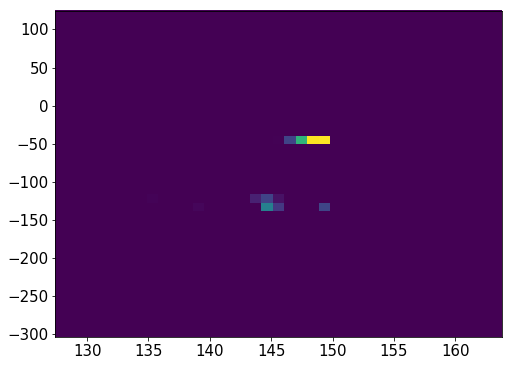

946505    28
946506    28
946507    28
946508    28
946509    28
946510    28
946511    28
946512    28
946513    28
946514    28
946515    28
946516    28
946517    28
946518    28
946519    28
946520    28
946521    28
946523    28
946524    28
946525    28
Name: Nsipm, dtype: uint16


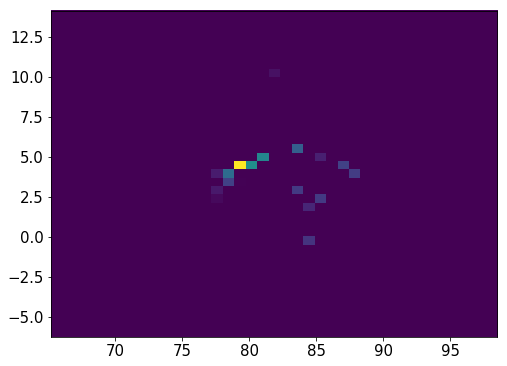

946532    37
946533    37
946534    37
946535    37
946536    37
946537    37
946538    37
946539    37
946540    37
946541    37
946542    37
946543    37
946544    37
946545    37
946546    37
946547    37
946548    37
946549    37
946550    37
946551    37
946552    37
Name: Nsipm, dtype: uint16


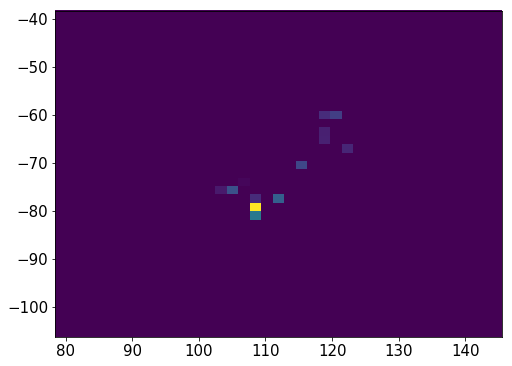

13227    34
13228    34
13229    34
13230    34
13231    34
13232    34
13233    34
13234    34
13235    34
13236    34
13237    34
13238    34
13239    34
13240    34
13241    34
13242    34
13243    34
13244    34
13245    34
13246    34
Name: Nsipm, dtype: uint16


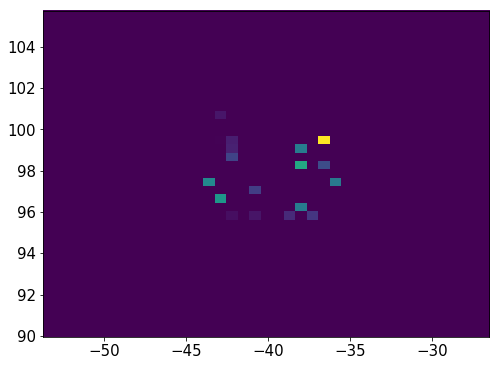

13251    33
13252    33
13253    33
13254    33
13255    33
13256    33
13257    33
13258    33
13259    33
13260    33
13261    33
13262    33
13263    33
13264    33
13265    33
13266    33
13267    33
Name: Nsipm, dtype: uint16


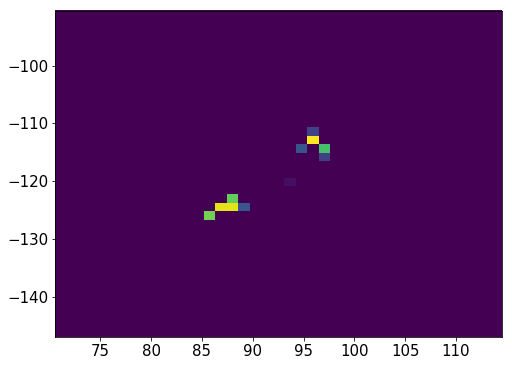

13271    25
13272    25
13273    25
13274    25
13275    25
13276    25
13277    25
Name: Nsipm, dtype: uint16


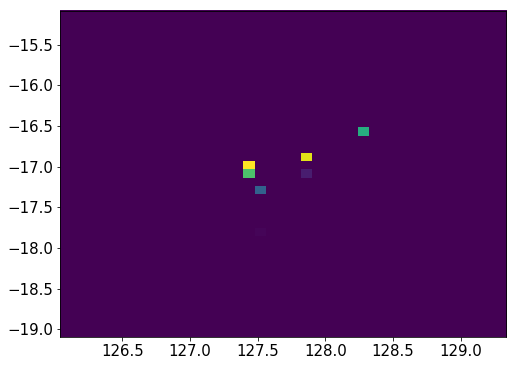

13282    25
13283    25
13284    25
13285    25
13286    25
13287    25
13288    25
13289    25
13290    25
13291    25
13292    25
13293    25
13294    25
13295    25
13296    25
13297    25
13298    25
13299    25
13300    25
13301    25
13302    25
13303    25
Name: Nsipm, dtype: uint16


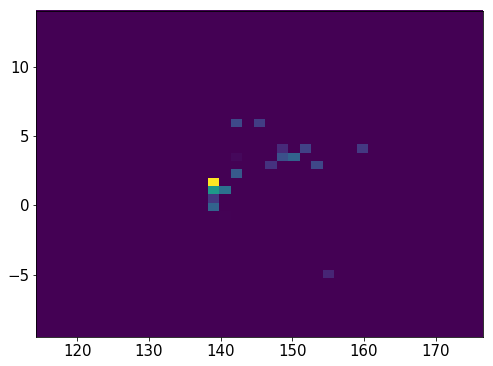

946616    20
946617    20
946618    20
946619    20
946620    20
946621    20
946622    20
946623    20
946624    20
946625    20
946626    20
946627    20
946628    20
946629    20
946630    20
Name: Nsipm, dtype: uint16


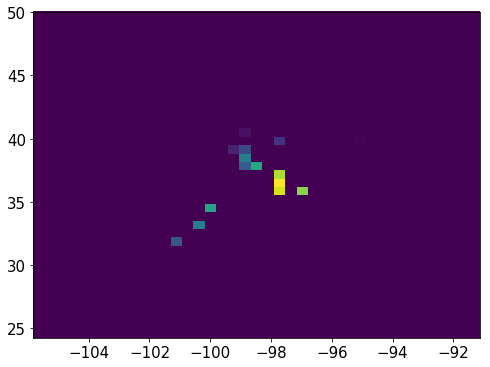

13308    30
13309    30
13310    30
13311    30
13312    30
13313    30
13314    30
13315    30
13316    30
13317    30
13318    30
13319    30
13320    30
13321    30
Name: Nsipm, dtype: uint16


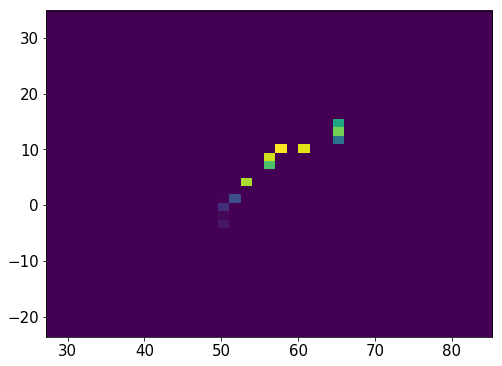

13326    34
13327    34
13328    34
13329    34
13330    34
13331    34
13332    34
13333    34
13334    34
13335    34
13336    34
13337    34
13338    34
13339    34
13340    34
13341    34
Name: Nsipm, dtype: uint16


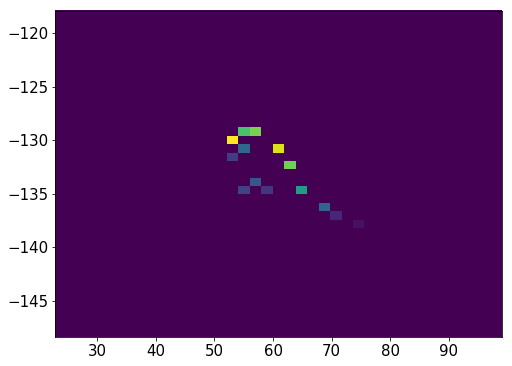

13346    20
13347    20
13348    20
13349    20
13350    20
13351    20
13352    20
13353    20
13354    20
13355    20
13356    20
13357    20
13358    20
13359    20
13360    20
13361    20
13362    20
13363    20
13366    11
13367    11
13368    11
13369    11
13370    11
13371    11
13372    11
13373    11
Name: Nsipm, dtype: uint16


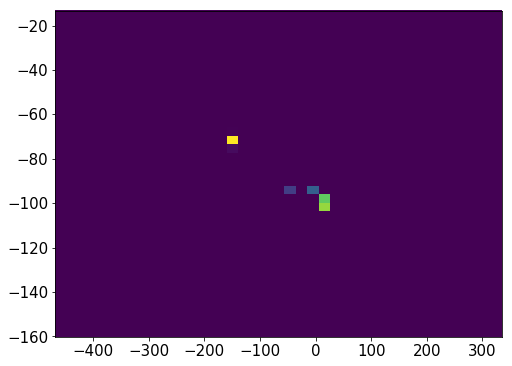

13378    15
13379    15
13380    15
13381    15
13382    15
13383    15
13384    15
13385    15
13389    17
13390    17
13391    17
13392    17
13393    17
13394    17
13395    17
13396    17
13397    17
13398    17
13399    17
13400    17
13401    17
Name: Nsipm, dtype: uint16


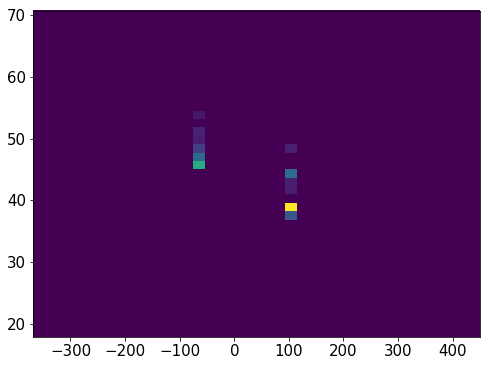

13405    28
13406    28
13407    28
13408    28
13409    28
13410    28
13411    28
13412    28
13413    28
13414    28
13415    28
13416    28
13417    28
13418    28
13419    28
13420    28
13421    28
13422    28
13423    28
13424    28
13425    28
13426    28
13427    28
Name: Nsipm, dtype: uint16


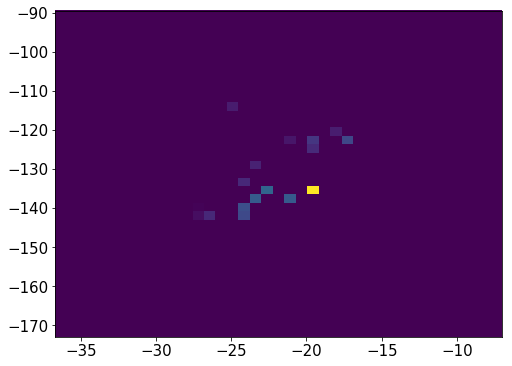

13432    23
13433    23
13434    23
13435    23
13436    23
13437    23
13438    23
13439    23
13440    23
13441    23
13442    23
13443    23
13444    23
13445    23
13446    23
13447    23
13448    23
13449    23
Name: Nsipm, dtype: uint16


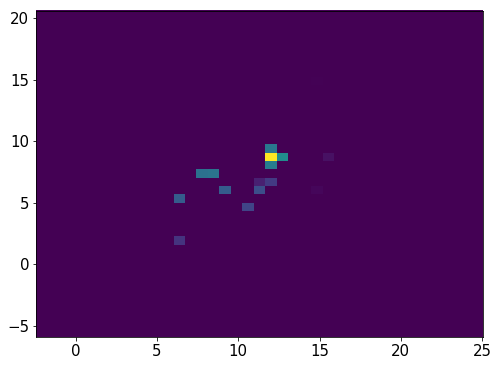

209935    24
209936    24
209937    24
209938    24
209939    24
209940    24
209941    24
209942    24
209943    24
209944    24
209945    24
209946    24
209947    24
209948    24
209949    24
209950    24
209951    24
209952    24
209953    24
209954    24
Name: Nsipm, dtype: uint16


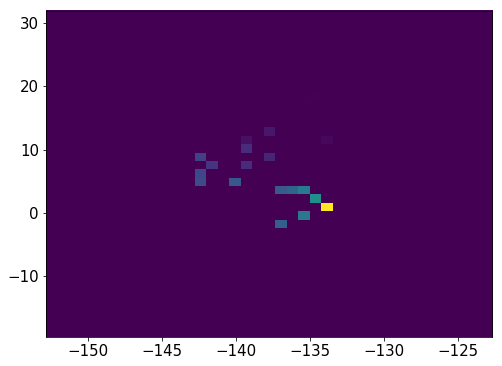

13454    20
13455    20
13456    20
13457    20
13458    20
13459    20
13460    20
13461    20
13462    20
13463    20
13464    20
13465    20
13466    20
13467    20
13468    20
13469    20
13470    20
13471    20
13472    20
13473    20
13474    20
13475    20
13476    20
13477    20
13478    20
13479    20
Name: Nsipm, dtype: uint16


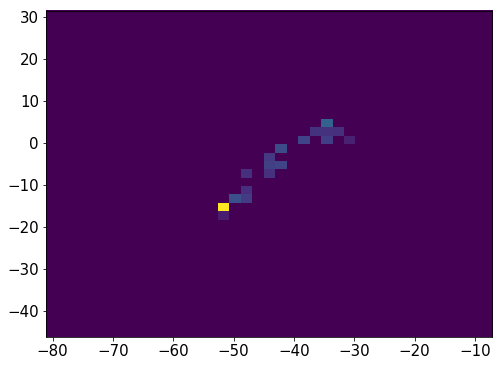

13493    34
13494    34
13495    34
13496    34
13497    34
13498    34
13502    34
13503    34
13504    34
13505    34
13506    34
13507    34
13508    34
13509    34
13510    34
Name: Nsipm, dtype: uint16


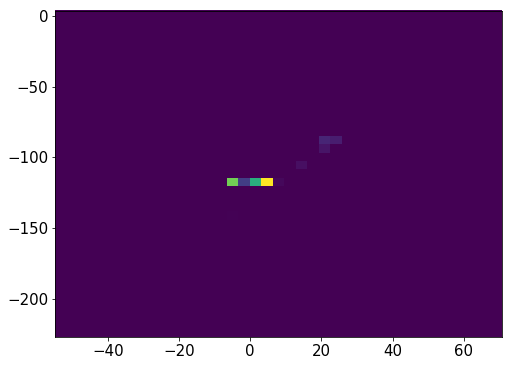

946762    27
946763    27
946764    27
946765    27
946766    27
946767    27
946768    27
946769    27
946770    27
946771    27
946772    27
946773    27
946774    27
946775    27
946776    27
946777    27
946782    27
Name: Nsipm, dtype: uint16


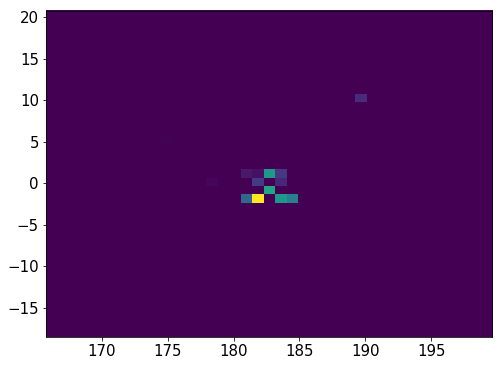

13511    22
13512    22
13513    22
13514    22
13515    22
13516    22
13517    22
13518    22
13519    22
13520    22
13521    22
13522    22
13528    22
13529    22
13530    22
13531    22
13534    14
13535    14
13536    14
13537    14
13538    14
13539    14
13540    14
13541    14
Name: Nsipm, dtype: uint16


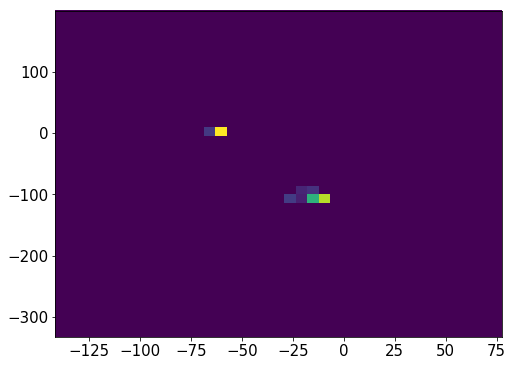

946808    28
946809    28
946810    28
946811    28
946812    28
946813    28
946814    28
946815    28
946816    28
946817    28
946818    28
946819    28
946820    28
946821    28
946822    28
946823    28
946824    28
946825    28
946826    28
946827    28
Name: Nsipm, dtype: uint16


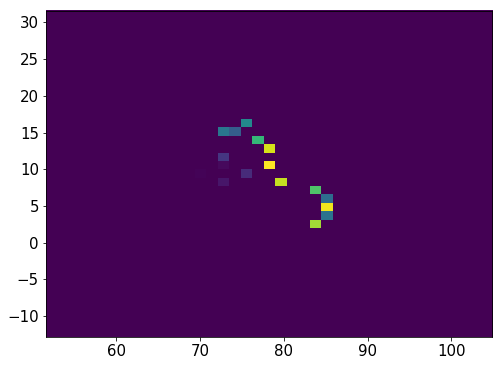

13547    27
13548    27
13549    27
13550    27
13551    27
13552    27
13553    27
13554    27
13555    27
13556    27
13557    27
13558    27
13559    27
13560    27
13561    27
13562    27
13563    27
13564    27
Name: Nsipm, dtype: uint16


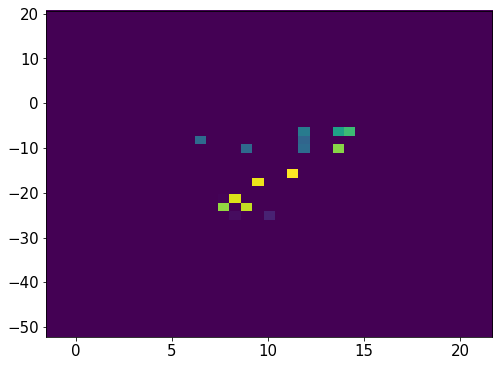

13570    28
13571    28
13572    28
13573    28
13574    28
13575    28
13576    28
13577    28
13578    28
13579    28
13580    28
13581    28
13582    28
13583    28
13584    28
Name: Nsipm, dtype: uint16


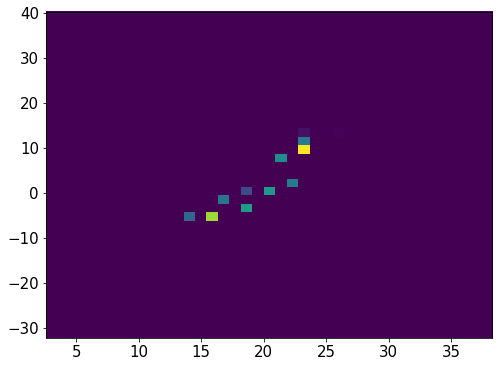

946833    31
946834    31
946835    31
946836    31
946837    31
946838    31
946839    31
946840    31
946841    31
946842    31
946843    31
946844    31
946845    31
946846    31
946849    31
946850    31
946851    31
946852    31
946853    31
Name: Nsipm, dtype: uint16


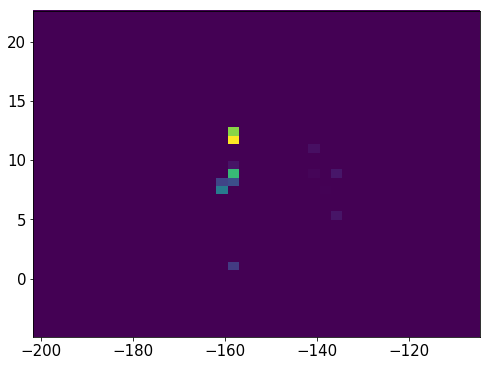

946857    30
946858    30
946859    30
946860    30
946861    30
946862    30
946863    30
946864    30
946865    30
946866    30
946867    30
946868    30
946869    30
Name: Nsipm, dtype: uint16


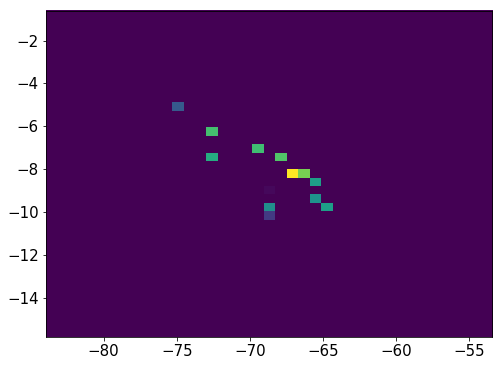

946873    22
946874    22
946875    22
946876    22
946877    22
946878    22
946879    22
946880    22
946881    22
946882    22
946883    22
946884    22
946885    22
946886    22
946887    22
946888    22
946889    22
946890    22
946891    22
946892    22
946893    22
946897    22
Name: Nsipm, dtype: uint16


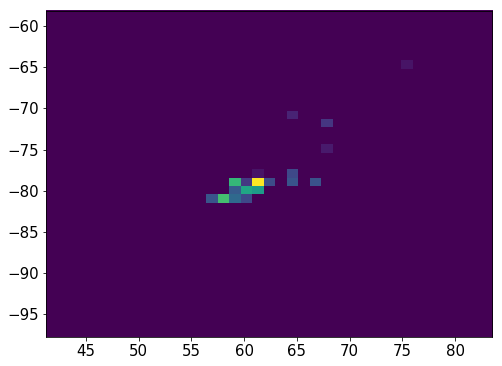

946904    25
946905    25
946906    25
946907    25
946908    25
946909    25
946910    25
946911    25
946912    25
946913    25
946914    25
946915    25
946916    25
946917    25
946918    25
946919    25
946920    25
946921    25
946922    25
Name: Nsipm, dtype: uint16


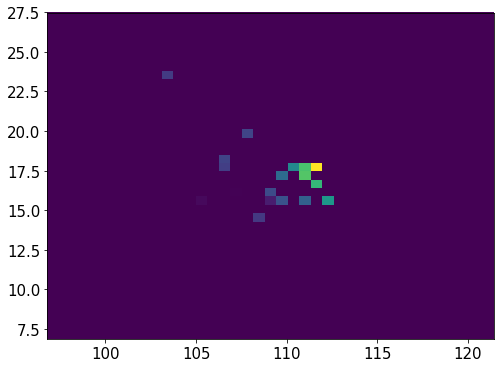

2139284    22
2139285    22
2139286    22
2139287    22
2139288    22
2139289    22
2139290    22
2139291    22
2139292    22
2139293    22
2139294    22
2139295    22
2139296    22
2139297    22
2139298    22
2139299    22
2139300    22
2139301    22
Name: Nsipm, dtype: uint16


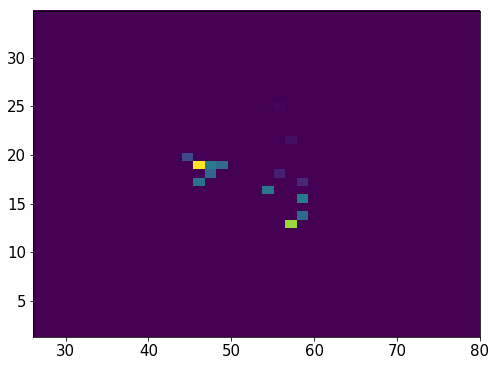

13588    23
13589    23
13590    23
13591    23
13592    23
13593    23
13594    23
13595    23
13596    23
13597    23
13598    23
13599    23
13600    23
13601    23
13602    23
Name: Nsipm, dtype: uint16


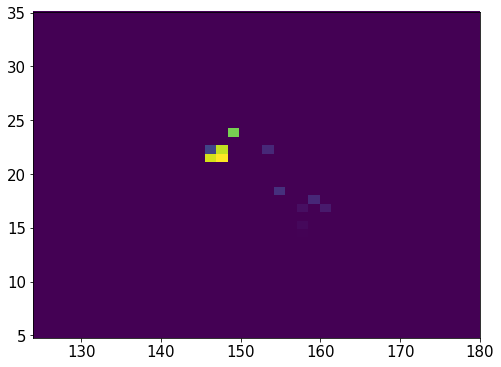

13608    25
13609    25
13610    25
13611    25
13612    25
13613    25
13614    25
13615    25
13616    25
13617    25
13618    25
13619    25
13620    25
13621    25
13622    25
13623    25
13624    25
13625    25
13626    25
13627    25
Name: Nsipm, dtype: uint16


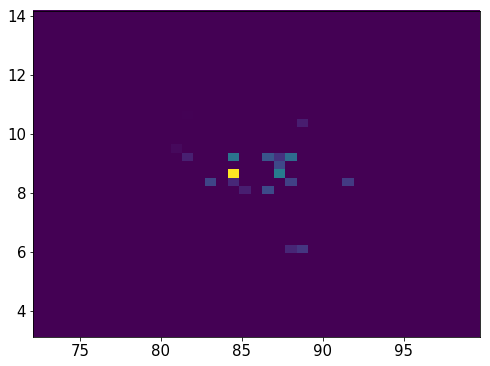

13633    22
13634    22
13635    22
13636    22
13637    22
13638    22
13639    22
13640    22
13641    22
13642    22
13643    22
13644    22
13645    22
13646    22
13647    22
13648    22
13649    22
13650    22
13651    22
13652    22
13653    22
13654    22
13655    22
Name: Nsipm, dtype: uint16


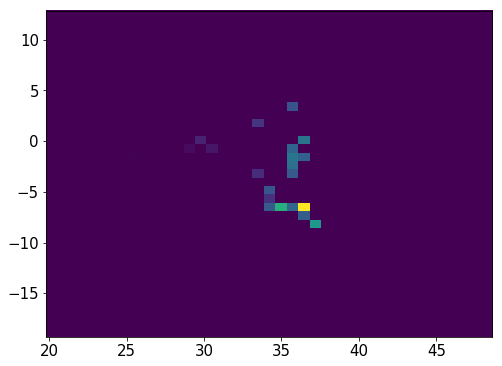

13660    24
13661    24
13662    24
13663    24
13664    24
13665    24
13666    24
13667    24
13668    24
13669    24
13670    24
13671    24
13672    24
13676    24
13677    24
13678    24
Name: Nsipm, dtype: uint16


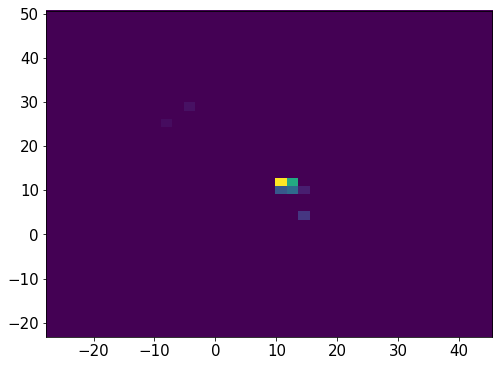

13683    24
13684    24
13685    24
13686    24
13687    24
13688    24
13689    24
13690    24
13691    24
13692    24
13693    24
13694    24
13695    24
13696    24
13697    24
13698    24
13699    24
13700    24
13701    24
Name: Nsipm, dtype: uint16


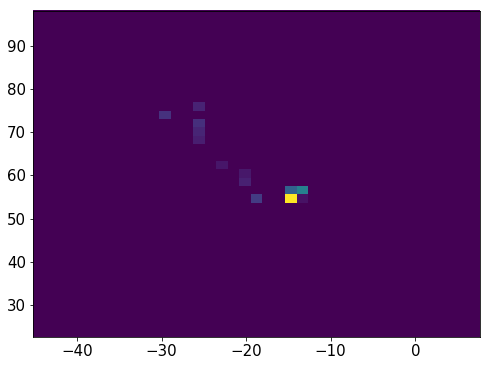

947004    28
947005    28
947006    28
947007    28
947008    28
947009    28
947010    28
947011    28
947012    28
947013    28
947014    28
947015    28
947016    28
947017    28
947018    28
947019    28
947020    28
947021    28
947022    28
947023    28
947024    28
Name: Nsipm, dtype: uint16


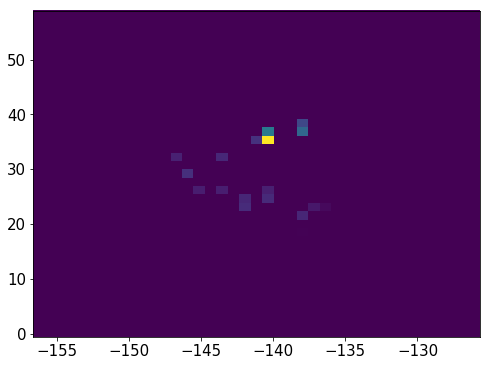

13705    27
13706    27
13707    27
13708    27
13709    27
13710    27
13711    27
13712    27
13713    27
13714    27
13715    27
13716    27
13717    27
13718    27
13719    27
13720    27
13721    27
13722    27
13723    27
13724    27
13725    27
Name: Nsipm, dtype: uint16


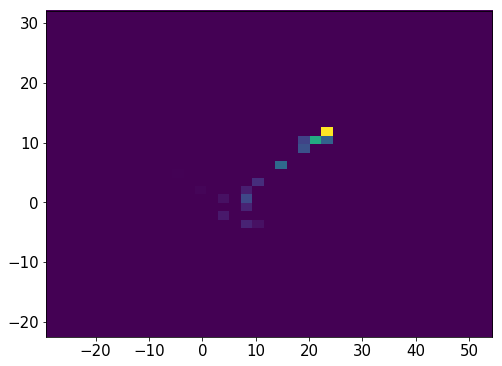

935713    22
935714    22
935715    22
935716    22
935717    22
935718    22
935719    22
935720    22
935721    22
935722    22
935723    22
935724    22
935725    22
Name: Nsipm, dtype: uint16


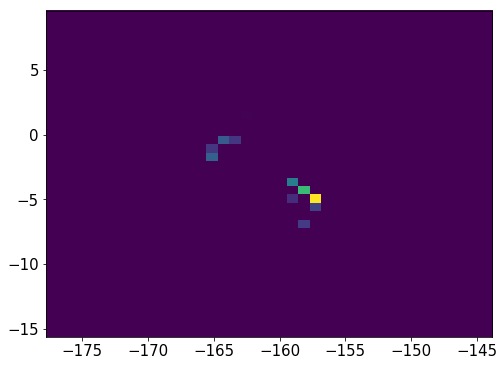

13730    50
13731    50
13732    50
13733    50
13734    50
13735    50
13736    50
13737    50
13738    50
13739    50
13740    50
13741    50
13742    50
13743    50
13744    50
13745    50
13746    50
13747    50
13748    50
13749    50
Name: Nsipm, dtype: uint16


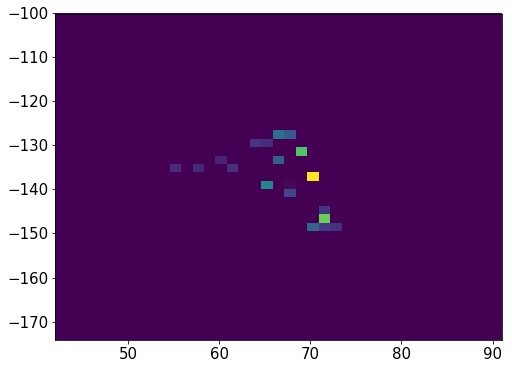

13753    34
13754    34
13755    34
13756    34
13757    34
13758    34
13759    34
13760    34
13761    34
13762    34
13763    34
13764    34
13765    34
13766    34
13767    34
13768    34
13769    34
13770    34
13771    34
13772    34
13773    34
13774    34
13775    34
Name: Nsipm, dtype: uint16


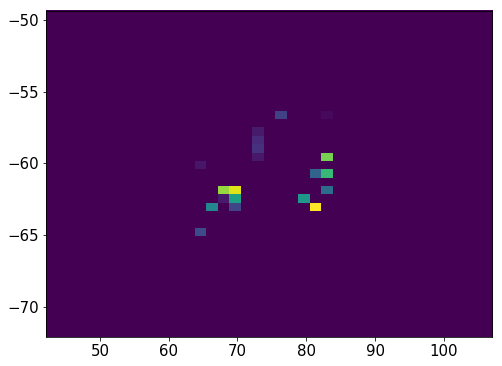

13780    28
13781    28
13782    28
13783    28
13784    28
13785    28
13786    28
13787    28
13788    28
13789    28
13790    28
13791    28
13792    28
13793    28
13799     1
13800     1
13801     1
13802     1
13803     1
Name: Nsipm, dtype: uint16


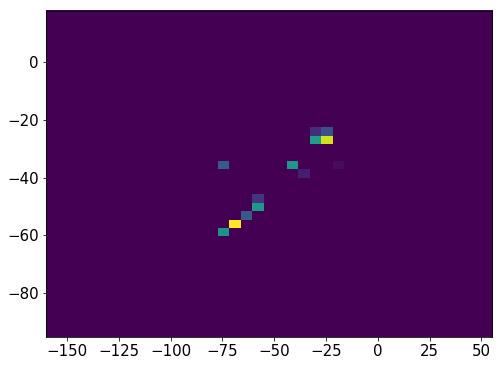

13808    25
13809    25
13810    25
13811    25
13812    25
13813    25
13814    25
13815    25
13816    25
13817    25
13818    25
13819    25
13820    25
13821    25
13822    25
13823    25
13824    25
13825    25
13826    25
13827    25
13828    25
13829    25
13830    25
Name: Nsipm, dtype: uint16


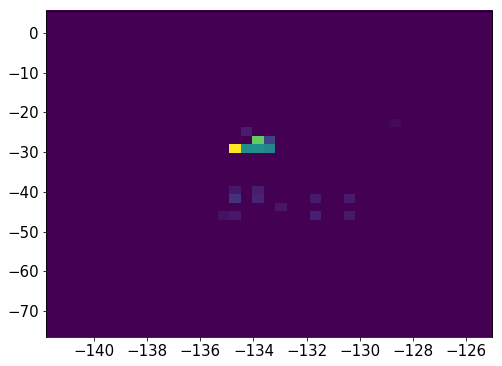

947155    27
947156    27
947157    27
947158    27
947159    27
947160    27
947161    27
947162    27
947163    27
947164    27
947165    27
Name: Nsipm, dtype: uint16


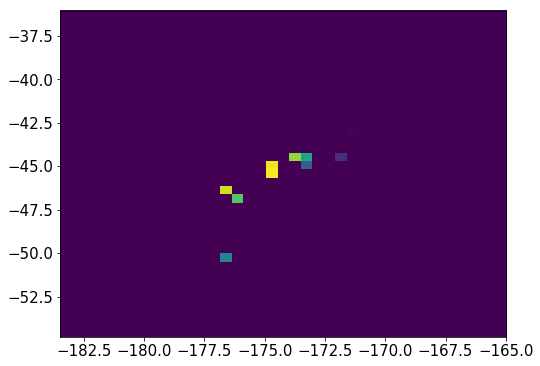

13834    24
13835    24
13836    24
13837    24
13838    24
13839    24
13840    24
13841    24
13842    24
13843    24
13844    24
13845    24
13846    24
13847    24
13848    24
13849    24
13850    24
13851    24
13852    24
13853    24
13854    24
Name: Nsipm, dtype: uint16


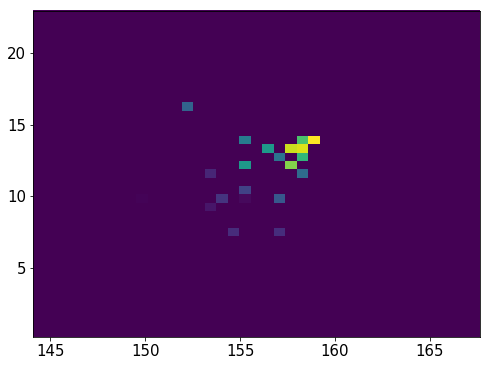

947170    27
947171    27
947172    27
947173    27
947174    27
947175    27
947176    27
947177    27
947178    27
947179    27
947180    27
947181    27
947182    27
947183    27
947184    27
947185    27
947186    27
947187    27
947188    27
947189    27
Name: Nsipm, dtype: uint16


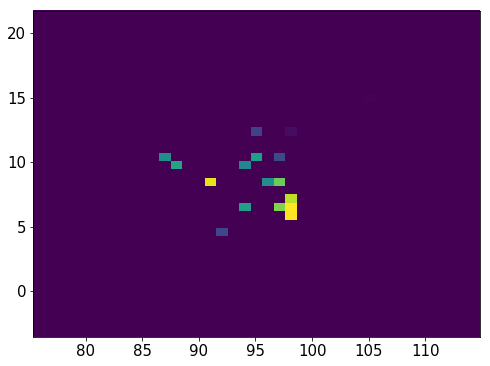

13860    33
13861    33
13862    33
13863    33
13864    33
13865    33
13866    33
13867    33
13868    33
13869    33
13870    33
13871    33
13872    33
13873    33
13874    33
13875    33
Name: Nsipm, dtype: uint16


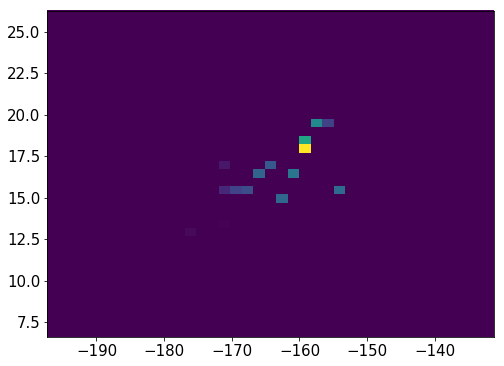

13881    36
13882    36
13883    36
13884    36
13885    36
13886    36
13887    36
13888    36
13889    36
13890    36
13891    36
13892    36
13893    36
13894    36
13895    36
13896    36
13897    36
13898    36
13899    36
13900    36
13901    36
13902    36
13903    36
13904    36
13905    36
13906    36
13907    36
13908    36
13909    36
13910    36
13911    36
13912    36
13913    36
Name: Nsipm, dtype: uint16


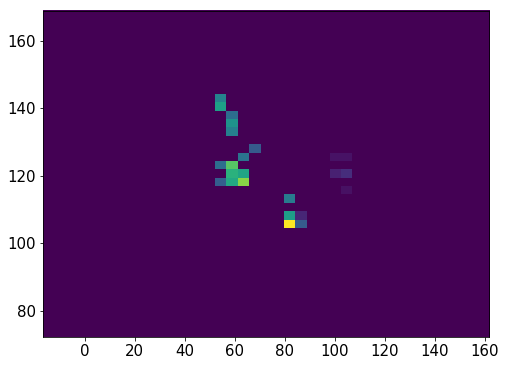

947194    30
947195    30
947196    30
947197    30
947198    30
947199    30
947200    30
947201    30
947202    30
947203    30
947204    30
947205    30
947206    30
947207    30
947208    30
947209    30
947210    30
947211    30
947212    30
947213    30
947214    30
947215    30
947216    30
947217    30
947218    30
947219    30
947220    30
947221    30
947222    30
947223    30
Name: Nsipm, dtype: uint16


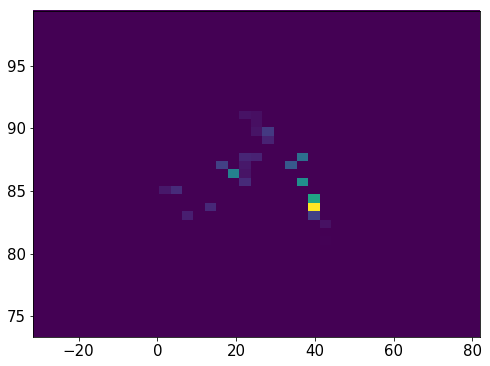

13917    26
13918    26
13919    26
13920    26
13921    26
13922    26
13923    26
13924    26
13925    26
13926    26
13927    26
13928    26
13929    26
13930    26
13931    26
13932    26
13933    26
13934    26
Name: Nsipm, dtype: uint16


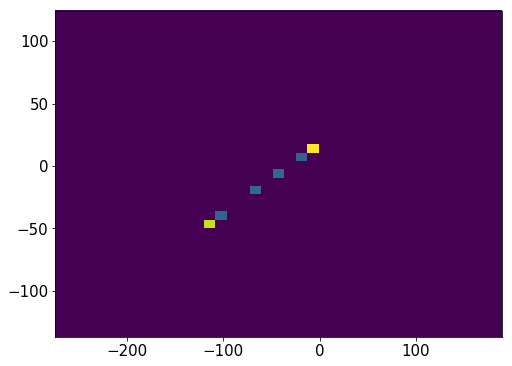

947226    26
947227    26
947228    26
947229    26
947230    26
947231    26
947232    26
947233    26
947234    26
947235    26
947236    26
947237    26
947238    26
947239    26
947240    26
947241    26
947242    26
947243    26
947244    26
947245    26
947246    26
947247    26
947248    26
947249    26
947250    26
947251    26
947252    26
947253    26
Name: Nsipm, dtype: uint16


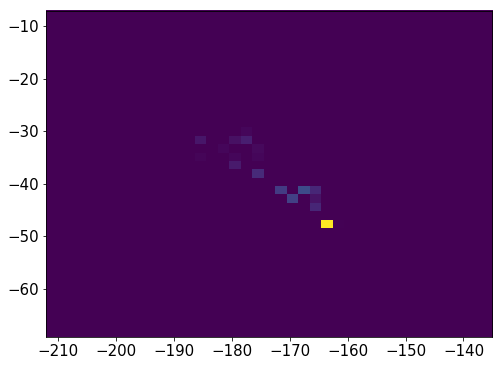

948880    22
948881    22
948882    22
948883    22
948884    22
948885    22
948886    22
948887    22
948888    22
948889    22
948890    22
948891    22
948892    22
948893    22
948894    22
948895    22
948896    22
948897    22
948898    22
Name: Nsipm, dtype: uint16


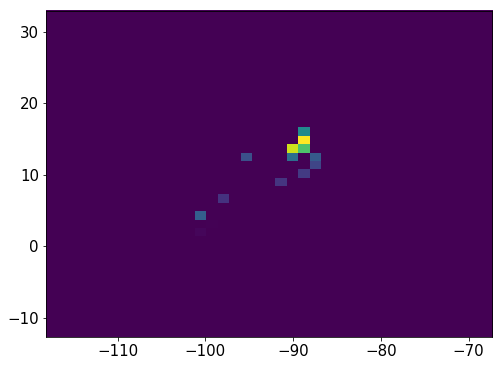

948903    20
948904    20
948905    20
948906    20
948907    20
948908    20
948909    20
948910    20
948911    20
948912    20
Name: Nsipm, dtype: uint16


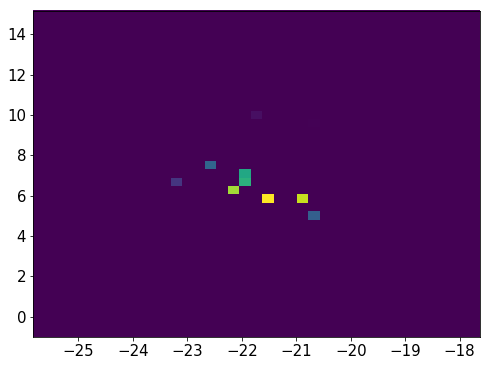

948916    29
948917    29
948918    29
948919    29
948920    29
948921    29
948922    29
948923    29
948924    29
948925    29
948926    29
948927    29
948928    29
948929    29
948930    29
948931    29
948932    29
948933    29
948934    29
948935    29
948936    29
948937    29
948938    29
948942     1
948943     1
948944     1
948945     1
948946     1
Name: Nsipm, dtype: uint16


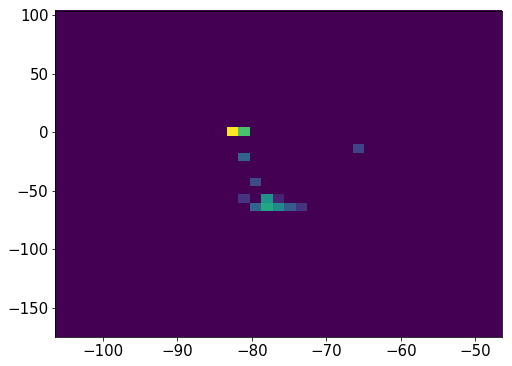

948951    38
948952    38
948953    38
948954    38
948955    38
948956    38
948957    38
948958    38
948959    38
948960    38
948961    38
Name: Nsipm, dtype: uint16


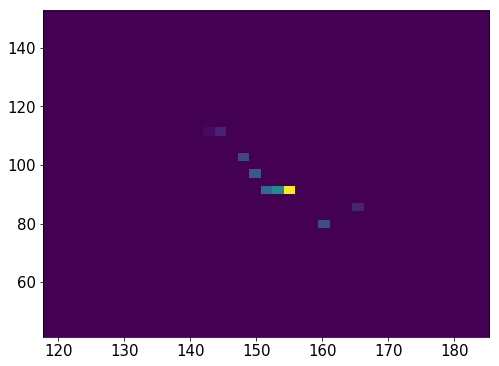

13938    28
13939    28
13940    28
13941    28
13942    28
13943    28
13944    28
13945    28
13946    28
13947    28
13948    28
13949    28
13950    28
13951    28
13952    28
Name: Nsipm, dtype: uint16


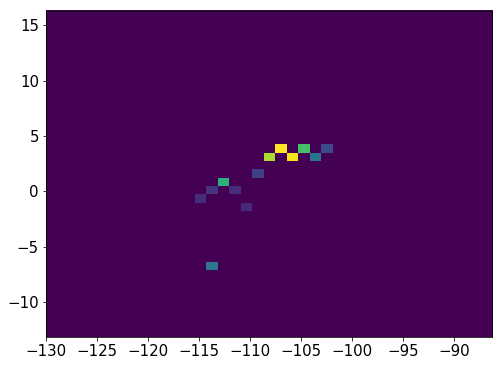

13958    20
13959    20
13960    20
13961    20
13962    20
13963    20
13964    20
13965    20
13966    20
13967    20
13968    20
13969    20
13970    20
13971    20
13972    20
13973    20
13974    20
13980    20
13981    20
13982    20
Name: Nsipm, dtype: uint16


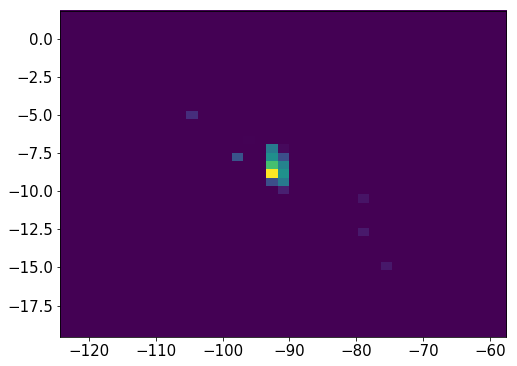

13987    26
13988    26
13989    26
13990    26
13991    26
13992    26
13993    26
13994    26
13995    26
13996    26
13997    26
13998    26
13999    26
14000    26
14001    26
14002    26
14003    26
14004    26
14005    26
Name: Nsipm, dtype: uint16


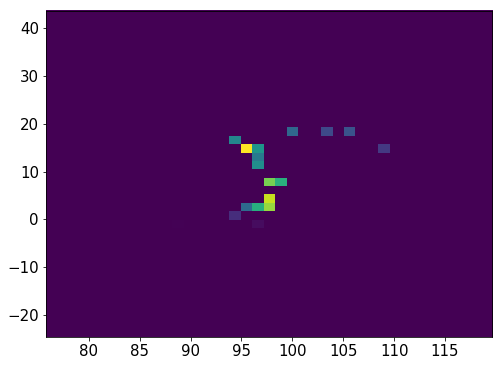

14010    28
14011    28
14012    28
14013    28
14014    28
14015    28
14016    28
14017    28
14018    28
14019    28
14020    28
14021    28
14022    28
Name: Nsipm, dtype: uint16


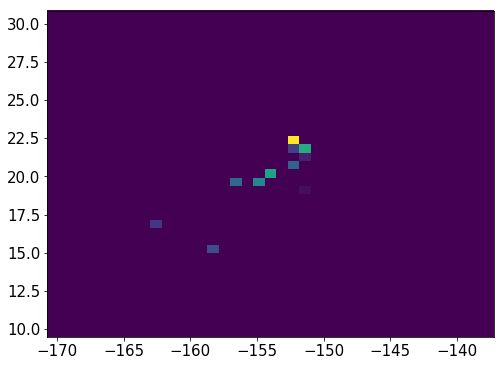

14027    24
14028    24
14029    24
14030    24
14031    24
14032    24
14033    24
14034    24
14035    24
14036    24
14037    24
14038    24
14039    24
14040    24
14041    24
14042    24
14043    24
14050     1
14051     1
14052     1
14053     1
14054     1
Name: Nsipm, dtype: uint16


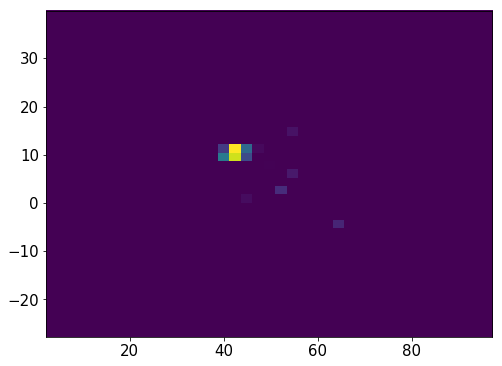

14061    26
14062    26
14063    26
14064    26
14065    26
14066    26
14067    26
14068    26
14069    26
14070    26
14071    26
Name: Nsipm, dtype: uint16


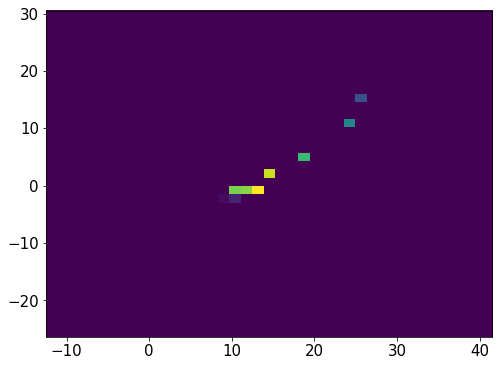

14079    32
14084    32
14085    32
14086    32
14087    32
14088    32
14089    32
14090    32
14091    32
14092    32
14093    32
14094    32
14095    32
14096    32
14097    32
14098    32
14099    32
14100    32
14101    32
14102    32
14103    32
14104    32
Name: Nsipm, dtype: uint16


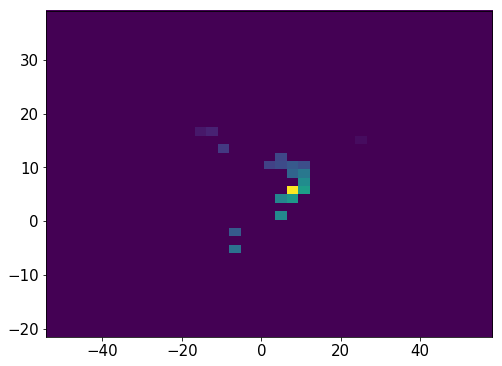

14105    34
14106    34
14107    34
14108    34
14109    34
14110    34
14111    34
14112    34
14113    34
14114    34
14115    34
14116    34
14117    34
14118    34
14119    34
14120    34
14121    34
14122    34
14123    34
14124    34
14125    34
Name: Nsipm, dtype: uint16


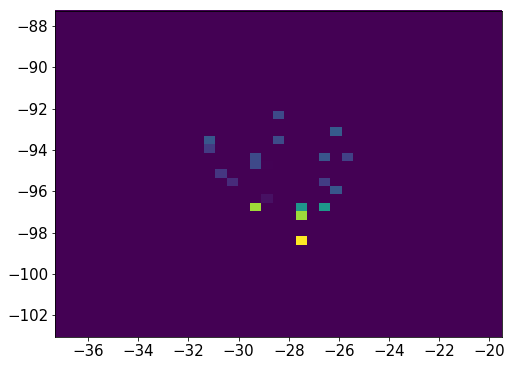

14129    29
14130    29
14131    29
14132    29
14133    29
14134    29
14135    29
14136    29
14137    29
14138    29
14139    29
14140    29
14141    29
14142    29
14143    29
14144    29
14145    29
14146    29
14147    29
14148    29
Name: Nsipm, dtype: uint16


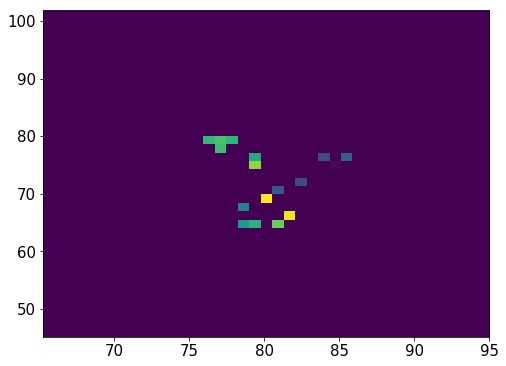

949012    33
949013    33
949014    33
949015    33
949016    33
949017    33
949018    33
949019    33
949020    33
949021    33
949022    33
949023    33
949024    33
949025    33
Name: Nsipm, dtype: uint16


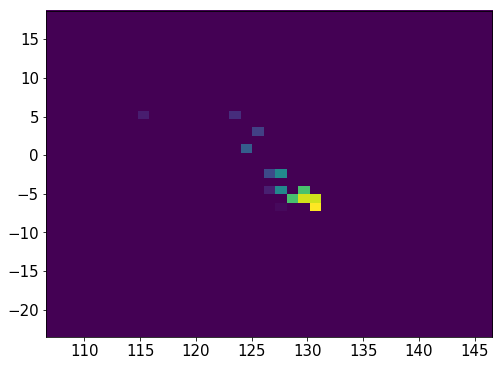

14153    44
14154    44
14155    44
14156    44
14157    44
14158    44
14159    44
14160    44
14161    44
14162    44
14163    44
14164    44
14165    44
14166    44
14167    44
14168    44
14169    44
Name: Nsipm, dtype: uint16


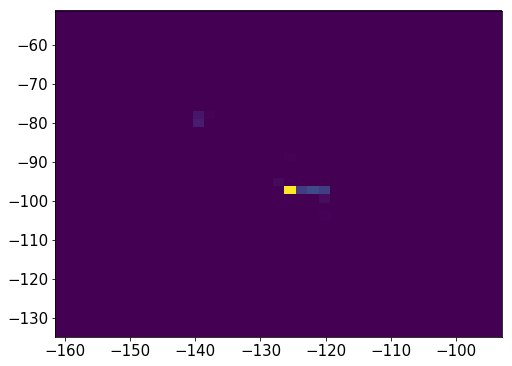

949030    29
949031    29
949032    29
949033    29
949034    29
949035    29
949036    29
949037    29
949038    29
949039    29
949040    29
949041    29
Name: Nsipm, dtype: uint16


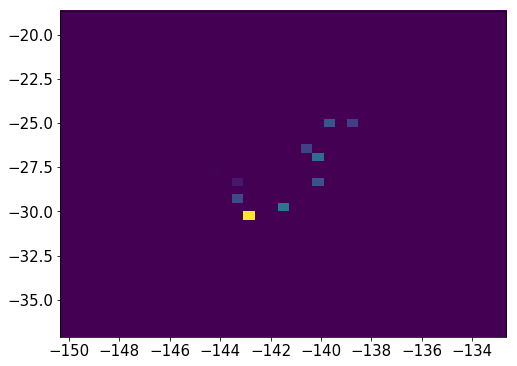

14174    22
14175    22
14176    22
14177    22
14178    22
14179    22
14180    22
14181    22
14182    22
14183    22
14184    22
14185    22
14186    22
14187    22
14188    22
14189    22
14190    22
14191    22
14192    22
Name: Nsipm, dtype: uint16


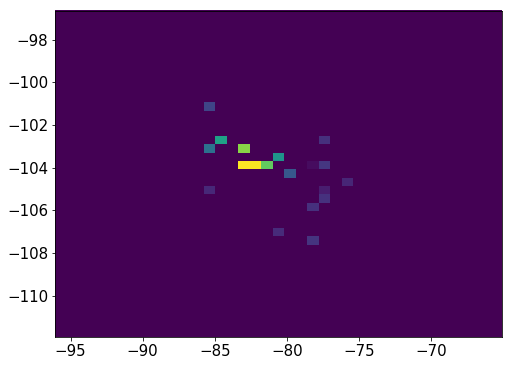

1665430    22
1665431    22
1665432    22
1665433    22
1665434    22
1665435    22
1665436    22
1665437    22
1665438    22
1665439    22
1665440    22
1665441    22
1665442    22
1665443    22
1665444    22
1665445    22
1665446    22
1665447    22
1665448    22
1665449    22
1665450    22
1665451    22
Name: Nsipm, dtype: uint16


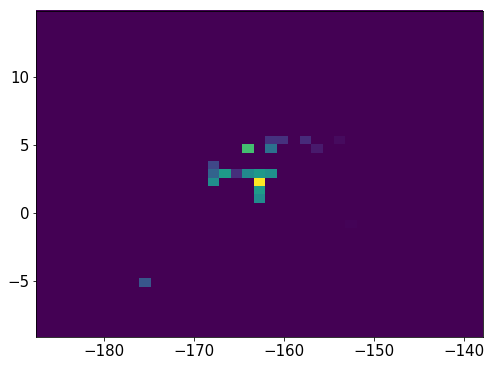

14197    27
14198    27
14199    27
14200    27
14201    27
14202    27
14203    27
14204    27
14205    27
14206    27
14207    27
14208    27
14209    27
14210    27
14211    27
14212    27
14213    27
14214    27
14215    27
14216    27
14217    27
14218    27
Name: Nsipm, dtype: uint16


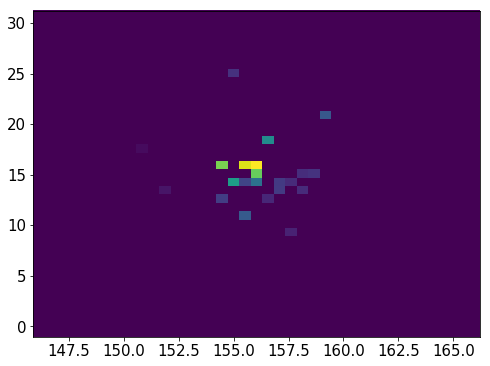

14224    19
14225    19
14226    19
14227    19
14228    19
14229    19
14230    19
14231    19
14232    19
14233    19
14234    19
14235    19
14236    19
14237    19
14238    19
14239    19
14240    19
14241    19
14248     9
14249     9
14250     9
14251     9
14252     9
14253     9
14254     9
14255     9
14256     9
14257     9
14258     9
Name: Nsipm, dtype: uint16


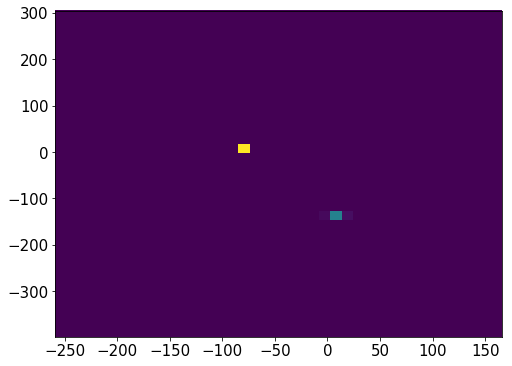

14262    32
14263    32
14264    32
14265    32
14266    32
14267    32
14268    32
14269    32
14270    32
14271    32
14272    32
14273    32
14274    32
14275    32
14276    32
14277    32
14278    32
14279    32
14280    32
14281    32
14282    32
14283    32
14284    32
Name: Nsipm, dtype: uint16


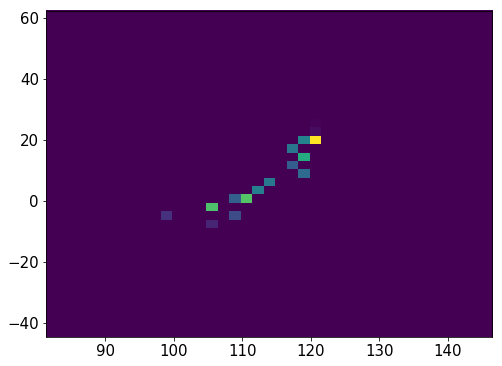

14290    21
14291    21
14292    21
14293    21
14294    21
14295    21
14296    21
14297    21
14298    21
14299    21
14300    21
14301    21
14302    21
14303    21
14304    21
14305    21
14306    21
14307    21
14308    21
14309    21
14310    21
14315     2
14316     2
14317     2
14318     2
14319     2
Name: Nsipm, dtype: uint16


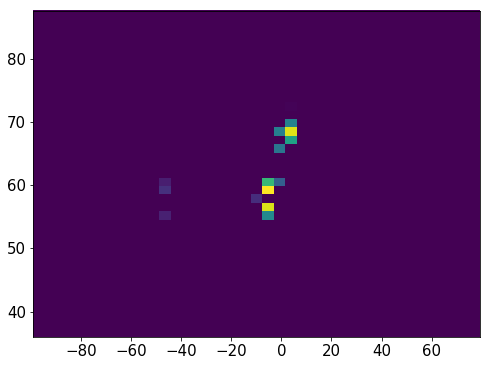

949071    23
949072    23
949073    23
949074    23
949075    23
949076    23
949077    23
949078    23
949079    23
949080    23
949081    23
949082    23
949083    23
949084    23
949085    23
949086    23
949087    23
949088    23
949089    23
949090    23
949091    23
949092    23
949093    23
949094    23
Name: Nsipm, dtype: uint16


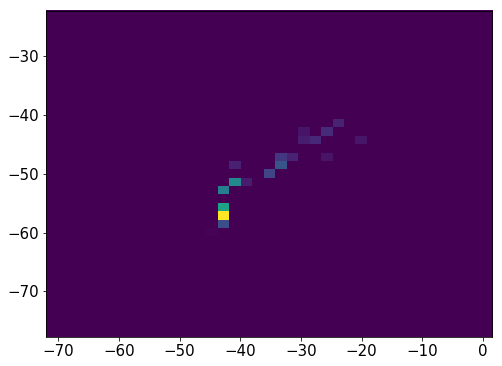

949098    26
949099    26
949100    26
949101    26
949102    26
949103    26
949104    26
949105    26
949106    26
949107    26
949108    26
949109    26
949110    26
949111    26
Name: Nsipm, dtype: uint16


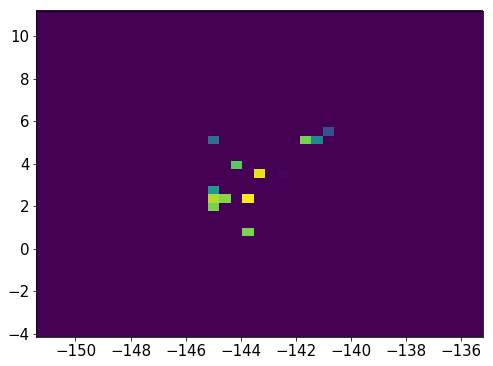

14323    22
14324    22
14325    22
14326    22
14327    22
14328    22
14329    22
14330    22
14331    22
14332    22
14333    22
14334    22
14335    22
Name: Nsipm, dtype: uint16


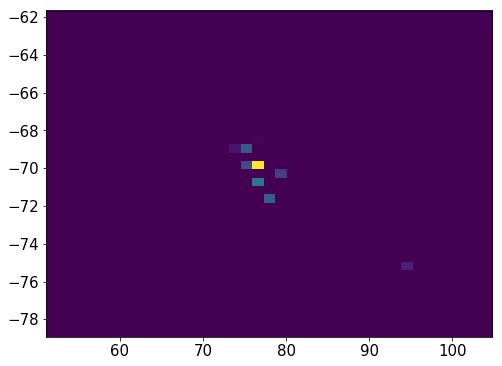

949116    31
949117    31
949118    31
949119    31
949120    31
949121    31
949122    31
949123    31
949124    31
949125    31
949126    31
949127    31
949128    31
949129    31
Name: Nsipm, dtype: uint16


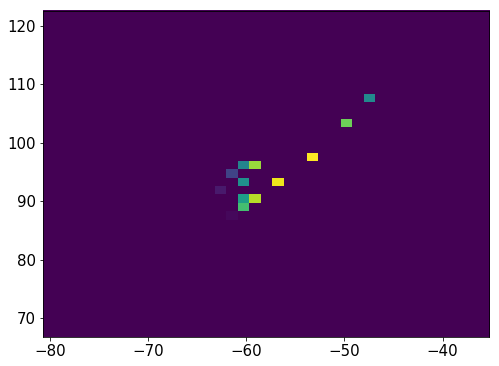

571190    29
571191    29
571192    29
571193    29
571194    29
571195    29
571196    29
571197    29
571198    29
571199    29
Name: Nsipm, dtype: uint16


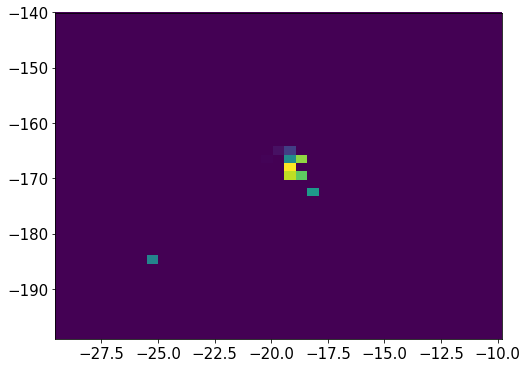

14338    31
14339    31
14340    31
14341    31
14342    31
14343    31
14344    31
14345    31
14346    31
14347    31
14348    31
14349    31
14350    31
14351    31
14352    31
Name: Nsipm, dtype: uint16


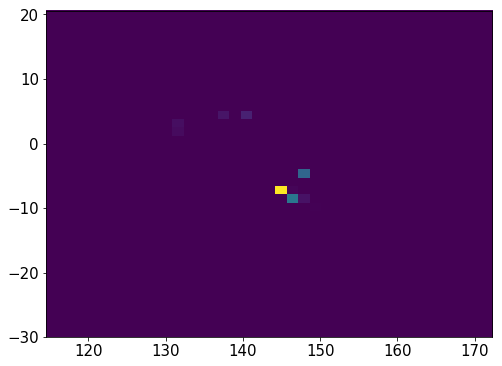

949134    38
949135    38
949136    38
949137    38
949138    38
949139    38
949140    38
949141    38
949142    38
949143    38
949144    38
949145    38
949146    38
949147    38
949148    38
949149    38
Name: Nsipm, dtype: uint16


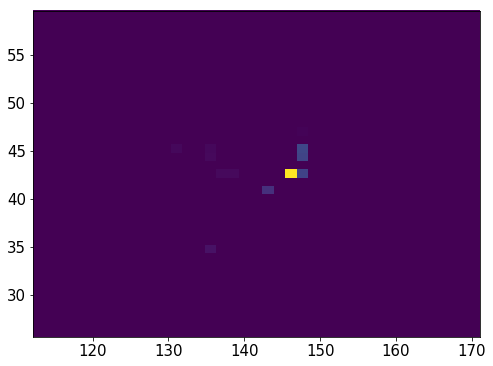

949153    29
949154    29
949155    29
949156    29
949157    29
949158    29
949159    29
949160    29
949161    29
949162    29
949163    29
949164    29
949165    29
Name: Nsipm, dtype: uint16


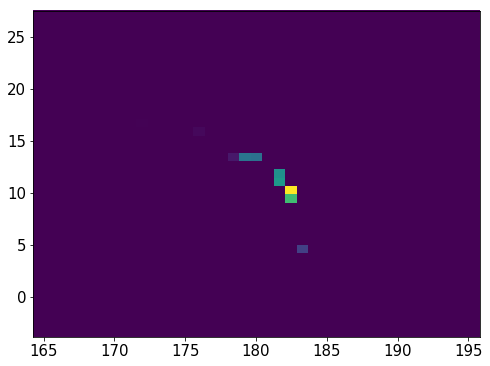

14357    29
14358    29
14359    29
14360    29
14361    29
14362    29
14363    29
14364    29
14365    29
14366    29
14367    29
14368    29
14369    29
14370    29
14371    29
14372    29
14373    29
14374    29
14375    29
14376    29
14377    29
14378    29
Name: Nsipm, dtype: uint16


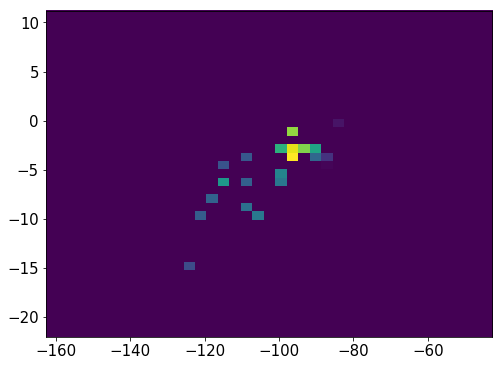

949170    21
949171    21
949172    21
949173    21
949174    21
949175    21
949176    21
949177    21
949178    21
949179    21
949180    21
949186    10
949187    10
949188    10
949189    10
949190    10
949191    10
949192    10
949193    10
949194    10
Name: Nsipm, dtype: uint16


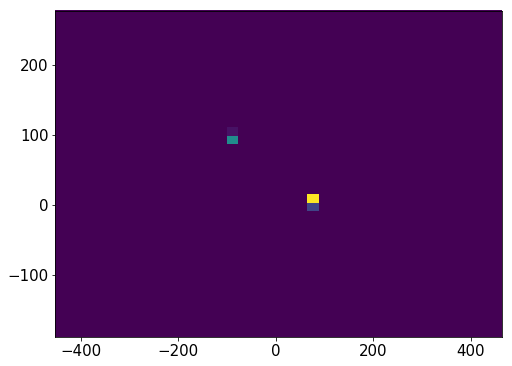

949199    28
949200    28
949201    28
949202    28
949203    28
949204    28
949205    28
949206    28
949207    28
949208    28
949209    28
Name: Nsipm, dtype: uint16


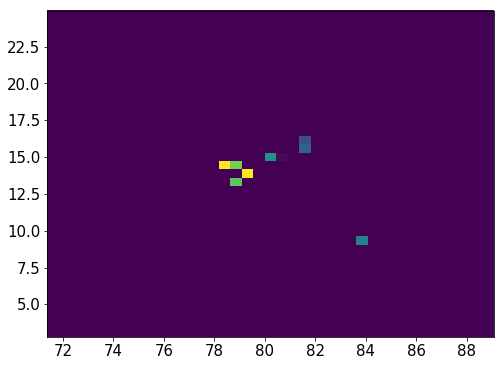

949215    28
949216    28
949217    28
949218    28
949219    28
949220    28
949221    28
949222    28
949223    28
949224    28
949225    28
949226    28
949227    28
949228    28
949229    28
949230    28
949231    28
Name: Nsipm, dtype: uint16


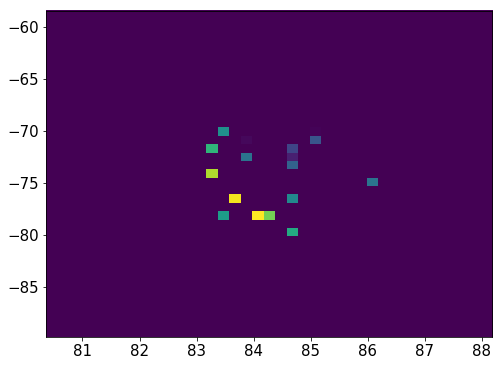

949236    38
949237    38
949238    38
949239    38
949240    38
949241    38
949242    38
949243    38
949244    38
949245    38
949246    38
949247    38
949248    38
949249    38
949250    38
949251    38
949252    38
949253    38
949254    38
949255    38
949256    38
949257    38
949258    38
949259    38
949260    38
949261    38
949262    38
949263    38
Name: Nsipm, dtype: uint16


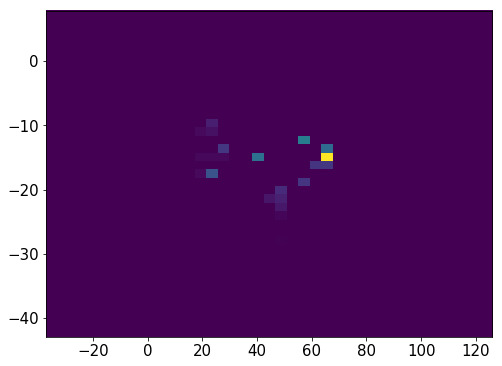

949264    23
949265    23
949266    23
949267    23
949268    23
949269    23
949270    23
949271    23
949272    23
949273    23
949274    23
949275    23
949276    23
949277    23
949278    23
949279    23
949280    23
949281    23
949282    23
949283    23
949284    23
Name: Nsipm, dtype: uint16


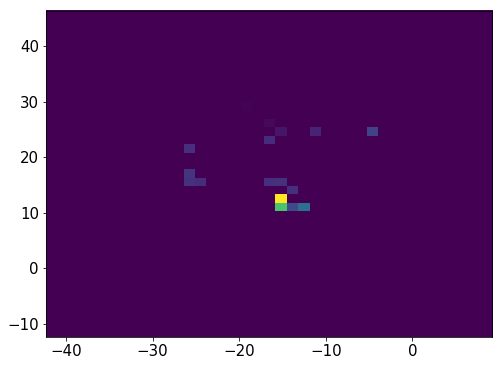

14383    27
14384    27
14385    27
14386    27
14387    27
14388    27
14389    27
14390    27
14391    27
14392    27
14393    27
14394    27
Name: Nsipm, dtype: uint16


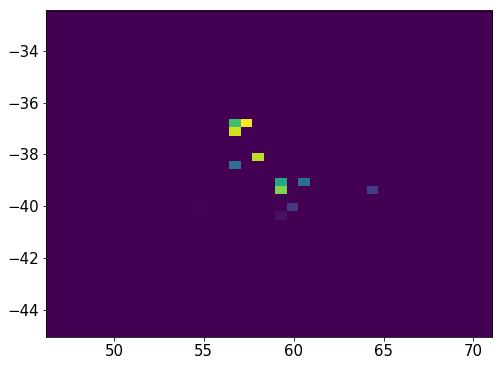

14398    38
14399    38
14400    38
14401    38
14402    38
14403    38
14404    38
14405    38
14406    38
14407    38
14408    38
14409    38
14410    38
14414     2
14415     2
14416     2
14417     2
14418     2
14419     2
14423     7
14424     7
14425     7
14426     7
14427     7
14428     7
14429     7
14430     7
Name: Nsipm, dtype: uint16


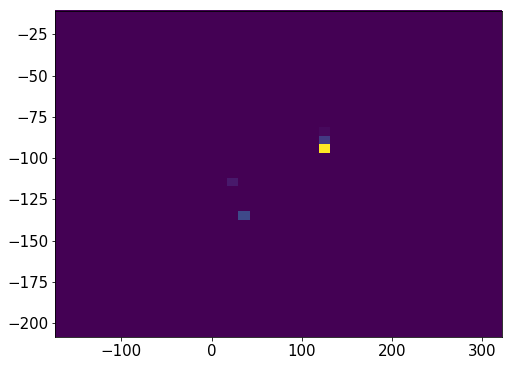

949306    27
949307    27
949308    27
949309    27
949310    27
949311    27
949312    27
949313    27
949314    27
949315    27
949316    27
949317    27
949318    27
949319    27
949320    27
949321    27
949322    27
949323    27
949324    27
949325    27
949326    27
949327    27
949329    27
949331    27
949332    27
949333    27
949334    27
Name: Nsipm, dtype: uint16


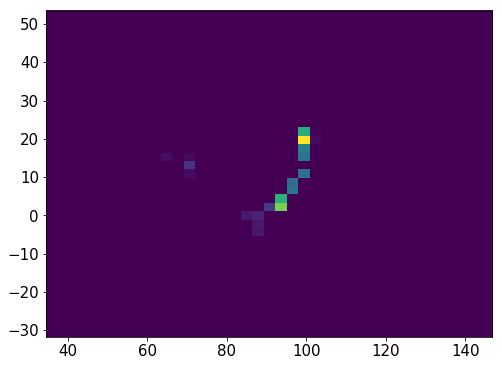

949340    19
949341    19
949342    19
949343    19
949344    19
949345    19
949346    19
Name: Nsipm, dtype: uint16


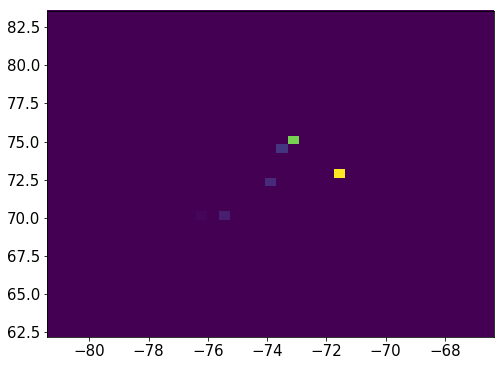

949351    34
949352    34
949353    34
949354    34
949355    34
949356    34
949357    34
949358    34
949359    34
949360    34
949361    34
949362    34
949363    34
949364    34
949365    34
949366    34
949367    34
949368    34
949369    34
Name: Nsipm, dtype: uint16


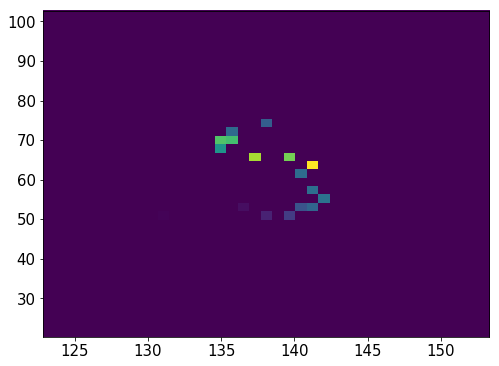

949375    27
949376    27
949377    27
949378    27
949379    27
949380    27
949381    27
949382    27
949383    27
949384    27
949385    27
949386    27
949387    27
949388    27
949389    27
949390    27
949391    27
Name: Nsipm, dtype: uint16


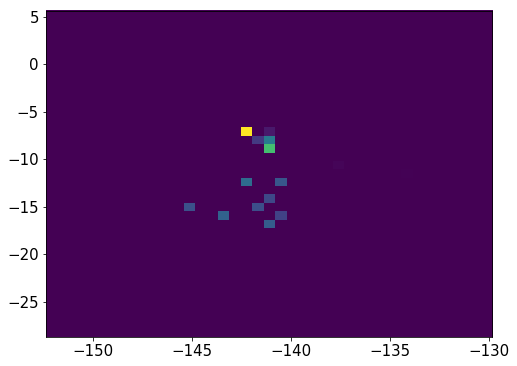

949396    24
949397    24
949398    24
949399    24
949400    24
949401    24
949402    24
949403    24
949404    24
949405    24
949406    24
949407    24
949408    24
949409    24
949410    24
949411    24
949412    24
949413    24
949414    24
949415    24
949416    24
949417    24
949418    24
949419    24
949420    24
949421    24
949422    24
949423    24
949425    24
949426    24
949427    24
949428    24
949429    24
Name: Nsipm, dtype: uint16


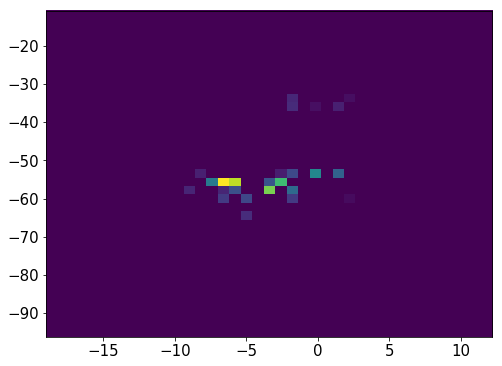

949433    29
949434    29
949435    29
949436    29
949437    29
949438    29
949439    29
949440    29
949441    29
949442    29
949443    29
949444    29
Name: Nsipm, dtype: uint16


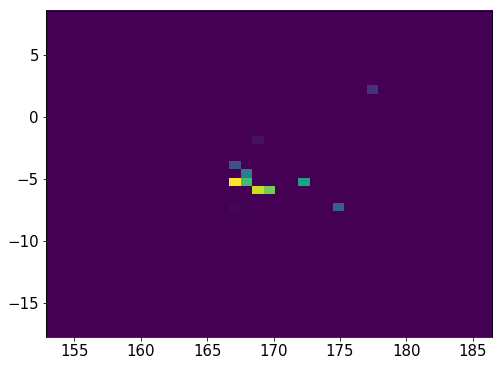

14434    31
14435    31
14436    31
14437    31
14438    31
14439    31
14440    31
14441    31
14442    31
14443    31
14444    31
Name: Nsipm, dtype: uint16


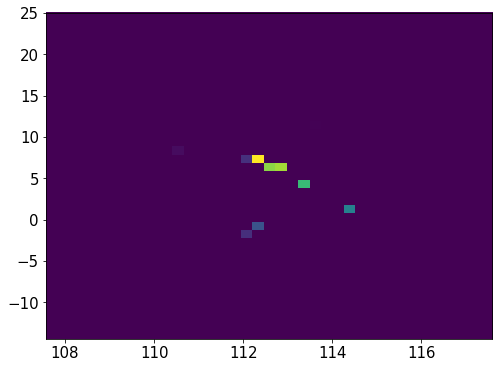

949448    37
949449    37
949450    37
949451    37
949452    37
949453    37
949454    37
949455    37
949456    37
949457    37
949458    37
949459    37
949460    37
949462    37
Name: Nsipm, dtype: uint16


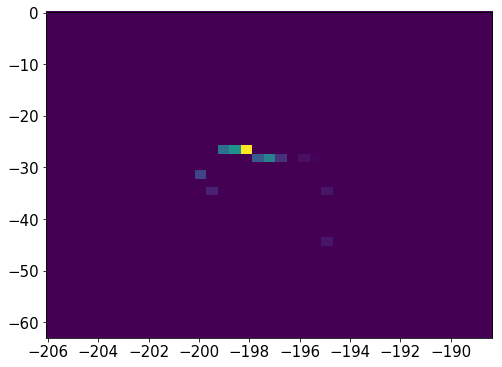

14449    57
14450    57
14451    57
14452    57
14453    57
14454    57
14455    57
14456    57
14457    57
14458    57
14459    57
14460    57
14461    57
14462    57
14463    57
14464    57
14465    57
14466    57
14467    57
14468    57
14469    57
14470    57
14471    57
14472    57
14473    57
14474    57
14475    57
Name: Nsipm, dtype: uint16


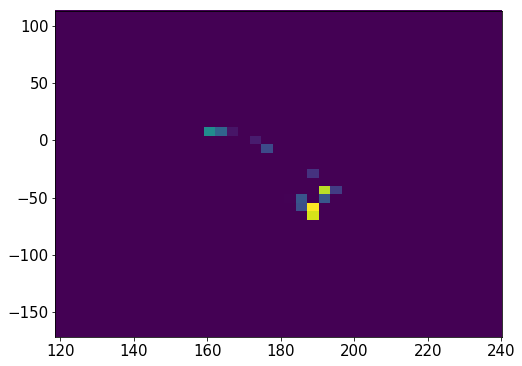

949469    21
949470    21
949471    21
949472    21
949473    21
949474    21
949475    21
949476    21
949477    21
Name: Nsipm, dtype: uint16


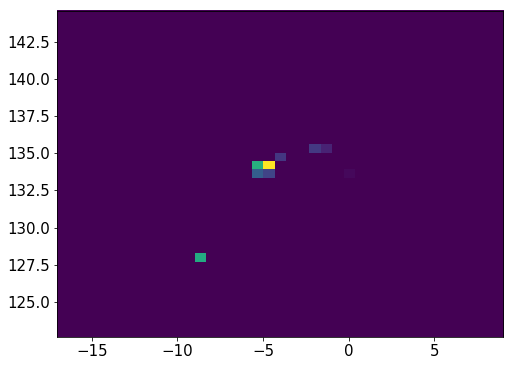

14480    37
14481    37
14482    37
14483    37
14484    37
14485    37
14486    37
14487    37
14488    37
14489    37
14490    37
14491    37
14492    37
14493    37
14494    37
14495    37
14496    37
14497    37
Name: Nsipm, dtype: uint16


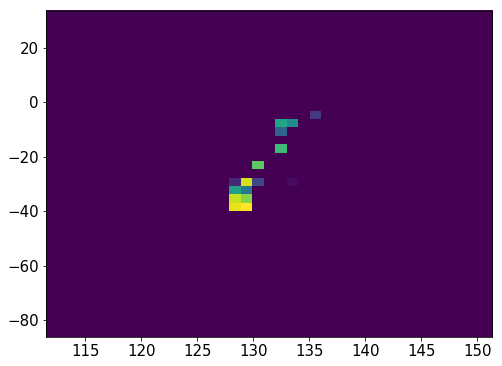

949481    29
949482    29
949483    29
949484    29
949485    29
949486    29
949487    29
949488    29
949489    29
949490    29
949491    29
949492    29
949493    29
949494    29
949495    29
949496    29
949497    29
949498    29
949499    29
949500    29
949501    29
949502    29
949503    29
949504    29
949505    29
949506    29
949507    29
949508    29
Name: Nsipm, dtype: uint16


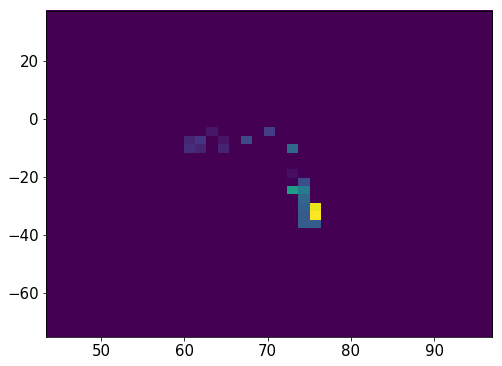

14501    21
14502    21
14503    21
14504    21
14505    21
14506    21
14507    21
14508    21
14509    21
14510    21
14511    21
14512    21
14513    21
14514    21
Name: Nsipm, dtype: uint16


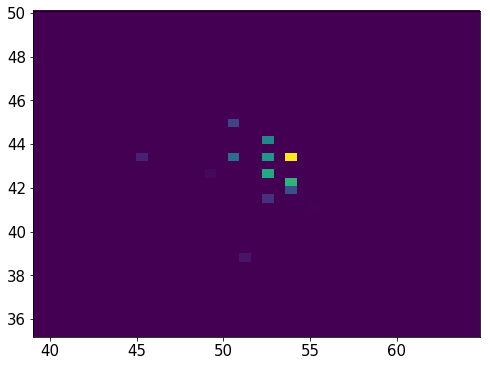

949514    27
949515    27
949516    27
949517    27
949518    27
949519    27
949520    27
949521    27
949522    27
949523    27
949524    27
949525    27
949526    27
949527    27
949528    27
Name: Nsipm, dtype: uint16


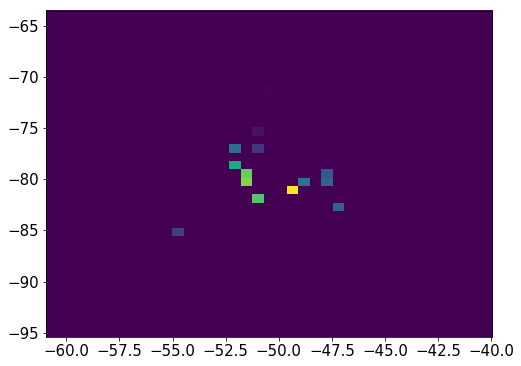

949534    28
949535    28
949536    28
949537    28
949538    28
949539    28
949540    28
949541    28
949542    28
949543    28
949544    28
949545    28
949546    28
949547    28
949548    28
949549    28
949550    28
949551    28
949552    28
949553    28
949554    28
949555    28
Name: Nsipm, dtype: uint16


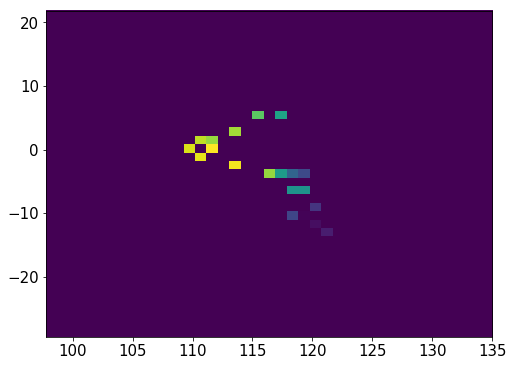

14517    21
14518    21
14519    21
14520    21
14521    21
14522    21
14523    21
14524    21
14525    21
Name: Nsipm, dtype: uint16


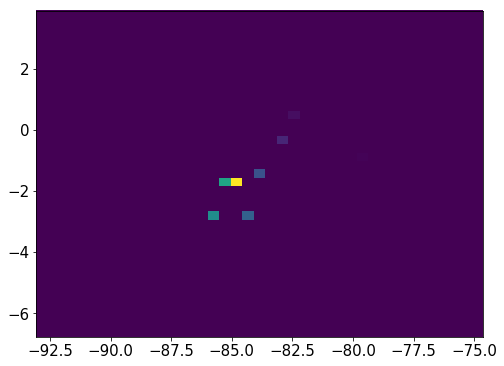

949560    29
949563    29
949564    29
949565    29
949566    29
949567    29
949568    29
949569    29
949570    29
949571    29
949572    29
949573    29
949574    29
Name: Nsipm, dtype: uint16


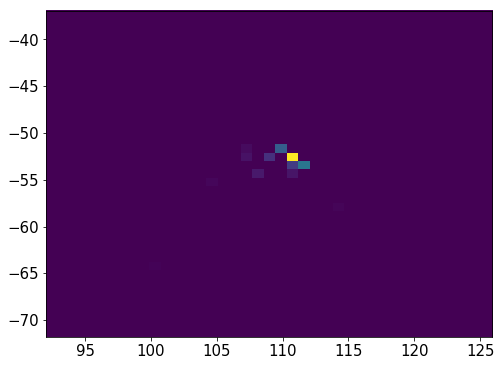

14531    37
14532    37
14533    37
14534    37
14535    37
14536    37
14537    37
14538    37
14539    37
14540    37
14541    37
14542    37
14543    37
14544    37
14545    37
14546    37
Name: Nsipm, dtype: uint16


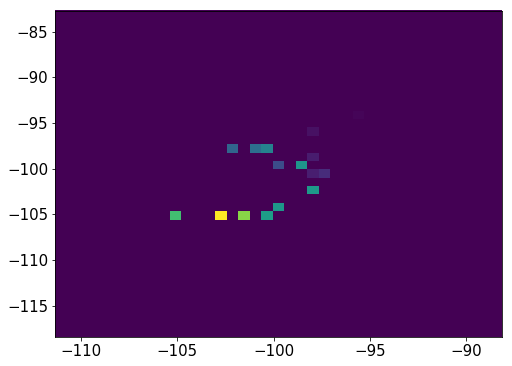

14550    45
14551    45
14552    45
14553    45
14554    45
14555    45
14556    45
14557    45
14558    45
14559    45
14560    45
14561    45
14562    45
14563    45
14564    45
14565    45
14566    45
14567    45
14568    45
14569    45
Name: Nsipm, dtype: uint16


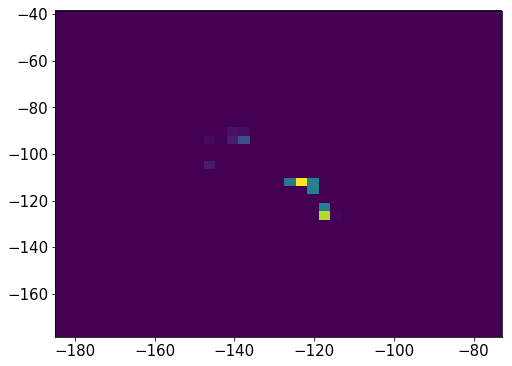

14573    28
14574    28
14575    28
14576    28
14577    28
14578    28
14579    28
14580    28
14581    28
14582    28
14583    28
14584    28
14585    28
14586    28
14587    28
14588    28
14589    28
14590    28
14591    28
Name: Nsipm, dtype: uint16


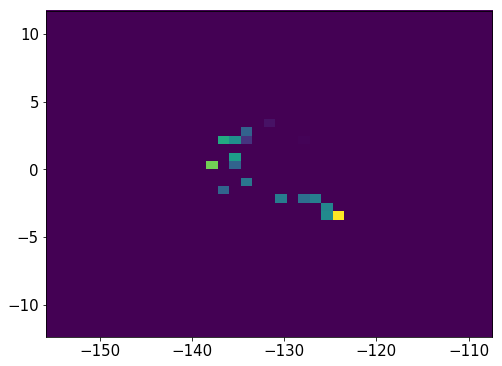

14596    27
14597    27
14598    27
14601    27
14602    27
14603    27
14604    27
14605    27
14606    27
14607    27
14608    27
14609    27
14610    27
14611    27
14612    27
14613    27
14614    27
14615    27
14616    27
Name: Nsipm, dtype: uint16


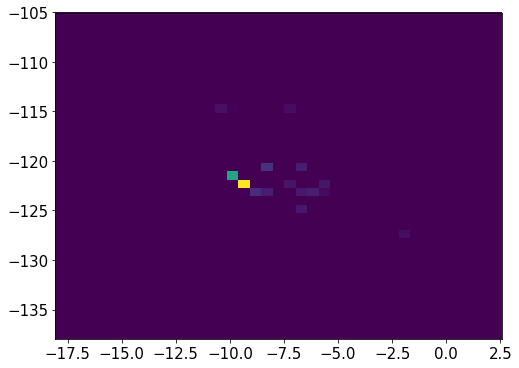

949597    26
949598    26
949599    26
949600    26
949601    26
949602    26
949603    26
949604    26
949605    26
949606    26
949607    26
949608    26
949609    26
949610    26
949611    26
949612    26
949613    26
949614    26
949615    26
Name: Nsipm, dtype: uint16


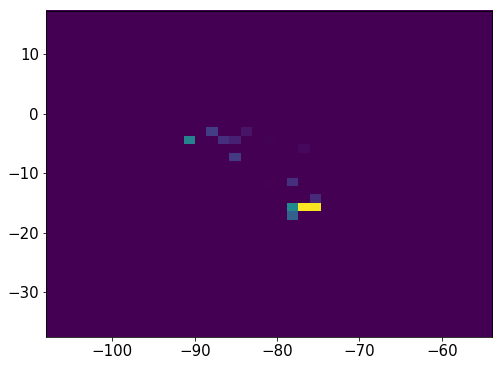

14619    29
14620    29
14621    29
14622    29
14623    29
14624    29
14625    29
14626    29
14627    29
14628    29
14629    29
14630    29
14631    29
14632    29
14633    29
14634    29
14639    29
Name: Nsipm, dtype: uint16


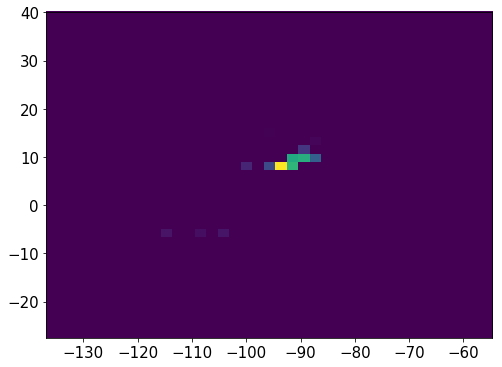

949621    35
949622    35
949623    35
949624    35
949625    35
949626    35
949627    35
949628    35
949629    35
949630    35
949631    35
949632    35
949633    35
Name: Nsipm, dtype: uint16


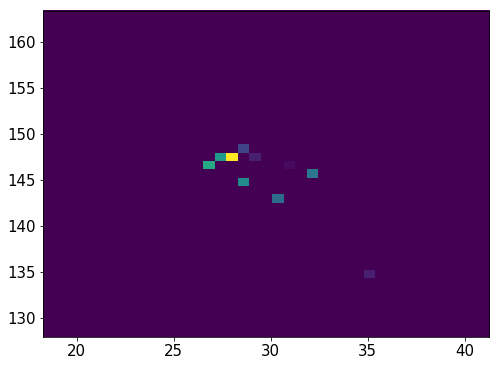

949637    39
949638    39
949639    39
949640    39
949641    39
949642    39
949643    39
949644    39
949645    39
949646    39
949647    39
949648    39
949650    39
949651    39
949653    39
949655    39
949656    39
Name: Nsipm, dtype: uint16


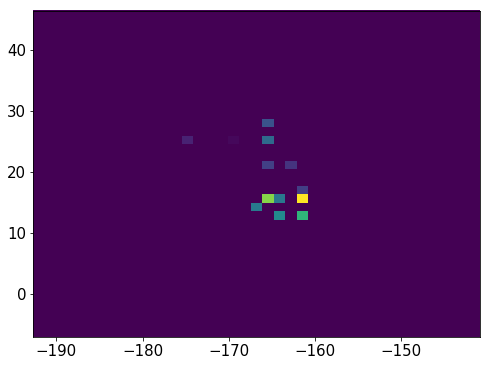

14644    24
14645    24
14646    24
14647    24
14648    24
14649    24
14650    24
14651    24
14652    24
14653    24
14654    24
14655    24
Name: Nsipm, dtype: uint16


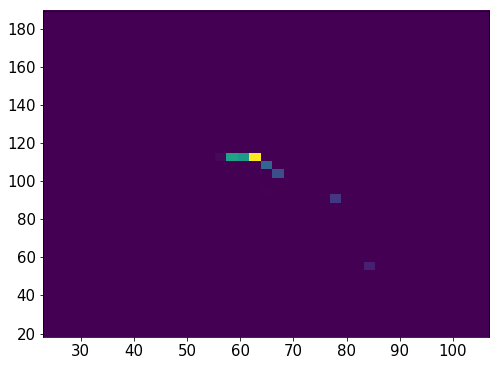

14659    36
14660    36
14661    36
14662    36
14663    36
14664    36
14665    36
14666    36
14667    36
14668    36
14669    36
14670    36
14671    36
14672    36
14673    36
14674    36
14675    36
14676    36
14677    36
14678    36
Name: Nsipm, dtype: uint16


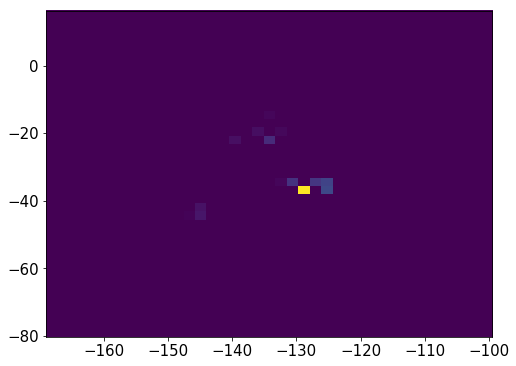

14681    28
14682    28
14683    28
14684    28
14685    28
14686    28
14687    28
14688    28
14689    28
14690    28
14691    28
Name: Nsipm, dtype: uint16


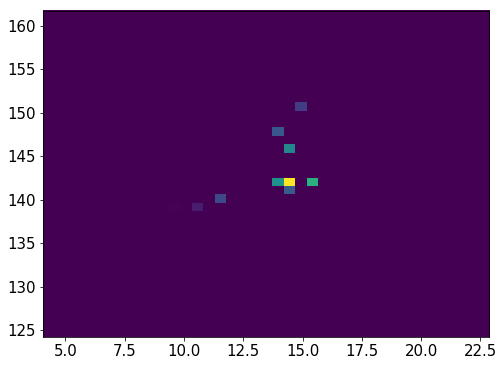

14696    29
14697    29
14698    29
14699    29
14700    29
14701    29
14702    29
14703    29
14704    29
14705    29
14706    29
14707    29
14708    29
14709    29
14710    29
14711    29
14712    29
14713    29
14714    29
14715    29
14716    29
14717    29
14718    29
14719    29
14720    29
Name: Nsipm, dtype: uint16


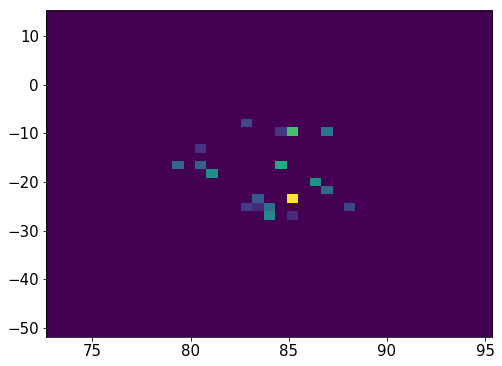

949661    27
949662    27
949663    27
949664    27
949665    27
949666    27
949667    27
949668    27
949669    27
949670    27
949671    27
949672    27
949673    27
Name: Nsipm, dtype: uint16


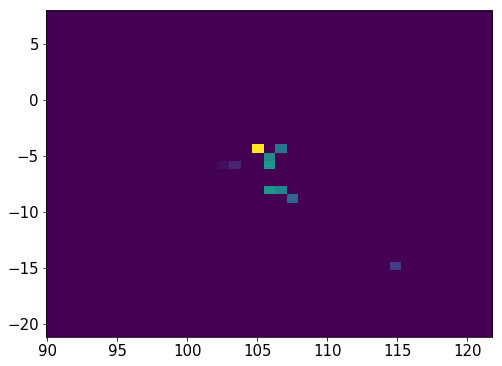

949677    37
949678    37
949679    37
949680    37
949681    37
949682    37
949683    37
949684    37
949685    37
949686    37
Name: Nsipm, dtype: uint16


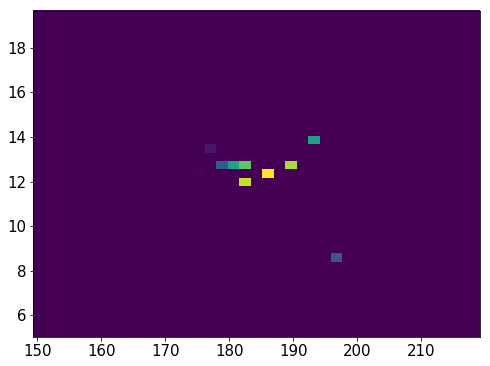

14725    23
14726    23
14727    23
14728    23
14729    23
14730    23
14731    23
14732    23
14733    23
14734    23
14735    23
14736    23
14737    23
14738    23
14739    23
14740    23
14741    23
14742    23
14743    23
14744    23
14745    23
14746    23
14747    23
14748    23
14749    23
14750    23
14751    23
14752    23
Name: Nsipm, dtype: uint16


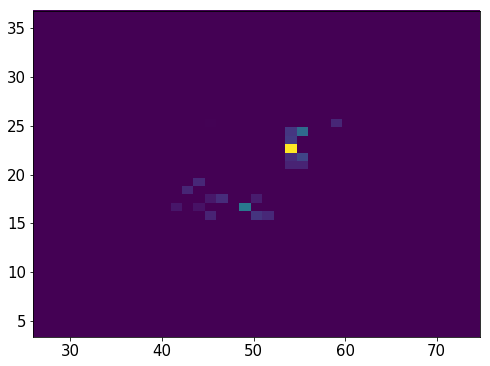

14757    20
14758    20
14759    20
14760    20
14761    20
14762    20
14763    20
14764    20
14765    20
14766    20
14767    20
14768    20
14769    20
14770    20
14771    20
14772    20
Name: Nsipm, dtype: uint16


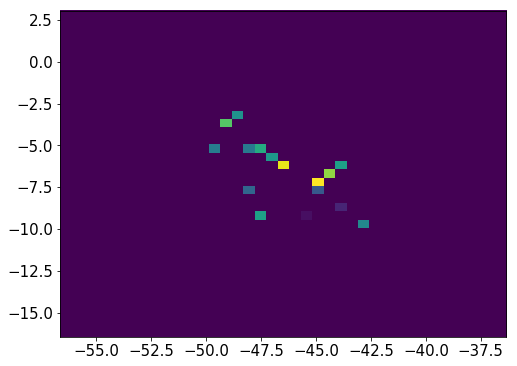

949715    29
949716    29
949717    29
949718    29
949719    29
949720    29
949721    29
949722    29
949723    29
949724    29
949725    29
949726    29
949727    29
949728    29
949729    29
949730    29
949731    29
949732    29
949733    29
949734    29
Name: Nsipm, dtype: uint16


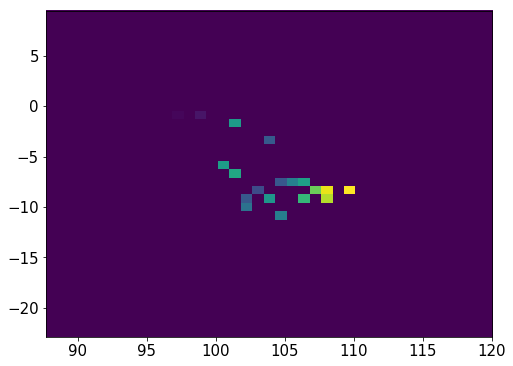

14777    26
14778    26
14779    26
14780    26
14781    26
14782    26
14783    26
14784    26
14785    26
14786    26
14787    26
14788    26
14789    26
Name: Nsipm, dtype: uint16


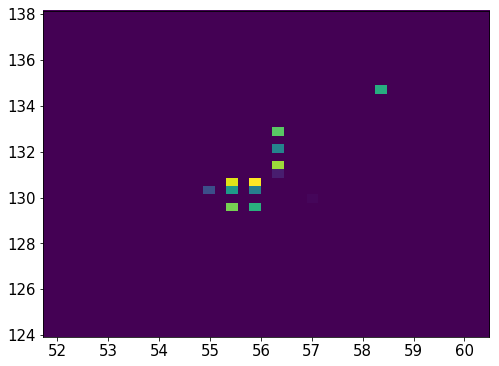

14795    28
14796    28
14797    28
14798    28
14799    28
14800    28
14801    28
14802    28
14803    28
14804    28
14805    28
14806    28
14807    28
14808    28
14809    28
14810    28
Name: Nsipm, dtype: uint16


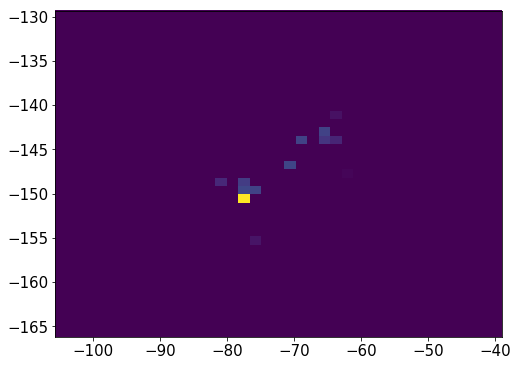

949766    25
949767    25
949768    25
949769    25
949770    25
949771    25
949772    25
949773    25
949774    25
949775    25
949776    25
949777    25
949781    15
949782    15
949783    15
949784    15
949785    15
949786    15
949787    15
949788    15
949789    15
Name: Nsipm, dtype: uint16


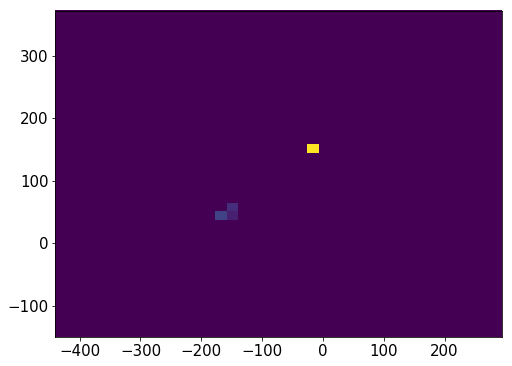

14814    23
14815    23
14816    23
14817    23
14818    23
14819    23
14820    23
14821    23
14822    23
14823    23
14824    23
14825    23
14826    23
14827    23
14828    23
14829    23
14830    23
14831    23
Name: Nsipm, dtype: uint16


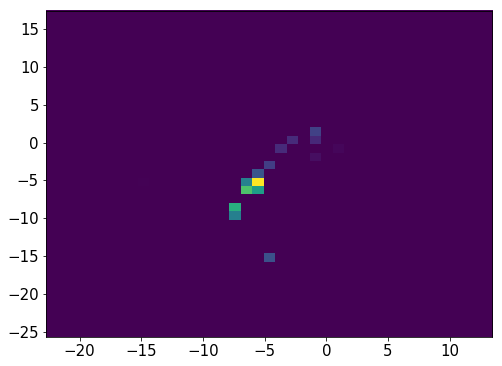

949832    20
949833    20
949834    20
949835    20
949836    20
949837    20
949838    20
949839    20
949840    20
949841    20
949842    20
949843    20
949844    20
949845    20
949846    20
949847    20
949848    20
949849    20
Name: Nsipm, dtype: uint16


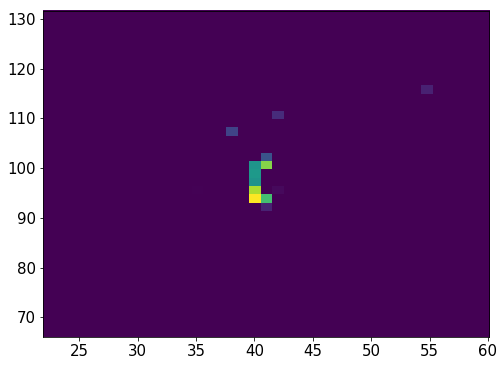

949854    22
949855    22
949856    22
949857    22
949858    22
949859    22
949862    22
949863    22
949864    22
949865    22
949866    22
949867    22
949868    22
949869    22
949870    22
949871    22
949872    22
949873    22
949874    22
949875    22
949876    22
Name: Nsipm, dtype: uint16


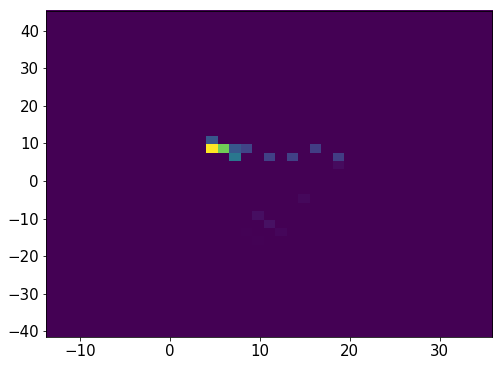

949878    22
949879    22
949880    22
949881    22
949882    22
949883    22
949884    22
949885    22
949886    22
949887    22
949888    22
949889    22
949890    22
949891    22
949892    22
949893    22
949898    11
949899    11
949900    11
949901    11
949902    11
949903    11
949904    11
949905    11
949906    11
949913     1
949914     1
949915     1
949916     1
Name: Nsipm, dtype: uint16


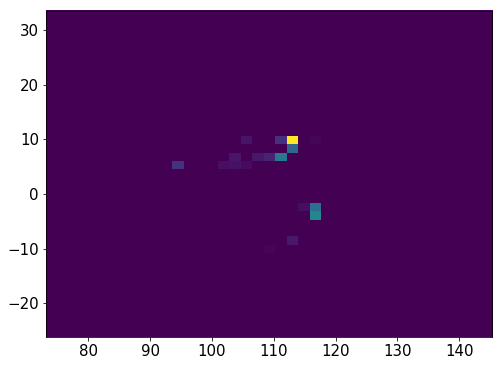

14835    25
14836    25
14837    25
14838    25
14839    25
14840    25
14841    25
14842    25
14843    25
14844    25
14845    25
14846    25
14847    25
14848    25
14849    25
14850    25
14851    25
14852    25
14853    25
14861     1
14862     1
14863     1
14865     1
Name: Nsipm, dtype: uint16


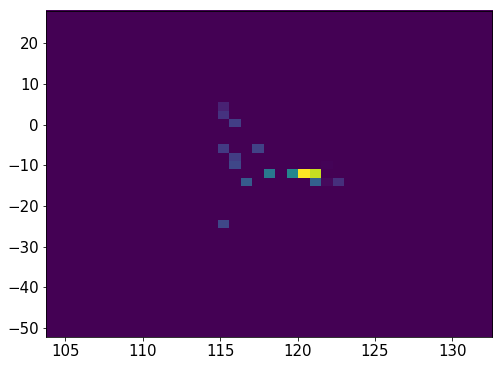

14869    28
14870    28
14871    28
14872    28
14873    28
14874    28
14875    28
14876    28
14877    28
14878    28
14879    28
14880    28
14881    28
14882    28
14883    28
14884    28
Name: Nsipm, dtype: uint16


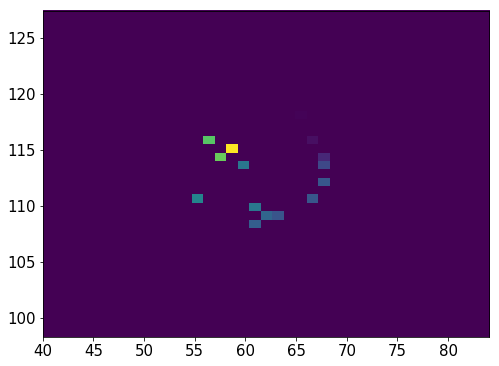

949921    24
949922    24
949923    24
949924    24
949925    24
949926    24
949927    24
949928    24
949929    24
949930    24
949931    24
949932    24
949933    24
949934    24
949935    24
949936    24
949937    24
949938    24
949939    24
949940    24
949941    24
949942    24
949943    24
949944    24
949945    24
949946    24
949947    24
949949    24
949950    24
949951    24
949952    24
949953    24
949954    24
949955    24
Name: Nsipm, dtype: uint16


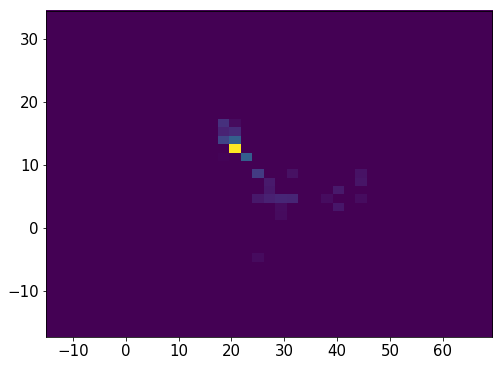

949959    30
949960    30
949961    30
949962    30
949963    30
949964    30
949965    30
949966    30
949967    30
949968    30
949969    30
949970    30
949971    30
949972    30
949973    30
949974    30
949975    30
949976    30
949977    30
949978    30
Name: Nsipm, dtype: uint16


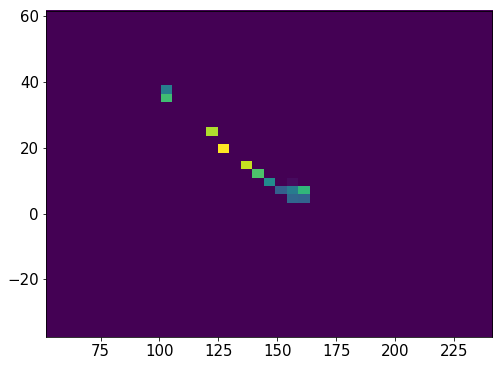

949984    24
949985    24
949986    24
949987    24
949988    24
949989    24
949990    24
949991    24
949992    24
949993    24
949994    24
949995    24
949996    24
949997    24
949998    24
949999    24
950000    24
950001    24
950002    24
950003    24
950004    24
Name: Nsipm, dtype: uint16


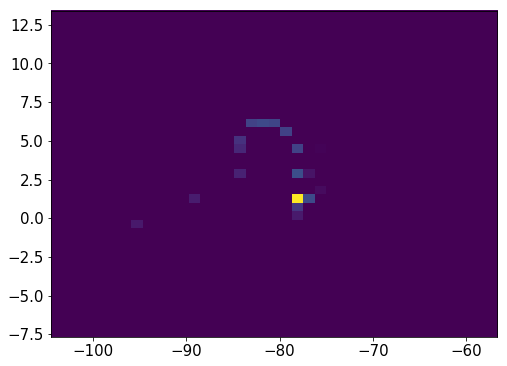

14889    22
14890    22
14891    22
14892    22
14893    22
14894    22
14895    22
14896    22
14897    22
14898    22
14899    22
14900    22
14901    22
14902    22
14903    22
14904    22
14905    22
14906    22
14907    22
14908    22
14909    22
14910    22
14911    22
Name: Nsipm, dtype: uint16


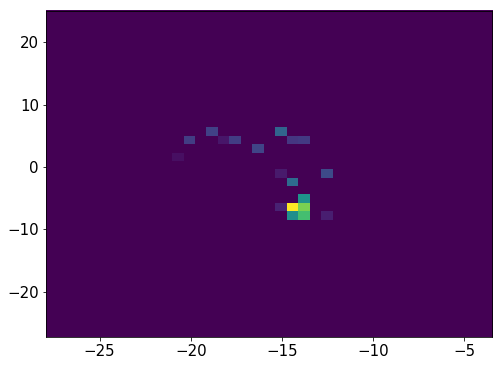

14916    26
14917    26
14918    26
14919    26
14920    26
14921    26
14922    26
14923    26
14924    26
14925    26
14926    26
14927    26
14928    26
14929    26
14930    26
14931    26
14932    26
14933    26
14938     2
14939     2
14940     2
14941     2
14942     2
Name: Nsipm, dtype: uint16


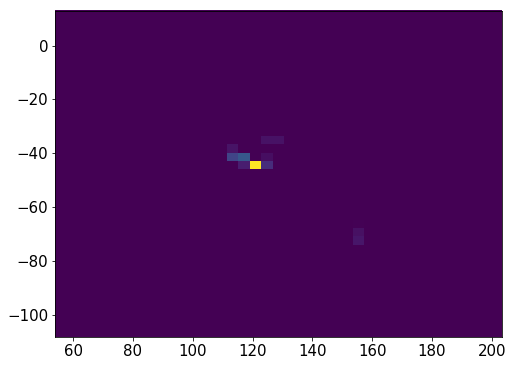

950009    29
950010    29
950011    29
950012    29
950013    29
950014    29
950015    29
950016    29
950017    29
950018    29
950019    29
950020    29
950021    29
Name: Nsipm, dtype: uint16


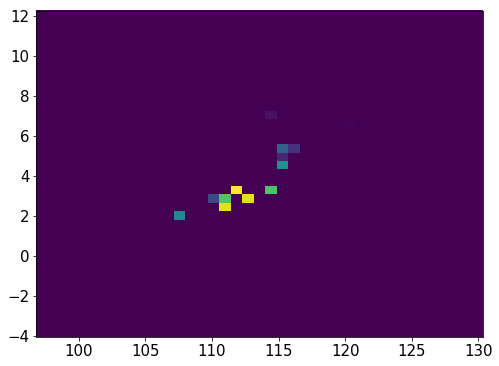

950024    23
950025    23
950026    23
950027    23
950028    23
950029    23
950030    23
950031    23
950032    23
950033    23
950034    23
950035    23
950036    23
950037    23
Name: Nsipm, dtype: uint16


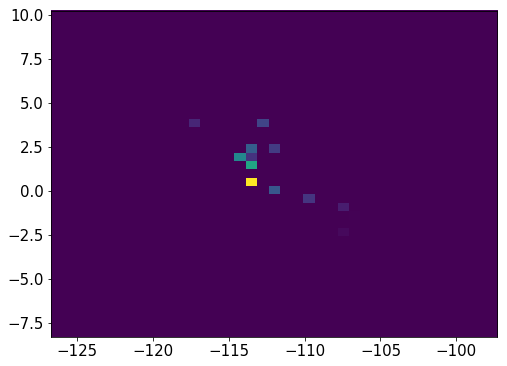

14947    25
14948    25
14949    25
14950    25
14951    25
14952    25
14953    25
14954    25
14955    25
14956    25
14957    25
14958    25
Name: Nsipm, dtype: uint16


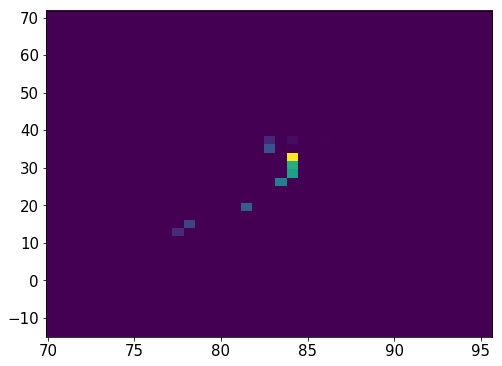

365134    25
365135    25
365136    25
365137    25
365138    25
365139    25
365140    25
365141    25
365142    25
365143    25
365144    25
365145    25
365146    25
365147    25
365148    25
365149    25
365150    25
Name: Nsipm, dtype: uint16


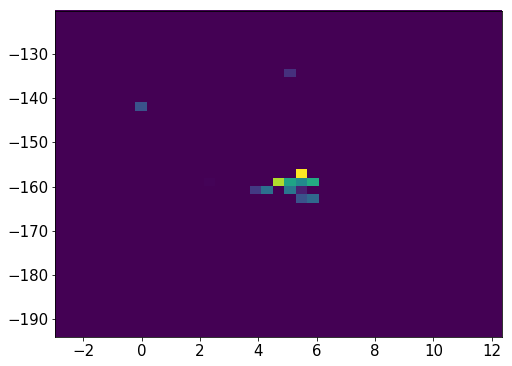

14963    25
14964    25
14965    25
14966    25
14967    25
14968    25
14969    25
14970    25
14971    25
14972    25
14973    25
14974    25
14975    25
14976    25
14977    25
14978    25
14979    25
14980    25
14981    25
14982    25
14983    25
14984    25
14985    25
14986    25
14987    25
14988    25
Name: Nsipm, dtype: uint16


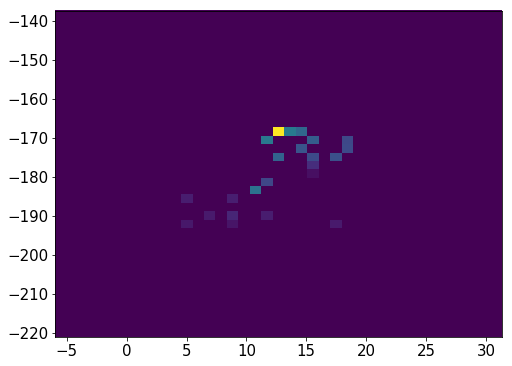

14996    22
14997    22
14998    22
14999    22
15000    22
15001    22
15002    22
15003    22
15004    22
15005    22
15006    22
15007    22
15008    22
15009    22
15010    22
15011    22
Name: Nsipm, dtype: uint16


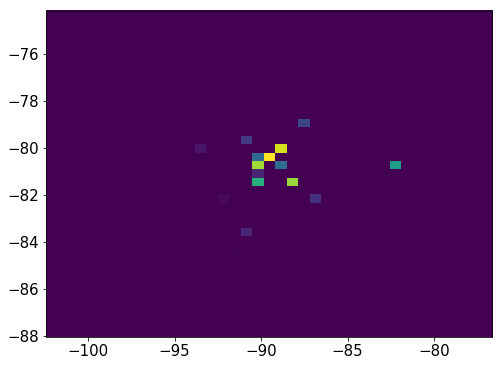

15030    16
15031    16
15032    16
15033    16
15034    16
15035    16
15036    16
15037    16
15038    16
15039    16
Name: Nsipm, dtype: uint16


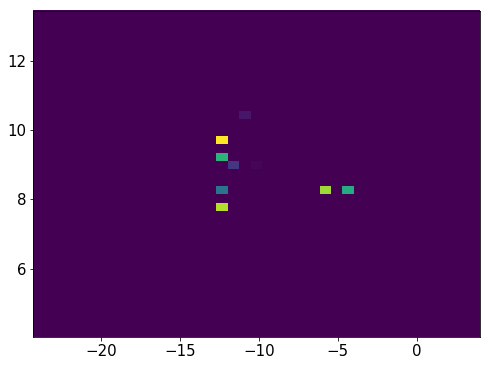

15040    25
15041    25
15042    25
15043    25
15044    25
15045    25
15046    25
15047    25
15048    25
15049    25
15050    25
15051    25
15052    25
15053    25
Name: Nsipm, dtype: uint16


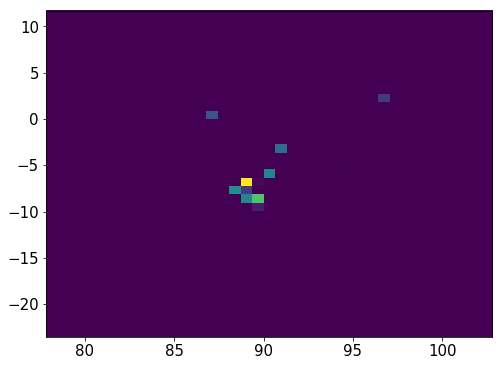

950042    30
950043    30
950044    30
950045    30
950046    30
950047    30
950048    30
950049    30
950050    30
950051    30
950052    30
950053    30
950054    30
950055    30
950056    30
950057    30
Name: Nsipm, dtype: uint16


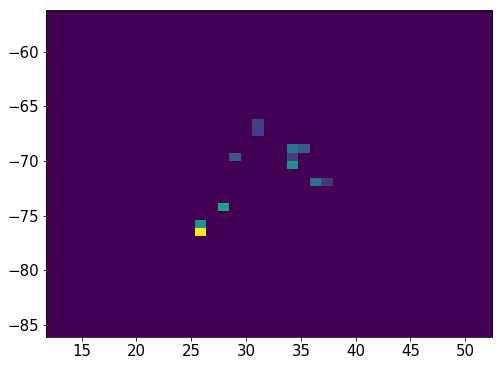

15058    40
15059    40
15060    40
15061    40
15062    40
15063    40
15064    40
15065    40
15066    40
15067    40
15068    40
15069    40
15070    40
15071    40
15072    40
Name: Nsipm, dtype: uint16


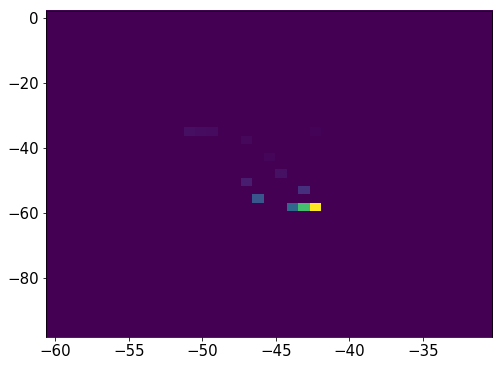

15074    35
15075    35
15076    35
15077    35
15078    35
15079    35
15080    35
15081    35
15082    35
15083    35
15084    35
15085    35
15086    35
15087    35
15088    35
15089    35
15090    35
15091    35
15092    35
15093    35
15094    35
15095    35
15096    35
15097    35
15098    35
15099    35
15100    35
15101    35
15102    35
15103    35
Name: Nsipm, dtype: uint16


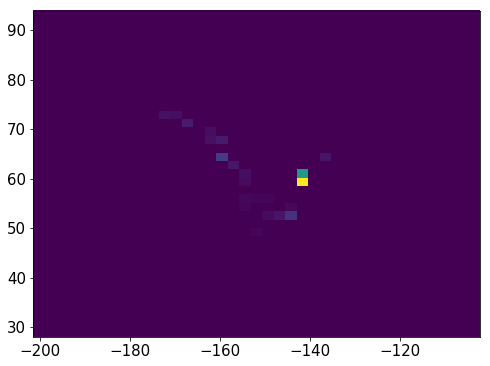

950060    27
950061    27
950062    27
950063    27
950064    27
950065    27
950066    27
950067    27
950068    27
950069    27
950070    27
950071    27
950072    27
950073    27
950074    27
950075    27
950076    27
950077    27
Name: Nsipm, dtype: uint16


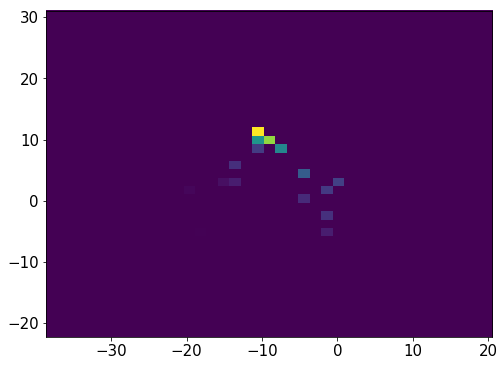

950082    28
950083    28
950084    28
950085    28
950086    28
950089    28
950090    28
950091    28
950092    28
950093    28
950094    28
950095    28
950096    28
950097    28
950098    28
950099    28
950100    28
950101    28
950102    28
950103    28
950104    28
Name: Nsipm, dtype: uint16


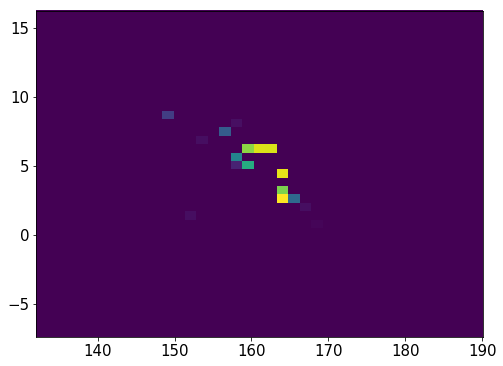

950105    34
950106    34
950107    34
950108    34
950109    34
950110    34
950111    34
950112    34
950113    34
950114    34
950115    34
950116    34
950117    34
950118    34
Name: Nsipm, dtype: uint16


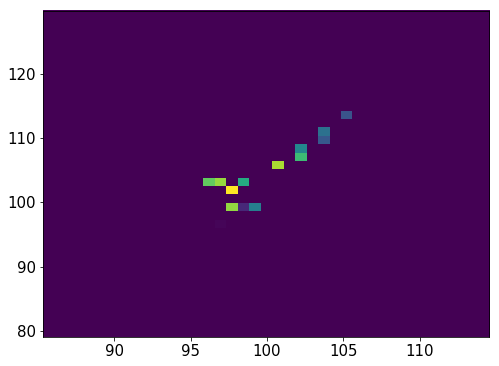

15108    24
15109    24
15110    24
15111    24
15112    24
15113    24
15114    24
15115    24
15116    24
15117    24
15118    24
15119    24
15120    24
15121    24
15122    24
15124    24
15125    24
15126    24
15127    24
Name: Nsipm, dtype: uint16


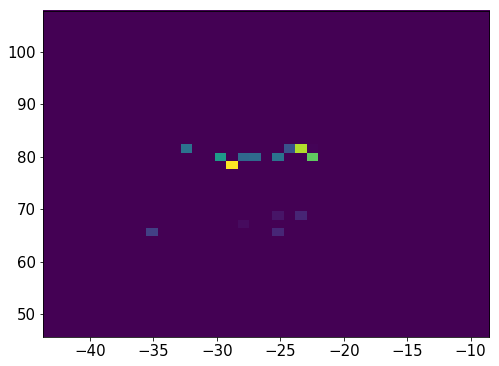

15131    30
15132    30
15133    30
15134    30
15135    30
15136    30
15137    30
15138    30
15139    30
15140    30
15141    30
Name: Nsipm, dtype: uint16


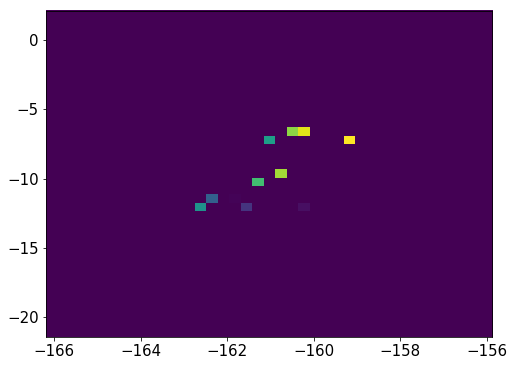

935977    20
935978    20
935979    20
935980    20
935981    20
935982    20
935983    20
935984    20
935985    20
935986    20
935987    20
935988    20
935989    20
935990    20
Name: Nsipm, dtype: uint16


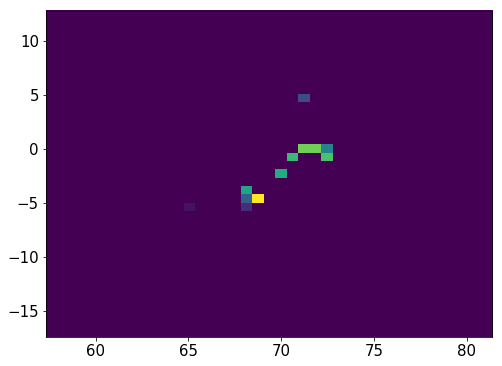

950138    27
950139    27
950140    27
950141    27
950142    27
950143    27
950144    27
950145    27
950146    27
950147    27
950148    27
950149    27
950150    27
950151    27
950152    27
Name: Nsipm, dtype: uint16


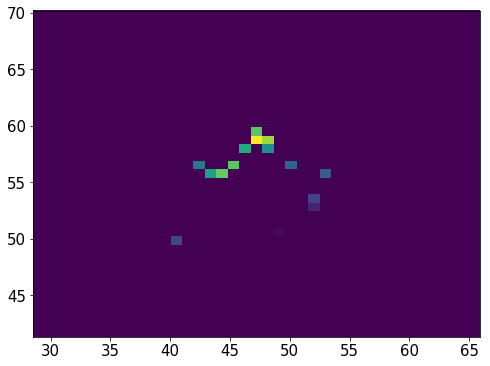

950156    19
950157    19
950158    19
950159    19
950160    19
950161    19
950162    19
950163    19
950164    19
950165    19
950166    19
950167    19
950168    19
950169    19
Name: Nsipm, dtype: uint16


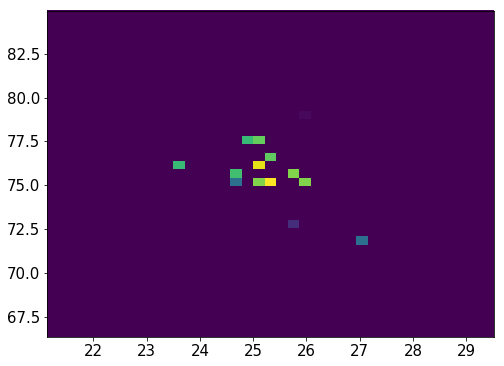

15147    24
15148    24
15149    24
15150    24
15151    24
15152    24
15153    24
15154    24
15155    24
15156    24
15157    24
15158    24
15159    24
15160    24
15161    24
15162    24
15163    24
15164    24
15165    24
Name: Nsipm, dtype: uint16


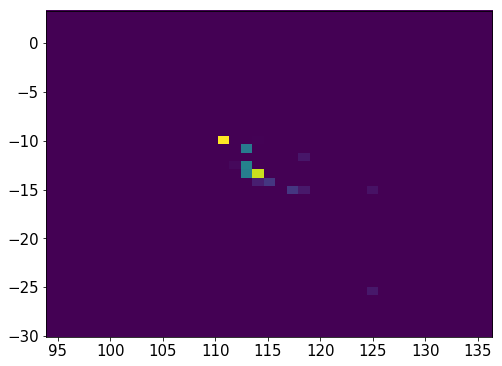

1665560    23
1665561    23
1665562    23
1665563    23
1665564    23
1665565    23
1665566    23
1665567    23
1665568    23
1665569    23
1665570    23
1665571    23
1665572    23
1665573    23
1665574    23
1665575    23
1665576    23
1665577    23
1665578    23
1665579    23
1665580    23
1665581    23
1665582    23
1665583    23
1665584    23
1665585    23
1665586    23
1665587    23
1665588    23
1665589    23
1665590    23
1665591    23
1665592    23
1665598     1
1665599     1
1665600     1
1665601     1
1665602     1
Name: Nsipm, dtype: uint16


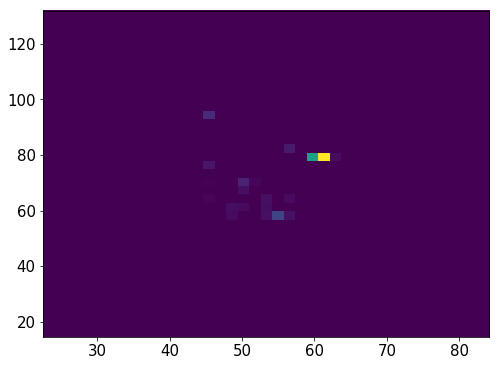

950202    48
950203    48
950204    48
950205    48
950206    48
950207    48
950208    48
950209    48
950210    48
950211    48
950212    48
950213    48
950214    48
950215    48
950216    48
950217    48
950218    48
950219    48
950220    48
950221    48
950222    48
950223    48
950224    48
950225    48
950226    48
950227    48
950228    48
950229    48
950230    48
950231    48
950232    48
950233    48
Name: Nsipm, dtype: uint16


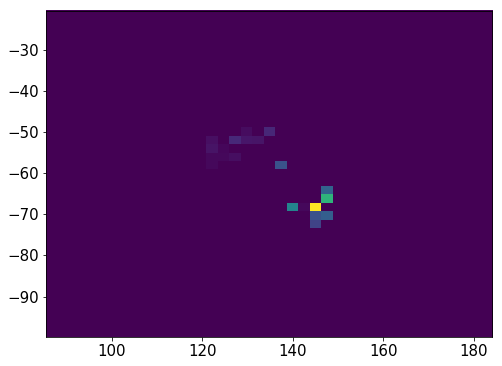

15171    26
15172    26
15173    26
15174    26
15175    26
15176    26
15177    26
15178    26
15179    26
15180    26
15181    26
15182    26
15183    26
15184    26
15185    26
15186    26
15187    26
15188    26
Name: Nsipm, dtype: uint16


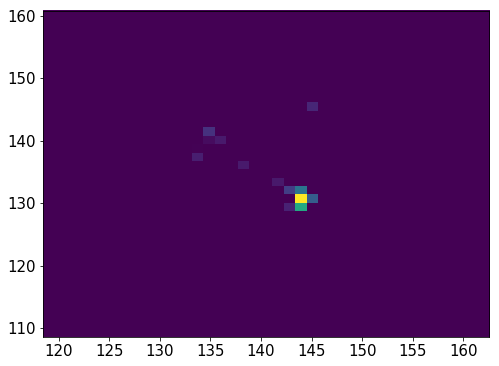

15200    27
15201    27
15202    27
15203    27
15204    27
15205    27
15206    27
15207    27
15208    27
15209    27
15210    27
15211    27
15212    27
15213    27
15214    27
15215    27
15216    27
15220     1
15221     1
15222     1
15223     1
15224     1
Name: Nsipm, dtype: uint16


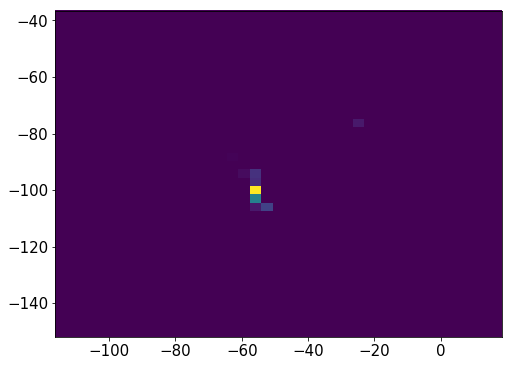

950238    30
950239    30
950240    30
950241    30
950242    30
950243    30
950244    30
950245    30
950246    30
950247    30
950248    30
950249    30
950250    30
950251    30
950252    30
950253    30
950254    30
950255    30
950256    30
Name: Nsipm, dtype: uint16


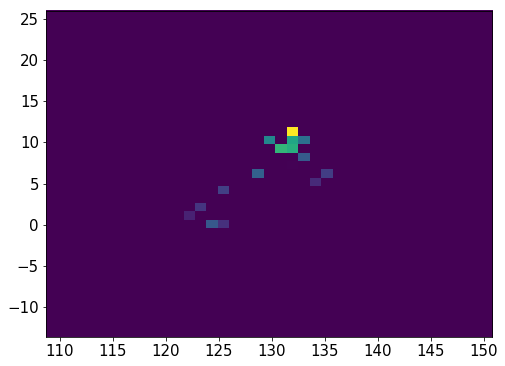

15230    30
15231    30
15232    30
15233    30
15234    30
15235    30
15236    30
15237    30
15238    30
15239    30
15240    30
15242    30
15243    30
15244    30
15245    30
15246    30
15247    30
15248    30
15249    30
15250    30
15251    30
15252    30
Name: Nsipm, dtype: uint16


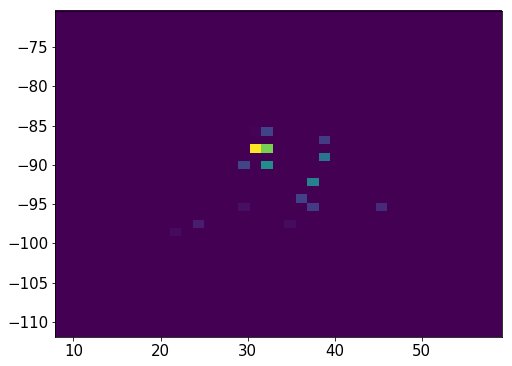

15256    27
15257    27
15258    27
15259    27
15260    27
15261    27
15262    27
15263    27
15264    27
15265    27
15266    27
15267    27
15268    27
15269    27
Name: Nsipm, dtype: uint16


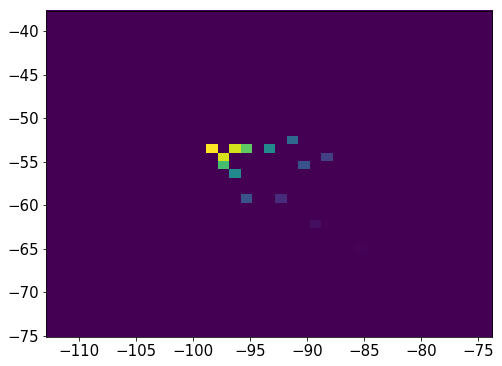

15274    45
15275    45
15276    45
15277    45
15278    45
15279    45
15280    45
15281    45
15282    45
15283    45
15284    45
15285    45
15286    45
15287    45
15288    45
15289    45
15290    45
15291    45
Name: Nsipm, dtype: uint16


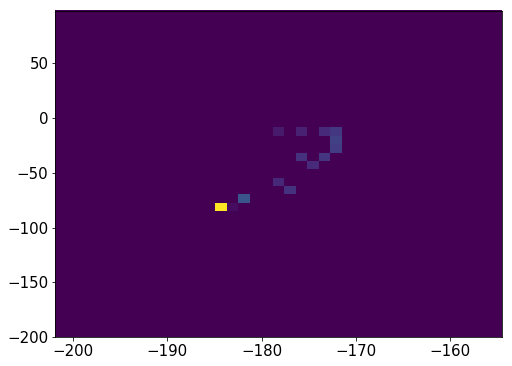

950303    25
950304    25
950305    25
950306    25
950307    25
950308    25
950309    25
950310    25
950311    25
950312    25
950313    25
950314    25
950315    25
950316    25
950317    25
950318    25
Name: Nsipm, dtype: uint16


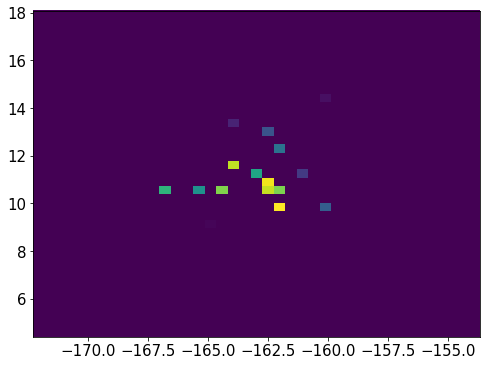

950323    18
950324    18
950325    18
950326    18
950327    18
950328    18
950329    18
950330    18
950331    18
950332    18
950333    18
950334    18
950335    18
950336    18
950337    18
950338    18
950339    18
950340    18
950341    18
950347     8
950348     8
950349     8
950350     8
950351     8
950352     8
950353     8
950354     8
Name: Nsipm, dtype: uint16


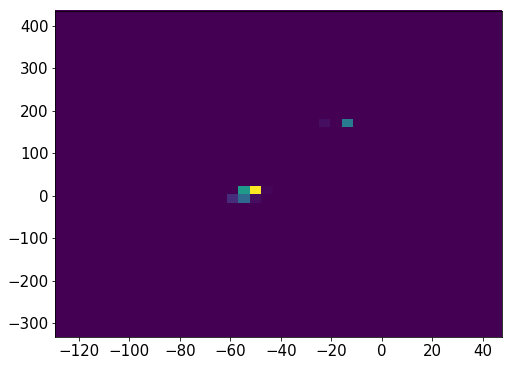

15295    20
15296    20
15297    20
15298    20
15299    20
15300    20
15301    20
15302    20
15307    12
15308    12
15309    12
15310    12
15311    12
15312    12
15313    12
15314    12
15315    12
15316    12
15317    12
15318    12
15319    12
15327    12
15328    12
Name: Nsipm, dtype: uint16


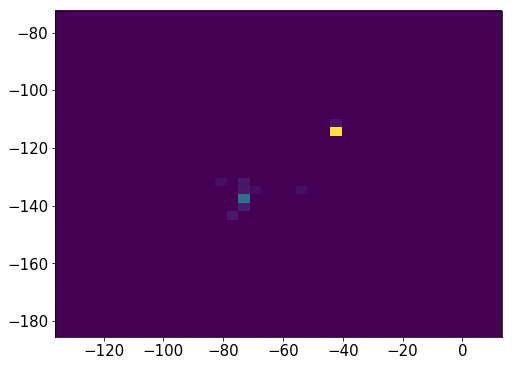

950358    24
950359    24
950360    24
950361    24
950362    24
950363    24
950364    24
950365    24
950366    24
950367    24
950368    24
950369    24
950370    24
Name: Nsipm, dtype: uint16


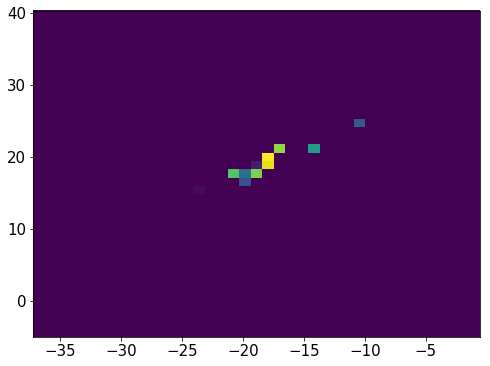

950374    27
950375    27
950376    27
950377    27
950378    27
950379    27
950380    27
950381    27
950382    27
950383    27
950384    27
950385    27
Name: Nsipm, dtype: uint16


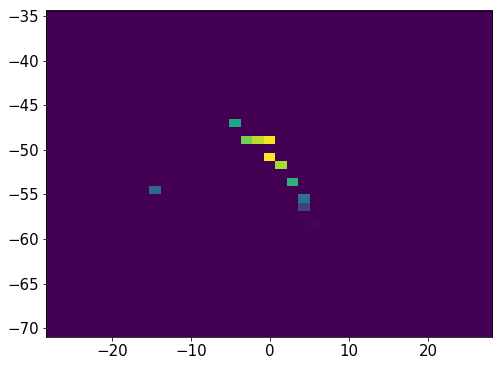

950390    26
950391    26
950392    26
950393    26
950394    26
950395    26
950396    26
950397    26
950398    26
950399    26
950400    26
950401    26
950402    26
950403    26
950404    26
950405    26
950406    26
950407    26
Name: Nsipm, dtype: uint16


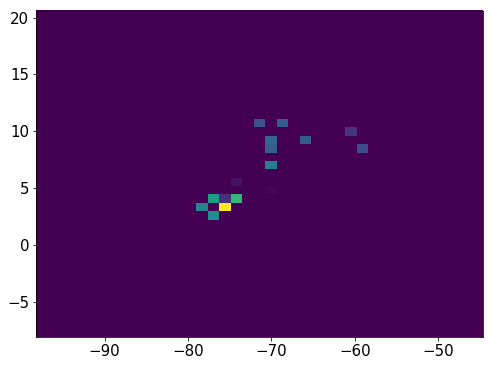

15334    30
15335    30
15336    30
15337    30
15338    30
15339    30
15340    30
15341    30
15342    30
15343    30
15344    30
15345    30
15346    30
15347    30
15348    30
Name: Nsipm, dtype: uint16


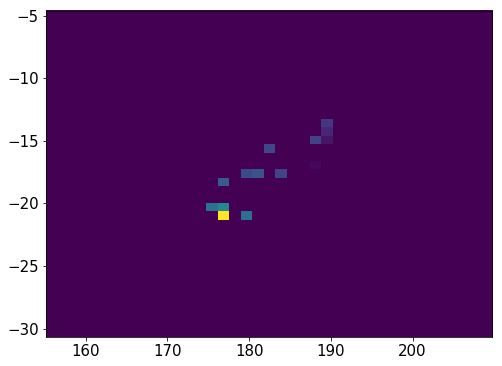

15353    28
15354    28
15355    28
15356    28
15357    28
15358    28
15359    28
15360    28
15361    28
15362    28
15363    28
15364    28
15365    28
15366    28
15367    28
15368    28
15369    28
15370    28
15371    28
15372    28
15373    28
15374    28
15375    28
15376    28
15377    28
15378    28
Name: Nsipm, dtype: uint16


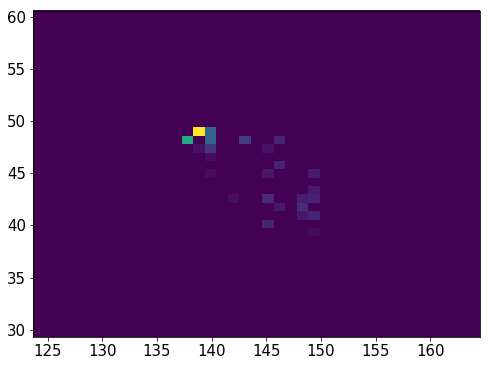

15381    25
15382    25
15383    25
15384    25
15385    25
15386    25
15387    25
15388    25
15389    25
15390    25
15391    25
15392    25
15393    25
15394    25
15395    25
15396    25
15397    25
15398    25
Name: Nsipm, dtype: uint16


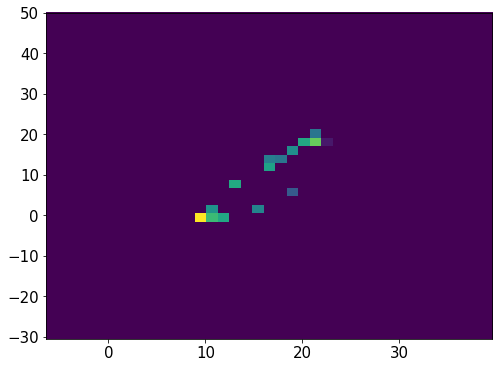

950449    16
950450    16
950451    16
950452    16
950453    16
950454    16
950455    16
950456    16
950457    16
950458    16
950459    16
950460    16
950461    16
950462    16
950463    16
950464    16
950465    16
950466    16
Name: Nsipm, dtype: uint16


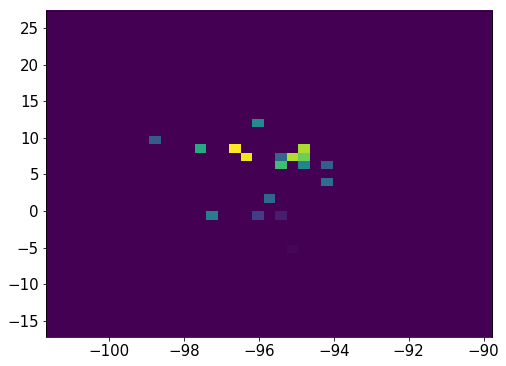

15404    37
15405    37
15406    37
15407    37
15408    37
15409    37
15410    37
15411    37
15412    37
15413    37
15414    37
15415    37
15416    37
15420     4
15421     4
15422     4
15423     4
15424     4
Name: Nsipm, dtype: uint16


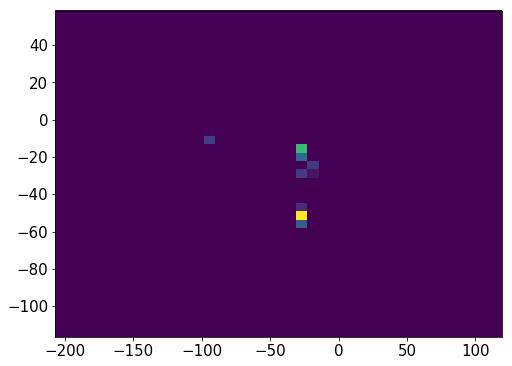

15429    22
15430    22
15431    22
15432    22
15433    22
15434    22
15435    22
15436    22
15437    22
15438    22
15439    22
15440    22
15441    22
15442    22
15443    22
15444    22
15445    22
Name: Nsipm, dtype: uint16


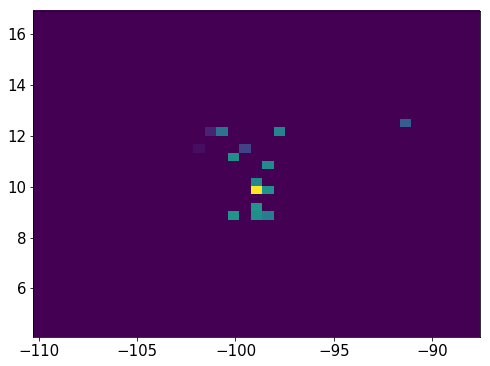

15450    23
15451    23
15452    23
15453    23
15454    23
15455    23
15456    23
15457    23
15458    23
15459    23
15460    23
15461    23
15462    23
15463    23
15464    23
15465    23
15466    23
15467    23
15468    23
15469    23
15470    23
15471    23
15472    23
15480    23
15481    23
15482    23
15483    23
Name: Nsipm, dtype: uint16


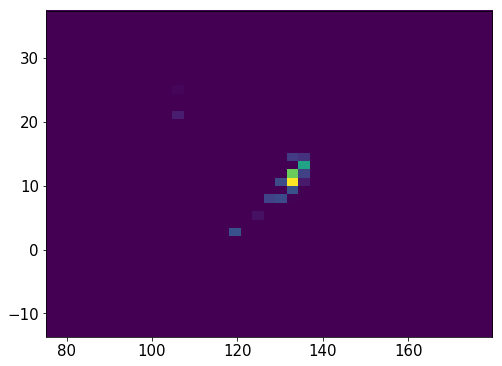

950470    26
950471    26
950472    26
950473    26
950474    26
950475    26
950476    26
950477    26
950478    26
950479    26
950480    26
950481    26
950482    26
950483    26
950484    26
950485    26
950486    26
Name: Nsipm, dtype: uint16


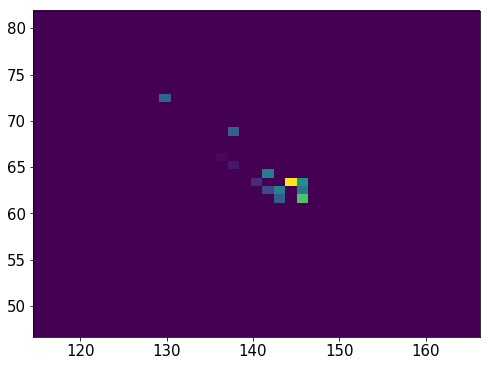

950493    20
950494    20
950495    20
950496    20
950497    20
950498    20
950499    20
950500    20
950501    20
950502    20
950503    20
950504    20
950505    20
950506    20
950507    20
950508    20
950509    20
950510    20
950511    20
950512    20
950513    20
950514    20
950515    20
950516    20
950517    20
Name: Nsipm, dtype: uint16


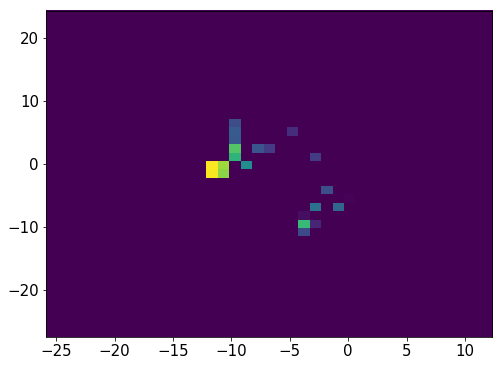

950521    26
950522    26
950523    26
950524    26
950525    26
950526    26
950527    26
950528    26
950529    26
950530    26
950531    26
950532    26
950533    26
950534    26
950535    26
Name: Nsipm, dtype: uint16


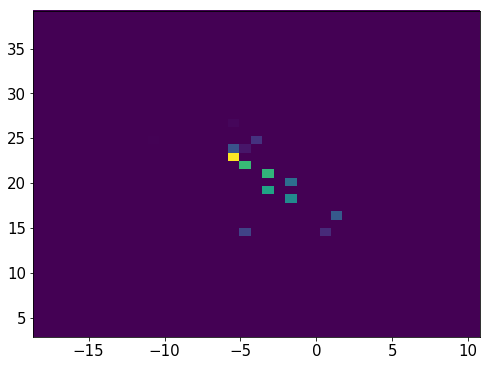

15485    45
15486    45
15487    45
15488    45
15489    45
15490    45
15491    45
15492    45
15493    45
15494    45
15495    45
15496    45
15497    45
15498    45
15499    45
15500    45
15501    45
Name: Nsipm, dtype: uint16


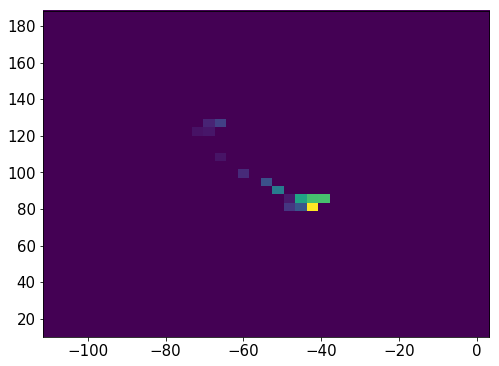

15504    26
15505    26
15506    26
15507    26
15508    26
15509    26
15510    26
15511    26
15512    26
15513    26
15514    26
15515    26
15517    26
15518    26
15519    26
15520    26
15521    26
15522    26
15523    26
15524    26
15525    26
15528    26
15530    26
15535    26
15537    26
15538    26
15539    26
15540    26
15541    26
15542    26
Name: Nsipm, dtype: uint16


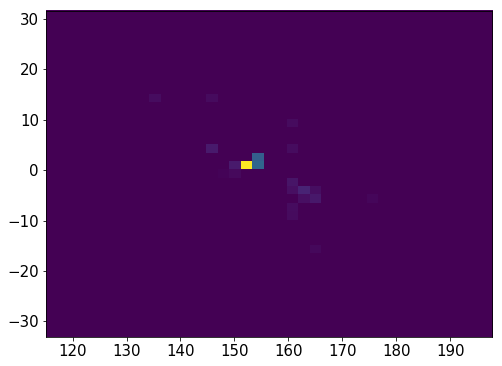

15550    30
15551    30
15552    30
15553    30
15554    30
15555    30
15556    30
15557    30
15558    30
15559    30
15560    30
15561    30
15562    30
15563    30
15564    30
15565    30
15566    30
15567    30
15568    30
15569    30
15570    30
15571    30
15572    30
15573    30
Name: Nsipm, dtype: uint16


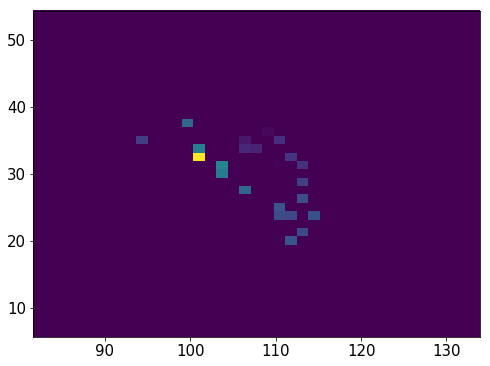

15578    21
15579    21
15580    21
15581    21
15582    21
15583    21
15584    21
15585    21
15589    14
15590    14
15591    14
15592    14
15593    14
15594    14
15595    14
15596    14
15597    14
15598    14
Name: Nsipm, dtype: uint16


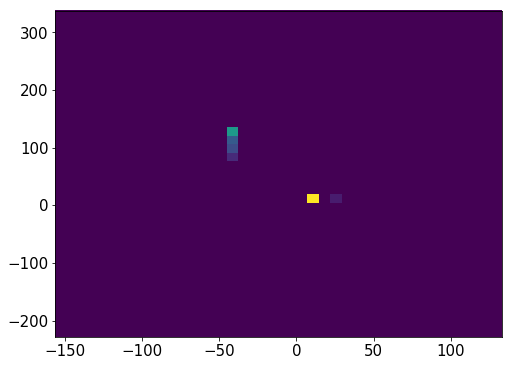

950591    27
950592    27
950593    27
950594    27
950595    27
950596    27
950597    27
950598    27
950599    27
950600    27
950601    27
950602    27
950603    27
950604    27
950605    27
950606    27
950607    27
950609    27
950610    27
950611    27
950618     1
950620     1
950621     1
950622     1
950623     1
950624     1
Name: Nsipm, dtype: uint16


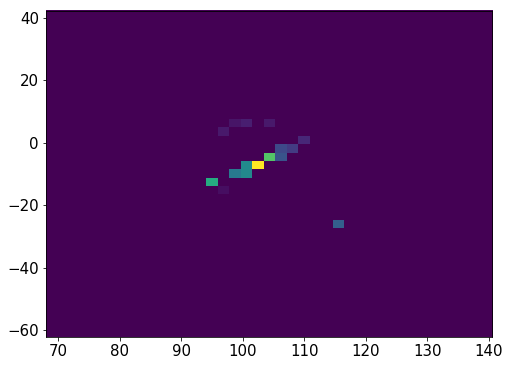

15603    30
15604    30
15605    30
15606    30
15607    30
15608    30
15609    30
15610    30
15611    30
15612    30
15613    30
15614    30
Name: Nsipm, dtype: uint16


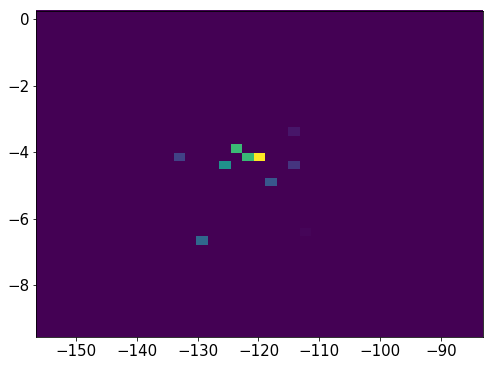

15620    29
15621    29
15622    29
15623    29
15624    29
15625    29
15626    29
15627    29
15628    29
15629    29
15630    29
15631    29
15632    29
15633    29
15634    29
15635    29
15636    29
Name: Nsipm, dtype: uint16


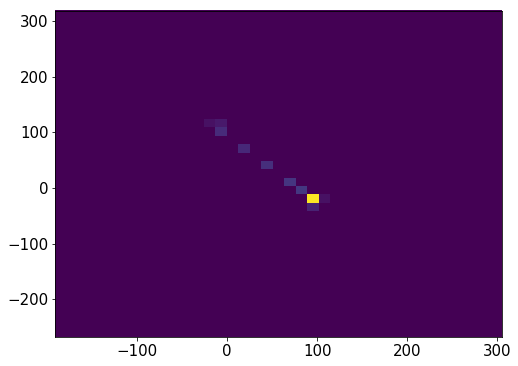

950647    23
950648    23
950649    23
950650    23
950651    23
950652    23
950653    23
950654    23
950655    23
950656    23
950657    23
950658    23
950659    23
950660    23
950661    23
950662    23
950663    23
950664    23
950665    23
950666    23
950667    23
950668    23
950669    23
Name: Nsipm, dtype: uint16


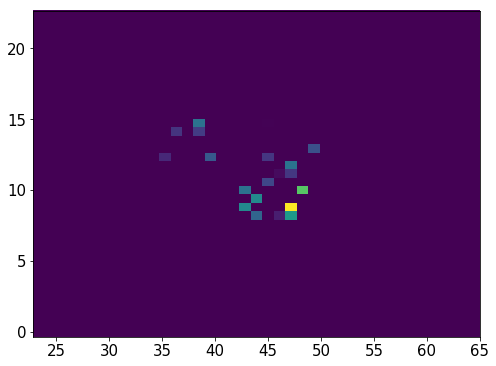

15660    23
15661    23
15662    23
15663    23
15664    23
15665    23
15666    23
15667    23
15668    23
15669    23
15670    23
15671    23
15672    23
15673    23
15674    23
15675    23
15676    23
15677    23
15678    23
15679    23
15680    23
Name: Nsipm, dtype: uint16


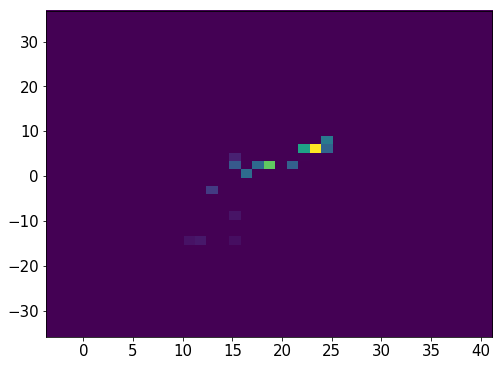

15686    22
15687    22
15688    22
15689    22
15690    22
15691    22
15692    22
15693    22
15694    22
15695    22
15696    22
15697    22
15698    22
Name: Nsipm, dtype: uint16


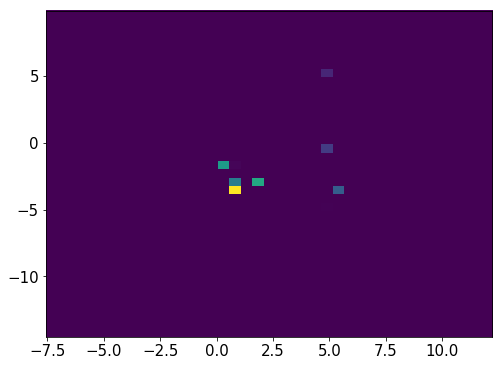

950674    28
950675    28
950676    28
950677    28
950678    28
950679    28
950680    28
950681    28
950682    28
950683    28
950684    28
950685    28
Name: Nsipm, dtype: uint16


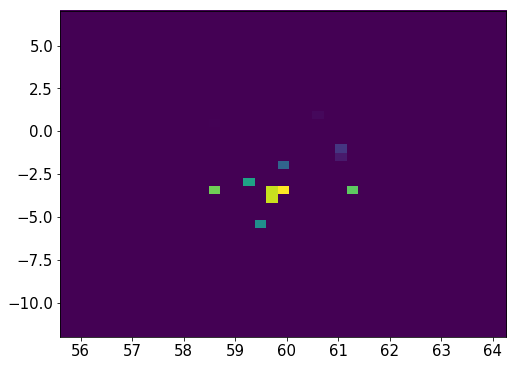

950691    26
950692    26
950693    26
950694    26
950695    26
950696    26
950697    26
950698    26
950699    26
Name: Nsipm, dtype: uint16


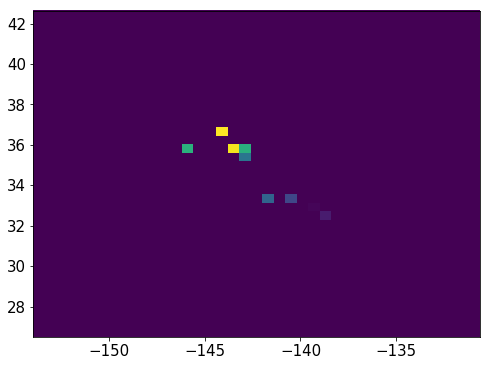

1901191    25
1901192    25
1901193    25
1901194    25
1901195    25
1901196    25
1901197    25
1901198    25
1901199    25
1901200    25
1901204     9
1901205     9
1901206     9
1901207     9
1901208     9
1901209     9
1901210     9
1901211     9
1901215     2
1901216     2
1901217     2
1901218     2
1901219     2
1901220     2
Name: Nsipm, dtype: uint16


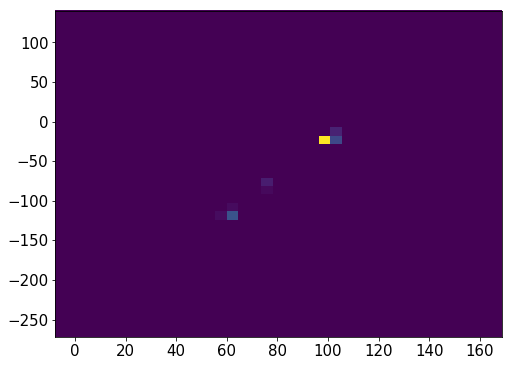

15704    30
15705    30
15706    30
15707    30
15708    30
15709    30
15710    30
15711    30
15712    30
15713    30
15714    30
15715    30
Name: Nsipm, dtype: uint16


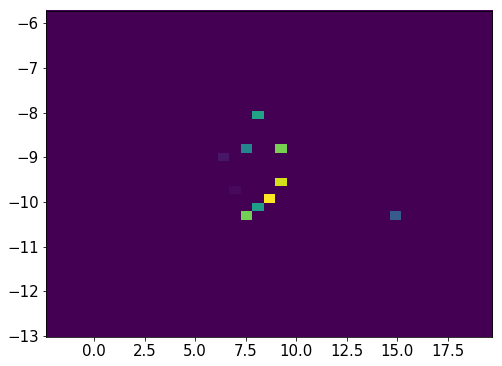

15720    26
15721    26
15722    26
15723    26
15724    26
15725    26
15726    26
15727    26
15728    26
15729    26
15730    26
15731    26
15732    26
15733    26
15734    26
15735    26
15736    26
15737    26
15738    26
15739    26
Name: Nsipm, dtype: uint16


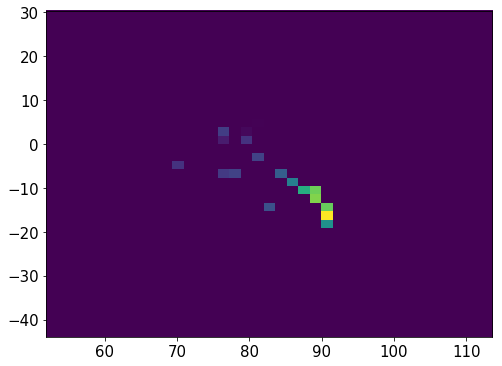

950704    20
950705    20
950706    20
950707    20
950708    20
950709    20
950710    20
950711    20
950712    20
950713    20
950714    20
950715    20
950716    20
950717    20
950718    20
Name: Nsipm, dtype: uint16


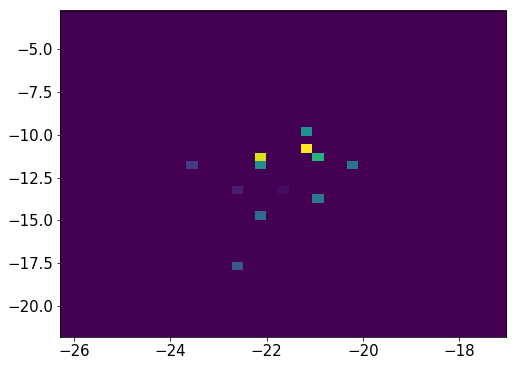

950724    27
950725    27
950726    27
950727    27
950728    27
950729    27
950730    27
950731    27
950732    27
950733    27
950734    27
950735    27
950736    27
950737    27
950738    27
950739    27
950740    27
950741    27
950742    27
950743    27
950744    27
950745    27
950746    27
950747    27
950748    27
Name: Nsipm, dtype: uint16


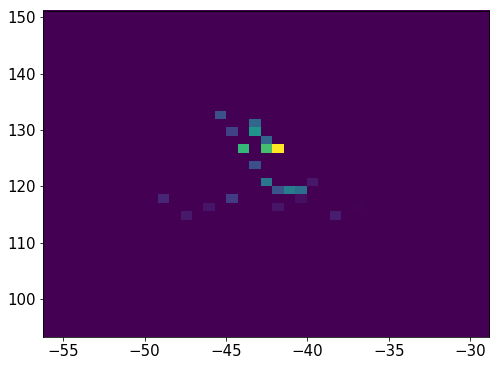

15745    34
15746    34
15747    34
15748    34
15749    34
15750    34
15751    34
15752    34
15753    34
15754    34
15755    34
15756    34
15757    34
15758    34
15759    34
Name: Nsipm, dtype: uint16


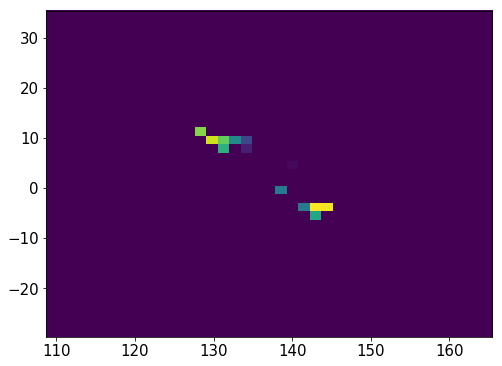

950765    30
950766    30
950767    30
950768    30
950769    30
950770    30
950771    30
950772    30
950773    30
950774    30
950775    30
Name: Nsipm, dtype: uint16


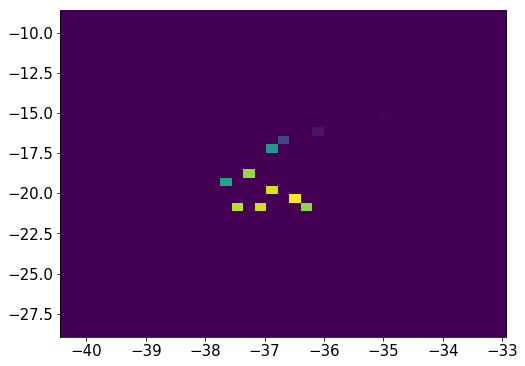

15764    31
15765    31
15766    31
15767    31
15768    31
15769    31
15770    31
15771    31
15772    31
15773    31
15774    31
15775    31
15776    31
15777    31
15778    31
15779    31
15784     2
15785     2
15786     2
15787     2
15788     2
Name: Nsipm, dtype: uint16


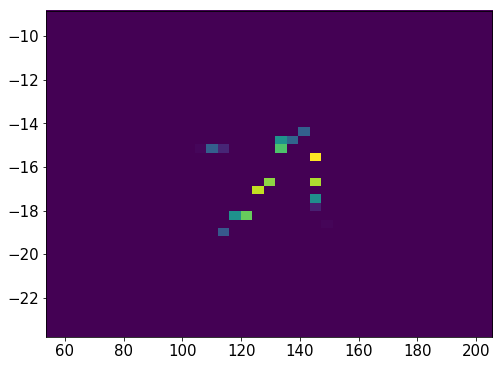

15792    22
15793    22
15794    22
15795    22
15796    22
15797    22
15798    22
15799    22
15800    22
15801    22
15802    22
15803    22
15804    22
15805    22
15806    22
15807    22
15808    22
15809    22
15810    22
15811    22
15812    22
15813    22
15814    22
15815    22
15816    22
15817    22
15818    22
15819    22
Name: Nsipm, dtype: uint16


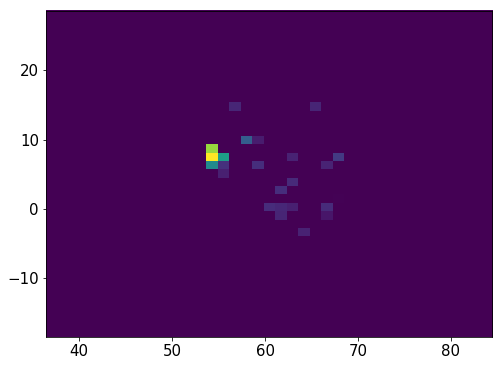

15829    25
15830    25
15831    25
15832    25
15833    25
15834    25
15835    25
15836    25
15837    25
15838    25
15839    25
15840    25
15841    25
Name: Nsipm, dtype: uint16


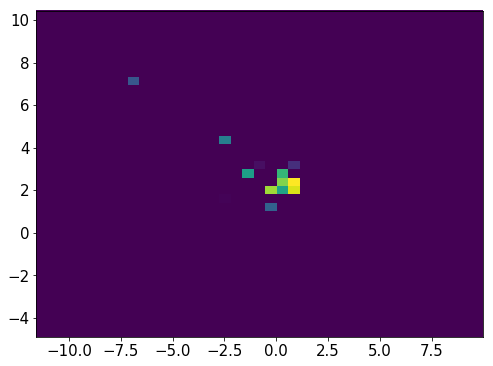

15847    30
15848    30
15849    30
15850    30
15851    30
15852    30
15853    30
15854    30
15855    30
15856    30
15857    30
Name: Nsipm, dtype: uint16


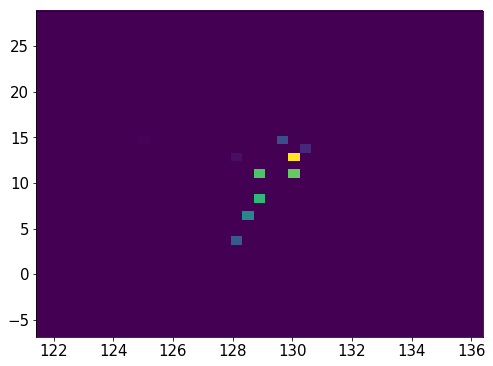

950781    28
950782    28
950783    28
950784    28
950785    28
950786    28
950787    28
950788    28
950789    28
950790    28
950791    28
950792    28
950793    28
950794    28
950795    28
950796    28
950797    28
950798    28
950799    28
950800    28
Name: Nsipm, dtype: uint16


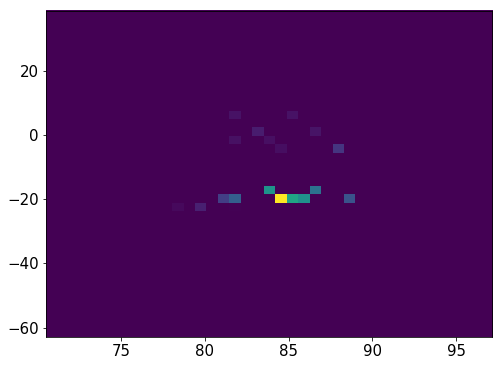

15862    39
15863    39
15864    39
15865    39
15866    39
15867    39
15868    39
15869    39
15870    39
15871    39
15872    39
15873    39
15874    39
15875    39
15876    39
15877    39
15878    39
Name: Nsipm, dtype: uint16


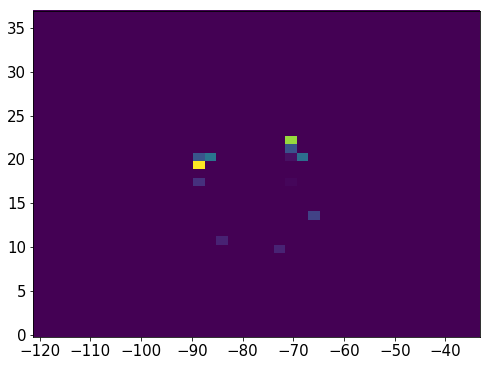

950805    22
950806    22
950807    22
950808    22
950809    22
950810    22
950811    22
950812    22
950813    22
950814    22
950815    22
950816    22
950817    22
950818    22
950819    22
950820    22
950821    22
Name: Nsipm, dtype: uint16


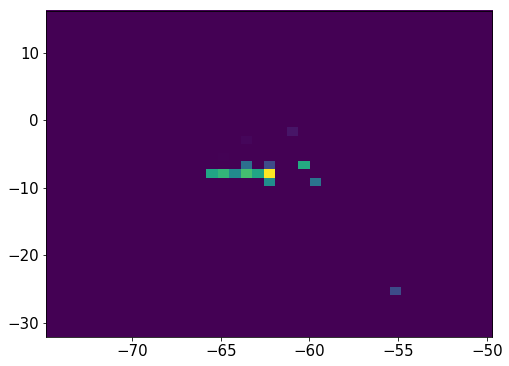

495114    28
495115    28
495116    28
495117    28
495118    28
495119    28
495120    28
495121    28
495122    28
495123    28
495124    28
495125    28
495126    28
495127    28
495128    28
Name: Nsipm, dtype: uint16


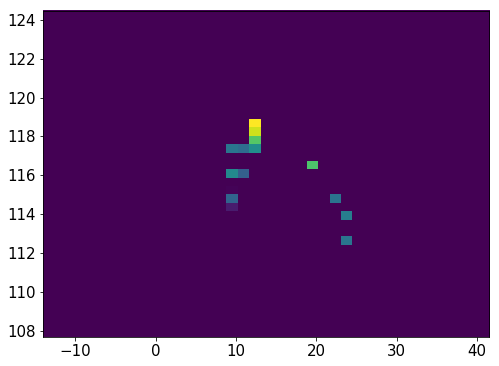

15883    23
15884    23
15885    23
15886    23
15887    23
15888    23
15889    23
15890    23
15891    23
15892    23
15893    23
15894    23
15895    23
15896    23
15897    23
15898    23
15899    23
15900    23
15901    23
15902    23
15903    23
15904    23
15905    23
15906    23
15907    23
15908    23
15909    23
15910    23
15911    23
15912    23
Name: Nsipm, dtype: uint16


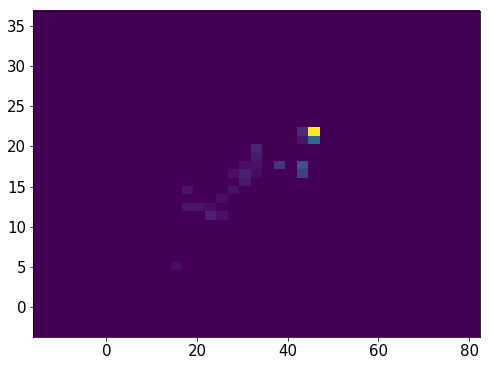

15917    39
15918    39
15919    39
15920    39
15921    39
15922    39
15923    39
15924    39
15925    39
15926    39
15927    39
15928    39
15929    39
15930    39
15931    39
15932    39
15933    39
Name: Nsipm, dtype: uint16


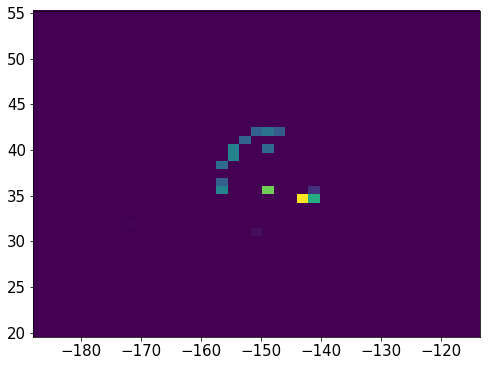

950825    29
950826    29
950827    29
950828    29
950829    29
950830    29
950831    29
950832    29
950833    29
950834    29
950835    29
950836    29
950837    29
950838    29
950839    29
950840    29
950844    11
950845    11
950846    11
950847    11
950848    11
950849    11
950850    11
950851    11
950852    11
950853    11
950854    11
Name: Nsipm, dtype: uint16


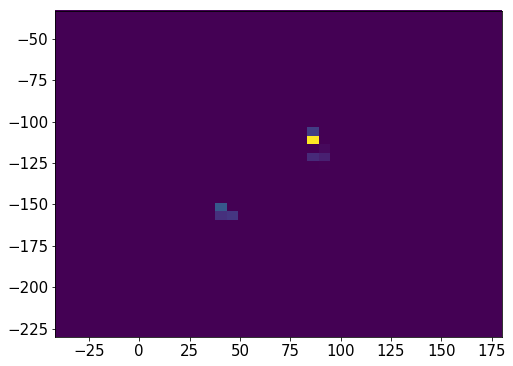

950858    28
950859    28
950860    28
950861    28
950862    28
950863    28
950864    28
950865    28
950866    28
950867    28
950868    28
950869    28
950870    28
950871    28
950872    28
950873    28
950874    28
950875    28
950876    28
950877    28
950878    28
950879    28
950880    28
950881    28
Name: Nsipm, dtype: uint16


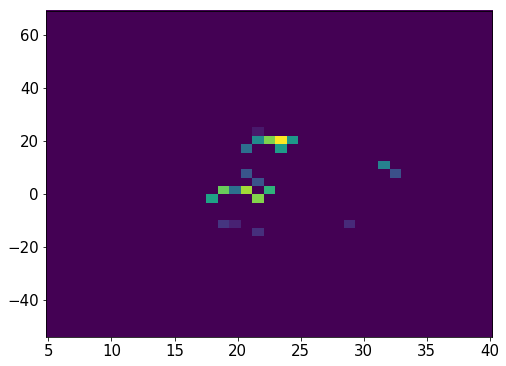

950886    21
950887    21
950888    21
950889    21
950890    21
950891    21
950892    21
950893    21
950894    21
950895    21
950896    21
950897    21
950898    21
950899    21
950900    21
950901    21
950902    21
950903    21
950904    21
950905    21
950906    21
950907    21
950908    21
950909    21
950910    21
950911    21
950912    21
950913    21
950914    21
950915    21
950916    21
950917    21
950918    21
950919    21
950920    21
950921    21
950922    21
950923    21
950924    21
950925    21
950926    21
950927    21
950928    21
950929    21
950930    21
Name: Nsipm, dtype: uint16


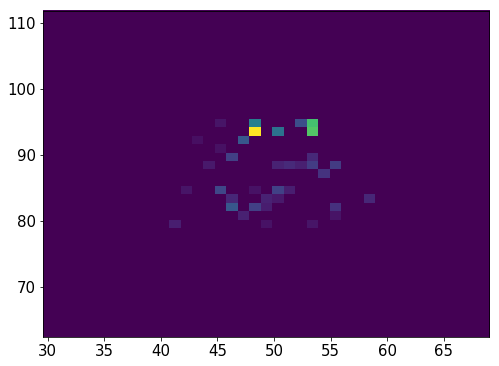

15937    30
15938    30
15939    30
15940    30
15941    30
15942    30
15943    30
15944    30
15945    30
15946    30
15947    30
15948    30
15949    30
15950    30
15951    30
15952    30
15953    30
15954    30
15955    30
15956    30
15957    30
15958    30
15959    30
15960    30
15961    30
Name: Nsipm, dtype: uint16


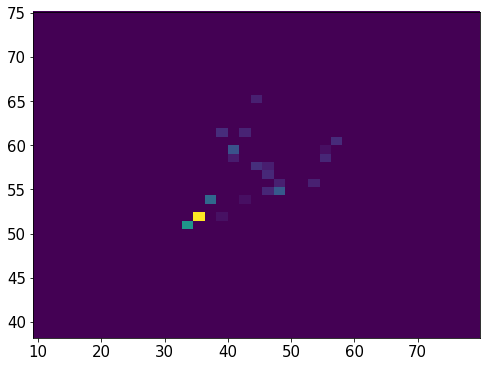

950956    30
950957    30
950958    30
950959    30
950960    30
950961    30
950962    30
950963    30
950964    30
950965    30
950966    30
950967    30
950968    30
950969    30
950970    30
Name: Nsipm, dtype: uint16


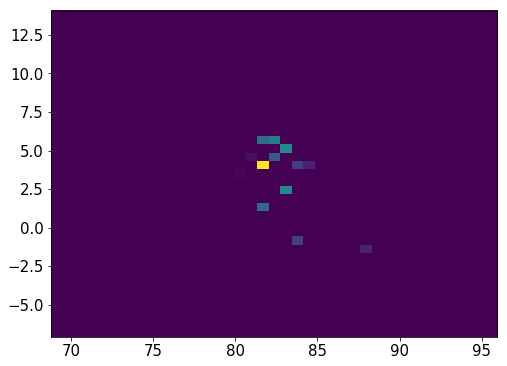

15965    22
15966    22
15967    22
15968    22
15969    22
15970    22
15971    22
15972    22
15973    22
15974    22
15975    22
15976    22
15977    22
15978    22
15979    22
Name: Nsipm, dtype: uint16


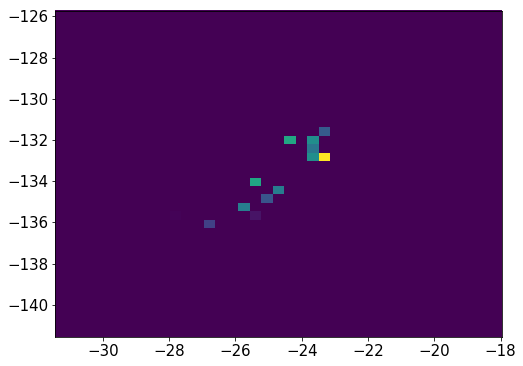

15983    25
15984    25
15985    25
15986    25
15987    25
15988    25
15989    25
15990    25
15991    25
15992    25
15993    25
15994    25
15995    25
15996    25
15997    25
15998    25
15999    25
16000    25
16001    25
16002    25
16003    25
16004    25
16005    25
16006    25
Name: Nsipm, dtype: uint16


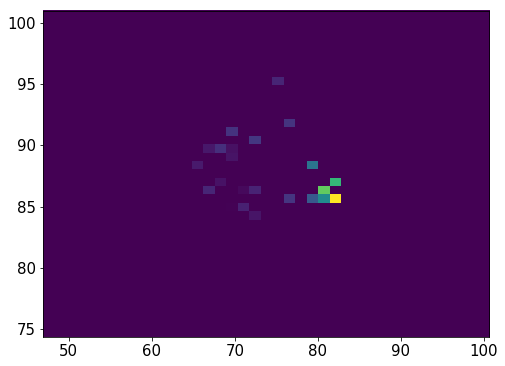

16011    22
16012    22
16013    22
16014    22
16015    22
16016    22
16017    22
16018    22
16019    22
16020    22
16021    22
16022    22
16023    22
16024    22
16025    22
Name: Nsipm, dtype: uint16


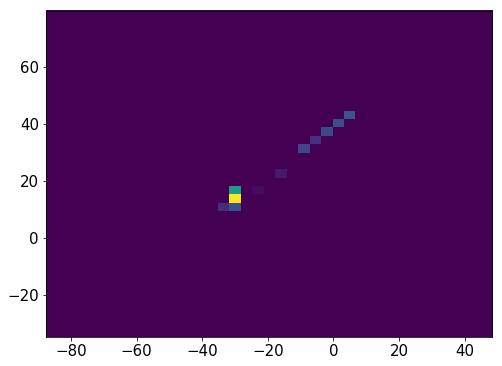

16030    29
16031    29
16032    29
16033    29
16034    29
16035    29
16036    29
16037    29
16038    29
16039    29
16040    29
Name: Nsipm, dtype: uint16


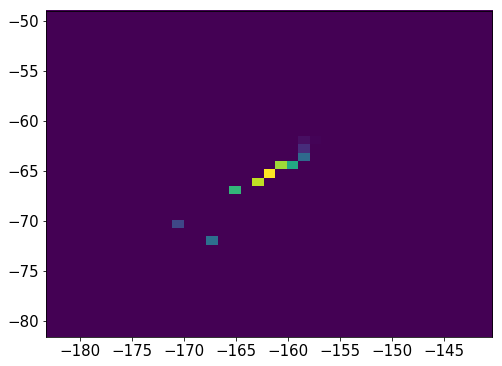

951001    21
951002    21
951003    21
951004    21
951005    21
951006    21
951007    21
951008    21
951009    21
951010    21
951011    21
951012    21
951013    21
951014    21
951015    21
951016    21
951017    21
951018    21
951019    21
951024     1
951025     1
951026     1
951027     1
951028     1
Name: Nsipm, dtype: uint16


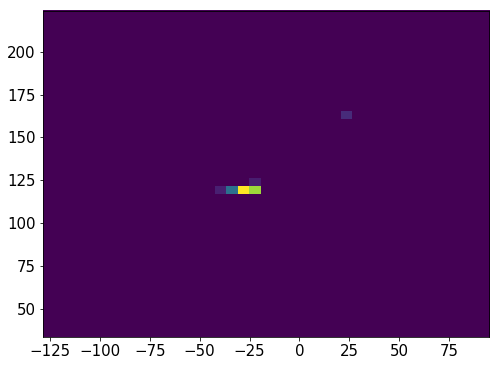

16045    30
16046    30
16047    30
16048    30
16049    30
16050    30
16051    30
16052    30
16053    30
16054    30
16055    30
16056    30
16057    30
16058    30
16059    30
16060    30
16061    30
16062    30
16063    30
16064    30
16065    30
16066    30
Name: Nsipm, dtype: uint16


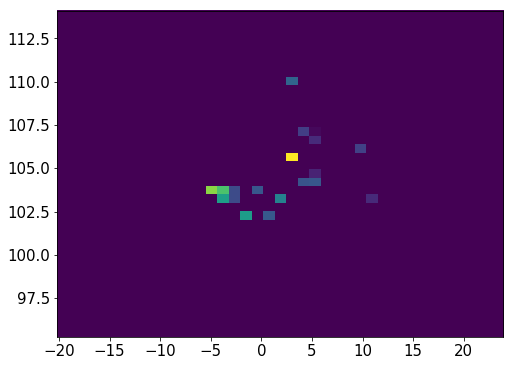

16070    26
16071    26
16072    26
16073    26
16074    26
16075    26
16076    26
16077    26
16078    26
16079    26
16080    26
16081    26
Name: Nsipm, dtype: uint16


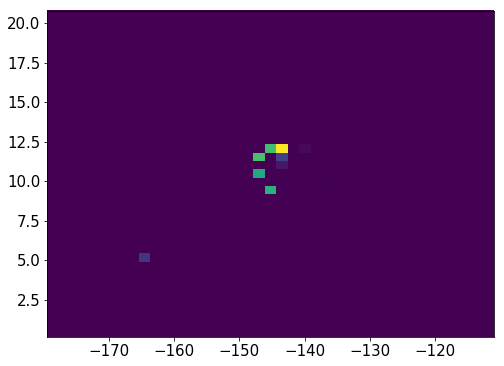

16086    59
16087    59
16088    59
16089    59
16090    59
16091    59
16092    59
16093    59
16094    59
16095    59
16096    59
16097    59
16098    59
16099    59
16100    59
16101    59
16102    59
16103    59
Name: Nsipm, dtype: uint16


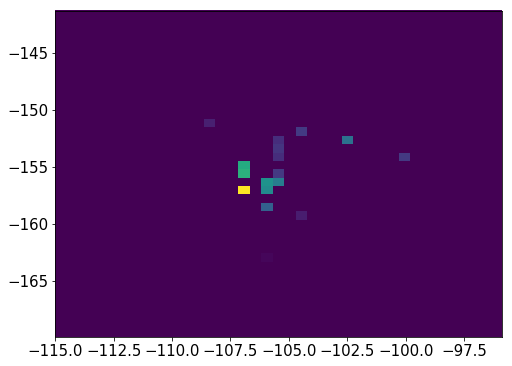

16107    33
16108    33
16109    33
16110    33
16111    33
16112    33
16113    33
16114    33
16115    33
16116    33
16117    33
16118    33
16119    33
16120    33
16121    33
16122    33
16123    33
16124    33
Name: Nsipm, dtype: uint16


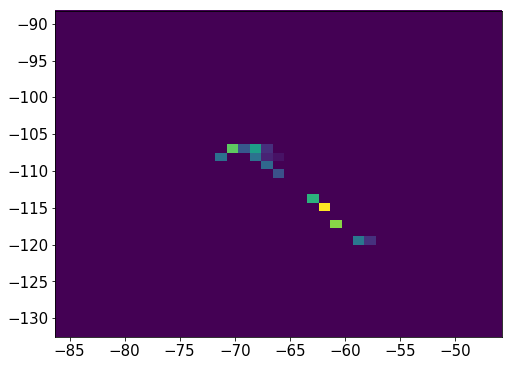

936043    24
936044    24
936045    24
936046    24
936047    24
936048    24
936049    24
936050    24
936051    24
936052    24
936053    24
936054    24
936055    24
936056    24
936057    24
936058    24
936059    24
936060    24
936061    24
936062    24
936063    24
936064    24
936065    24
936066    24
936067    24
936068    24
936069    24
936070    24
Name: Nsipm, dtype: uint16


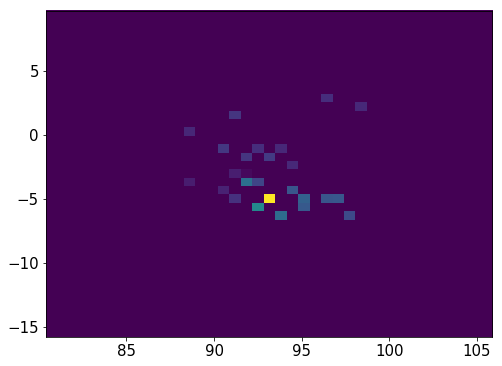

951034    23
951035    23
951036    23
951037    23
951038    23
951039    23
951040    23
951041    23
951042    23
951043    23
951044    23
951045    23
951046    23
951052     2
951053     2
951054     2
951055     2
951056     2
Name: Nsipm, dtype: uint16


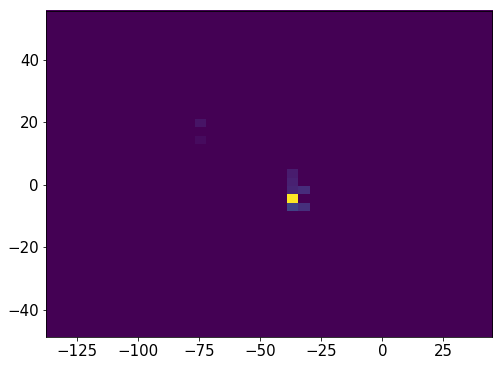

951061    44
951062    44
951063    44
951064    44
951065    44
951066    44
951067    44
951068    44
951069    44
951070    44
951071    44
951072    44
Name: Nsipm, dtype: uint16


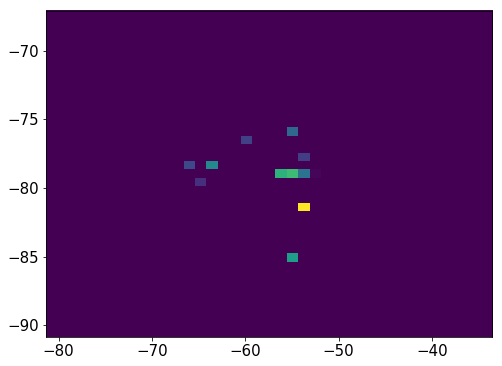

16127    29
16128    29
16129    29
16130    29
16131    29
16132    29
16133    29
16134    29
16135    29
16136    29
16137    29
16138    29
16139    29
16140    29
16141    29
16142    29
16143    29
16144    29
16145    29
16150    13
16151    13
16152    13
16153    13
16154    13
16155    13
16156    13
16157    13
Name: Nsipm, dtype: uint16


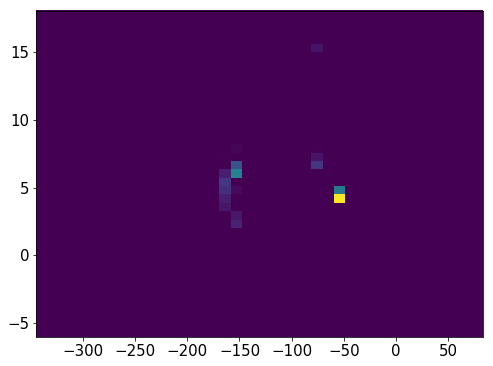

16161    25
16162    25
16163    25
16164    25
16165    25
16166    25
16167    25
16168    25
16169    25
16170    25
16171    25
16172    25
16173    25
16174    25
16175    25
16176    25
16177    25
16178    25
16179    25
16180    25
16181    25
16182    25
16183    25
Name: Nsipm, dtype: uint16


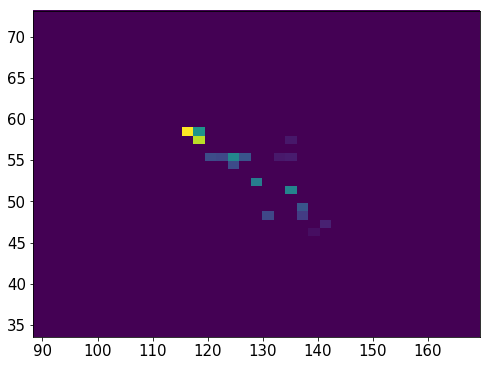

951076    26
951077    26
951078    26
951079    26
951080    26
951081    26
951082    26
951083    26
951084    26
951085    26
951086    26
951087    26
951088    26
951089    26
951090    26
951091    26
951092    26
Name: Nsipm, dtype: uint16


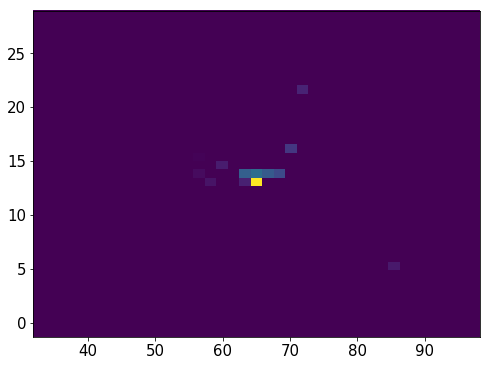

936077    31
936078    31
936079    31
936080    31
936081    31
936082    31
936083    31
936084    31
936085    31
936086    31
936087    31
936088    31
936089    31
936090    31
936091    31
936092    31
936093    31
936094    31
936095    31
936096    31
936097    31
936098    31
936099    31
936100    31
936101    31
936107    31
936108    31
936109    31
936110    31
Name: Nsipm, dtype: uint16


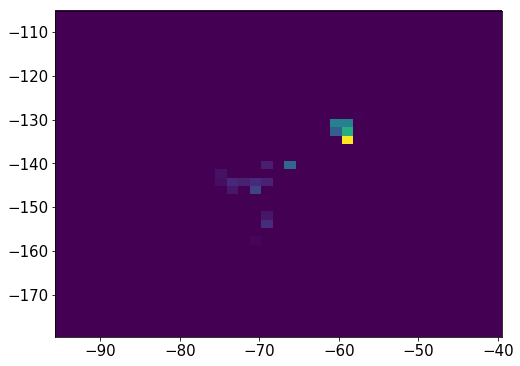

16189    27
16190    27
16191    27
16192    27
16193    27
16194    27
16195    27
16196    27
16197    27
16198    27
16199    27
16200    27
16201    27
16202    27
16203    27
16204    27
16205    27
16206    27
16207    27
16208    27
16209    27
16210    27
16211    27
16212    27
16213    27
16214    27
Name: Nsipm, dtype: uint16


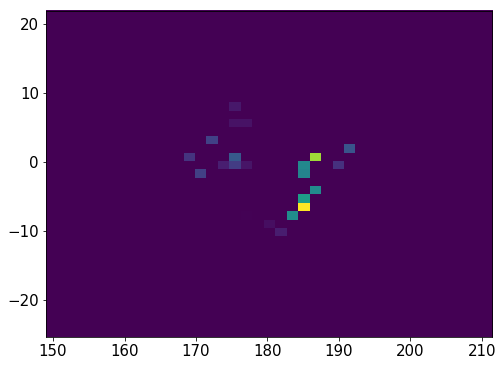

16221    23
16222    23
16223    23
16224    23
16225    23
16226    23
16227    23
16228    23
16229    23
16230    23
16231    23
16232    23
16233    23
16234    23
16235    23
16236    23
16237    23
16238    23
16239    23
Name: Nsipm, dtype: uint16


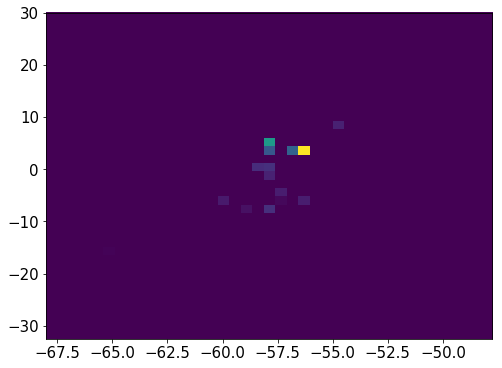

951124    22
951125    22
951126    22
951127    22
951128    22
951129    22
951130    22
951131    22
951132    22
951133    22
951134    22
951135    22
951136    22
951137    22
951138    22
951139    22
951140    22
951141    22
951142    22
951143    22
951144    22
951145    22
951146    22
951147    22
951148    22
951149    22
Name: Nsipm, dtype: uint16


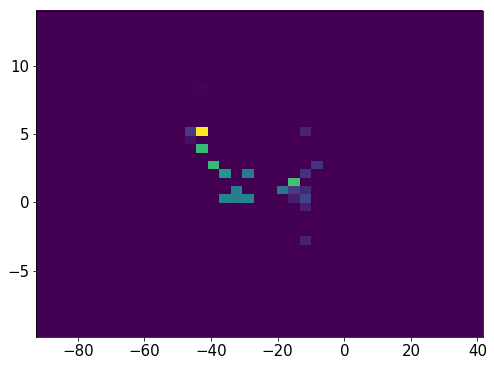

951154    28
951155    28
951156    28
951157    28
951158    28
951159    28
951160    28
951161    28
951162    28
951163    28
951164    28
951165    28
951166    28
951167    28
951168    28
951169    28
951173    28
951174    28
951175    28
951176    28
951177    28
951178    28
951179    28
Name: Nsipm, dtype: uint16


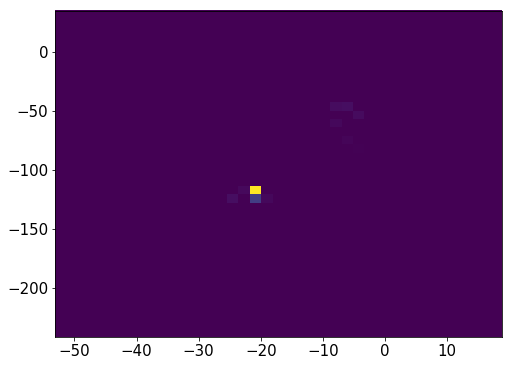

16244    35
16245    35
16246    35
16247    35
16248    35
16249    35
16250    35
16251    35
16252    35
16253    35
16254    35
16255    35
16256    35
16257    35
16258    35
16259    35
16260    35
16261    35
16262    35
16263    35
16264    35
16265    35
16266    35
Name: Nsipm, dtype: uint16


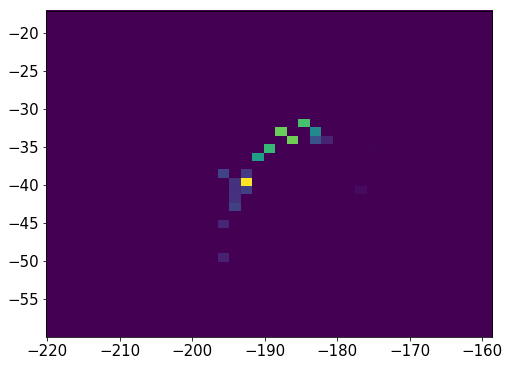

16272    31
16273    31
16274    31
16275    31
16276    31
16277    31
16278    31
16279    31
16280    31
16281    31
16282    31
Name: Nsipm, dtype: uint16


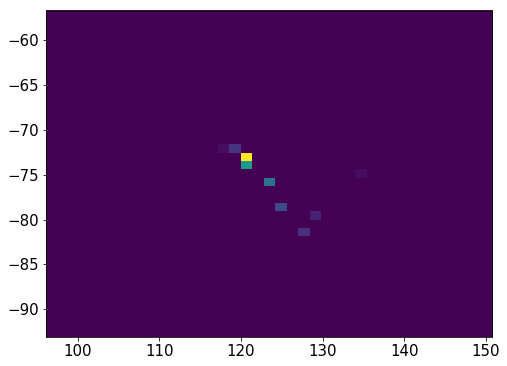

951215    25
951216    25
951217    25
951218    25
951219    25
951220    25
951221    25
951222    25
951223    25
951224    25
951225    25
951226    25
951232     2
951235     2
951236     2
951237     2
951238     2
951239     2
951240     2
Name: Nsipm, dtype: uint16


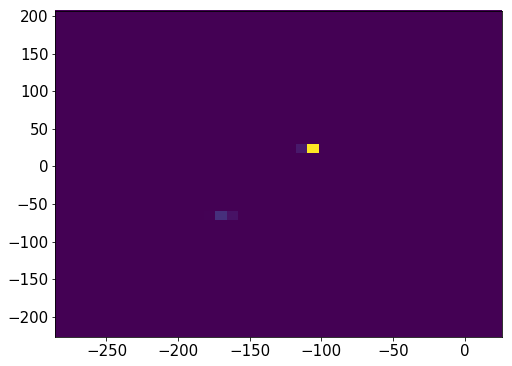

16285    31
16286    31
16287    31
16288    31
16289    31
16290    31
16291    31
16292    31
16293    31
Name: Nsipm, dtype: uint16


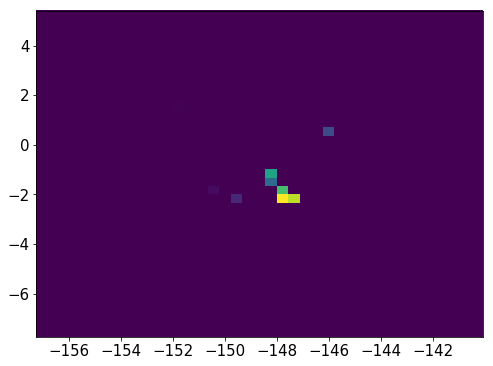

16297    29
16298    29
16301    29
16302    29
16303    29
16304    29
16305    29
16306    29
16307    29
16308    29
16309    29
16310    29
16311    29
16312    29
16313    29
16314    29
16315    29
16316    29
16317    29
16318    29
16319    29
16320    29
16321    29
16322    29
16323    29
16324    29
16325    29
16326    29
Name: Nsipm, dtype: uint16


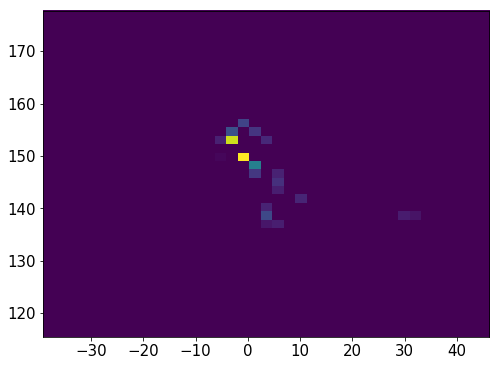

16329    28
16330    28
16331    28
16332    28
16333    28
16334    28
16335    28
16336    28
16337    28
16338    28
16339    28
16340    28
16341    28
16342    28
Name: Nsipm, dtype: uint16


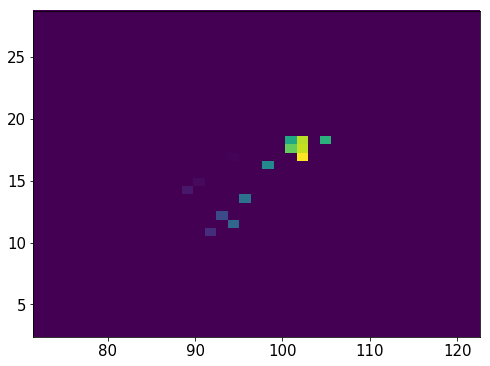

16348    27
16349    27
16350    27
16351    27
16352    27
16353    27
16355    27
16356    27
16357    27
16358    27
16359    27
16360    27
16361    27
16362    27
16363    27
16364    27
16365    27
16366    27
16367    27
16368    27
16369    27
Name: Nsipm, dtype: uint16


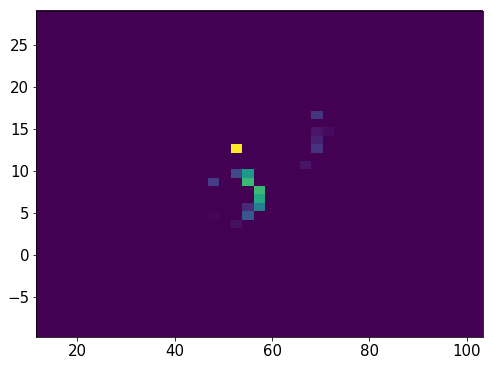

16370    26
16371    26
16372    26
16373    26
16374    26
16375    26
16376    26
16377    26
16378    26
16379    26
16380    26
16381    26
16382    26
16383    26
16384    26
16385    26
16386    26
Name: Nsipm, dtype: uint16


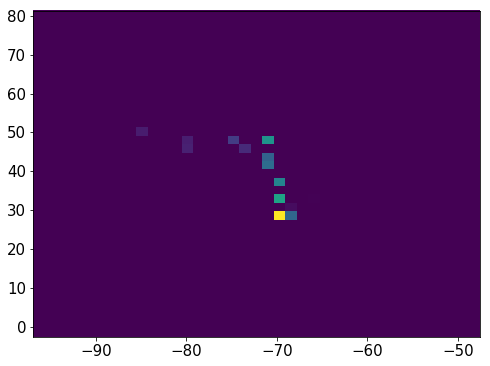

951260    27
951261    27
951262    27
951263    27
951264    27
951265    27
951266    27
951267    27
951268    27
951269    27
951270    27
951271    27
951272    27
951273    27
Name: Nsipm, dtype: uint16


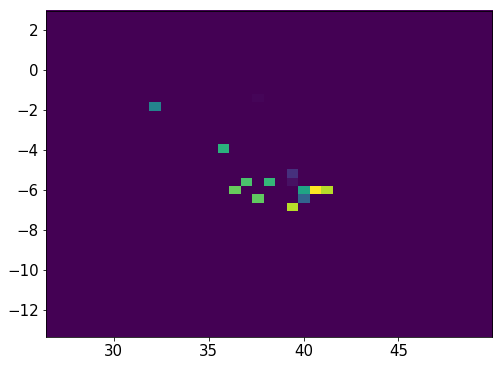

951279    27
951280    27
951281    27
951282    27
951283    27
951284    27
951285    27
951286    27
951287    27
951288    27
951289    27
951290    27
951291    27
951292    27
951293    27
951294    27
951295    27
Name: Nsipm, dtype: uint16


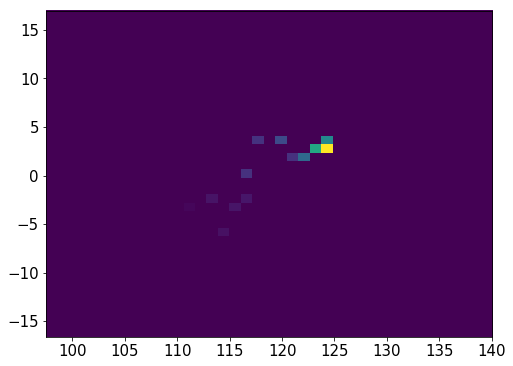

951300    25
951301    25
951302    25
951303    25
951304    25
951305    25
951306    25
951307    25
951308    25
951309    25
951310    25
951311    25
951312    25
951313    25
951314    25
951315    25
951316    25
951317    25
951318    25
951319    25
951320    25
951321    25
951322    25
951323    25
951324    25
951325    25
951326    25
951327    25
Name: Nsipm, dtype: uint16


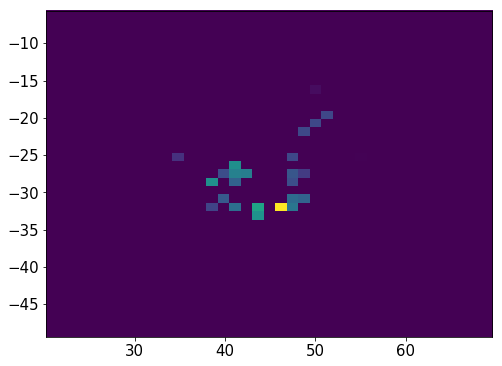

951332    31
951333    31
951334    31
951335    31
951336    31
951337    31
951338    31
951339    31
951340    31
951341    31
951342    31
951343    31
951344    31
951345    31
951346    31
951347    31
951348    31
951349    31
Name: Nsipm, dtype: uint16


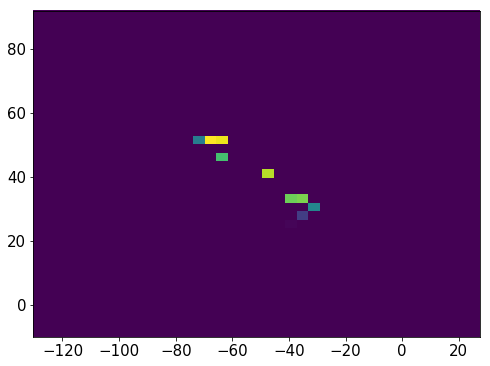

951355    23
951356    23
951357    23
951358    23
951359    23
951360    23
951361    23
951362    23
951363    23
951364    23
951365    23
951366    23
951367    23
951368    23
951371    23
951373    23
951374    23
951375    23
951376    23
951377    23
951379    23
951380    23
951384    23
951385    23
951386    23
951387    23
951388    23
951389    23
951390    23
951398     1
951399     1
951400     1
Name: Nsipm, dtype: uint16


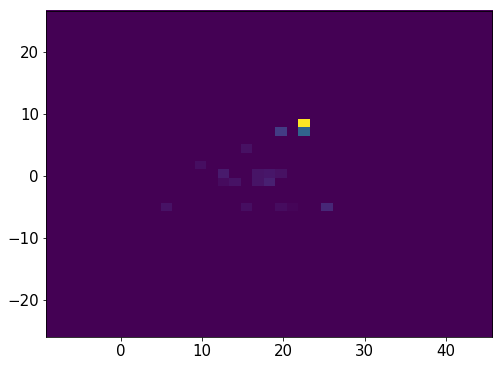

16391    27
16392    27
16393    27
16394    27
16395    27
16396    27
16397    27
16398    27
16399    27
16400    27
16401    27
16402    27
16403    27
16404    27
16405    27
16406    27
16407    27
16408    27
16409    27
16410    27
16411    27
16412    27
16413    27
16414    27
16415    27
16416    27
16417    27
16418    27
Name: Nsipm, dtype: uint16


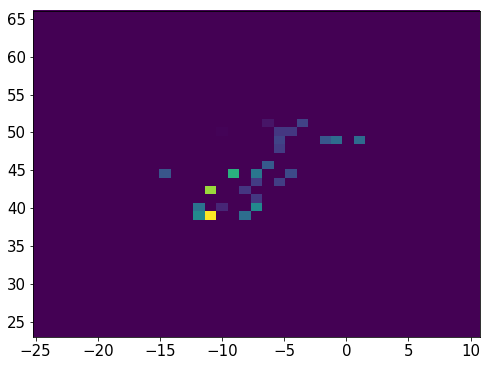

951424    30
951425    30
951426    30
951427    30
951428    30
951429    30
951430    30
951431    30
951432    30
951433    30
951434    30
951435    30
951436    30
951437    30
951438    30
951439    30
951440    30
951441    30
951442    30
951443    30
951444    30
951445    30
951446    30
951447    30
951448    30
Name: Nsipm, dtype: uint16


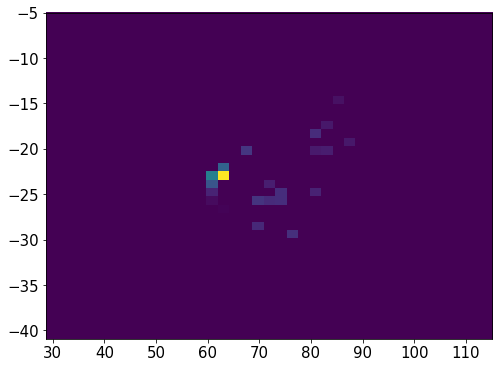

16422    32
16423    32
16424    32
16425    32
16426    32
16427    32
16428    32
16429    32
16430    32
16431    32
16432    32
16433    32
16434    32
16435    32
16436    32
16437    32
Name: Nsipm, dtype: uint16


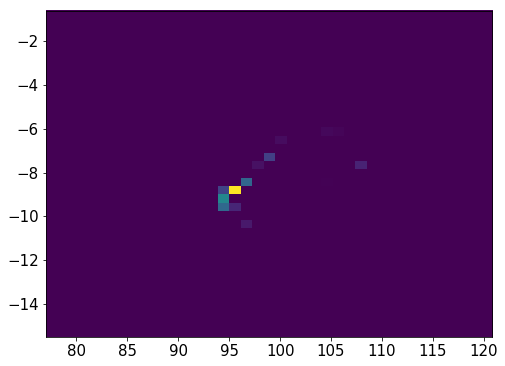

951501    20
951502    20
951503    20
951504    20
951505    20
951506    20
951507    20
951508    20
951509    20
951510    20
951511    20
951512    20
951513    20
951514    20
951515    20
951516    20
951517    20
951518    20
951519    20
951520    20
951521    20
951522    20
Name: Nsipm, dtype: uint16


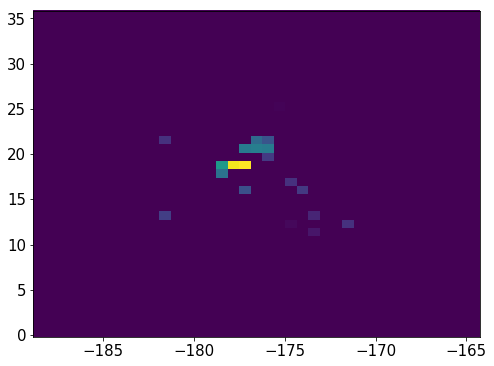

16442    21
16443    21
16444    21
16445    21
16446    21
16447    21
16448    21
16449    21
16450    21
16451    21
16452    21
16453    21
16454    21
16455    21
16456    21
16457    21
16458    21
Name: Nsipm, dtype: uint16


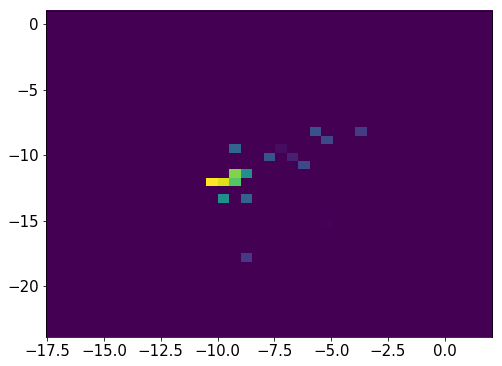

951529    38
951530    38
951531    38
951532    38
951533    38
951534    38
951535    38
951536    38
951537    38
951538    38
951539    38
951540    38
951541    38
951542    38
Name: Nsipm, dtype: uint16


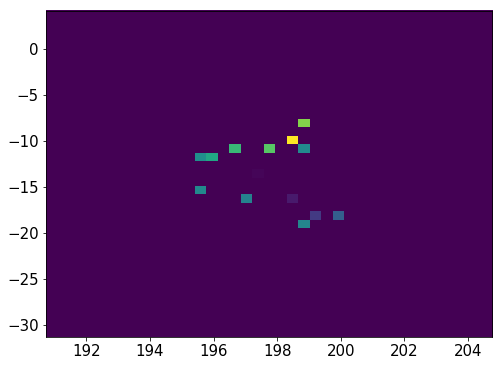

16462    20
16463    20
16464    20
16465    20
16466    20
16467    20
16468    20
16469    20
16470    20
16471    20
16472    20
16473    20
16474    20
16475    20
Name: Nsipm, dtype: uint16


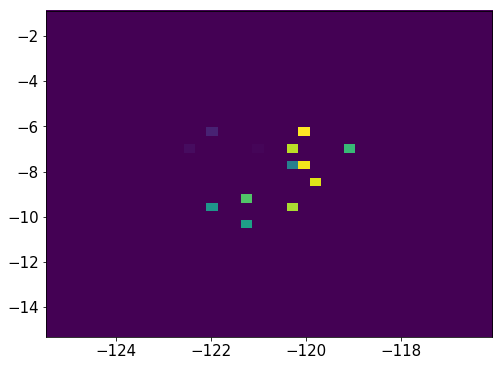

951549    44
951550    44
951551    44
951552    44
951553    44
951554    44
951555    44
951556    44
951557    44
951558    44
951559    44
951560    44
951561    44
951562    44
Name: Nsipm, dtype: uint16


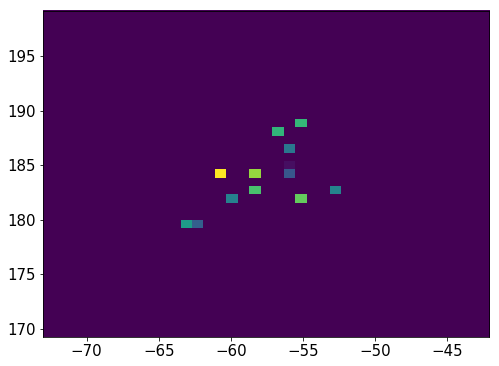

16481    21
16482    21
16483    21
16484    21
16485    21
16486    21
16487    21
16488    21
16489    21
16490    21
16491    21
16492    21
16493    21
16494    21
16495    21
16496    21
16497    21
16498    21
16499    21
16500    21
16501    21
16502    21
16503    21
Name: Nsipm, dtype: uint16


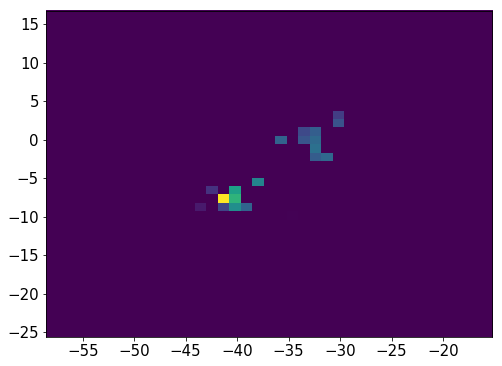

16508    18
16509    18
16510    18
16511    18
16512    18
16513    18
16514    18
16515    18
16516    18
16517    18
16518    18
16519    18
16523     7
16524     7
16525     7
16526     7
16527     7
16528     7
16529     7
16534     7
16535     7
16536     7
16537     7
16538     7
16539     7
16540     7
Name: Nsipm, dtype: uint16


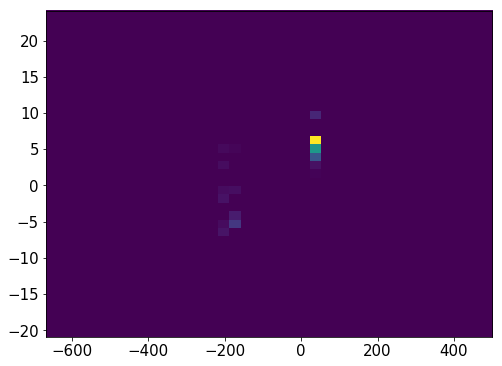

16544    24
16545    24
16546    24
16547    24
16548    24
16549    24
16550    24
16551    24
16552    24
16553    24
16554    24
16555    24
16556    24
16557    24
16558    24
16559    24
16561    24
16562    24
Name: Nsipm, dtype: uint16


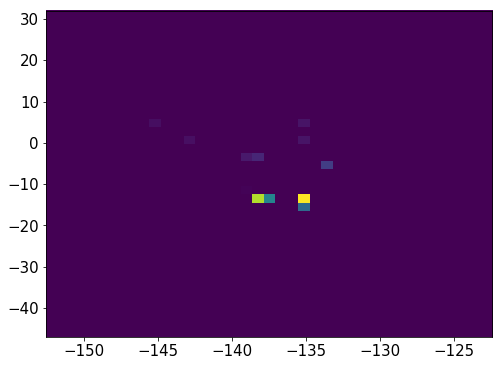

16566    25
16567    25
16568    25
16569    25
16570    25
16571    25
16572    25
16573    25
16574    25
16575    25
16576    25
16577    25
16578    25
16579    25
16580    25
16581    25
16582    25
16583    25
16584    25
16585    25
16586    25
16587    25
Name: Nsipm, dtype: uint16


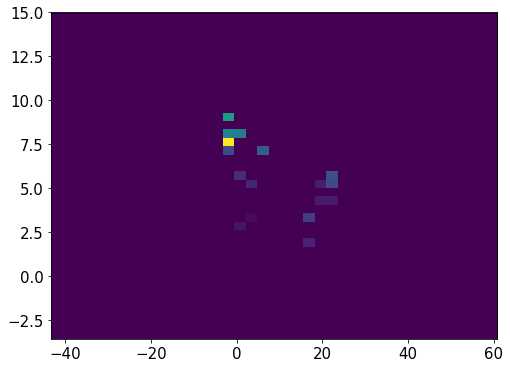

951566    30
951567    30
951568    30
951569    30
951570    30
951571    30
951572    30
951573    30
951574    30
951575    30
951576    30
951577    30
951578    30
951579    30
951580    30
951581    30
951582    30
951583    30
951584    30
Name: Nsipm, dtype: uint16


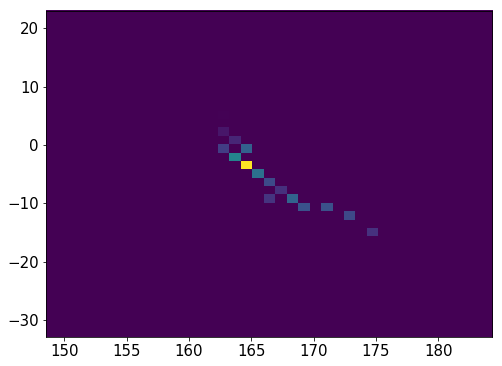

1901262    25
1901263    25
1901264    25
1901265    25
1901266    25
1901267    25
1901268    25
1901269    25
1901270    25
1901271    25
1901272    25
1901273    25
1901274    25
1901275    25
1901276    25
1901277    25
1901278    25
1901279    25
1901280    25
1901281    25
1901282    25
Name: Nsipm, dtype: uint16


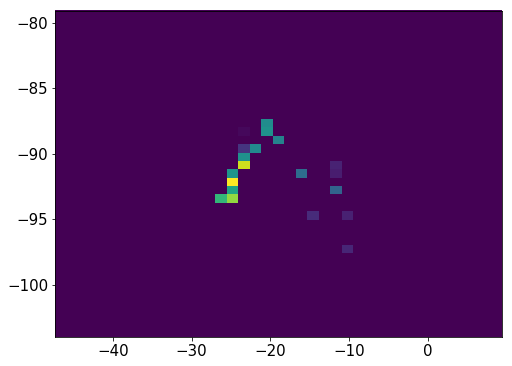

951589    27
951590    27
951591    27
951592    27
951593    27
951594    27
951595    27
951596    27
951597    27
951598    27
951599    27
951600    27
951601    27
951602    27
951603    27
951604    27
951605    27
951606    27
951607    27
951608    27
951609    27
951610    27
951611    27
951618    27
951619    27
951620    27
951621    27
951622    27
Name: Nsipm, dtype: uint16


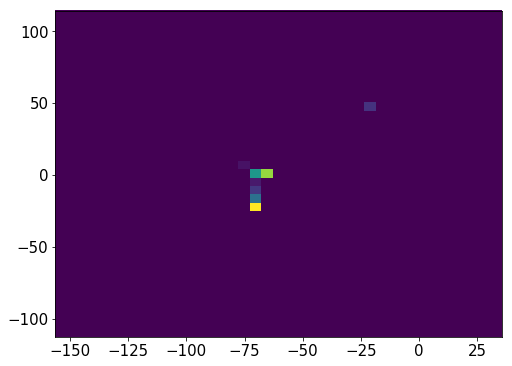

16592    30
16593    30
16594    30
16595    30
16596    30
16597    30
16598    30
16599    30
16600    30
16601    30
16602    30
16603    30
16604    30
16605    30
16606    30
16607    30
16608    30
16609    30
16610    30
16611    30
16612    30
16613    30
16614    30
16615    30
16616    30
16617    30
16618    30
16619    30
16620    30
16621    30
16622    30
16623    30
16624    30
16625    30
16626    30
16627    30
16632     3
16633     3
16634     3
16635     3
16636     3
Name: Nsipm, dtype: uint16


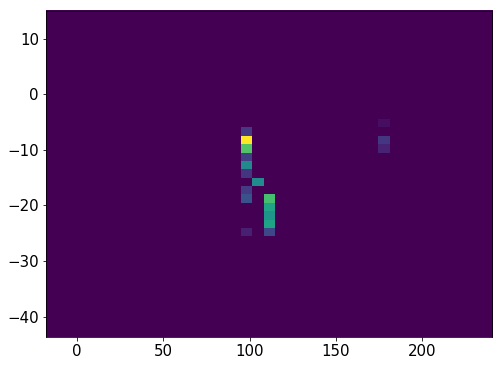

16640    19
16641    19
16642    19
16643    19
16644    19
16645    19
16646    19
16647    19
16648    19
16649    19
16650    19
16651    19
16652    19
16653    19
16654    19
16655    19
16656    19
16657    19
16658    19
16659    19
16660    19
16661    19
16662    19
16663    19
16664    19
16665    19
16666    19
16667    19
16668    19
Name: Nsipm, dtype: uint16


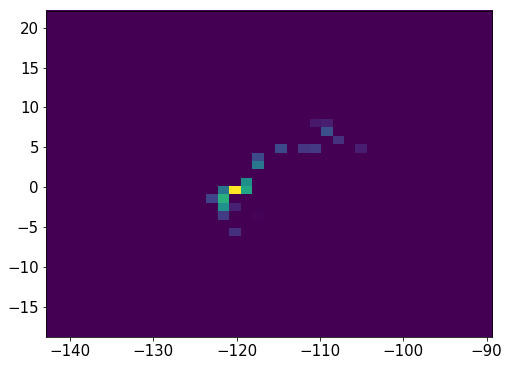

16673    26
16674    26
16675    26
16676    26
16677    26
16678    26
16679    26
16680    26
16681    26
16682    26
16683    26
16684    26
16685    26
Name: Nsipm, dtype: uint16


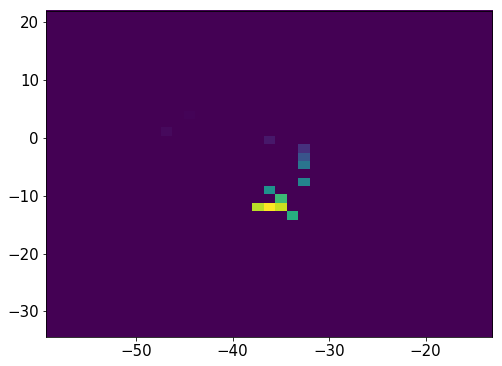

16690    31
16691    31
16692    31
16693    31
16694    31
16695    31
16696    31
16697    31
16698    31
16699    31
16700    31
16701    31
16702    31
16703    31
16704    31
16705    31
16706    31
16707    31
16708    31
16709    31
16710    31
Name: Nsipm, dtype: uint16


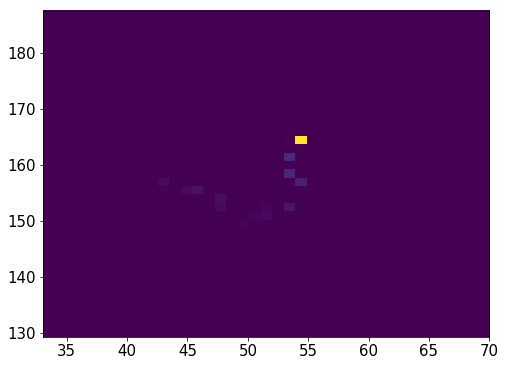

16713    29
16714    29
16715    29
16716    29
16717    29
16718    29
16719    29
16720    29
16721    29
16722    29
16723    29
16724    29
16725    29
16726    29
16727    29
16728    29
16729    29
Name: Nsipm, dtype: uint16


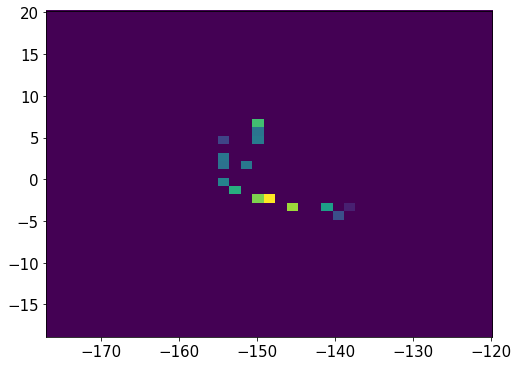

16733    26
16734    26
16735    26
16736    26
16737    26
16738    26
16739    26
16740    26
16741    26
16742    26
16743    26
16744    26
16745    26
16746    26
16747    26
16748    26
16749    26
16750    26
Name: Nsipm, dtype: uint16


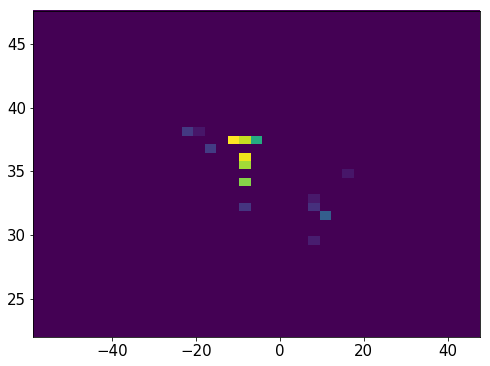

951671    37
951672    37
951673    37
951674    37
951675    37
951676    37
951677    37
951678    37
951679    37
951680    37
951681    37
951682    37
951683    37
951684    37
951685    37
951686    37
951687    37
951688    37
951689    37
951690    37
951691    37
951692    37
951693    37
Name: Nsipm, dtype: uint16


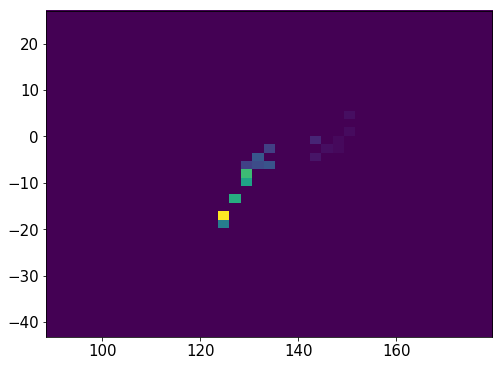

951694    27
951695    27
951696    27
951697    27
951698    27
951699    27
951700    27
951701    27
951702    27
951703    27
951704    27
951705    27
951706    27
951707    27
951708    27
951709    27
951710    27
951711    27
951712    27
951713    27
Name: Nsipm, dtype: uint16


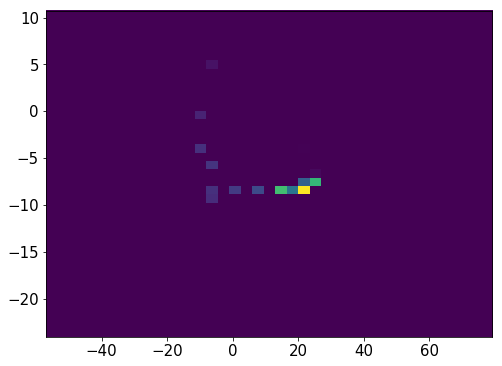

951716    23
951717    23
951718    23
951719    23
951720    23
951721    23
951722    23
951723    23
951724    23
951725    23
951726    23
951727    23
951728    23
951729    23
951730    23
951731    23
951732    23
951733    23
Name: Nsipm, dtype: uint16


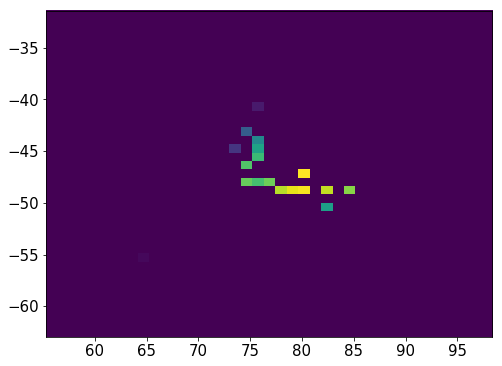

16754    21
16755    21
16756    21
16757    21
16758    21
16759    21
16760    21
16761    21
16762    21
16763    21
16764    21
16765    21
16766    21
16768    21
16769    21
16770    21
16771    21
Name: Nsipm, dtype: uint16


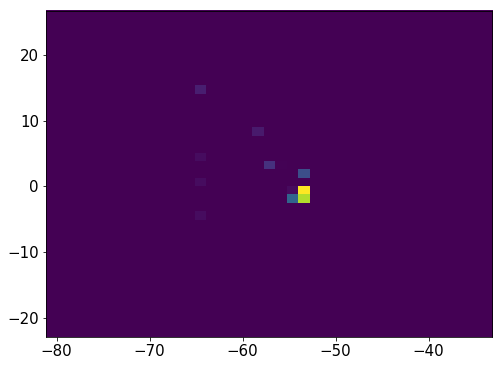

16777    35
16778    35
16779    35
16780    35
16781    35
16782    35
16783    35
16784    35
16785    35
16786    35
16787    35
16788    35
16789    35
16790    35
16791    35
Name: Nsipm, dtype: uint16


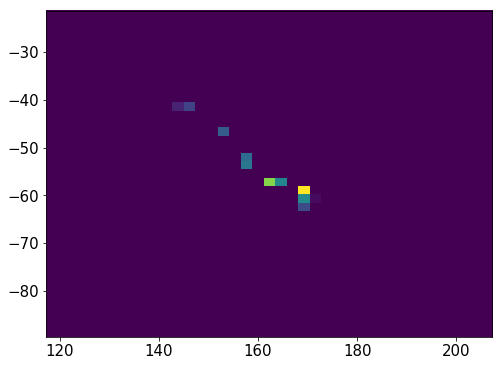

16795    20
16796    20
16797    20
16798    20
16799    20
16800    20
16801    20
16802    20
16803    20
16804    20
16805    20
16806    20
16807    20
16808    20
16809    20
Name: Nsipm, dtype: uint16


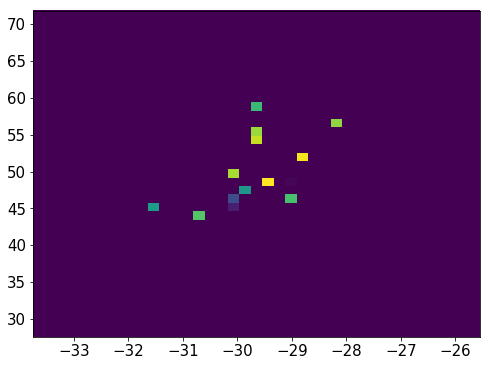

16815    24
16816    24
16817    24
16818    24
16819    24
16820    24
16821    24
16822    24
16823    24
16824    24
16825    24
16826    24
16827    24
16828    24
16829    24
16830    24
16831    24
16832    24
16833    24
Name: Nsipm, dtype: uint16


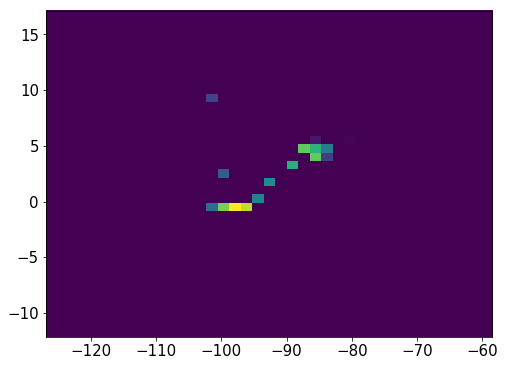

951766    24
951767    24
951768    24
951769    24
951770    24
951771    24
951772    24
951773    24
951774    24
951775    24
951776    24
951777    24
951778    24
951779    24
951780    24
951781    24
Name: Nsipm, dtype: uint16


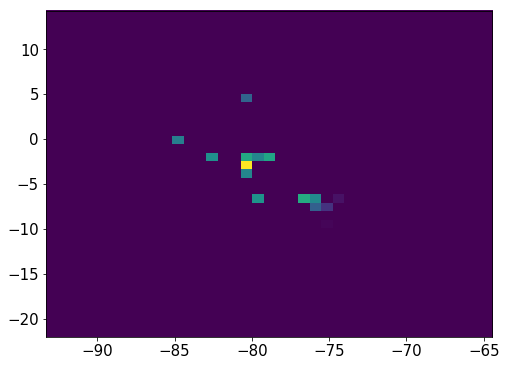

16838    21
16839    21
16840    21
16841    21
16842    21
16843    21
16844    21
16845    21
16846    21
16847    21
16848    21
16849    21
16850    21
16851    21
16852    21
16853    21
16854    21
16855    21
16856    21
Name: Nsipm, dtype: uint16


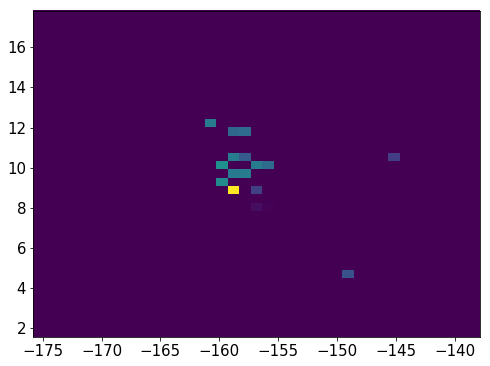

951787    19
951788    19
951789    19
951790    19
951791    19
951792    19
951793    19
951794    19
951795    19
951796    19
951797    19
Name: Nsipm, dtype: uint16


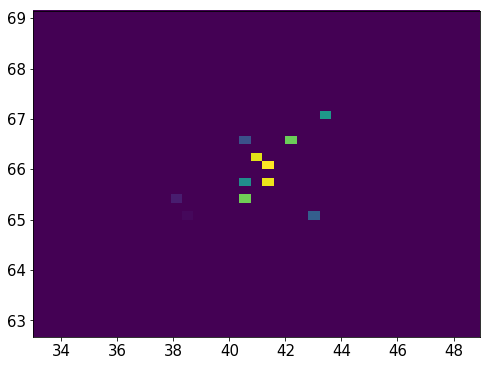

16862    29
16863    29
16864    29
16865    29
16866    29
16867    29
16868    29
16869    29
16870    29
16871    29
16872    29
16873    29
16874    29
16875    29
16876    29
16877    29
16878    29
16879    29
16880    29
16881    29
16882    29
16883    29
16884    29
16885    29
16886    29
Name: Nsipm, dtype: uint16


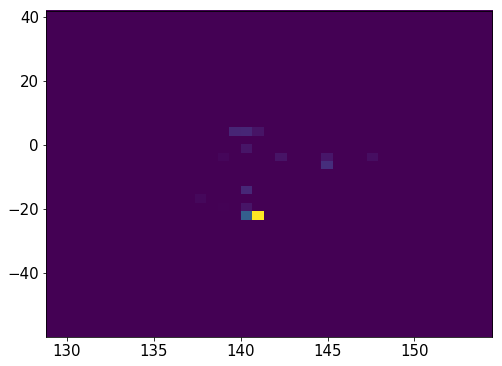

16892    26
16893    26
16894    26
16895    26
16896    26
16897    26
16898    26
16899    26
16900    26
16901    26
16902    26
16903    26
16904    26
16905    26
16906    26
16907    26
16908    26
16909    26
16910    26
Name: Nsipm, dtype: uint16


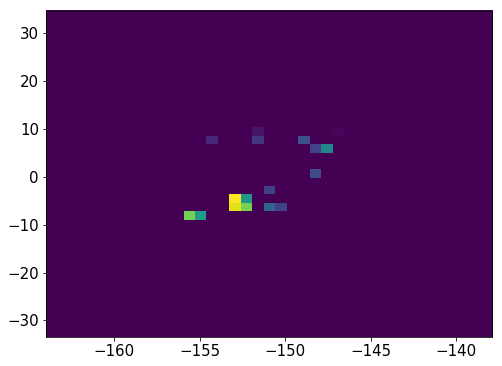

16916    32
16917    32
16918    32
16919    32
16920    32
16921    32
16922    32
16923    32
16924    32
16925    32
16926    32
16927    32
16928    32
16929    32
16930    32
16932    32
16933    32
16934    32
16935    32
16936    32
16937    32
16938    32
16939    32
16940    32
16941    32
16942    32
16943    32
16944    32
16945    32
16946    32
16950     3
16951     3
16952     3
16953     3
Name: Nsipm, dtype: uint16


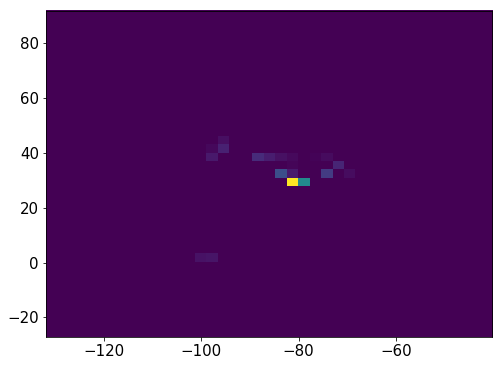

16957    21
16958    21
16959    21
16960    21
16961    21
16962    21
16963    21
16964    21
16965    21
16966    21
16967    21
16968    21
16969    21
16970    21
16971    21
16972    21
16973    21
16974    21
16975    21
Name: Nsipm, dtype: uint16


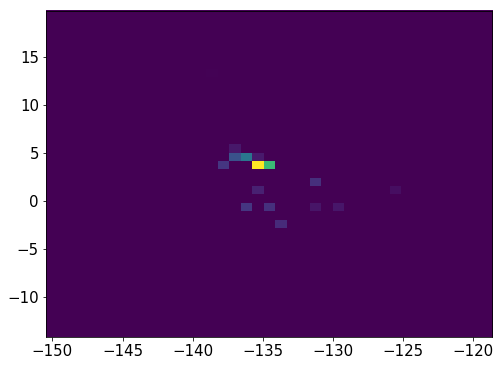

16980    22
16981    22
16982    22
16983    22
16984    22
16985    22
16986    22
16987    22
16988    22
16989    22
16990    22
16991    22
16992    22
16993    22
16994    22
16995    22
16996    22
16997    22
17000    22
17001    22
17003    22
17004    22
17006    22
17013    22
17014    22
17015    22
17016    22
17017    22
17018    22
17019    22
17020    22
17021    22
17022    22
17023    22
Name: Nsipm, dtype: uint16


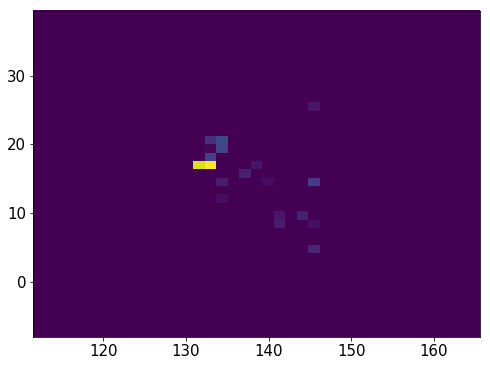

17026    32
17027    32
17028    32
17029    32
17030    32
17031    32
17032    32
17033    32
17034    32
17035    32
17036    32
17037    32
17038    32
17039    32
17040    32
17041    32
17042    32
Name: Nsipm, dtype: uint16


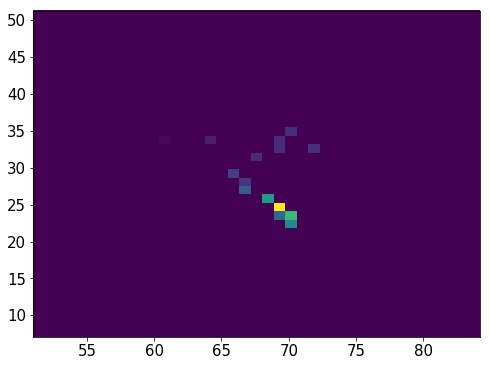

951823    27
951824    27
951825    27
951826    27
951827    27
951828    27
951829    27
951830    27
951831    27
951832    27
951833    27
951834    27
951835    27
951836    27
951837    27
951838    27
951839    27
951840    27
951841    27
951842    27
951843    27
951844    27
951845    27
951846    27
951847    27
951848    27
951849    27
Name: Nsipm, dtype: uint16


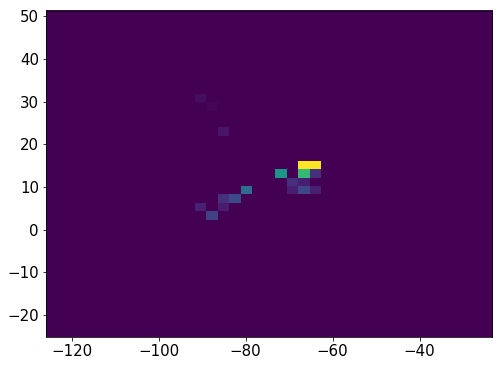

951855    42
951856    42
951857    42
951858    42
951859    42
951860    42
951861    42
951862    42
951863    42
951864    42
951865    42
951866    42
951867    42
951868    42
951869    42
951870    42
951871    42
951872    42
951873    42
951874    42
951875    42
951876    42
951877    42
951878    42
951879    42
951880    42
951881    42
951882    42
Name: Nsipm, dtype: uint16


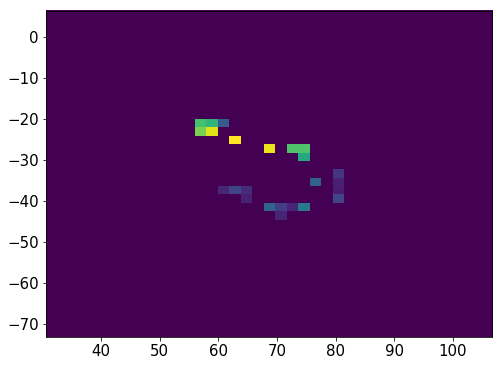

951886    27
951887    27
951888    27
951889    27
951890    27
951891    27
951892    27
951893    27
951894    27
951895    27
951896    27
951897    27
Name: Nsipm, dtype: uint16


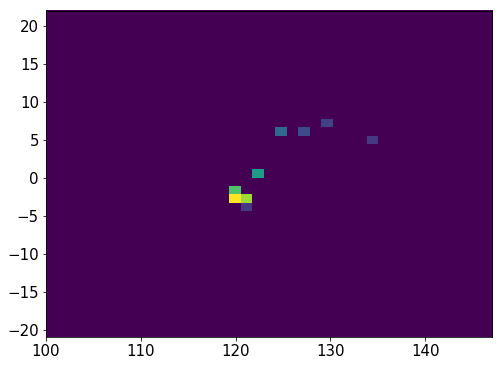

17047    35
17048    35
17049    35
17050    35
17051    35
17052    35
17053    35
17054    35
17055    35
17056    35
17057    35
Name: Nsipm, dtype: uint16


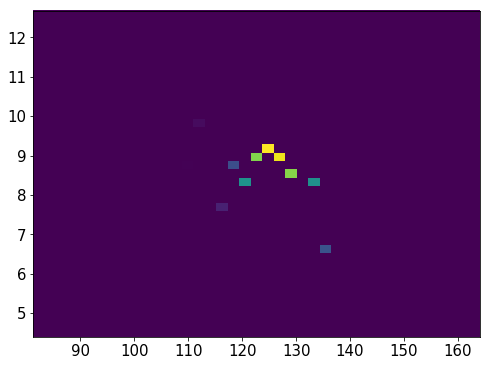

17062    29
17063    29
17064    29
17065    29
17066    29
17067    29
17068    29
17069    29
17070    29
17071    29
17072    29
17073    29
17074    29
17075    29
17076    29
17077    29
Name: Nsipm, dtype: uint16


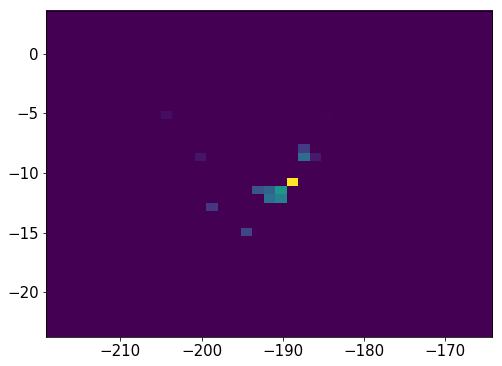

17081    26
17082    26
17083    26
17084    26
17085    26
17086    26
17087    26
17088    26
17089    26
17090    26
17091    26
17092    26
17093    26
17094    26
17095    26
Name: Nsipm, dtype: uint16


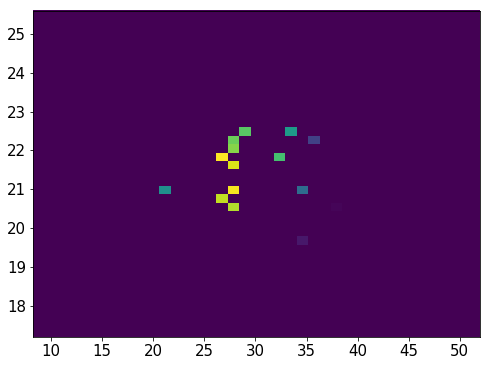

17099    27
17100    27
17101    27
17102    27
17103    27
17104    27
17105    27
17106    27
17107    27
17108    27
17109    27
17110    27
17111    27
17112    27
17113    27
17114    27
17115    27
17116    27
17117    27
17118    27
17119    27
17123     1
17124     1
17125     1
17126     1
17128     1
17129     1
Name: Nsipm, dtype: uint16


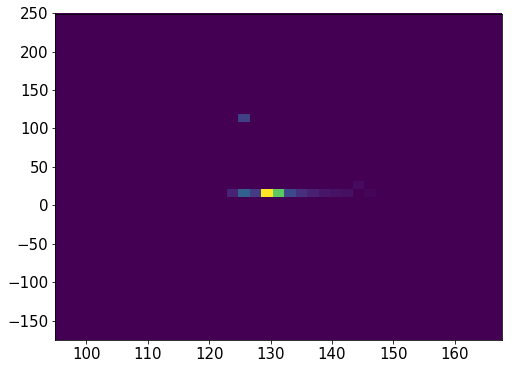

17133    24
17134    24
17135    24
17136    24
17137    24
17138    24
17139    24
17140    24
17141    24
17142    24
17143    24
17144    24
17145    24
17146    24
17147    24
17148    24
17149    24
17150    24
17151    24
17152    24
17153    24
17154    24
17155    24
Name: Nsipm, dtype: uint16


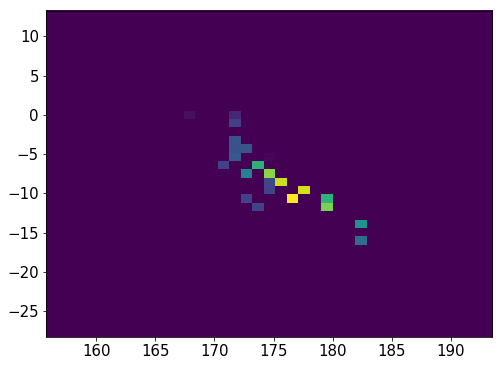

17160    24
17161    24
17162    24
17163    24
17164    24
17165    24
17166    24
17167    24
17168    24
17169    24
17170    24
17171    24
17172    24
17173    24
17174    24
17175    24
17176    24
17177    24
17178    24
Name: Nsipm, dtype: uint16


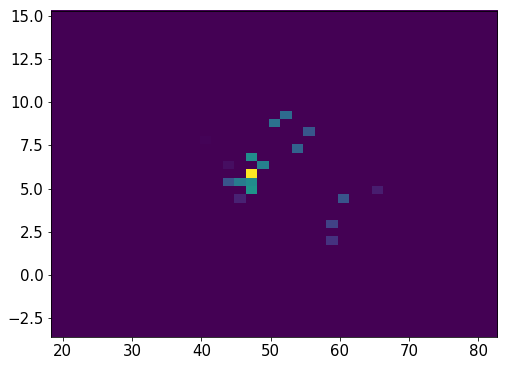

17183    27
17184    27
17185    27
17186    27
17187    27
17188    27
17189    27
17190    27
17191    27
17192    27
17193    27
17194    27
17195    27
17196    27
17200     2
17201     2
17202     2
Name: Nsipm, dtype: uint16


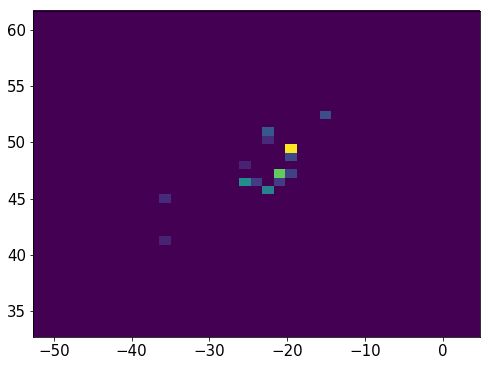

951940    22
951941    22
951942    22
951943    22
951944    22
951945    22
951946    22
951947    22
951948    22
951949    22
951950    22
951951    22
951952    22
951953    22
951954    22
951955    22
951956    22
951957    22
951958    22
951959    22
951960    22
951967    22
951968    22
951969    22
951970    22
Name: Nsipm, dtype: uint16


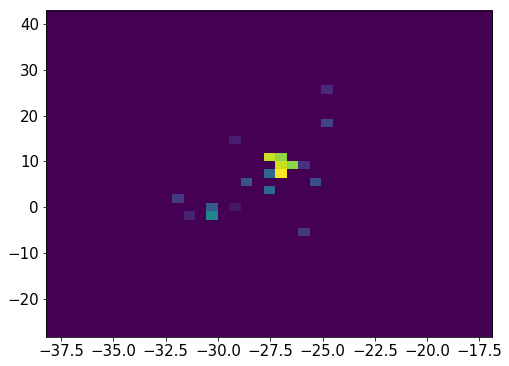

17205    37
17206    37
17207    37
17208    37
17209    37
17210    37
17211    37
17212    37
17213    37
17214    37
17215    37
17216    37
17217    37
17218    37
17219    37
17220    37
17221    37
17222    37
Name: Nsipm, dtype: uint16


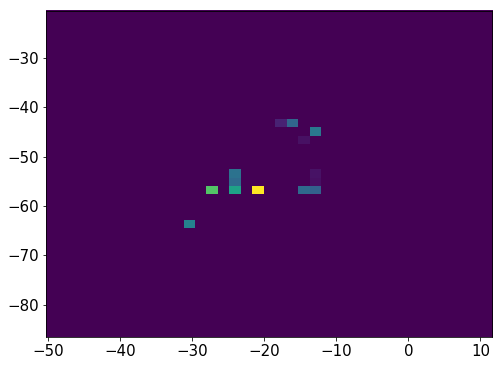

17226    31
17227    31
17228    31
17229    31
17230    31
17231    31
17232    31
17233    31
17234    31
17235    31
17236    31
17237    31
17238    31
Name: Nsipm, dtype: uint16


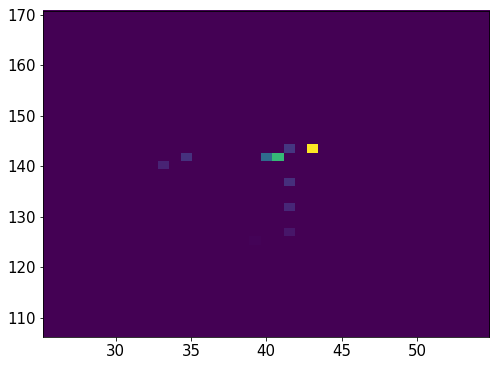

17241    27
17242    27
17243    27
17244    27
17245    27
17246    27
17247    27
17248    27
17249    27
17250    27
17251    27
17252    27
17253    27
Name: Nsipm, dtype: uint16


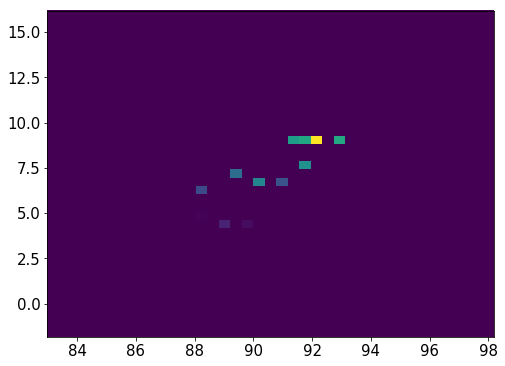

952006    22
952007    22
952008    22
952009    22
952010    22
952011    22
952012    22
952013    22
952014    22
952015    22
952016    22
952017    22
952018    22
952019    22
952020    22
952021    22
952022    22
952023    22
952024    22
952025    22
952026    22
Name: Nsipm, dtype: uint16


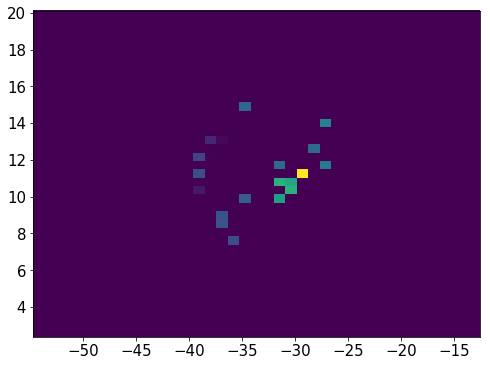

17258    29
17259    29
17260    29
17261    29
17262    29
17263    29
17264    29
17265    29
17266    29
17267    29
17268    29
17269    29
17270    29
17271    29
17272    29
17273    29
17274    29
17275    29
17276    29
17277    29
17283     1
17284     1
17285     1
17286     1
Name: Nsipm, dtype: uint16


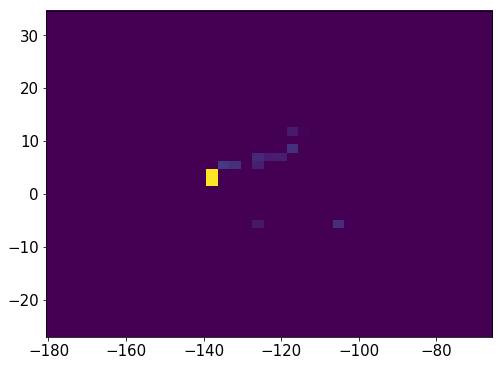

952032    20
952033    20
952034    20
952035    20
952036    20
952037    20
952038    20
952039    20
952040    20
952041    20
952042    20
952043    20
952044    20
952045    20
952046    20
952047    20
952048    20
Name: Nsipm, dtype: uint16


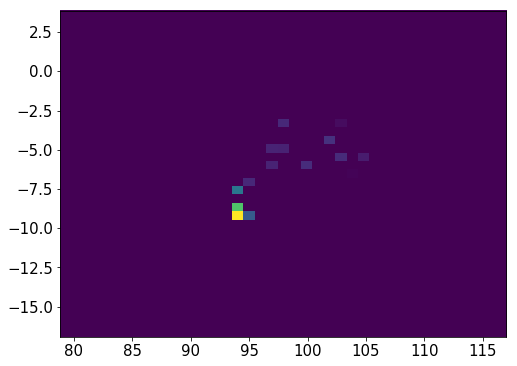

952053    20
952054    20
952055    20
952056    20
952057    20
952058    20
952059    20
952060    20
952061    20
952062    20
952063    20
Name: Nsipm, dtype: uint16


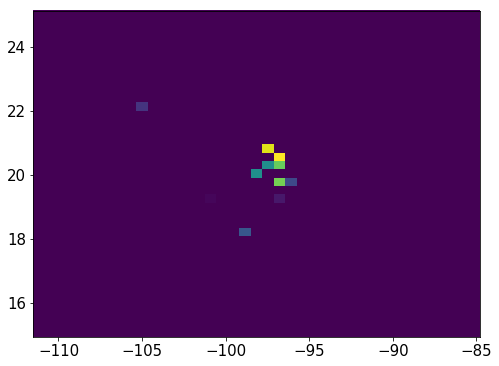

17292    20
17293    20
17294    20
17295    20
17296    20
17297    20
17298    20
17299    20
17300    20
17301    20
17303    20
17304    20
17305    20
17306    20
17307    20
17308    20
17309    20
17310    20
17311    20
17313    20
17314    20
17315    20
17316    20
17317    20
17318    20
17319    20
17320    20
Name: Nsipm, dtype: uint16


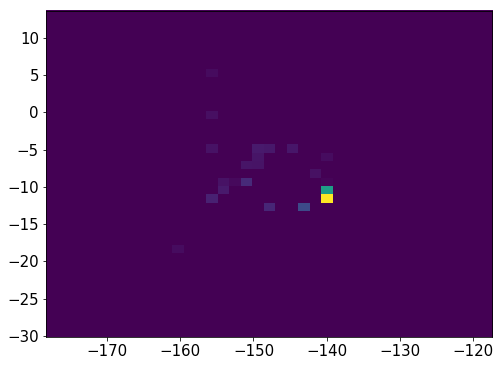

952069    31
952070    31
952071    31
952072    31
952073    31
952074    31
952075    31
952076    31
952077    31
952078    31
952079    31
952080    31
952081    31
952082    31
952083    31
952084    31
952088     5
952089     5
952090     5
952095     5
952096     5
952097     5
952098     5
952099     5
Name: Nsipm, dtype: uint16


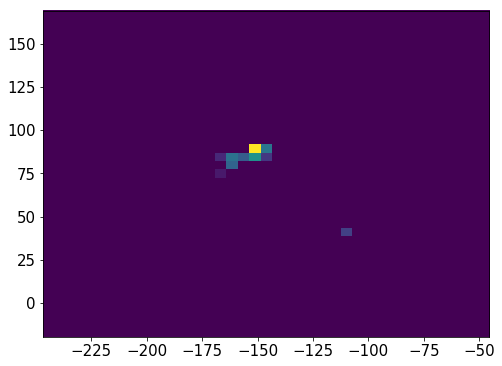

17346    24
17347    24
17348    24
17349    24
17350    24
17351    24
17352    24
17353    24
17354    24
17355    24
17356    24
17357    24
17358    24
17359    24
17360    24
Name: Nsipm, dtype: uint16


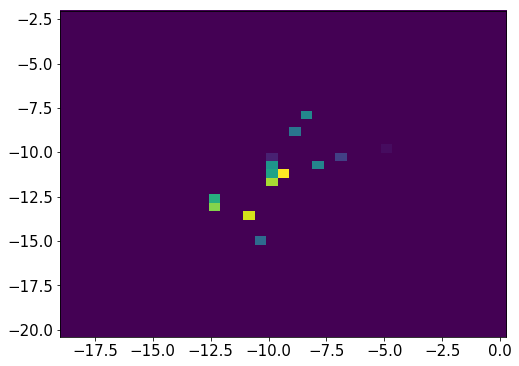

952102    28
952103    28
952104    28
952105    28
952106    28
952107    28
952108    28
952109    28
952110    28
952111    28
952112    28
952113    28
952114    28
952115    28
952116    28
952117    28
952118    28
952119    28
952120    28
952121    28
952122    28
952123    28
952124    28
952125    28
952126    28
952127    28
Name: Nsipm, dtype: uint16


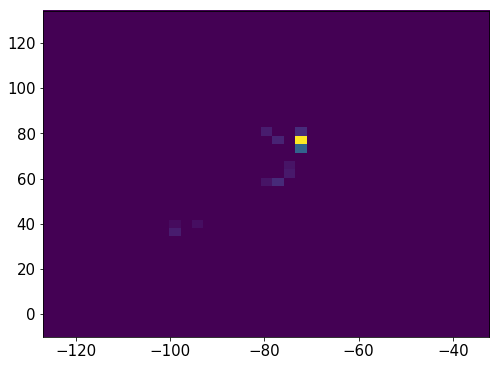

952132    23
952133    23
952134    23
952135    23
952136    23
952137    23
952138    23
952139    23
952140    23
952141    23
952142    23
952143    23
952146    23
952147    23
952148    23
952149    23
952150    23
952151    23
952152    23
952153    23
952154    23
952155    23
952156    23
952157    23
952158    23
952159    23
952160    23
952161    23
952162    23
952163    23
Name: Nsipm, dtype: uint16


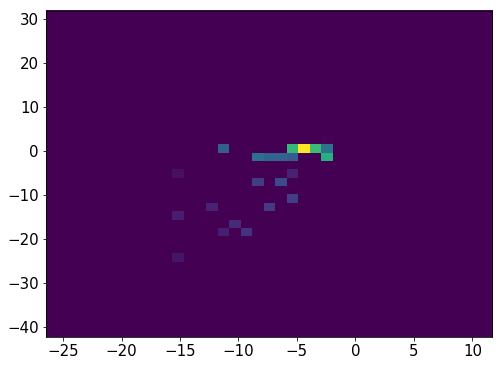

952168    20
952169    20
952170    20
952171    20
952172    20
952173    20
952174    20
952175    20
952176    20
952177    20
952178    20
952179    20
952180    20
952181    20
952182    20
952183    20
952188    20
952189    20
952190    20
Name: Nsipm, dtype: uint16


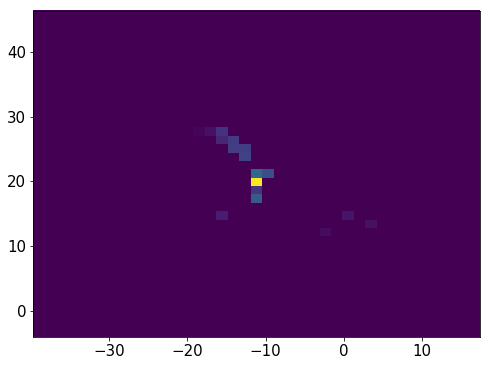

17364    27
17365    27
17366    27
17367    27
17368    27
17369    27
17370    27
17371    27
17372    27
17373    27
17374    27
17375    27
17376    27
17377    27
17378    27
17379    27
17380    27
Name: Nsipm, dtype: uint16


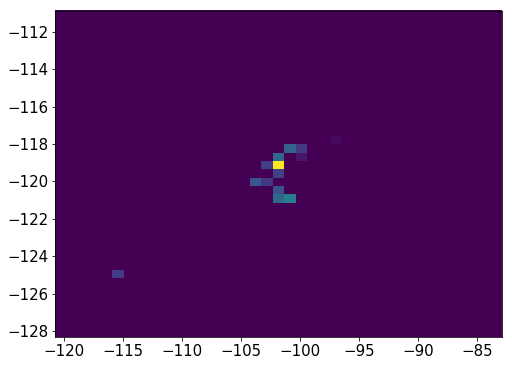

17386    24
17387    24
17388    24
17389    24
17390    24
17391    24
17392    24
17393    24
17394    24
17395    24
17396    24
17397    24
17398    24
17399    24
17400    24
17401    24
17402    24
Name: Nsipm, dtype: uint16


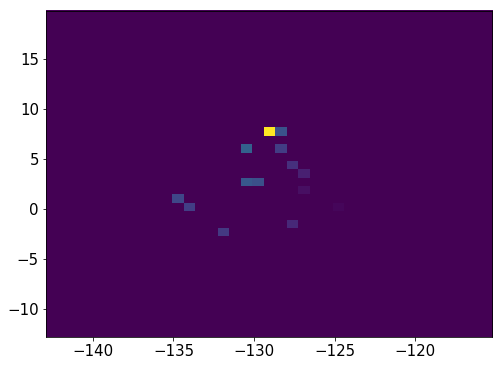

17408    25
17409    25
17410    25
17411    25
17412    25
17413    25
17414    25
17415    25
17416    25
17417    25
17418    25
17419    25
17420    25
Name: Nsipm, dtype: uint16


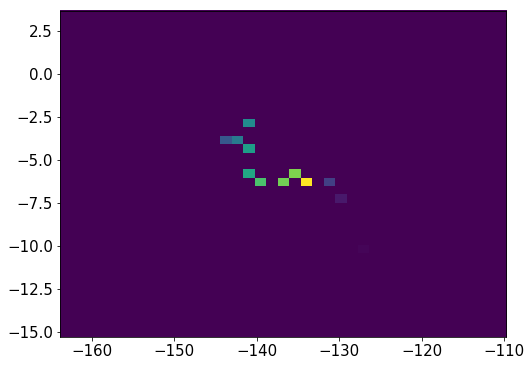

952237    27
952238    27
952239    27
952240    27
952241    27
952242    27
952243    27
952244    27
952245    27
952246    27
952247    27
952248    27
952249    27
952250    27
952251    27
952252    27
952253    27
952254    27
952255    27
952256    27
952257    27
952258    27
952259    27
952260    27
952261    27
Name: Nsipm, dtype: uint16


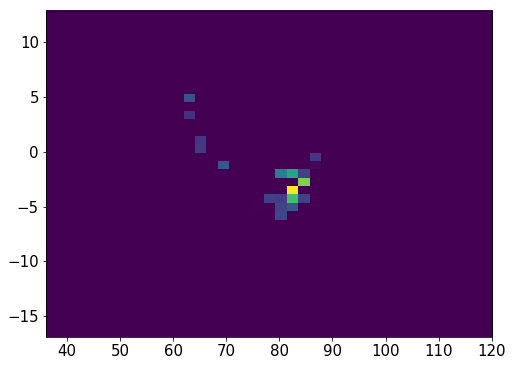

17425    19
17426    19
17427    19
17428    19
17429    19
17430    19
17431    19
17432    19
17433    19
17434    19
17435    19
17436    19
17437    19
17438    19
17439    19
17440    19
17441    19
17442    19
Name: Nsipm, dtype: uint16


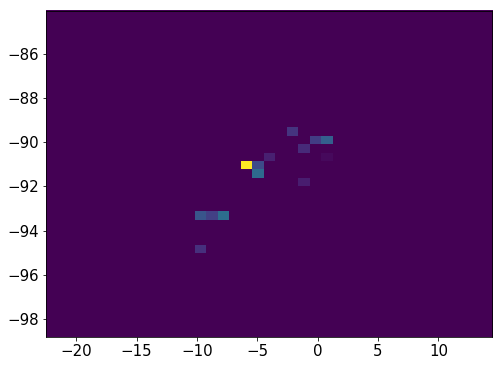

17447    25
17448    25
17449    25
17450    25
17451    25
17452    25
17453    25
17454    25
17455    25
17456    25
Name: Nsipm, dtype: uint16


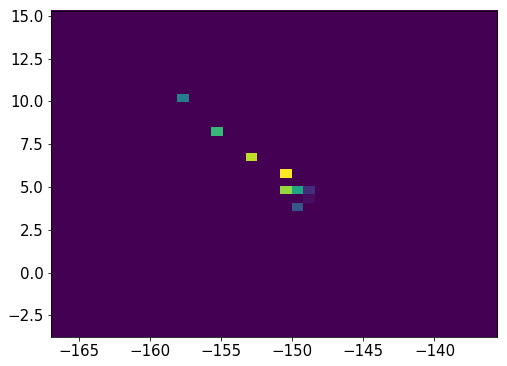

952266    27
952267    27
952268    27
952269    27
952270    27
952271    27
952272    27
952273    27
952274    27
952275    27
952276    27
952277    27
952278    27
952279    27
952280    27
952281    27
952282    27
952283    27
952284    27
952285    27
952286    27
Name: Nsipm, dtype: uint16


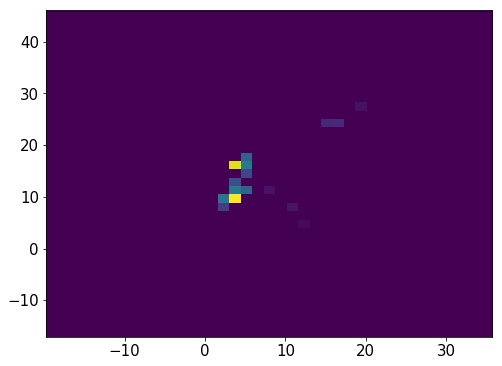

17462    19
17463    19
17464    19
17465    19
17466    19
17467    19
17468    19
17469    19
17470    19
17471    19
17472    19
17473    19
17474    19
17475    19
17476    19
17477    19
17478    19
17479    19
17480    19
17481    19
Name: Nsipm, dtype: uint16


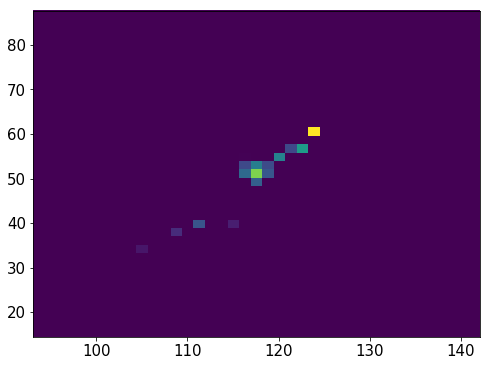

952290    34
952291    34
952292    34
952293    34
952294    34
952295    34
952296    34
952297    34
952298    34
952299    34
952300    34
952301    34
952302    34
952303    34
952304    34
952305    34
952306    34
952307    34
952308    34
Name: Nsipm, dtype: uint16


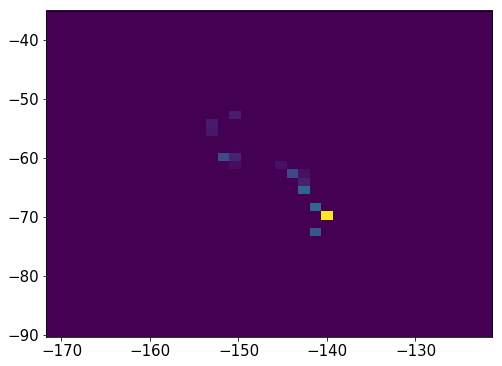

17486    23
17487    23
17488    23
17489    23
17490    23
17491    23
17492    23
17493    23
17494    23
17495    23
17496    23
17497    23
17498    23
17499    23
17500    23
17501    23
17502    23
17503    23
17504    23
17505    23
17506    23
17507    23
17508    23
17509    23
17510    23
17511    23
Name: Nsipm, dtype: uint16


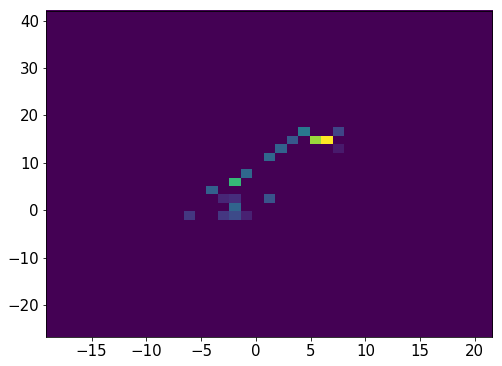

952312    25
952313    25
952314    25
952315    25
952316    25
952317    25
952318    25
952319    25
952320    25
952321    25
952322    25
952323    25
952324    25
952325    25
952326    25
952327    25
952328    25
952329    25
952330    25
952331    25
952332    25
Name: Nsipm, dtype: uint16


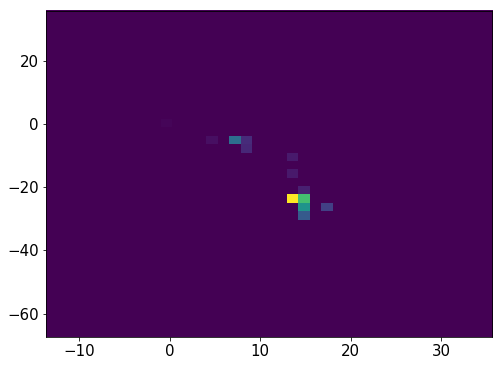

17516    24
17517    24
17518    24
17519    24
17520    24
17521    24
17522    24
17523    24
17524    24
17525    24
17526    24
17527    24
17528    24
Name: Nsipm, dtype: uint16


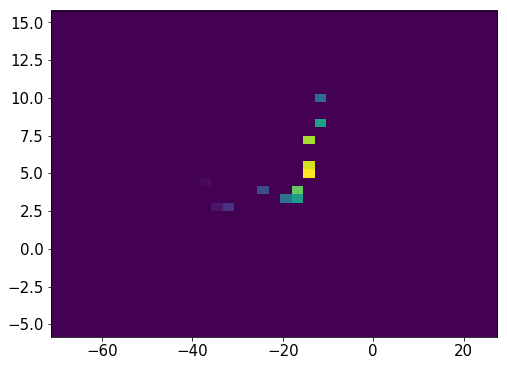

952337    37
952338    37
952339    37
952340    37
952341    37
952342    37
952343    37
952344    37
952345    37
952346    37
952347    37
952348    37
952349    37
Name: Nsipm, dtype: uint16


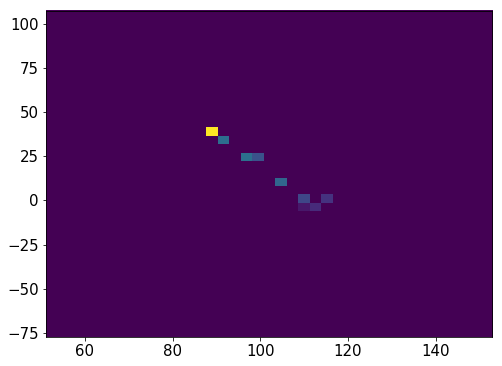

17533    21
17534    21
17535    21
17536    21
17537    21
17538    21
17539    21
17540    21
17541    21
17542    21
17543    21
17544    21
17545    21
17546    21
17547    21
17548    21
17549    21
17550    21
17551    21
17552    21
17553    21
17554    21
17555    21
17556    21
17557    21
17559    21
17560    21
17562    21
17563    21
17564    21
17565    21
17566    21
17567    21
17568    21
17569    21
17570    21
Name: Nsipm, dtype: uint16


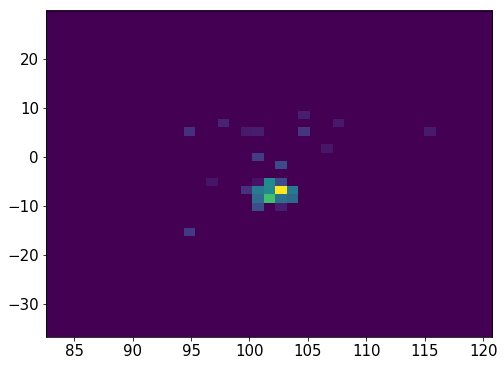

17578    28
17579    28
17580    28
17581    28
17582    28
17583    28
17584    28
17585    28
17586    28
17587    28
17588    28
17589    28
17590    28
17591    28
17592    28
17593    28
17594    28
Name: Nsipm, dtype: uint16


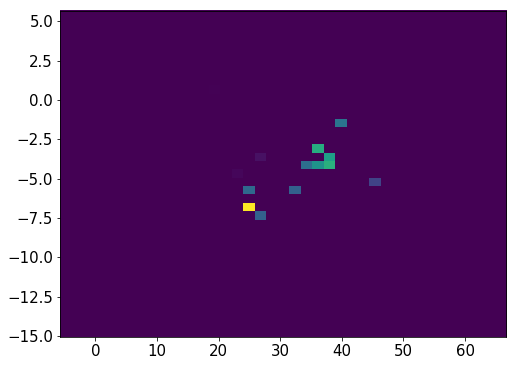

952355    29
952356    29
952357    29
952358    29
952359    29
952360    29
952361    29
952362    29
952363    29
952364    29
952365    29
952366    29
952367    29
952368    29
952369    29
Name: Nsipm, dtype: uint16


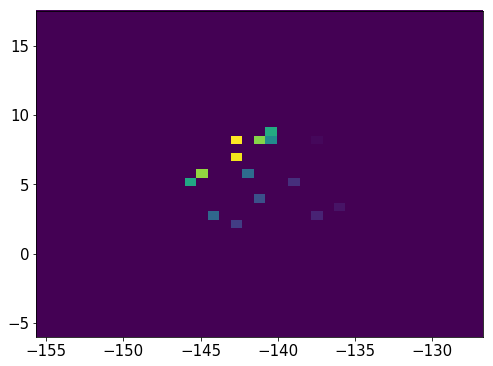

17599    29
17600    29
17601    29
17602    29
17603    29
17604    29
17605    29
17606    29
17607    29
17608    29
17609    29
17610    29
17611    29
17612    29
17613    29
17614    29
17615    29
17616    29
Name: Nsipm, dtype: uint16


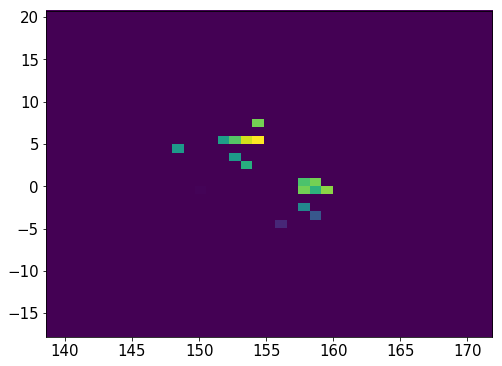

952407    22
952408    22
952409    22
952410    22
952411    22
952412    22
952413    22
952414    22
952415    22
952416    22
952417    22
952418    22
952419    22
952420    22
952421    22
952422    22
952423    22
952424    22
952425    22
952426    22
952427    22
952428    22
952434    22
952435    22
952436    22
952437    22
952438    22
952439    22
952440    22
952441    22
952442    22
952443    22
Name: Nsipm, dtype: uint16


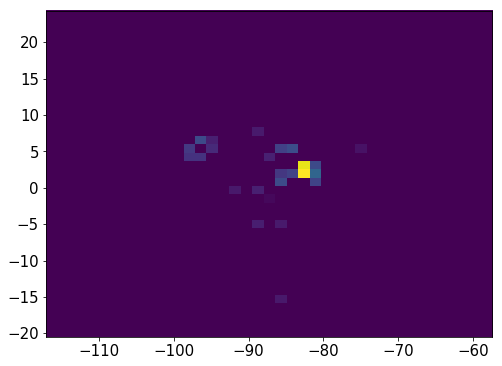

952448    29
952449    29
952450    29
952451    29
952452    29
952453    29
952454    29
952455    29
952456    29
952457    29
952458    29
952459    29
952460    29
952461    29
952462    29
952463    29
Name: Nsipm, dtype: uint16


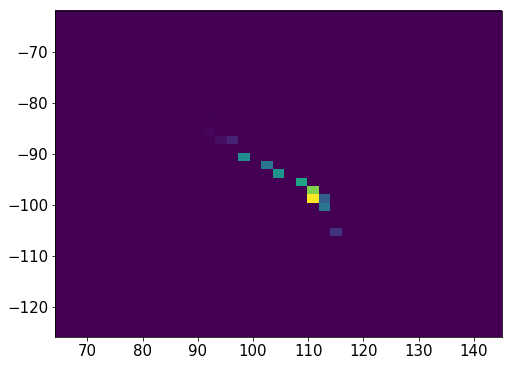

952469    20
952470    20
952471    20
952472    20
952473    20
952474    20
952475    20
952476    20
952477    20
952478    20
952479    20
952480    20
952481    20
952482    20
952483    20
952484    20
Name: Nsipm, dtype: uint16


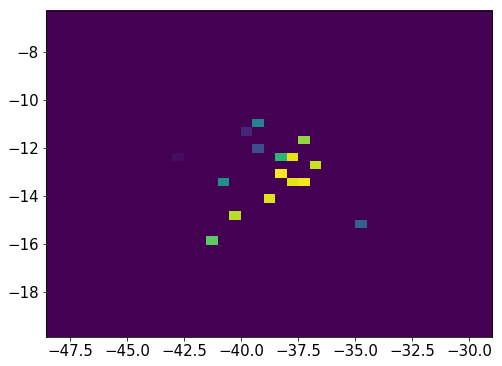

952489    21
952490    21
952491    21
952492    21
952493    21
952494    21
952495    21
952496    21
952497    21
952501     8
952502     8
952503     8
952504     8
952505     8
952506     8
952507     8
952508     8
952509     8
952510     8
952511     8
Name: Nsipm, dtype: uint16


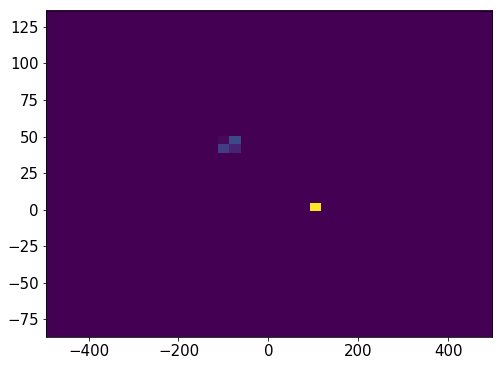

17621    26
17622    26
17623    26
17624    26
17625    26
17626    26
17627    26
17628    26
17629    26
17630    26
17631    26
17632    26
17633    26
17634    26
17635    26
17636    26
Name: Nsipm, dtype: uint16


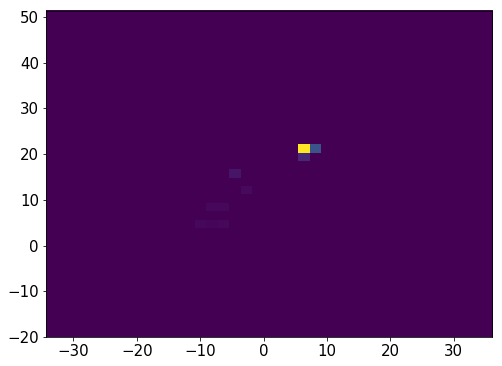

952516    22
952517    22
952518    22
952519    22
952520    22
952521    22
952522    22
952523    22
952524    22
952525    22
952526    22
952527    22
952528    22
952529    22
952530    22
952531    22
Name: Nsipm, dtype: uint16


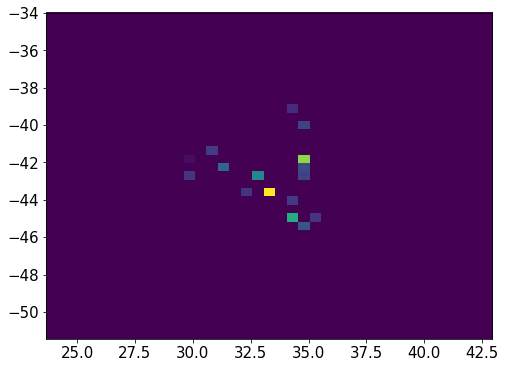

1901461    21
1901462    21
1901463    21
1901464    21
1901465    21
1901466    21
1901467    21
1901468    21
1901469    21
1901470    21
1901471    21
1901472    21
1901473    21
1901474    21
1901475    21
1901476    21
1901477    21
1901482    11
1901483    11
1901484    11
1901485    11
1901486    11
1901487    11
1901488    11
1901489    11
1901490    11
Name: Nsipm, dtype: uint16


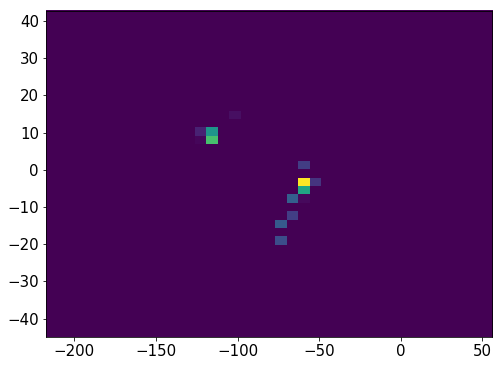

952536    23
952537    23
952538    23
952539    23
952540    23
952541    23
952542    23
952543    23
952544    23
952545    23
952546    23
952547    23
952548    23
952549    23
952550    23
952551    23
952552    23
Name: Nsipm, dtype: uint16


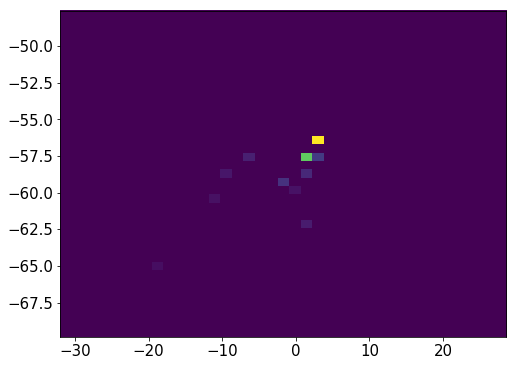

17641    24
17642    24
17643    24
17644    24
17645    24
17646    24
17647    24
17648    24
17649    24
17650    24
17651    24
17652    24
17653    24
17654    24
17655    24
17656    24
17657    24
17658    24
17659    24
17660    24
17661    24
17662    24
17663    24
Name: Nsipm, dtype: uint16


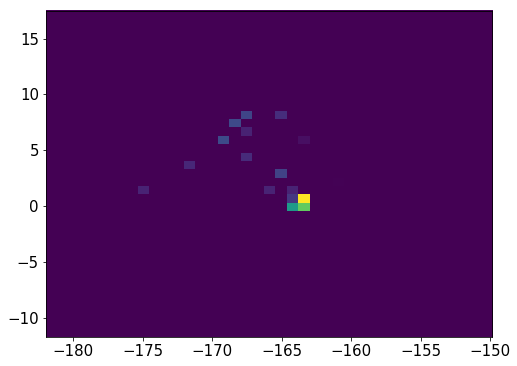

17667    31
17668    31
17669    31
17670    31
17671    31
17672    31
17673    31
17674    31
17675    31
17676    31
17677    31
17678    31
Name: Nsipm, dtype: uint16


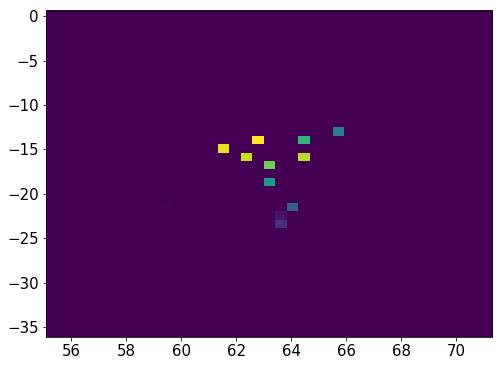

17683    27
17684    27
17685    27
17686    27
17687    27
17688    27
17689    27
17690    27
17691    27
17692    27
17693    27
17694    27
17695    27
17696    27
Name: Nsipm, dtype: uint16


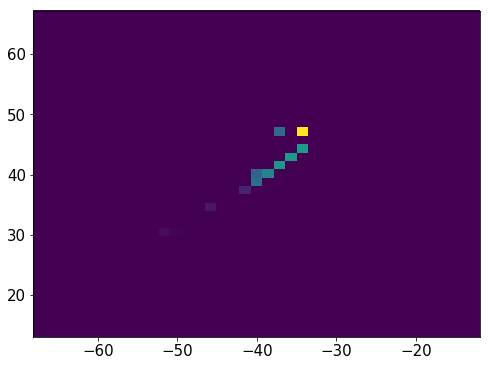

17701    31
17702    31
17703    31
17704    31
17705    31
17706    31
17707    31
17708    31
17709    31
17710    31
17711    31
17712    31
17713    31
17714    31
17715    31
17716    31
17717    31
17718    31
17719    31
17720    31
17721    31
17722    31
17723    31
17724    31
17725    31
17726    31
17727    31
17728    31
17729    31
17730    31
17731    31
17732    31
17733    31
17734    31
17735    31
17736    31
Name: Nsipm, dtype: uint16


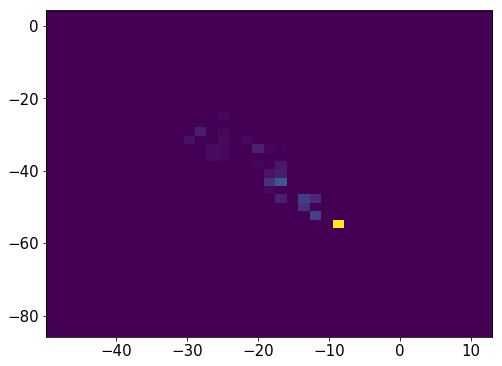

17741    24
17742    24
17743    24
17744    24
17745    24
17746    24
17747    24
17748    24
17749    24
17750    24
17751    24
17752    24
17753    24
Name: Nsipm, dtype: uint16


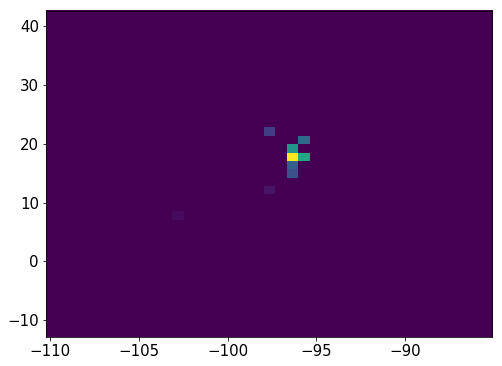

17758    26
17759    26
17760    26
17761    26
17762    26
17763    26
17764    26
17765    26
17766    26
17767    26
17768    26
17769    26
17770    26
17771    26
17772    26
Name: Nsipm, dtype: uint16


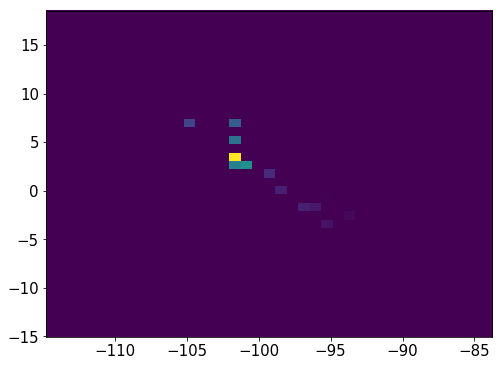

17777    30
17778    30
17779    30
17780    30
17781    30
17782    30
17783    30
17784    30
17785    30
17786    30
17787    30
17788    30
17789    30
17797    30
17798    30
17799    30
17800    30
17801    30
Name: Nsipm, dtype: uint16


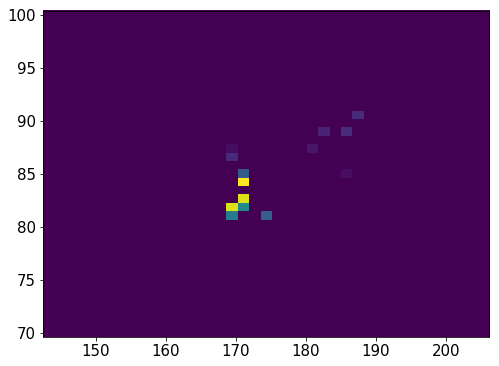

17808    23
17809    23
17810    23
17811    23
17812    23
17813    23
17814    23
17815    23
17816    23
17817    23
17818    23
17819    23
17820    23
17821    23
Name: Nsipm, dtype: uint16


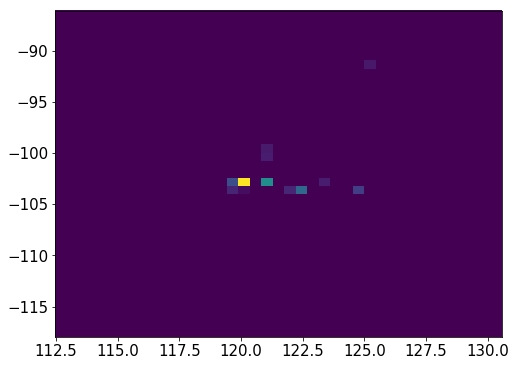

17826    44
17827    44
17828    44
17829    44
17830    44
17831    44
17832    44
17833    44
17834    44
17835    44
17836    44
17837    44
17838    44
17839    44
17840    44
17841    44
17842    44
Name: Nsipm, dtype: uint16


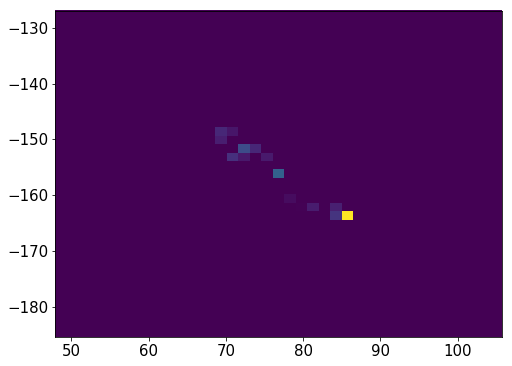

952672    37
952673    37
952674    37
952675    37
952676    37
952677    37
952678    37
952679    37
952680    37
952681    37
952682    37
952683    37
952684    37
952685    37
952686    37
Name: Nsipm, dtype: uint16


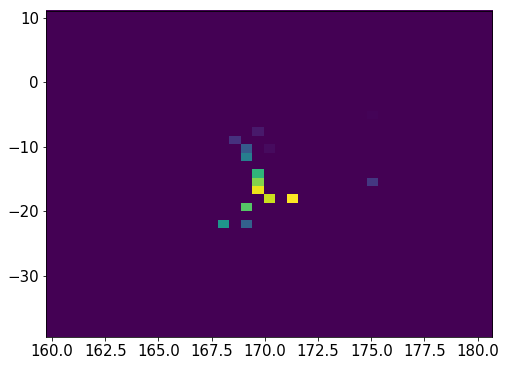

952693    36
952694    36
952695    36
952696    36
952697    36
952698    36
952699    36
952700    36
952701    36
952702    36
952703    36
952704    36
952705    36
952706    36
952707    36
952708    36
952709    36
952710    36
952711    36
Name: Nsipm, dtype: uint16


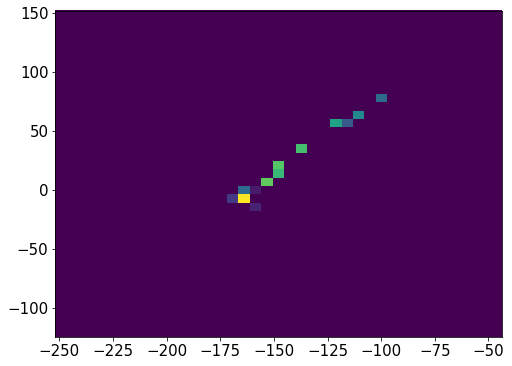

17846    30
17847    30
17848    30
17849    30
17850    30
17851    30
17852    30
17853    30
17854    30
17855    30
17856    30
17857    30
17858    30
17859    30
17860    30
17861    30
17862    30
17863    30
17864    30
17865    30
17866    30
17867    30
17868    30
17869    30
17870    30
17871    30
17872    30
17873    30
Name: Nsipm, dtype: uint16


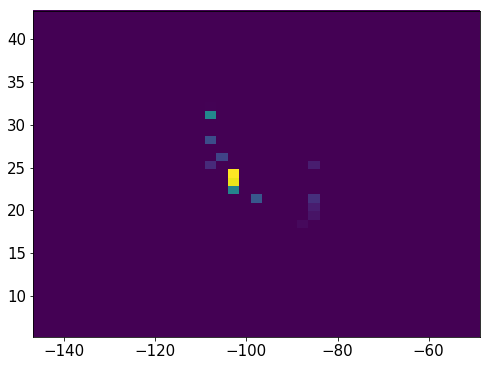

952715    23
952716    23
952717    23
952718    23
952719    23
952720    23
952721    23
952722    23
952723    23
952724    23
952725    23
952726    23
952727    23
952728    23
952729    23
952730    23
952731    23
952732    23
952733    23
Name: Nsipm, dtype: uint16


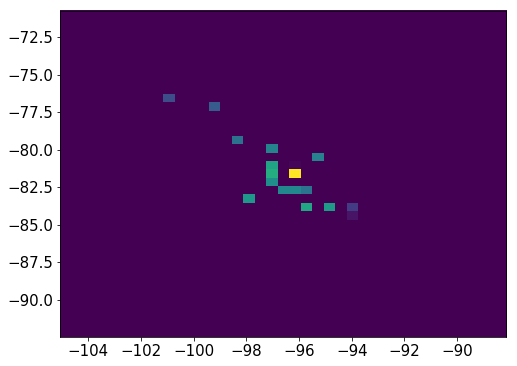

952738    22
952739    22
952740    22
952741    22
952742    22
952743    22
952744    22
952745    22
952746    22
952747    22
952748    22
952749    22
952750    22
952751    22
952752    22
952753    22
952754    22
952755    22
952756    22
Name: Nsipm, dtype: uint16


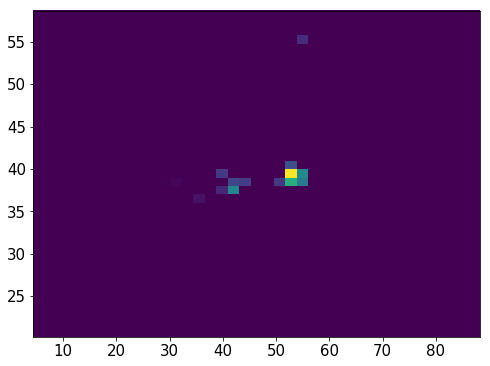

952761    25
952762    25
952763    25
952764    25
952765    25
952766    25
952767    25
952768    25
952769    25
952770    25
952771    25
952772    25
952773    25
952774    25
952775    25
952776    25
952777    25
952778    25
952779    25
952780    25
952781    25
Name: Nsipm, dtype: uint16


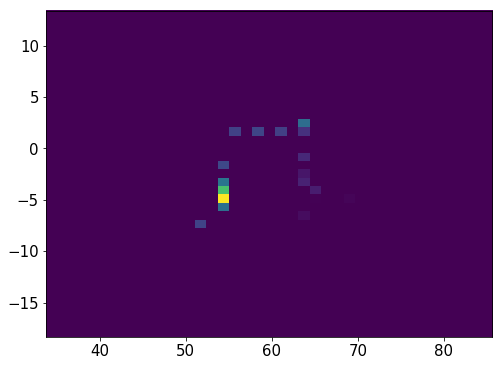

952786    26
952787    26
952788    26
952789    26
952790    26
952791    26
952792    26
952793    26
952794    26
952795    26
952796    26
952797    26
952798    26
952799    26
952800    26
952801    26
952802    26
952803    26
952804    26
952805    26
952806    26
952807    26
Name: Nsipm, dtype: uint16


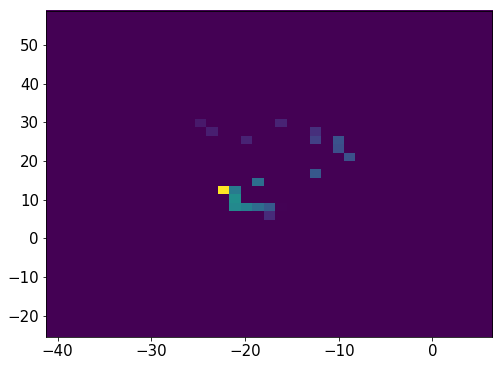

952811    51
952812    51
952813    51
952814    51
952815    51
952816    51
952817    51
952818    51
952819    51
952820    51
952821    51
952822    51
952823    51
952824    51
952825    51
952826    51
952827    51
Name: Nsipm, dtype: uint16


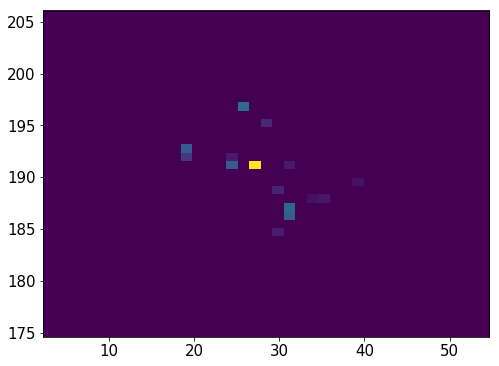

952832    34
952833    34
952834    34
952835    34
952836    34
952837    34
952838    34
952839    34
952840    34
952841    34
952842    34
952843    34
952844    34
952845    34
952846    34
952847    34
Name: Nsipm, dtype: uint16


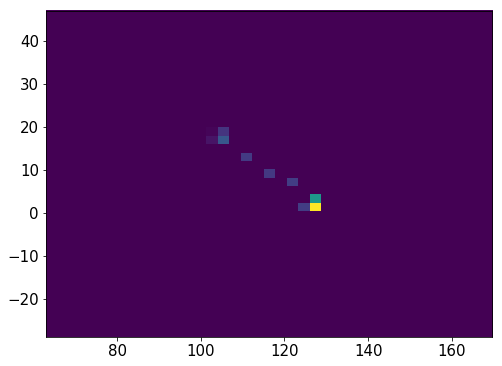

17878    34
17879    34
17880    34
17881    34
17882    34
17883    34
17884    34
17885    34
17886    34
17887    34
17888    34
17889    34
17890    34
17891    34
17892    34
17893    34
Name: Nsipm, dtype: uint16


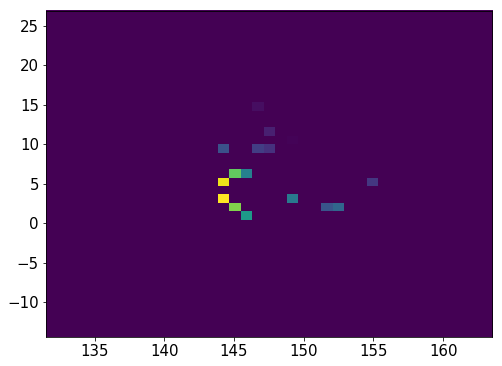

17897    22
17898    22
17899    22
17900    22
17901    22
17902    22
17903    22
17904    22
17905    22
17906    22
17907    22
17908    22
17909    22
17910    22
17911    22
17912    22
17913    22
17914    22
Name: Nsipm, dtype: uint16


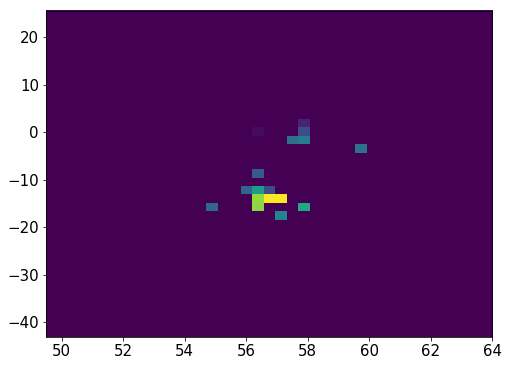

17920    22
17921    22
17922    22
17923    22
17924    22
17925    22
17926    22
17927    22
17928    22
17929    22
17930    22
17931    22
17932    22
17933    22
17934    22
17935    22
17936    22
17937    22
17938    22
17939    22
17940    22
17941    22
17942    22
17943    22
Name: Nsipm, dtype: uint16


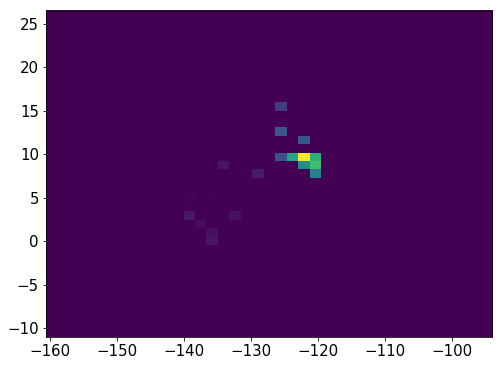

952874    23
952875    23
952876    23
952877    23
952878    23
952879    23
952880    23
952881    23
952882    23
952883    23
952884    23
952885    23
952886    23
952887    23
952888    23
952889    23
952890    23
952891    23
952892    23
952893    23
Name: Nsipm, dtype: uint16


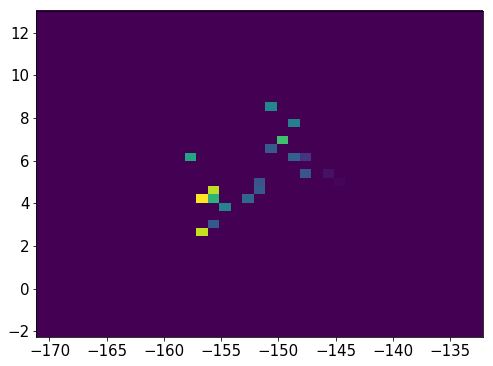

572161    50
572162    50
572163    50
572164    50
572165    50
572166    50
572167    50
572168    50
572169    50
572170    50
572171    50
572172    50
572173    50
572174    50
572175    50
572176    50
572177    50
Name: Nsipm, dtype: uint16


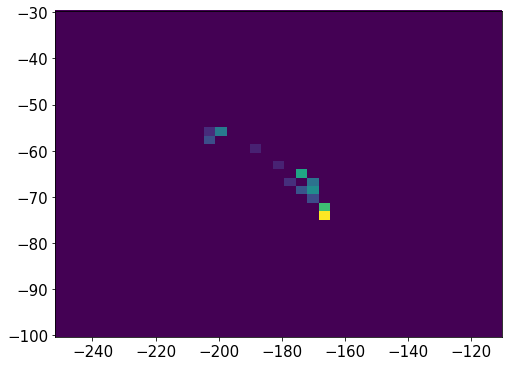

17948    22
17949    22
17950    22
17951    22
17952    22
17953    22
17954    22
17955    22
17956    22
17957    22
17958    22
17959    22
17960    22
17961    22
17962    22
17963    22
Name: Nsipm, dtype: uint16


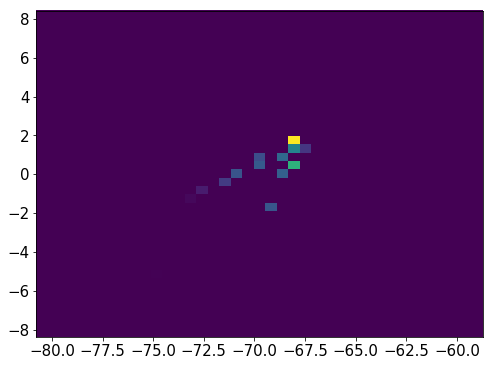

952897    28
952898    28
952899    28
952900    28
952901    28
952902    28
952903    28
952904    28
952905    28
952906    28
952907    28
952908    28
952909    28
952910    28
952911    28
952912    28
952913    28
952914    28
952916    28
Name: Nsipm, dtype: uint16


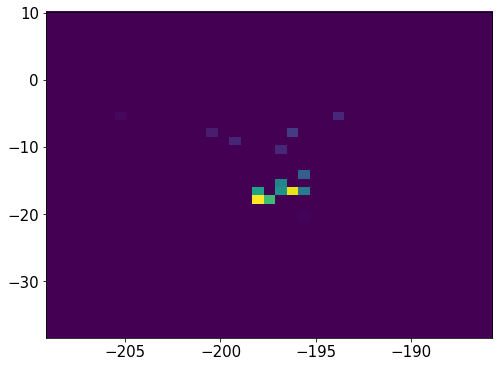

17968    26
17969    26
17970    26
17971    26
17972    26
17973    26
17974    26
17975    26
17976    26
17977    26
17978    26
Name: Nsipm, dtype: uint16


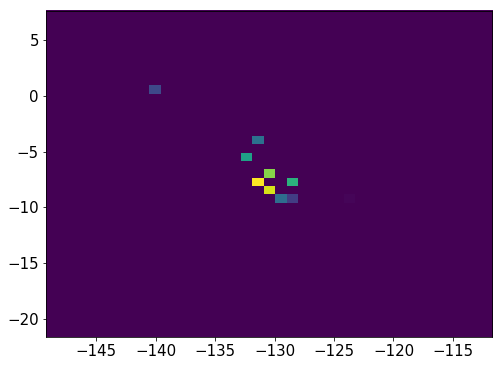

952922    23
952923    23
952924    23
952925    23
952926    23
952927    23
952928    23
952929    23
952930    23
952931    23
952932    23
952933    23
952934    23
952936    23
952937    23
952938    23
952939    23
952940    23
Name: Nsipm, dtype: uint16


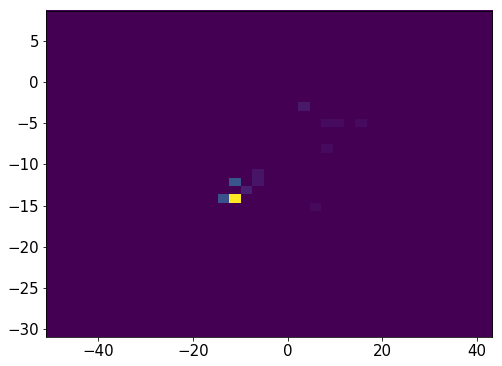

17984    22
17985    22
17986    22
17987    22
17988    22
17989    22
17990    22
17991    22
17992    22
17993    22
17994    22
17995    22
17996    22
17997    22
17998    22
17999    22
18000    22
18001    22
18002    22
Name: Nsipm, dtype: uint16


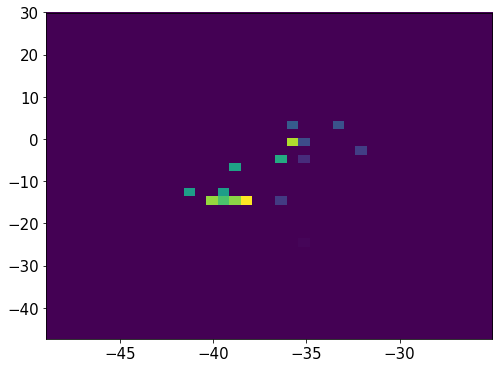

18008    37
18009    37
18011    37
18012    37
18013    37
18014    37
18015    37
18016    37
18017    37
18018    37
18019    37
18020    37
18021    37
18022    37
18023    37
18024    37
18025    37
18026    37
Name: Nsipm, dtype: uint16


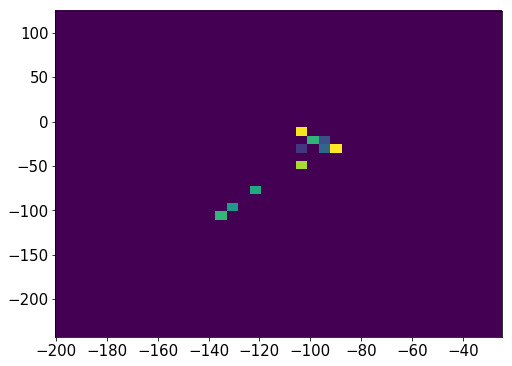

18027    26
18028    26
18029    26
18030    26
18031    26
18032    26
18033    26
18034    26
18035    26
18036    26
18037    26
18038    26
18039    26
18040    26
18041    26
18042    26
18043    26
18044    26
18045    26
18046    26
18051     5
18052     5
18053     5
18054     5
18058    17
18059    17
18060    17
18061    17
18062    17
18063    17
18064    17
18065    17
18066    17
Name: Nsipm, dtype: uint16


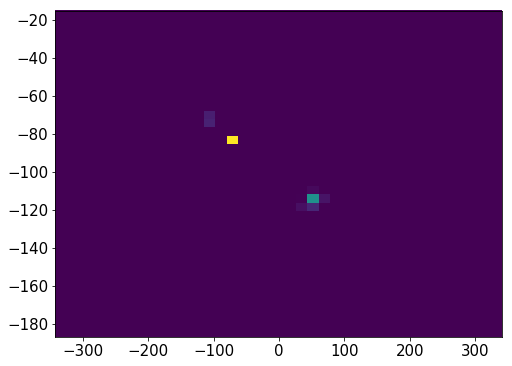

18071    40
18072    40
18073    40
18074    40
18075    40
18076    40
18077    40
18078    40
18079    40
18080    40
18081    40
18082    40
18083    40
18084    40
18086    40
18088    40
18089    40
18090    40
18091    40
18092    40
18093    40
18094    40
18095    40
18096    40
18097    40
18098    40
Name: Nsipm, dtype: uint16


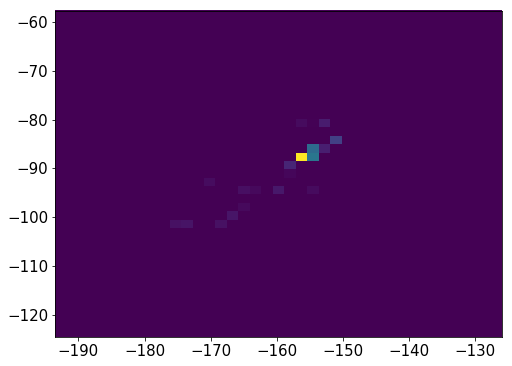

1666020    31
1666021    31
1666022    31
1666023    31
1666024    31
1666025    31
1666026    31
1666027    31
1666028    31
1666029    31
1666030    31
1666031    31
1666032    31
1666033    31
1666034    31
1666035    31
Name: Nsipm, dtype: uint16


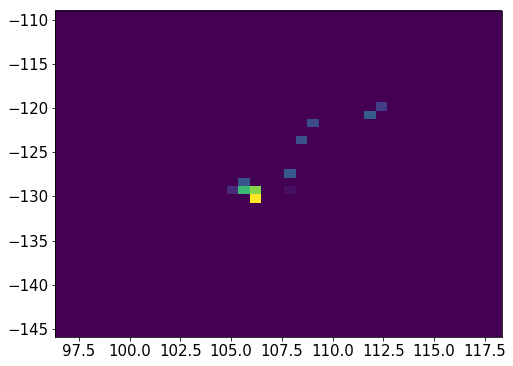

18103    27
18104    27
18105    27
18106    27
18107    27
18108    27
18109    27
18110    27
18111    27
18112    27
18115     3
18116     3
18117     3
18118     3
Name: Nsipm, dtype: uint16


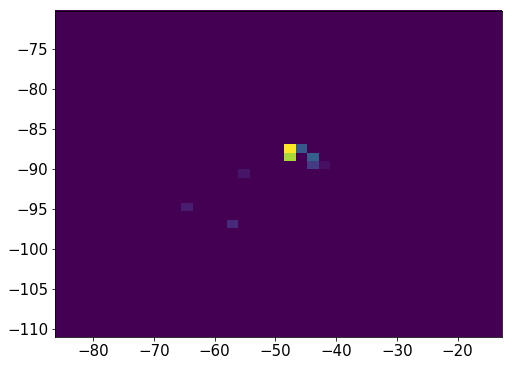

952968    18
952969    18
952970    18
952971    18
952972    18
952973    18
952974    18
952975    18
952976    18
952977    18
952978    18
952979    18
952980    18
952981    18
952982    18
952983    18
952984    18
952985    18
952986    18
952987    18
952988    18
952989    18
952990    18
952991    18
952992    18
952993    18
952994    18
Name: Nsipm, dtype: uint16


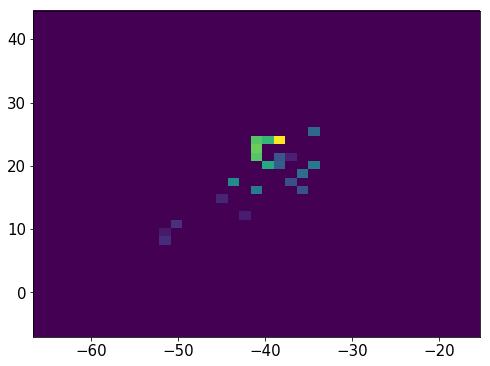

952999    23
953000    23
953001    23
953002    23
953003    23
953004    23
953005    23
953006    23
953007    23
953008    23
953009    23
953010    23
953011    23
Name: Nsipm, dtype: uint16


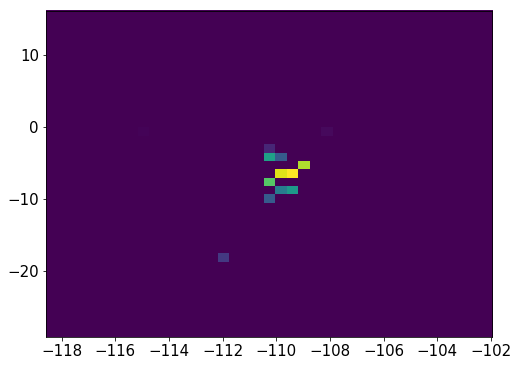

1666039    34
1666040    34
1666041    34
1666042    34
1666043    34
1666044    34
1666045    34
1666046    34
1666047    34
1666048    34
1666049    34
1666050    34
1666051    34
1666059     1
1666060     1
1666061     1
1666062     1
1666063     1
1666065     1
1666066     1
Name: Nsipm, dtype: uint16


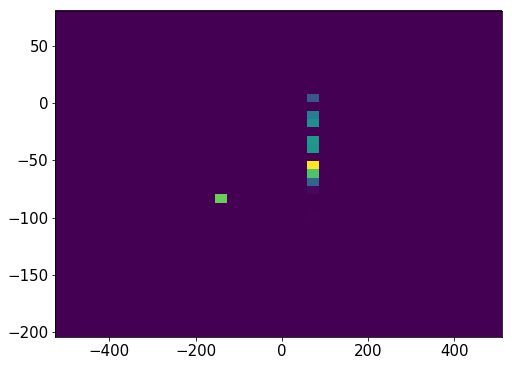

953015    24
953016    24
953017    24
953018    24
953019    24
953020    24
953021    24
953022    24
953023    24
953024    24
953025    24
953026    24
953027    24
953028    24
953029    24
953030    24
953031    24
953032    24
953033    24
953034    24
953035    24
953036    24
953037    24
953038    24
Name: Nsipm, dtype: uint16


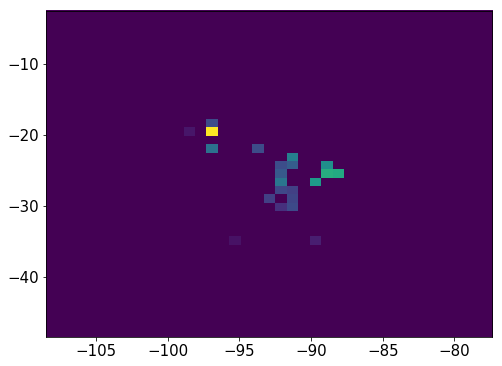

18121    47
18122    47
18123    47
18124    47
18125    47
18126    47
18127    47
18128    47
18129    47
18130    47
18131    47
18132    47
18133    47
18134    47
18135    47
18136    47
Name: Nsipm, dtype: uint16


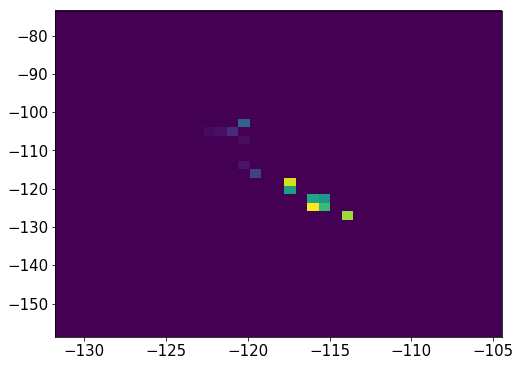

18139    30
18140    30
18141    30
18142    30
18143    30
18144    30
18145    30
18146    30
18147    30
18148    30
18149    30
18150    30
18151    30
18152    30
Name: Nsipm, dtype: uint16


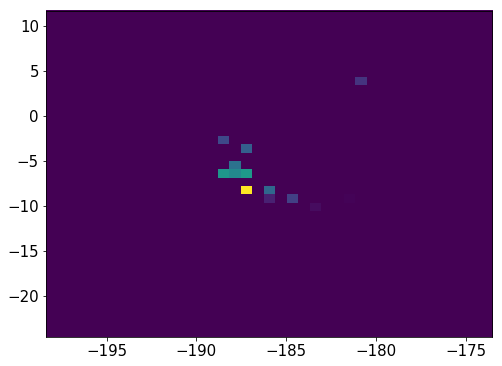

953079    24
953080    24
953081    24
953082    24
953083    24
953084    24
953085    24
953086    24
953087    24
953088    24
953089    24
953090    24
953091    24
953092    24
953093    24
953094    24
953095    24
953096    24
953097    24
953098    24
953099    24
953100    24
953101    24
953103    24
953105    24
953106    24
953107    24
953108    24
953109    24
953110    24
953111    24
953112    24
953113    24
953114    24
Name: Nsipm, dtype: uint16


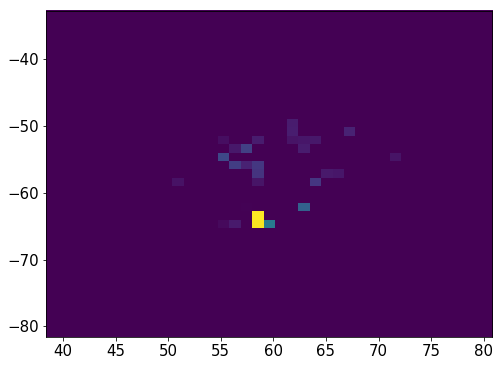

18158    24
18159    24
18160    24
18161    24
18162    24
18163    24
18164    24
18165    24
18166    24
18167    24
18168    24
18169    24
18170    24
18171    24
18172    24
18173    24
18174    24
18175    24
Name: Nsipm, dtype: uint16


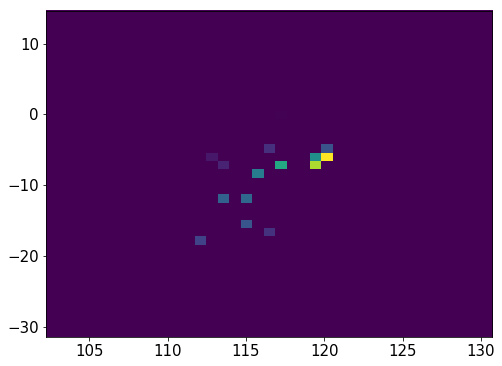

18181    22
18182    22
18183    22
18184    22
18185    22
18186    22
18187    22
18188    22
18189    22
18190    22
18191    22
18192    22
18193    22
18194    22
18195    22
18196    22
Name: Nsipm, dtype: uint16


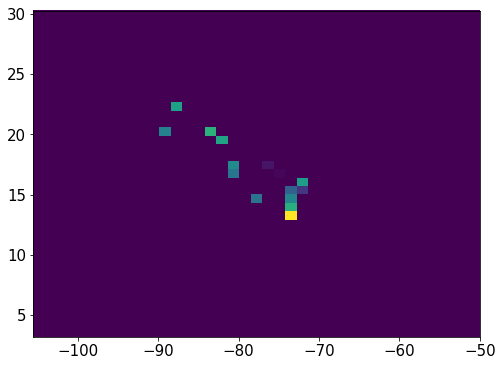

18202    23
18203    23
18204    23
18205    23
18206    23
18207    23
18208    23
18209    23
18210    23
18211    23
18212    23
18213    23
18214    23
18215    23
18216    23
18217    23
18218    23
18219    23
Name: Nsipm, dtype: uint16


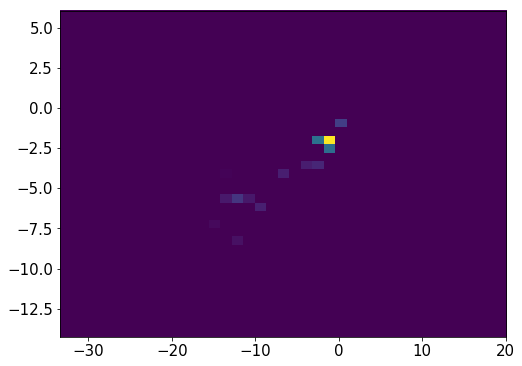

18224    29
18225    29
18226    29
18227    29
18228    29
18229    29
18230    29
18231    29
18232    29
18233    29
18234    29
Name: Nsipm, dtype: uint16


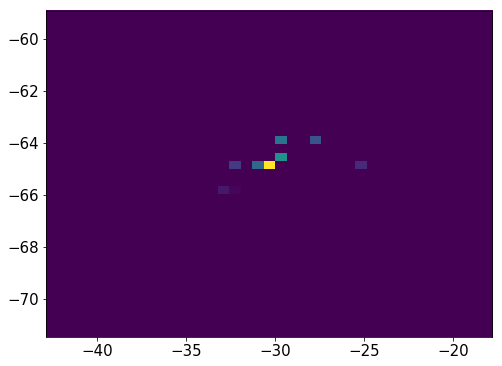

18238    33
18239    33
18240    33
18241    33
18242    33
18243    33
18244    33
18245    33
18246    33
18247    33
18248    33
18249    33
18250    33
18251    33
18252    33
18253    33
18254    33
18255    33
18256    33
Name: Nsipm, dtype: uint16


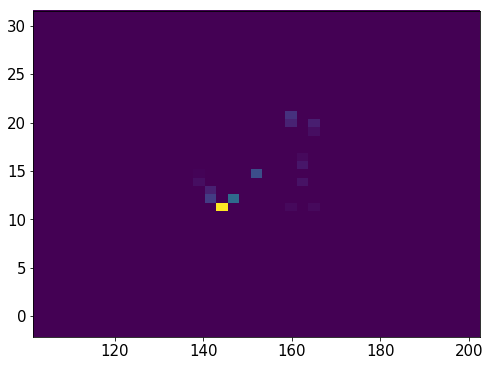

953150    23
953151    23
953152    23
953153    23
953154    23
953155    23
953156    23
953157    23
953158    23
953159    23
953160    23
953161    23
953162    23
953163    23
Name: Nsipm, dtype: uint16


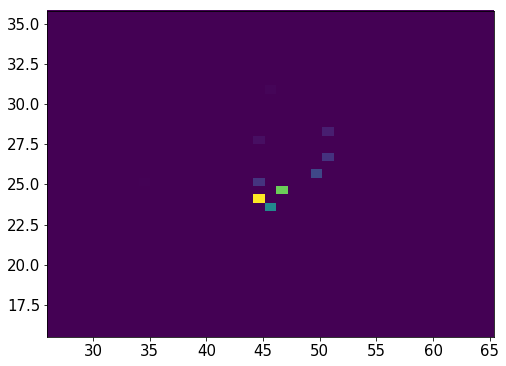

18262    19
18263    19
18264    19
18265    19
18266    19
18267    19
18268    19
18269    19
18270    19
18271    19
18272    19
18273    19
18274    19
18275    19
18276    19
18277    19
Name: Nsipm, dtype: uint16


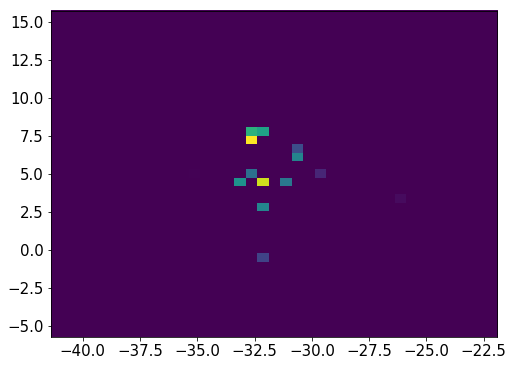

18282    23
18283    23
18284    23
18285    23
18286    23
18287    23
18288    23
18289    23
18290    23
18291    23
18292    23
18293    23
18294    23
18295    23
18296    23
18297    23
Name: Nsipm, dtype: uint16


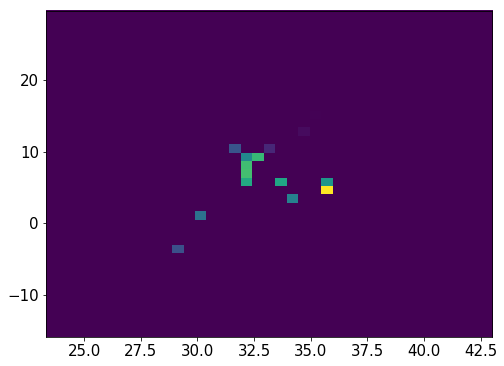

953169    22
953170    22
953171    22
953172    22
953173    22
953174    22
953175    22
953176    22
953177    22
953178    22
953179    22
953180    22
953181    22
953182    22
953183    22
953184    22
953185    22
953186    22
953187    22
953188    22
Name: Nsipm, dtype: uint16


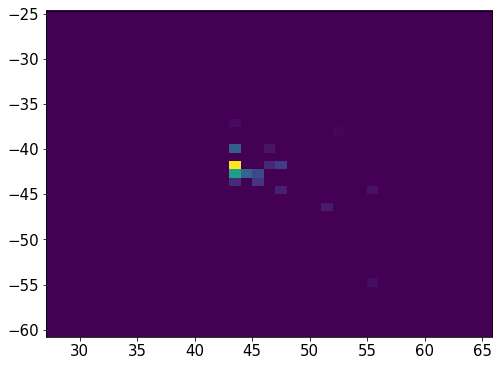

953193    32
953194    32
953195    32
953196    32
953197    32
953198    32
953199    32
953200    32
953201    32
953202    32
953203    32
953204    32
953205    32
953206    32
953207    32
953208    32
953209    32
953210    32
953211    32
953212    32
Name: Nsipm, dtype: uint16


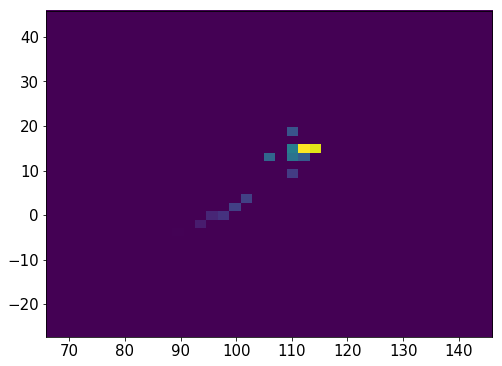

18303    20
18304    20
18305    20
18306    20
18307    20
18308    20
18309    20
18310    20
18311    20
18312    20
18313    20
18314    20
18315    20
18316    20
18317    20
Name: Nsipm, dtype: uint16


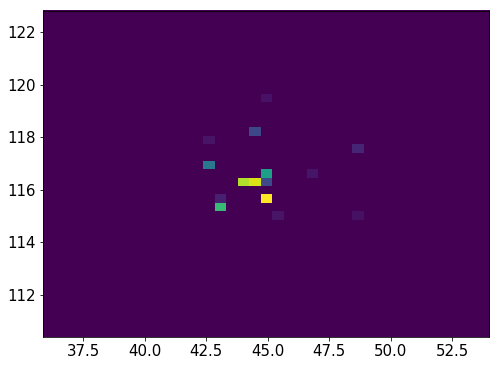

953219    22
953220    22
953221    22
953222    22
953223    22
953224    22
953225    22
953226    22
953227    22
953228    22
953229    22
953230    22
953231    22
Name: Nsipm, dtype: uint16


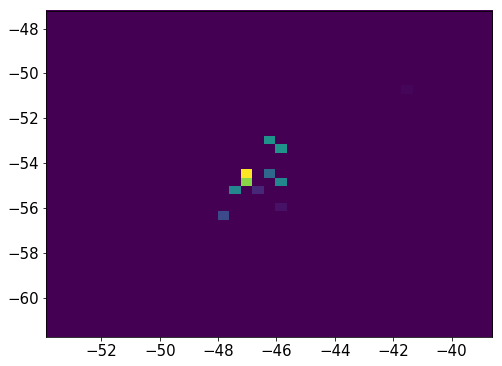

18320    22
18321    22
18322    22
18323    22
18324    22
18325    22
18326    22
18327    22
18328    22
18329    22
18330    22
18331    22
18332    22
18333    22
18334    22
18335    22
18336    22
18337    22
18338    22
18339    22
18340    22
18341    22
18342    22
18344    22
18345    22
18347    22
Name: Nsipm, dtype: uint16


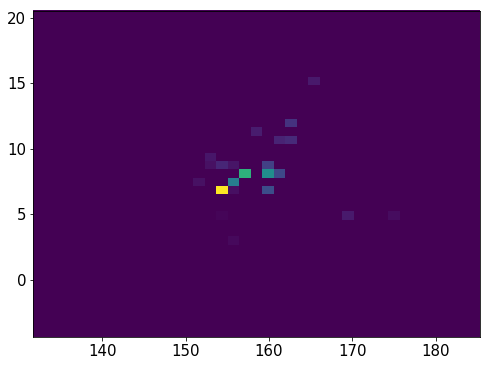

18352    21
18353    21
18354    21
18355    21
18356    21
18357    21
18358    21
18359    21
18360    21
18361    21
18362    21
18363    21
18364    21
18365    21
18366    21
18367    21
18368    21
18369    21
Name: Nsipm, dtype: uint16


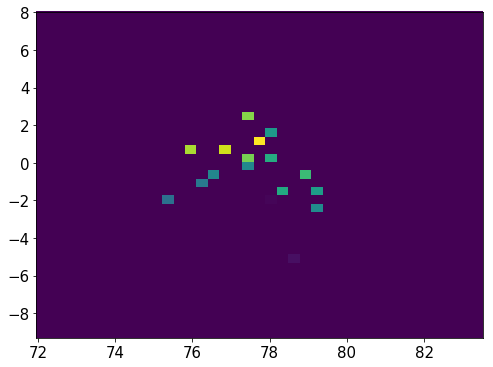

18374    26
18375    26
18376    26
18377    26
18378    26
18379    26
18380    26
18381    26
18382    26
18383    26
18384    26
18385    26
18386    26
18387    26
18388    26
18389    26
18390    26
18391    26
18392    26
18393    26
18394    26
18395    26
18396    26
18403     1
18404     1
18405     1
18406     1
Name: Nsipm, dtype: uint16


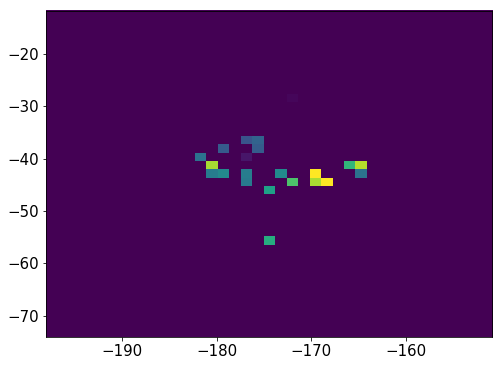

953258    39
953259    39
953260    39
953261    39
953262    39
953263    39
953264    39
953265    39
953266    39
953267    39
953268    39
953269    39
953270    39
953271    39
Name: Nsipm, dtype: uint16


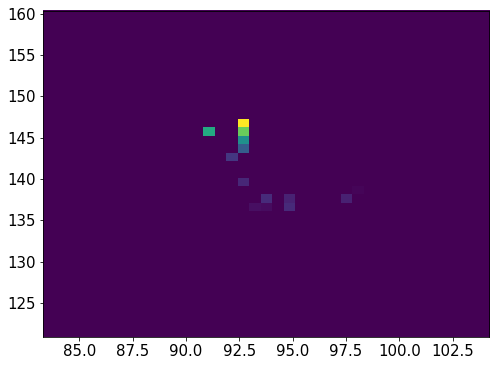

18415    27
18416    27
18417    27
18418    27
18419    27
18420    27
18421    27
18422    27
18423    27
18424    27
18425    27
18426    27
18427    27
18428    27
18429    27
Name: Nsipm, dtype: uint16


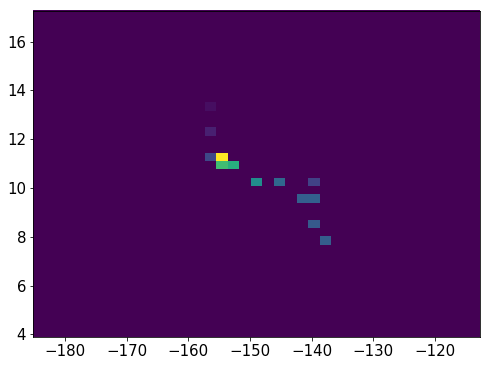

18434    34
18435    34
18436    34
18437    34
18438    34
18439    34
18440    34
18441    34
18442    34
18443    34
18444    34
18445    34
18446    34
18447    34
18448    34
18449    34
18450    34
18452    34
18453    34
18454    34
18455    34
18456    34
18457    34
18458    34
18459    34
18460    34
18461    34
18462    34
18463    34
18464    34
18465    34
18466    34
18467    34
18468    34
18469    34
18471    34
Name: Nsipm, dtype: uint16


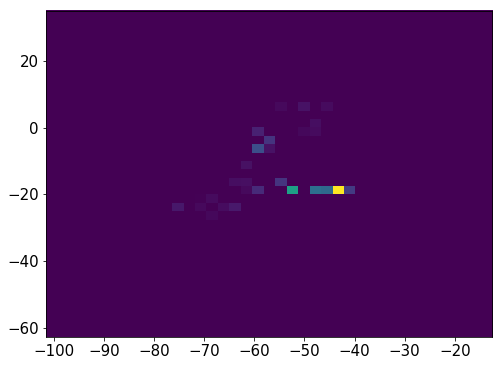

18476    28
18477    28
18478    28
18479    28
18480    28
18481    28
18482    28
18483    28
18484    28
18485    28
18486    28
18487    28
18488    28
18489    28
18490    28
18491    28
18492    28
18493    28
18494    28
18495    28
Name: Nsipm, dtype: uint16


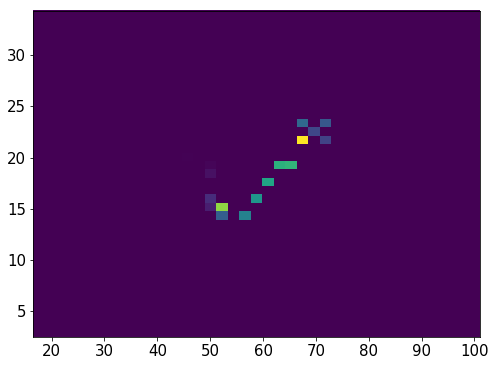

953277    23
953278    23
953279    23
953280    23
953281    23
953282    23
953283    23
953284    23
953285    23
953286    23
953287    23
953288    23
953289    23
953290    23
953291    23
953292    23
953293    23
953294    23
953295    23
953300     2
953301     2
953302     2
953303     2
953304     2
953306     2
Name: Nsipm, dtype: uint16


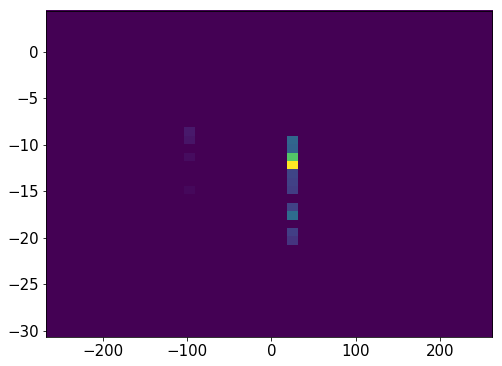

18501    19
18502    19
18503    19
18504    19
18505    19
18506    19
18507    19
18508    19
18509    19
18510    19
18511    19
18512    19
18513    19
18514    19
18515    19
18516    19
18517    19
18518    19
18519    19
18520    19
Name: Nsipm, dtype: uint16


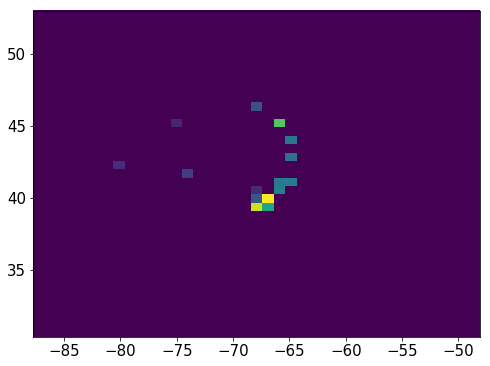

18525    31
18526    31
18527    31
18528    31
18529    31
18530    31
18531    31
18532    31
18533    31
18534    31
18535    31
18536    31
18537    31
18538    31
18539    31
18540    31
18541    31
18542    31
18543    31
18544    31
18545    31
18546    31
18547    31
Name: Nsipm, dtype: uint16


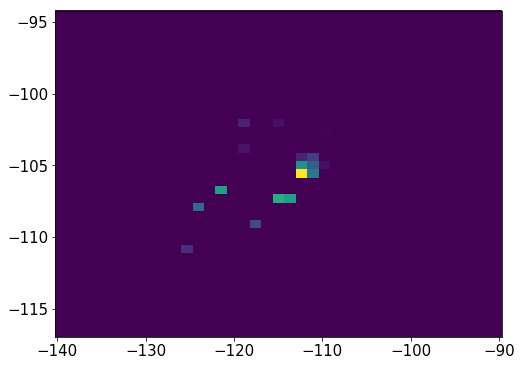

18548    31
18549    31
18550    31
18551    31
18552    31
18553    31
18554    31
18555    31
18556    31
18557    31
18558    31
18559    31
18560    31
18561    31
18562    31
18563    31
Name: Nsipm, dtype: uint16


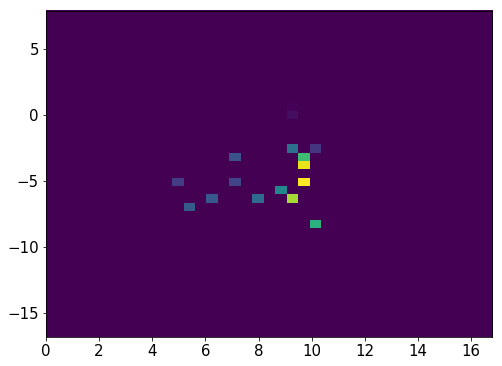

953353    23
953354    23
953355    23
953356    23
953357    23
953358    23
953359    23
953360    23
953361    23
953362    23
953363    23
953364    23
953365    23
953366    23
953367    23
953368    23
953369    23
953370    23
Name: Nsipm, dtype: uint16


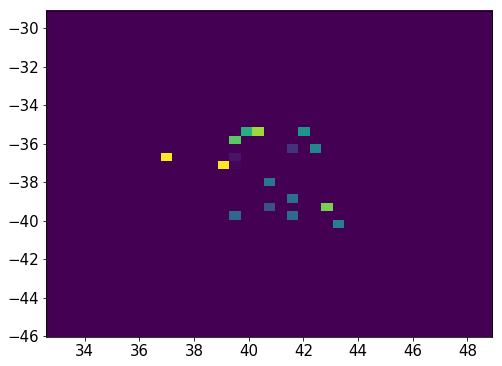

18569    20
18570    20
18571    20
18572    20
18573    20
18574    20
18575    20
18576    20
18577    20
18578    20
Name: Nsipm, dtype: uint16


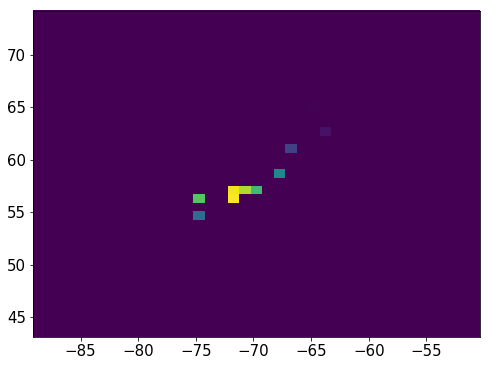

18582    27
18583    27
18584    27
18585    27
18586    27
18587    27
18588    27
18589    27
18590    27
18591    27
18592    27
18593    27
18594    27
18595    27
18596    27
18597    27
18598    27
18599    27
Name: Nsipm, dtype: uint16


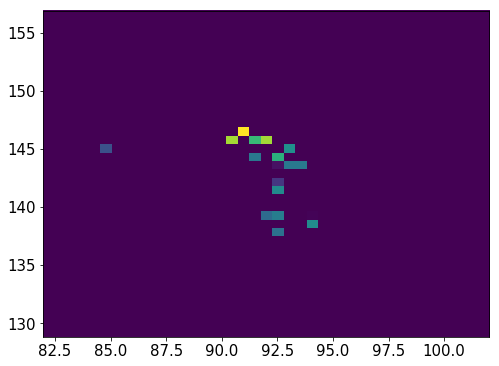

953392    31
953393    31
953394    31
953395    31
953396    31
953397    31
953398    31
953399    31
953400    31
953401    31
953402    31
953407    11
953408    11
953409    11
953410    11
953411    11
953412    11
953413    11
953414    11
953415    11
953416    11
Name: Nsipm, dtype: uint16


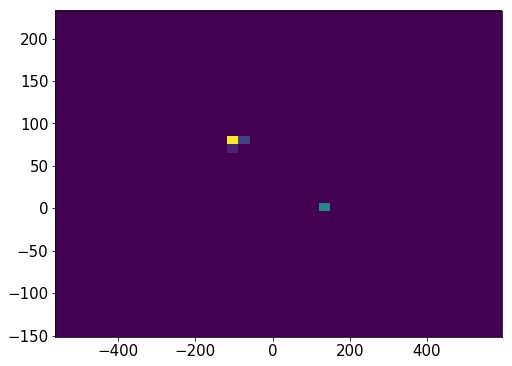

953423    40
953424    40
953425    40
953426    40
953427    40
953428    40
953429    40
953430    40
953431    40
953432    40
953433    40
953434    40
953435    40
953436    40
953437    40
953438    40
953439    40
Name: Nsipm, dtype: uint16


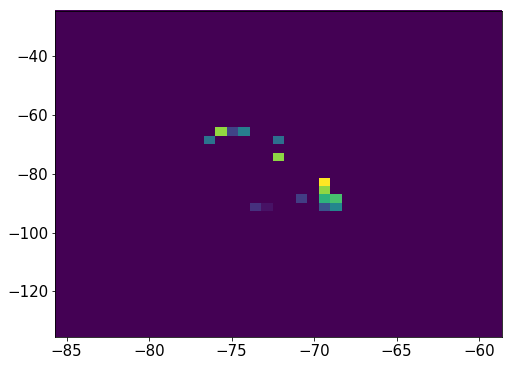

953444    11
953445    11
953446    11
953447    11
953448    11
953449    11
953451    11
953452    11
953453    11
953454    11
953455    11
953457    11
953458    11
953459    11
953460    11
Name: Nsipm, dtype: uint16


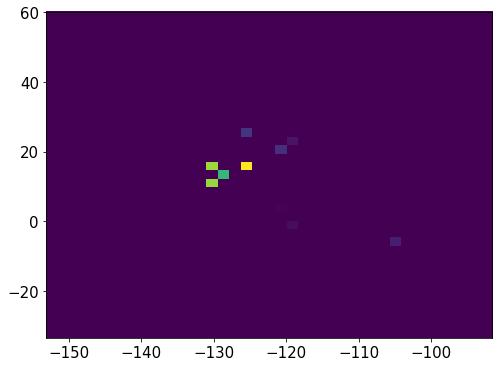

18604    24
18605    24
18606    24
18607    24
18608    24
18609    24
18610    24
18611    24
18612    24
18613    24
18614    24
18615    24
18616    24
18617    24
18618    24
18619    24
Name: Nsipm, dtype: uint16


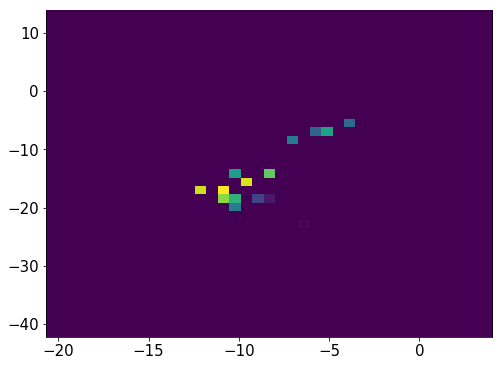

953461    32
953462    32
953463    32
953465    32
953466    32
953467    32
953468    32
953469    32
953470    32
953471    32
953472    32
953473    32
953474    32
953475    32
953476    32
953477    32
Name: Nsipm, dtype: uint16


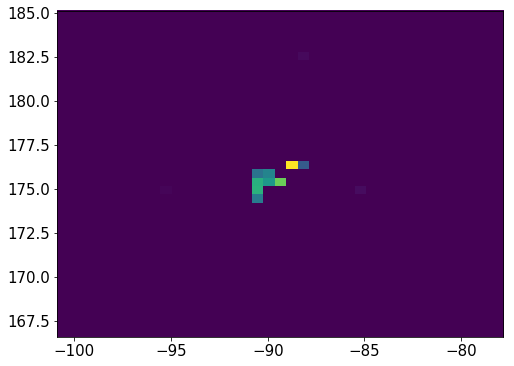

953481    21
953482    21
953483    21
953484    21
953485    21
953486    21
953487    21
953488    21
953489    21
953490    21
953491    21
953492    21
953493    21
953494    21
953495    21
953496    21
953499    21
953500    21
953501    21
953502    21
953503    21
953504    21
953505    21
953506    21
953507    21
953508    21
953511    21
953512    21
953513    21
953514    21
953515    21
953516    21
953519    21
Name: Nsipm, dtype: uint16


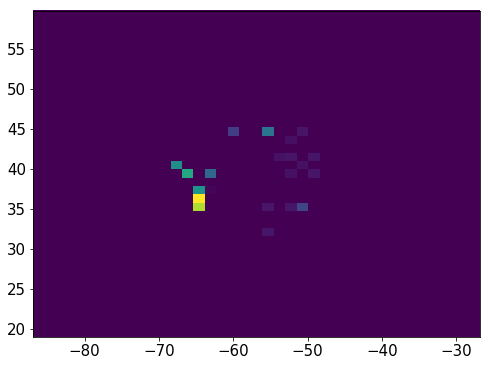

936550    32
936551    32
936552    32
936553    32
936554    32
936555    32
936556    32
936557    32
936558    32
936559    32
936560    32
936561    32
936562    32
936568     8
936569     8
936570     8
936571     8
936572     8
936573     8
936574     8
936575     8
936576     8
Name: Nsipm, dtype: uint16


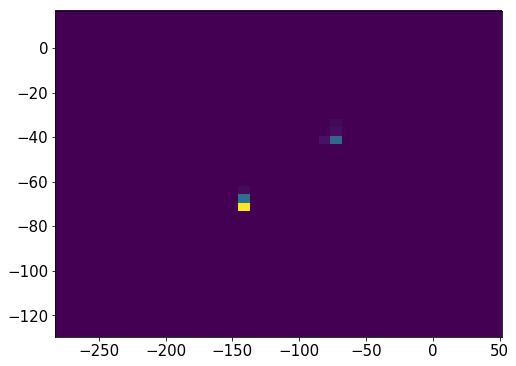

953527    23
953528    23
953529    23
953530    23
953531    23
953532    23
953533    23
953534    23
953535    23
953536    23
953537    23
953538    23
953539    23
953540    23
Name: Nsipm, dtype: uint16


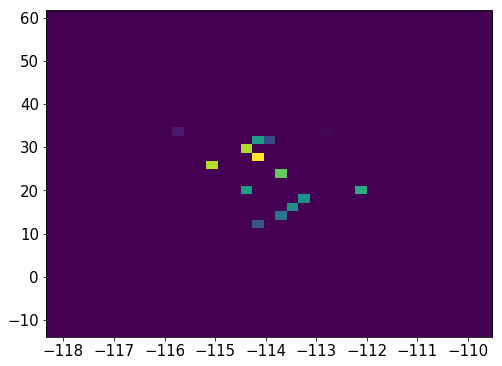

18625    18
18626    18
18627    18
18628    18
18629    18
18630    18
18631    18
18632    18
18633    18
18634    18
18635    18
18636    18
18637    18
18638    18
18642     3
18643     3
18644     3
18645     3
18646     3
18651     9
18652     9
18653     9
18654     9
18655     9
18656     9
18657     9
18658     9
18659     9
18660     9
18661     9
Name: Nsipm, dtype: uint16


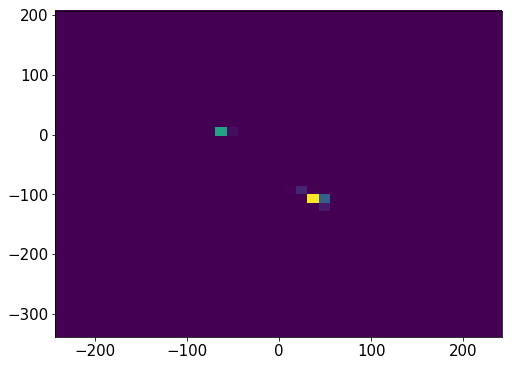

953577    26
953578    26
953579    26
953580    26
953581    26
953582    26
953583    26
953584    26
953585    26
953586    26
953587    26
953588    26
953589    26
953590    26
953591    26
953592    26
953593    26
953594    26
953595    26
953596    26
Name: Nsipm, dtype: uint16


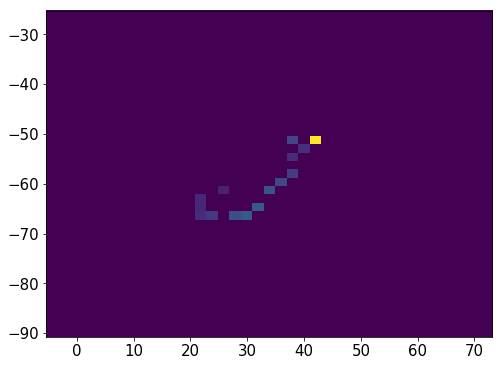

936580    22
936581    22
936582    22
936583    22
936584    22
936585    22
936586    22
936587    22
936588    22
936589    22
936590    22
936591    22
936592    22
936593    22
936594    22
936595    22
936596    22
936597    22
936598    22
936599    22
936600    22
936601    22
936602    22
936603    22
Name: Nsipm, dtype: uint16


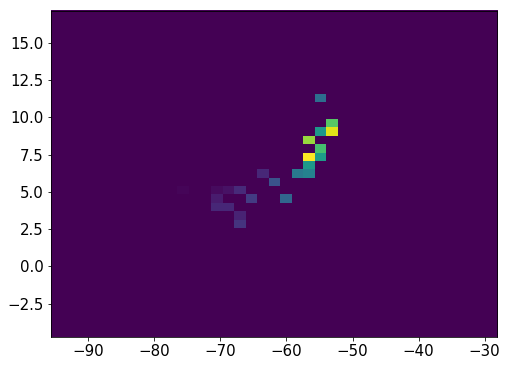

18665    21
18666    21
18667    21
18668    21
18669    21
18670    21
18671    21
18672    21
18673    21
18674    21
18675    21
18676    21
18677    21
18678    21
18679    21
18680    21
18681    21
18682    21
18683    21
18684    21
18685    21
18686    21
18688    21
18689    21
Name: Nsipm, dtype: uint16


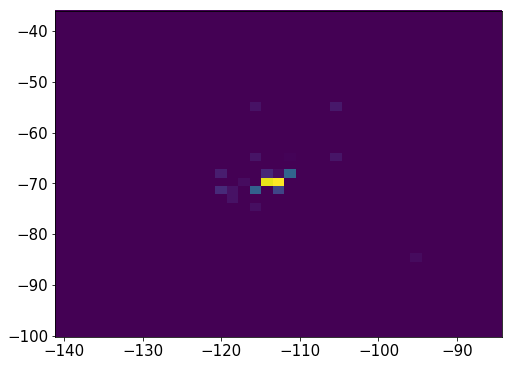

953615    21
953616    21
953617    21
953618    21
953619    21
953620    21
953621    21
953622    21
953623    21
953624    21
953625    21
953626    21
953627    21
953628    21
953629    21
953630    21
953631    21
Name: Nsipm, dtype: uint16


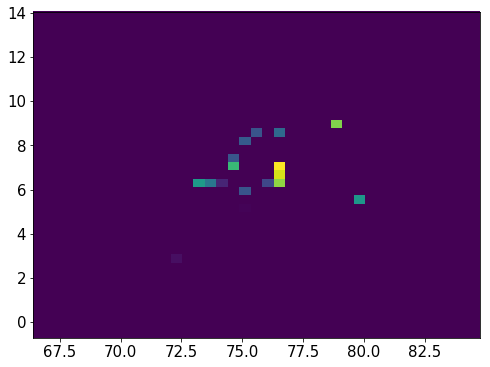

18701    36
18702    36
18703    36
18704    36
18705    36
18706    36
18707    36
18708    36
18709    36
18710    36
18711    36
18715    36
18716    36
18717    36
18718    36
18719    36
18720    36
18721    36
18722    36
18723    36
18724    36
18725    36
18726    36
18727    36
18728    36
18729    36
Name: Nsipm, dtype: uint16


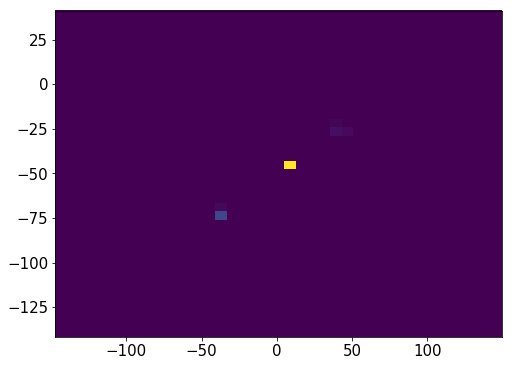

18733    24
18734    24
18735    24
18736    24
18737    24
18738    24
18739    24
18740    24
18741    24
18742    24
18743    24
18744    24
18745    24
18746    24
Name: Nsipm, dtype: uint16


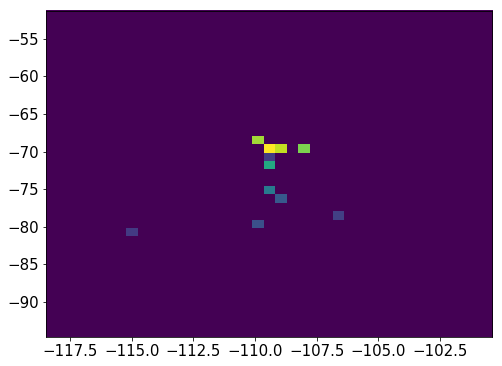

953635    22
953636    22
953637    22
953638    22
953639    22
953640    22
953641    22
953642    22
953643    22
953644    22
953645    22
953646    22
953647    22
953648    22
953649    22
Name: Nsipm, dtype: uint16


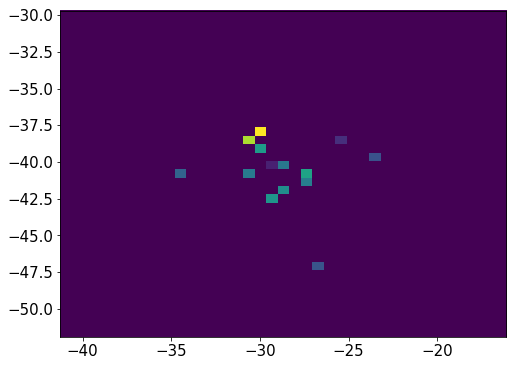

18751    27
18752    27
18753    27
18754    27
18755    27
18756    27
18757    27
18758    27
18759    27
18760    27
18761    27
18762    27
18763    27
18764    27
18765    27
18766    27
18767    27
18768    27
Name: Nsipm, dtype: uint16


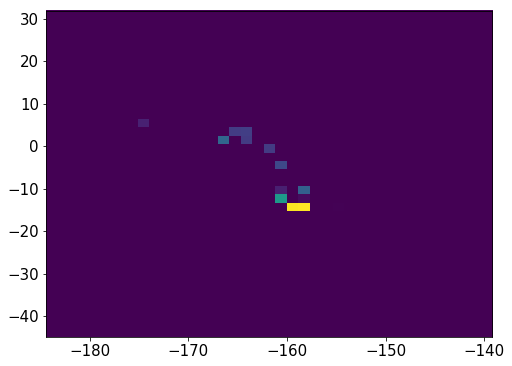

18773    28
18774    28
18775    28
18776    28
18777    28
18778    28
18779    28
18780    28
18781    28
18782    28
18783    28
18784    28
18785    28
18786    28
18787    28
18788    28
18789    28
Name: Nsipm, dtype: uint16


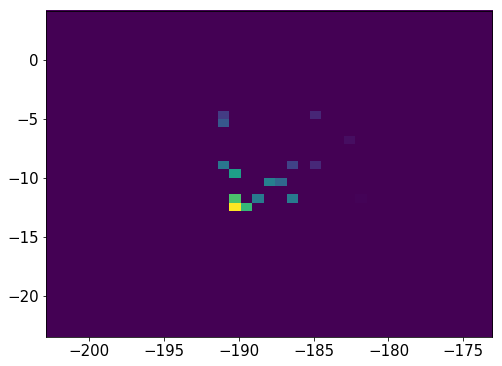

953670    22
953671    22
953672    22
953673    22
953674    22
953675    22
953676    22
953677    22
953678    22
953679    22
953680    22
953681    22
953682    22
953683    22
953684    22
953685    22
953686    22
953687    22
953688    22
953689    22
Name: Nsipm, dtype: uint16


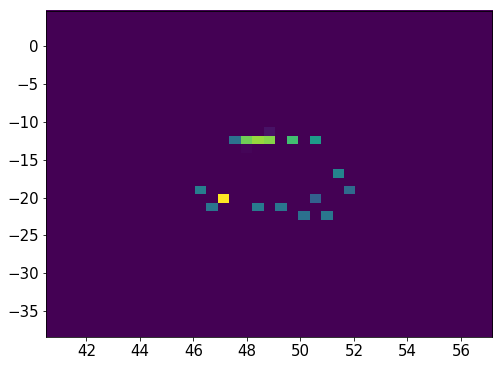

18795    30
18796    30
18797    30
18798    30
18799    30
18800    30
18801    30
18802    30
18803    30
18804    30
18805    30
18806    30
18807    30
18808    30
18809    30
Name: Nsipm, dtype: uint16


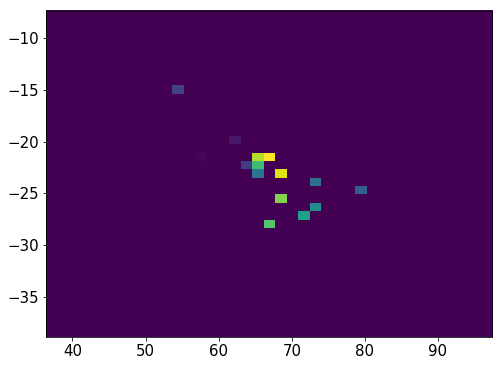

953694    29
953695    29
953696    29
953697    29
953698    29
953699    29
953700    29
953701    29
953702    29
953703    29
953704    29
953705    29
953706    29
953707    29
953708    29
Name: Nsipm, dtype: uint16


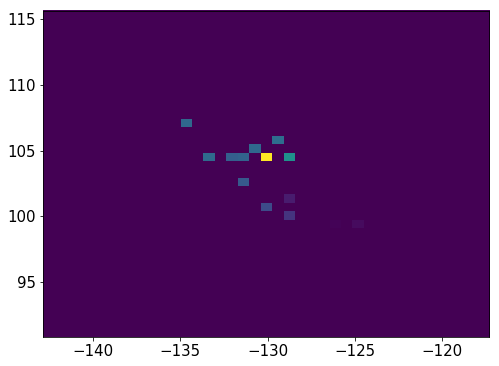

953713    24
953714    24
953715    24
953716    24
953717    24
953718    24
953719    24
953720    24
953721    24
953722    24
953723    24
953724    24
Name: Nsipm, dtype: uint16


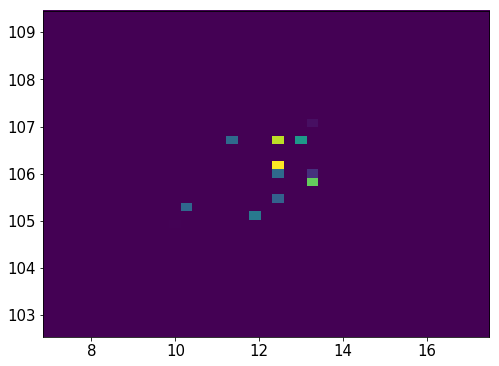

640525    30
640526    30
640527    30
640528    30
640529    30
640530    30
640531    30
640532    30
640533    30
640534    30
640535    30
640536    30
640537    30
640538    30
640539    30
640540    30
640541    30
Name: Nsipm, dtype: uint16


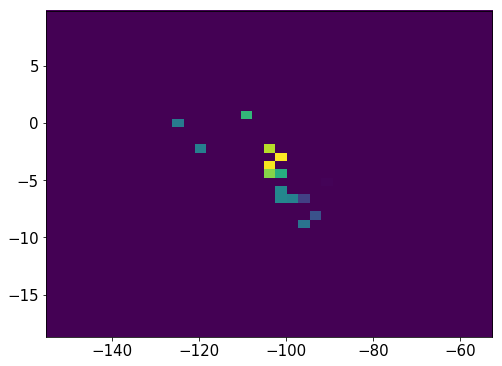

953728    26
953729    26
953730    26
953731    26
953732    26
953733    26
953734    26
953735    26
953736    26
953737    26
953738    26
953741    26
953742    26
953743    26
953744    26
953745    26
Name: Nsipm, dtype: uint16


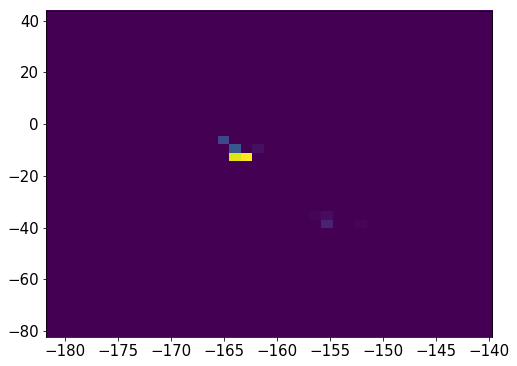

18822    26
18823    26
18824    26
18825    26
18826    26
18827    26
18828    26
18829    26
18830    26
18831    26
18832    26
18833    26
18834    26
18835    26
18836    26
18837    26
18838    26
18839    26
18840    26
18841    26
18842    26
Name: Nsipm, dtype: uint16


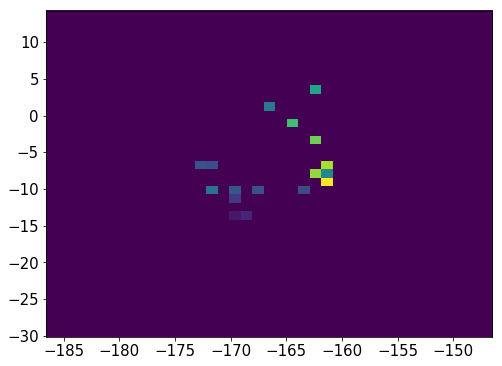

953750    34
953751    34
953752    34
953753    34
953754    34
953755    34
953756    34
953757    34
953758    34
953759    34
953760    34
953761    34
953762    34
953763    34
953764    34
953765    34
953766    34
953767    34
953768    34
953769    34
953770    34
Name: Nsipm, dtype: uint16


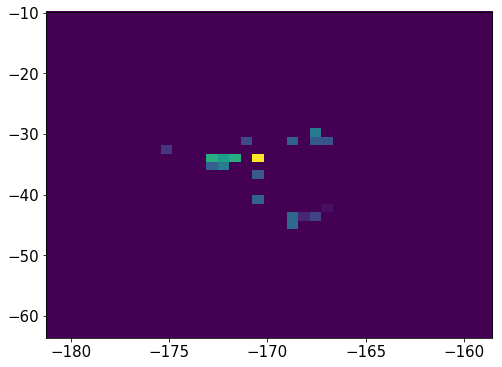

18847    24
18848    24
18849    24
18850    24
18851    24
18852    24
18853    24
18854    24
18855    24
18856    24
18857    24
18858    24
18859    24
18860    24
18861    24
18862    24
18863    24
18868    24
18869    24
18870    24
Name: Nsipm, dtype: uint16


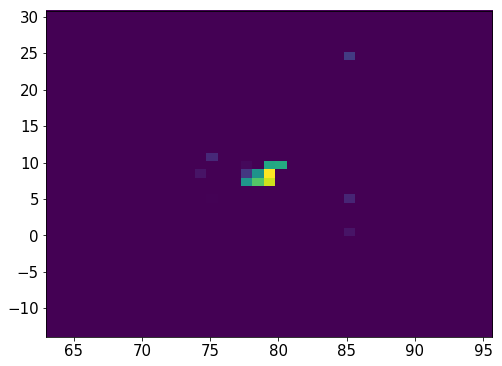

953804    27
953805    27
953806    27
953807    27
953808    27
953809    27
953810    27
953811    27
953812    27
953813    27
953814    27
953815    27
953816    27
953817    27
953818    27
953819    27
953820    27
Name: Nsipm, dtype: uint16


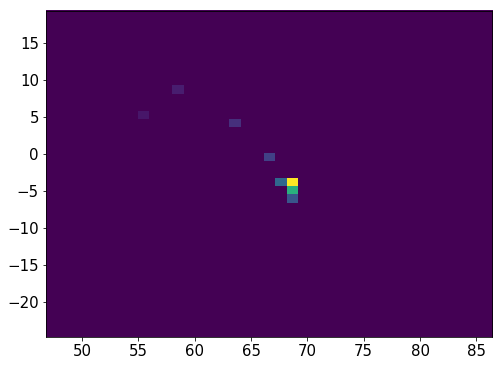

953826    23
953827    23
953828    23
953829    23
953830    23
953831    23
953832    23
953833    23
953834    23
953835    23
953836    23
953837    23
953838    23
953839    23
953840    23
953841    23
953842    23
953843    23
953844    23
953845    23
953846    23
953847    23
953848    23
Name: Nsipm, dtype: uint16


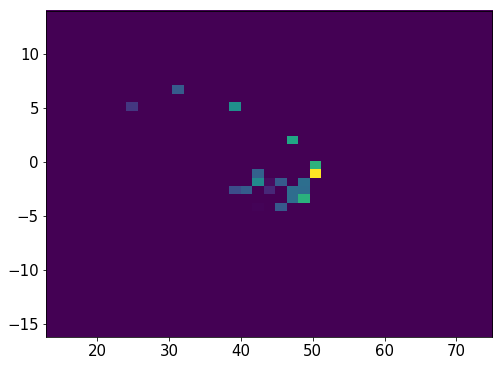

953855    23
953856    23
953857    23
953858    23
953859    23
953860    23
953861    23
953862    23
953863    23
953864    23
953865    23
Name: Nsipm, dtype: uint16


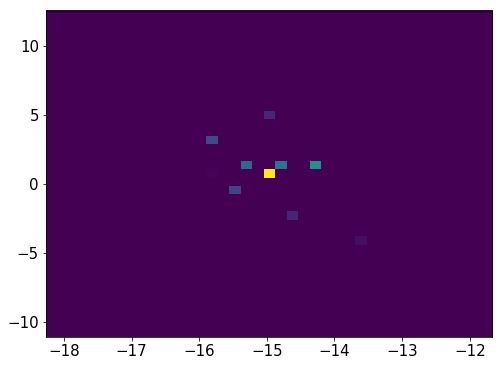

953869    46
953870    46
953871    46
953872    46
953873    46
953874    46
953875    46
953876    46
953877    46
953878    46
953879    46
953880    46
953881    46
953882    46
953883    46
953884    46
953885    46
953886    46
Name: Nsipm, dtype: uint16


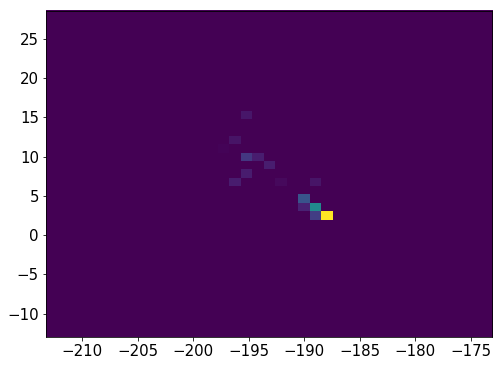

18875    32
18876    32
18877    32
18878    32
18879    32
18880    32
18881    32
18882    32
18883    32
18884    32
18885    32
18886    32
18887    32
18888    32
18889    32
18895    32
18896    32
18897    32
18898    32
18899    32
18900    32
18901    32
Name: Nsipm, dtype: uint16


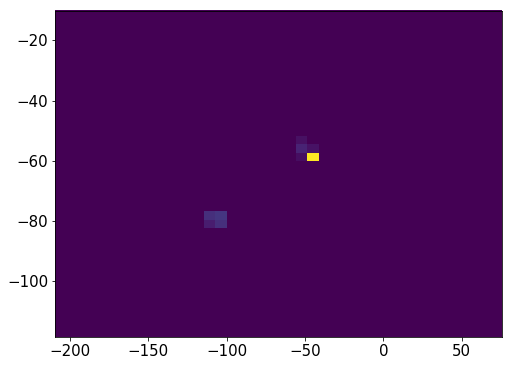

953890    29
953891    29
953892    29
953893    29
953894    29
953895    29
953896    29
953897    29
953898    29
953899    29
953900    29
953901    29
953902    29
953903    29
953904    29
Name: Nsipm, dtype: uint16


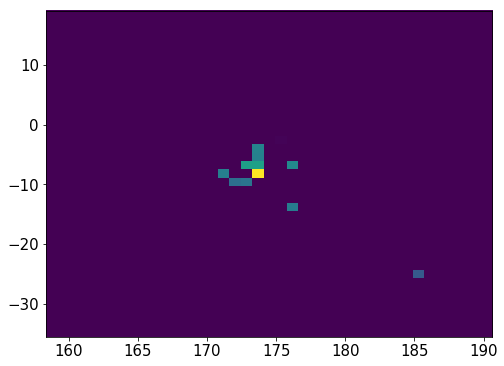

18902    24
18903    24
18904    24
18905    24
18906    24
18907    24
18908    24
18909    24
18910    24
18911    24
18912    24
18913    24
18914    24
18915    24
18916    24
18917    24
18918    24
18919    24
18920    24
18921    24
Name: Nsipm, dtype: uint16


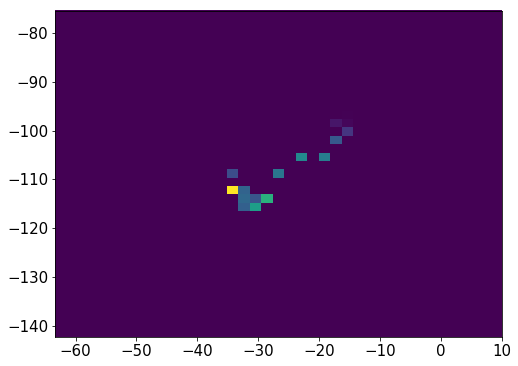

18926    24
18927    24
18928    24
18929    24
18930    24
18931    24
18932    24
18933    24
18934    24
18935    24
18936    24
18937    24
18938    24
18939    24
18940    24
18941    24
18942    24
18943    24
Name: Nsipm, dtype: uint16


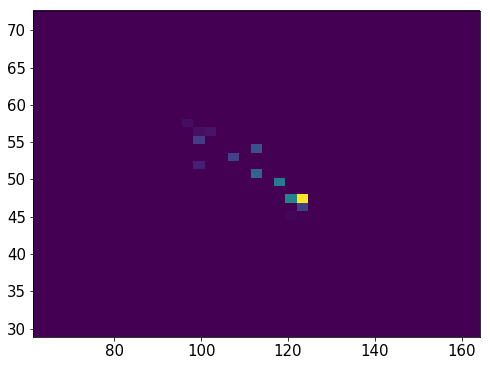

18948    27
18949    27
18950    27
18951    27
18952    27
18953    27
18954    27
18955    27
18956    27
18957    27
18958    27
18959    27
18960    27
18961    27
18962    27
18963    27
Name: Nsipm, dtype: uint16


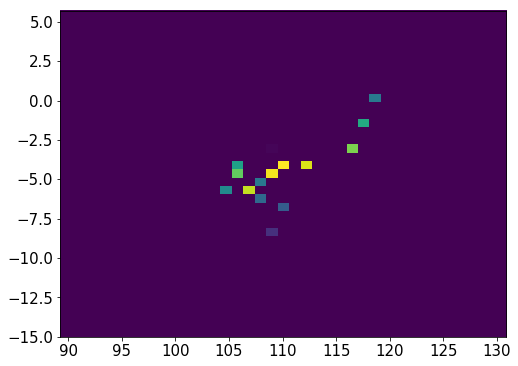

953909    24
953910    24
953911    24
953912    24
953913    24
953914    24
953915    24
953916    24
953917    24
953918    24
953919    24
953920    24
Name: Nsipm, dtype: uint16


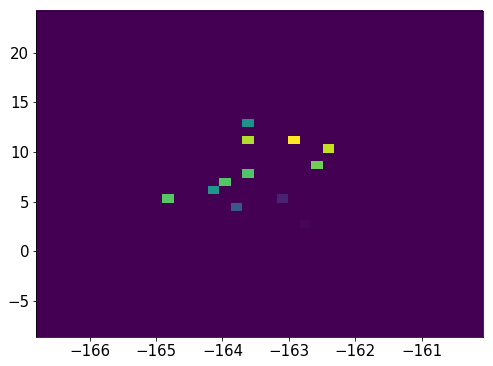

18969    29
18970    29
18971    29
18972    29
18973    29
18974    29
18975    29
18976    29
18977    29
18978    29
18979    29
18980    29
18981    29
18982    29
18983    29
18984    29
18985    29
Name: Nsipm, dtype: uint16


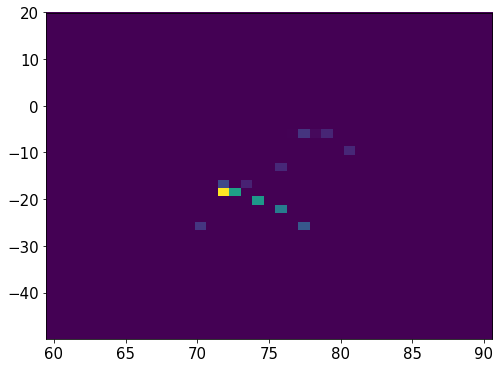

953925    26
953926    26
953927    26
953928    26
953929    26
953930    26
953931    26
953932    26
953933    26
953934    26
953935    26
953936    26
953937    26
953938    26
953939    26
953940    26
953941    26
953942    26
953943    26
953944    26
953945    26
953946    26
953947    26
953948    26
953949    26
953950    26
953951    26
953952    26
953953    26
953954    26
953955    26
953956    26
953957    26
953958    26
Name: Nsipm, dtype: uint16


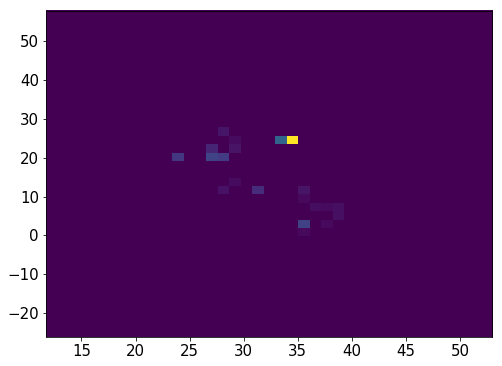

18990    26
18991    26
18992    26
18993    26
18994    26
18995    26
18996    26
18997    26
18998    26
18999    26
19000    26
19001    26
19002    26
19003    26
19004    26
19005    26
19006    26
19007    26
19008    26
19009    26
19010    26
19011    26
19012    26
19013    26
19014    26
19015    26
19016    26
19017    26
Name: Nsipm, dtype: uint16


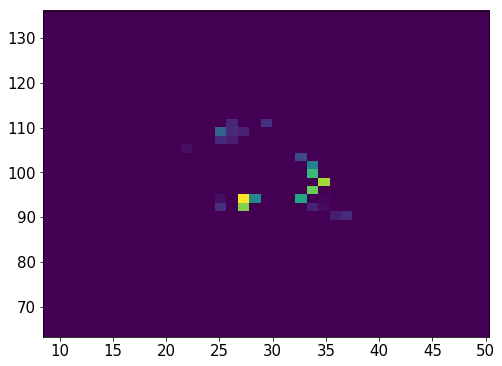

953963    25
953964    25
953965    25
953966    25
953967    25
953968    25
953969    25
953970    25
953971    25
953972    25
953973    25
953974    25
953975    25
953976    25
953977    25
953978    25
953979    25
953980    25
Name: Nsipm, dtype: uint16


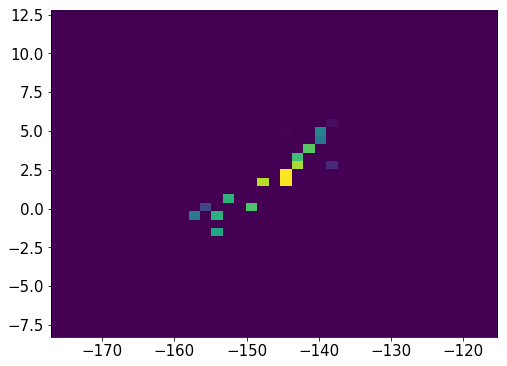

19020    19
19021    19
19022    19
19023    19
19024    19
19025    19
19026    19
19027    19
19028    19
19029    19
19030    19
19031    19
19032    19
19033    19
19034    19
19035    19
19036    19
19037    19
19038    19
19039    19
19044     1
19045     1
19046     1
19047     1
19048     1
Name: Nsipm, dtype: uint16


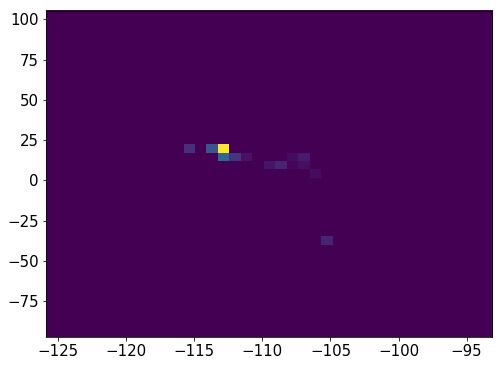

19054    28
19055    28
19056    28
19057    28
19058    28
19059    28
19060    28
19061    28
19062    28
19063    28
19064    28
19065    28
19066    28
19067    28
19068    28
19069    28
19070    28
Name: Nsipm, dtype: uint16


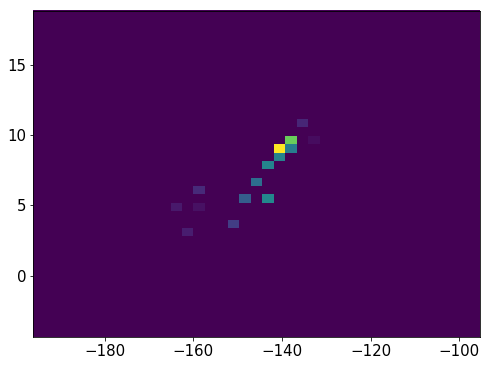

19075    41
19076    41
19078    41
19079    41
19080    41
19081    41
19082    41
19083    41
19084    41
19085    41
19086    41
19087    41
19088    41
19089    41
19090    41
19091    41
Name: Nsipm, dtype: uint16


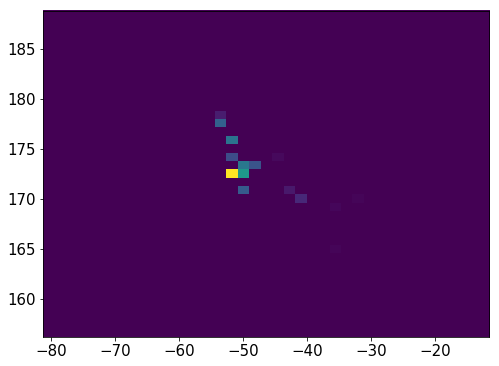

954038    39
954039    39
954040    39
954041    39
954042    39
954043    39
954044    39
954045    39
954046    39
954047    39
954048    39
954049    39
954050    39
954051    39
954052    39
954053    39
954058    39
954059    39
954060    39
954061    39
Name: Nsipm, dtype: uint16


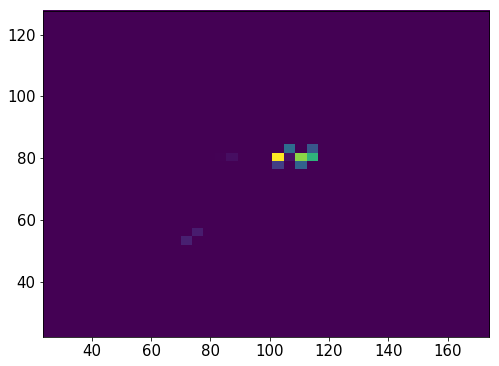

954062    19
954063    19
954064    19
954065    19
954066    19
954067    19
954068    19
954069    19
954070    19
954071    19
954072    19
954073    19
954077    13
954078    13
954079    13
954080    13
954081    13
954082    13
954083    13
Name: Nsipm, dtype: uint16


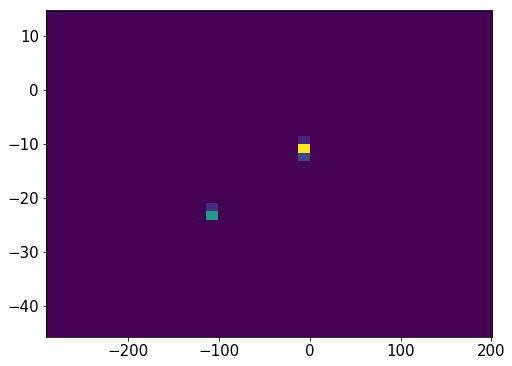

954087    29
954088    29
954089    29
954090    29
954091    29
954092    29
954093    29
954094    29
954095    29
954096    29
954097    29
954098    29
954099    29
954100    29
Name: Nsipm, dtype: uint16


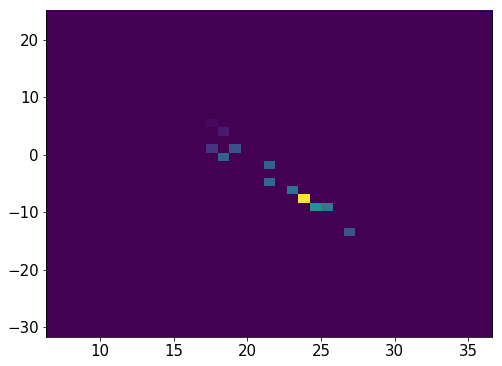

954105    31
954106    31
954107    31
954108    31
954109    31
954110    31
954111    31
954112    31
954113    31
954114    31
954115    31
954116    31
954117    31
954118    31
954119    31
954120    31
954121    31
954122    31
954123    31
954124    31
954125    31
954126    31
954127    31
Name: Nsipm, dtype: uint16


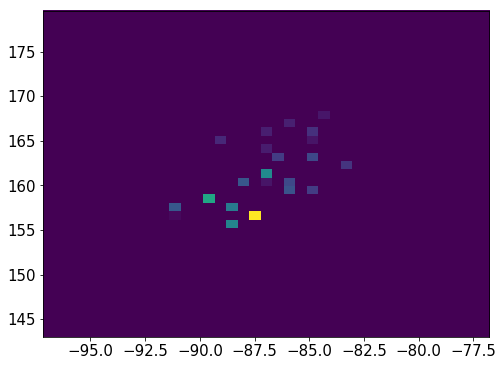

19095    20
19096    20
19097    20
19098    20
19099    20
19100    20
19101    20
19102    20
19103    20
19104    20
19105    20
19106    20
19107    20
19108    20
19109    20
19110    20
19111    20
19112    20
19113    20
19114    20
19115    20
19116    20
19117    20
Name: Nsipm, dtype: uint16


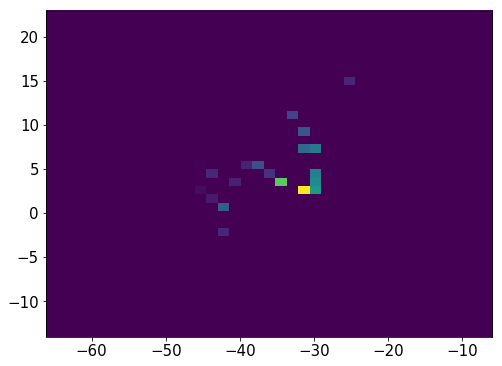

19121    33
19122    33
19123    33
19124    33
19125    33
19126    33
19127    33
19128    33
19129    33
19130    33
19131    33
19132    33
19133    33
19134    33
19135    33
19136    33
19137    33
19138    33
19139    33
19140    33
19141    33
19142    33
19143    33
19144    33
Name: Nsipm, dtype: uint16


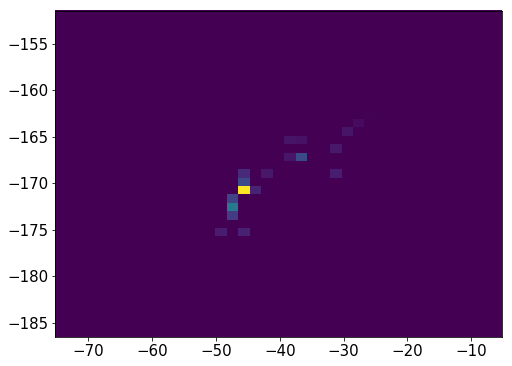

19149    29
19150    29
19151    29
19152    29
19153    29
19155    29
19156    29
19157    29
19158    29
19159    29
19160    29
19161    29
19162    29
19163    29
19164    29
19165    29
19166    29
19167    29
19168    29
19169    29
19170    29
19171    29
Name: Nsipm, dtype: uint16


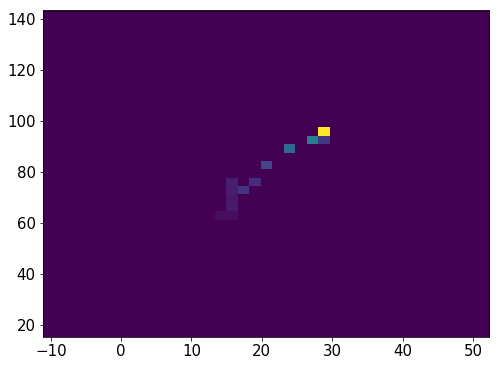

19173    27
19174    27
19175    27
19176    27
19177    27
19178    27
19179    27
19180    27
19181    27
19182    27
19183    27
19184    27
19185    27
19186    27
19187    27
19188    27
19189    27
Name: Nsipm, dtype: uint16


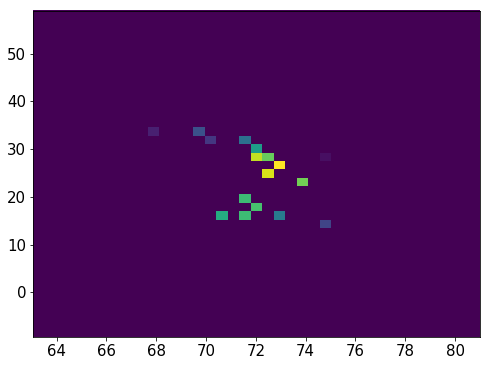

19193    31
19194    31
19195    31
19196    31
19197    31
19198    31
19199    31
19200    31
19201    31
19202    31
19203    31
19204    31
19205    31
19206    31
19207    31
Name: Nsipm, dtype: uint16


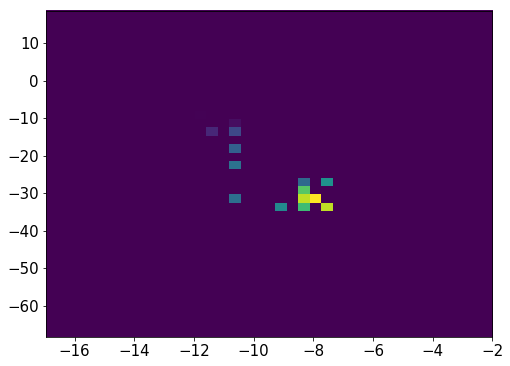

19212    33
19213    33
19214    33
19215    33
19216    33
19217    33
19218    33
19219    33
19220    33
19221    33
19222    33
19223    33
Name: Nsipm, dtype: uint16


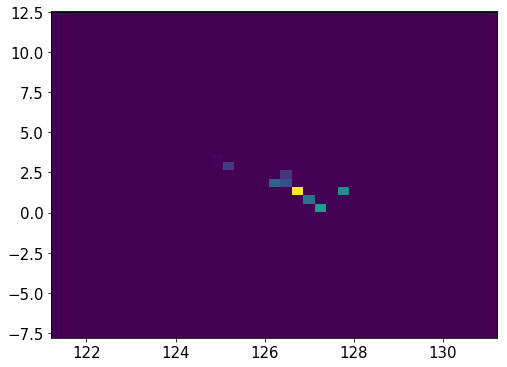

19227    26
19228    26
19229    26
19230    26
19231    26
19232    26
19233    26
19234    26
19235    26
19236    26
19237    26
Name: Nsipm, dtype: uint16


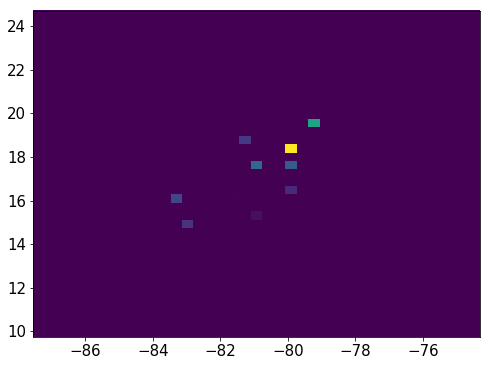

19242    33
19243    33
19244    33
19245    33
19246    33
19247    33
19248    33
19249    33
19250    33
19251    33
19252    33
19253    33
19254    33
19255    33
Name: Nsipm, dtype: uint16


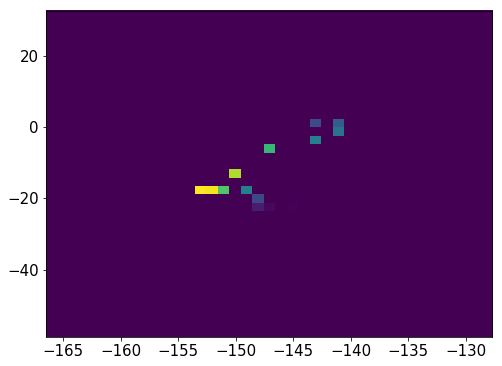

19261    22
19262    22
19263    22
19264    22
19265    22
19266    22
19267    22
19268    22
19269    22
19270    22
19271    22
19272    22
19273    22
19274    22
19275    22
19276    22
19277    22
19278    22
19279    22
19280    22
Name: Nsipm, dtype: uint16


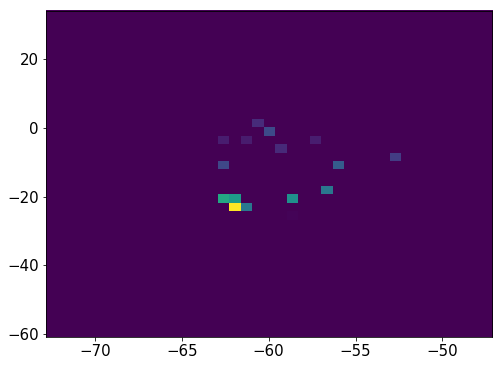

954191    23
954192    23
954193    23
954194    23
954195    23
954196    23
954197    23
954198    23
954199    23
954200    23
954201    23
954202    23
954203    23
954204    23
954205    23
954206    23
954207    23
954208    23
Name: Nsipm, dtype: uint16


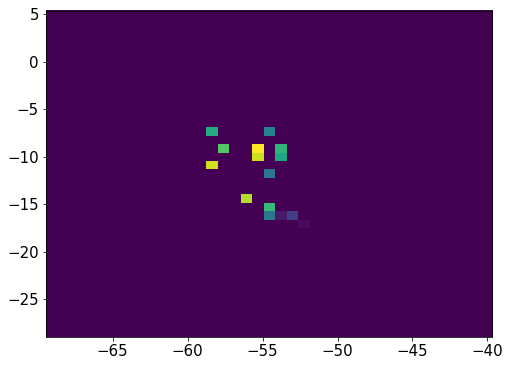

936723    30
936724    30
936725    30
936726    30
936727    30
936728    30
936729    30
936730    30
936731    30
936732    30
936733    30
936734    30
936735    30
936736    30
936737    30
936738    30
936739    30
936740    30
Name: Nsipm, dtype: uint16


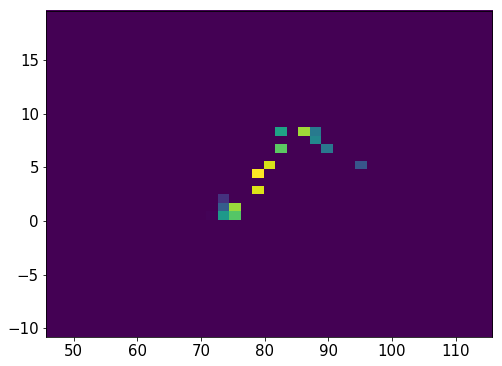

19286    23
19287    23
19288    23
19289    23
19290    23
19291    23
19292    23
19293    23
19294    23
19295    23
19296    23
19297    23
19298    23
19299    23
19300    23
19301    23
19302    23
19303    23
19304    23
19305    23
19306    23
19307    23
19308    23
19309    23
19310    23
19311    23
19312    23
19313    23
19314    23
19315    23
19316    23
19317    23
Name: Nsipm, dtype: uint16


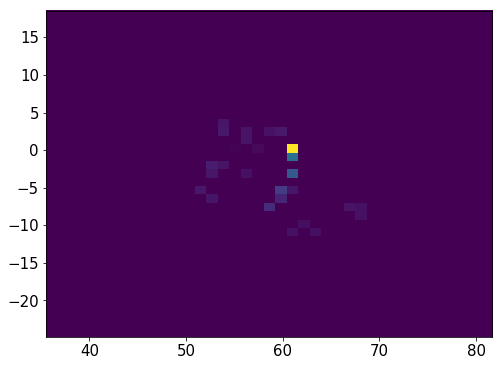

19324    27
19325    27
19326    27
19327    27
19328    27
19329    27
19330    27
19331    27
19332    27
19333    27
19334    27
19335    27
19336    27
19337    27
19338    27
19339    27
19340    27
19341    27
19342    27
19343    27
19344    27
19345    27
19346    27
19347    27
19348    27
19349    27
19350    27
19351    27
Name: Nsipm, dtype: uint16


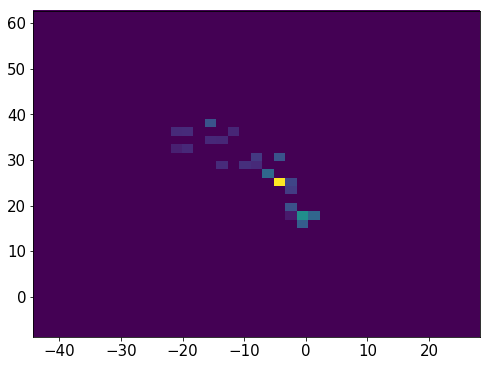

954263    23
954264    23
954265    23
954266    23
954267    23
954268    23
954269    23
954270    23
954271    23
954272    23
954273    23
954274    23
954277    23
954278    23
954279    23
Name: Nsipm, dtype: uint16


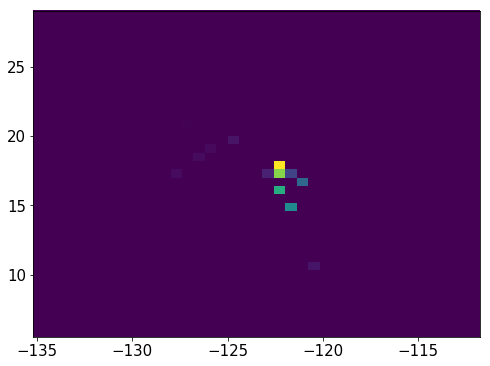

954285    30
954286    30
954287    30
954288    30
954289    30
954290    30
954291    30
954292    30
954293    30
954294    30
954295    30
954296    30
954297    30
954298    30
954299    30
954300    30
954301    30
954302    30
954303    30
954304    30
954305    30
954306    30
954307    30
954308    30
954309    30
954310    30
954311    30
954312    30
954313    30
954315    30
954321    30
954322    30
954325    30
954326    30
954327    30
954328    30
954329    30
954330    30
954331    30
954332    30
954333    30
954334    30
954335    30
954336    30
954337    30
954338    30
Name: Nsipm, dtype: uint16


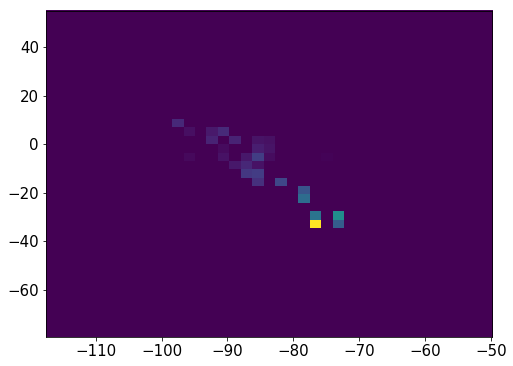

19356    25
19357    25
19358    25
19359    25
19360    25
19361    25
19362    25
19363    25
19364    25
19365    25
19366    25
19367    25
19368    25
19369    25
19370    25
19371    25
19372    25
19373    25
19374    25
19375    25
Name: Nsipm, dtype: uint16


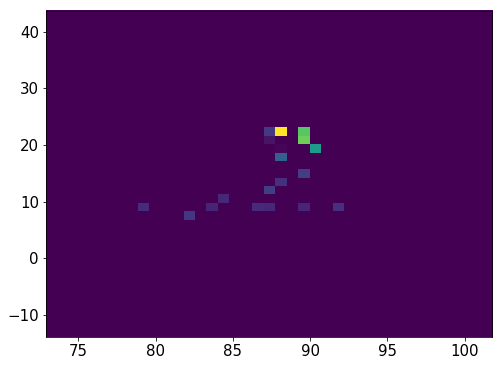

19380    23
19381    23
19382    23
19383    23
19384    23
19385    23
19386    23
19387    23
19388    23
19389    23
19390    23
19391    23
19392    23
19393    23
19394    23
19395    23
19396    23
19397    23
19398    23
19402     1
19403     1
19404     1
19405     1
19406     1
Name: Nsipm, dtype: uint16


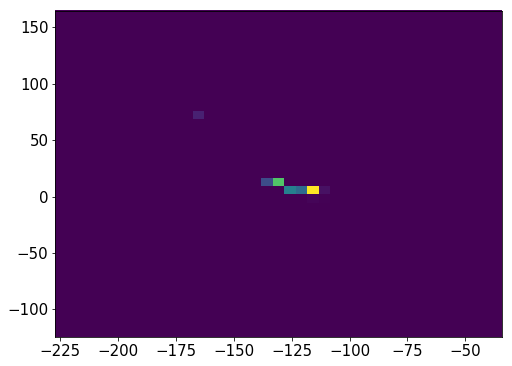

19412    23
19413    23
19414    23
19415    23
19416    23
19417    23
19418    23
19419    23
19420    23
19421    23
19422    23
19423    23
19424    23
19425    23
Name: Nsipm, dtype: uint16


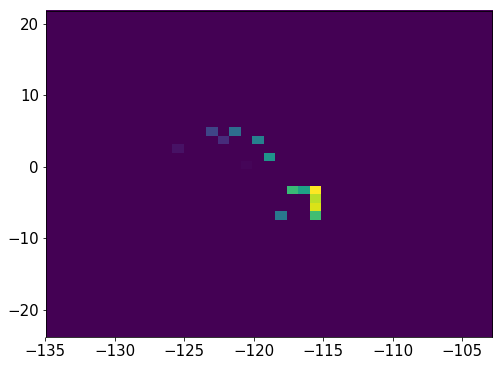

954395    28
954396    28
954397    28
954398    28
954399    28
954400    28
954401    28
954402    28
954403    28
954404    28
954405    28
954406    28
954407    28
954408    28
954409    28
954410    28
954411    28
954412    28
954413    28
Name: Nsipm, dtype: uint16


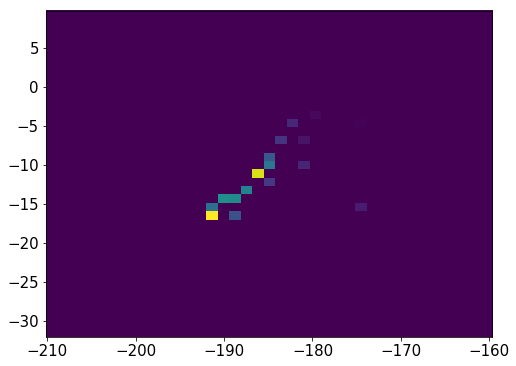

19430    21
19431    21
19432    21
19433    21
19434    21
19435    21
19436    21
19437    21
19438    21
19439    21
19440    21
19441    21
19442    21
19443    21
19444    21
19445    21
19446    21
19447    21
19448    21
19449    21
19450    21
Name: Nsipm, dtype: uint16


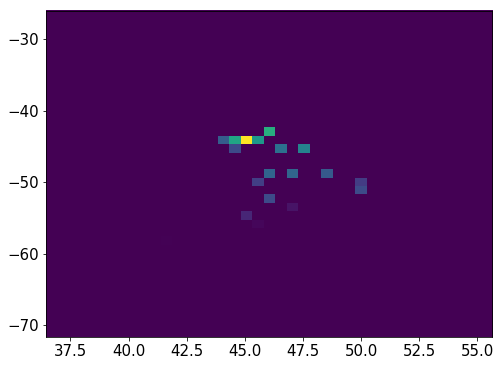

954418    30
954419    30
954420    30
954421    30
954422    30
954423    30
954424    30
954425    30
954426    30
954427    30
954428    30
954429    30
954430    30
954431    30
954432    30
954433    30
954434    30
954435    30
954436    30
954437    30
954438    30
954439    30
954440    30
954441    30
954442    30
954443    30
Name: Nsipm, dtype: uint16


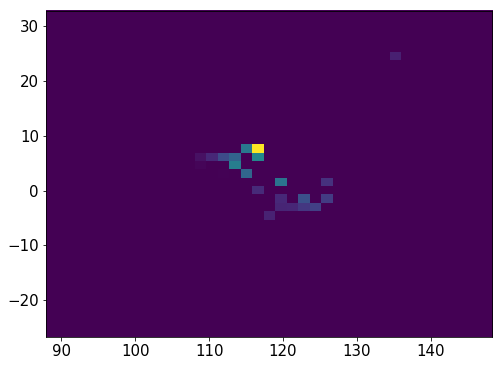

954448    24
954449    24
954450    24
954451    24
954452    24
954453    24
954454    24
954455    24
954456    24
954457    24
954458    24
954459    24
954460    24
954461    24
954462    24
954463    24
954464    24
Name: Nsipm, dtype: uint16


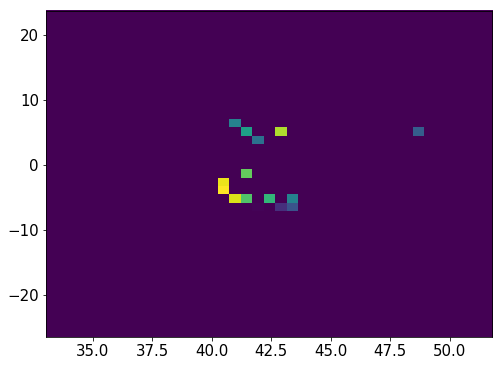

19457    24
19458    24
19459    24
19460    24
19461    24
19462    24
19463    24
19464    24
19465    24
19466    24
19467    24
19468    24
19469    24
19470    24
19471    24
19472    24
19473    24
19474    24
19475    24
19476    24
19477    24
19478    24
19479    24
19480    24
19481    24
19482    24
19483    24
19484    24
Name: Nsipm, dtype: uint16


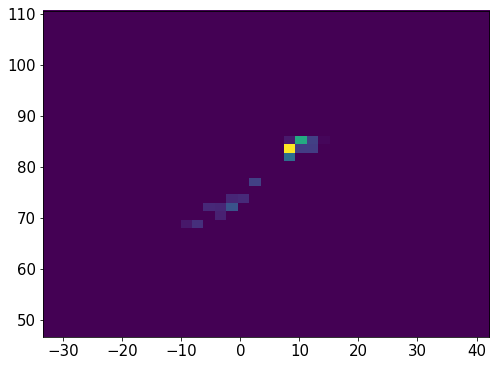

19489    29
19490    29
19491    29
19492    29
19493    29
19494    29
19495    29
19496    29
19497    29
19498    29
19499    29
19500    29
Name: Nsipm, dtype: uint16


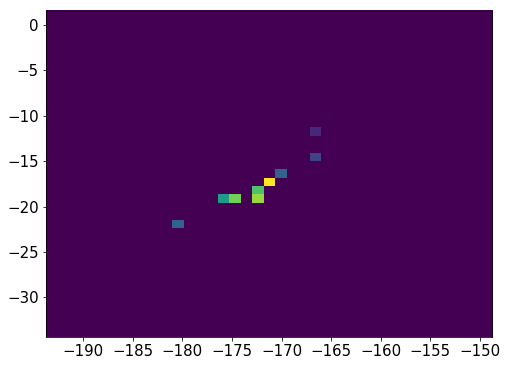

954496    37
954497    37
954498    37
954499    37
954500    37
954501    37
954502    37
954503    37
954504    37
954505    37
954506    37
954507    37
954508    37
954509    37
954510    37
954511    37
954512    37
954513    37
954514    37
954515    37
954516    37
954517    37
954518    37
954519    37
954520    37
954521    37
954522    37
954523    37
954524    37
954525    37
954526    37
954527    37
Name: Nsipm, dtype: uint16


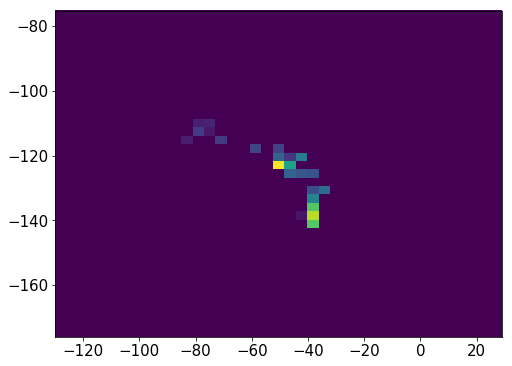

19504    40
19505    40
19506    40
19507    40
19508    40
19509    40
19510    40
19511    40
19512    40
19513    40
19514    40
19515    40
19516    40
19517    40
19518    40
19519    40
19520    40
19521    40
19522    40
19523    40
19524    40
19525    40
19526    40
19527    40
19528    40
Name: Nsipm, dtype: uint16


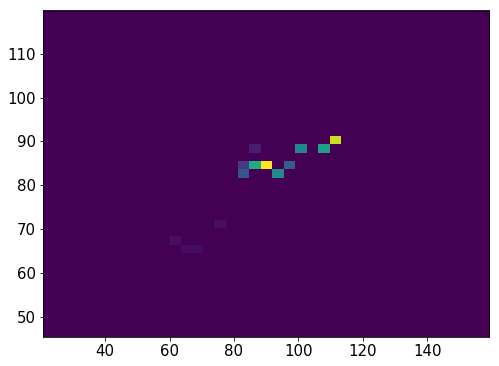

954550    35
954551    35
954552    35
954553    35
954554    35
954555    35
954556    35
954557    35
954558    35
954559    35
954560    35
954561    35
954562    35
954563    35
954569     4
954570     4
954571     4
Name: Nsipm, dtype: uint16


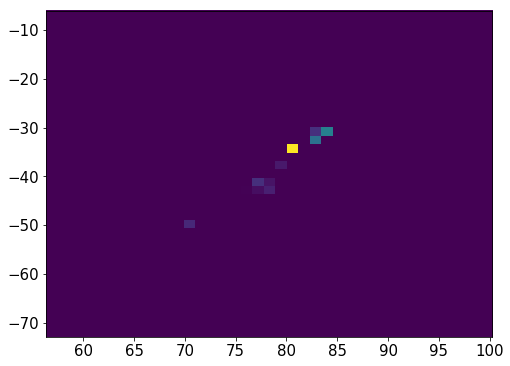

19531    23
19532    23
19533    23
19534    23
19535    23
19536    23
19537    23
19538    23
19539    23
19540    23
19541    23
19542    23
Name: Nsipm, dtype: uint16


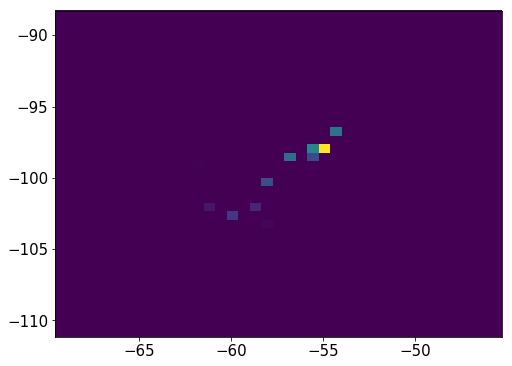

954575    31
954576    31
954577    31
954578    31
954579    31
954580    31
954581    31
954582    31
954583    31
954584    31
954585    31
954586    31
954587    31
954588    31
954589    31
954590    31
954591    31
954592    31
954593    31
954594    31
Name: Nsipm, dtype: uint16


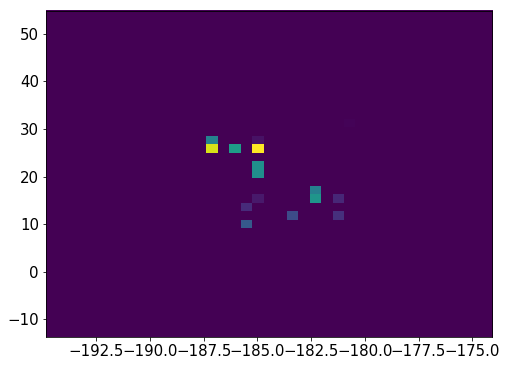

19546    19
19547    19
19548    19
19549    19
19550    19
19551    19
19552    19
19554    19
19555    19
19556    19
19557    19
19558    19
19559    19
19560    19
19561    19
19562    19
19563    19
19564    19
19565    19
Name: Nsipm, dtype: uint16


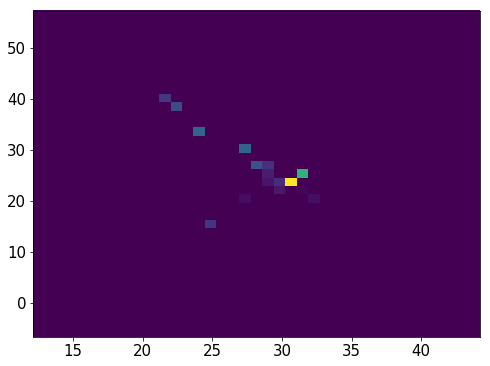

19570    23
19571    23
19572    23
19573    23
19574    23
19575    23
19576    23
19577    23
19578    23
19579    23
19580    23
19581    23
19582    23
19583    23
19584    23
19585    23
19586    23
19587    23
19588    23
19589    23
Name: Nsipm, dtype: uint16


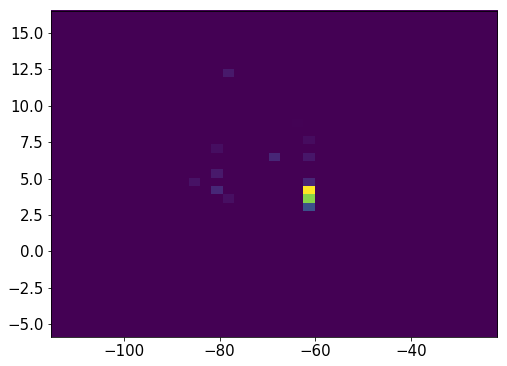

954627    30
954628    30
954629    30
954630    30
954631    30
954632    30
954633    30
954634    30
954635    30
954636    30
954637    30
954638    30
954639    30
954640    30
954641    30
954642    30
954643    30
Name: Nsipm, dtype: uint16


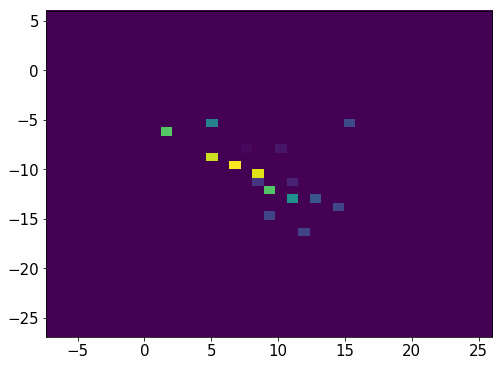

19594    28
19595    28
19596    28
19597    28
19598    28
19599    28
19600    28
19601    28
19602    28
19603    28
19604    28
19605    28
19606    28
19607    28
19608    28
19609    28
19610    28
19611    28
19612    28
Name: Nsipm, dtype: uint16


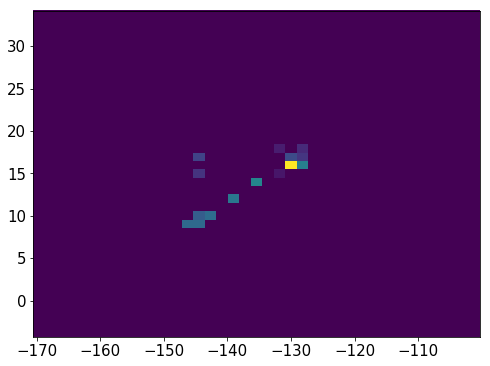

954647    29
954648    29
954649    29
954650    29
954651    29
954652    29
954653    29
954654    29
954655    29
954656    29
954657    29
954658    29
954659    29
954660    29
954661    29
954662    29
954663    29
Name: Nsipm, dtype: uint16


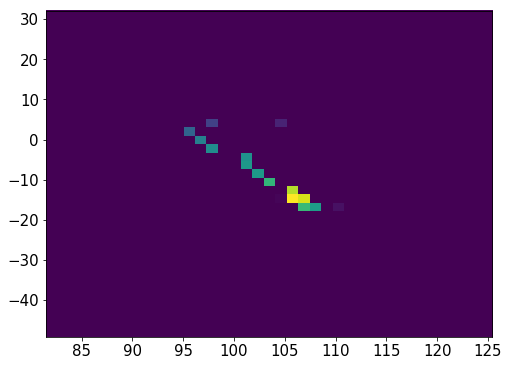

954666    25
954667    25
954668    25
954669    25
954670    25
954671    25
954672    25
954673    25
954674    25
954675    25
954676    25
954677    25
954678    25
954679    25
954680    25
954681    25
954682    25
954683    25
Name: Nsipm, dtype: uint16


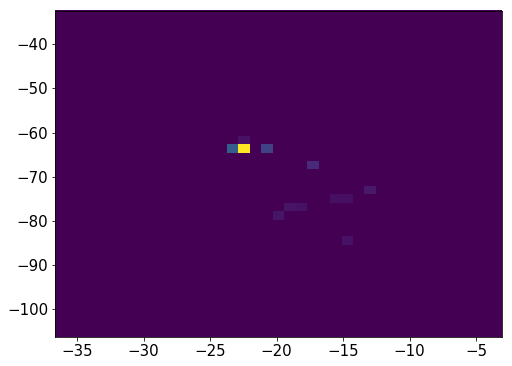

936791    31
936792    31
936793    31
936794    31
936795    31
936796    31
936797    31
936798    31
936799    31
936800    31
936801    31
936802    31
936803    31
936804    31
936805    31
936806    31
936807    31
936808    31
936809    31
936810    31
936811    31
936812    31
936813    31
Name: Nsipm, dtype: uint16


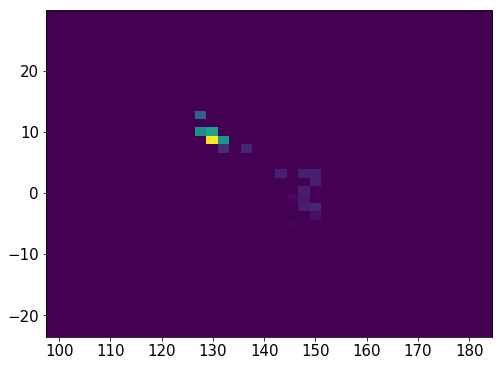

954688    31
954689    31
954690    31
954691    31
954692    31
954693    31
954694    31
954695    31
954696    31
954697    31
954698    31
954699    31
954706    31
954707    31
954708    31
954709    31
954710    31
Name: Nsipm, dtype: uint16


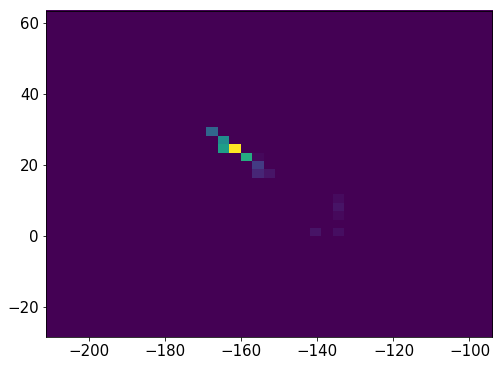

954721    27
954722    27
954723    27
954724    27
954725    27
954726    27
954727    27
954728    27
954729    27
954730    27
954731    27
954732    27
954733    27
Name: Nsipm, dtype: uint16


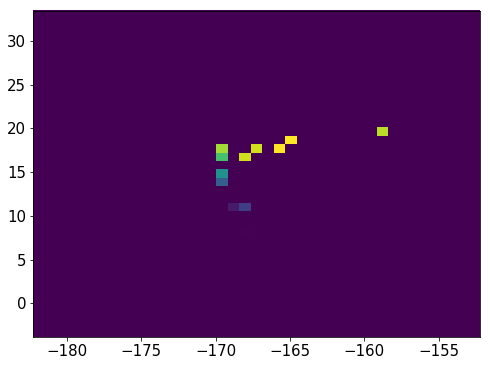

954734    25
954735    25
954736    25
954737    25
954738    25
954739    25
954740    25
954741    25
954742    25
954743    25
954744    25
954745    25
954746    25
Name: Nsipm, dtype: uint16


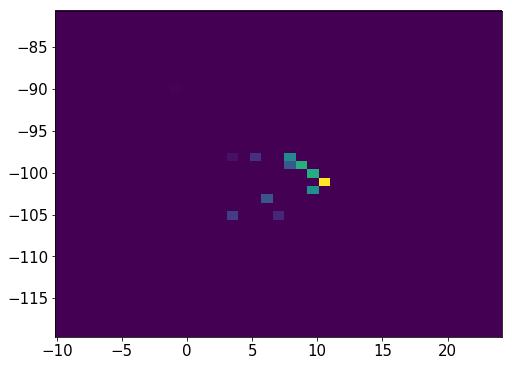

954750    37
954751    37
954752    37
954753    37
954754    37
954755    37
954756    37
954757    37
954758    37
954759    37
954760    37
954761    37
954762    37
954763    37
954764    37
954765    37
954766    37
954767    37
954768    37
954769    37
954770    37
954771    37
954772    37
954773    37
Name: Nsipm, dtype: uint16


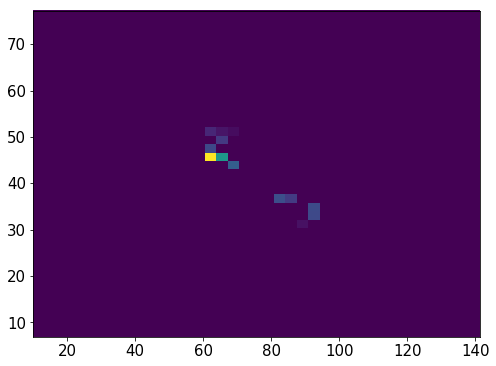

19618    27
19619    27
19620    27
19621    27
19622    27
19623    27
19624    27
19625    27
19626    27
19627    27
19628    27
19629    27
19630    27
19631    27
19632    27
19633    27
19634    27
Name: Nsipm, dtype: uint16


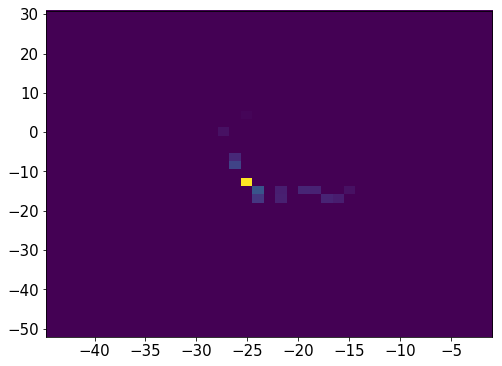

954799    20
954800    20
954801    20
954802    20
954803    20
954804    20
954805    20
954806    20
954807    20
954812    19
954813    19
954814    19
954815    19
954816    19
954817    19
954818    19
954819    19
954820    19
954821    19
Name: Nsipm, dtype: uint16


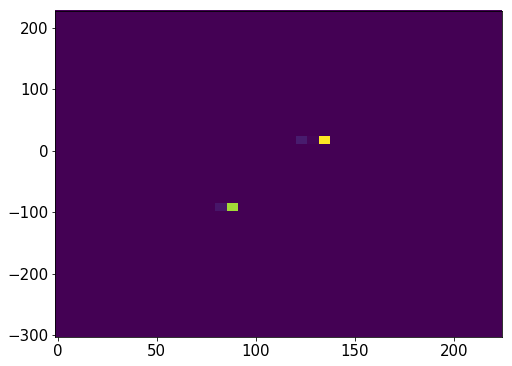

954826    69
954827    69
954828    69
954829    69
954830    69
954831    69
954832    69
954833    69
954834    69
954835    69
954836    69
954837    69
954838    69
954839    69
954840    69
954841    69
954842    69
954843    69
954844    69
954845    69
954846    69
954847    69
954848    69
954849    69
Name: Nsipm, dtype: uint16


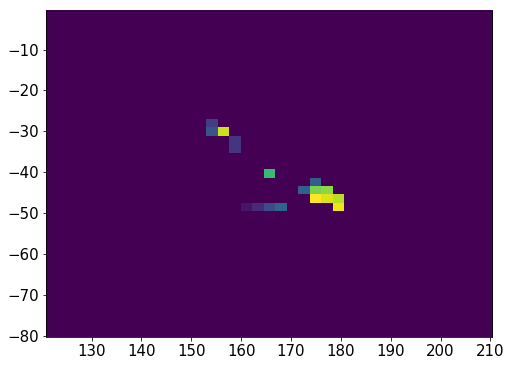

19638    29
19639    29
19640    29
19641    29
19642    29
19643    29
19644    29
19645    29
19646    29
19647    29
19648    29
19649    29
19650    29
19651    29
19652    29
19653    29
19654    29
19655    29
19656    29
Name: Nsipm, dtype: uint16


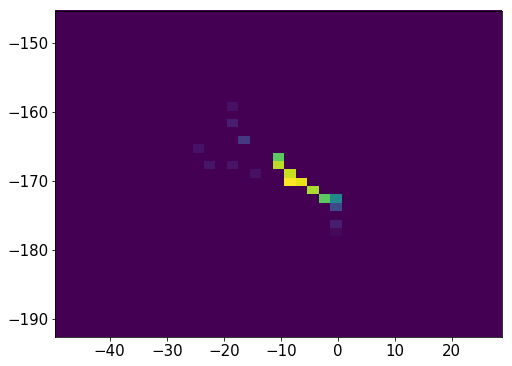

19658    21
19659    21
19660    21
19661    21
19662    21
19663    21
19664    21
19665    21
19666    21
19667    21
19668    21
19669    21
19670    21
19671    21
19672    21
19673    21
19674    21
19675    21
19676    21
19677    21
19680    21
19681    21
Name: Nsipm, dtype: uint16


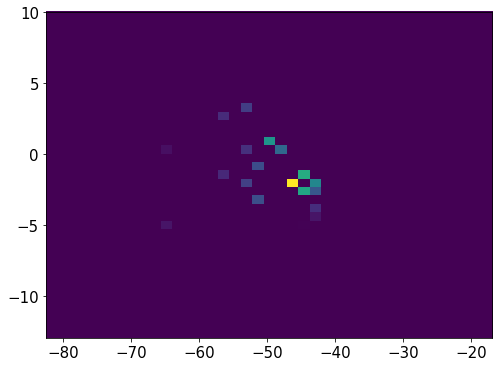

19687    22
19688    22
19689    22
19690    22
19691    22
19692    22
19693    22
19694    22
19695    22
19696    22
19697    22
19698    22
19699    22
19700    22
Name: Nsipm, dtype: uint16


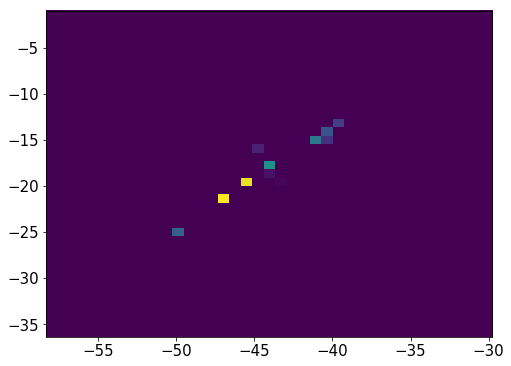

19705    24
19706    24
19707    24
19708    24
19709    24
19710    24
19711    24
19712    24
19713    24
19714    24
Name: Nsipm, dtype: uint16


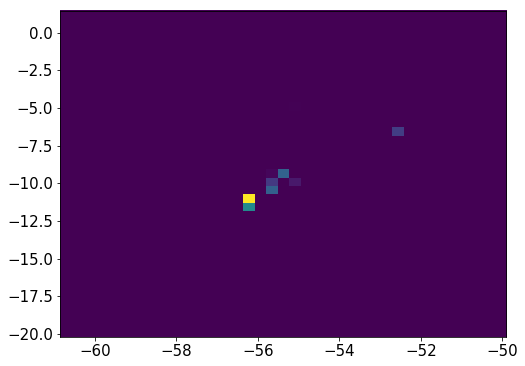

1904207    19
1904208    19
1904209    19
1904210    19
1904211    19
1904212    19
1904213    19
1904214    19
1904215    19
1904216    19
1904217    19
1904218    19
1904223    16
1904224    16
1904225    16
1904226    16
1904227    16
1904228    16
1904229    16
1904230    16
1904231    16
1904232    16
Name: Nsipm, dtype: uint16


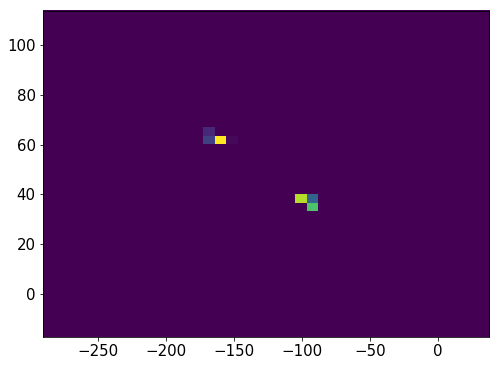

19719    22
19720    22
19721    22
19722    22
19723    22
19724    22
19725    22
19726    22
19727    22
19728    22
19729    22
19730    22
19731    22
19732    22
19733    22
19734    22
19735    22
19738    22
19739    22
19740    22
19741    22
19742    22
19743    22
19744    22
19745    22
19746    22
19747    22
19748    22
19750    22
19751    22
19752    22
19753    22
Name: Nsipm, dtype: uint16


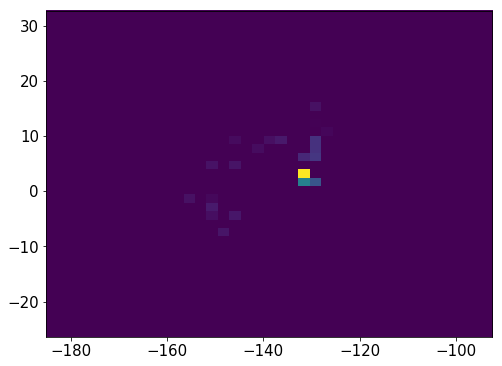

19759    25
19760    25
19761    25
19762    25
19763    25
19764    25
19765    25
19766    25
19767    25
19768    25
19769    25
19770    25
19771    25
19772    25
19773    25
19774    25
19775    25
Name: Nsipm, dtype: uint16


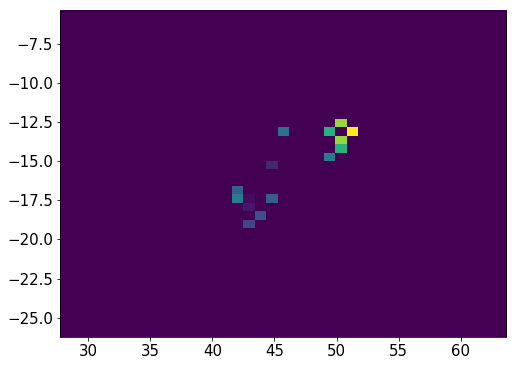

954854    20
954855    20
954856    20
954857    20
954858    20
954859    20
954860    20
954861    20
954862    20
954863    20
954864    20
954865    20
954866    20
954867    20
Name: Nsipm, dtype: uint16


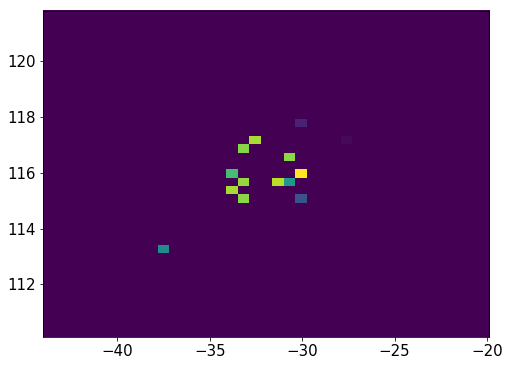

1904236    23
1904237    23
1904238    23
1904239    23
1904240    23
1904241    23
1904242    23
Name: Nsipm, dtype: uint16


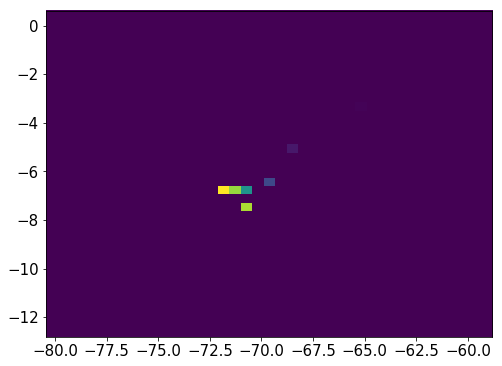

954873    27
954874    27
954875    27
954876    27
954877    27
954878    27
954879    27
954880    27
954881    27
954882    27
954883    27
954884    27
954885    27
954888    27
954889    27
954890    27
954891    27
954892    27
954893    27
954894    27
954895    27
954896    27
954897    27
954898    27
954899    27
954900    27
954901    27
954902    27
954903    27
954904    27
954905    27
954906    27
954907    27
954908    27
954909    27
954910    27
954918    27
954919    27
954920    27
954921    27
954924    27
954925    27
954926    27
954927    27
Name: Nsipm, dtype: uint16


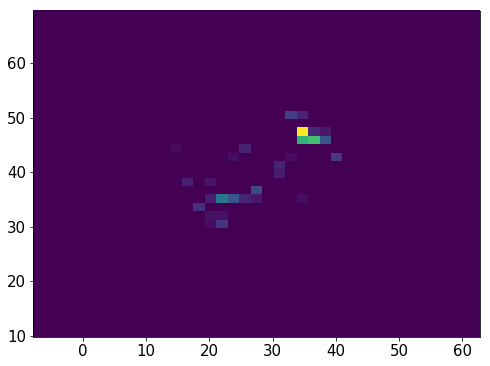

954934    22
954935    22
954936    22
954937    22
954938    22
954939    22
954940    22
954941    22
954942    22
954943    22
954944    22
954945    22
954946    22
Name: Nsipm, dtype: uint16


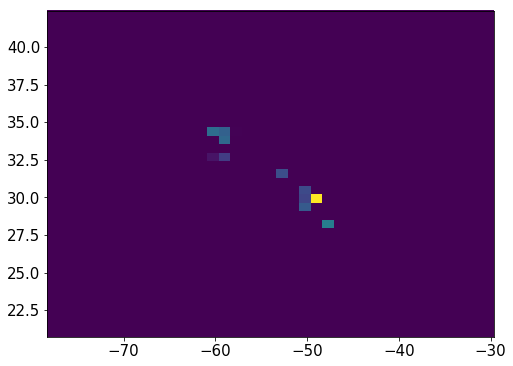

19811    29
19812    29
19813    29
19814    29
19815    29
19816    29
19817    29
19818    29
19819    29
19820    29
19821    29
19822    29
19823    29
19824    29
19825    29
19826    29
19827    29
19828    29
19829    29
Name: Nsipm, dtype: uint16


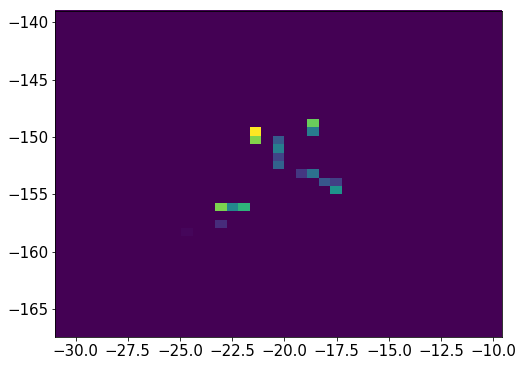

954966    28
954967    28
954968    28
954969    28
954970    28
954971    28
954972    28
954973    28
954974    28
954975    28
954976    28
954977    28
954978    28
954979    28
954980    28
954981    28
954983    28
Name: Nsipm, dtype: uint16


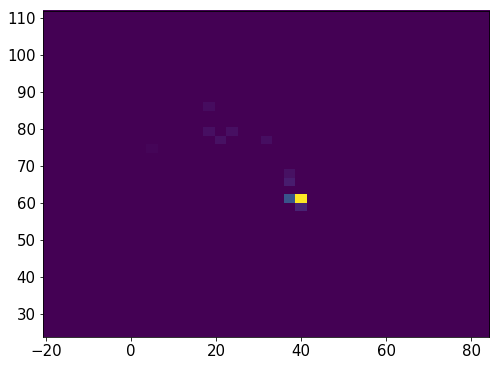

19834    21
19835    21
19836    21
19837    21
19838    21
19839    21
19840    21
19841    21
19842    21
19843    21
19844    21
19845    21
19846    21
19847    21
19848    21
19849    21
19850    21
19851    21
Name: Nsipm, dtype: uint16


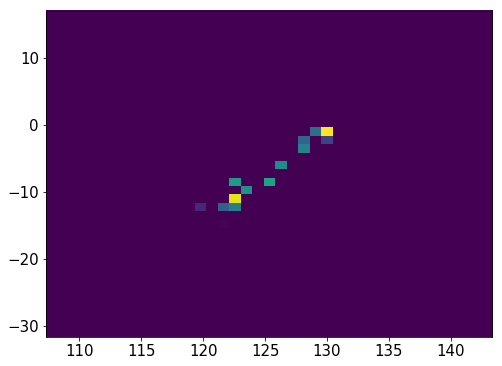

19855    24
19856    24
19857    24
19858    24
19859    24
19860    24
19861    24
19862    24
19863    24
19864    24
19865    24
19866    24
19867    24
19868    24
Name: Nsipm, dtype: uint16


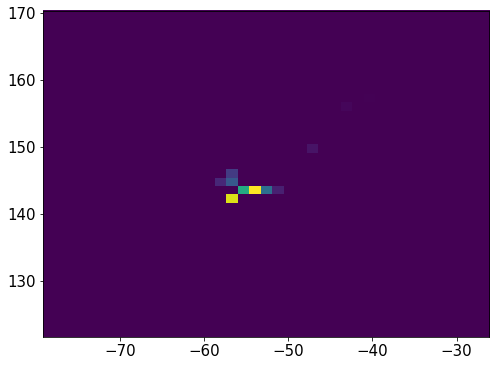

954986    32
954987    32
954988    32
954989    32
954990    32
954991    32
954992    32
954993    32
954994    32
954995    32
954996    32
954997    32
954998    32
954999    32
955000    32
955001    32
955002    32
955003    32
955004    32
955005    32
Name: Nsipm, dtype: uint16


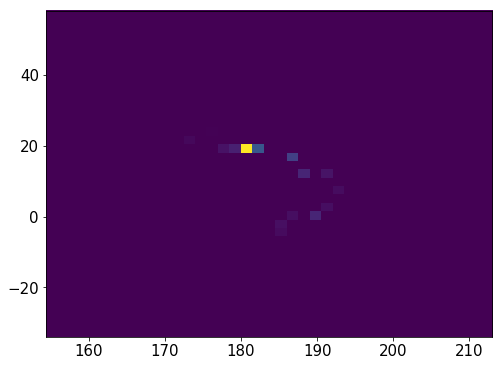

19905    23
19906    23
19907    23
19908    23
19909    23
19910    23
19911    23
19912    23
19913    23
19914    23
19915    23
19916    23
19917    23
19918    23
19919    23
19920    23
19921    23
19922    23
19923    23
19924    23
19925    23
19926    23
Name: Nsipm, dtype: uint16


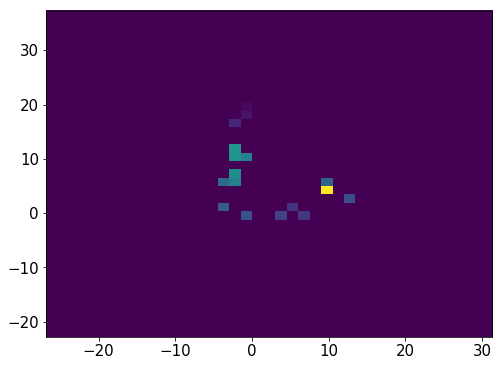

955027    32
955028    32
955029    32
955030    32
955031    32
955032    32
955033    32
955034    32
955035    32
955036    32
955037    32
955038    32
955039    32
955040    32
955041    32
955042    32
955043    32
955044    32
955045    32
Name: Nsipm, dtype: uint16


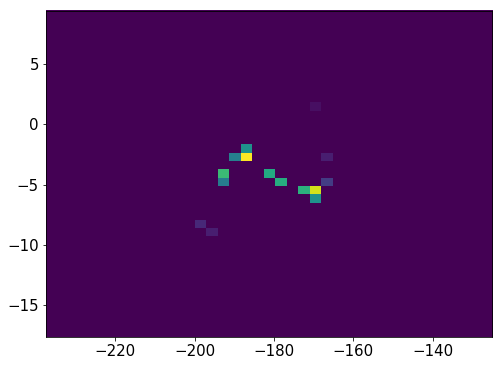

955049    20
955050    20
955051    20
955052    20
955053    20
955054    20
955055    20
955056    20
955057    20
955058    20
955059    20
955060    20
955061    20
955063    20
955064    20
955065    20
955066    20
955067    20
Name: Nsipm, dtype: uint16


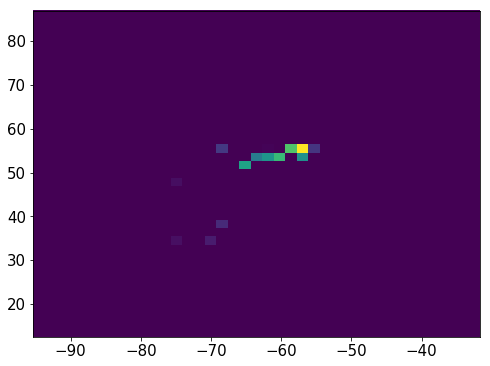

955073    17
955074    17
955075    17
955076    17
955077    17
955078    17
955079    17
955080    17
955081    17
955082    17
955083    17
955084    17
955085    17
955086    17
955087    17
955088    17
955089    17
955090    17
955091    17
955092    17
955099     1
955100     1
955101     1
955102     1
Name: Nsipm, dtype: uint16


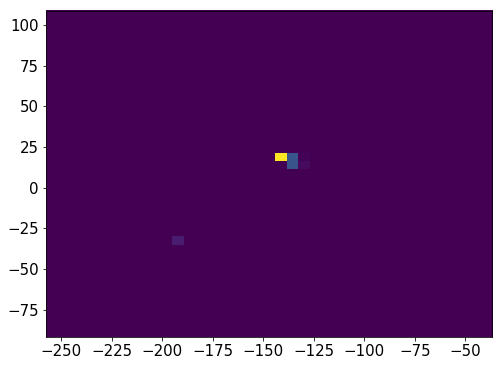

955106    24
955107    24
955108    24
955109    24
955110    24
955111    24
955112    24
955113    24
955114    24
955115    24
955116    24
955117    24
955118    24
955119    24
955120    24
955121    24
955122    24
955123    24
955124    24
955125    24
955126    24
Name: Nsipm, dtype: uint16


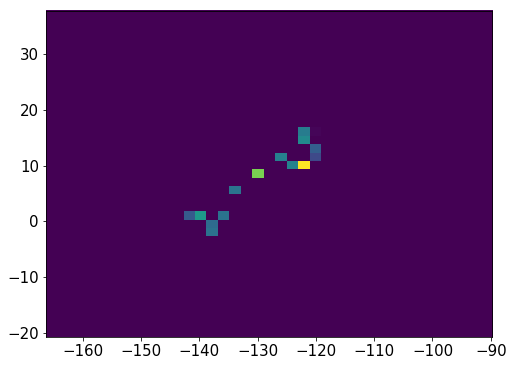

19949    41
19950    41
19951    41
19952    41
19953    41
19954    41
19955    41
19956    41
19957    41
19958    41
19959    41
19960    41
19961    41
19962    41
19963    41
19964    41
19965    41
19966    41
19967    41
19968    41
19969    41
19970    41
19971    41
19972    41
19973    41
19974    41
19975    41
19976    41
19977    41
Name: Nsipm, dtype: uint16


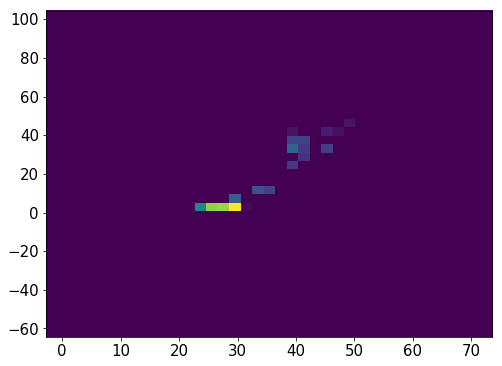

955157    40
955158    40
955159    40
955160    40
955161    40
955162    40
955163    40
955164    40
955165    40
955166    40
955167    40
955168    40
955169    40
955170    40
955171    40
955172    40
955173    40
Name: Nsipm, dtype: uint16


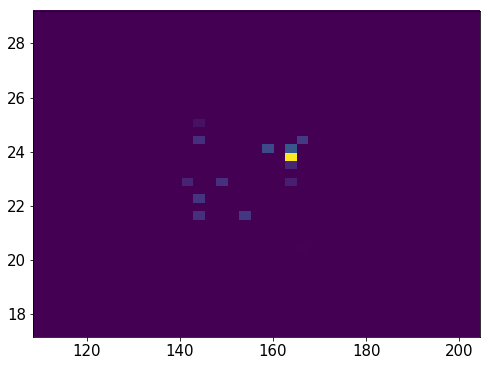

19980    18
19981    18
19982    18
19983    18
19984    18
19985    18
19986    18
19987    18
19988    18
19989    18
19990    18
19991    18
19992    18
19993    18
19994    18
19995    18
19996    18
19997    18
19998    18
Name: Nsipm, dtype: uint16


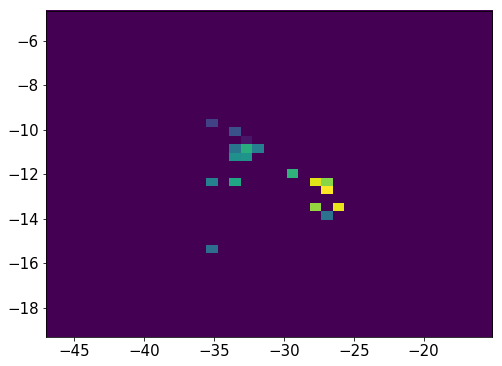

20017    28
20018    28
20019    28
20020    28
20021    28
20022    28
20023    28
20024    28
20025    28
20026    28
20027    28
20028    28
20029    28
Name: Nsipm, dtype: uint16


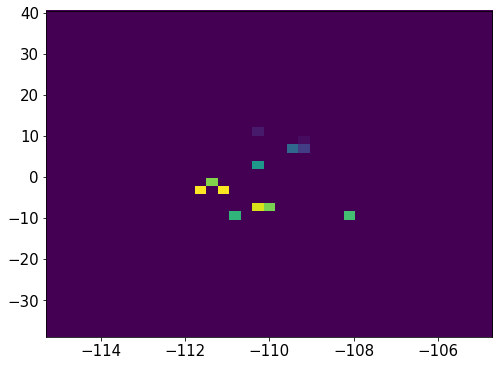

955177    26
955178    26
955179    26
955180    26
955181    26
955182    26
955183    26
955184    26
955185    26
955186    26
955187    26
955188    26
955189    26
Name: Nsipm, dtype: uint16


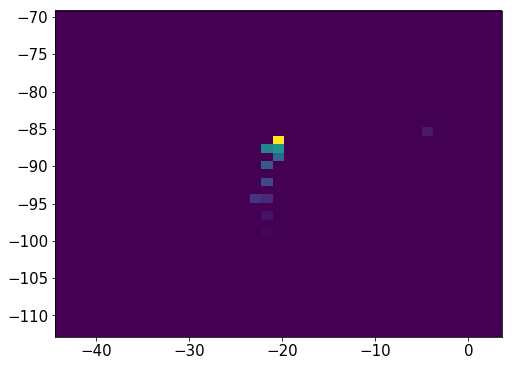

20030    28
20031    28
20032    28
20033    28
20034    28
20035    28
20036    28
20037    28
20038    28
20039    28
20040    28
20041    28
20042    28
20043    28
20044    28
20045    28
Name: Nsipm, dtype: uint16


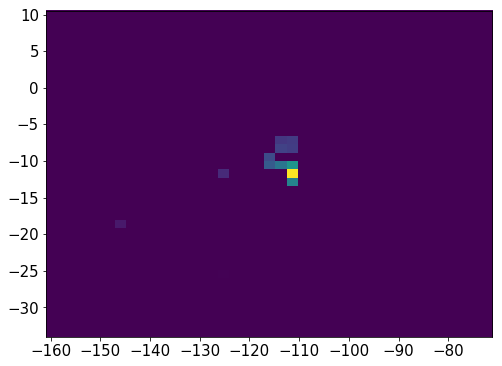

2791472    33
2791473    33
2791474    33
2791475    33
2791476    33
2791477    33
2791478    33
2791479    33
2791480    33
2791481    33
2791482    33
2791483    33
2791484    33
2791485    33
2791486    33
2791487    33
2791488    33
Name: Nsipm, dtype: uint16


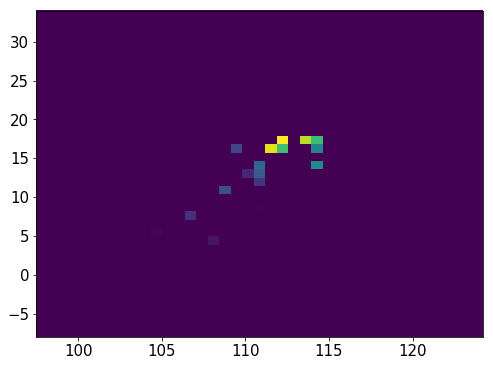

955231    12
955232    12
955233    12
955234    12
955235    12
955236    12
955237    12
955238    12
955239    12
955240    12
955241    12
955242    12
955243    12
955244    12
955245    12
955246    12
955247    12
Name: Nsipm, dtype: uint16


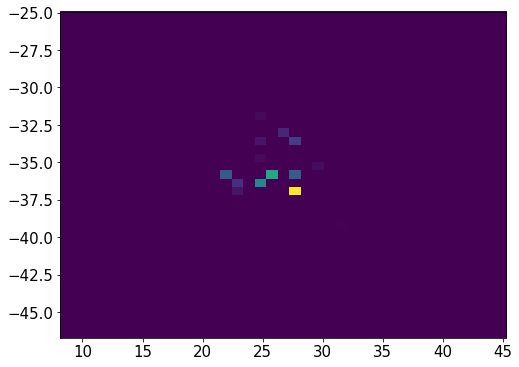

20049    26
20050    26
20051    26
20052    26
20053    26
20054    26
20055    26
20056    26
20057    26
20058    26
20059    26
20060    26
20061    26
20062    26
20063    26
Name: Nsipm, dtype: uint16


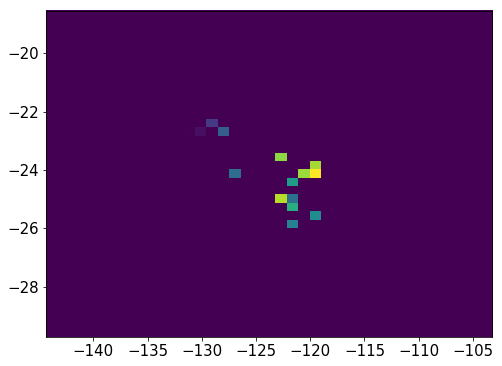

955264    26
955265    26
955266    26
955267    26
955268    26
955269    26
955270    26
955271    26
955272    26
955273    26
955274    26
955275    26
955277    26
955278    26
955279    26
955281    26
955282    26
955283    26
955290     1
955291     1
955292     1
955293     1
Name: Nsipm, dtype: uint16


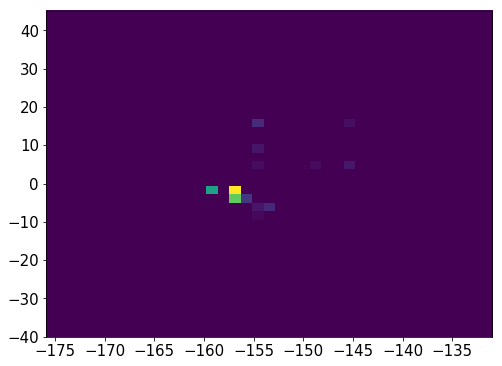

20068    30
20069    30
20070    30
20071    30
20072    30
20073    30
20074    30
20075    30
20076    30
20077    30
20078    30
20079    30
20080    30
20081    30
20082    30
20083    30
20084    30
20085    30
20086    30
20087    30
20088    30
Name: Nsipm, dtype: uint16


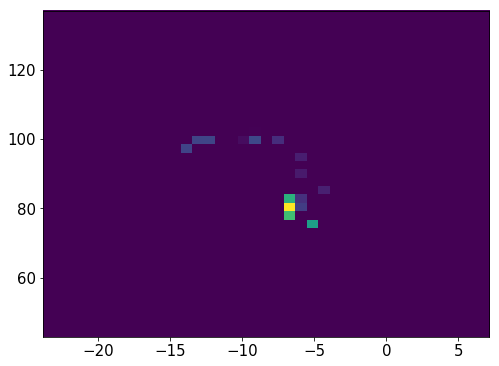

20093    32
20094    32
20095    32
20096    32
20097    32
20098    32
20099    32
20100    32
20101    32
20102    32
20103    32
20104    32
20105    32
20106    32
20107    32
20108    32
20109    32
20110    32
20111    32
20112    32
20113    32
20114    32
20115    32
20116    32
Name: Nsipm, dtype: uint16


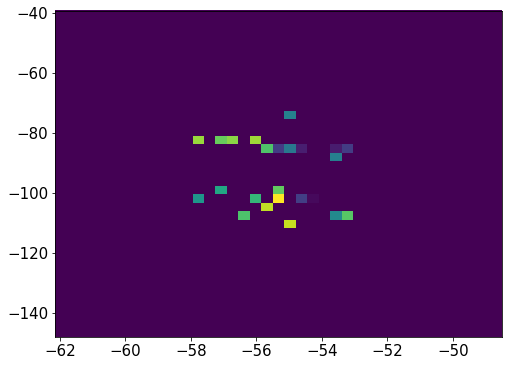

955315    25
955316    25
955317    25
955318    25
955319    25
955320    25
955321    25
955322    25
955323    25
955324    25
955325    25
955326    25
955327    25
955328    25
955329    25
955330    25
955331    25
955332    25
955333    25
955334    25
955335    25
955336    25
955337    25
955338    25
955339    25
Name: Nsipm, dtype: uint16


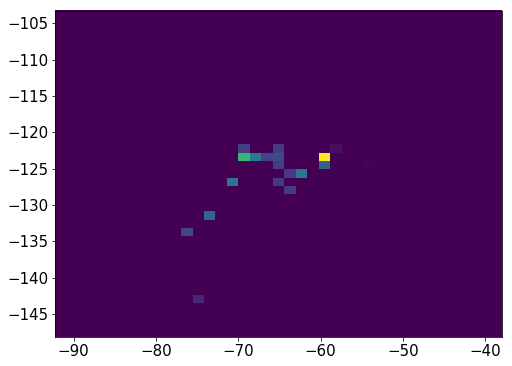

955343    28
955344    28
955345    28
955346    28
955347    28
955348    28
955349    28
955350    28
955351    28
955352    28
955353    28
955354    28
955355    28
955356    28
955357    28
955358    28
955359    28
955360    28
955361    28
955362    28
955363    28
955364    28
955365    28
955366    28
955367    28
Name: Nsipm, dtype: uint16


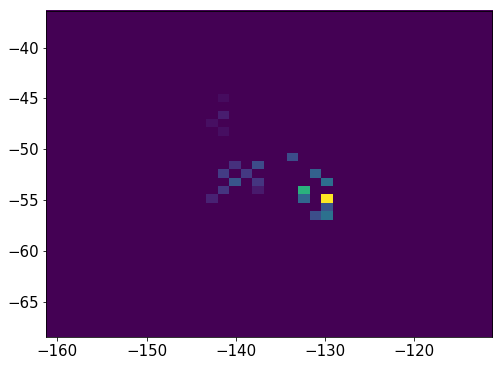

955370    20
955371    20
955372    20
955373    20
955374    20
955375    20
955376    20
955377    20
955378    20
955379    20
955380    20
955381    20
Name: Nsipm, dtype: uint16


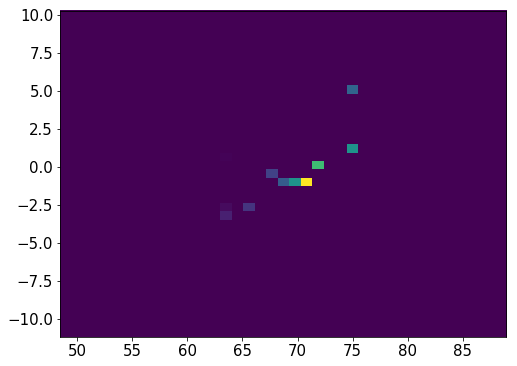

20120    28
20121    28
20122    28
20123    28
20124    28
20125    28
20126    28
20127    28
20128    28
20129    28
20130    28
20131    28
20132    28
20133    28
20134    28
20135    28
Name: Nsipm, dtype: uint16


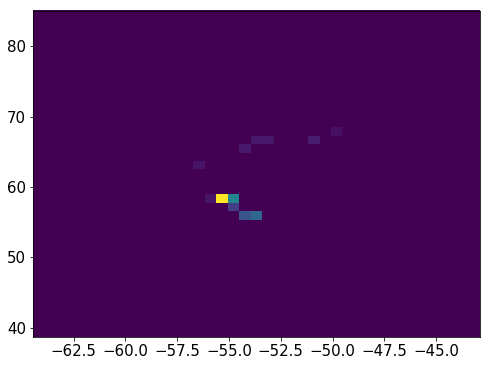

20141    31
20142    31
20143    31
20144    31
20145    31
20146    31
20147    31
20148    31
20149    31
20150    31
20151    31
20152    31
20153    31
20154    31
20155    31
Name: Nsipm, dtype: uint16


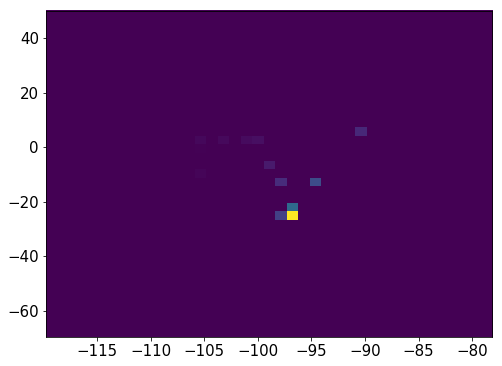

955404    27
955405    27
955406    27
955407    27
955408    27
955409    27
955410    27
955411    27
955412    27
955413    27
955414    27
955415    27
955416    27
955417    27
955418    27
955419    27
955420    27
955421    27
955422    27
Name: Nsipm, dtype: uint16


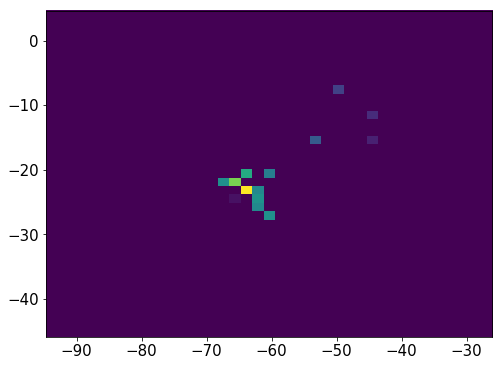

955427    26
955428    26
955429    26
955430    26
955431    26
955432    26
955433    26
955434    26
955435    26
955436    26
955437    26
955438    26
955439    26
955440    26
955441    26
955442    26
955443    26
955444    26
955445    26
955446    26
955450    26
955455    26
Name: Nsipm, dtype: uint16


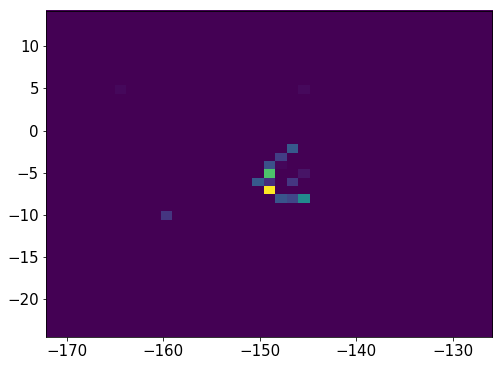

20197    27
20198    27
20199    27
20200    27
20201    27
20202    27
20203    27
20204    27
20205    27
20206    27
20207    27
20208    27
20209    27
20210    27
20211    27
Name: Nsipm, dtype: uint16


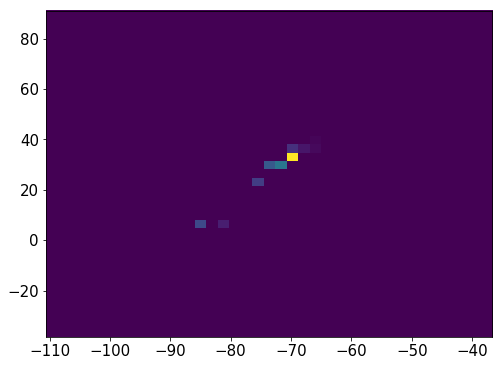

955463    29
955464    29
955465    29
955466    29
955467    29
955468    29
955469    29
955470    29
955471    29
955472    29
955473    29
955474    29
955475    29
955476    29
955477    29
955478    29
955479    29
955480    29
955485     2
955486     2
955487     2
955488     2
955489     2
955490     2
Name: Nsipm, dtype: uint16


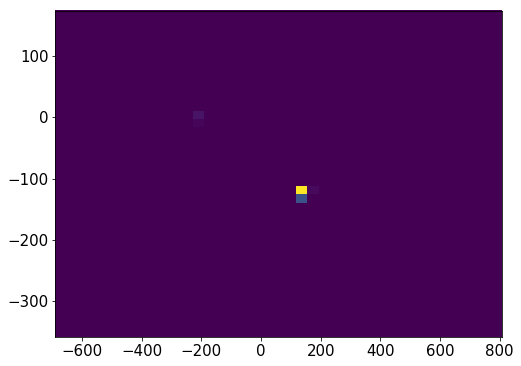

955495    22
955496    22
955497    22
955498    22
955499    22
955500    22
955501    22
955502    22
955503    22
955504    22
955505    22
955506    22
955507    22
955508    22
955509    22
955510    22
955511    22
955512    22
955513    22
955514    22
955515    22
955516    22
955517    22
955518    22
955519    22
Name: Nsipm, dtype: uint16


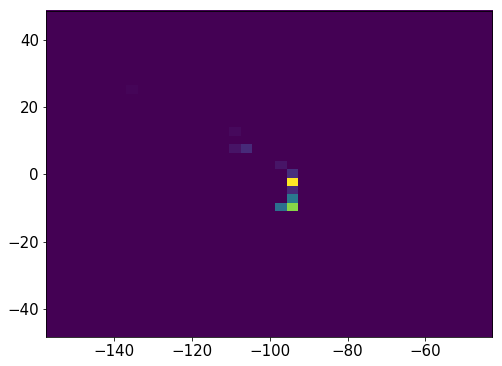

20216    37
20217    37
20218    37
20219    37
20220    37
20221    37
20222    37
20223    37
20224    37
20225    37
20226    37
20229    37
20230    37
20231    37
20232    37
20233    37
20234    37
20235    37
20236    37
20237    37
20238    37
20239    37
20240    37
20241    37
20242    37
20243    37
20244    37
20245    37
20246    37
20247    37
20248    37
20249    37
20250    37
20251    37
20253    37
20254    37
20255    37
20256    37
20257    37
20258    37
20259    37
20260    37
20261    37
20262    37
20263    37
20264    37
20265    37
20266    37
Name: Nsipm, dtype: uint16


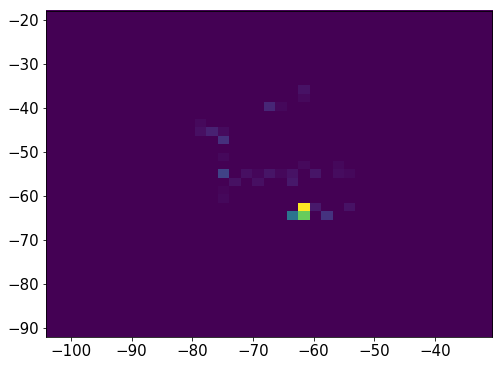

955523    25
955524    25
955525    25
955526    25
955527    25
955528    25
955529    25
955530    25
955531    25
955532    25
955533    25
955534    25
955535    25
955536    25
955537    25
955538    25
955539    25
955540    25
955541    25
955542    25
Name: Nsipm, dtype: uint16


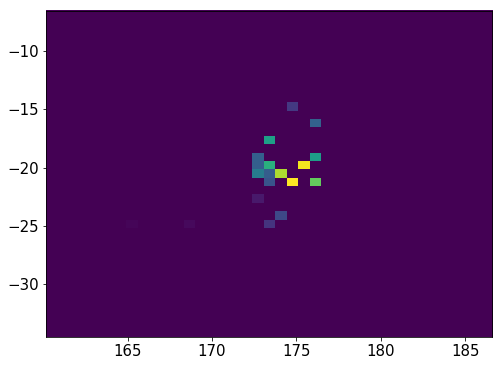

955547    27
955548    27
955549    27
955550    27
955551    27
955552    27
955553    27
955554    27
955555    27
955556    27
955557    27
955558    27
955559    27
955560    27
955561    27
955562    27
955563    27
Name: Nsipm, dtype: uint16


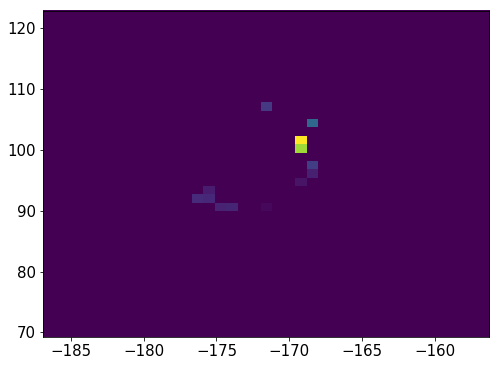

20295    27
20296    27
20297    27
20298    27
20299    27
20300    27
20301    27
20302    27
20303    27
20304    27
20305    27
20306    27
20307    27
20312     2
20313     2
20314     2
20315     2
Name: Nsipm, dtype: uint16


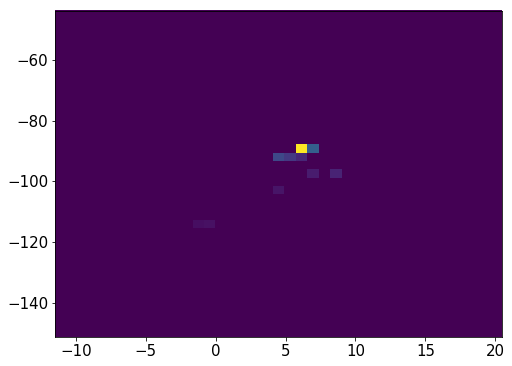

955567    24
955568    24
955569    24
955570    24
955571    24
955572    24
955573    24
955574    24
955575    24
955576    24
955577    24
955578    24
955579    24
955580    24
955581    24
955582    24
955583    24
955584    24
Name: Nsipm, dtype: uint16


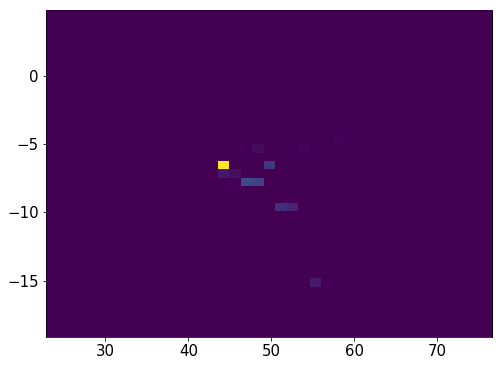

20351    31
20352    31
20353    31
20354    31
20355    31
20356    31
20357    31
20358    31
20359    31
20360    31
20361    31
20362    31
20363    31
20364    31
20370     1
20371     1
20372     1
20373     1
20374     1
Name: Nsipm, dtype: uint16


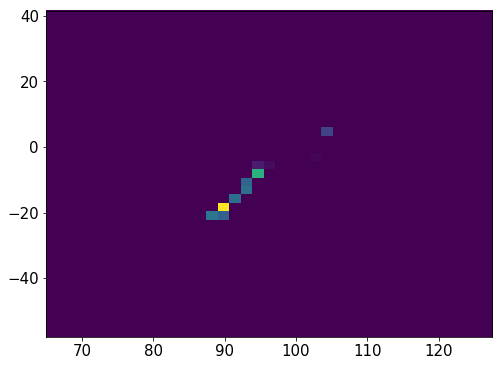

955590    22
955591    22
955592    22
955593    22
955594    22
955595    22
955596    22
955597    22
955598    22
955599    22
955600    22
955601    22
955602    22
955603    22
955604    22
955605    22
955607    22
955608    22
955610    22
955612    22
955613    22
955614    22
955615    22
955616    22
955617    22
955618    22
955619    22
Name: Nsipm, dtype: uint16


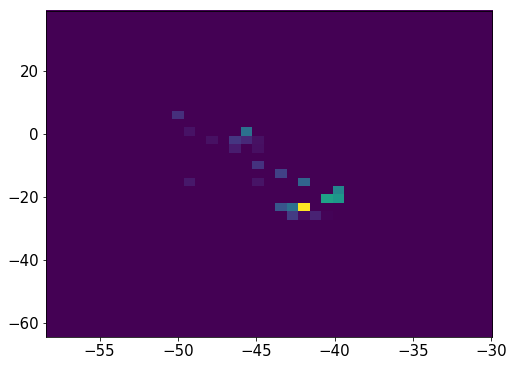

20379    27
20380    27
20381    27
20382    27
20383    27
20384    27
20385    27
20386    27
20387    27
20388    27
20389    27
20390    27
20391    27
20392    27
20393    27
20394    27
20395    27
20396    27
20397    27
20398    27
20399    27
20400    27
20401    27
Name: Nsipm, dtype: uint16


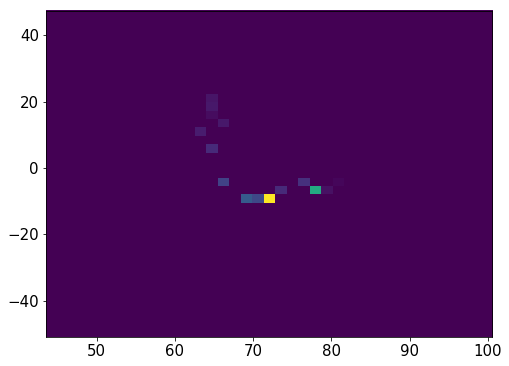

20405    22
20406    22
20407    22
20408    22
20409    22
20410    22
20411    22
20412    22
20413    22
20414    22
20415    22
20416    22
Name: Nsipm, dtype: uint16


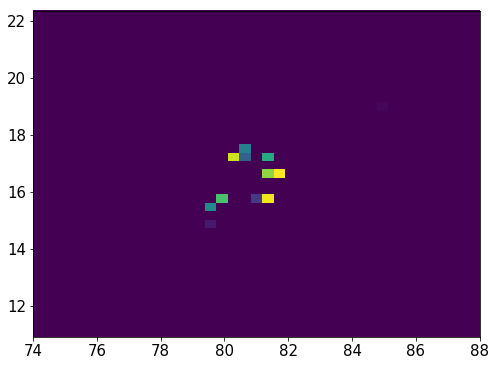

955624    31
955625    31
955626    31
955627    31
955628    31
955629    31
955630    31
955631    31
955632    31
955633    31
955634    31
955635    31
955636    31
955643     2
955644     2
955645     2
955646     2
955647     2
955648     2
Name: Nsipm, dtype: uint16


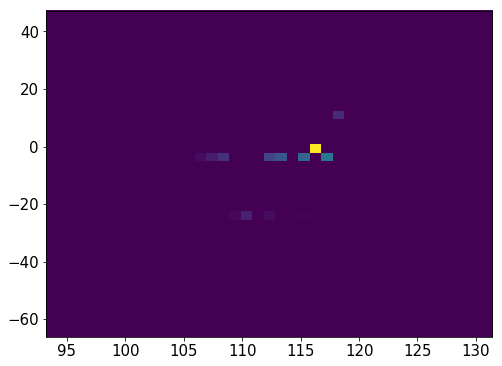

20420    20
20421    20
20422    20
20423    20
20424    20
20425    20
20426    20
20427    20
20428    20
20429    20
20430    20
20431    20
20432    20
20433    20
20434    20
20435    20
20436    20
20437    20
20438    20
20439    20
Name: Nsipm, dtype: uint16


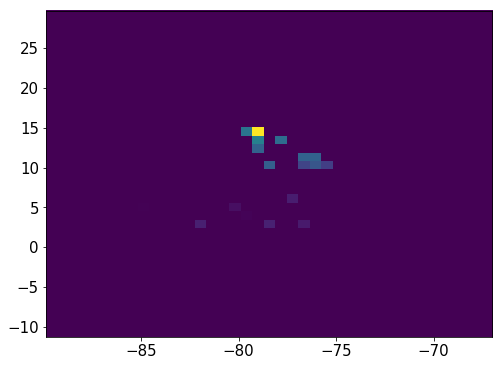

20445    21
20446    21
20447    21
20448    21
20449    21
20450    21
20451    21
20452    21
20453    21
20454    21
20455    21
20456    21
20457    21
20458    21
20459    21
20460    21
20465     1
20466     1
20467     1
20468     1
Name: Nsipm, dtype: uint16


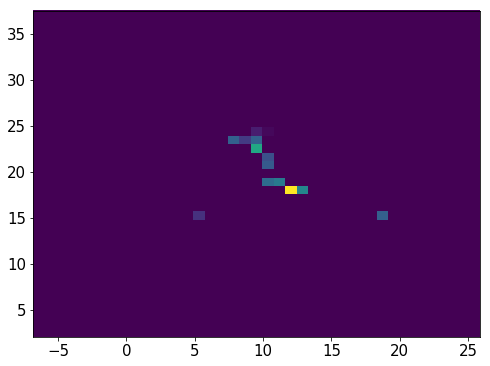

955653    19
955654    19
955655    19
955656    19
955657    19
955658    19
955659    19
955660    19
955661    19
955662    19
Name: Nsipm, dtype: uint16


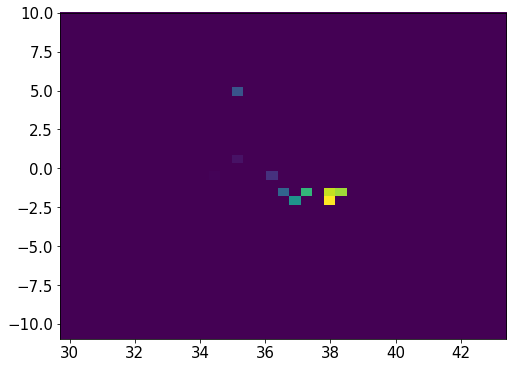

955666    23
955667    23
955668    23
955669    23
955670    23
955671    23
955672    23
955673    23
955674    23
955675    23
955676    23
955677    23
955678    23
955679    23
955680    23
955681    23
Name: Nsipm, dtype: uint16


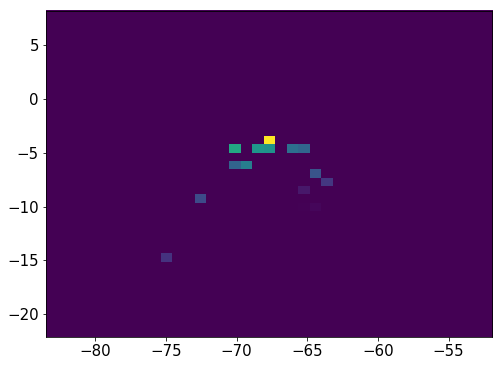

20474    28
20475    28
20476    28
20477    28
20478    28
20479    28
20480    28
20481    28
20482    28
20483    28
20484    28
20485    28
20486    28
20487    28
20488    28
20489    28
20490    28
20491    28
20492    28
Name: Nsipm, dtype: uint16


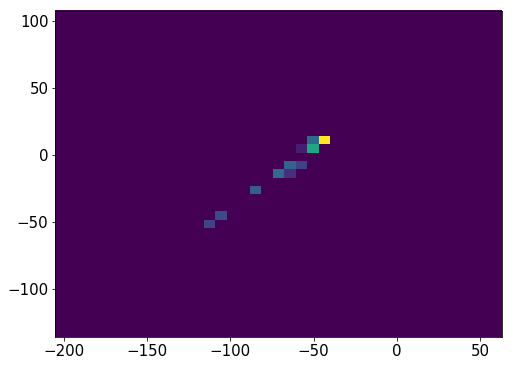

955712    17
955713    17
955714    17
955715    17
955716    17
955717    17
955718    17
955719    17
955720    17
955721    17
955722    17
955723    17
955724    17
955725    17
955726    17
955727    17
955728    17
955729    17
955730    17
955734     3
955735     3
955736     3
955737     3
955738     3
Name: Nsipm, dtype: uint16


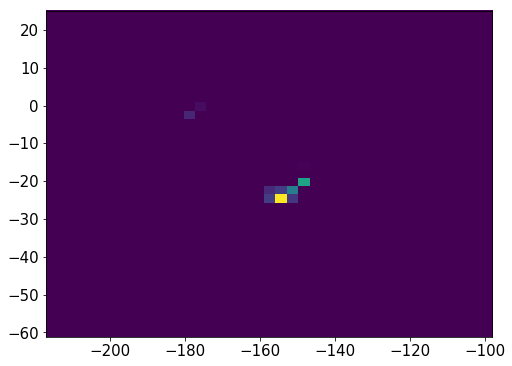

955743    29
955744    29
955745    29
955746    29
955747    29
955748    29
955749    29
955750    29
955751    29
955752    29
955753    29
955754    29
955755    29
955756    29
955757    29
955758    29
955759    29
955760    29
955761    29
955762    29
955763    29
955764    29
955765    29
955766    29
955767    29
Name: Nsipm, dtype: uint16


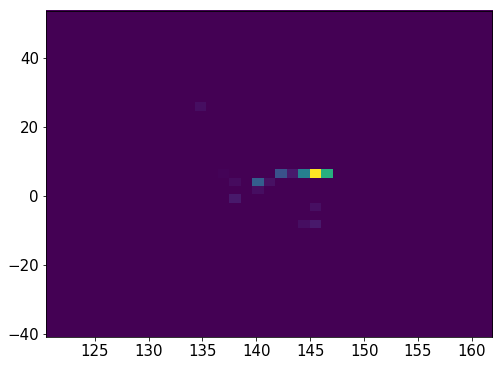

955769    26
955770    26
955771    26
955772    26
955773    26
955774    26
955775    26
955776    26
955777    26
955778    26
955779    26
955780    26
955781    26
955782    26
955783    26
955784    26
955785    26
955786    26
955787    26
955788    26
955789    26
955790    26
955791    26
955792    26
955793    26
955794    26
955795    26
955796    26
955797    26
955798    26
955799    26
955800    26
Name: Nsipm, dtype: uint16


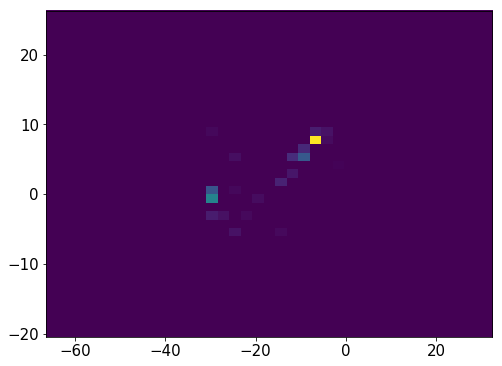

20496    22
20497    22
20498    22
20499    22
20500    22
20501    22
20502    22
20503    22
20504    22
20505    22
20506    22
20508    22
20509    22
20514    10
20515    10
20516    10
20517    10
20518    10
20519    10
20520    10
20521    10
Name: Nsipm, dtype: uint16


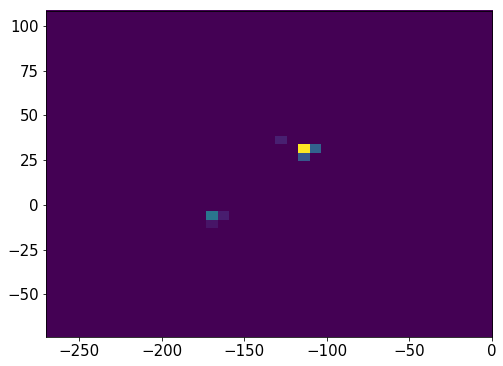

955803    23
955804    23
955805    23
955806    23
955807    23
955808    23
955809    23
955810    23
955811    23
955812    23
955813    23
955814    23
955815    23
955816    23
Name: Nsipm, dtype: uint16


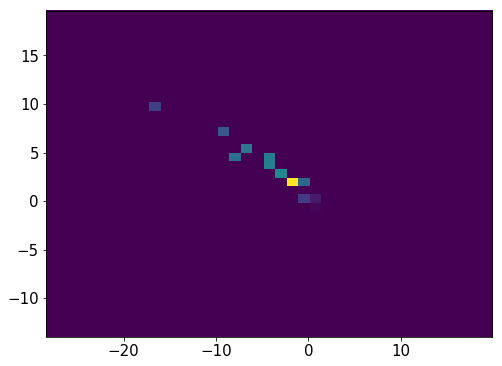

20525    26
20526    26
20527    26
20528    26
20529    26
20530    26
20531    26
20532    26
20533    26
20534    26
20535    26
20536    26
20537    26
20538    26
20539    26
20540    26
20541    26
20542    26
20543    26
20544    26
20545    26
20546    26
20547    26
20548    26
20549    26
20550    26
Name: Nsipm, dtype: uint16


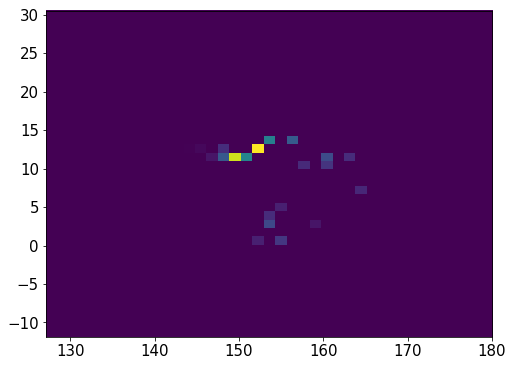

20556    29
20557    29
20558    29
20559    29
20560    29
20561    29
20562    29
20563    29
20564    29
20570     3
20571     3
20572     3
20573     3
20574     3
Name: Nsipm, dtype: uint16


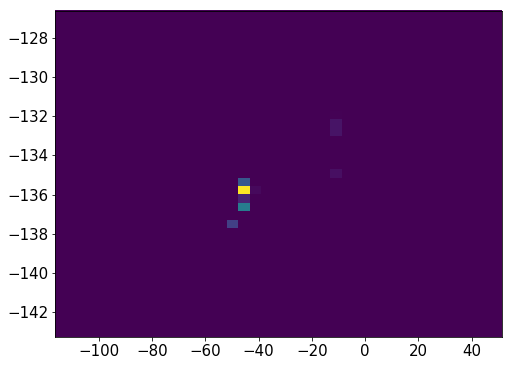

20578    25
20579    25
20580    25
20581    25
20582    25
20583    25
20584    25
20585    25
20586    25
20587    25
20588    25
20589    25
20590    25
20591    25
20592    25
20593    25
20594    25
20595    25
20596    25
Name: Nsipm, dtype: uint16


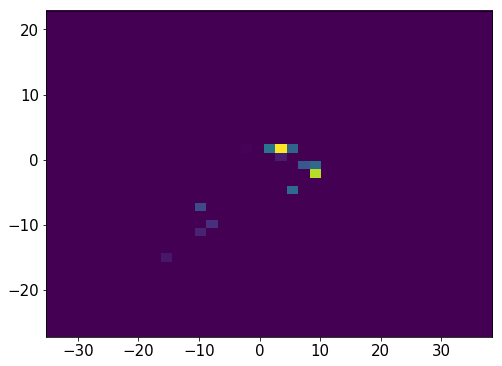

20601    39
20602    39
20603    39
20604    39
20605    39
20606    39
20607    39
20608    39
20609    39
20610    39
20611    39
20612    39
20613    39
20614    39
20615    39
20616    39
20617    39
20618    39
20619    39
20622    39
20623    39
20624    39
20625    39
20626    39
Name: Nsipm, dtype: uint16


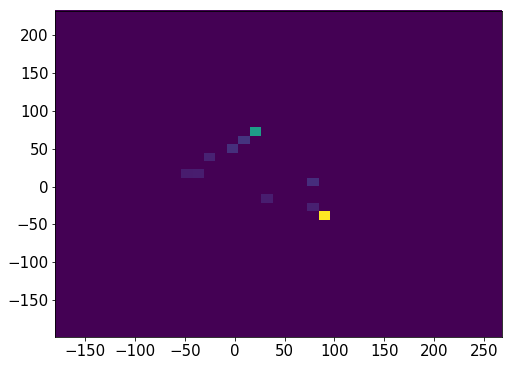

20630    23
20631    23
20632    23
20633    23
20634    23
20635    23
20636    23
20637    23
20638    23
20639    23
20640    23
20641    23
20642    23
Name: Nsipm, dtype: uint16


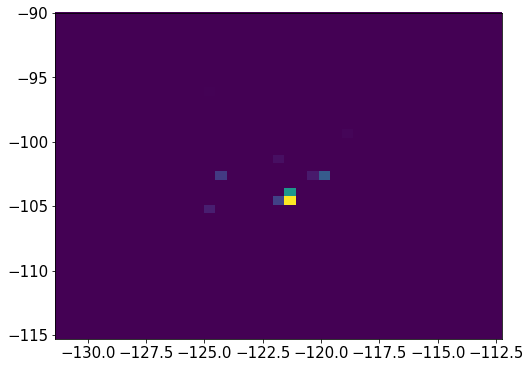

20646    30
20647    30
20648    30
20649    30
20650    30
20651    30
20652    30
20653    30
20654    30
20655    30
20656    30
20657    30
20658    30
20659    30
20660    30
20661    30
20662    30
20663    30
20664    30
20665    30
20666    30
20667    30
20668    30
20669    30
20670    30
Name: Nsipm, dtype: uint16


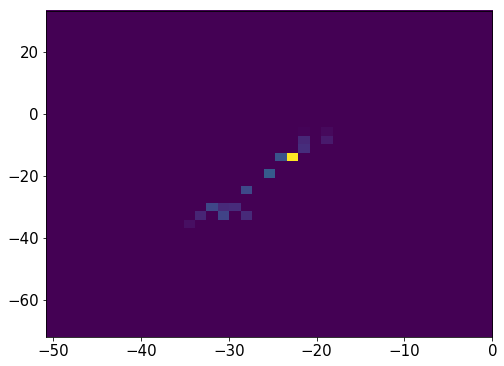

937060    33
937061    33
937062    33
937063    33
937064    33
937065    33
937066    33
937067    33
937068    33
937069    33
937070    33
937071    33
937072    33
937073    33
937074    33
937075    33
937076    33
937077    33
937078    33
Name: Nsipm, dtype: uint16


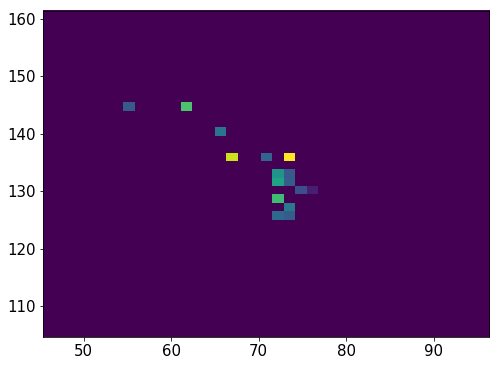

1904409    27
1904410    27
1904411    27
1904412    27
1904413    27
1904414    27
1904415    27
1904416    27
1904417    27
1904418    27
1904419    27
1904420    27
1904421    27
1904422    27
1904423    27
1904424    27
1904425    27
1904426    27
1904427    27
1904428    27
1904429    27
Name: Nsipm, dtype: uint16


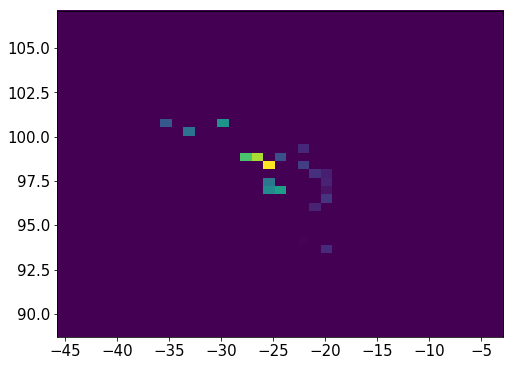

955903    21
955904    21
955905    21
955906    21
955907    21
955908    21
955909    21
955910    21
955911    21
955912    21
955913    21
955919     1
955920     1
955921     1
955922     1
955923     1
955928    15
955929    15
955930    15
955931    15
955932    15
955933    15
955934    15
955935    15
955936    15
Name: Nsipm, dtype: uint16


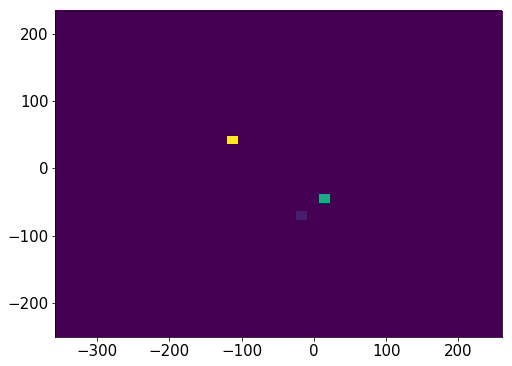

955942    32
955943    32
955944    32
955945    32
955946    32
955947    32
955948    32
955949    32
955950    32
955951    32
955952    32
955953    32
955954    32
955955    32
955956    32
955957    32
955958    32
955959    32
955960    32
955961    32
955962    32
955963    32
955964    32
955965    32
955966    32
955967    32
955972    32
955974    32
955976    32
955977    32
955978    32
955979    32
955980    32
955981    32
955982    32
955983    32
955984    32
Name: Nsipm, dtype: uint16


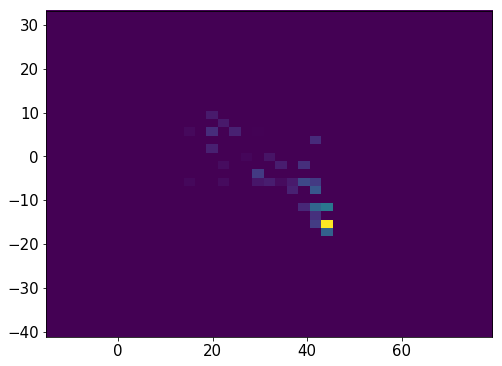

955989    31
955990    31
955991    31
955992    31
955993    31
955994    31
955995    31
955996    31
955997    31
955998    31
955999    31
956000    31
956001    31
956002    31
Name: Nsipm, dtype: uint16


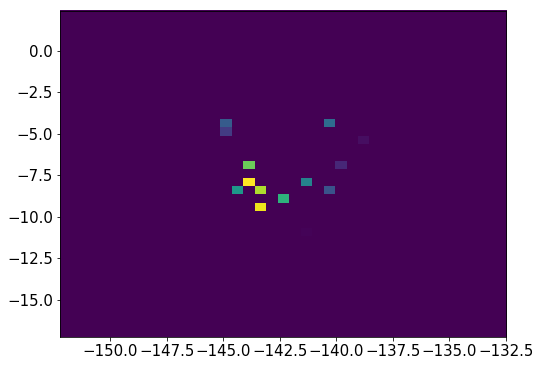

20675    20
20676    20
20677    20
20678    20
20679    20
20680    20
20681    20
20682    20
20683    20
20684    20
20685    20
20686    20
20687    20
20688    20
20689    20
20690    20
20691    20
Name: Nsipm, dtype: uint16


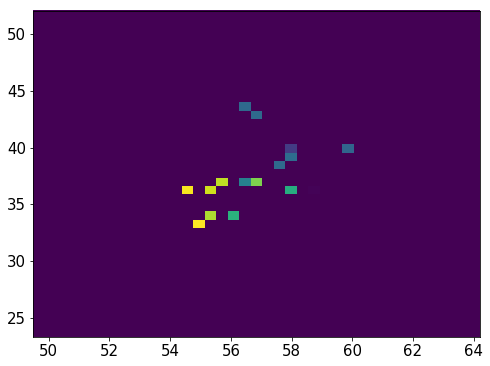

20697    27
20698    27
20699    27
20700    27
20701    27
20702    27
20703    27
20704    27
20705    27
20706    27
20707    27
20708    27
20711    27
20712    27
20713    27
20714    27
20715    27
20716    27
Name: Nsipm, dtype: uint16


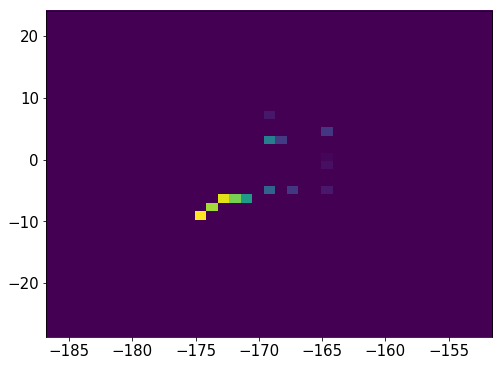

956025    33
956026    33
956027    33
956028    33
956029    33
956030    33
956031    33
956032    33
956033    33
956034    33
956035    33
956036    33
956037    33
956038    33
956039    33
956040    33
Name: Nsipm, dtype: uint16


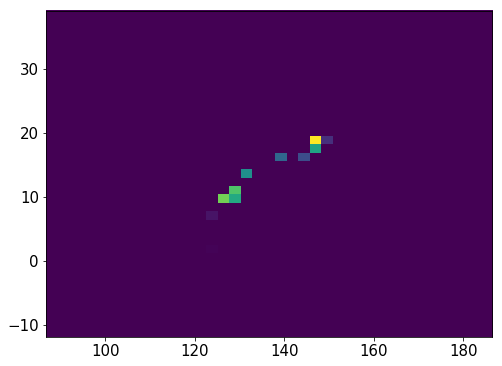

956044    31
956045    31
956046    31
956047    31
956048    31
956049    31
956050    31
956051    31
956052    31
956053    31
956054    31
956055    31
956056    31
956057    31
956058    31
Name: Nsipm, dtype: uint16


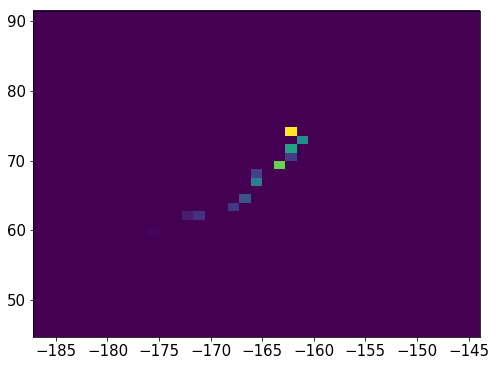

20721    26
20722    26
20723    26
20724    26
20725    26
20726    26
20727    26
20728    26
20729    26
20730    26
20731    26
20732    26
20733    26
20734    26
Name: Nsipm, dtype: uint16


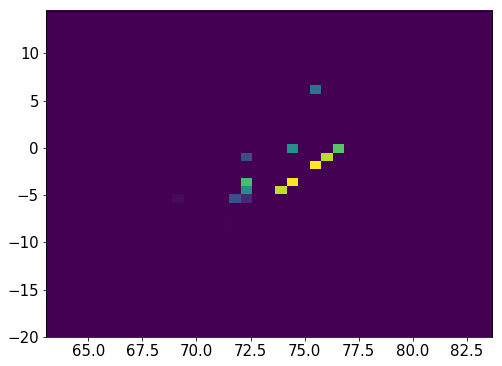

956063    38
956064    38
956065    38
956066    38
956067    38
956068    38
956069    38
956070    38
956071    38
956072    38
956073    38
956074    38
956075    38
956076    38
Name: Nsipm, dtype: uint16


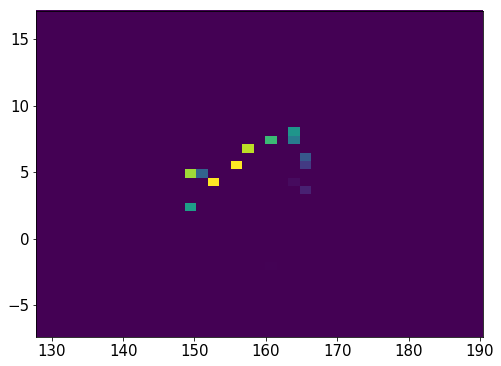

956081    24
956082    24
956083    24
956084    24
956085    24
956086    24
956087    24
956088    24
956089    24
956090    24
956091    24
956092    24
956093    24
956094    24
956095    24
956096    24
956097    24
956098    24
956099    24
956100    24
956101    24
956102    24
956103    24
956104    24
956105    24
956106    24
956107    24
Name: Nsipm, dtype: uint16


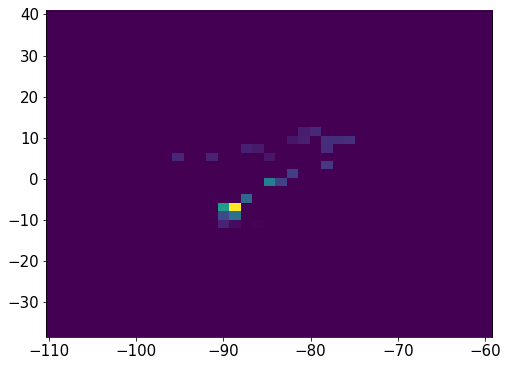

20778    29
20779    29
20780    29
20781    29
20782    29
20783    29
20784    29
20785    29
20786    29
20787    29
20788    29
20789    29
20790    29
20791    29
20792    29
Name: Nsipm, dtype: uint16


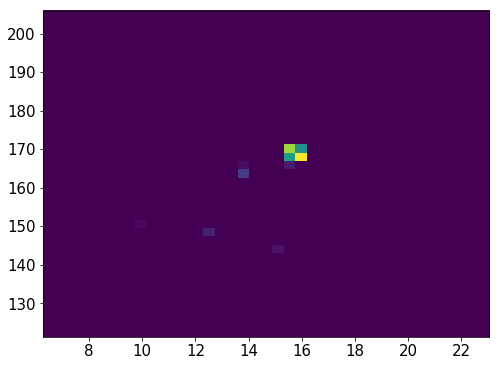

20797    24
20798    24
20799    24
20800    24
20801    24
20802    24
20803    24
20804    24
20805    24
20806    24
20807    24
20808    24
20809    24
20810    24
20811    24
20812    24
20813    24
20814    24
20815    24
20816    24
20817    24
20818    24
20820    24
20821    24
Name: Nsipm, dtype: uint16


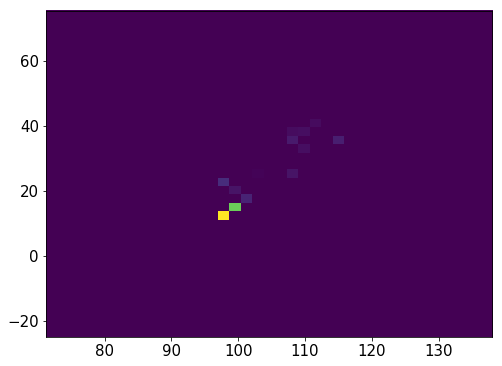

956114    30
956115    30
956116    30
956117    30
956118    30
956119    30
956120    30
956121    30
956122    30
956123    30
956124    30
956127    30
956128    30
956129    30
956130    30
956132    30
956133    30
956134    30
956135    30
956136    30
956137    30
956138    30
956139    30
956140    30
956141    30
956146    12
956147    12
956148    12
956149    12
956150    12
956151    12
956152    12
956153    12
Name: Nsipm, dtype: uint16


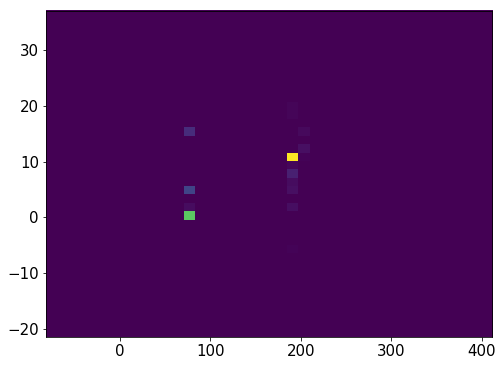

20824    32
20825    32
20826    32
20827    32
20828    32
20829    32
20830    32
20831    32
20832    32
20833    32
20834    32
20835    32
20836    32
20837    32
20838    32
20839    32
20840    32
20841    32
20842    32
Name: Nsipm, dtype: uint16


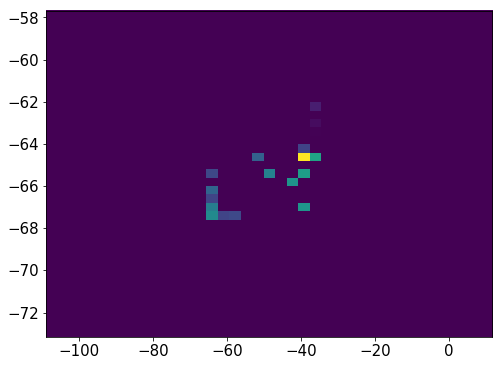

20846    26
20847    26
20848    26
20849    26
20850    26
20851    26
20852    26
20853    26
20854    26
20855    26
20856    26
20857    26
20858    26
20859    26
20860    26
20861    26
20862    26
20863    26
20864    26
20869    26
20870    26
20871    26
20872    26
20873    26
Name: Nsipm, dtype: uint16


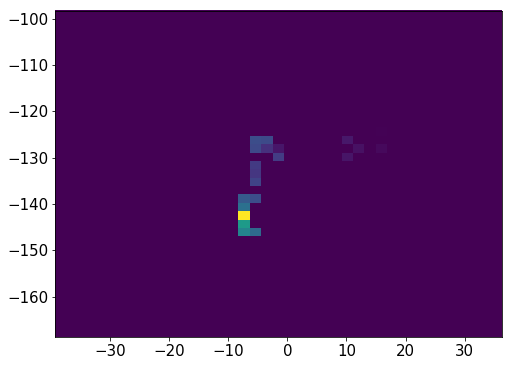

956158    24
956159    24
956160    24
956161    24
956162    24
956163    24
956164    24
956165    24
956166    24
956167    24
956168    24
956169    24
956170    24
956171    24
956172    24
956173    24
956174    24
956175    24
956176    24
956177    24
956178    24
956179    24
956180    24
956181    24
956182    24
956187    24
956188    24
956189    24
956190    24
956191    24
956192    24
Name: Nsipm, dtype: uint16


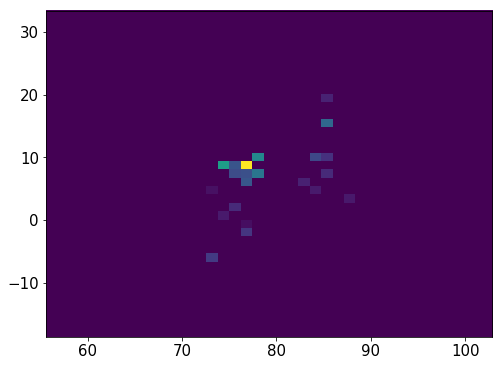

20879    28
20880    28
20881    28
20882    28
20883    28
20884    28
20885    28
20886    28
20887    28
20888    28
20889    28
20890    28
20896    28
20897    28
20898    28
20899    28
20900    28
20901    28
20902    28
20904     1
20905     1
20906     1
20907     1
20908     1
Name: Nsipm, dtype: uint16


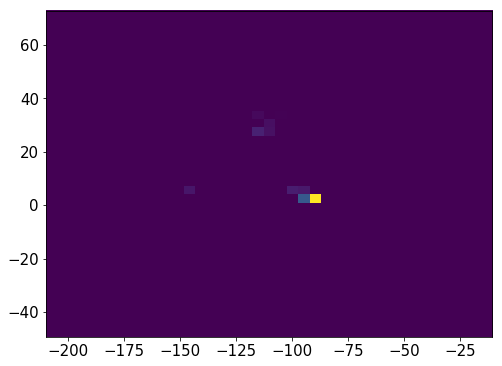

20914    31
20915    31
20916    31
20917    31
20918    31
20919    31
20920    31
20921    31
20922    31
20923    31
20924    31
20925    31
20926    31
20927    31
20928    31
20929    31
20930    31
20931    31
20932    31
20933    31
20934    31
20935    31
20936    31
20937    31
20938    31
20939    31
20940    31
20941    31
20942    31
20943    31
20944    31
Name: Nsipm, dtype: uint16


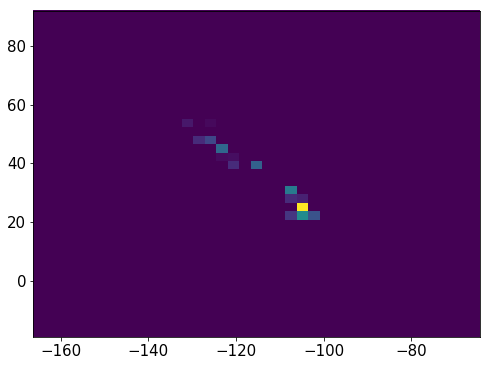

20949    22
20950    22
20951    22
20952    22
20953    22
20954    22
20955    22
20956    22
20957    22
20958    22
20959    22
20960    22
20961    22
20962    22
20963    22
20964    22
20965    22
20966    22
20967    22
20968    22
20969    22
20970    22
20971    22
20972    22
20973    22
20974    22
20975    22
20976    22
20977    22
20978    22
20979    22
20985     1
20986     1
20987     1
20988     1
Name: Nsipm, dtype: uint16


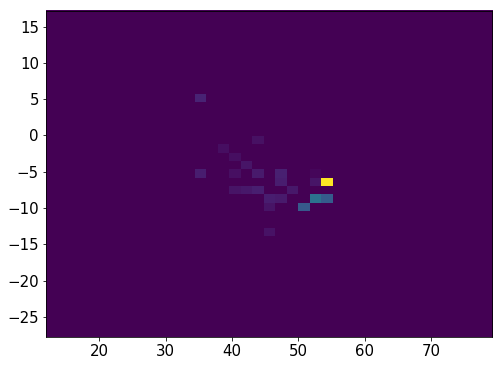

20994    23
20995    23
20996    23
20999    23
21000    23
21001    23
21002    23
21003    23
21004    23
21005    23
21006    23
21007    23
21008    23
21009    23
21010    23
21011    23
21012    23
21013    23
21014    23
21015    23
21016    23
21017    23
21018    23
21019    23
21020    23
21021    23
21022    23
Name: Nsipm, dtype: uint16


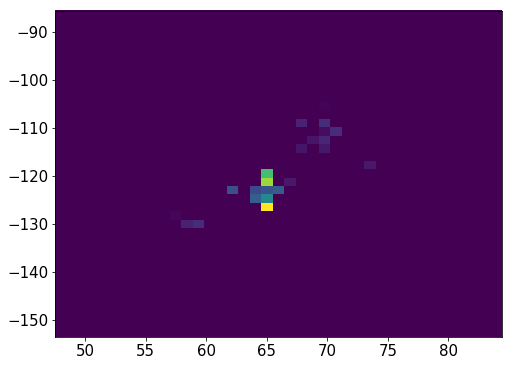

956199    26
956200    26
956201    26
956202    26
956203    26
956204    26
956205    26
956206    26
956207    26
956208    26
956209    26
956210    26
956211    26
956212    26
956213    26
956214    26
956215    26
956216    26
956217    26
Name: Nsipm, dtype: uint16


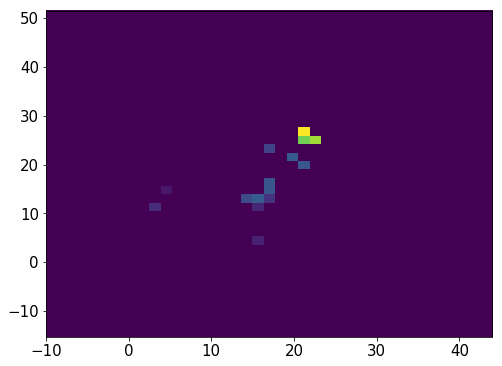

21024    20
21025    20
21026    20
21027    20
21028    20
21029    20
21030    20
21031    20
21032    20
21033    20
21034    20
21035    20
21036    20
21037    20
21038    20
21039    20
21040    20
21041    20
21042    20
21043    20
21045    20
21046    20
21049    20
21050    20
21053    20
21054    20
21058    20
21066     2
21067     2
21068     2
21069     2
21070     2
Name: Nsipm, dtype: uint16


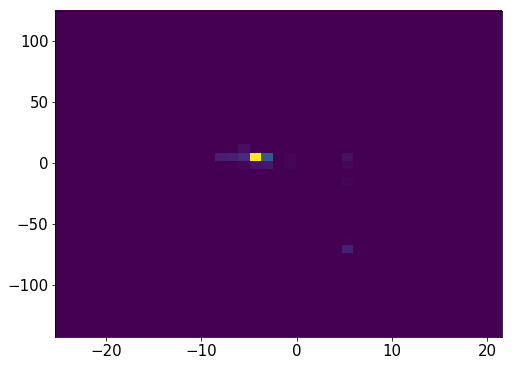

21075    22
21076    22
21077    22
21078    22
21079    22
21080    22
21081    22
21082    22
21083    22
21084    22
21085    22
21086    22
21087    22
21088    22
21089    22
21090    22
Name: Nsipm, dtype: uint16


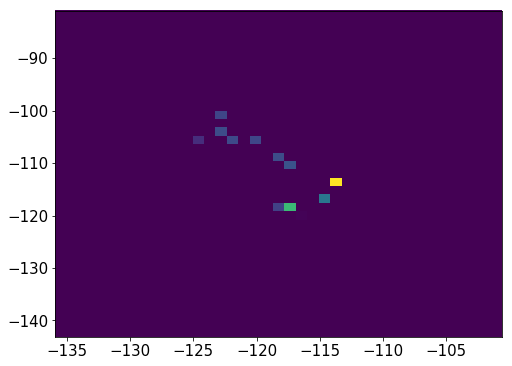

21095    32
21096    32
21097    32
21098    32
21099    32
21100    32
21101    32
21102    32
21103    32
21104    32
21105    32
21106    32
21107    32
21108    32
21109    32
21110    32
Name: Nsipm, dtype: uint16


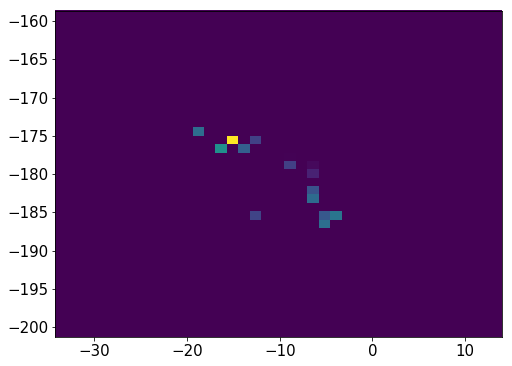

21114    23
21115    23
21116    23
21117    23
21118    23
21119    23
21120    23
21121    23
21122    23
21123    23
21124    23
21125    23
21126    23
21127    23
Name: Nsipm, dtype: uint16


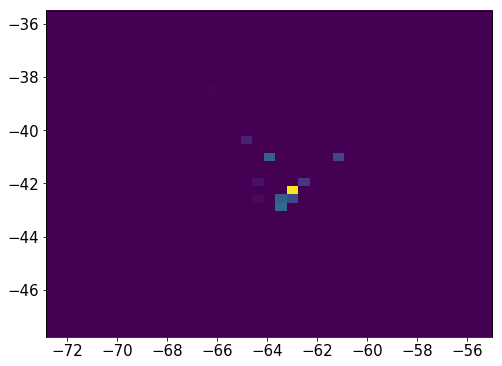

956306    26
956307    26
956308    26
956309    26
956310    26
956311    26
956312    26
956313    26
956314    26
956315    26
956316    26
956317    26
956318    26
956319    26
956320    26
956321    26
956322    26
956323    26
956324    26
956325    26
956326    26
956329    26
956330    26
956331    26
956332    26
956333    26
Name: Nsipm, dtype: uint16


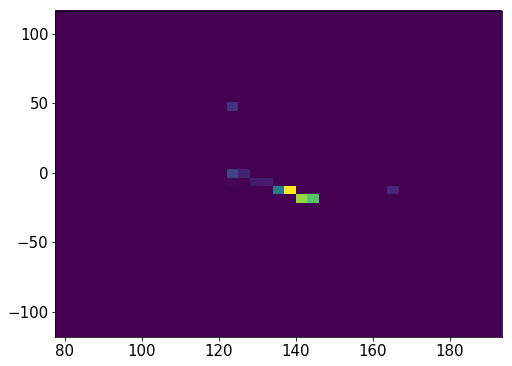

21132    30
21133    30
21134    30
21135    30
21136    30
21137    30
21138    30
21139    30
21140    30
21141    30
21142    30
21143    30
21144    30
21145    30
21146    30
21147    30
21148    30
21149    30
21151    30
21152    30
21153    30
21154    30
21155    30
Name: Nsipm, dtype: uint16


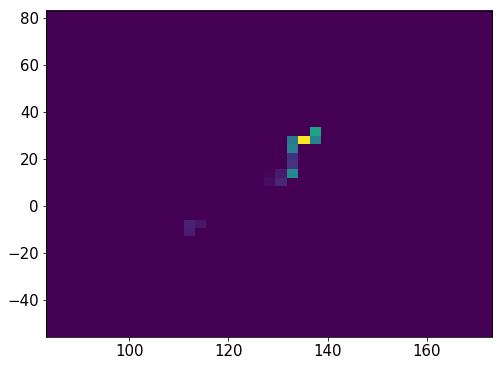

956369    26
956370    26
956371    26
956372    26
956373    26
956374    26
956375    26
956376    26
956377    26
956378    26
956379    26
Name: Nsipm, dtype: uint16


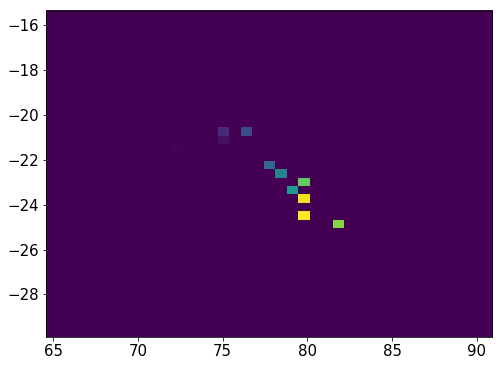

21161    22
21162    22
21163    22
21164    22
21165    22
21166    22
21168    22
21169    22
21170    22
21171    22
21172    22
21173    22
21174    22
21175    22
21176    22
21177    22
21178    22
21179    22
21180    22
21181    22
21182    22
21183    22
21184    22
21185    22
21186    22
Name: Nsipm, dtype: uint16


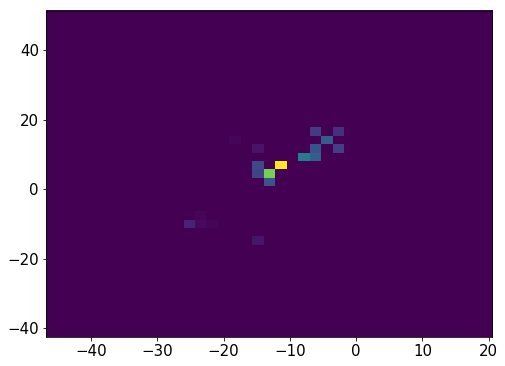

1904450    20
1904451    20
1904452    20
1904453    20
1904454    20
1904455    20
1904456    20
1904457    20
1904458    20
1904459    20
1904460    20
1904461    20
1904462    20
1904463    20
1904464    20
Name: Nsipm, dtype: uint16


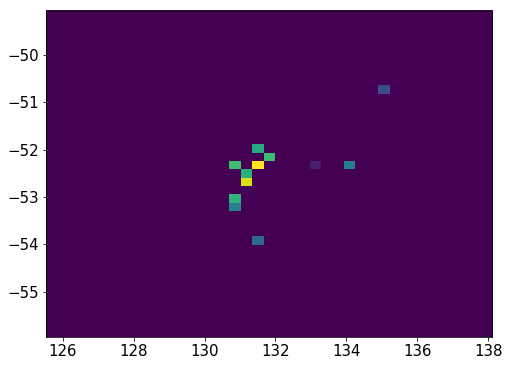

21187    29
21188    29
21189    29
21190    29
21191    29
21192    29
21193    29
21194    29
21195    29
21196    29
21197    29
21198    29
21199    29
21200    29
21201    29
21202    29
21203    29
21204    29
21205    29
Name: Nsipm, dtype: uint16


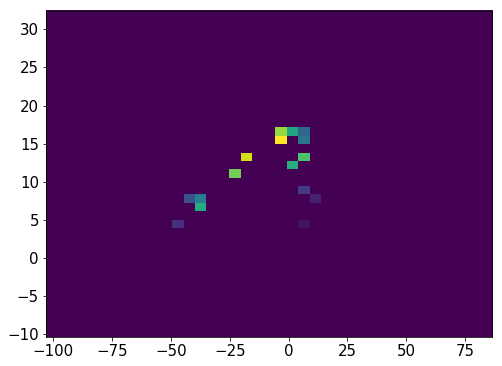

21210    22
21211    22
21212    22
21213    22
21214    22
21215    22
21216    22
21217    22
21218    22
21219    22
21220    22
21221    22
21222    22
21223    22
21224    22
21225    22
21226    22
Name: Nsipm, dtype: uint16


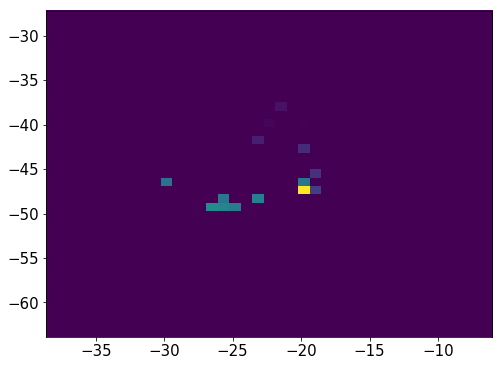

956385    37
956386    37
956387    37
956388    37
956389    37
956390    37
956391    37
956392    37
956393    37
956394    37
956395    37
956396    37
956397    37
956398    37
956399    37
956400    37
956401    37
956402    37
956403    37
956404    37
956405    37
956406    37
956407    37
956408    37
956409    37
956410    37
Name: Nsipm, dtype: uint16


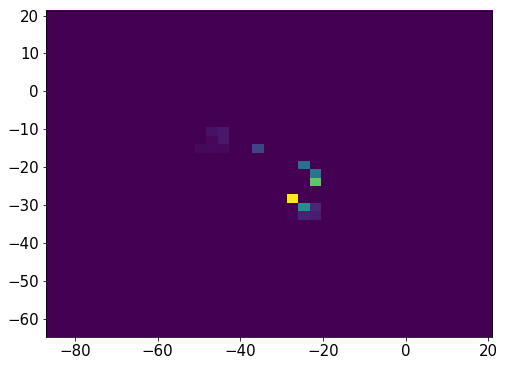

21231    30
21232    30
21233    30
21234    30
21235    30
21236    30
21237    30
21238    30
21239    30
21240    30
21241    30
21242    30
21243    30
21244    30
21245    30
21246    30
21247    30
Name: Nsipm, dtype: uint16


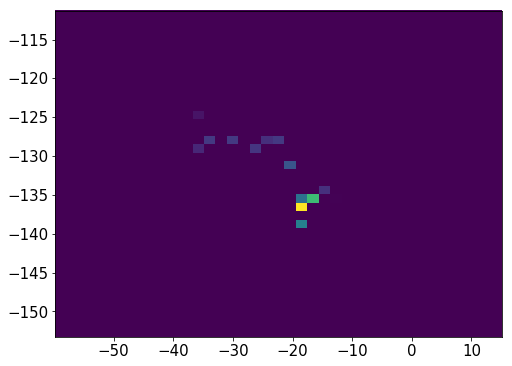

956414    20
956415    20
956416    20
956417    20
956418    20
956419    20
956420    20
956421    20
956422    20
956423    20
956424    20
956425    20
956426    20
956427    20
956428    20
956429    20
956430    20
956431    20
956432    20
956433    20
956434    20
956435    20
956436    20
Name: Nsipm, dtype: uint16


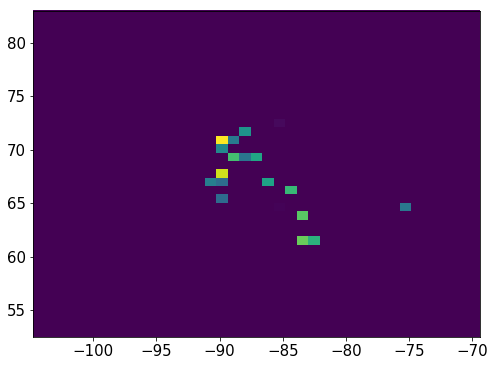

21252    39
21253    39
21254    39
21255    39
21256    39
21257    39
21258    39
21259    39
21260    39
21261    39
Name: Nsipm, dtype: uint16


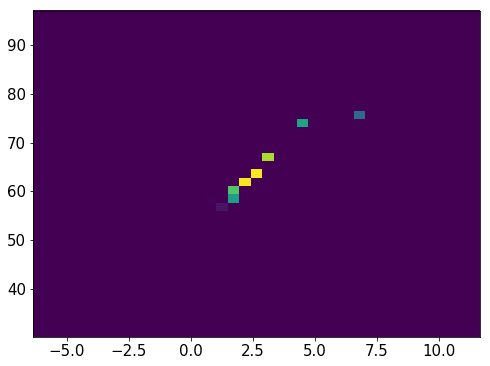

956441    26
956442    26
956443    26
956444    26
956445    26
956446    26
956447    26
956448    26
956449    26
956450    26
956451    26
956452    26
956453    26
956454    26
956455    26
956456    26
956457    26
956458    26
956459    26
956460    26
956461    26
956462    26
Name: Nsipm, dtype: uint16


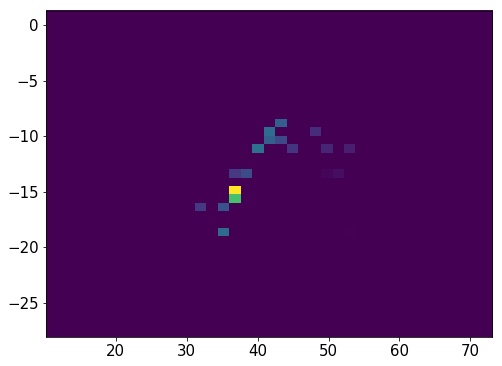

956467    21
956468    21
956469    21
956470    21
956471    21
956472    21
956473    21
956474    21
956475    21
956476    21
956477    21
956478    21
956479    21
956480    21
956481    21
956482    21
956483    21
Name: Nsipm, dtype: uint16


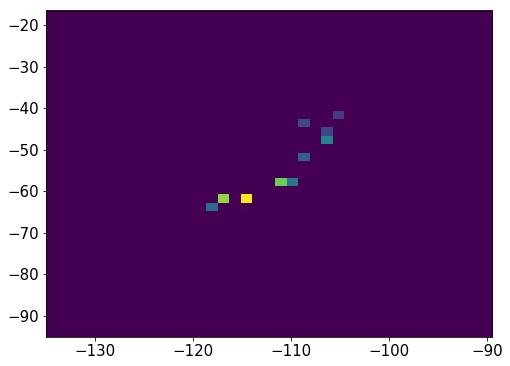

956488    26
956489    26
956490    26
956491    26
956492    26
956493    26
956494    26
956495    26
956496    26
956497    26
956498    26
956499    26
Name: Nsipm, dtype: uint16


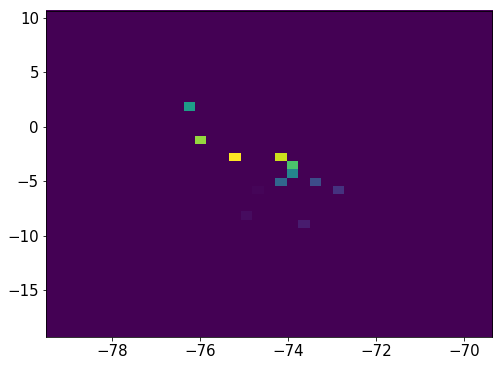

21266    25
21267    25
21268    25
21269    25
21270    25
21271    25
21272    25
21273    25
21274    25
21275    25
21276    25
21277    25
21278    25
Name: Nsipm, dtype: uint16


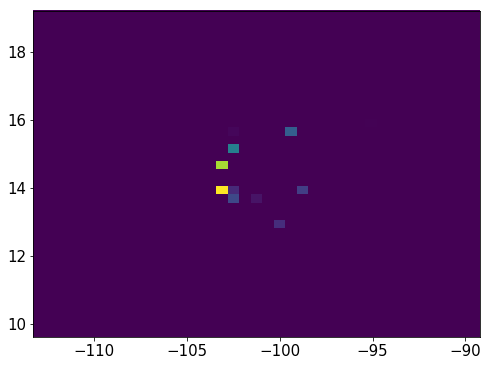

21283    25
21284    25
21285    25
21286    25
21287    25
21288    25
21289    25
21290    25
21291    25
21292    25
21293    25
21294    25
21295    25
21296    25
21297    25
21298    25
21299    25
21300    25
21301    25
21302    25
Name: Nsipm, dtype: uint16


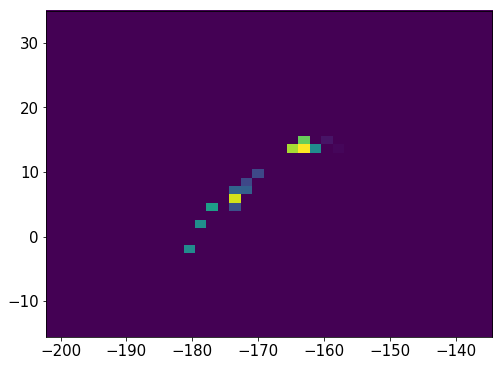

956538    29
956539    29
956540    29
956541    29
956542    29
956543    29
956544    29
956545    29
956546    29
956547    29
956548    29
956549    29
956550    29
956551    29
956552    29
956554    29
956555    29
956556    29
956557    29
956558    29
956559    29
956560    29
956561    29
956562    29
956563    29
956564    29
956565    29
956566    29
956567    29
956568    29
956569    29
956570    29
956571    29
956572    29
956573    29
956574    29
Name: Nsipm, dtype: uint16


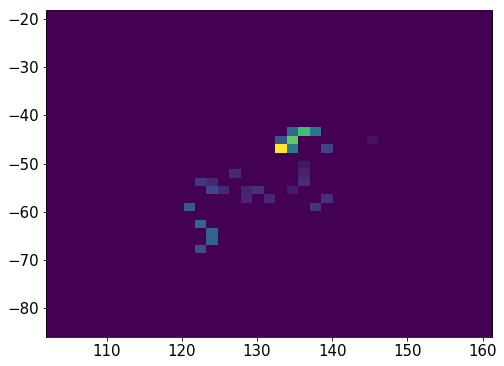

21308    23
21309    23
21310    23
21311    23
21312    23
21313    23
21314    23
21315    23
21316    23
21317    23
21318    23
21319    23
21320    23
21321    23
21322    23
21323    23
21324    23
21325    23
21326    23
21327    23
21328    23
21329    23
Name: Nsipm, dtype: uint16


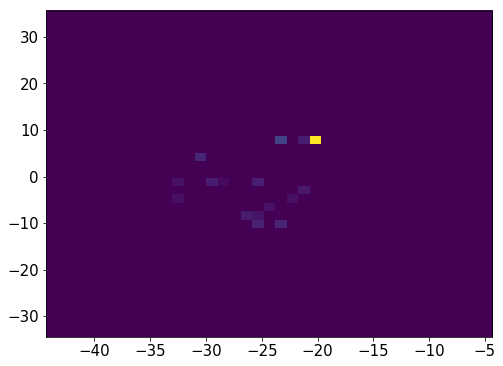

21335    21
21336    21
21337    21
21338    21
21339    21
21340    21
21341    21
21342    21
21343    21
21344    21
21345    21
21346    21
21347    21
21348    21
21349    21
21350    21
21351    21
21352    21
21353    21
Name: Nsipm, dtype: uint16


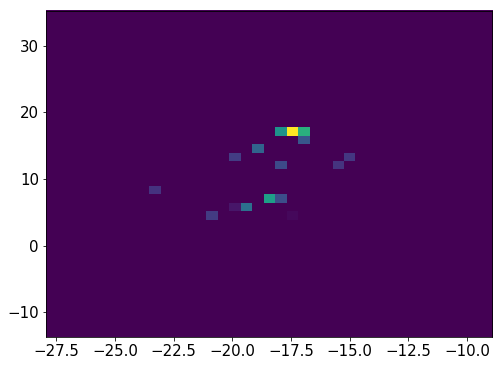

21359    39
21360    39
21361    39
21362    39
21363    39
21364    39
21365    39
21366    39
21367    39
21368    39
21369    39
21370    39
Name: Nsipm, dtype: uint16


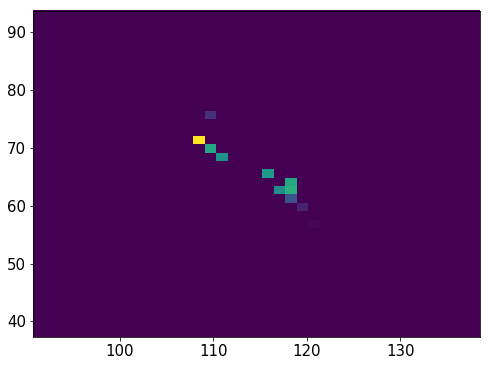

956579    26
956580    26
956581    26
956582    26
956583    26
956584    26
956585    26
956586    26
956587    26
956588    26
956589    26
956590    26
956591    26
956592    26
956593    26
956594    26
Name: Nsipm, dtype: uint16


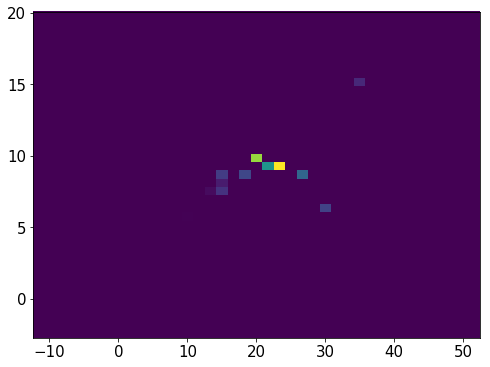

21373    50
21374    50
21375    50
21376    50
21377    50
21378    50
21379    50
21380    50
21381    50
21382    50
Name: Nsipm, dtype: uint16


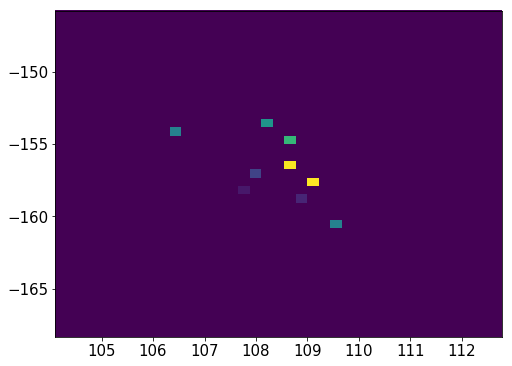

21385    23
21386    23
21387    23
21388    23
21389    23
21390    23
21391    23
21392    23
21393    23
21394    23
21395    23
21400     1
21401     1
21402     1
21403     1
Name: Nsipm, dtype: uint16


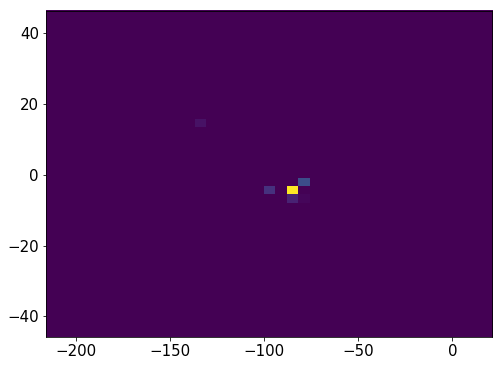

21410    24
21411    24
21412    24
21413    24
21414    24
21415    24
21416    24
21417    24
21418    24
21419    24
21420    24
21421    24
Name: Nsipm, dtype: uint16


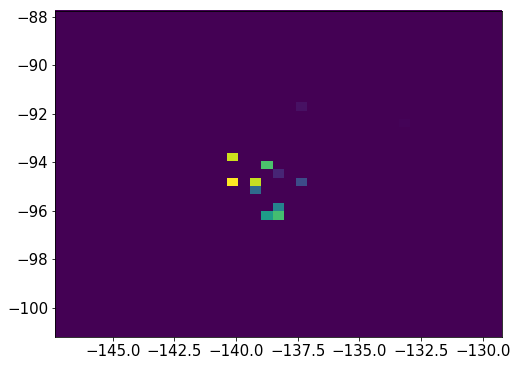

21426    22
21427    22
21428    22
21429    22
21430    22
21431    22
21432    22
21433    22
21434    22
21435    22
21436    22
21437    22
21438    22
21439    22
21440    22
21441    22
21442    22
21443    22
21444    22
21445    22
21446    22
21451     1
21452     1
21453     1
21454     1
21456     1
Name: Nsipm, dtype: uint16


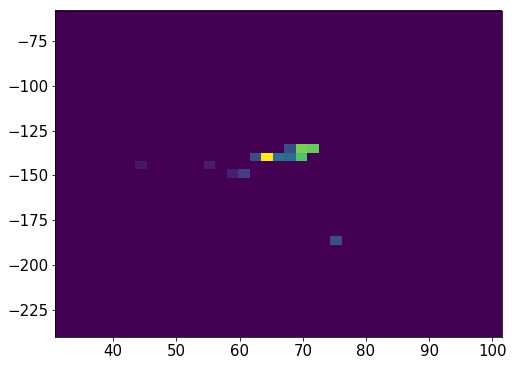

956619    19
956620    19
956621    19
956622    19
956623    19
956624    19
956625    19
956626    19
956627    19
956628    19
956629    19
956630    19
956631    19
956632    19
956633    19
956634    19
956635    19
956636    19
956637    19
956638    19
956639    19
956640    19
956641    19
956642    19
956643    19
Name: Nsipm, dtype: uint16


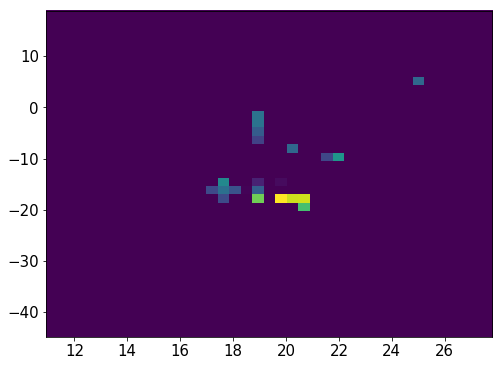

21460    26
21461    26
21462    26
21463    26
21464    26
21465    26
21466    26
21467    26
21468    26
21469    26
21470    26
21471    26
21472    26
Name: Nsipm, dtype: uint16


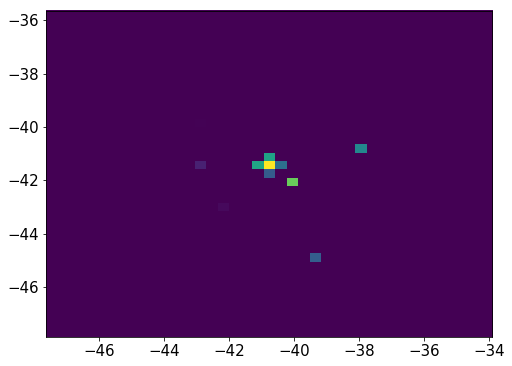

21477    21
21478    21
21479    21
21480    21
21481    21
21482    21
21483    21
21484    21
21485    21
21486    21
21487    21
21493     2
21494     2
21495     2
21496     2
21497     2
21503    12
21504    12
21505    12
21506    12
21507    12
21508    12
21509    12
21510    12
21511    12
Name: Nsipm, dtype: uint16


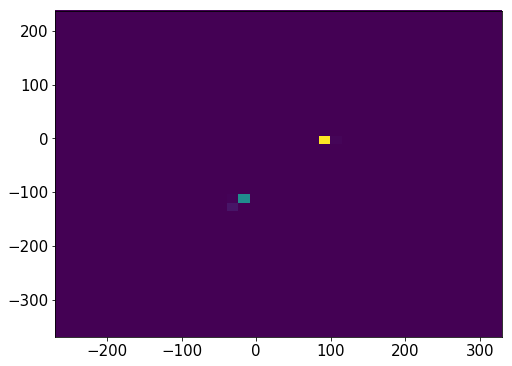

21516    24
21517    24
21518    24
21519    24
21520    24
21521    24
21522    24
21523    24
21524    24
21525    24
21526    24
21527    24
21528    24
21529    24
21530    24
21531    24
Name: Nsipm, dtype: uint16


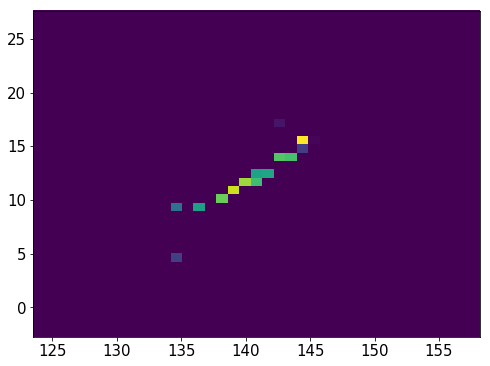

956648    28
956649    28
956650    28
956651    28
956652    28
956653    28
956654    28
956655    28
956656    28
956657    28
956658    28
956659    28
956660    28
956661    28
956662    28
956663    28
956664    28
956665    28
956666    28
956667    28
Name: Nsipm, dtype: uint16


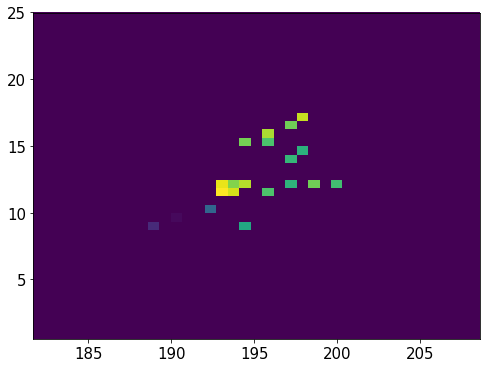

956672    26
956673    26
956674    26
956675    26
956676    26
956677    26
956678    26
956679    26
956680    26
956681    26
956682    26
956683    26
956684    26
956685    26
956686    26
956687    26
956688    26
Name: Nsipm, dtype: uint16


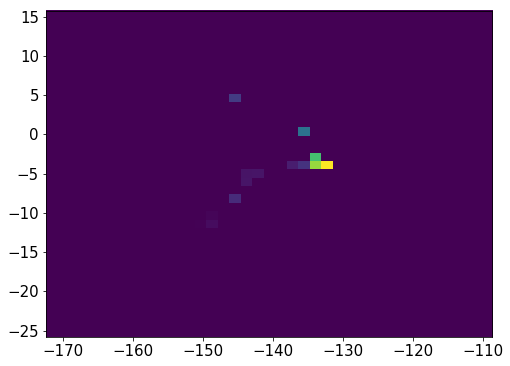

956697    40
956698    40
956699    40
956700    40
956701    40
956702    40
956703    40
956704    40
956706    10
956707    10
956708    10
956709    10
956710    10
956711    10
956712    10
956713    10
Name: Nsipm, dtype: uint16


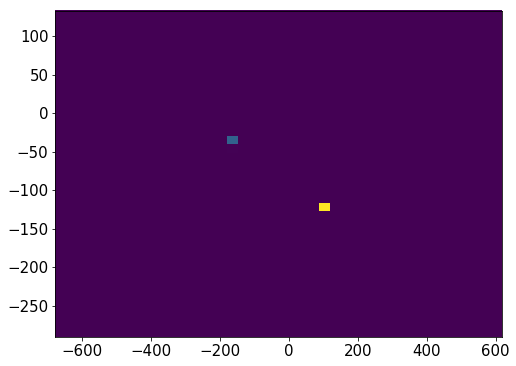

21562    39
21563    39
21564    39
21565    39
21566    39
21567    39
21568    39
21569    39
21570    39
21571    39
21572    39
21573    39
21574    39
21575    39
21576    39
Name: Nsipm, dtype: uint16


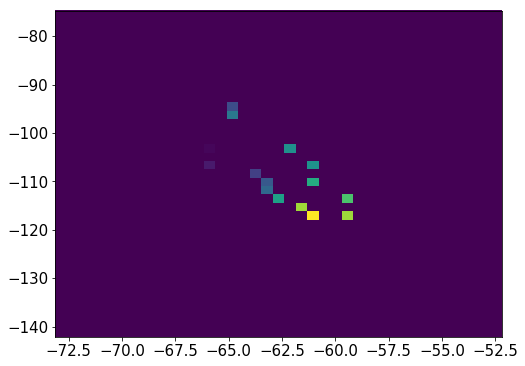

21580    29
21581    29
21582    29
21583    29
21584    29
21585    29
21586    29
21587    29
21588    29
21589    29
Name: Nsipm, dtype: uint16


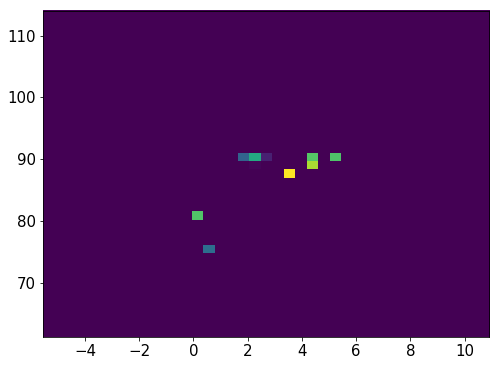

21594    21
21595    21
21596    21
21597    21
21598    21
21599    21
21600    21
21601    21
21602    21
21603    21
21604    21
21605    21
21606    21
21607    21
21608    21
21609    21
21610    21
21611    21
21612    21
Name: Nsipm, dtype: uint16


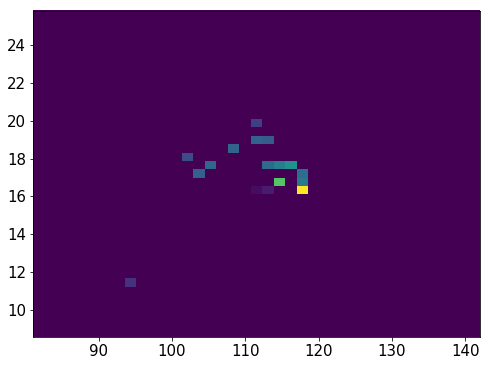

956746    24
956747    24
956748    24
956749    24
956750    24
956751    24
956752    24
956753    24
956754    24
956755    24
956756    24
956757    24
956758    24
956759    24
956760    24
956761    24
956762    24
956763    24
956764    24
956765    24
956766    24
956767    24
956768    24
956769    24
Name: Nsipm, dtype: uint16


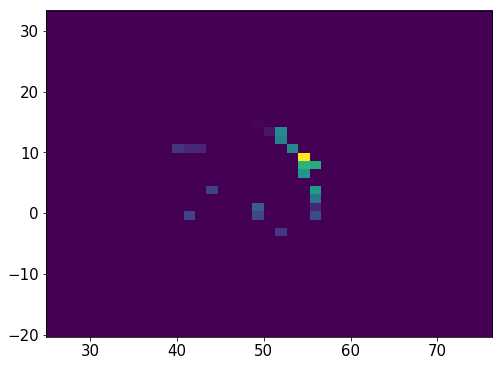

956776    36
956777    36
956782    36
956783    36
956784    36
956785    36
956786    36
956787    36
956788    36
956789    36
956790    36
956791    36
956792    36
956793    36
956794    36
956795    36
956796    36
956797    36
956798    36
956799    36
956800    36
956802    36
Name: Nsipm, dtype: uint16


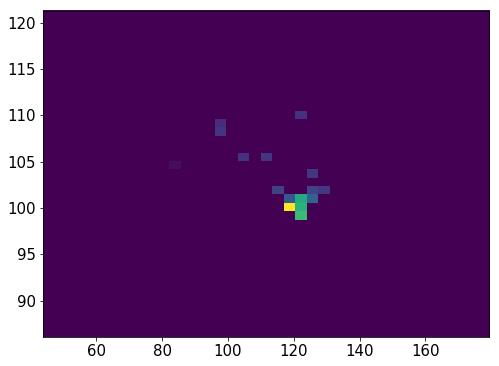

21616    52
21617    52
21618    52
21619    52
21620    52
21621    52
21622    52
21623    52
Name: Nsipm, dtype: uint16


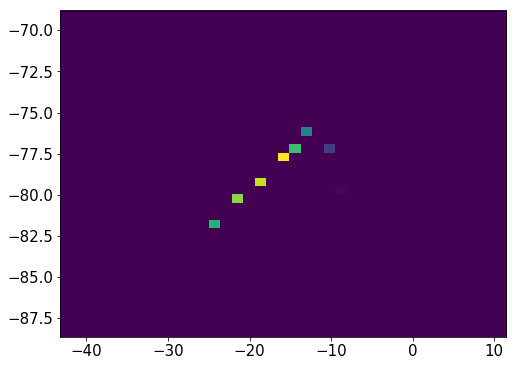

21626    21
21627    21
21628    21
21629    21
21630    21
21631    21
21632    21
21633    21
21634    21
21635    21
21636    21
21637    21
21638    21
21639    21
21640    21
21641    21
21642    21
21643    21
21644    21
Name: Nsipm, dtype: uint16


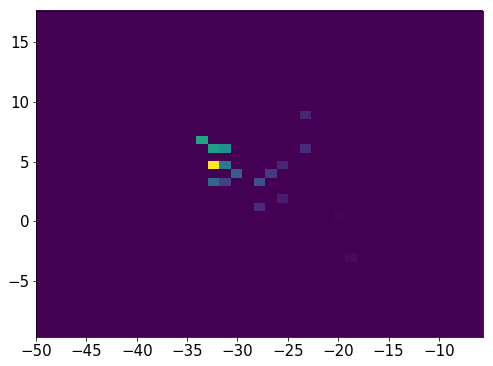

956804    25
956805    25
956806    25
956807    25
956808    25
956809    25
956810    25
956811    25
956812    25
956813    25
956814    25
956815    25
956816    25
956817    25
956818    25
956819    25
956820    25
956821    25
956822    25
956823    25
956824    25
956825    25
956826    25
956827    25
956828    25
Name: Nsipm, dtype: uint16


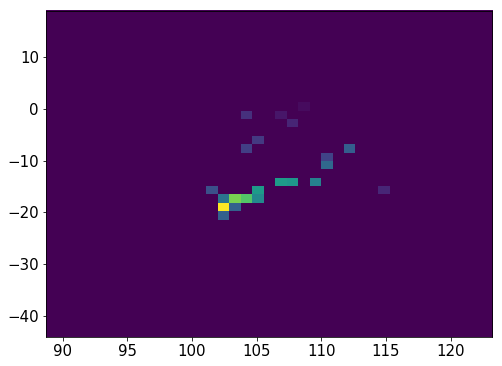

21650    27
21651    27
21652    27
21653    27
21654    27
21655    27
21656    27
21657    27
21658    27
21659    27
21660    27
21661    27
21662    27
21663    27
21664    27
Name: Nsipm, dtype: uint16


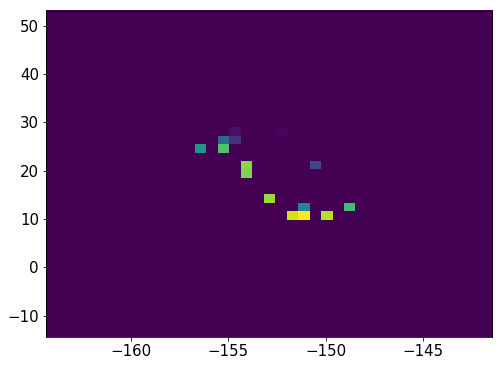

2272155    24
2272156    24
2272157    24
2272158    24
2272159    24
2272160    24
2272161    24
2272162    24
2272163    24
2272164    24
2272165    24
2272166    24
2272167    24
2272168    24
2272169    24
2272170    24
2272171    24
Name: Nsipm, dtype: uint16


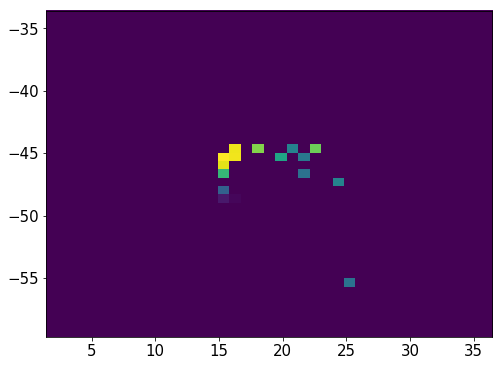

937200    36
937201    36
937202    36
937203    36
937204    36
937205    36
937206    36
937207    36
937208    36
937209    36
937210    36
937211    36
937212    36
937213    36
937214    36
937215    36
937216    36
937217    36
937218    36
937219    36
937220    36
937221    36
937222    36
937223    36
937224    36
937225    36
Name: Nsipm, dtype: uint16


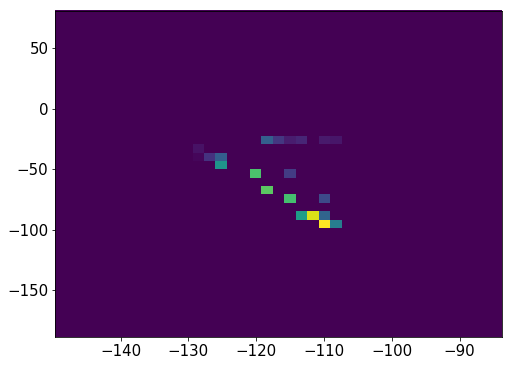

21668    24
21669    24
21670    24
21671    24
21672    24
21673    24
21674    24
21675    24
21676    24
21677    24
21678    24
21679    24
21680    24
21681    24
21682    24
21683    24
Name: Nsipm, dtype: uint16


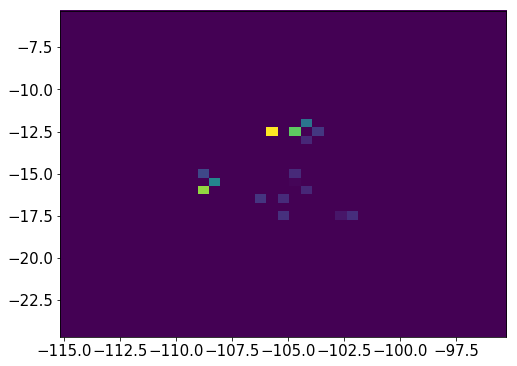

956833    31
956834    31
956835    31
956836    31
956837    31
956838    31
956839    31
956840    31
956841    31
956842    31
956843    31
956844    31
956845    31
956846    31
956847    31
956848    31
956849    31
956850    31
956851    31
956852    31
956853    31
956854    31
Name: Nsipm, dtype: uint16


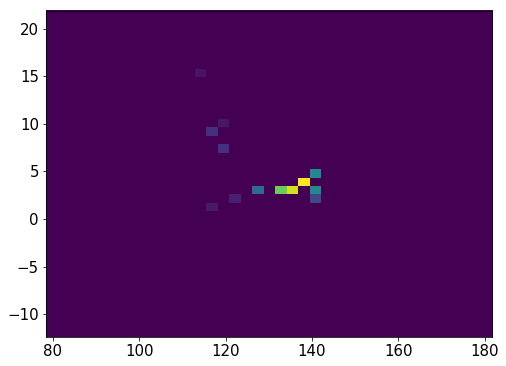

956859    26
956860    26
956861    26
956862    26
956863    26
956864    26
956865    26
956866    26
956867    26
956868    26
956869    26
956870    26
956871    26
956872    26
956873    26
956874    26
956875    26
956876    26
956877    26
956879    26
956880    26
956881    26
956882    26
956883    26
956884    26
Name: Nsipm, dtype: uint16


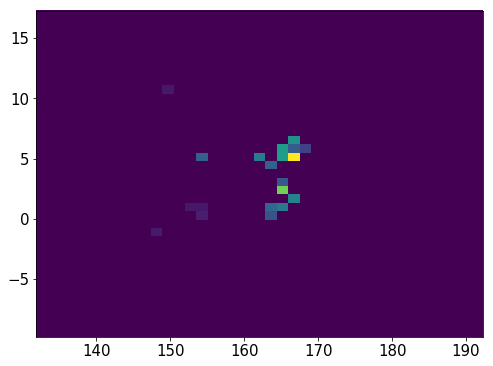

21689    27
21690    27
21691    27
21692    27
21693    27
21694    27
21695    27
21696    27
21697    27
21698    27
21699    27
21701    27
21705    27
21706    27
21707    27
21708    27
21709    27
21710    27
21711    27
21712    27
21713    27
21714    27
21715    27
21716    27
21717    27
Name: Nsipm, dtype: uint16


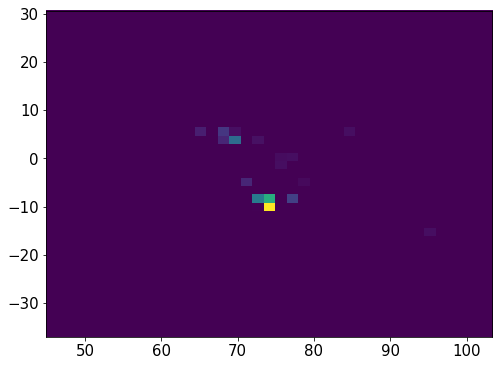

21722    22
21723    22
21724    22
21725    22
21726    22
21727    22
21728    22
21729    22
21730    22
21731    22
21732    22
21733    22
21734    22
21735    22
21736    22
21737    22
21738    22
Name: Nsipm, dtype: uint16


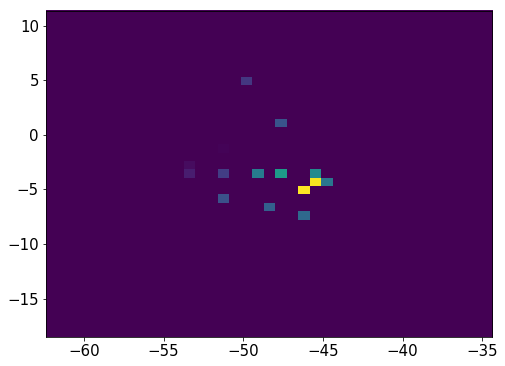

956892    28
956893    28
956894    28
956895    28
956896    28
956897    28
956898    28
956899    28
956900    28
956901    28
956902    28
956903    28
956904    28
956905    28
956906    28
956907    28
956908    28
956912     6
956913     6
956914     6
956915     6
956916     6
956917     6
Name: Nsipm, dtype: uint16


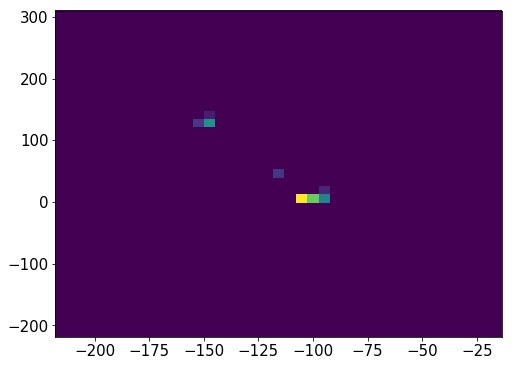

956921    26
956922    26
956923    26
956924    26
956925    26
956926    26
956927    26
956928    26
956929    26
956930    26
956931    26
956932    26
956933    26
956934    26
956935    26
956936    26
956937    26
Name: Nsipm, dtype: uint16


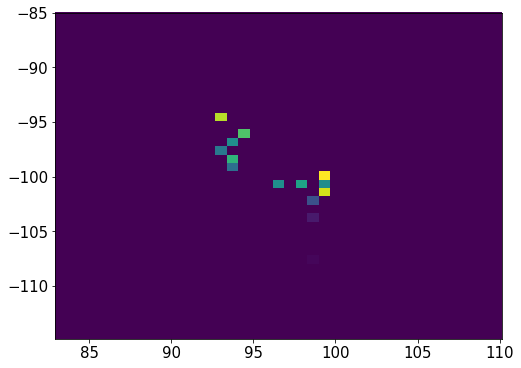

956943    26
956944    26
956945    26
956946    26
956947    26
956948    26
956949    26
956950    26
956951    26
956952    26
956953    26
956954    26
956960     6
956961     6
956962     6
956963     6
956964     6
956965     6
956966     6
956967     6
956968     6
956969     6
Name: Nsipm, dtype: uint16


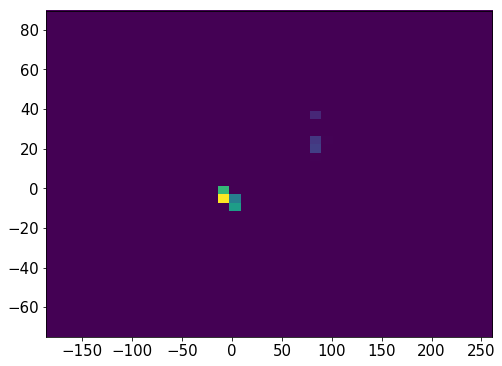

956973    26
956974    26
956975    26
956976    26
956977    26
956978    26
956979    26
956980    26
956981    26
956982    26
956983    26
956984    26
956985    26
956986    26
956987    26
956988    26
956989    26
956990    26
Name: Nsipm, dtype: uint16


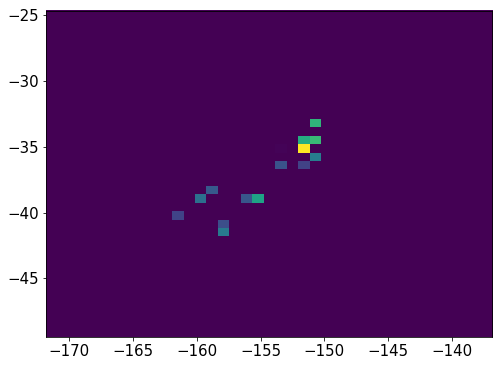

21745    23
21746    23
21747    23
21748    23
21749    23
21750    23
21751    23
21752    23
21753    23
21754    23
21755    23
21756    23
21757    23
21758    23
21759    23
21760    23
21761    23
21769    23
21770    23
21771    23
Name: Nsipm, dtype: uint16


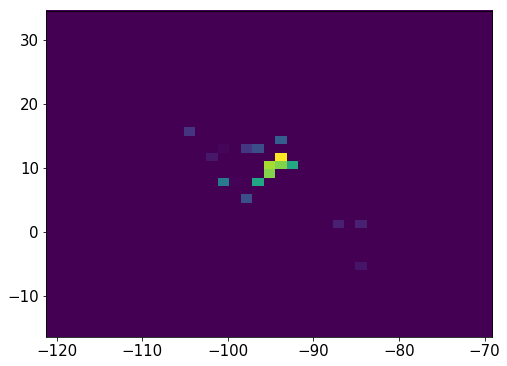

21775    22
21776    22
21777    22
21778    22
21779    22
21780    22
21781    22
21782    22
21783    22
21784    22
21785    22
21786    22
21787    22
21788    22
21789    22
21790    22
21791    22
Name: Nsipm, dtype: uint16


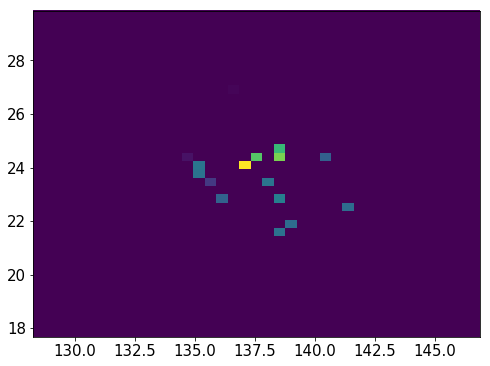

956998    21
956999    21
957000    21
957001    21
957002    21
957003    21
957004    21
957005    21
957006    21
957007    21
957008    21
957009    21
957010    21
957011    21
957012    21
957013    21
957014    21
957015    21
957016    21
957017    21
957018    21
Name: Nsipm, dtype: uint16


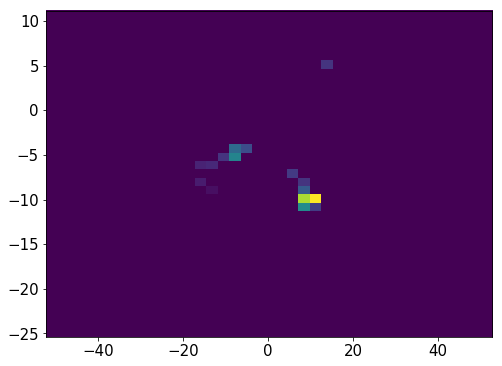

957022    29
957023    29
957024    29
957025    29
957026    29
957027    29
957028    29
957029    29
957030    29
957031    29
957032    29
957033    29
957034    29
957038    18
957039    18
957040    18
957041    18
957042    18
957043    18
957044    18
957045    18
957046    18
957047    18
Name: Nsipm, dtype: uint16


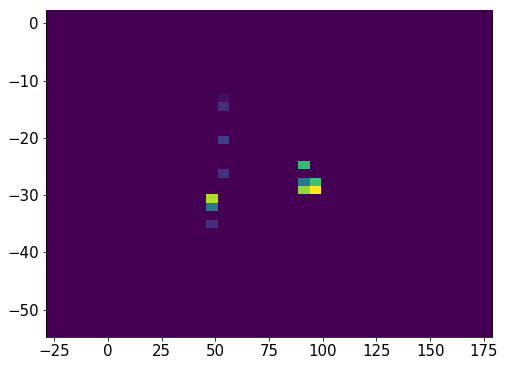

957051    20
957052    20
957053    20
957054    20
957055    20
957056    20
957057    20
957058    20
957059    20
957060    20
957061    20
957062    20
957063    20
957064    20
957065    20
957066    20
957067    20
957068    20
957069    20
957070    20
957071    20
Name: Nsipm, dtype: uint16


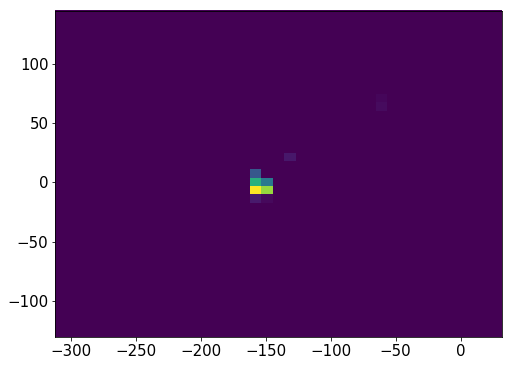

21796    27
21797    27
21798    27
21799    27
21800    27
21801    27
21802    27
21803    27
21804    27
21805    27
21806    27
21807    27
21808    27
21809    27
21810    27
21811    27
21812    27
21813    27
Name: Nsipm, dtype: uint16


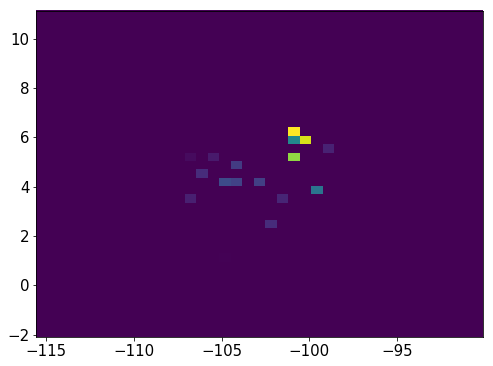

957072    30
957073    30
957074    30
957075    30
957076    30
957077    30
957078    30
957079    30
957080    30
957081    30
957082    30
957083    30
957084    30
Name: Nsipm, dtype: uint16


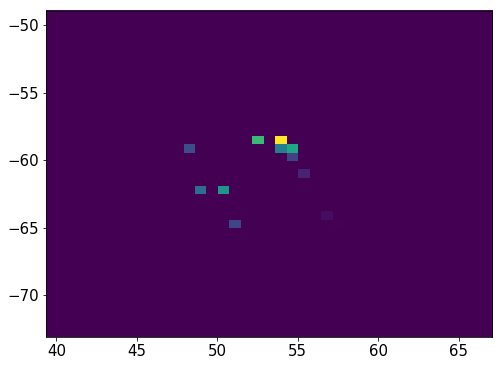

957090    19
957091    19
957092    19
957093    19
957094    19
957095    19
957096    19
957097    19
957098    19
957099    19
957100    19
957101    19
957102    19
957103    19
957104    19
957105    19
957106    19
957107    19
957108    19
Name: Nsipm, dtype: uint16


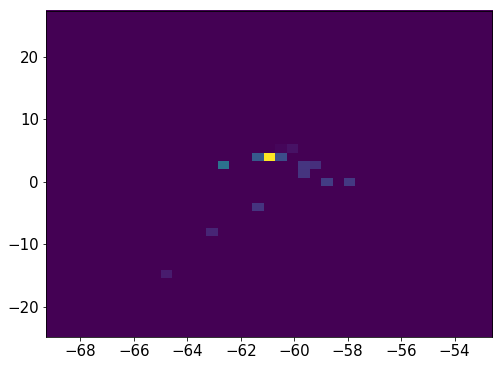

21817    28
21818    28
21819    28
21820    28
21821    28
21822    28
21823    28
21824    28
21828    17
21829    17
21830    17
21831    17
21832    17
21833    17
21834    17
21835    17
21836    17
21837    17
Name: Nsipm, dtype: uint16


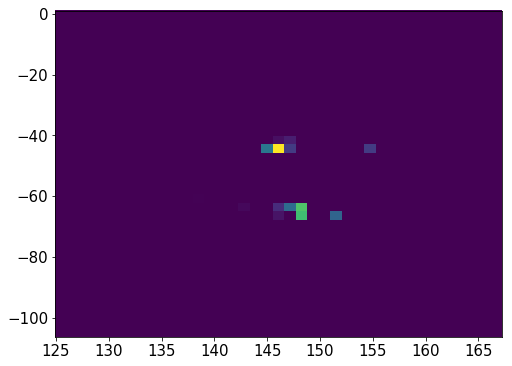

21841    20
21842    20
21843    20
21844    20
21845    20
21846    20
21847    20
21848    20
21849    20
21850    20
21855    11
21856    11
21857    11
21858    11
21859    11
21860    11
21861    11
21862    11
21867     1
21868     1
21869     1
21870     1
Name: Nsipm, dtype: uint16


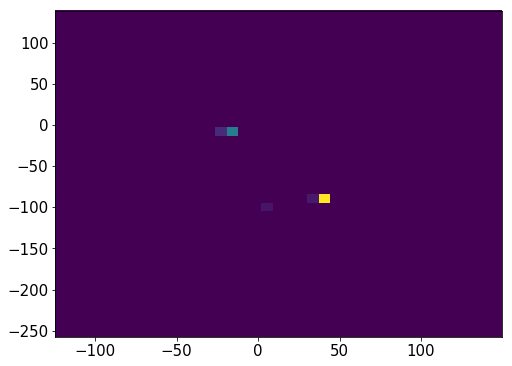

957113    39
957114    39
957115    39
957116    39
957117    39
957118    39
957119    39
957120    39
957121    39
957122    39
957123    39
957124    39
957125    39
957126    39
957127    39
957128    39
957129    39
Name: Nsipm, dtype: uint16


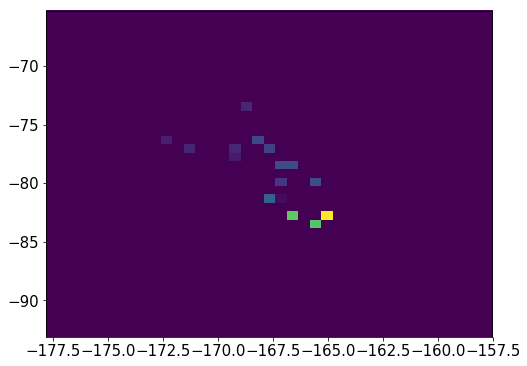

21875    21
21876    21
21877    21
21878    21
21879    21
21880    21
21881    21
21882    21
21883    21
21884    21
21885    21
Name: Nsipm, dtype: uint16


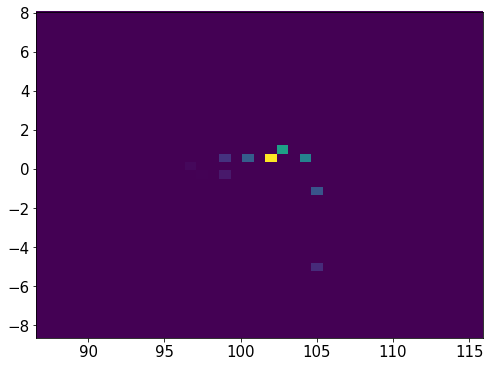

21890    31
21891    31
21892    31
21893    31
21894    31
21895    31
21896    31
21897    31
21898    31
21899    31
21900    31
21901    31
21907     1
21908     1
21909     1
21910     1
21911     1
Name: Nsipm, dtype: uint16


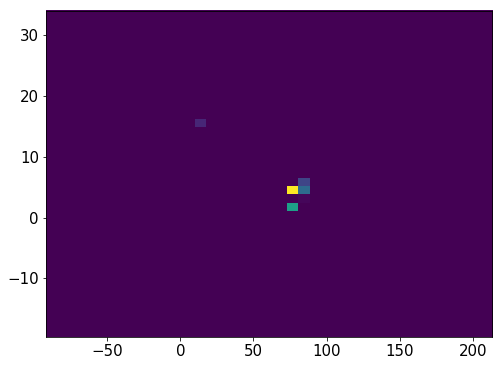

957133    17
957134    17
957135    17
957136    17
957137    17
957138    17
957139    17
957140    17
957141    17
957142    17
957143    17
957144    17
957145    17
957146    17
957147    17
957148    17
957149    17
957150    17
957151    17
957152    17
957153    17
957154    17
957155    17
957156    17
957157    17
957158    17
957163     2
957164     2
957165     2
957166     2
Name: Nsipm, dtype: uint16


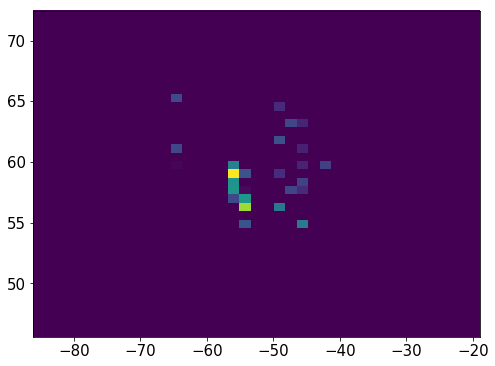

21916    27
21917    27
21918    27
21919    27
21920    27
21921    27
21922    27
21923    27
21924    27
21925    27
21926    27
21927    27
21928    27
21929    27
21930    27
21931    27
21932    27
21933    27
21934    27
Name: Nsipm, dtype: uint16


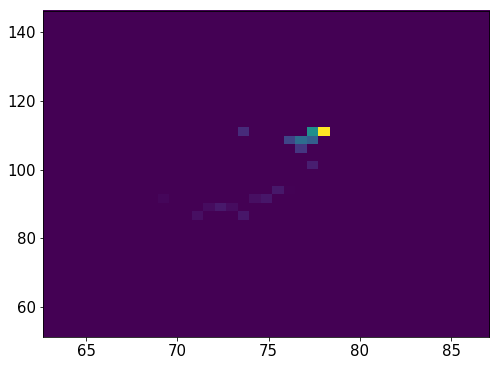

957170    30
957171    30
957172    30
957173    30
957174    30
957175    30
957176    30
957177    30
957178    30
957179    30
957180    30
957181    30
957182    30
957183    30
957184    30
957185    30
957186    30
957187    30
Name: Nsipm, dtype: uint16


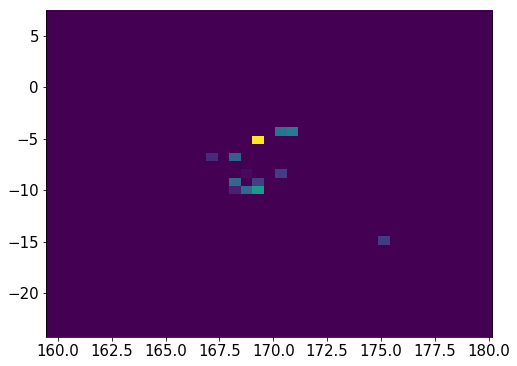

21964    27
21965    27
21966    27
21967    27
21968    27
21969    27
21970    27
21971    27
21972    27
21973    27
21978     3
21979     3
21980     3
21981     3
21984    18
21985    18
21986    18
21987    18
21988    18
21989    18
21990    18
21991    18
21992    18
21993    18
21994    18
21995    18
21996    18
21997    18
21998    18
21999    18
Name: Nsipm, dtype: uint16


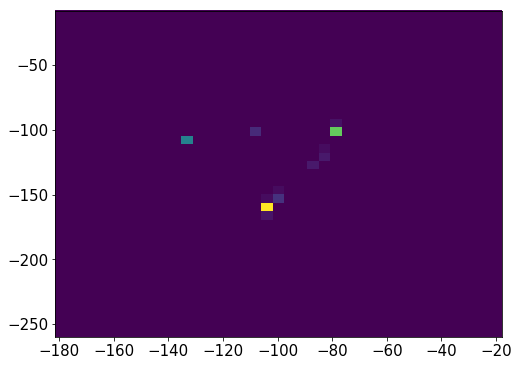

957209    22
957210    22
957211    22
957212    22
957213    22
957214    22
957215    22
957216    22
957217    22
957218    22
957219    22
957220    22
957221    22
957222    22
957223    22
957224    22
957225    22
957226    22
957227    22
957228    22
957229    22
957234     8
957235     8
957236     8
957237     8
957238     8
957239     8
957240     8
957241     8
957242     8
957243     8
957244     8
Name: Nsipm, dtype: uint16


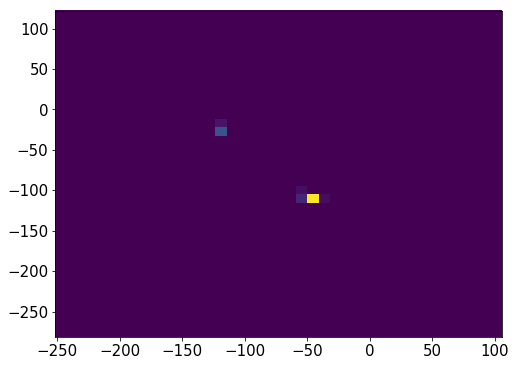

957249    30
957250    30
957254    30
957255    30
957256    30
957257    30
957258    30
957259    30
957260    30
957261    30
957262    30
957263    30
957264    30
957265    30
Name: Nsipm, dtype: uint16


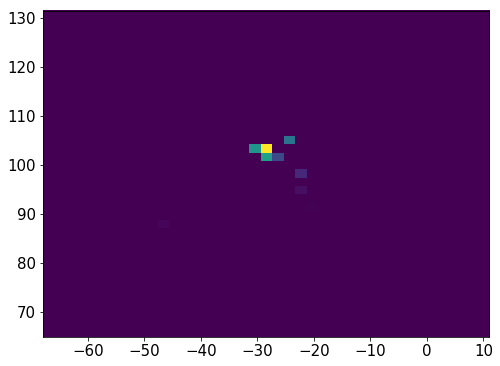

957266    30
957267    30
957268    30
957269    30
957270    30
957271    30
957272    30
957273    30
957274    30
957275    30
957276    30
957277    30
957278    30
957279    30
957280    30
957281    30
957282    30
957283    30
957284    30
957285    30
957286    30
Name: Nsipm, dtype: uint16


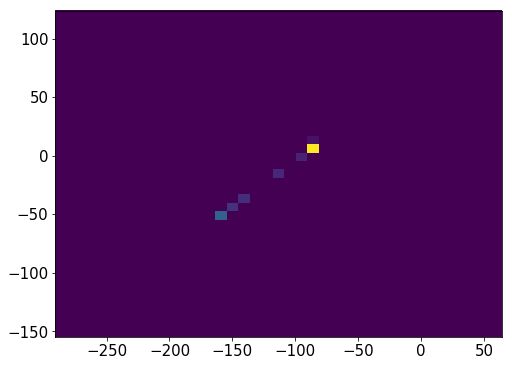

22003    26
22004    26
22005    26
22006    26
22007    26
22010    26
22011    26
22012    26
22013    26
22014    26
22015    26
22016    26
22017    26
22018    26
22019    26
22020    26
22021    26
22022    26
22023    26
Name: Nsipm, dtype: uint16


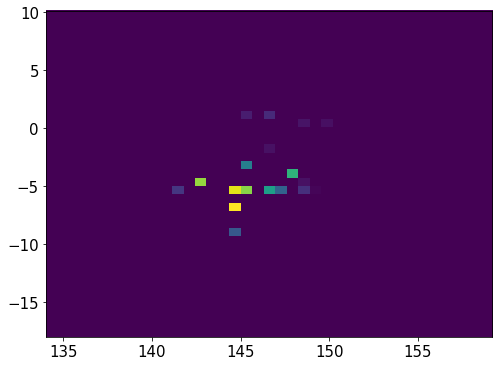

22024    31
22025    31
22026    31
22027    31
22028    31
22029    31
22030    31
22031    31
22032    31
22033    31
22034    31
22035    31
22036    31
22037    31
Name: Nsipm, dtype: uint16


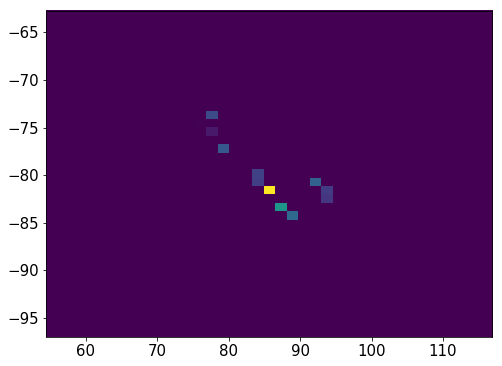

22041    33
22042    33
22043    33
22044    33
22045    33
22046    33
22047    33
22048    33
22049    33
22050    33
22051    33
22052    33
22053    33
22054    33
22055    33
22056    33
22057    33
22058    33
22059    33
22060    33
Name: Nsipm, dtype: uint16


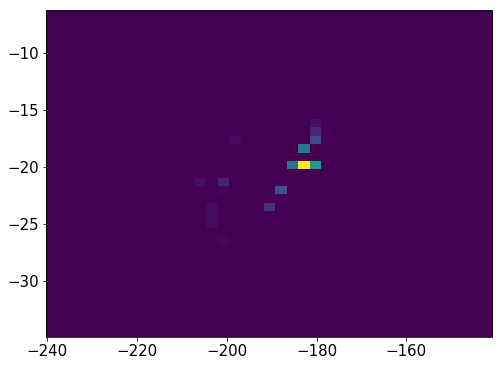

22064    28
22065    28
22066    28
22067    28
22068    28
22069    28
22073    28
22074    28
22075    28
22076    28
22077    28
22078    28
22079    28
Name: Nsipm, dtype: uint16


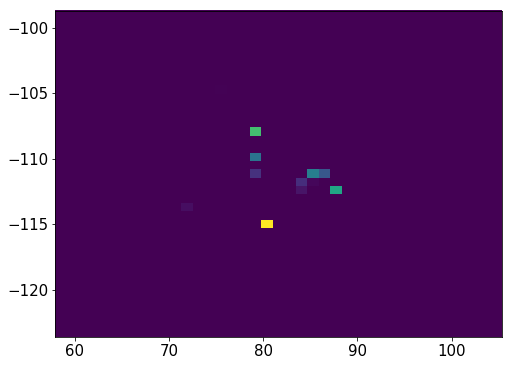

957331    26
957332    26
957333    26
957334    26
957335    26
957336    26
957337    26
957338    26
957339    26
957340    26
957341    26
957342    26
957343    26
957344    26
957345    26
957346    26
Name: Nsipm, dtype: uint16


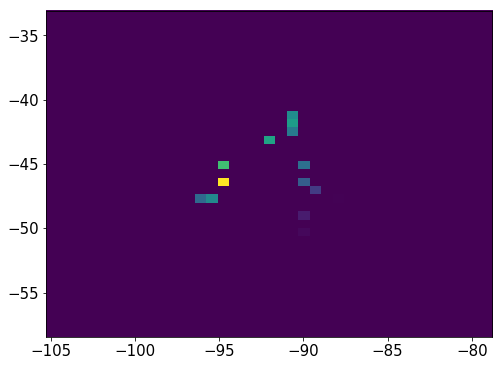

957352    29
957353    29
957354    29
957355    29
957356    29
957357    29
957358    29
957359    29
957360    29
957361    29
957362    29
957363    29
957364    29
957365    29
957366    29
957367    29
Name: Nsipm, dtype: uint16


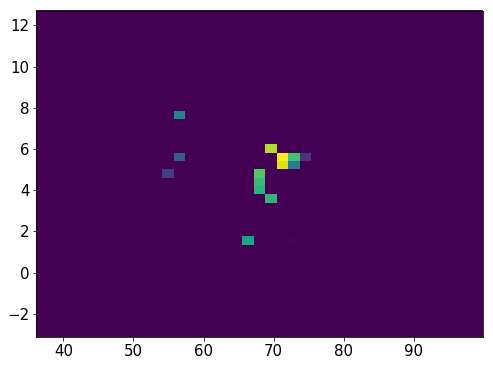

957372    42
957373    42
957374    42
957375    42
957376    42
957377    42
957378    42
957379    42
957380    42
957381    42
957382    42
957383    42
957384    42
957385    42
957386    42
957387    42
957388    42
957389    42
957390    42
957391    42
957392    42
957393    42
957394    42
957395    42
957396    42
957397    42
957398    42
957399    42
957400    42
957401    42
957402    42
957403    42
Name: Nsipm, dtype: uint16


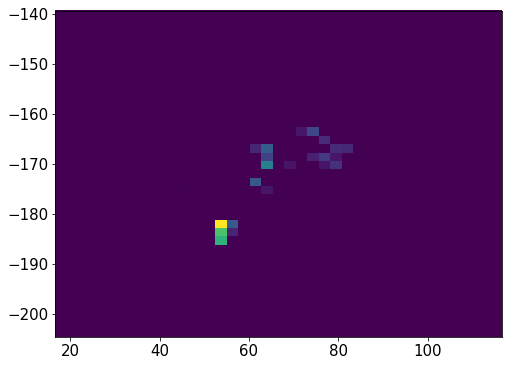

22101    25
22102    25
22103    25
22104    25
22105    25
22106    25
22107    25
22108    25
22109    25
22110    25
22111    25
22112    25
22113    25
22114    25
22115    25
22116    25
22117    25
22118    25
22119    25
22120    25
22121    25
22122    25
22123    25
Name: Nsipm, dtype: uint16


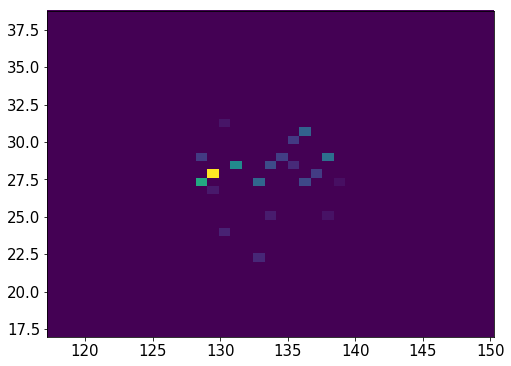

22126    23
22127    23
22128    23
22129    23
22130    23
22131    23
22132    23
22133    23
22134    23
22135    23
22136    23
22137    23
22138    23
22139    23
22140    23
22141    23
22142    23
22143    23
22144    23
22145    23
Name: Nsipm, dtype: uint16


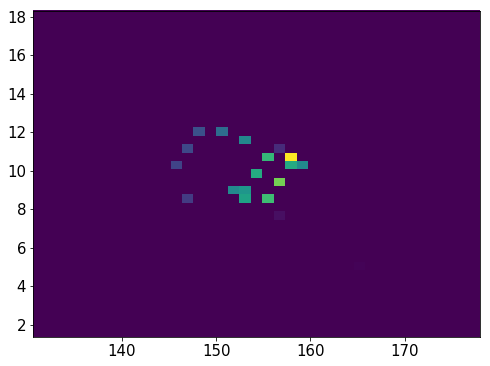

957428    25
957429    25
957430    25
957431    25
957432    25
957433    25
957434    25
957435    25
957436    25
957437    25
957438    25
957439    25
957440    25
957441    25
957442    25
957443    25
957444    25
957445    25
957446    25
Name: Nsipm, dtype: uint16


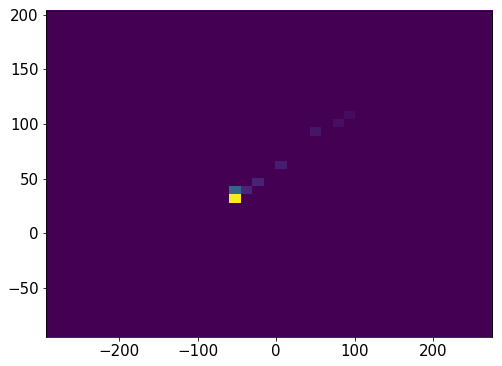

22151    25
22152    25
22153    25
22154    25
22155    25
22156    25
22157    25
22158    25
22159    25
22160    25
22161    25
22162    25
22163    25
22164    25
22165    25
22166    25
22167    25
22168    25
22169    25
22172    25
22173    25
22174    25
22175    25
22176    25
22178    25
Name: Nsipm, dtype: uint16


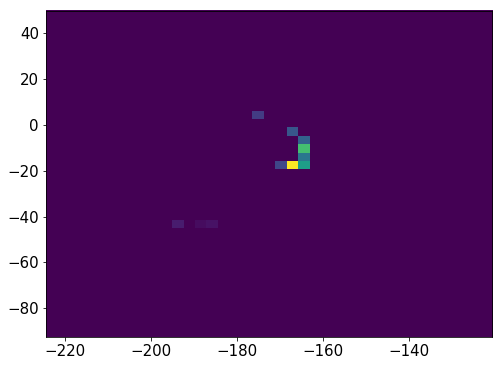

957455    18
957456    18
957457    18
957458    18
957459    18
957460    18
957461    18
957462    18
957463    18
957464    18
957469    10
957470    10
957471    10
957472    10
957473    10
957474    10
957475    10
957476    10
957477    10
Name: Nsipm, dtype: uint16


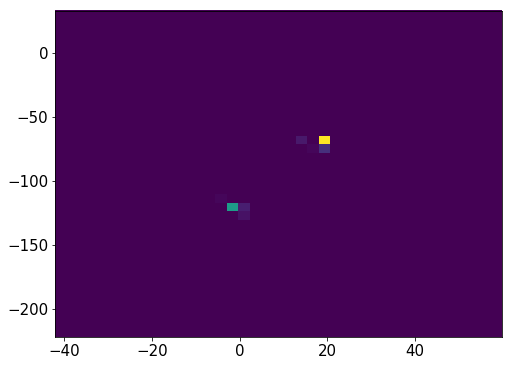

22182    28
22183    28
22184    28
22185    28
22186    28
22187    28
22188    28
22189    28
22190    28
22191    28
22192    28
22193    28
22194    28
22195    28
22196    28
22197    28
22198    28
22199    28
22200    28
22201    28
22202    28
Name: Nsipm, dtype: uint16


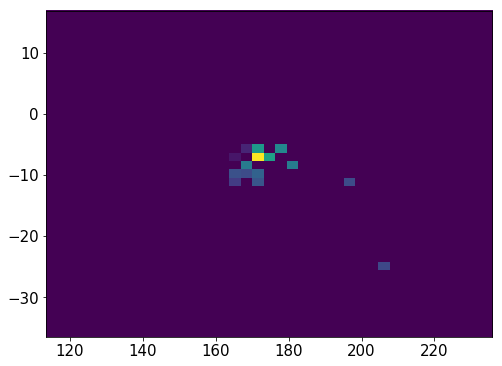

22206    31
22207    31
22208    31
22209    31
22210    31
22211    31
22212    31
22213    31
22214    31
22215    31
22216    31
22217    31
22218    31
22219    31
22220    31
22224     1
22225     1
22226     1
22227     1
22228     1
22229     1
Name: Nsipm, dtype: uint16


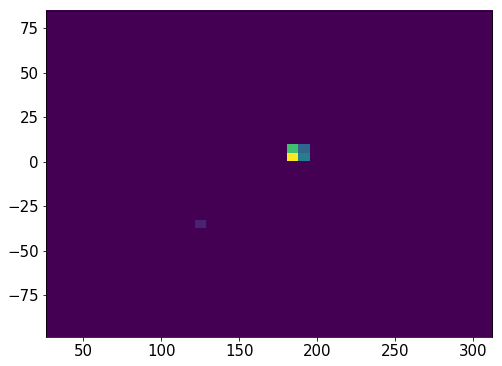

22234    23
22235    23
22236    23
22237    23
22238    23
22239    23
22240    23
22241    23
22242    23
22243    23
22244    23
22245    23
22246    23
22247    23
22248    23
22249    23
22250    23
Name: Nsipm, dtype: uint16


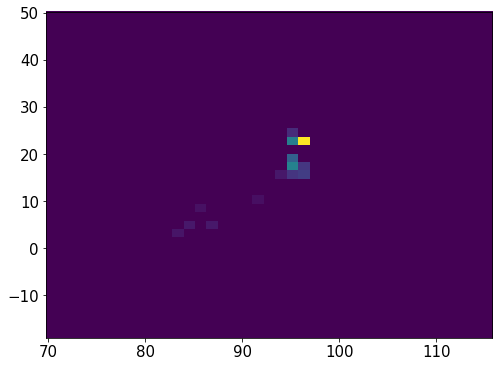

957530    27
957531    27
957532    27
957533    27
957534    27
957535    27
957536    27
957537    27
957538    27
957539    27
957540    27
957545    27
957546    27
957547    27
957548    27
957549    27
957550    27
Name: Nsipm, dtype: uint16


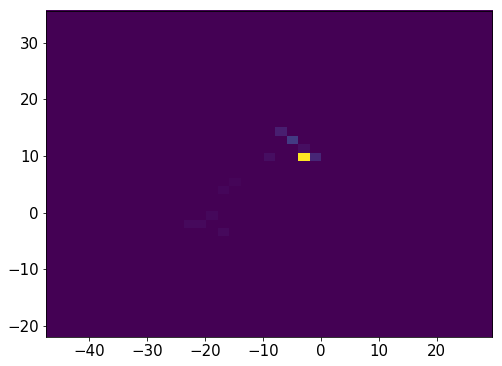

957555    33
957556    33
957557    33
957558    33
957559    33
957560    33
957561    33
957562    33
957563    33
957564    33
957565    33
957566    33
957567    33
957568    33
957569    33
957570    33
957571    33
957572    33
957573    33
957574    33
957575    33
957576    33
957577    33
957578    33
957579    33
Name: Nsipm, dtype: uint16


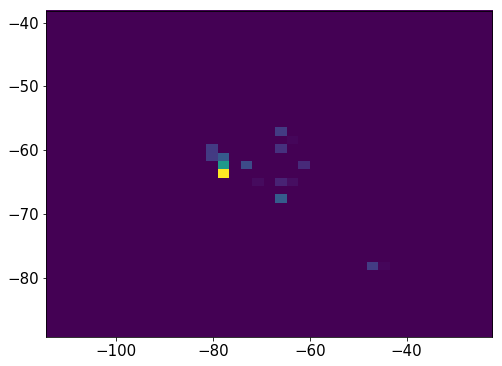

957583    26
957584    26
957585    26
957586    26
957587    26
957588    26
957589    26
957590    26
957591    26
957592    26
957593    26
957594    26
957595    26
957596    26
957597    26
957598    26
957599    26
957600    26
957601    26
957602    26
Name: Nsipm, dtype: uint16


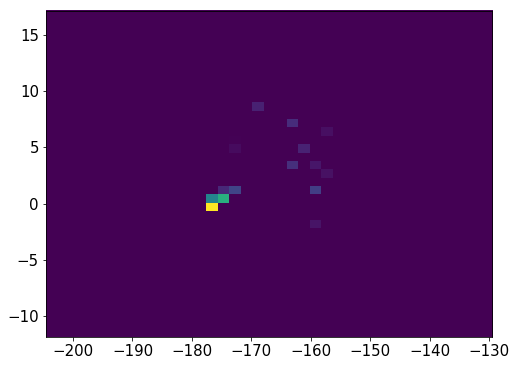

22269    26
22270    26
22271    26
22272    26
22273    26
22274    26
22275    26
22276    26
22277    26
22278    26
22279    26
22280    26
22281    26
Name: Nsipm, dtype: uint16


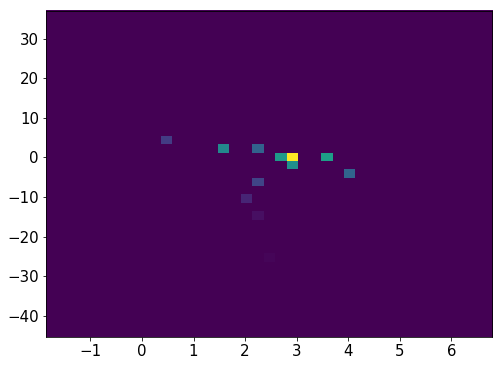

957607    33
957608    33
957609    33
957610    33
957611    33
957612    33
957613    33
957614    33
957615    33
957616    33
957617    33
957618    33
957622    33
957623    33
957624    33
957625    33
957626    33
957627    33
957628    33
Name: Nsipm, dtype: uint16


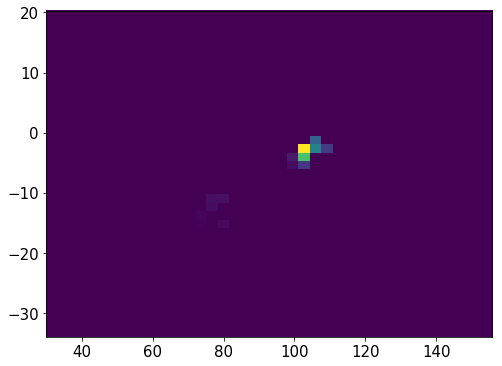

22287    23
22288    23
22289    23
22290    23
22291    23
22292    23
22293    23
22294    23
22295    23
22296    23
22297    23
22298    23
22299    23
22300    23
Name: Nsipm, dtype: uint16


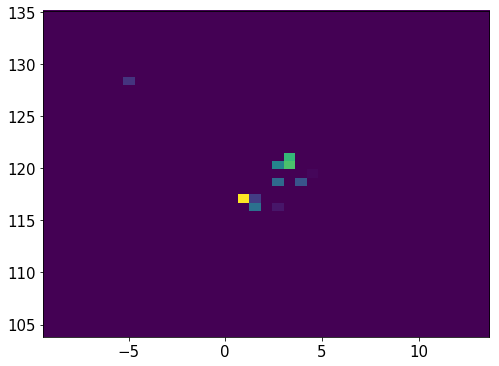

22304    25
22305    25
22306    25
22307    25
22308    25
22309    25
22310    25
22311    25
22312    25
22313    25
22314    25
22315    25
22316    25
22317    25
Name: Nsipm, dtype: uint16


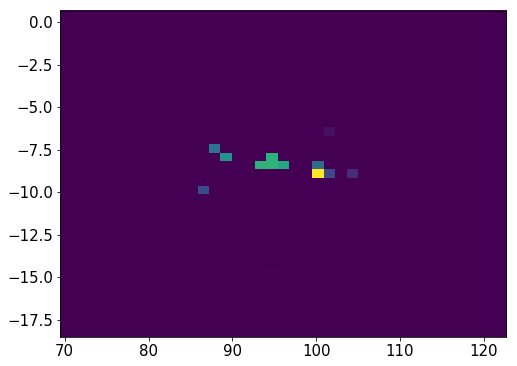

957631    28
957632    28
957633    28
957634    28
957635    28
957636    28
957637    28
957638    28
957639    28
957640    28
957641    28
957642    28
957643    28
957644    28
957645    28
Name: Nsipm, dtype: uint16


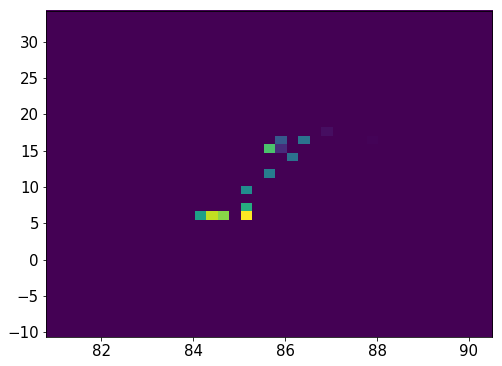

1667014    22
1667015    22
1667016    22
1667017    22
1667018    22
1667019    22
1667020    22
1667021    22
1667022    22
1667023    22
1667024    22
1667025    22
1667026    22
Name: Nsipm, dtype: uint16


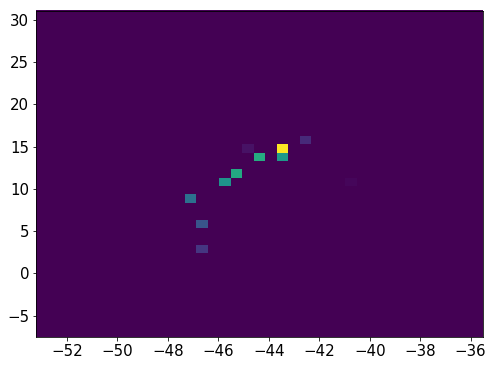

957650    23
957651    23
957652    23
957653    23
957654    23
957655    23
957656    23
957657    23
957658    23
957659    23
957660    23
957661    23
957662    23
957663    23
957664    23
957665    23
957666    23
957667    23
957668    23
957669    23
Name: Nsipm, dtype: uint16


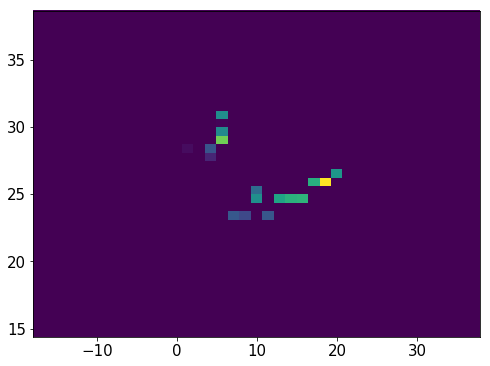

957674    37
957675    37
957676    37
957677    37
957678    37
957679    37
957680    37
957681    37
957682    37
957683    37
957684    37
Name: Nsipm, dtype: uint16


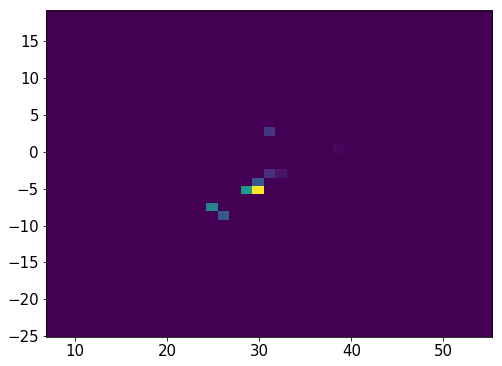

22322    42
22323    42
22324    42
22325    42
22326    42
22327    42
22328    42
22329    42
22330    42
22331    42
22332    42
22333    42
22334    42
22335    42
22336    42
22337    42
22338    42
22339    42
22340    42
22341    42
22342    42
22343    42
Name: Nsipm, dtype: uint16


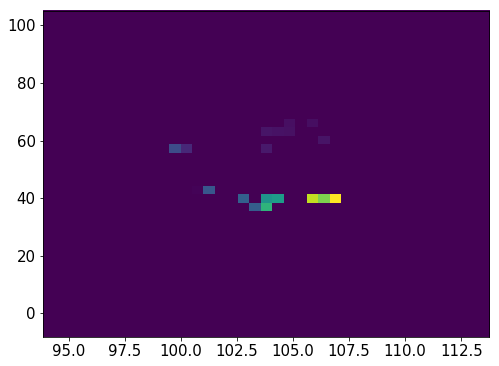

957689    29
957690    29
957691    29
957692    29
957693    29
957694    29
957695    29
957696    29
957697    29
957698    29
957699    29
957700    29
957701    29
957702    29
957703    29
Name: Nsipm, dtype: uint16


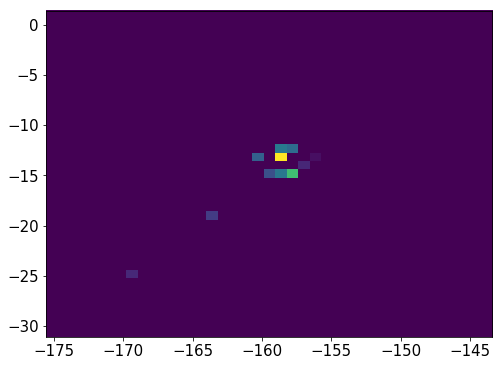

22347    27
22348    27
22349    27
22350    27
22351    27
22352    27
22353    27
22354    27
22355    27
22356    27
22357    27
22358    27
22359    27
22360    27
22361    27
22362    27
22363    27
22364    27
22365    27
Name: Nsipm, dtype: uint16


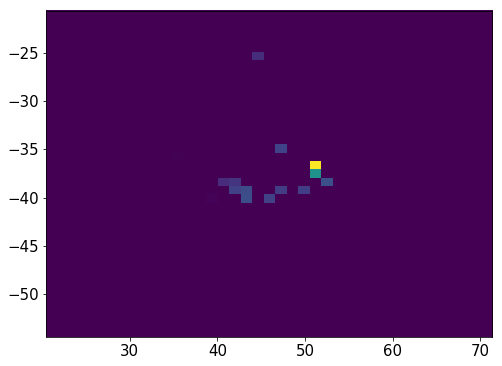

22371    21
22372    21
22373    21
22374    21
22375    21
22376    21
22377    21
22378    21
22379    21
22380    21
22381    21
22382    21
22383    21
Name: Nsipm, dtype: uint16


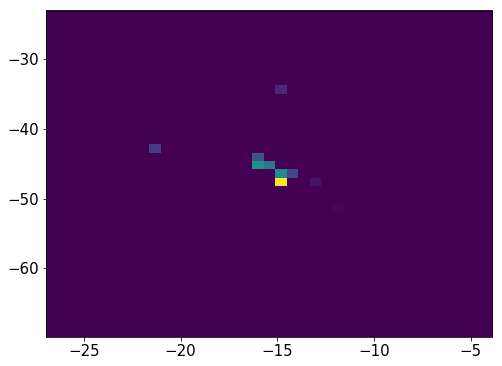

22388    30
22389    30
22390    30
22391    30
22392    30
22393    30
22394    30
22395    30
22396    30
22397    30
22398    30
22399    30
22400    30
22401    30
22402    30
22408     1
22409     1
22410     1
22411     1
22412     1
22413     1
22414     1
22415     1
22416     1
Name: Nsipm, dtype: uint16


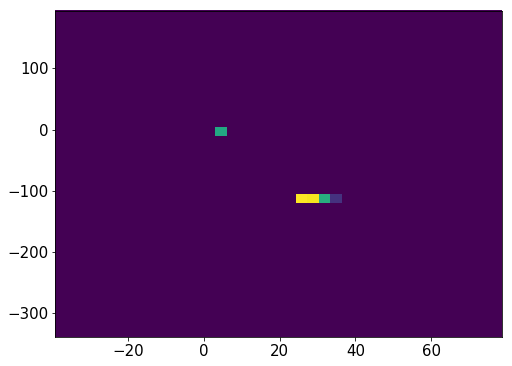

22423    22
22424    22
22425    22
22426    22
22427    22
22428    22
22429    22
22430    22
22431    22
22432    22
22433    22
22434    22
22435    22
22436    22
22437    22
22438    22
22439    22
22440    22
22441    22
Name: Nsipm, dtype: uint16


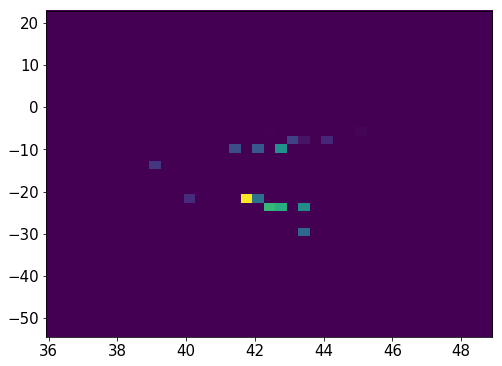

22447    28
22448    28
22449    28
22450    28
22451    28
22452    28
22453    28
22454    28
22455    28
22456    28
22457    28
22458    28
22459    28
22460    28
22461    28
22462    28
22463    28
22464    28
22467    28
22468    28
22469    28
22470    28
22471    28
22472    28
22473    28
22474    28
22475    28
22476    28
22477    28
Name: Nsipm, dtype: uint16


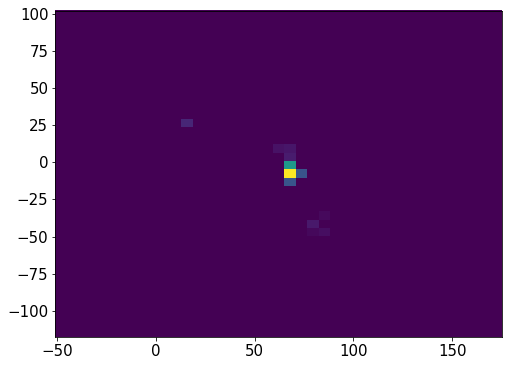

22482    39
22483    39
22484    39
22485    39
22486    39
22487    39
22488    39
22489    39
22490    39
22491    39
22492    39
22493    39
22494    39
22495    39
22496    39
22497    39
22498    39
22499    39
22500    39
22501    39
22504    39
Name: Nsipm, dtype: uint16


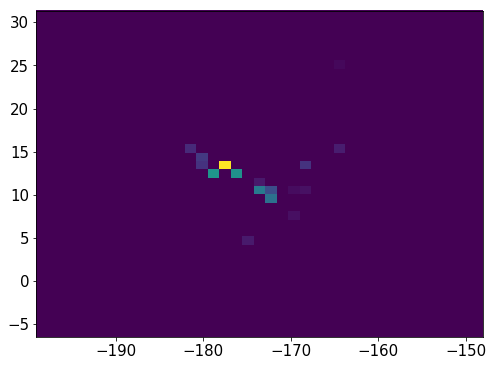

957731    26
957732    26
957733    26
957734    26
957735    26
957736    26
957737    26
957738    26
957739    26
957740    26
957741    26
957742    26
957743    26
957744    26
957745    26
957746    26
957747    26
957748    26
957749    26
957750    26
Name: Nsipm, dtype: uint16


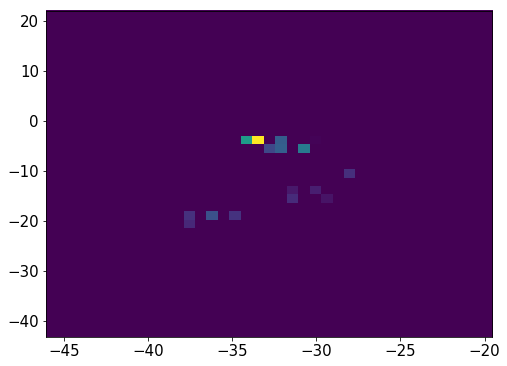

22510    45
22511    45
22512    45
22513    45
22514    45
22515    45
22516    45
22517    45
22518    45
22521    45
22522    45
22523    45
22524    45
22525    45
22526    45
22529    45
22530    45
22531    45
22532    45
22533    45
22534    45
22535    45
22536    45
22537    45
22538    45
22539    45
22540    45
22541    45
22542    45
22543    45
         ..
22547    45
22548    45
22549    45
22550    45
22551    45
22570    45
22571    45
22572    45
22573    45
22574    45
22575    45
22576    45
22577    45
22578    45
22579    45
22580    45
22581    45
22582    45
22583    45
22584    45
22585    45
22586    45
22587    45
22588    45
22589    45
22590    45
22591    45
22592    45
22593    45
22595    45
Name: Nsipm, dtype: uint16


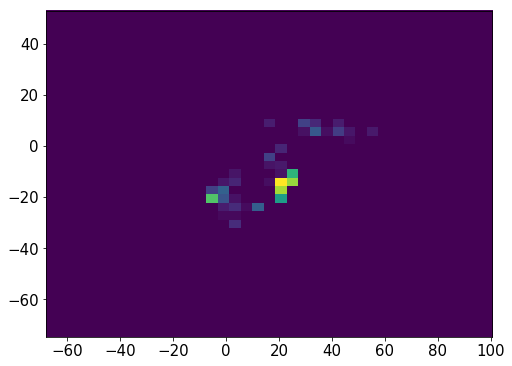

957754    29
957755    29
957756    29
957757    29
957758    29
957759    29
957760    29
957761    29
957762    29
957763    29
957764    29
957765    29
957766    29
957767    29
957768    29
957769    29
957770    29
957771    29
Name: Nsipm, dtype: uint16


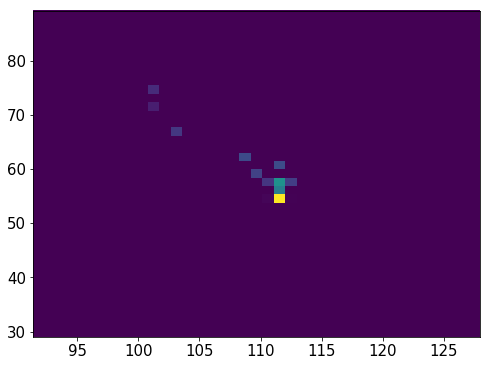

957776    27
957777    27
957778    27
957779    27
957780    27
957781    27
957782    27
957783    27
957784    27
957785    27
957786    27
957787    27
957788    27
957789    27
957790    27
957791    27
957792    27
957793    27
957794    27
957795    27
957796    27
957797    27
957798    27
957799    27
957800    27
957801    27
957802    27
Name: Nsipm, dtype: uint16


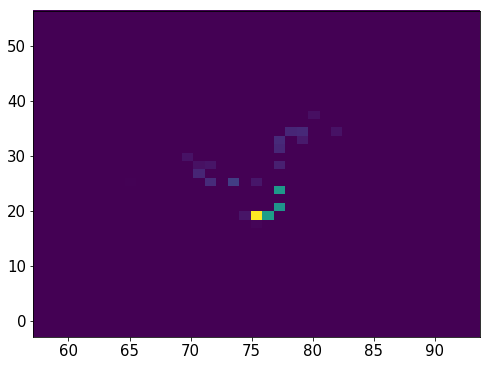

22625    28
22626    28
22627    28
22628    28
22629    28
22630    28
22631    28
22632    28
22633    28
22634    28
22635    28
22636    28
22637    28
22638    28
Name: Nsipm, dtype: uint16


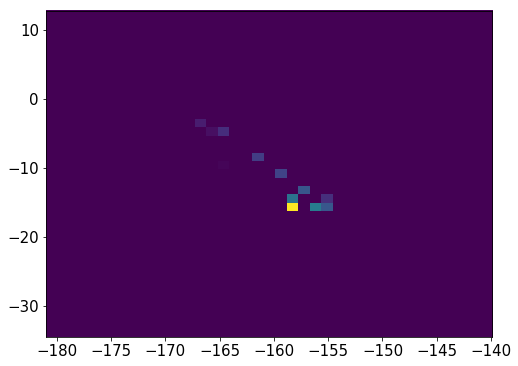

22642    41
22643    41
22644    41
22645    41
22646    41
22647    41
22648    41
22649    41
22650    41
22651    41
22652    41
22653    41
22654    41
22655    41
22656    41
22657    41
22658    41
22659    41
22660    41
22661    41
22662    41
22663    41
22664    41
22665    41
22666    41
22667    41
22668    41
22669    41
22670    41
22671    41
22672    41
Name: Nsipm, dtype: uint16


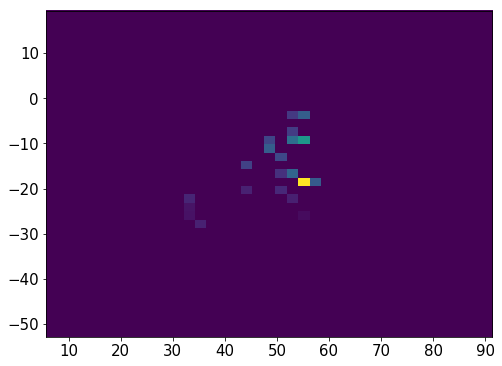

22676    24
22677    24
22678    24
22679    24
22680    24
22684    24
22685    24
22686    24
22687    24
22688    24
22689    24
22690    24
22691    24
22692    24
22693    24
22694    24
Name: Nsipm, dtype: uint16


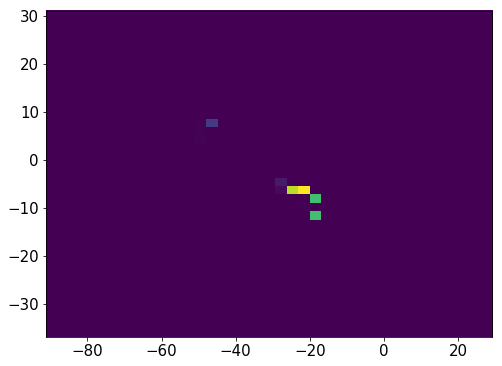

957806    34
957807    34
957808    34
957809    34
957810    34
957811    34
957812    34
957813    34
957814    34
957815    34
957816    34
957817    34
957818    34
957819    34
957820    34
957821    34
957822    34
957823    34
957824    34
957825    34
957826    34
957827    34
957828    34
957829    34
957830    34
Name: Nsipm, dtype: uint16


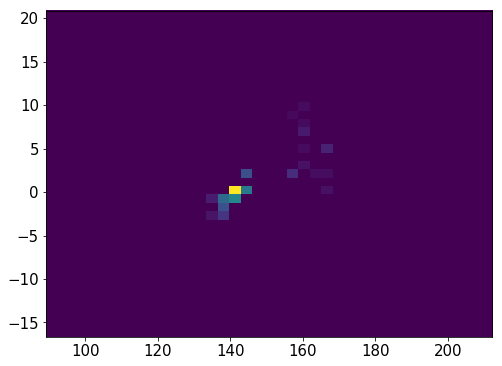

957836    23
957837    23
957838    23
957839    23
957840    23
957841    23
957842    23
957843    23
957844    23
957845    23
957846    23
957847    23
957848    23
957849    23
957850    23
957851    23
957852    23
957853    23
Name: Nsipm, dtype: uint16


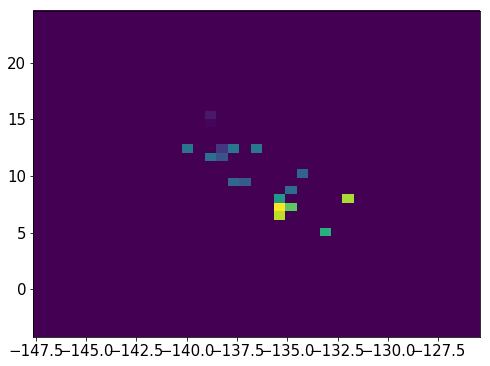

957859    32
957860    32
957861    32
957862    32
957863    32
957864    32
957865    32
957866    32
957867    32
957868    32
957869    32
957870    32
957871    32
957872    32
957873    32
957874    32
957875    32
957876    32
957877    32
Name: Nsipm, dtype: uint16


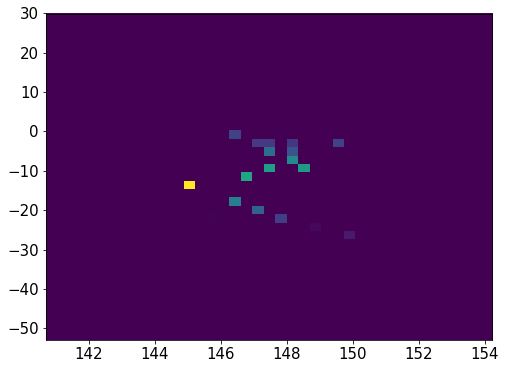

937402    29
937403    29
937404    29
937405    29
937406    29
937407    29
937408    29
937409    29
937410    29
937411    29
937412    29
Name: Nsipm, dtype: uint16


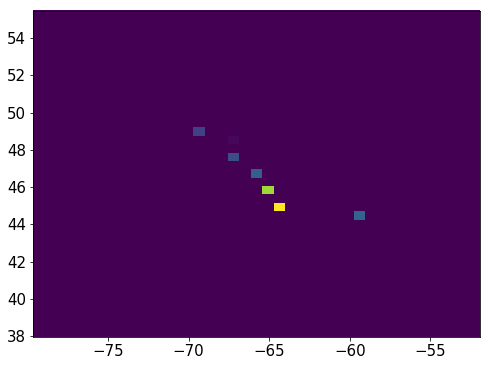

22695    51
22696    51
22697    51
22698    51
22699    51
22700    51
22701    51
22702    51
22703    51
22704    51
22705    51
22706    51
22710    20
22711    20
22712    20
22713    20
22714    20
22715    20
22716    20
22717    20
22718    20
22719    20
22720    20
22721    20
22722    20
22723    20
22724    20
22725    20
22726    20
22727    20
22728    20
22729    20
22730    20
22731    20
Name: Nsipm, dtype: uint16


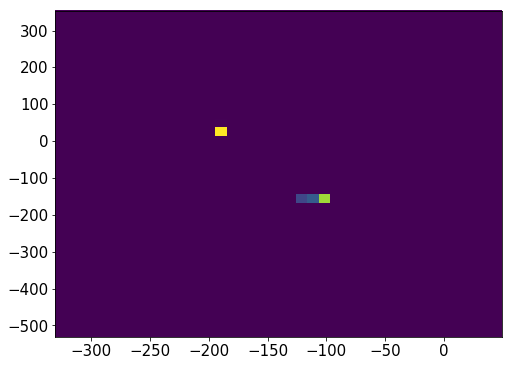

957884    24
957885    24
957886    24
957887    24
957888    24
957889    24
957890    24
957891    24
957892    24
957893    24
957894    24
957895    24
957896    24
957897    24
957898    24
957899    24
957900    24
957901    24
957902    24
Name: Nsipm, dtype: uint16


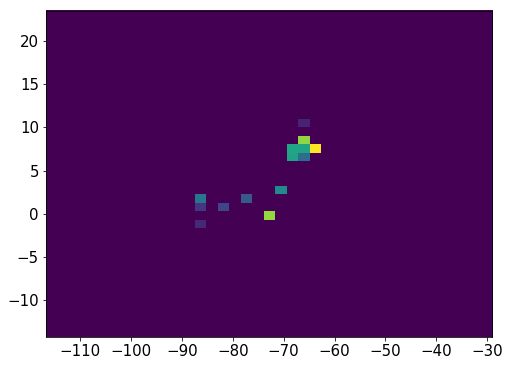

22736    46
22737    46
22738    46
22739    46
22740    46
22741    46
22742    46
22743    46
22744    46
22745    46
22746    46
22747    46
22748    46
22749    46
22750    46
22751    46
22752    46
22753    46
22754    46
22755    46
22756    46
22757    46
22758    46
22763     1
22764     1
22765     1
22766     1
22767     1
Name: Nsipm, dtype: uint16


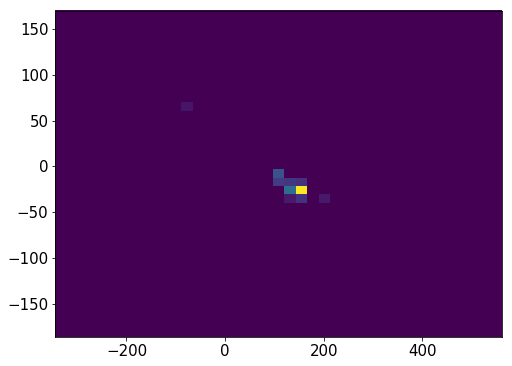

957906    45
957907    45
957908    45
957909    45
957910    45
957911    45
957912    45
957913    45
957914    45
957915    45
957916    45
957917    45
957918    45
957919    45
957920    45
957921    45
957922    45
957923    45
957924    45
957925    45
957926    45
957927    45
957928    45
957929    45
957930    45
957931    45
957932    45
957933    45
957934    45
957935    45
957936    45
957937    45
957938    45
957939    45
957940    45
957941    45
957942    45
957943    45
957944    45
957945    45
957946    45
957947    45
957948    45
957949    45
957950    45
957951    45
957952    45
957953    45
957954    45
957955    45
957956    45
957957    45
957958    45
957959    45
957960    45
957961    45
957962    45
957963    45
Name: Nsipm, dtype: uint16


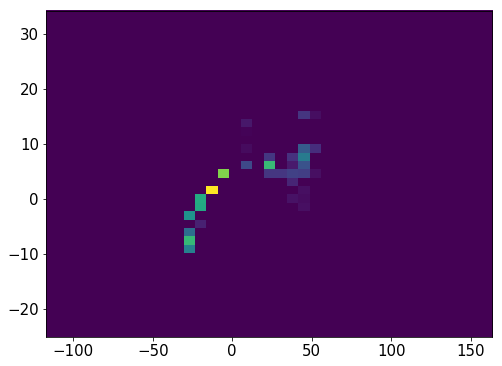

957969    27
957970    27
957971    27
957972    27
957973    27
957974    27
957975    27
957976    27
957977    27
957978    27
957979    27
957980    27
957981    27
957982    27
957983    27
957984    27
957985    27
957986    27
Name: Nsipm, dtype: uint16


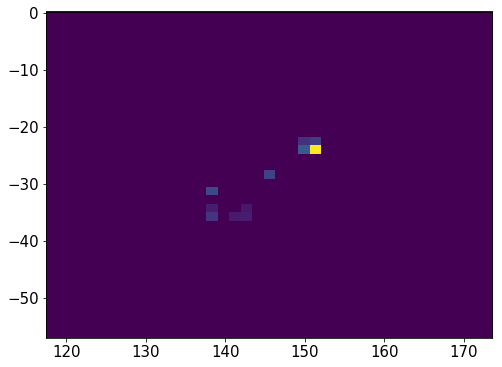

957992    44
957993    44
957994    44
957995    44
957996    44
957997    44
957998    44
957999    44
958000    44
958001    44
958002    44
958003    44
Name: Nsipm, dtype: uint16


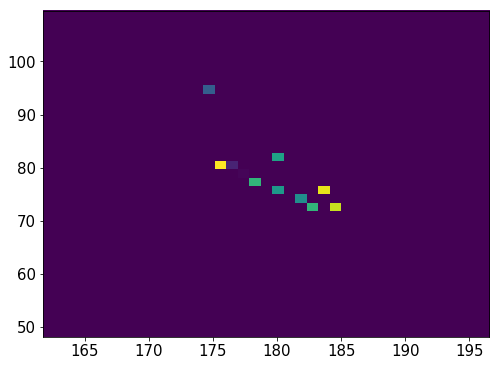

22772    28
22773    28
22774    28
22775    28
22776    28
22777    28
22778    28
22779    28
22780    28
22781    28
22782    28
22783    28
22784    28
22785    28
22786    28
22787    28
22788    28
22789    28
22790    28
22791    28
Name: Nsipm, dtype: uint16


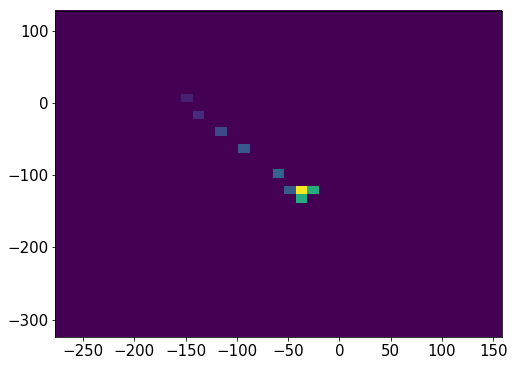

958008    22
958009    22
958010    22
958011    22
958012    22
958013    22
958014    22
958015    22
958016    22
958017    22
958018    22
958019    22
958020    22
958021    22
958022    22
958023    22
958024    22
958025    22
958026    22
958027    22
958028    22
958029    22
958030    22
958035     7
958036     7
958037     7
958038     7
958039     7
958040     7
958048     1
958049     1
958050     1
Name: Nsipm, dtype: uint16


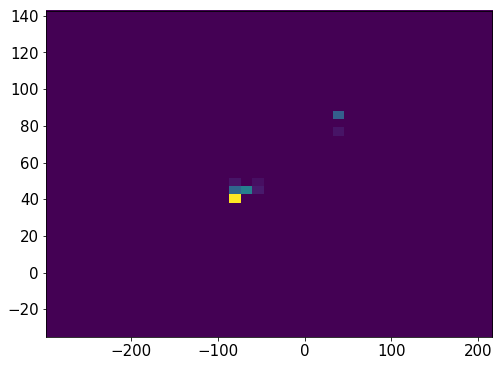

958057    26
958058    26
958059    26
958060    26
958061    26
958062    26
958063    26
958064    26
958065    26
958066    26
958067    26
958068    26
958069    26
958070    26
958071    26
958072    26
958073    26
958074    26
958075    26
958081     9
958083     9
958084     9
958085     9
958086     9
958087     9
958088     9
958089     9
958090     9
958091     9
958092     9
958093     9
958094     9
958095     9
Name: Nsipm, dtype: uint16


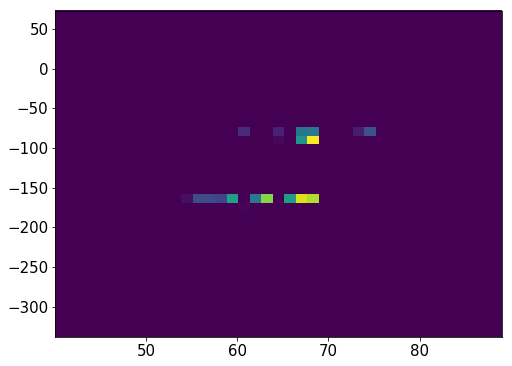

22795    28
22796    28
22797    28
22798    28
22799    28
22800    28
22801    28
22802    28
22803    28
22804    28
22805    28
22806    28
22807    28
22808    28
22809    28
22810    28
Name: Nsipm, dtype: uint16


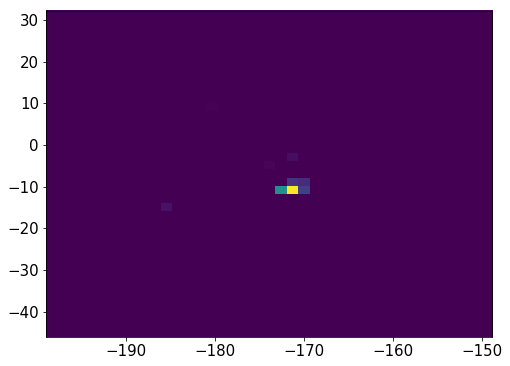

22815    22
22816    22
22817    22
22818    22
22819    22
22820    22
22821    22
22822    22
22823    22
22824    22
22825    22
22826    22
22827    22
Name: Nsipm, dtype: uint16


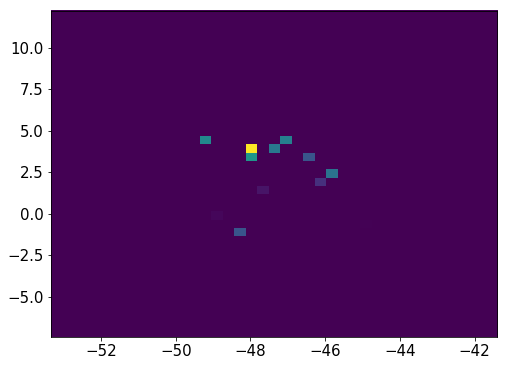

958135    27
958136    27
958137    27
958138    27
958139    27
958140    27
958141    27
958142    27
958143    27
958144    27
958145    27
958146    27
958147    27
958148    27
958149    27
958150    27
958151    27
958152    27
958153    27
Name: Nsipm, dtype: uint16


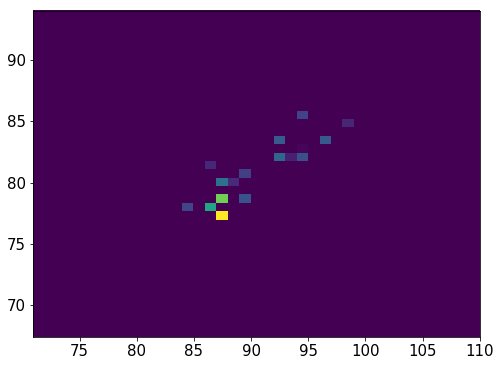

22832    22
22833    22
22834    22
22835    22
22836    22
22837    22
22838    22
22839    22
22840    22
22841    22
22842    22
22843    22
22844    22
22845    22
22846    22
22847    22
22848    22
22849    22
Name: Nsipm, dtype: uint16


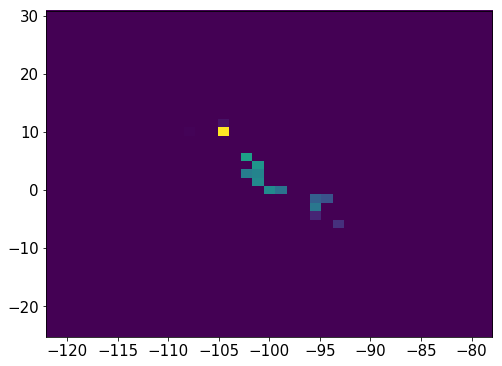

937440    23
937441    23
937442    23
937443    23
937444    23
937445    23
937446    23
937447    23
937448    23
937449    23
937450    23
937451    23
937452    23
937453    23
937459    23
937461    23
Name: Nsipm, dtype: uint16


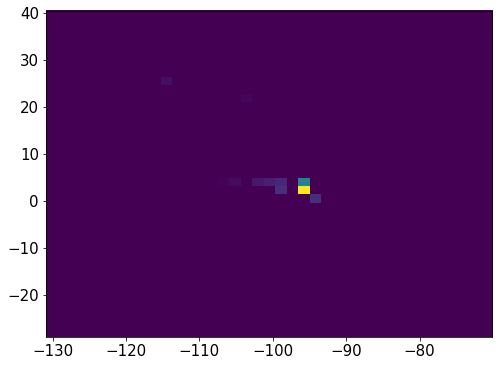

22855    31
22856    31
22857    31
22858    31
22859    31
22860    31
22861    31
22862    31
22863    31
22864    31
22865    31
22866    31
Name: Nsipm, dtype: uint16


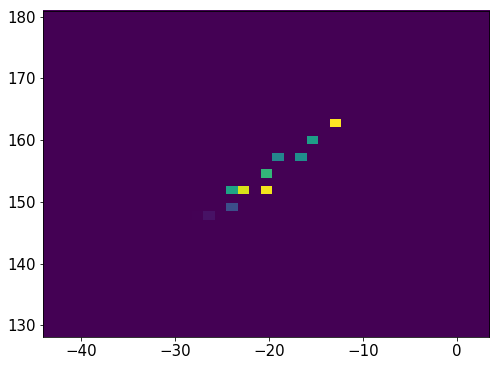

22871    22
22872    22
22873    22
22874    22
22875    22
22876    22
22877    22
22878    22
22879    22
22880    22
22881    22
22882    22
22883    22
22884    22
22885    22
22886    22
22887    22
22888    22
22889    22
22890    22
22891    22
22892    22
22893    22
22894    22
22895    22
22896    22
22897    22
22898    22
22899    22
22900    22
Name: Nsipm, dtype: uint16


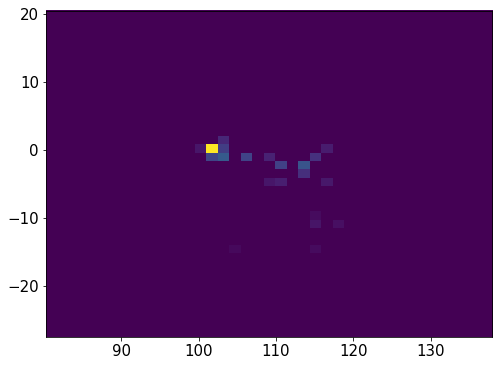

958160    25
958161    25
958162    25
958163    25
958164    25
958165    25
958166    25
958167    25
958168    25
958169    25
958170    25
958171    25
958178     1
958179     1
958180     1
958181     1
958183     1
Name: Nsipm, dtype: uint16


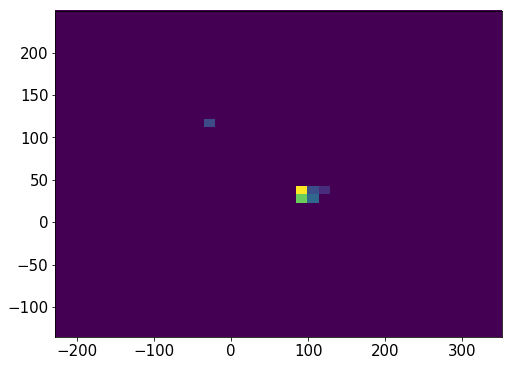

22904    29
22905    29
22906    29
22907    29
22908    29
22909    29
22910    29
22911    29
22912    29
22913    29
22914    29
22915    29
22916    29
Name: Nsipm, dtype: uint16


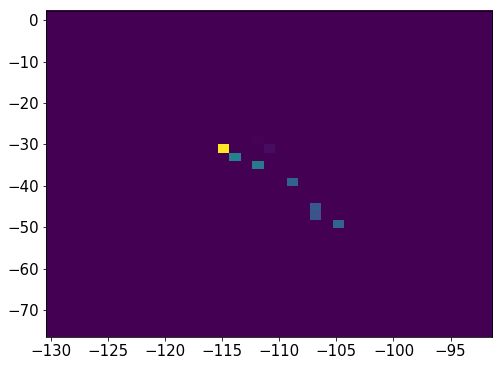

958189    23
958190    23
958191    23
958192    23
958193    23
958194    23
958195    23
958196    23
958197    23
958198    23
958199    23
958200    23
958201    23
958202    23
958203    23
958204    23
958205    23
958206    23
Name: Nsipm, dtype: uint16


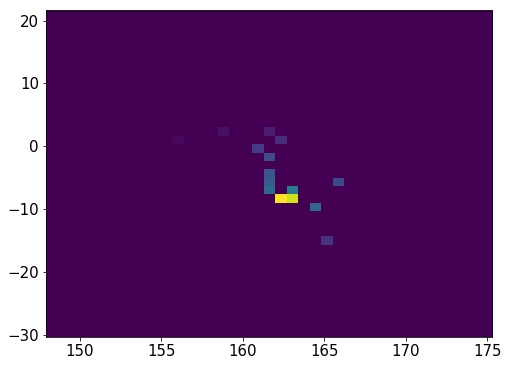

958212    56
958213    56
958214    56
958215    56
958216    56
958217    56
958218    56
958219    56
958220    56
958221    56
958222    56
958223    56
958224    56
958225    56
958226    56
958227    56
958228    56
958229    56
958230    56
958231    56
958232    56
958233    56
958234    56
958235    56
958236    56
958237    56
958238    56
958239    56
958240    56
958242    56
958246    56
958247    56
958249    56
Name: Nsipm, dtype: uint16


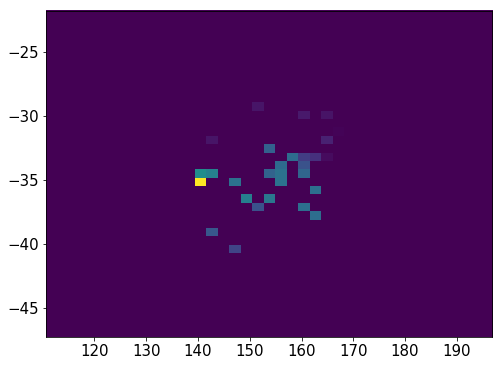

22946    19
22947    19
22948    19
22949    19
22950    19
22951    19
22952    19
22953    19
22954    19
22955    19
22956    19
22957    19
22958    19
22959    19
22960    19
22961    19
22962    19
22967     2
22968     2
22969     2
22970     2
Name: Nsipm, dtype: uint16


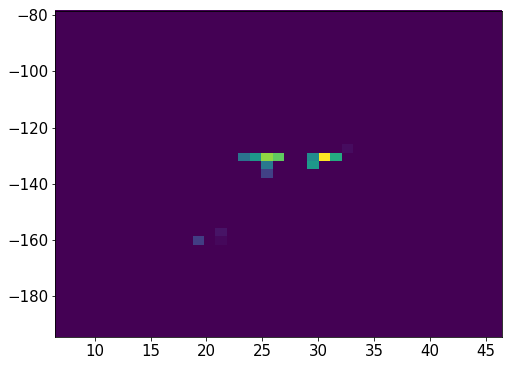

958255    20
958256    20
958257    20
958258    20
958259    20
958260    20
958261    20
958262    20
958263    20
958264    20
Name: Nsipm, dtype: uint16


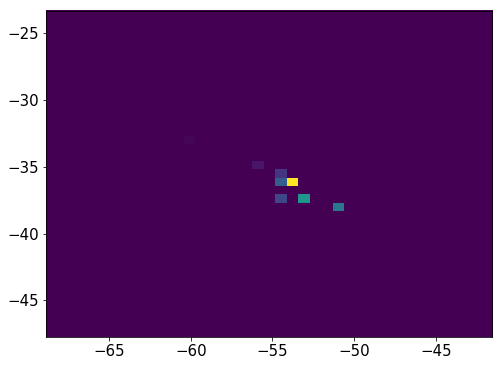

22976    27
22977    27
22978    27
22979    27
22980    27
22981    27
22982    27
22983    27
22984    27
22985    27
22986    27
22987    27
22988    27
22992    27
22993    27
22994    27
22995    27
22996    27
22997    27
22998    27
22999    27
23000    27
Name: Nsipm, dtype: uint16


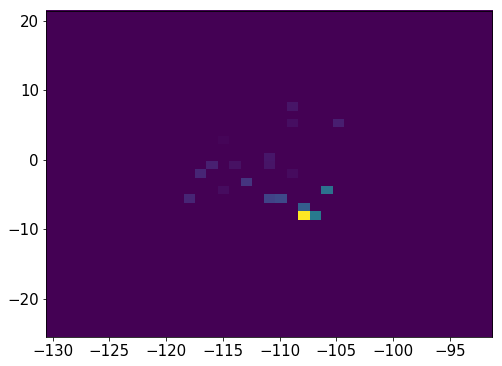

958269    44
958270    44
958271    44
958272    44
958273    44
958274    44
958275    44
958276    44
958277    44
958278    44
958279    44
958280    44
958281    44
958282    44
Name: Nsipm, dtype: uint16


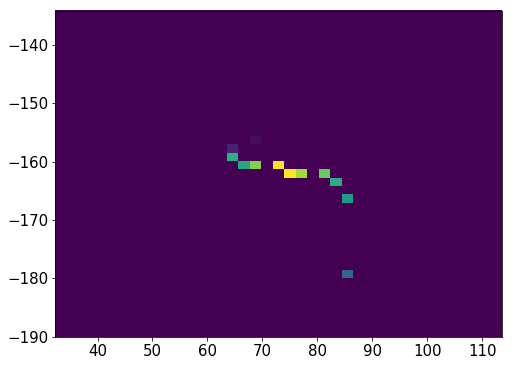

23005    40
23006    40
23007    40
23008    40
23009    40
23010    40
23011    40
23012    40
23013    40
23014    40
23015    40
23016    40
Name: Nsipm, dtype: uint16


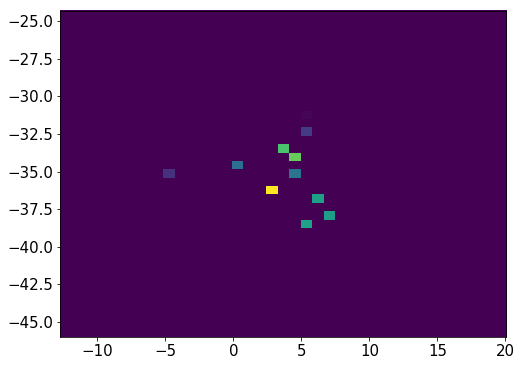

958287    27
958288    27
958289    27
958290    27
958291    27
958292    27
958293    27
958294    27
958295    27
958296    27
958297    27
958298    27
958299    27
958300    27
958301    27
958302    27
958303    27
958304    27
Name: Nsipm, dtype: uint16


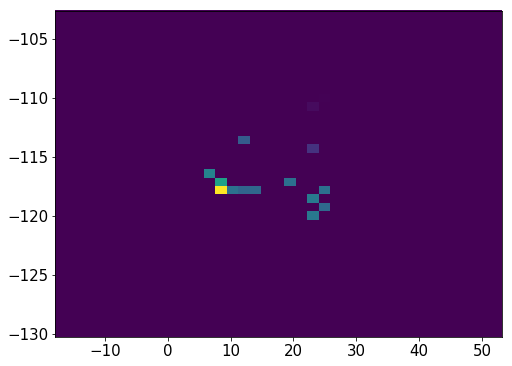

958309    23
958310    23
958311    23
958312    23
958313    23
958314    23
958315    23
958316    23
958317    23
958318    23
958319    23
958320    23
958321    23
958322    23
958323    23
958324    23
958325    23
958326    23
958327    23
958328    23
958329    23
958330    23
958331    23
958332    23
958333    23
958334    23
958335    23
958336    23
958337    23
958338    23
958339    23
958347    23
958348    23
958349    23
958350    23
Name: Nsipm, dtype: uint16


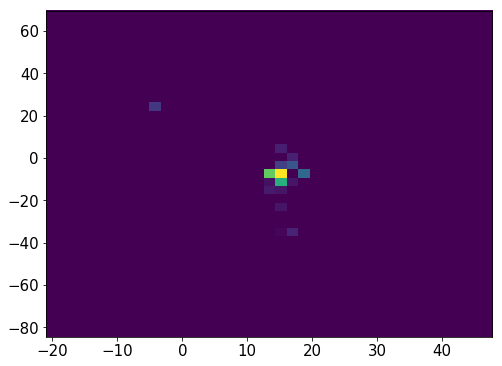

23021    28
23022    28
23023    28
23024    28
23025    28
23026    28
23027    28
23028    28
23029    28
23030    28
23031    28
23032    28
23033    28
23034    28
23035    28
Name: Nsipm, dtype: uint16


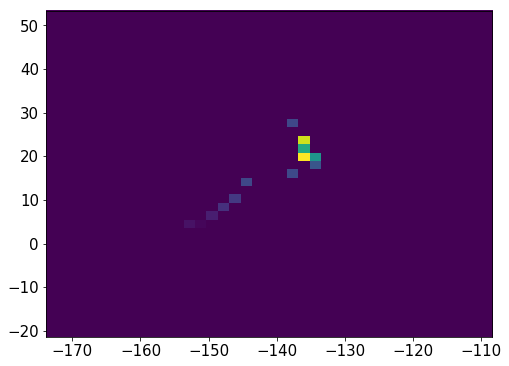

23040    22
23041    22
23042    22
23043    22
23044    22
23045    22
23046    22
23047    22
23048    22
23049    22
23050    22
23051    22
23052    22
23053    22
23054    22
23055    22
23056    22
23057    22
23058    22
23059    22
23060    22
23061    22
23062    22
23063    22
23064    22
23065    22
Name: Nsipm, dtype: uint16


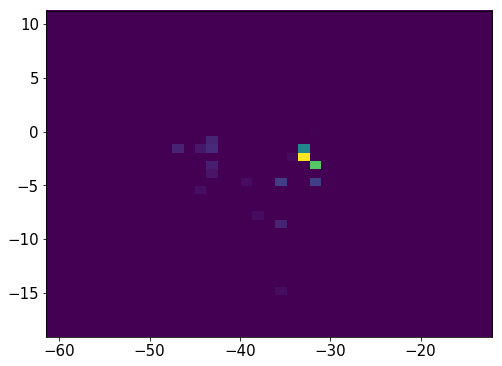

23070    24
23071    24
23072    24
23073    24
23074    24
23075    24
23076    24
23077    24
23078    24
23079    24
23080    24
23081    24
23082    24
23083    24
23084    24
23085    24
23086    24
23087    24
23088    24
23089    24
Name: Nsipm, dtype: uint16


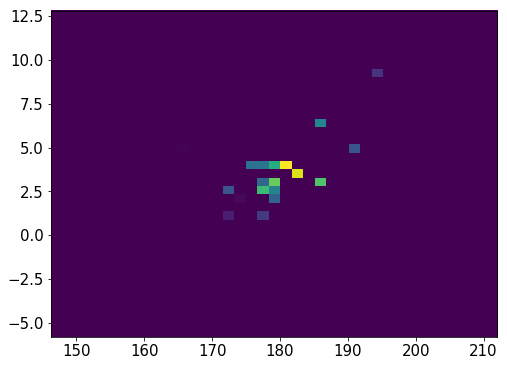

23095    25
23096    25
23097    25
23098    25
23099    25
23100    25
23101    25
23102    25
23103    25
23104    25
23105    25
23106    25
23107    25
23108    25
23109    25
23110    25
23111    25
23112    25
23113    25
23114    25
Name: Nsipm, dtype: uint16


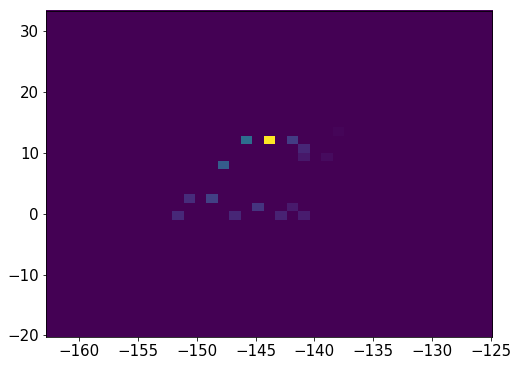

23120    27
23121    27
23122    27
23123    27
23124    27
23125    27
23126    27
23127    27
23128    27
23129    27
23130    27
23131    27
23132    27
23133    27
23134    27
Name: Nsipm, dtype: uint16


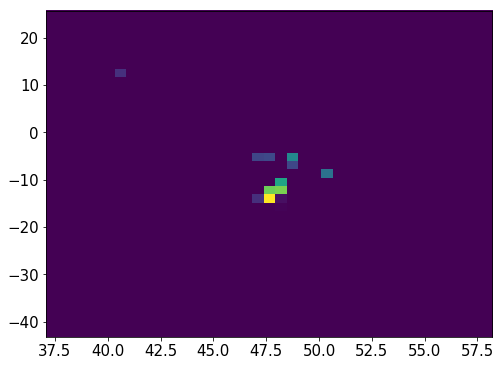

958452    20
958453    20
958454    20
958455    20
958456    20
958457    20
958458    20
958459    20
958460    20
958461    20
958462    20
958463    20
958464    20
958465    20
958466    20
Name: Nsipm, dtype: uint16


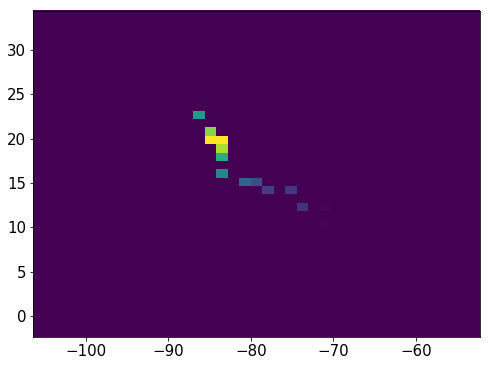

23138    32
23139    32
23140    32
23141    32
23142    32
23143    32
23144    32
23145    32
23146    32
23147    32
23148    32
Name: Nsipm, dtype: uint16


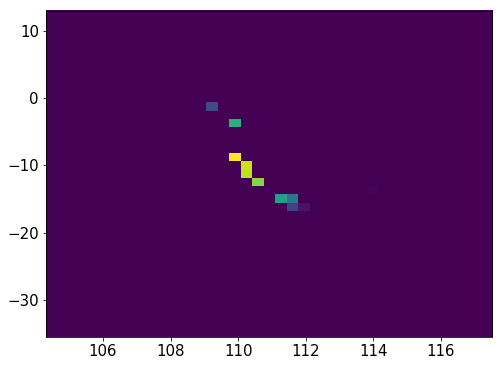

23153    27
23154    27
23155    27
23156    27
23157    27
23158    27
23159    27
23160    27
23161    27
23162    27
23163    27
23164    27
23165    27
23166    27
23167    27
23168    27
23169    27
23170    27
23171    27
23172    27
23173    27
Name: Nsipm, dtype: uint16


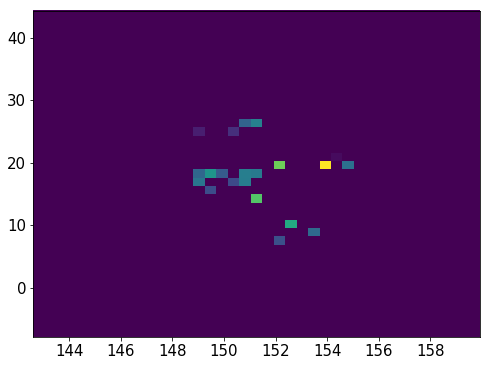

958471    27
958472    27
958473    27
958474    27
958475    27
958476    27
958477    27
958478    27
958479    27
958480    27
958481    27
958482    27
958483    27
958484    27
958485    27
958486    27
958487    27
958488    27
958489    27
958490    27
Name: Nsipm, dtype: uint16


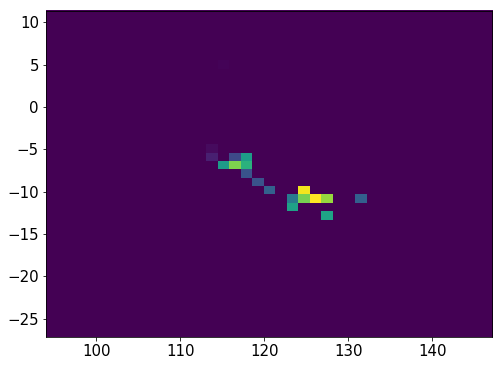

958496    24
958497    24
958498    24
958499    24
958500    24
958501    24
958502    24
958503    24
958504    24
958505    24
958506    24
958507    24
958508    24
958509    24
958510    24
958511    24
958512    24
958513    24
958518    24
958519    24
Name: Nsipm, dtype: uint16


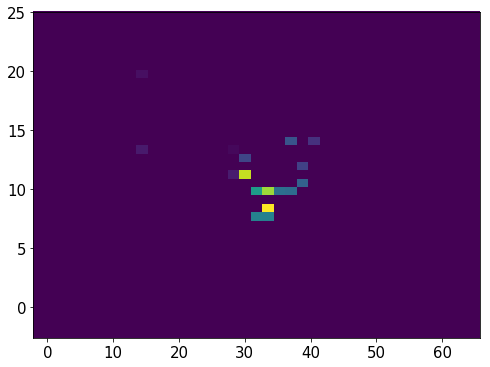

958526    24
958527    24
958528    24
958529    24
958530    24
958531    24
958532    24
958533    24
958534    24
958535    24
958536    24
958537    24
958538    24
958539    24
958540    24
958541    24
958542    24
958543    24
Name: Nsipm, dtype: uint16


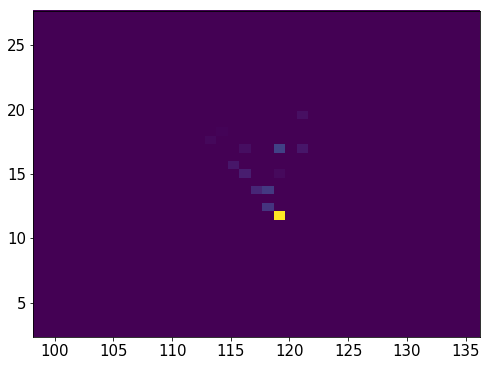

23176    35
23177    35
23178    35
23179    35
23180    35
23181    35
23182    35
23183    35
23184    35
23185    35
23186    35
23187    35
23188    35
23189    35
23190    35
23191    35
23192    35
23193    35
23194    35
23195    35
23196    35
23197    35
23198    35
23199    35
23200    35
23201    35
23202    35
23203    35
Name: Nsipm, dtype: uint16


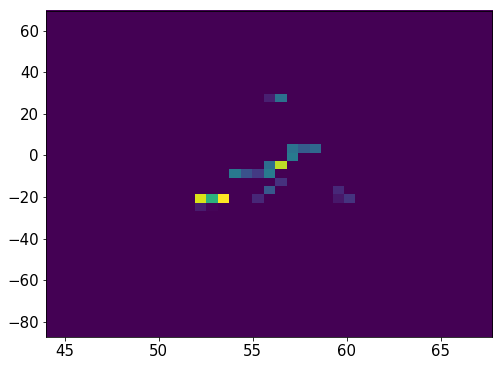

23208    25
23209    25
23210    25
23211    25
23212    25
23213    25
23214    25
23215    25
23216    25
23217    25
23218    25
23219    25
23220    25
23221    25
23222    25
23223    25
23229     1
23230     1
Name: Nsipm, dtype: uint16


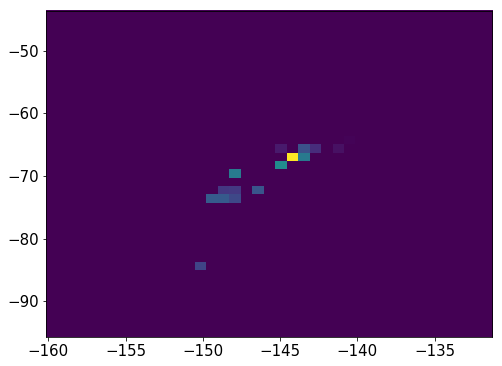

958572    25
958573    25
958574    25
958575    25
958576    25
958577    25
958578    25
958579    25
958580    25
958581    25
958582    25
958583    25
958584    25
958585    25
958586    25
958587    25
958588    25
958589    25
958590    25
958591    25
958592    25
958593    25
958594    25
958595    25
958596    25
958597    25
958598    25
Name: Nsipm, dtype: uint16


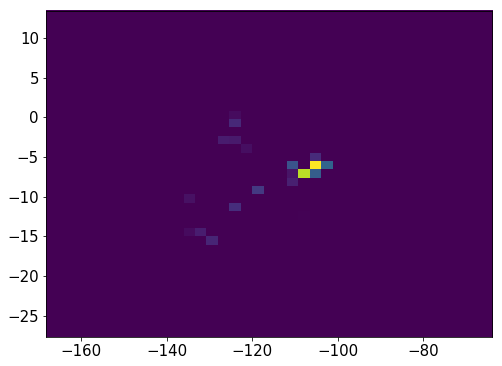

958602    25
958603    25
958604    25
958605    25
958606    25
958607    25
958608    25
958609    25
958610    25
958611    25
958612    25
958613    25
958614    25
958615    25
958616    25
958617    25
958618    25
Name: Nsipm, dtype: uint16


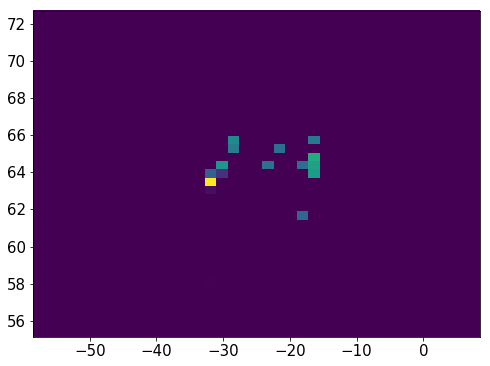

958623    24
958624    24
958625    24
958626    24
958627    24
958628    24
958629    24
958630    24
958631    24
958632    24
958633    24
958634    24
958635    24
958636    24
958637    24
958638    24
958639    24
958640    24
958641    24
958642    24
958643    24
958644    24
958645    24
958646    24
Name: Nsipm, dtype: uint16


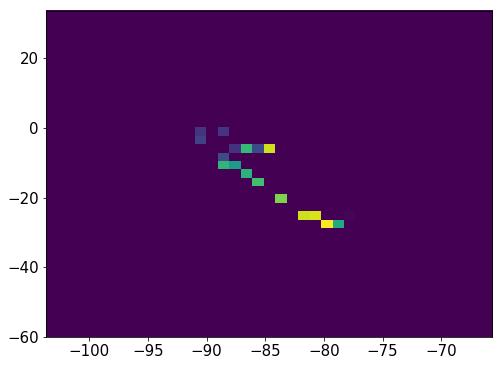

23236    26
23237    26
23238    26
23239    26
23240    26
23241    26
23242    26
23243    26
23244    26
23245    26
23246    26
23247    26
23248    26
23249    26
23250    26
23251    26
23252    26
23253    26
23254    26
23255    26
Name: Nsipm, dtype: uint16


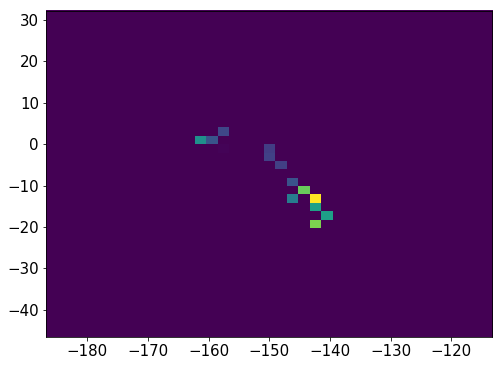

958651    40
958652    40
958653    40
958654    40
958655    40
958656    40
958657    40
958658    40
958659    40
958660    40
958661    40
958662    40
958663    40
958664    40
958665    40
958666    40
958667    40
958668    40
958669    40
958670    40
958671    40
958672    40
958673    40
958674    40
958675    40
958676    40
958677    40
Name: Nsipm, dtype: uint16


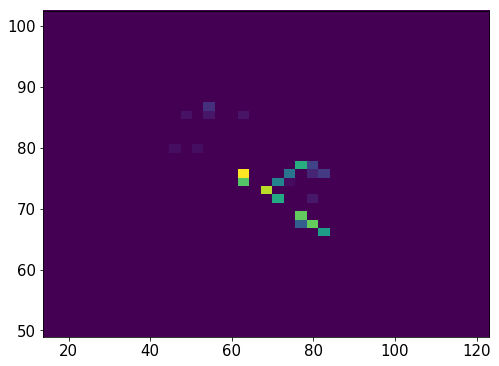

958680    27
958681    27
958682    27
958683    27
958684    27
958685    27
958686    27
958687    27
958688    27
958689    27
958690    27
958691    27
Name: Nsipm, dtype: uint16


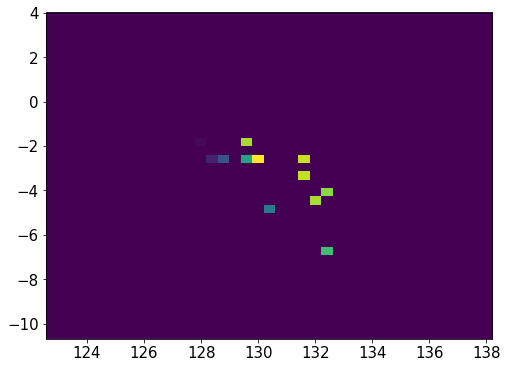

23288    31
23289    31
23290    31
23291    31
23292    31
23293    31
23294    31
23295    31
23296    31
23297    31
23298    31
23299    31
23300    31
Name: Nsipm, dtype: uint16


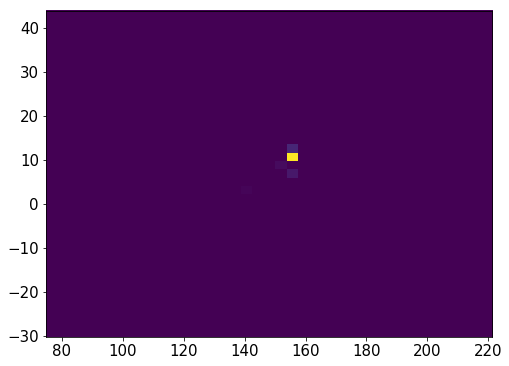

958695    25
958696    25
958697    25
958698    25
958699    25
958700    25
958701    25
958702    25
958703    25
958704    25
958705    25
958706    25
958707    25
958708    25
958709    25
958710    25
958711    25
958712    25
958713    25
958714    25
958715    25
958716    25
958717    25
958718    25
958721    25
958722    25
958723    25
958724    25
Name: Nsipm, dtype: uint16


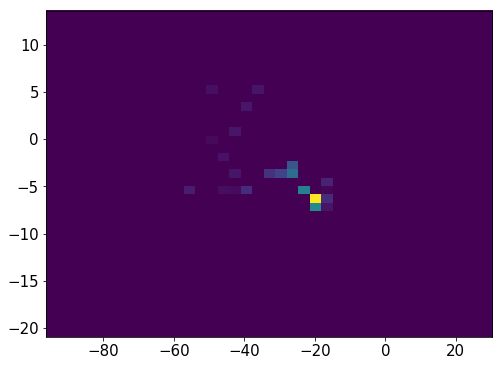

23307    43
23308    43
23309    43
23310    43
23311    43
23312    43
23313    43
23314    43
23315    43
23316    43
23317    43
23318    43
23319    43
23320    43
23321    43
23322    43
23323    43
Name: Nsipm, dtype: uint16


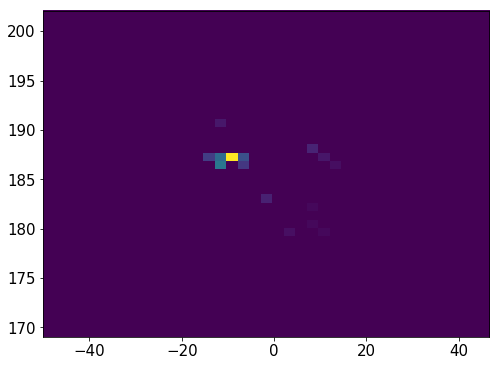

23326    28
23327    28
23328    28
23329    28
23330    28
23331    28
23332    28
23333    28
23334    28
23335    28
23336    28
23337    28
23338    28
Name: Nsipm, dtype: uint16


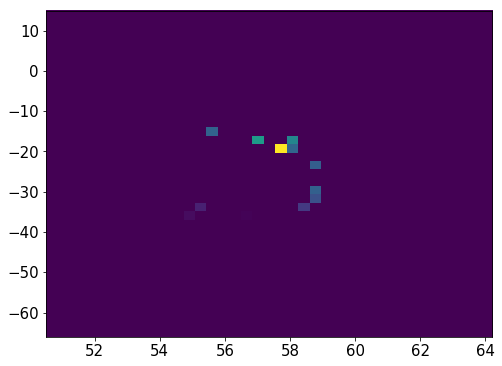

958729    23
958730    23
958731    23
958732    23
958733    23
958734    23
958735    23
958736    23
958737    23
958738    23
958739    23
958740    23
958741    23
958742    23
958743    23
958747     2
958748     2
958749     2
958750     2
958751     2
958752     2
958753     2
Name: Nsipm, dtype: uint16


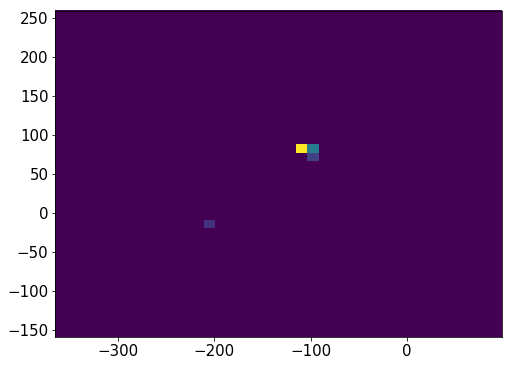

958761    33
958762    33
958763    33
958764    33
958765    33
958766    33
958767    33
958768    33
958769    33
958770    33
958771    33
958772    33
958773    33
958774    33
Name: Nsipm, dtype: uint16


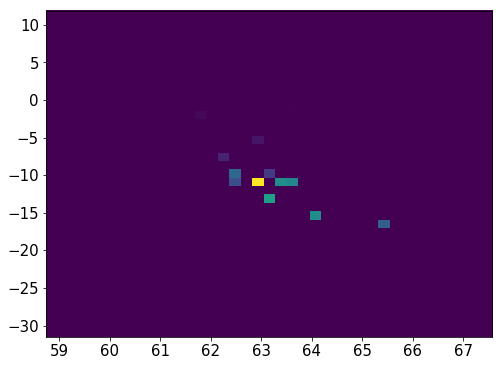

958779    33
958780    33
958781    33
958782    33
958783    33
958784    33
958785    33
958786    33
958787    33
958788    33
958789    33
958790    33
958791    33
958792    33
958793    33
958794    33
958795    33
Name: Nsipm, dtype: uint16


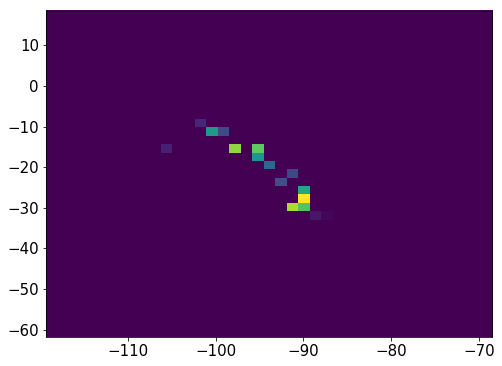

958799    29
958800    29
958801    29
958802    29
958803    29
958804    29
958805    29
958806    29
958807    29
958808    29
958809    29
958810    29
958811    29
958812    29
958813    29
958814    29
958815    29
958816    29
958817    29
Name: Nsipm, dtype: uint16


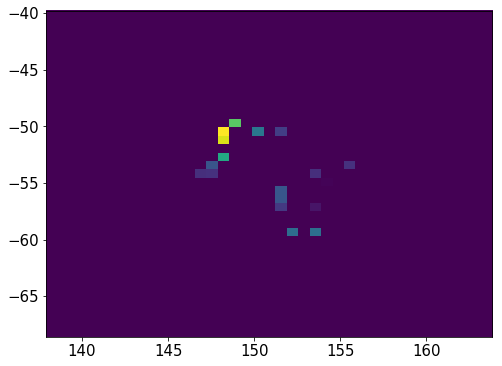

958822    26
958823    26
958824    26
958825    26
958826    26
958827    26
958828    26
958829    26
958830    26
958831    26
958832    26
958833    26
958834    26
958835    26
958836    26
958837    26
958838    26
958839    26
958840    26
958841    26
958842    26
958843    26
958844    26
958845    26
958846    26
958848    26
958849    26
958850    26
958851    26
958852    26
Name: Nsipm, dtype: uint16


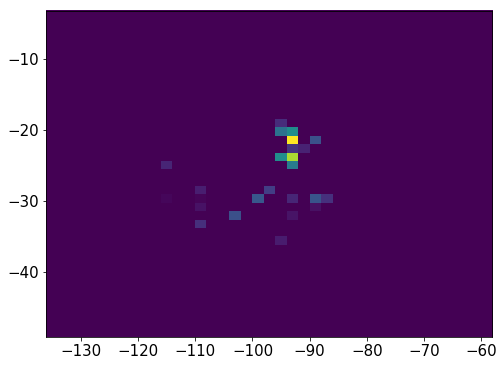

958856    23
958857    23
958858    23
958859    23
958860    23
958861    23
958862    23
958863    23
958864    23
958865    23
958866    23
958867    23
958868    23
958869    23
958870    23
958871    23
958872    23
Name: Nsipm, dtype: uint16


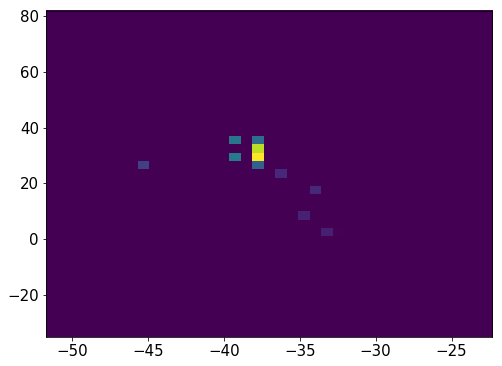

23373    27
23374    27
23375    27
23376    27
23377    27
23378    27
23379    27
23380    27
23381    27
23382    27
23383    27
23384    27
23385    27
23386    27
23387    27
Name: Nsipm, dtype: uint16


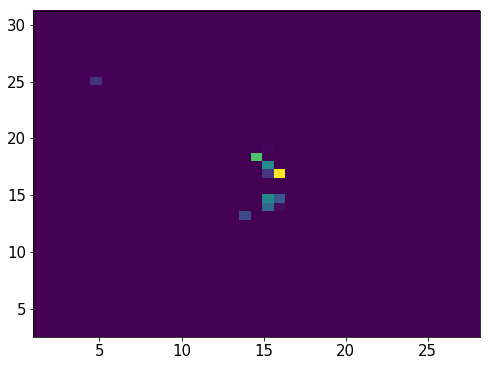

958877    27
958878    27
958879    27
958880    27
958881    27
958882    27
958883    27
958884    27
958885    27
958886    27
958887    27
958888    27
958889    27
958890    27
958891    27
958892    27
958893    27
958894    27
Name: Nsipm, dtype: uint16


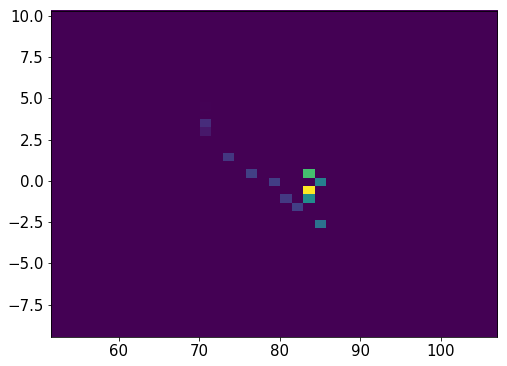

23392    15
23393    15
23394    15
23395    15
23396    15
23397    15
23398    15
23399    15
23400    15
23401    15
23402    15
23403    15
23404    15
23405    15
23406    15
23407    15
23408    15
23409    15
23410    15
Name: Nsipm, dtype: uint16


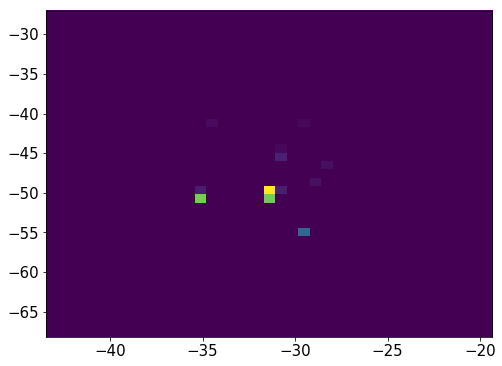

958900    24
958901    24
958902    24
958903    24
958904    24
958905    24
958906    24
958907    24
958908    24
958909    24
958910    24
958911    24
958912    24
958913    24
958914    24
958920    24
958921    24
958923    24
Name: Nsipm, dtype: uint16


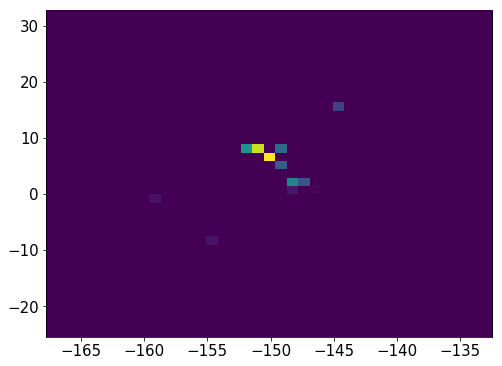

937548    20
937549    20
937550    20
937551    20
937552    20
937553    20
937554    20
937555    20
937556    20
937557    20
937558    20
937559    20
937560    20
937561    20
937562    20
937563    20
937564    20
Name: Nsipm, dtype: uint16


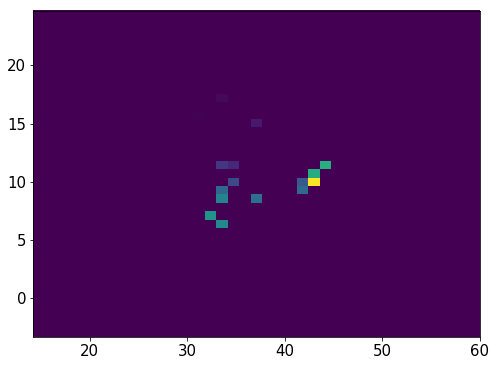

23411    21
23412    21
23413    21
23414    21
23415    21
23416    21
23417    21
23418    21
23419    21
23420    21
23421    21
23422    21
23423    21
23424    21
23425    21
23426    21
23427    21
23428    21
Name: Nsipm, dtype: uint16


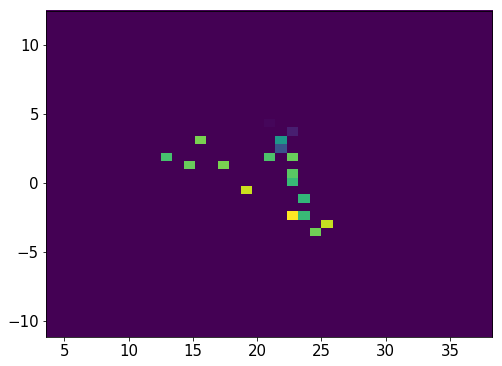

23433    31
23434    31
23435    31
23436    31
23437    31
23438    31
23439    31
23440    31
23441    31
23442    31
23443    31
23444    31
23445    31
23446    31
23447    31
23448    31
23449    31
23450    31
23451    31
23452    31
Name: Nsipm, dtype: uint16


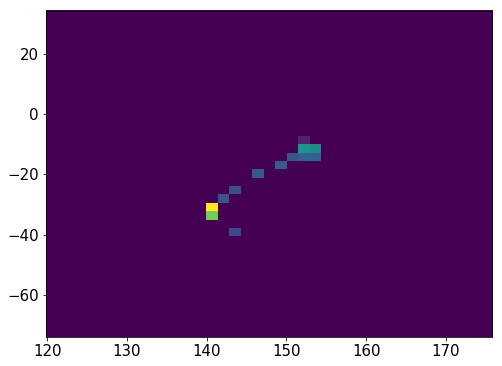

937570    26
937571    26
937572    26
937573    26
937574    26
937575    26
937576    26
937577    26
937578    26
937579    26
937580    26
937581    26
937582    26
937583    26
937584    26
937585    26
937586    26
Name: Nsipm, dtype: uint16


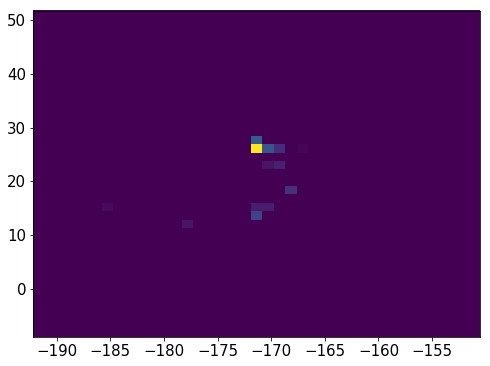

958928    20
958929    20
958930    20
958931    20
958932    20
958933    20
958934    20
958935    20
958936    20
958937    20
958938    20
958939    20
958943    17
958944    17
958945    17
958946    17
958947    17
958948    17
958949    17
958950    17
958951    17
Name: Nsipm, dtype: uint16


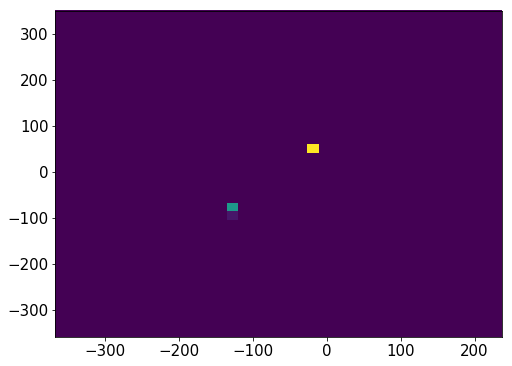

23458    22
23459    22
23460    22
23461    22
23462    22
23463    22
23464    22
23465    22
23466    22
23467    22
23468    22
23469    22
23470    22
23471    22
23472    22
23473    22
23474    22
23475    22
23476    22
23477    22
23478    22
Name: Nsipm, dtype: uint16


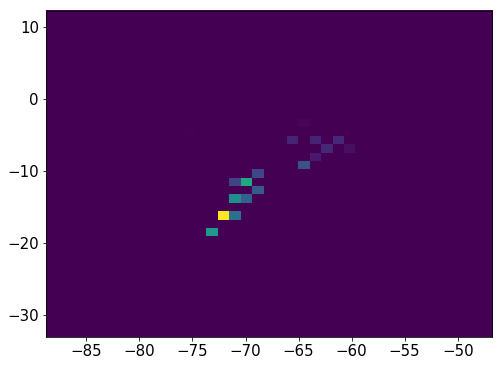

23484    31
23485    31
23486    31
23487    31
23488    31
23489    31
23490    31
23491    31
23492    31
23493    31
23494    31
23495    31
23496    31
Name: Nsipm, dtype: uint16


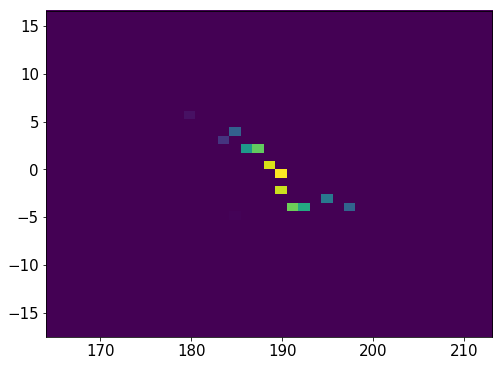

23502    26
23503    26
23504    26
23505    26
23506    26
23507    26
23508    26
23509    26
23510    26
23511    26
23512    26
23513    26
23514    26
23515    26
23516    26
Name: Nsipm, dtype: uint16


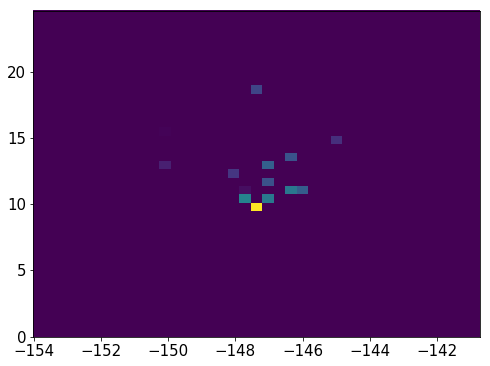

23521    32
23522    32
23523    32
23524    32
23525    32
23526    32
23527    32
23528    32
23529    32
23530    32
23531    32
23532    32
23533    32
23534    32
23535    32
Name: Nsipm, dtype: uint16


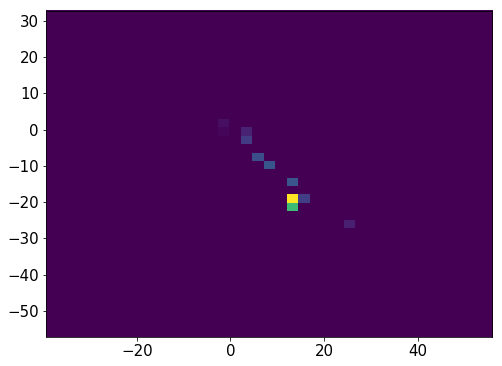

23540    22
23541    22
23542    22
23543    22
23544    22
23545    22
23546    22
23547    22
23548    22
23549    22
23550    22
23551    22
23552    22
23553    22
23554    22
23555    22
23556    22
23557    22
23558    22
23559    22
23560    22
23561    22
23562    22
23567    22
23568    22
Name: Nsipm, dtype: uint16


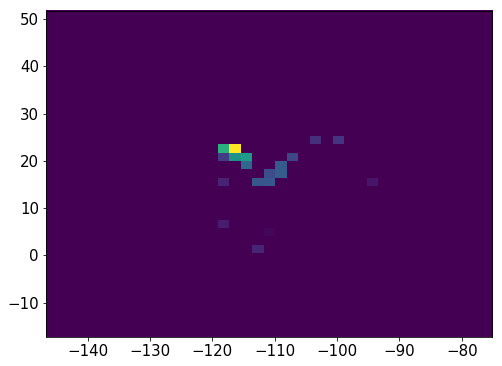

958992    30
958993    30
958994    30
958995    30
958996    30
958997    30
958998    30
958999    30
959000    30
959001    30
959002    30
959003    30
959004    30
959005    30
959006    30
959007    30
959008    30
959009    30
959010    30
959011    30
959012    30
959013    30
959014    30
959015    30
959016    30
959018    30
959019    30
959020    30
959021    30
959022    30
959023    30
959024    30
959025    30
959026    30
959027    30
959028    30
959029    30
959030    30
959031    30
959032    30
959033    30
959034    30
959035    30
959036    30
Name: Nsipm, dtype: uint16


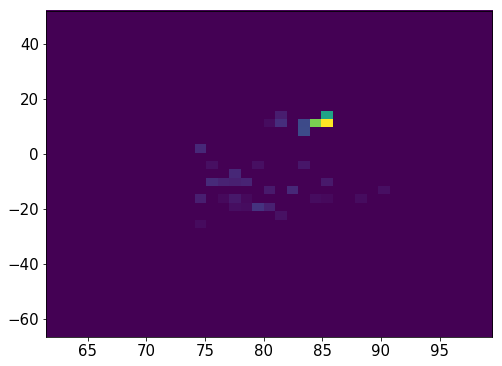

23574    21
23575    21
23576    21
23577    21
23578    21
23579    21
23580    21
23581    21
23582    21
23583    21
23584    21
23585    21
23586    21
23587    21
23588    21
23589    21
Name: Nsipm, dtype: uint16


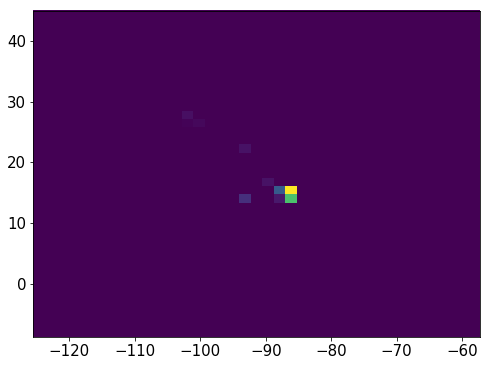

959042    27
959043    27
959044    27
959045    27
959046    27
959047    27
959048    27
959049    27
959050    27
959051    27
959052    27
959053    27
959054    27
959055    27
959056    27
959057    27
Name: Nsipm, dtype: uint16


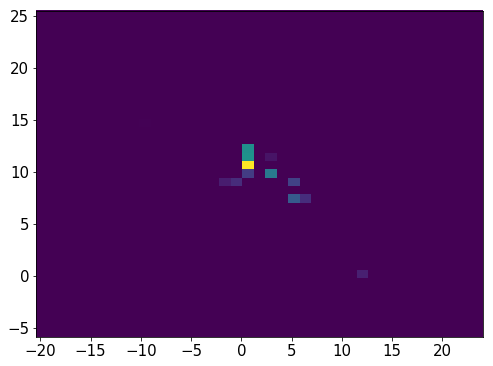

23594    32
23595    32
23596    32
23597    32
23598    32
23599    32
23600    32
23601    32
23602    32
23603    32
23604    32
23605    32
23606    32
23607    32
23608    32
23609    32
Name: Nsipm, dtype: uint16


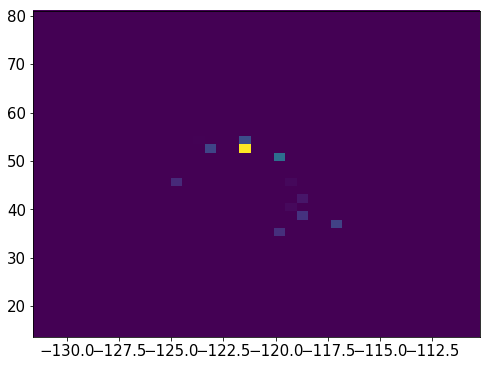

23613    24
23614    24
23615    24
23616    24
23617    24
23618    24
23619    24
23620    24
23621    24
23622    24
23623    24
23624    24
23625    24
23626    24
23627    24
23628    24
23629    24
Name: Nsipm, dtype: uint16


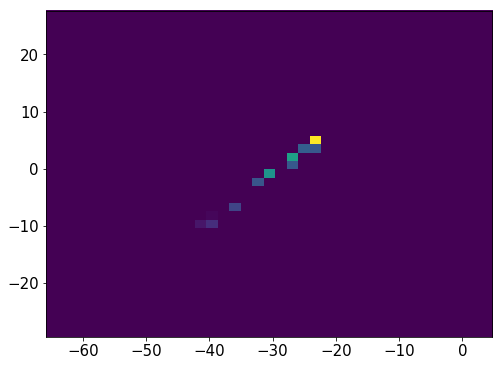

23634    25
23635    25
23636    25
23637    25
23638    25
23639    25
23640    25
23641    25
23642    25
23643    25
23644    25
23645    25
Name: Nsipm, dtype: uint16


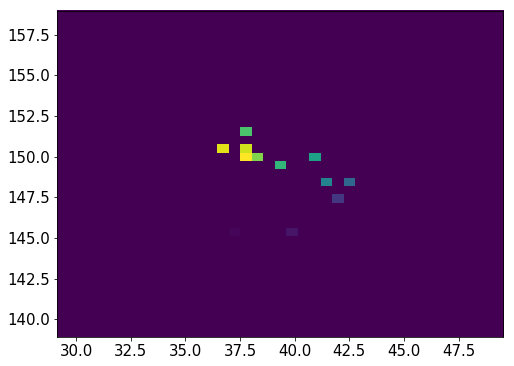

23650    21
23651    21
23652    21
23653    21
23654    21
23655    21
23656    21
23657    21
23658    21
23659    21
23660    21
23661    21
23662    21
23663    21
23664    21
23665    21
23666    21
23667    21
23668    21
Name: Nsipm, dtype: uint16


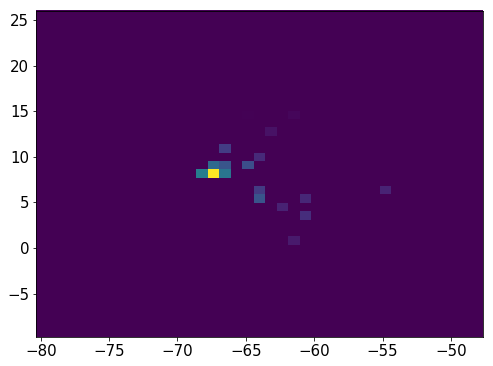

23673    23
23674    23
23675    23
23676    23
23677    23
23678    23
23679    23
23680    23
23681    23
23682    23
23683    23
23684    23
23685    23
23686    23
23687    23
23688    23
23689    23
23690    23
23691    23
23692    23
23693    23
23694    23
23695    23
23696    23
23697    23
23698    23
23699    23
23700    23
23701    23
Name: Nsipm, dtype: uint16


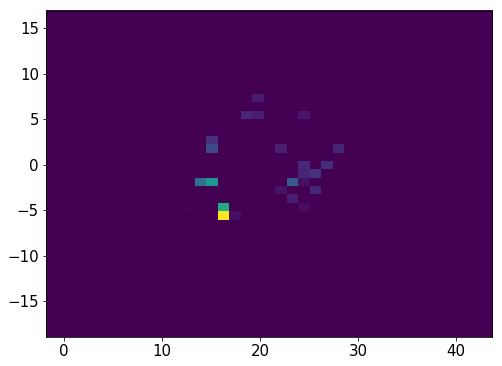

23708    28
23709    28
23710    28
23712    28
23713    28
23714    28
23715    28
23716    28
23717    28
23718    28
23719    28
23720    28
23721    28
23722    28
Name: Nsipm, dtype: uint16


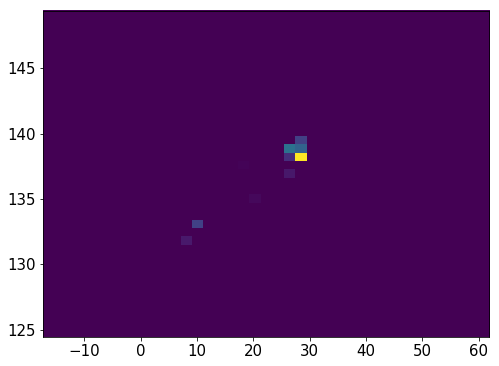

23725    33
23726    33
23727    33
23728    33
23729    33
23730    33
23731    33
23732    33
23733    33
23734    33
23735    33
23736    33
23737    33
23738    33
23739    33
23740    33
23741    33
23742    33
23749     6
23750     6
23751     6
23752     6
23753     6
23754     6
23755     6
Name: Nsipm, dtype: uint16


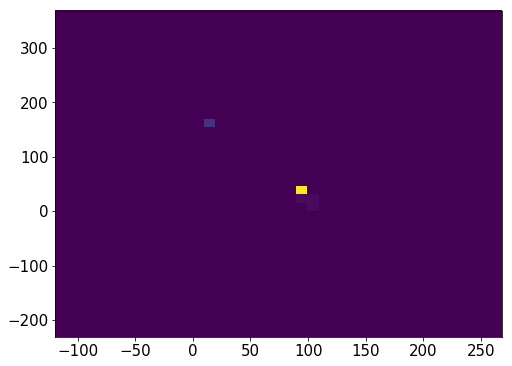

23761    22
23762    22
23763    22
23764    22
23765    22
23766    22
23767    22
23768    22
23769    22
23770    22
23771    22
23772    22
23773    22
23774    22
23775    22
23776    22
Name: Nsipm, dtype: uint16


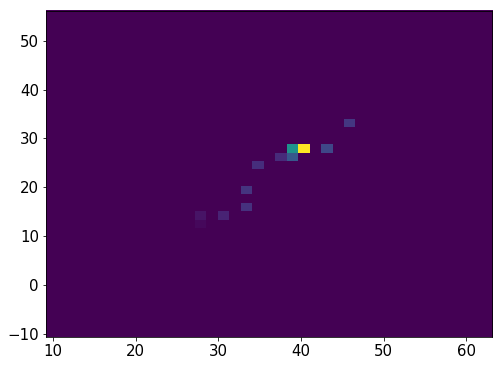

23782    22
23783    22
23784    22
23785    22
23786    22
23787    22
23788    22
23789    22
23790    22
23791    22
23792    22
23793    22
23798     1
23799     1
23800     1
23801     1
23802     1
23803     1
Name: Nsipm, dtype: uint16


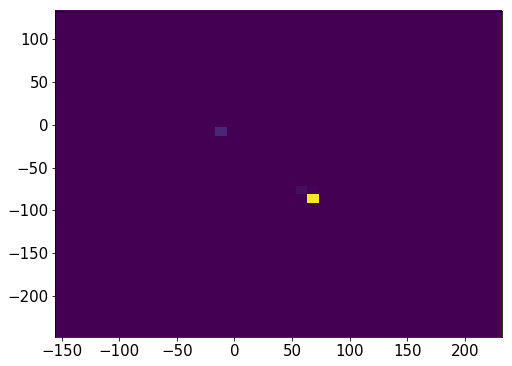

23807    25
23808    25
23809    25
23810    25
23811    25
23812    25
23813    25
23814    25
23815    25
23816    25
23817    25
23818    25
23819    25
23820    25
23821    25
23822    25
23823    25
23824    25
23825    25
23829     3
23830     3
23831     3
23832     3
23833     3
23834     3
Name: Nsipm, dtype: uint16


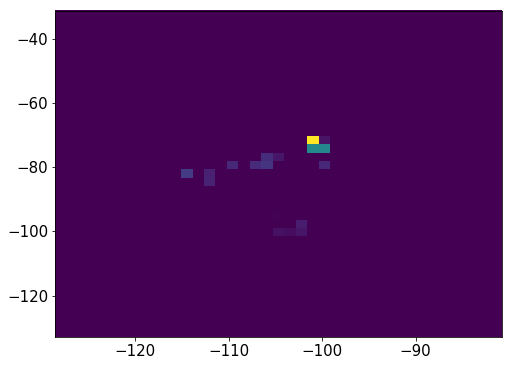

23838    30
23839    30
23840    30
23841    30
23842    30
23843    30
23844    30
23845    30
23846    30
23847    30
23848    30
23849    30
23850    30
23851    30
Name: Nsipm, dtype: uint16


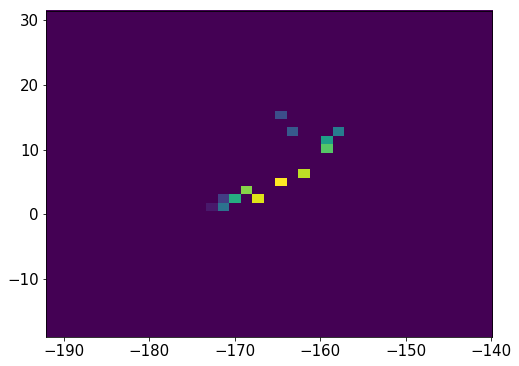

23857    29
23858    29
23859    29
23860    29
23861    29
23862    29
23863    29
23864    29
23865    29
23866    29
23867    29
Name: Nsipm, dtype: uint16


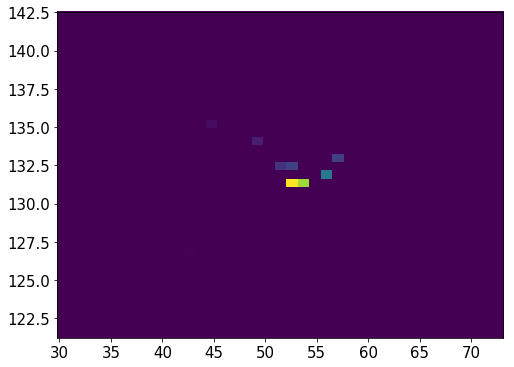

959095    34
959096    34
959097    34
959098    34
959099    34
959100    34
959101    34
959102    34
959103    34
959104    34
959105    34
959106    34
959107    34
959108    34
959109    34
959110    34
959111    34
959112    34
959113    34
959114    34
959115    34
959116    34
959117    34
959118    34
959119    34
959120    34
959121    34
959122    34
959123    34
959124    34
959125    34
959126    34
959127    34
959128    34
959129    34
959130    34
959131    34
959132    34
959133    34
959134    34
959135    34
959136    34
959137    34
959138    34
959139    34
959140    34
959141    34
959142    34
959143    34
959144    34
959145    34
959146    34
959147    34
959148    34
959150    34
959151    34
959152    34
959153    34
Name: Nsipm, dtype: uint16


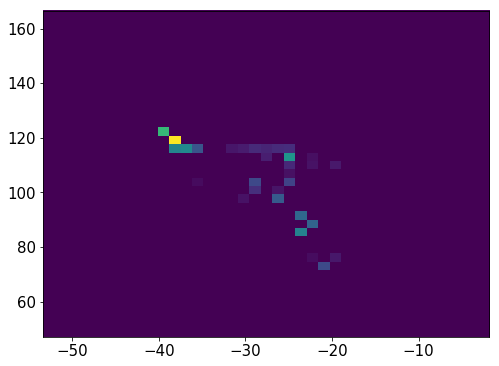

23871    24
23872    24
23873    24
23874    24
23875    24
23876    24
23877    24
23878    24
23879    24
23880    24
23881    24
23882    24
23883    24
23884    24
23885    24
23886    24
23887    24
Name: Nsipm, dtype: uint16


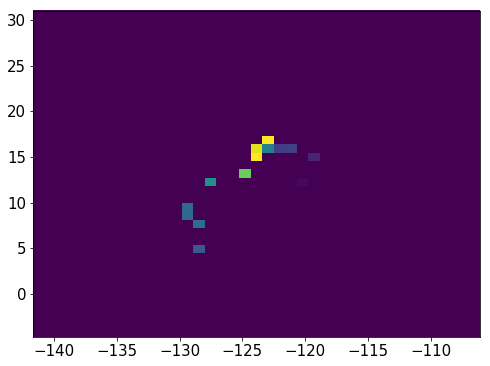

959157    19
959158    19
959159    19
959160    19
959161    19
959162    19
959163    19
959164    19
959165    19
959166    19
959167    19
959172     9
959173     9
959174     9
959175     9
959176     9
959177     9
959178     9
959179     9
959180     9
Name: Nsipm, dtype: uint16


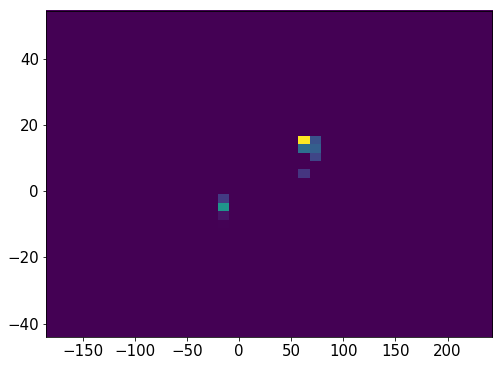

23892    37
23893    37
23894    37
23895    37
23896    37
23897    37
23898    37
23899    37
23900    37
23901    37
23902    37
23903    37
23904    37
23905    37
23906    37
23907    37
23908    37
23909    37
23910    37
23911    37
23912    37
23913    37
23914    37
23915    37
23916    37
Name: Nsipm, dtype: uint16


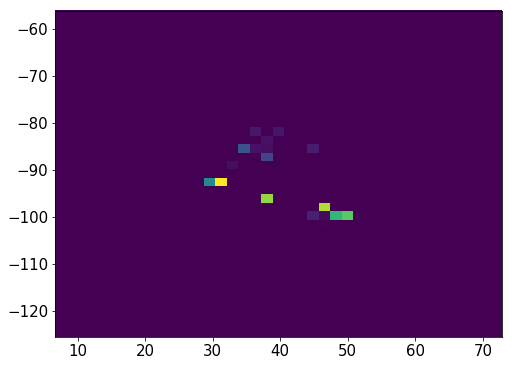

959186    25
959187    25
959188    25
959189    25
959190    25
959191    25
959192    25
959193    25
959194    25
959195    25
959196    25
959197    25
959198    25
959199    25
959200    25
959201    25
Name: Nsipm, dtype: uint16


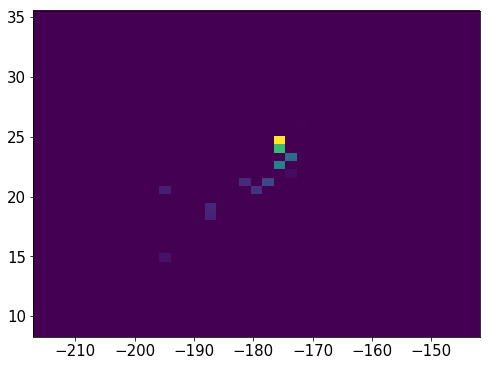

23920    30
23921    30
23922    30
23923    30
23924    30
23925    30
23926    30
23927    30
23928    30
23929    30
23930    30
23931    30
23932    30
23933    30
23934    30
23935    30
23936    30
23937    30
23938    30
23939    30
23940    30
Name: Nsipm, dtype: uint16


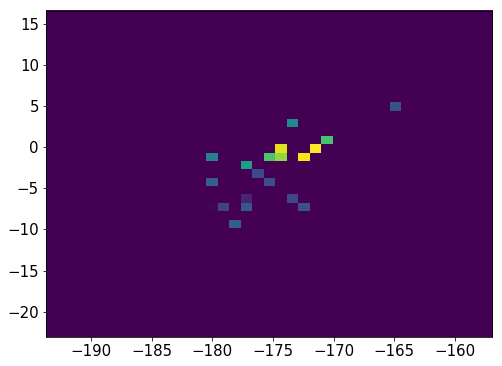

959206    26
959207    26
959208    26
959209    26
959210    26
959212    26
959213    26
959214    26
959215    26
959216    26
959217    26
959218    26
959219    26
959220    26
959221    26
959222    26
959223    26
959224    26
959225    26
959226    26
959227    26
959228    26
959229    26
959230    26
Name: Nsipm, dtype: uint16


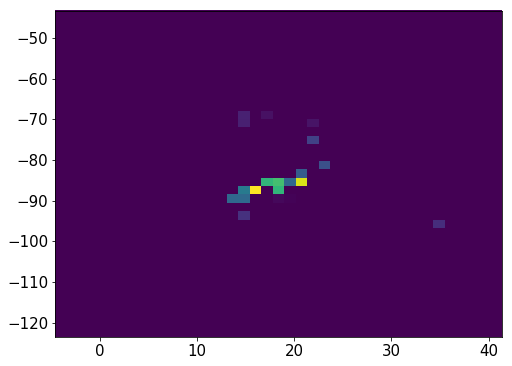

23945    25
23946    25
23947    25
23948    25
23949    25
23950    25
23951    25
23952    25
23953    25
23954    25
23955    25
23956    25
23957    25
23958    25
23959    25
23960    25
23961    25
23962    25
23963    25
23964    25
23965    25
Name: Nsipm, dtype: uint16


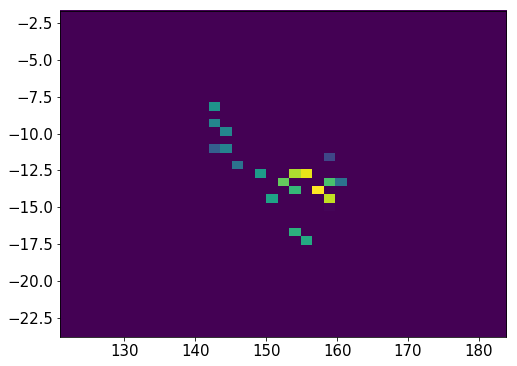

959231    23
959232    23
959233    23
959234    23
959235    23
959236    23
959237    23
959238    23
959239    23
959240    23
959241    23
959242    23
959243    23
959244    23
959245    23
959246    23
959247    23
959248    23
959249    23
959250    23
959251    23
959252    23
Name: Nsipm, dtype: uint16


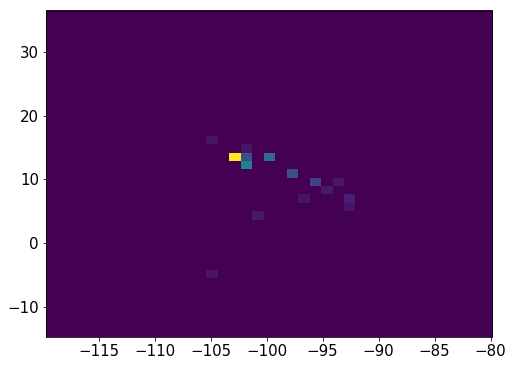

23992    26
23993    26
23994    26
23995    26
23996    26
23997    26
23998    26
23999    26
24000    26
24001    26
24002    26
24003    26
Name: Nsipm, dtype: uint16


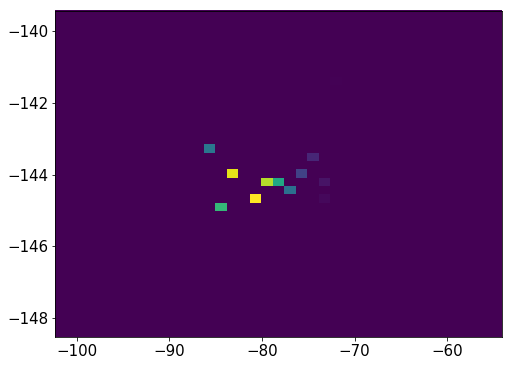

24008    15
24009    15
24010    15
24011    15
24012    15
24013    15
24014    15
24015    15
24021     1
24026     1
24027     1
24028     1
24029     1
24030     1
24031     1
Name: Nsipm, dtype: uint16


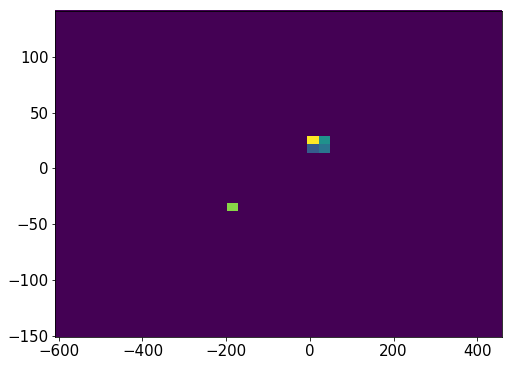

24040    26
24041    26
24042    26
24043    26
24044    26
24045    26
24046    26
24047    26
24048    26
24049    26
24050    26
24051    26
24052    26
24053    26
Name: Nsipm, dtype: uint16


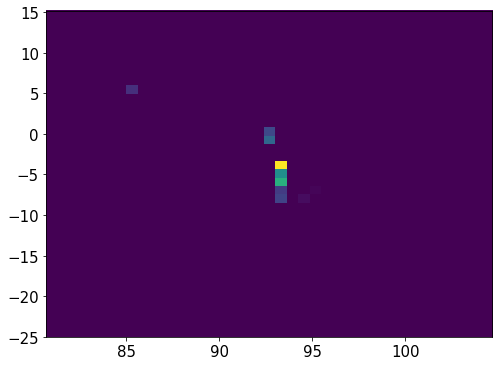

959259    26
959260    26
959261    26
959262    26
959263    26
959264    26
959265    26
959266    26
959267    26
959268    26
959269    26
959270    26
959271    26
959272    26
Name: Nsipm, dtype: uint16


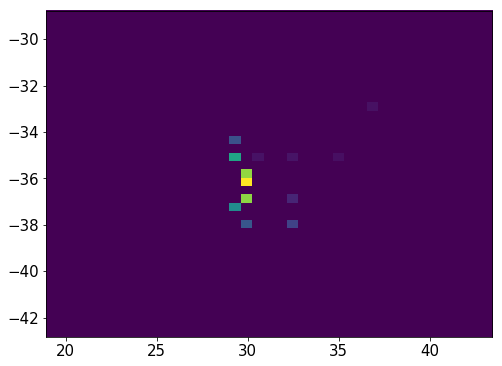

24058    30
24059    30
24060    30
24061    30
24062    30
24063    30
24064    30
24065    30
24066    30
24067    30
24068    30
24069    30
24070    30
24071    30
24072    30
24073    30
24074    30
24075    30
24076    30
24077    30
24078    30
Name: Nsipm, dtype: uint16


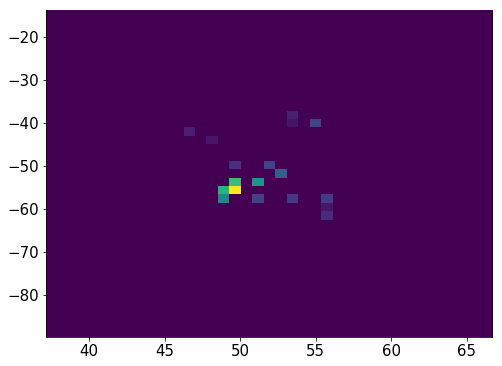

959306    27
959307    27
959308    27
959309    27
959310    27
959311    27
959312    27
959313    27
959314    27
959315    27
959316    27
959317    27
959318    27
959323     1
959324     1
959325     1
959326     1
959327     1
959328     1
Name: Nsipm, dtype: uint16


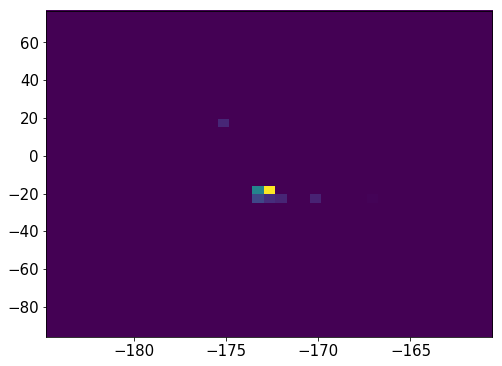

24082    23
24083    23
24084    23
24085    23
24086    23
24087    23
24088    23
24089    23
24090    23
24091    23
24092    23
24093    23
24094    23
24095    23
24096    23
24102    23
24103    23
24104    23
24105    23
Name: Nsipm, dtype: uint16


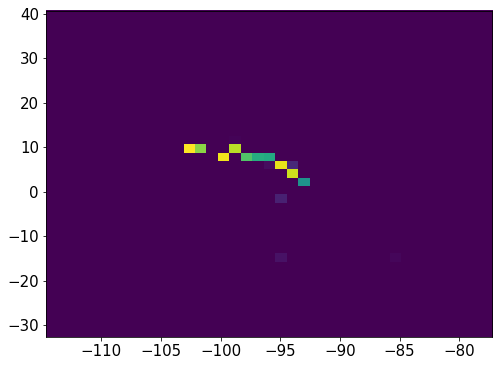

1905014    23
1905015    23
1905016    23
1905017    23
1905018    23
1905019    23
1905020    23
1905021    23
1905022    23
1905023    23
1905024    23
1905025    23
1905026    23
1905027    23
1905028    23
1905029    23
1905030    23
1905031    23
Name: Nsipm, dtype: uint16


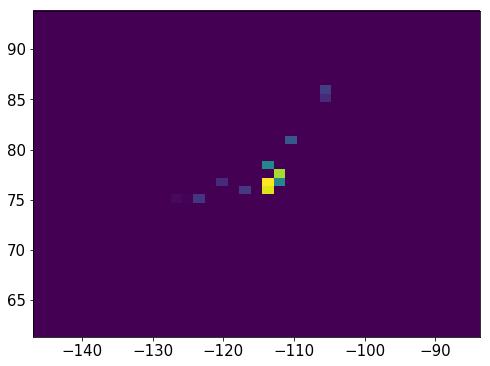

959387    22
959388    22
959389    22
959390    22
959391    22
959392    22
959393    22
959394    22
959395    22
959396    22
959397    22
959398    22
Name: Nsipm, dtype: uint16


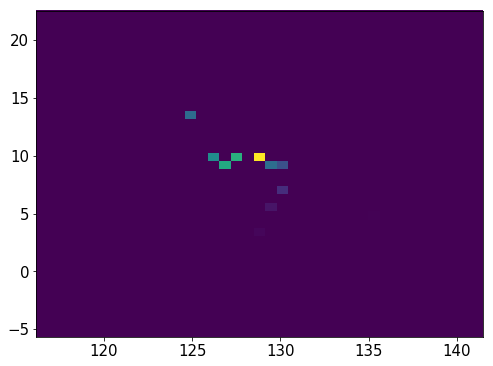

959403    34
959404    34
959405    34
959406    34
959407    34
959408    34
959409    34
959410    34
959411    34
959412    34
959413    34
959414    34
959415    34
959416    34
959417    34
959418    34
959419    34
959420    34
959421    34
959422    34
959423    34
959424    34
959425    34
Name: Nsipm, dtype: uint16


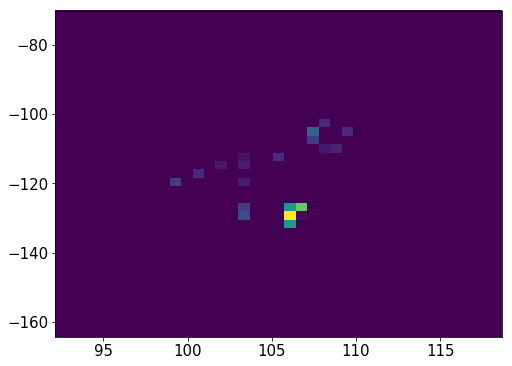

24129    22
24130    22
24131    22
24132    22
24133    22
24134    22
24135    22
24136    22
24137    22
24138    22
24139    22
24140    22
24141    22
24142    22
24143    22
24144    22
24145    22
24146    22
24147    22
24148    22
24149    22
24150    22
24155     1
24156     1
24157     1
24158     1
24159     1
Name: Nsipm, dtype: uint16


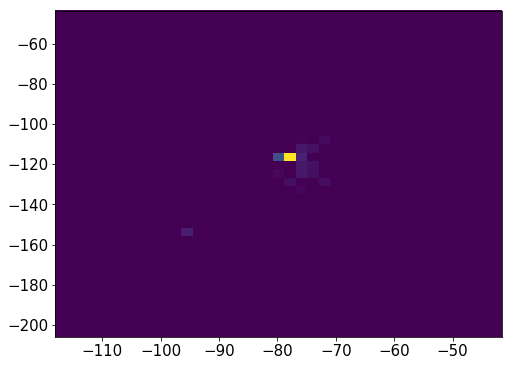

24164    31
24165    31
24166    31
24167    31
24168    31
24169    31
24170    31
24171    31
24172    31
24173    31
24174    31
24175    31
24176    31
24177    31
24178    31
24179    31
24180    31
24181    31
24182    31
24183    31
24184    31
Name: Nsipm, dtype: uint16


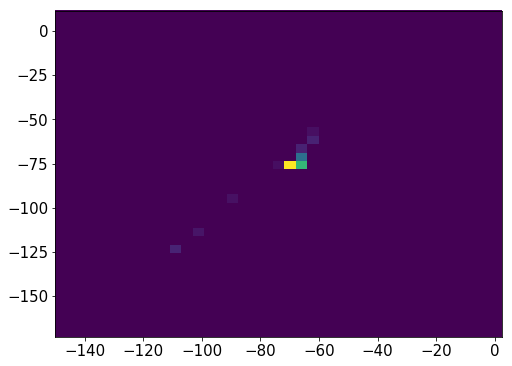

24188    26
24189    26
24190    26
24191    26
24192    26
24193    26
24194    26
24195    26
24196    26
24197    26
24198    26
24199    26
24200    26
24201    26
24202    26
24203    26
Name: Nsipm, dtype: uint16


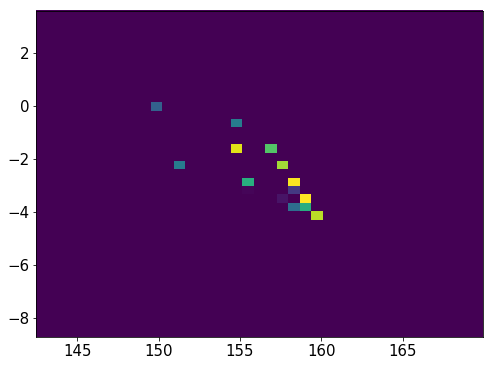

24208    20
24209    20
24210    20
24211    20
24212    20
24213    20
24214    20
24215    20
24216    20
24217    20
24218    20
24219    20
24220    20
24221    20
24222    20
24223    20
Name: Nsipm, dtype: uint16


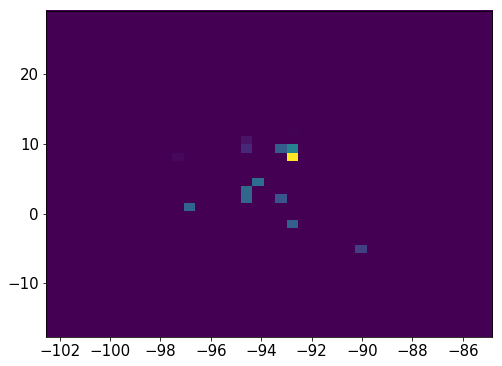

24228    31
24229    31
24230    31
24231    31
24232    31
24233    31
24234    31
24235    31
24236    31
24237    31
24238    31
24239    31
24240    31
Name: Nsipm, dtype: uint16


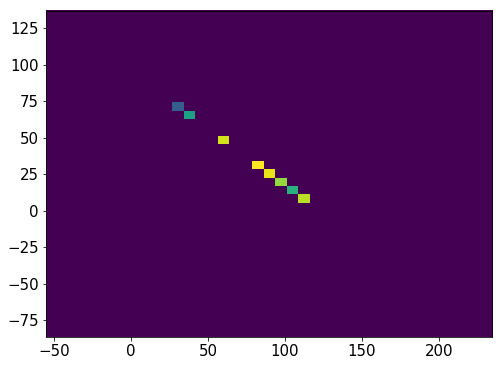

959473    23
959474    23
959475    23
959476    23
959477    23
959478    23
959479    23
959480    23
959481    23
959482    23
959483    23
959484    23
959485    23
959486    23
959487    23
959488    23
959489    23
959490    23
Name: Nsipm, dtype: uint16


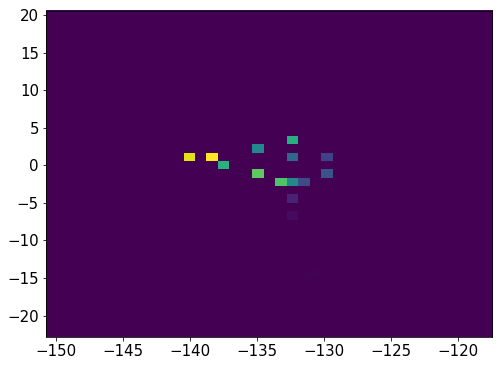

24244    21
24245    21
24246    21
24247    21
24248    21
24249    21
24250    21
24251    21
24252    21
24253    21
24254    21
24255    21
24256    21
24257    21
24258    21
Name: Nsipm, dtype: uint16


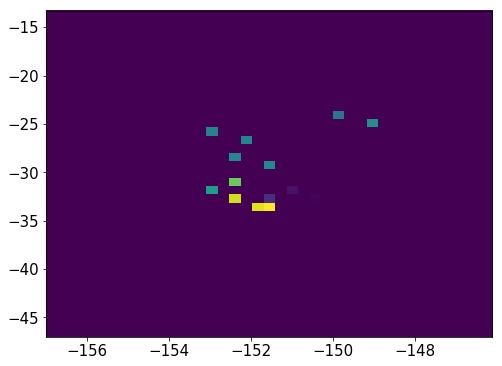

24263    20
24264    20
24265    20
24266    20
24267    20
24268    20
24269    20
24270    20
24275     4
24276     4
24277     4
24278     4
24283    15
24284    15
24285    15
24286    15
24287    15
24288    15
24289    15
24290    15
Name: Nsipm, dtype: uint16


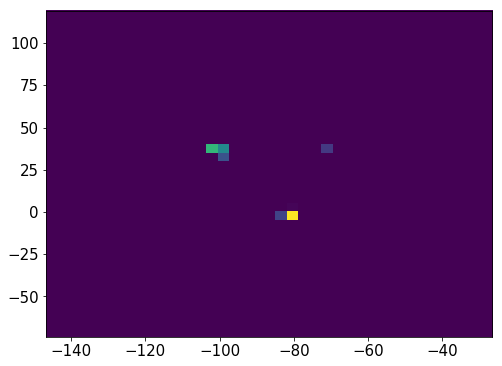

959517    21
959518    21
959519    21
959520    21
959521    21
959522    21
959523    21
959524    21
959525    21
959526    21
959527    21
959528    21
959529    21
959530    21
959531    21
959532    21
959533    21
959534    21
959535    21
959536    21
Name: Nsipm, dtype: uint16


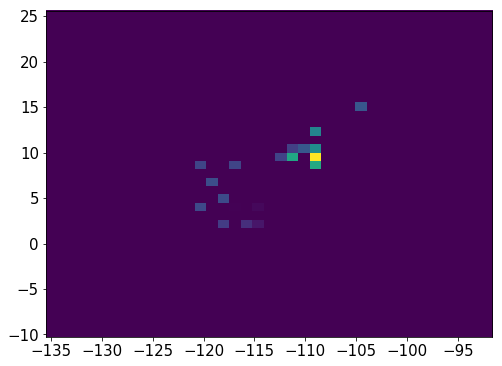

959541    22
959542    22
959543    22
959544    22
959545    22
959546    22
959547    22
959548    22
959549    22
959550    22
959551    22
959552    22
959553    22
959554    22
959555    22
959556    22
959557    22
959558    22
959559    22
959568     1
959569     1
959570     1
959571     1
Name: Nsipm, dtype: uint16


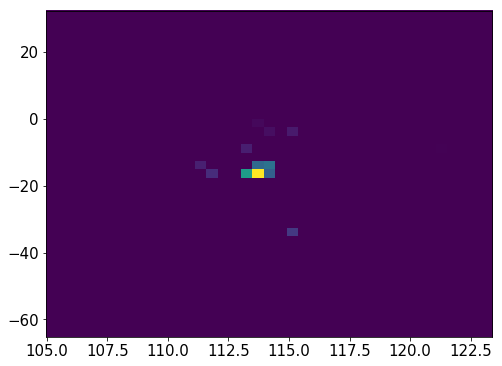

24295    20
24296    20
24297    20
24298    20
24299    20
24300    20
24301    20
24302    20
24303    20
24304    20
24305    20
24306    20
24307    20
24308    20
Name: Nsipm, dtype: uint16


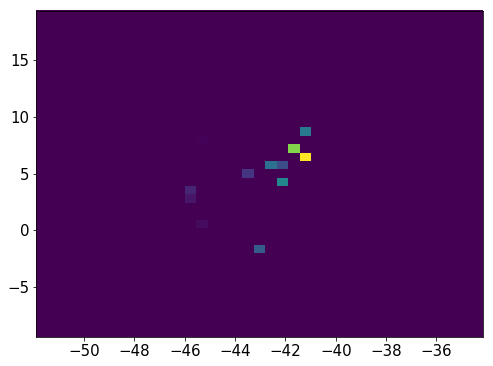

24314    27
24315    27
24316    27
24317    27
24318    27
24319    27
24320    27
24321    27
24322    27
24323    27
24324    27
24325    27
24326    27
24327    27
24328    27
Name: Nsipm, dtype: uint16


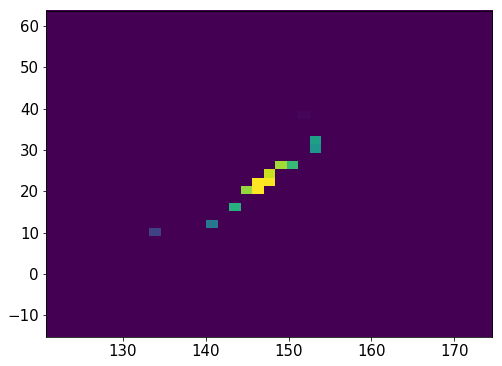

24332    26
24333    26
24334    26
24335    26
24336    26
24337    26
24338    26
24339    26
24340    26
24341    26
24342    26
24343    26
24344    26
24345    26
24346    26
24348    26
24349    26
24350    26
24351    26
24352    26
24354    26
24355    26
24356    26
24357    26
24358    26
24359    26
24362    26
24363    26
24364    26
24365    26
24366    26
Name: Nsipm, dtype: uint16


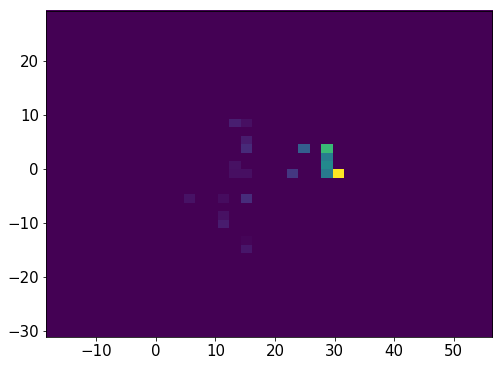

24372    30
24373    30
24374    30
24375    30
24376    30
24377    30
24378    30
24379    30
24380    30
24381    30
24382    30
24383    30
24384    30
24385    30
24386    30
24387    30
24388    30
24389    30
24390    30
24391    30
24392    30
24393    30
Name: Nsipm, dtype: uint16


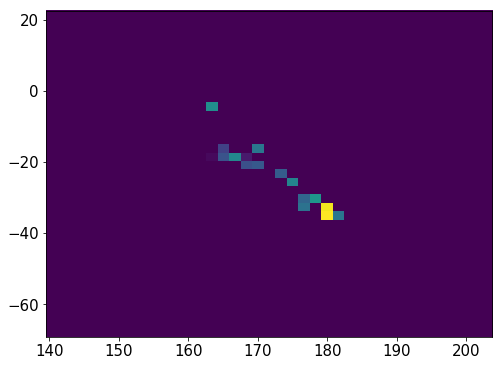

24398    24
24399    24
24400    24
24401    24
24402    24
24403    24
24404    24
24405    24
24406    24
24407    24
24408    24
24409    24
24410    24
Name: Nsipm, dtype: uint16


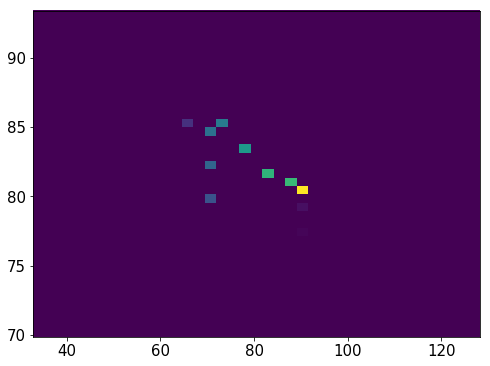

1905071    26
1905072    26
1905073    26
1905074    26
1905075    26
1905076    26
1905077    26
1905078    26
1905079    26
1905080    26
1905081    26
1905082    26
1905083    26
1905084    26
1905085    26
1905086    26
1905087    26
1905088    26
1905089    26
1905090    26
1905091    26
1905092    26
Name: Nsipm, dtype: uint16


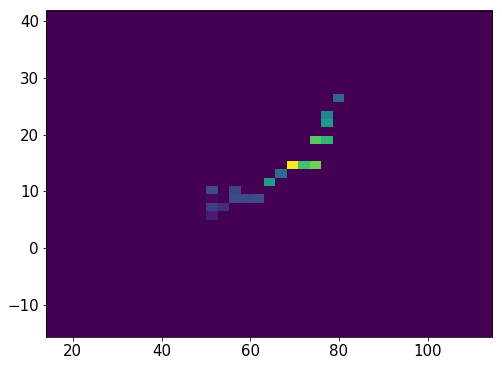

24414    25
24415    25
24416    25
24417    25
24418    25
24419    25
24420    25
24421    25
24422    25
24423    25
24424    25
24425    25
24426    25
24427    25
24428    25
24429    25
24430    25
24431    25
24432    25
Name: Nsipm, dtype: uint16


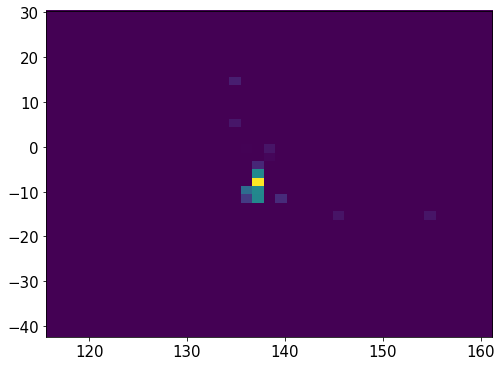

24437    33
24438    33
24439    33
24440    33
24441    33
24442    33
24443    33
24444    33
24445    33
24446    33
24447    33
24448    33
24449    33
24450    33
24451    33
24452    33
24453    33
24454    33
24455    33
24456    33
24457    33
24458    33
Name: Nsipm, dtype: uint16


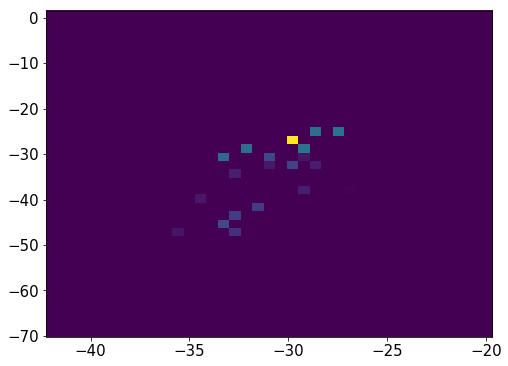

959642    29
959643    29
959644    29
959645    29
959646    29
959647    29
959648    29
959649    29
959650    29
959651    29
959652    29
959653    29
959654    29
959655    29
959656    29
959657    29
959658    29
959659    29
959660    29
959661    29
959662    29
Name: Nsipm, dtype: uint16


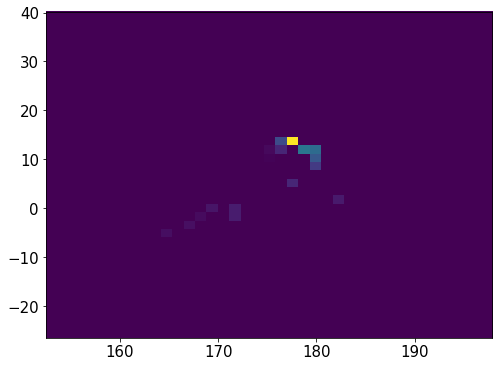

24463    34
24464    34
24465    34
24466    34
24467    34
24468    34
24469    34
24470    34
24471    34
24472    34
24473    34
24474    34
24475    34
24476    34
24477    34
24483    34
24484    34
24485    34
24486    34
Name: Nsipm, dtype: uint16


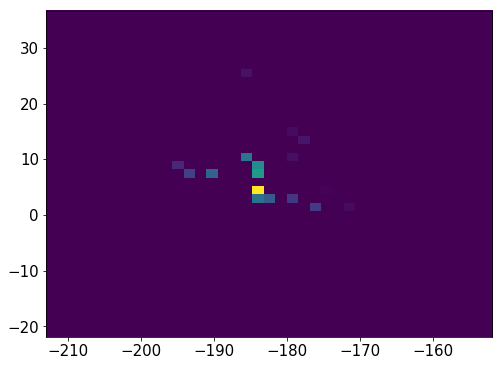

24492    30
24493    30
24494    30
24495    30
24496    30
24497    30
24498    30
24499    30
24500    30
24501    30
24502    30
24503    30
24504    30
24505    30
24506    30
24507    30
24508    30
24509    30
Name: Nsipm, dtype: uint16


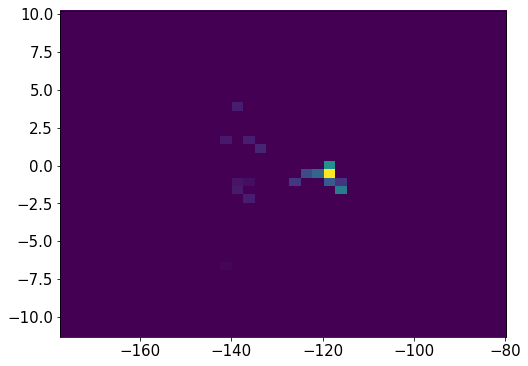

24514    26
24515    26
24516    26
24517    26
24518    26
24519    26
24520    26
24521    26
24522    26
24523    26
24524    26
24525    26
24526    26
24527    26
24528    26
24529    26
24530    26
24531    26
24532    26
24533    26
24537    26
24538    26
Name: Nsipm, dtype: uint16


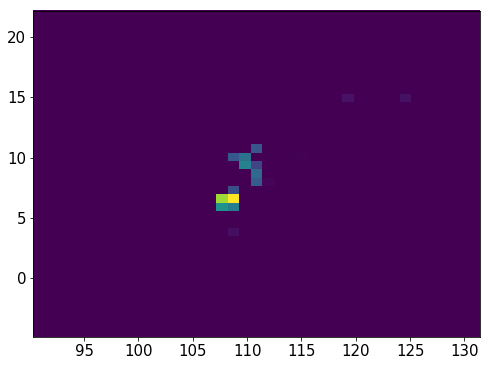

959668    32
959669    32
959670    32
959671    32
959672    32
959673    32
959674    32
959675    32
959676    32
959677    32
959678    32
959679    32
959680    32
959681    32
959682    32
959683    32
959684    32
959685    32
Name: Nsipm, dtype: uint16


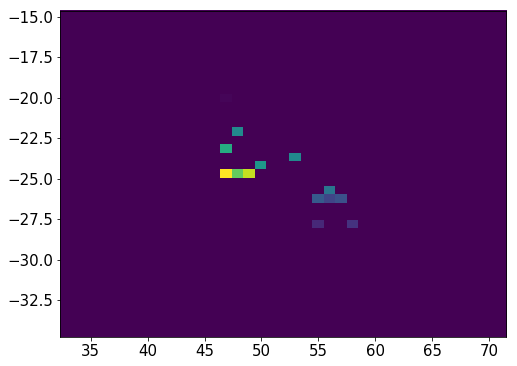

959689    23
959690    23
959691    23
959692    23
959693    23
959694    23
959695    23
959696    23
959697    23
959698    23
959699    23
959700    23
959701    23
959702    23
Name: Nsipm, dtype: uint16


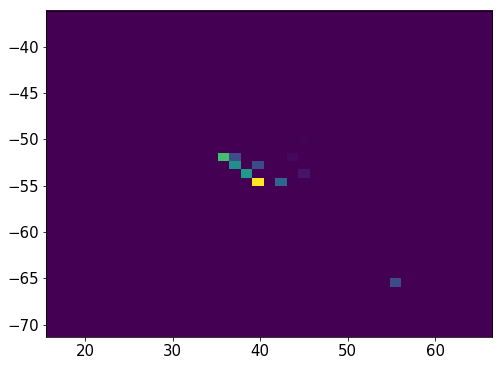

24543    23
24544    23
24545    23
24546    23
24547    23
24548    23
24549    23
24550    23
24551    23
24552    23
24553    23
24554    23
24555    23
24556    23
24557    23
24558    23
Name: Nsipm, dtype: uint16


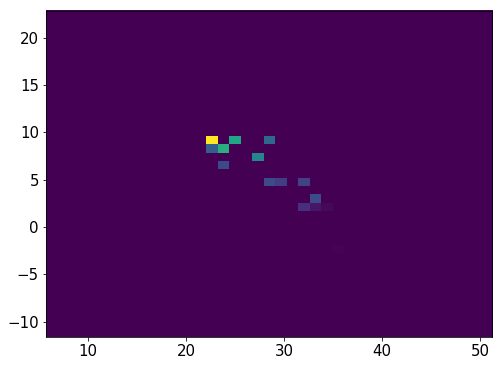

24563    22
24564    22
24565    22
24566    22
24567    22
24568    22
24569    22
24570    22
24571    22
24572    22
24573    22
24574    22
24575    22
24576    22
24577    22
24579    22
24580    22
24581    22
Name: Nsipm, dtype: uint16


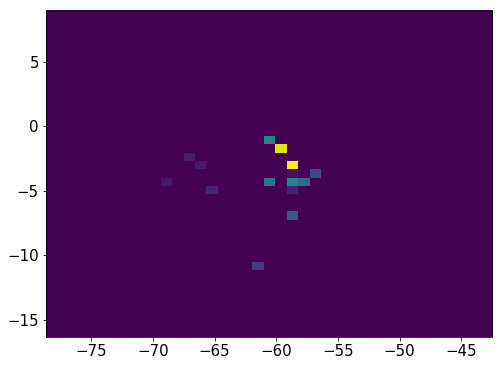

24587    32
24588    32
24589    32
24590    32
24591    32
24592    32
24593    32
24594    32
24595    32
24596    32
24597    32
24603     1
24604     1
24605     1
24606     1
Name: Nsipm, dtype: uint16


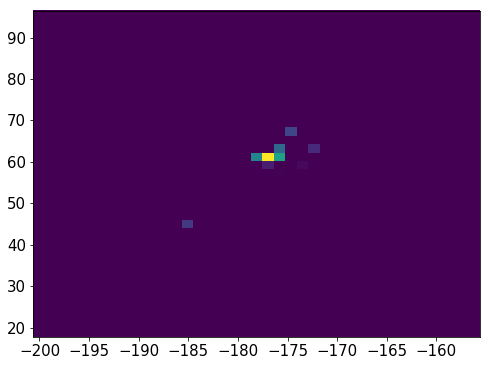

959707    25
959708    25
959709    25
959710    25
959711    25
959712    25
959713    25
959714    25
959715    25
959716    25
959717    25
959718    25
959719    25
959720    25
959721    25
959722    25
959723    25
Name: Nsipm, dtype: uint16


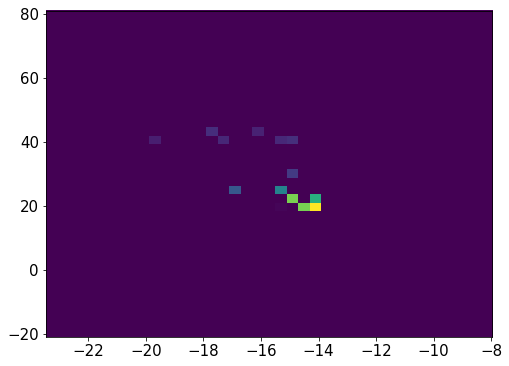

24611    48
24612    48
24613    48
24614    48
24615    48
24616    48
24617    48
24618    48
24619    48
24620    48
24621    48
24622    48
24623    48
24624    48
24625    48
24626    48
24627    48
24628    48
24629    48
Name: Nsipm, dtype: uint16


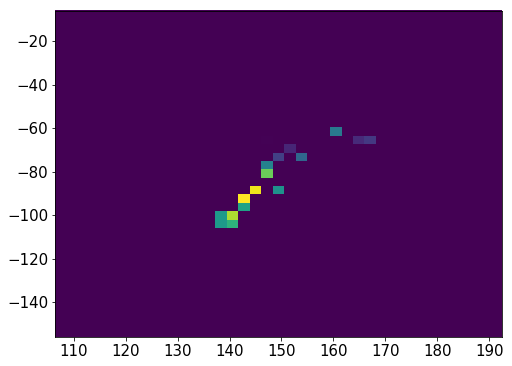

24633    29
24634    29
24635    29
24636    29
24637    29
24638    29
24639    29
24640    29
24641    29
24642    29
24643    29
24644    29
24645    29
24646    29
24647    29
24648    29
24649    29
24650    29
24654    29
24655    29
24656    29
24657    29
Name: Nsipm, dtype: uint16


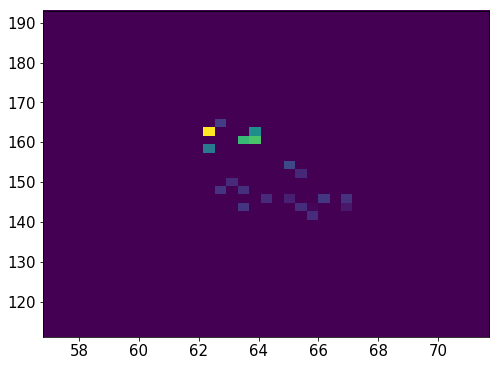

959728    23
959729    23
959730    23
959731    23
959732    23
959733    23
959734    23
959735    23
959736    23
959737    23
959738    23
959739    23
959740    23
959741    23
959742    23
959743    23
Name: Nsipm, dtype: uint16


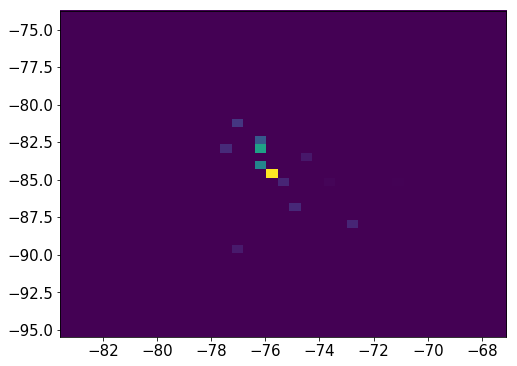

959747    27
959748    27
959749    27
959750    27
959751    27
959752    27
959753    27
959754    27
959755    27
959756    27
959757    27
959758    27
959759    27
959760    27
959761    27
959762    27
Name: Nsipm, dtype: uint16


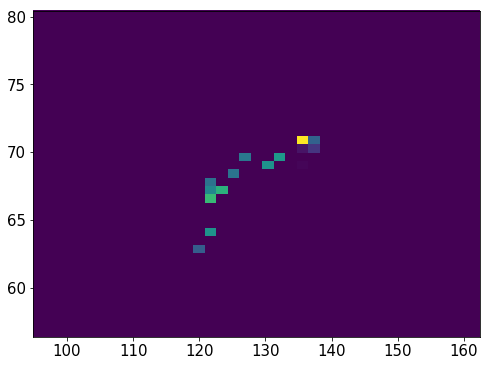

959766    26
959767    26
959768    26
959769    26
959770    26
959771    26
959772    26
959773    26
959774    26
959775    26
959776    26
959777    26
959778    26
959779    26
959780    26
959781    26
959786     4
959787     4
959788     4
959789     4
959790     4
Name: Nsipm, dtype: uint16


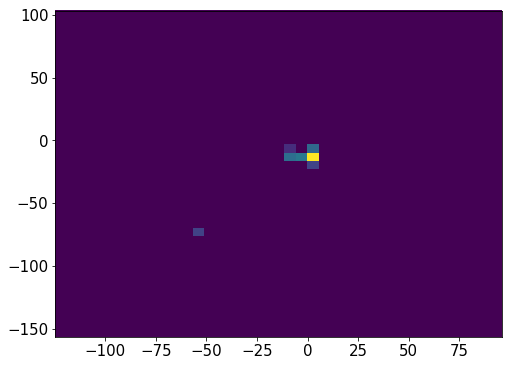

24660    35
24661    35
24662    35
24663    35
24664    35
24665    35
24666    35
24667    35
24668    35
24669    35
24670    35
24671    35
24672    35
24673    35
24674    35
24675    35
Name: Nsipm, dtype: uint16


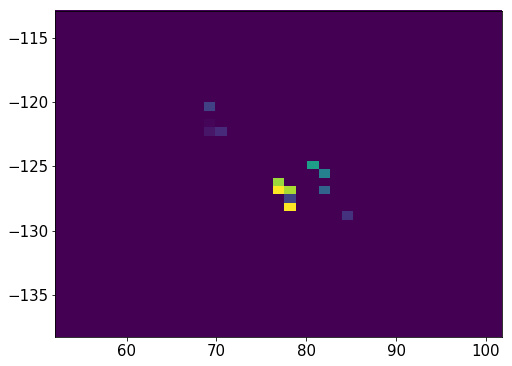

937742    31
937743    31
937744    31
937745    31
937746    31
937747    31
937748    31
937749    31
937750    31
937751    31
937752    31
937753    31
937754    31
937755    31
937756    31
937760    13
937761    13
937762    13
937763    13
937764    13
937765    13
937766    13
Name: Nsipm, dtype: uint16


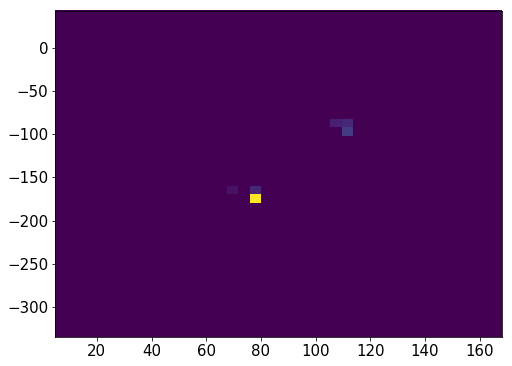

959793    26
959794    26
959795    26
959796    26
959797    26
959798    26
959799    26
959800    26
959801    26
959802    26
959803    26
959804    26
959805    26
959806    26
959807    26
959808    26
959809    26
959810    26
959811    26
959812    26
959813    26
Name: Nsipm, dtype: uint16


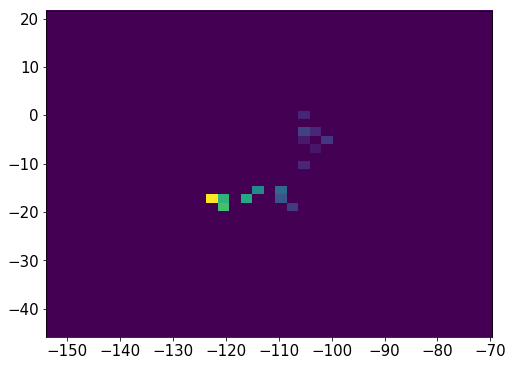

24678    23
24679    23
24680    23
24681    23
24682    23
24683    23
24684    23
24685    23
24686    23
24687    23
24688    23
24689    23
24690    23
24691    23
24692    23
24693    23
24694    23
24695    23
24696    23
24697    23
24698    23
24699    23
24700    23
24701    23
24710    23
24711    23
24712    23
24713    23
Name: Nsipm, dtype: uint16


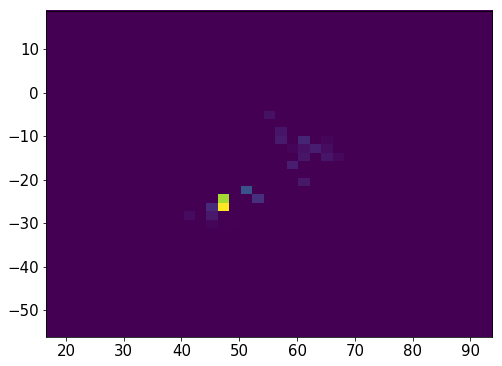

959818    38
959819    38
959820    38
959821    38
959822    38
959823    38
959824    38
959825    38
959826    38
959827    38
959828    38
959829    38
959830    38
959831    38
Name: Nsipm, dtype: uint16


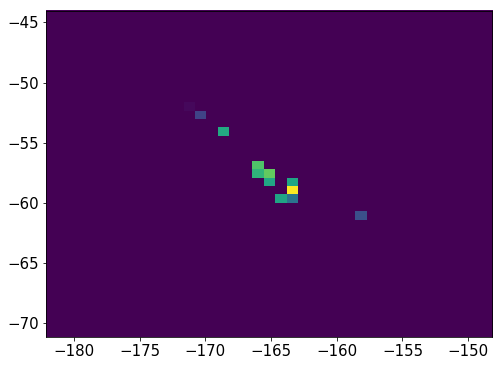

959836    33
959837    33
959838    33
959839    33
959840    33
959841    33
959842    33
959843    33
959844    33
959845    33
959846    33
959847    33
959848    33
959849    33
959850    33
959851    33
959852    33
959853    33
959854    33
959855    33
959856    33
959857    33
959858    33
959859    33
959860    33
959861    33
959862    33
959863    33
959864    33
Name: Nsipm, dtype: uint16


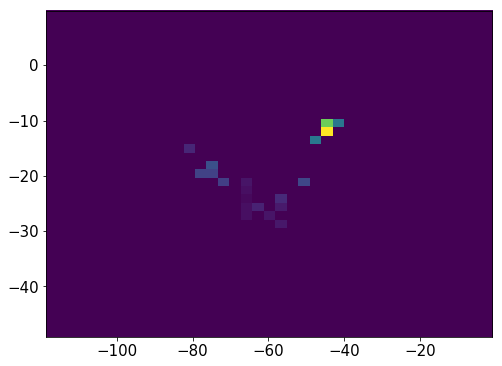

959867    39
959868    39
959869    39
959870    39
959871    39
959873    39
959874    39
959875    39
959876    39
959877    39
959878    39
959879    39
959880    39
959881    39
959882    39
959883    39
959884    39
959885    39
959886    39
959887    39
959888    39
959890    39
959891    39
959892    39
959893    39
959894    39
959895    39
959896    39
959897    39
959898    39
959899    39
959900    39
959901    39
959902    39
959903    39
959904    39
959905    39
959906    39
959907    39
959908    39
959909    39
959910    39
959911    39
959912    39
Name: Nsipm, dtype: uint16


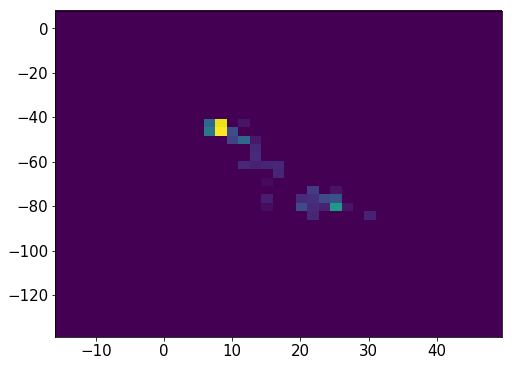

959914    29
959916    29
959917    29
959918    29
959919    29
959920    29
959921    29
959922    29
959923    29
959924    29
959925    29
959926    29
959927    29
Name: Nsipm, dtype: uint16


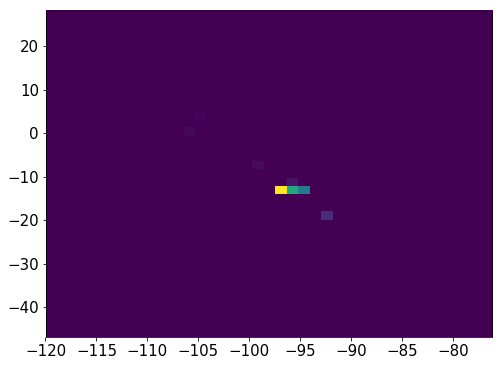

959932    30
959933    30
959934    30
959935    30
959936    30
959937    30
959938    30
959939    30
959940    30
959941    30
959942    30
959943    30
959944    30
959945    30
959946    30
959947    30
959953     5
959954     5
959955     5
959956     5
959957     5
959958     5
959959     5
Name: Nsipm, dtype: uint16


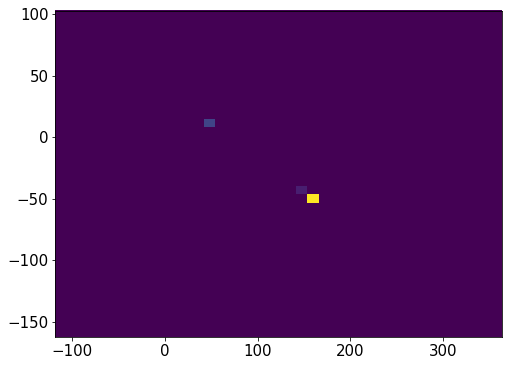

24716    21
24717    21
24718    21
24719    21
24720    21
24721    21
24722    21
24723    21
24724    21
24725    21
24726    21
24727    21
24728    21
Name: Nsipm, dtype: uint16


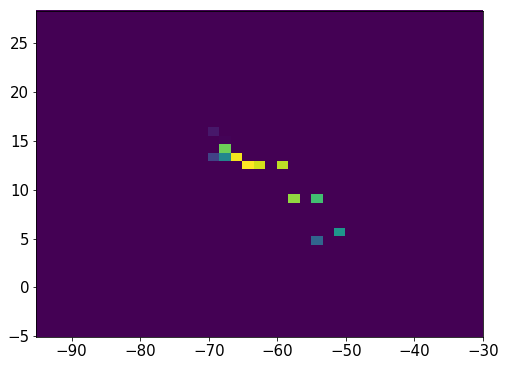

24732    35
24733    35
24734    35
24735    35
24736    35
24737    35
24738    35
24739    35
24740    35
24741    35
24742    35
24743    35
24744    35
24745    35
24746    35
24747    35
24748    35
24749    35
24750    35
24751    35
Name: Nsipm, dtype: uint16


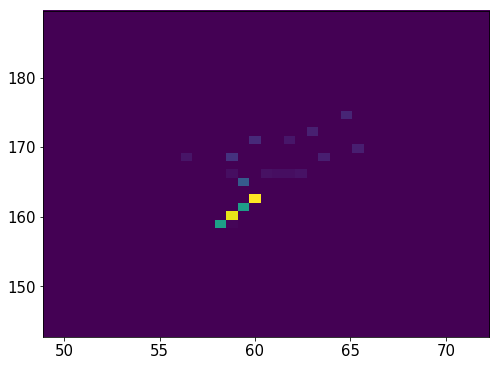

960007    19
960008    19
960009    19
960010    19
960011    19
960012    19
960013    19
960014    19
960015    19
960016    19
960017    19
960018    19
960019    19
960020    19
960021    19
960022    19
Name: Nsipm, dtype: uint16


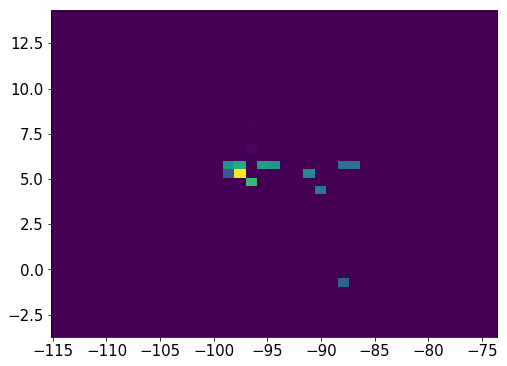

960028    33
960029    33
960030    33
960031    33
960032    33
960033    33
960034    33
960035    33
960036    33
960037    33
960038    33
960039    33
960040    33
960041    33
960045    13
960046    13
960047    13
960048    13
960049    13
960050    13
960051    13
960052    13
Name: Nsipm, dtype: uint16


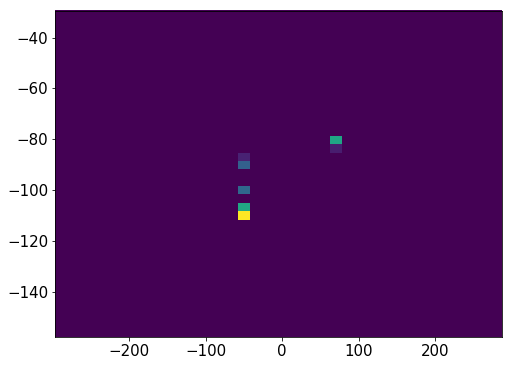

960056    25
960057    25
960058    25
960059    25
960060    25
960061    25
960062    25
960063    25
960064    25
960065    25
960066    25
960067    25
960068    25
960069    25
960070    25
960071    25
960072    25
960073    25
960074    25
960075    25
960080     1
960082     1
960083     1
960084     1
960085     1
Name: Nsipm, dtype: uint16


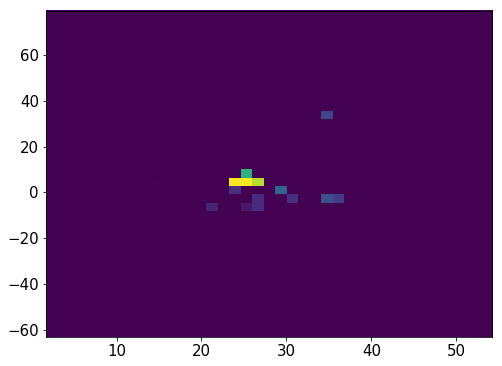

960089    22
960090    22
960091    22
960092    22
960093    22
960094    22
960095    22
960096    22
960097    22
960098    22
960099    22
960100    22
960101    22
960102    22
Name: Nsipm, dtype: uint16


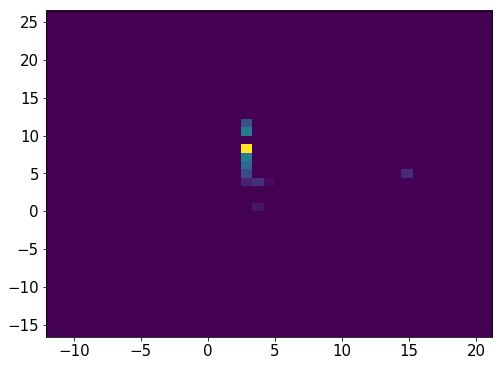

24755    36
24756    36
24757    36
24758    36
24759    36
24760    36
24761    36
24762    36
24763    36
24764    36
24765    36
24766    36
24767    36
24768    36
24769    36
24770    36
24771    36
Name: Nsipm, dtype: uint16


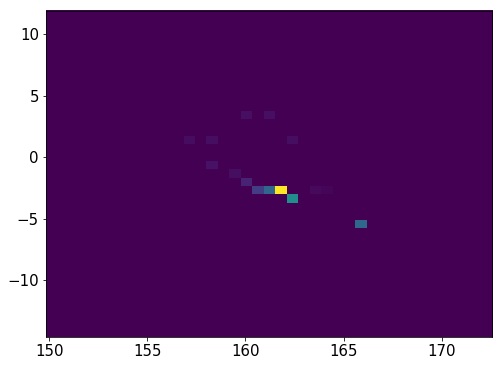

24776    30
24777    30
24778    30
24779    30
24780    30
24781    30
24782    30
24783    30
24784    30
24785    30
24786    30
24787    30
24788    30
24789    30
24790    30
24791    30
24792    30
24793    30
24794    30
24795    30
Name: Nsipm, dtype: uint16


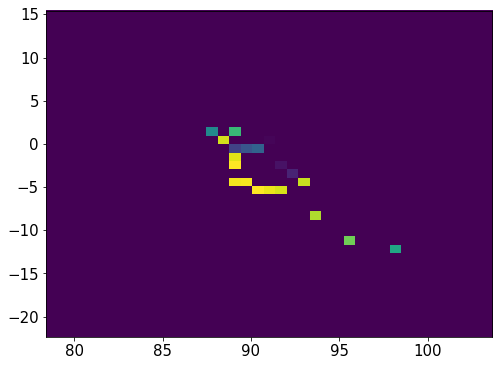

2113804    30
2113805    30
2113806    30
2113807    30
2113808    30
2113809    30
2113810    30
2113811    30
2113813    30
2113814    30
2113815    30
2113816    30
2113817    30
2113818    30
2113819    30
2113820    30
2113821    30
2113822    30
2113823    30
2113824    30
2113825    30
2113826    30
2113827    30
2113828    30
Name: Nsipm, dtype: uint16


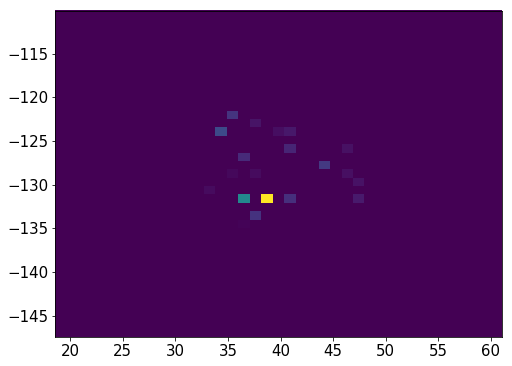

960137    25
960138    25
960139    25
960140    25
960141    25
960142    25
960143    25
960144    25
960145    25
960146    25
960147    25
960148    25
960149    25
960150    25
960151    25
960152    25
960153    25
960154    25
960155    25
960156    25
960157    25
960158    25
960159    25
960160    25
960161    25
960162    25
960164    25
960165    25
960166    25
960167    25
960169    25
960170    25
960171    25
960172    25
960173    25
960174    25
Name: Nsipm, dtype: uint16


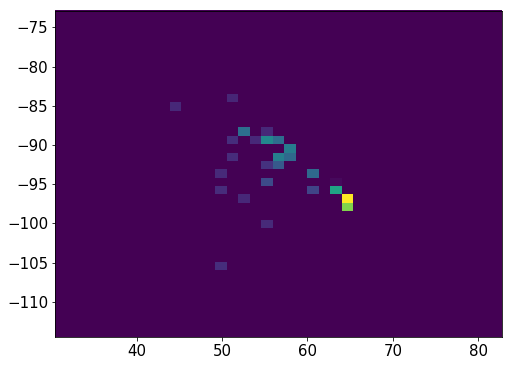

960175    38
960176    38
960177    38
960178    38
960179    38
960180    38
960181    38
960182    38
960183    38
960186     6
960187     6
960188     6
960189     6
960190     6
960191     6
960192     6
960193     6
960194     6
960195     6
Name: Nsipm, dtype: uint16


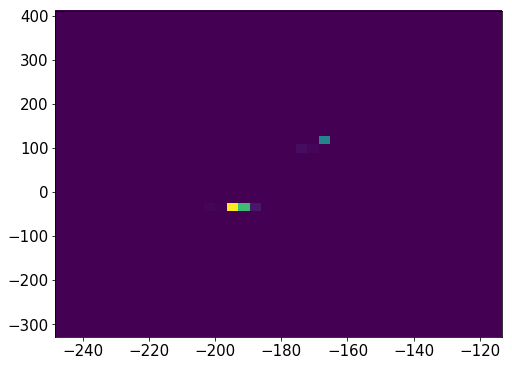

24801    27
24802    27
24803    27
24804    27
24805    27
24806    27
24807    27
24808    27
24809    27
24810    27
24811    27
24812    27
24813    27
24814    27
24815    27
24816    27
24817    27
24818    27
24819    27
24820    27
24821    27
24822    27
24823    27
24824    27
Name: Nsipm, dtype: uint16


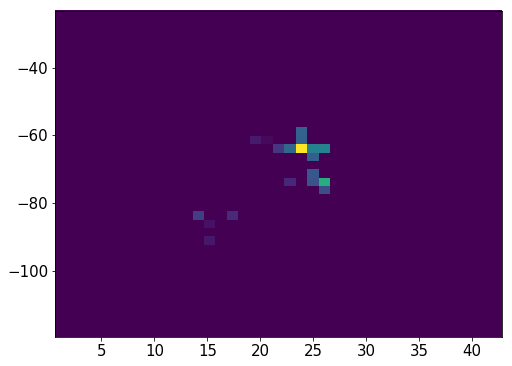

960231    28
960232    28
960233    28
960234    28
960235    28
960236    28
960237    28
960238    28
960239    28
960240    28
960241    28
960242    28
960243    28
960244    28
960245    28
960246    28
960247    28
960248    28
960249    28
960250    28
960251    28
960252    28
960253    28
960254    28
960255    28
960256    28
960257    28
960258    28
960259    28
960260    28
960261    28
960262    28
960263    28
Name: Nsipm, dtype: uint16


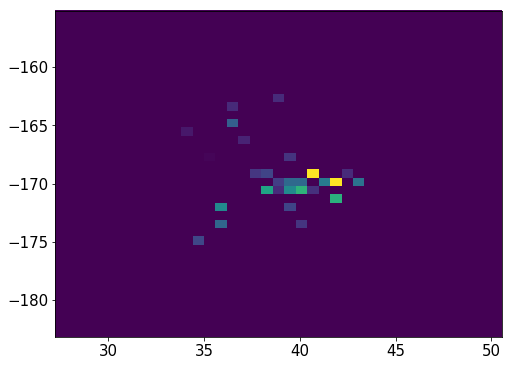

960267    21
960268    21
960269    21
960270    21
960271    21
960272    21
960273    21
960274    21
960275    21
960276    21
960277    21
960278    21
960279    21
960280    21
960281    21
960282    21
960283    21
960284    21
960285    21
960287    21
960291    21
960296    21
960297    21
960298    21
960299    21
960300    21
960301    21
960302    21
Name: Nsipm, dtype: uint16


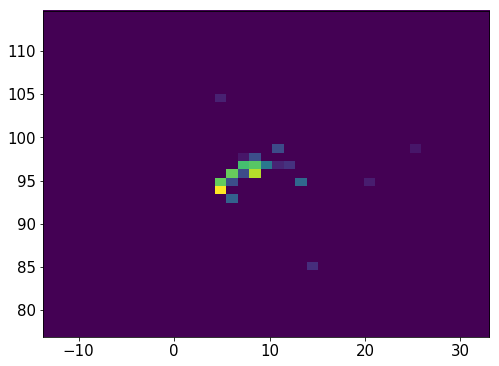

960309    21
960310    21
960311    21
960312    21
960313    21
960314    21
960315    21
960316    21
960317    21
960318    21
960319    21
960320    21
960321    21
960322    21
960323    21
960324    21
960325    21
960326    21
960327    21
960328    21
960329    21
960330    21
960331    21
960335     1
960336     1
960337     1
960338     1
960339     1
Name: Nsipm, dtype: uint16


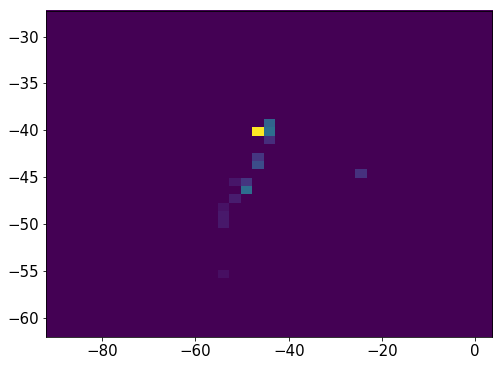

24826    23
24827    23
24828    23
24829    23
24830    23
24831    23
24832    23
24833    23
24834    23
24835    23
24836    23
24837    23
24838    23
24839    23
24840    23
24841    23
24842    23
24843    23
24844    23
24845    23
24846    23
24847    23
24850    23
24851    23
24852    23
24853    23
24855    23
24856    23
24857    23
24858    23
24859    23
24861    23
24863    23
24864    23
24865    23
24866    23
24867    23
24868    23
24869    23
24870    23
24871    23
24872    23
24873    23
24874    23
24875    23
24876    23
Name: Nsipm, dtype: uint16


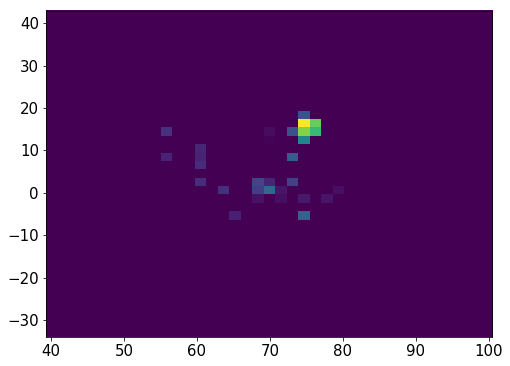

24881    21
24882    21
24883    21
24884    21
24885    21
24886    21
24887    21
24888    21
24889    21
24890    21
24891    21
24892    21
24893    21
24894    21
24895    21
24896    21
24897    21
24898    21
24899    21
Name: Nsipm, dtype: uint16


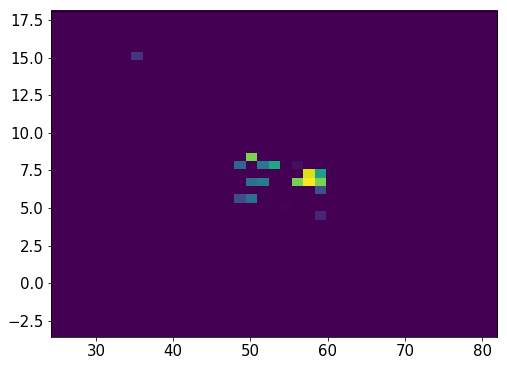

960344    22
960345    22
960346    22
960347    22
960348    22
960349    22
960350    22
960351    22
960352    22
960353    22
960354    22
960355    22
960356    22
960357    22
960358    22
960359    22
960360    22
960361    22
Name: Nsipm, dtype: uint16


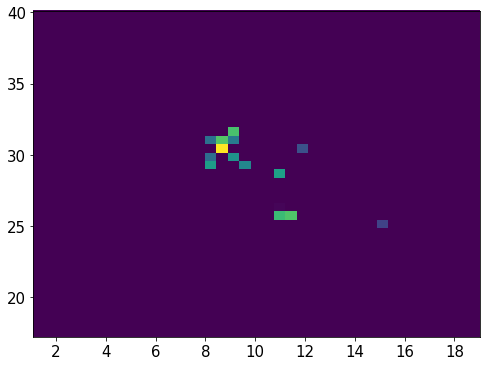

24903    26
24904    26
24905    26
24906    26
24907    26
24908    26
24909    26
24910    26
24911    26
24912    26
24913    26
24914    26
24915    26
24916    26
24917    26
24918    26
24919    26
24920    26
24921    26
24922    26
24923    26
24924    26
24925    26
24926    26
Name: Nsipm, dtype: uint16


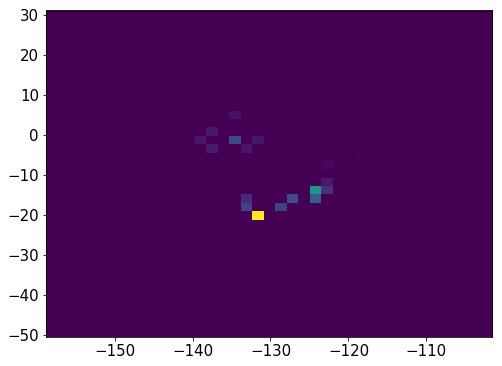

24931    27
24932    27
24933    27
24934    27
24935    27
24936    27
24937    27
24938    27
24939    27
24940    27
24941    27
24942    27
24943    27
24944    27
24945    27
24946    27
24947    27
24948    27
24949    27
24950    27
Name: Nsipm, dtype: uint16


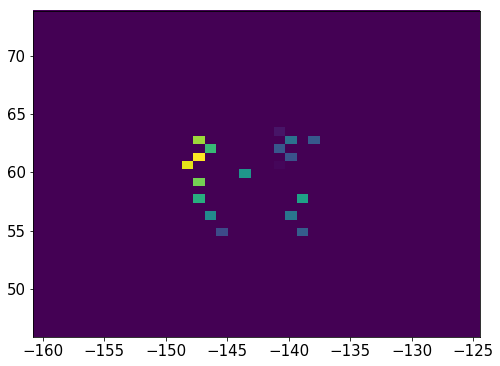

24954    36
24955    36
24956    36
24957    36
24958    36
24959    36
24960    36
24961    36
24962    36
24963    36
24965    36
24966    36
24967    36
24968    36
24969    36
24970    36
24971    36
24972    36
Name: Nsipm, dtype: uint16


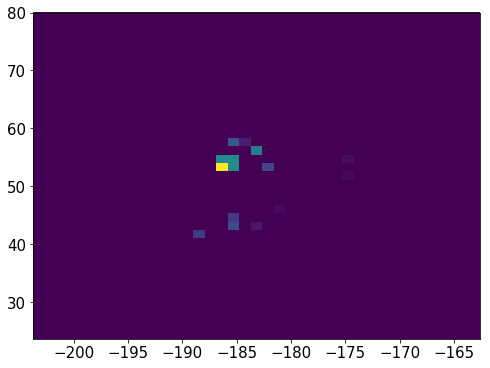

24977    25
24978    25
24979    25
24980    25
24981    25
24982    25
24983    25
24984    25
24985    25
24986    25
24987    25
24988    25
24989    25
24990    25
24991    25
24992    25
24993    25
24994    25
24995    25
24996    25
24997    25
24998    25
24999    25
Name: Nsipm, dtype: uint16


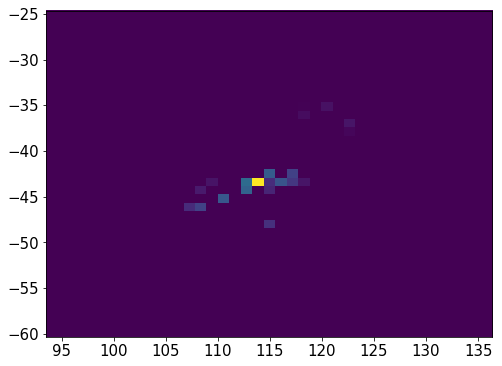

960366    53
960367    53
960368    53
960369    53
960370    53
960371    53
960372    53
960373    53
960374    53
960375    53
960376    53
960377    53
960378    53
960379    53
960380    53
960381    53
960382    53
960383    53
960384    53
960385    53
960386    53
Name: Nsipm, dtype: uint16


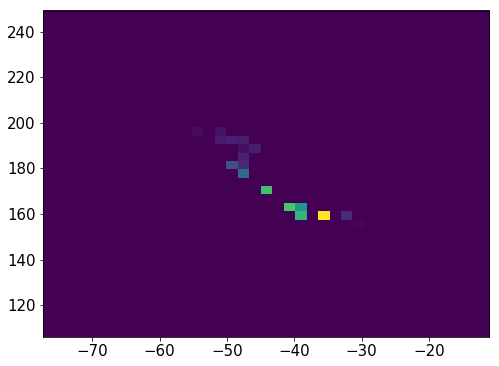

25004    38
25005    38
25006    38
25007    38
25008    38
25009    38
25010    38
25011    38
25012    38
25013    38
25014    38
25015    38
25016    38
25017    38
25018    38
25019    38
25020    38
25021    38
25022    38
25023    38
Name: Nsipm, dtype: uint16


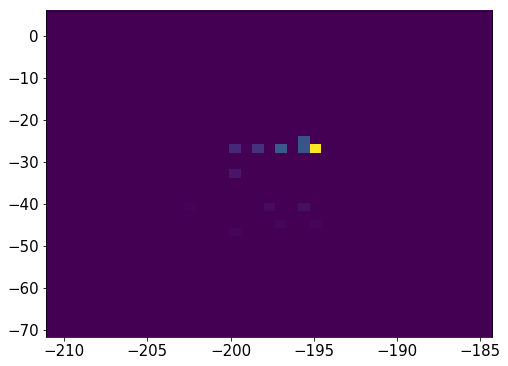

25025    24
25026    24
25027    24
25028    24
25029    24
25030    24
25031    24
25032    24
25033    24
25034    24
25035    24
25036    24
25037    24
25038    24
25039    24
25040    24
25041    24
25042    24
25043    24
25044    24
25045    24
25046    24
25051     1
25052     1
25053     1
25054     1
25055     1
25057     1
Name: Nsipm, dtype: uint16


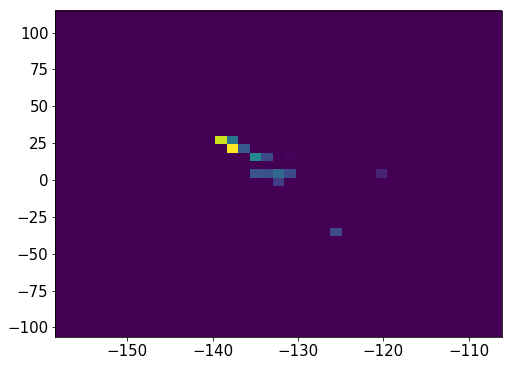

25061    22
25062    22
25063    22
25064    22
25065    22
25066    22
25067    22
25068    22
25069    22
25070    22
25071    22
25072    22
25073    22
25074    22
25075    22
Name: Nsipm, dtype: uint16


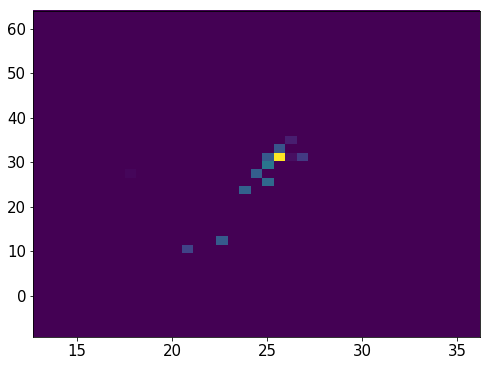

960389    24
960390    24
960391    24
960392    24
960393    24
960394    24
960395    24
960396    24
960397    24
960398    24
960399    24
960400    24
960401    24
960402    24
960403    24
960404    24
960405    24
960406    24
960407    24
960408    24
Name: Nsipm, dtype: uint16


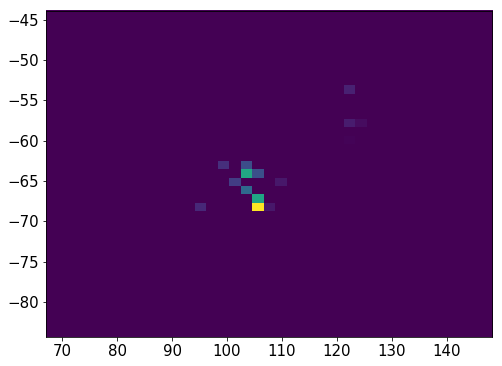

25080    36
25081    36
25082    36
25083    36
25084    36
25085    36
25086    36
25087    36
25088    36
25089    36
25090    36
25091    36
25092    36
25093    36
25094    36
25095    36
25096    36
Name: Nsipm, dtype: uint16


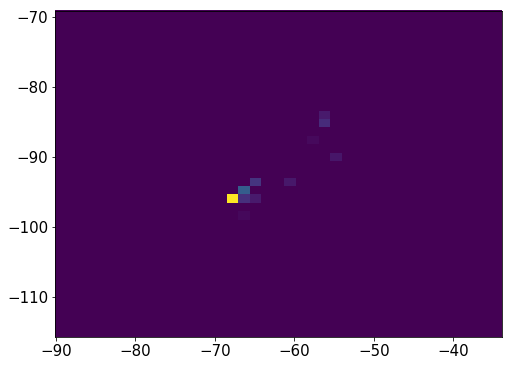

25100    24
25101    24
25102    24
25103    24
25104    24
25105    24
25106    24
25107    24
25108    24
25109    24
25110    24
25111    24
25112    24
25113    24
25114    24
25115    24
25116    24
25117    24
25118    24
25119    24
Name: Nsipm, dtype: uint16


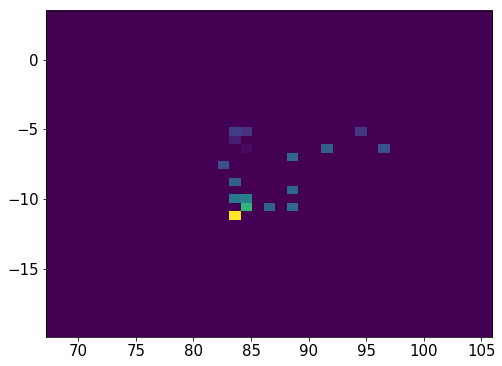

960436    27
960437    27
960438    27
960439    27
960440    27
960441    27
960442    27
960443    27
960444    27
960445    27
960446    27
960447    27
960448    27
960449    27
960450    27
960451    27
960452    27
960453    27
960454    27
960455    27
960456    27
960457    27
960458    27
Name: Nsipm, dtype: uint16


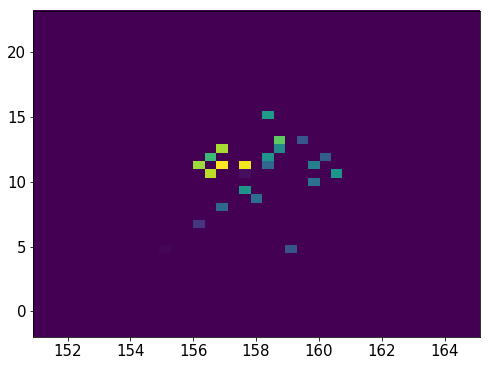

960463    22
960464    22
960465    22
960466    22
960467    22
960468    22
960469    22
960470    22
960471    22
960472    22
960473    22
960474    22
960479    10
960480    10
960481    10
960482    10
960483    10
960484    10
960485    10
960486    10
960487    10
Name: Nsipm, dtype: uint16


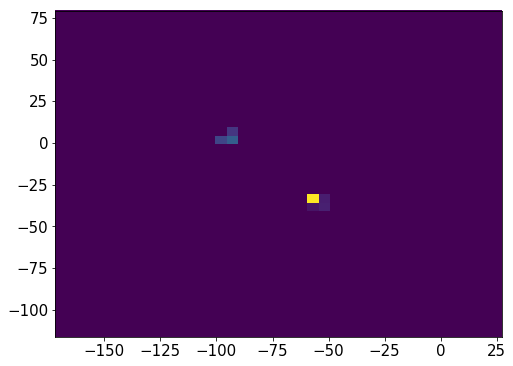

1905127    27
1905128    27
1905129    27
1905130    27
1905131    27
1905132    27
1905133    27
1905134    27
1905135    27
1905136    27
1905137    27
1905138    27
1905139    27
Name: Nsipm, dtype: uint16


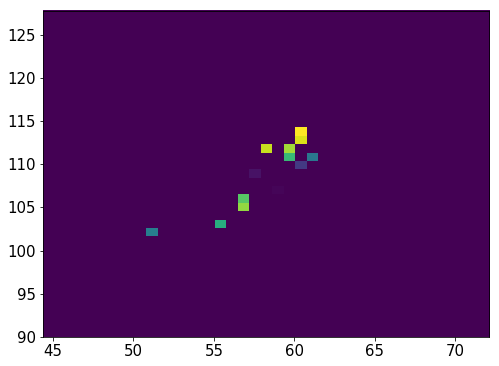

960491    27
960492    27
960493    27
960494    27
960495    27
960496    27
960497    27
960498    27
960499    27
960500    27
960501    27
960502    27
960503    27
960504    27
960505    27
960506    27
960507    27
960508    27
Name: Nsipm, dtype: uint16


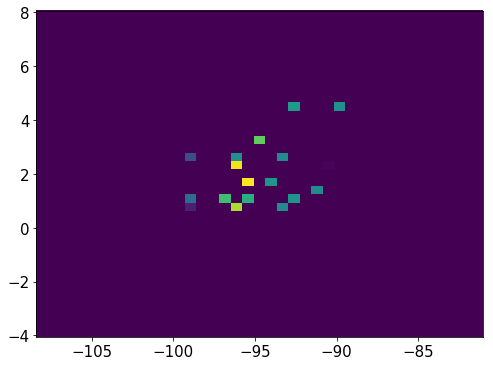

25124    28
25125    28
25126    28
25127    28
25128    28
25129    28
25130    28
25131    28
25132    28
25133    28
25134    28
25135    28
25136    28
25137    28
25138    28
25139    28
25140    28
25141    28
Name: Nsipm, dtype: uint16


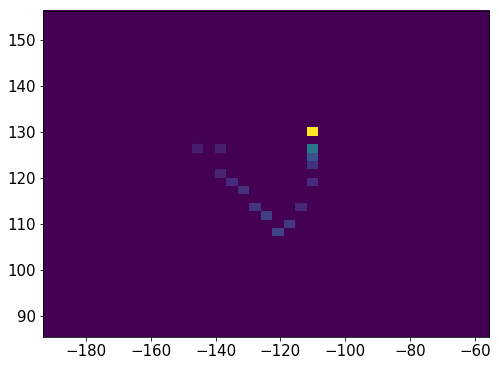

25146    28
25147    28
25148    28
25149    28
25150    28
25151    28
25152    28
25153    28
25154    28
25155    28
Name: Nsipm, dtype: uint16


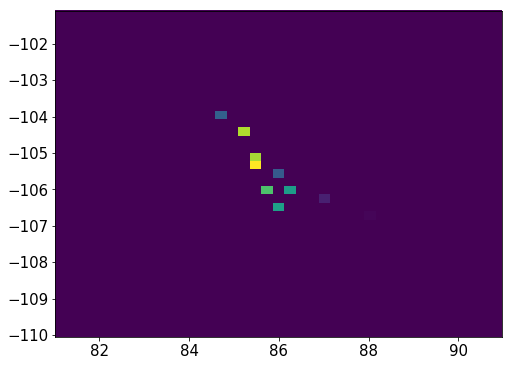

960513    28
960514    28
960515    28
960516    28
960517    28
960518    28
960519    28
960520    28
960521    28
960522    28
960523    28
960524    28
960525    28
960526    28
960527    28
960528    28
960529    28
960530    28
960531    28
960532    28
960533    28
Name: Nsipm, dtype: uint16


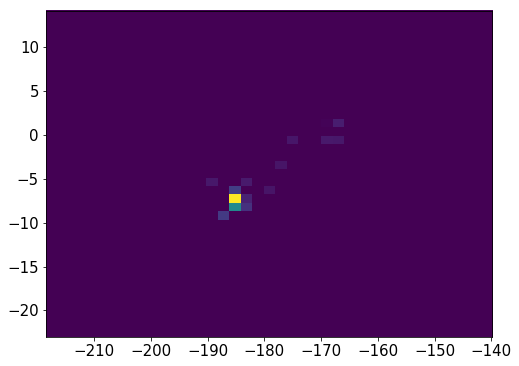

960537    26
960538    26
960539    26
960540    26
960541    26
960542    26
960543    26
960544    26
960545    26
960546    26
960547    26
960548    26
960549    26
960550    26
960551    26
Name: Nsipm, dtype: uint16


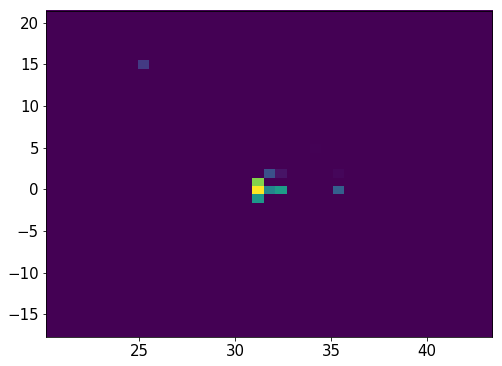

960555    37
960556    37
960557    37
960558    37
960559    37
960560    37
960561    37
960562    37
960563    37
960564    37
960565    37
960566    37
960567    37
960568    37
960569    37
960570    37
960571    37
960572    37
960573    37
960574    37
Name: Nsipm, dtype: uint16


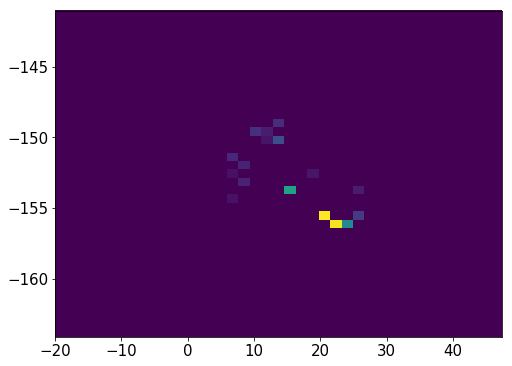

25160    26
25161    26
25162    26
25163    26
25164    26
25165    26
25166    26
25167    26
25168    26
25169    26
25170    26
25171    26
25172    26
25173    26
25174    26
Name: Nsipm, dtype: uint16


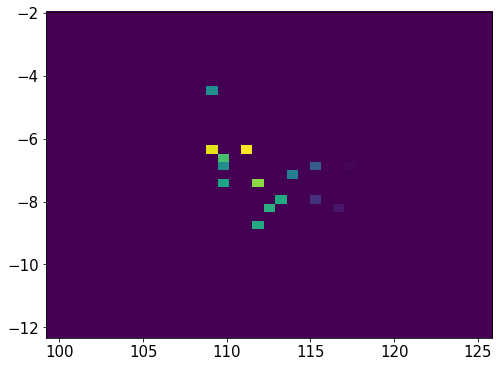

25179    21
25180    21
25181    21
25182    21
25183    21
25184    21
25185    21
25186    21
25187    21
25188    21
25189    21
25190    21
25191    21
25192    21
25193    21
25194    21
25195    21
25196    21
25197    21
25198    21
25199    21
25200    21
25201    21
25202    21
25203    21
25204    21
25205    21
25206    21
25207    21
Name: Nsipm, dtype: uint16


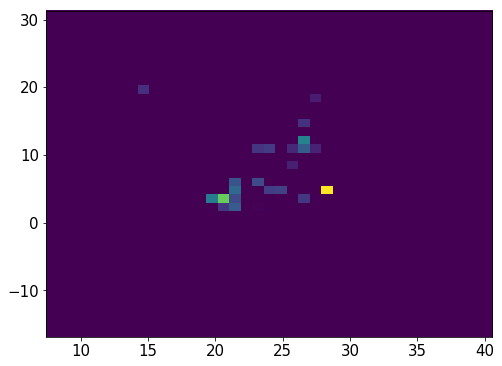

25213    29
25214    29
25215    29
25216    29
25217    29
25218    29
25219    29
25220    29
25221    29
25222    29
25223    29
25224    29
25225    29
25226    29
25227    29
25228    29
Name: Nsipm, dtype: uint16


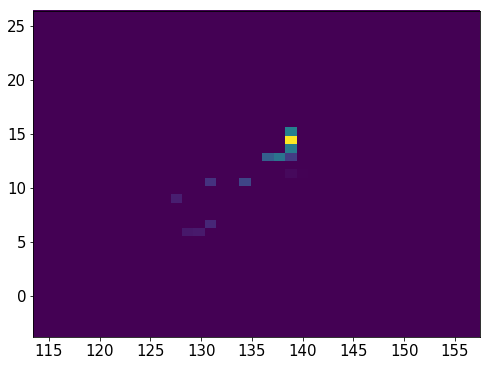

960609    21
960610    21
960611    21
960612    21
960613    21
960614    21
960615    21
960616    21
960617    21
960618    21
Name: Nsipm, dtype: uint16


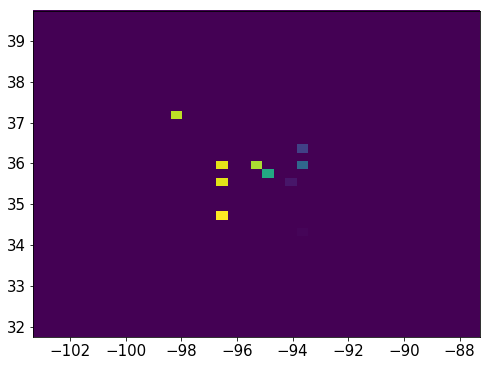

960623    31
960624    31
960625    31
960626    31
960627    31
960628    31
960629    31
960630    31
960631    31
960632    31
960633    31
960634    31
960635    31
960636    31
960637    31
960638    31
960639    31
960640    31
960641    31
960642    31
960643    31
Name: Nsipm, dtype: uint16


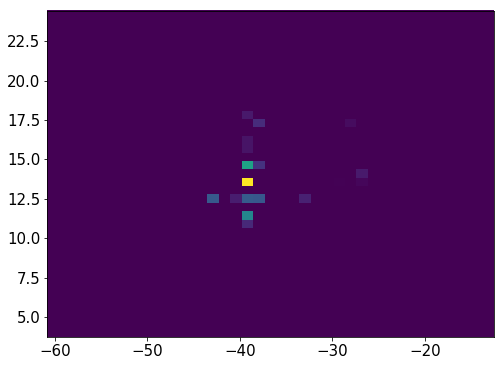

960644    29
960645    29
960646    29
960647    29
960648    29
960649    29
960650    29
960651    29
960652    29
960653    29
960654    29
960655    29
960656    29
960657    29
960658    29
960659    29
960660    29
960661    29
960662    29
960663    29
Name: Nsipm, dtype: uint16


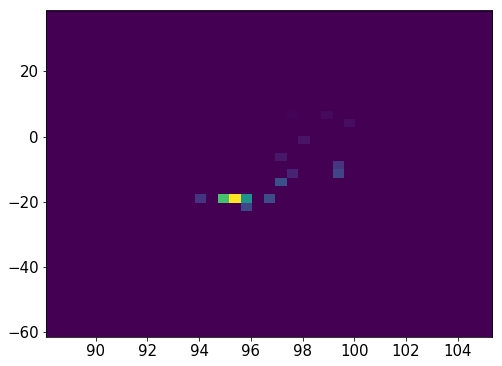

25234    25
25235    25
25236    25
25237    25
25238    25
25239    25
25240    25
25241    25
25242    25
25243    25
25244    25
25245    25
25246    25
25247    25
25248    25
25249    25
25250    25
25251    25
25252    25
25253    25
Name: Nsipm, dtype: uint16


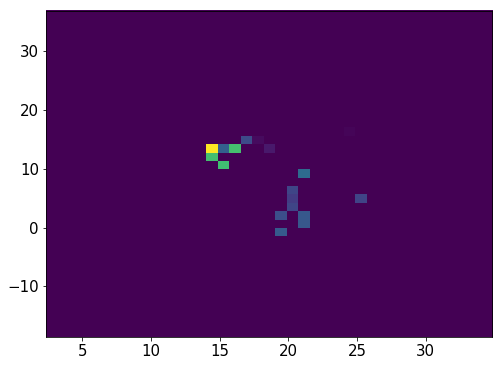

960668    28
960669    28
960670    28
960671    28
960672    28
960673    28
960674    28
960675    28
960676    28
960677    28
960678    28
960679    28
960680    28
960681    28
960682    28
960683    28
Name: Nsipm, dtype: uint16


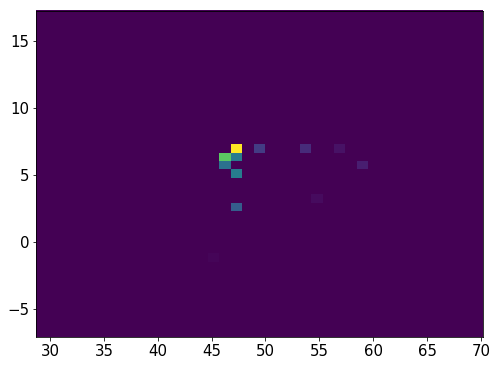

960689    25
960690    25
960691    25
960692    25
960693    25
960694    25
960695    25
960696    25
960697    25
960698    25
960699    25
960700    25
960701    25
960702    25
960703    25
960704    25
960705    25
960706    25
960707    25
960708    25
960709    25
960721     1
960722     1
960723     1
960724     1
960725     1
Name: Nsipm, dtype: uint16


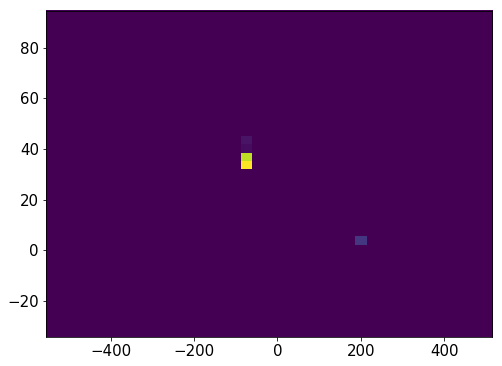

25258    19
25259    19
25260    19
25261    19
25262    19
25263    19
25264    19
25265    19
25266    19
25267    19
25268    19
25269    19
25270    19
25271    19
25272    19
25273    19
25274    19
25277    19
25278    19
25279    19
25280    19
25281    19
Name: Nsipm, dtype: uint16


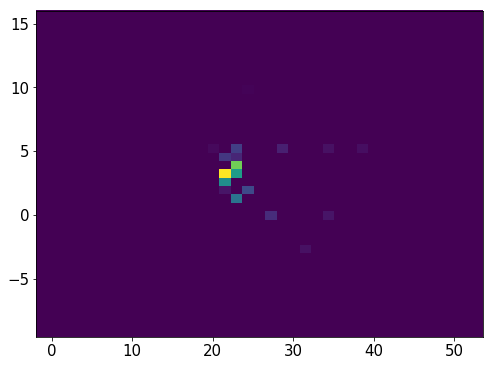

960757    19
960758    19
960759    19
960760    19
960761    19
960762    19
960763    19
960764    19
960765    19
960766    19
960767    19
960768    19
960769    19
960770    19
960771    19
960772    19
960773    19
960774    19
960775    19
960776    19
960777    19
Name: Nsipm, dtype: uint16


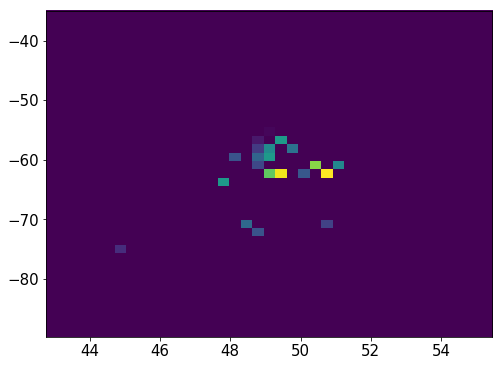

25288    24
25289    24
25290    24
25291    24
25292    24
25293    24
25294    24
25295    24
25296    24
25297    24
25298    24
25299    24
25300    24
25301    24
25302    24
25303    24
25304    24
25305    24
25306    24
25307    24
25308    24
25309    24
25312    24
25314    24
25315    24
25316    24
25317    24
25318    24
25319    24
Name: Nsipm, dtype: uint16


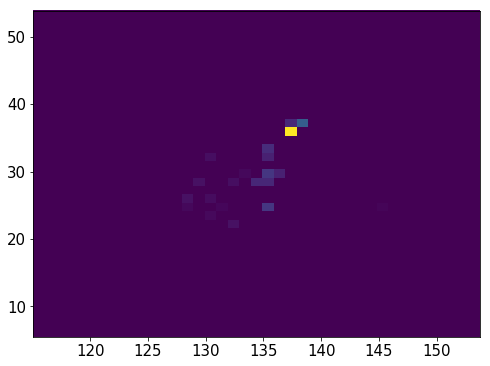

25325    22
25326    22
25327    22
25328    22
25329    22
25330    22
25331    22
25332    22
25333    22
25334    22
25335    22
25336    22
25337    22
25338    22
25339    22
25340    22
25341    22
25342    22
Name: Nsipm, dtype: uint16


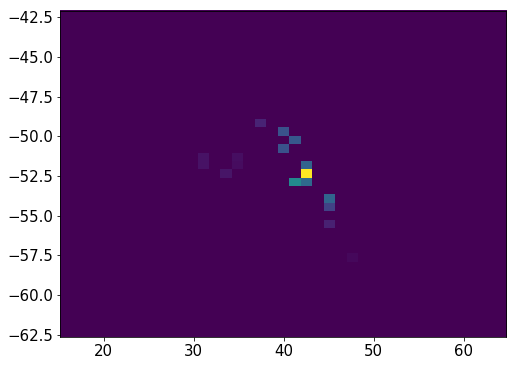

960802    24
960803    24
960804    24
960805    24
960806    24
960807    24
960808    24
960809    24
960810    24
960811    24
960812    24
960813    24
960814    24
960815    24
960816    24
960817    24
960818    24
960819    24
960820    24
960821    24
Name: Nsipm, dtype: uint16


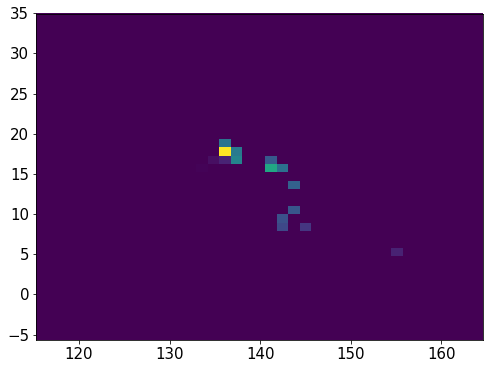

25344    23
25345    23
25346    23
25347    23
25348    23
25349    23
25350    23
25351    23
25352    23
25353    23
25354    23
25355    23
25356    23
25357    23
25358    23
25359    23
25360    23
25361    23
Name: Nsipm, dtype: uint16


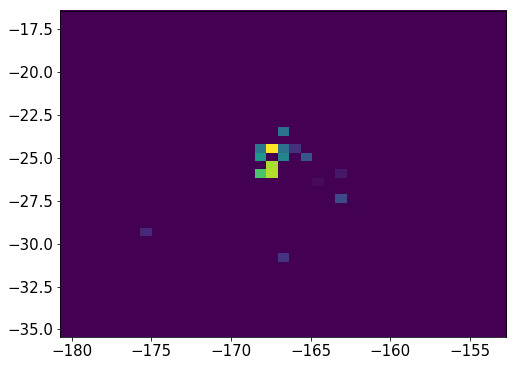

25368    23
25369    23
25370    23
25371    23
25372    23
25373    23
25374    23
25375    23
25376    23
25377    23
25378    23
25379    23
Name: Nsipm, dtype: uint16


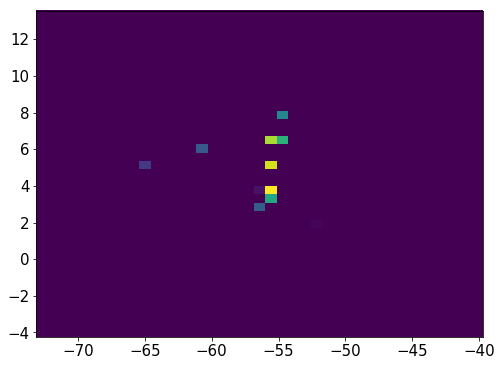

960860    24
960861    24
960862    24
960863    24
960864    24
960865    24
960866    24
960867    24
960868    24
960869    24
960870    24
960871    24
960872    24
960873    24
960874    24
960875    24
960876    24
960877    24
960878    24
960879    24
960880    24
960881    24
Name: Nsipm, dtype: uint16


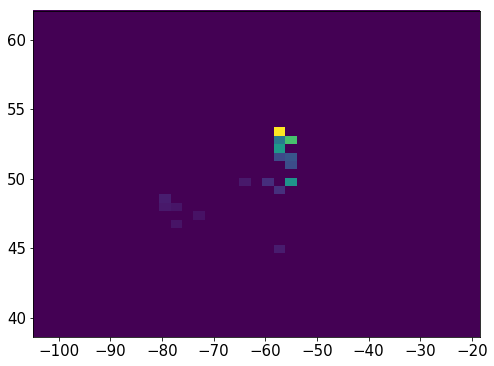

25384    26
25385    26
25386    26
25387    26
25388    26
25389    26
25390    26
25391    26
25392    26
25393    26
25394    26
25395    26
25396    26
25397    26
25398    26
25399    26
25400    26
25401    26
25402    26
25403    26
25404    26
25405    26
Name: Nsipm, dtype: uint16


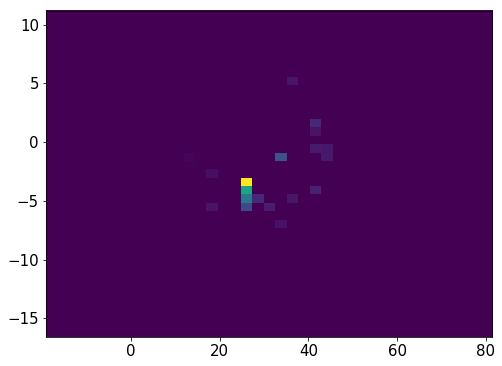

937839    28
937840    28
937841    28
937842    28
937843    28
937844    28
937845    28
937846    28
937847    28
937848    28
937849    28
937850    28
937854     2
937855     2
937861    29
937862    29
937863    29
937864    29
937865    29
937866    29
937867    29
937868    29
937869    29
937870    29
937871    29
937872    29
937873    29
937874    29
937875    29
937876    29
          ..
937885    29
937886    29
937887    29
937888    29
937889    29
937890    29
937891    29
937892    29
937893    29
937894    29
937895    29
937896    29
937897    29
937898    29
937899    29
937900    29
937906    29
937907    29
937908    29
937909    29
937910    29
937912    29
937913    29
937914    29
937921    29
937922    29
937923    29
937924    29
937925    29
937926    29
Name: Nsipm, dtype: uint16


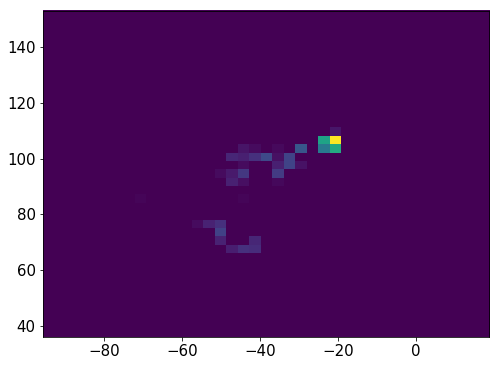

960902    22
960903    22
960904    22
960905    22
960906    22
960907    22
960908    22
960909    22
960910    22
960911    22
960912    22
960913    22
960914    22
960915    22
960916    22
960917    22
960918    22
960919    22
Name: Nsipm, dtype: uint16


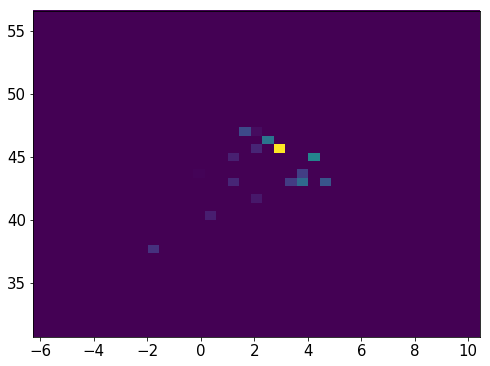

960925    40
960926    40
960927    40
960928    40
960929    40
960930    40
960931    40
960932    40
Name: Nsipm, dtype: uint16


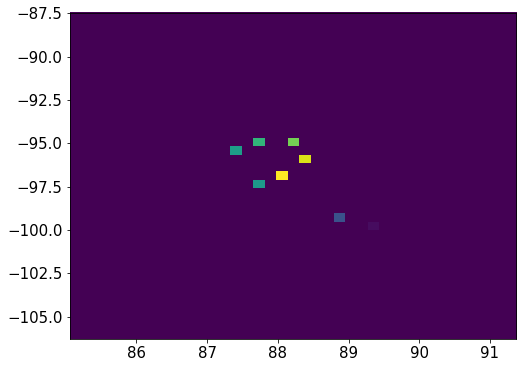

25410    37
25411    37
25412    37
25413    37
25414    37
25415    37
25416    37
25417    37
25418    37
25419    37
25420    37
25421    37
25422    37
25423    37
25424    37
25425    37
25426    37
25427    37
25428    37
25429    37
25430    37
25431    37
25432    37
25433    37
25434    37
25435    37
Name: Nsipm, dtype: uint16


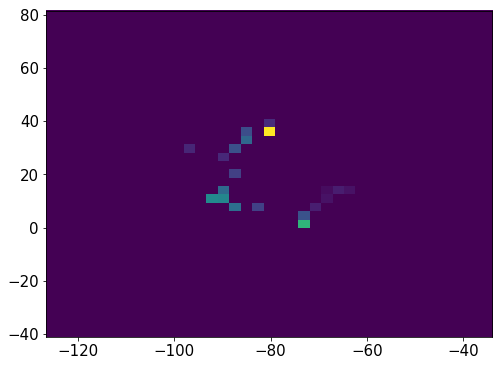

960936    26
960937    26
960938    26
960939    26
960940    26
960941    26
960942    26
960943    26
960944    26
960945    26
960946    26
960947    26
960948    26
960949    26
960950    26
Name: Nsipm, dtype: uint16


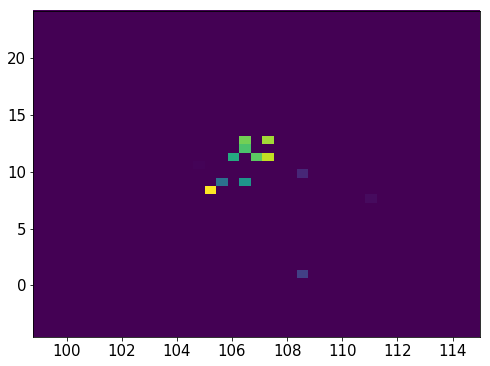

960955    24
960956    24
960957    24
960958    24
960959    24
960960    24
960961    24
960962    24
960963    24
960964    24
960965    24
960966    24
Name: Nsipm, dtype: uint16


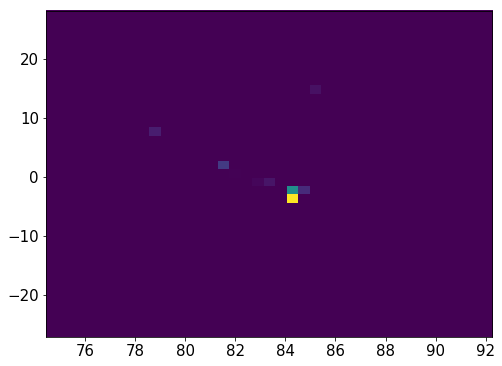

25438    19
25439    19
25440    19
25441    19
25442    19
25443    19
25444    19
25445    19
25446    19
25447    19
25448    19
25449    19
25450    19
25451    19
25452    19
25453    19
25454    19
25455    19
25456    19
25457    19
25458    19
Name: Nsipm, dtype: uint16


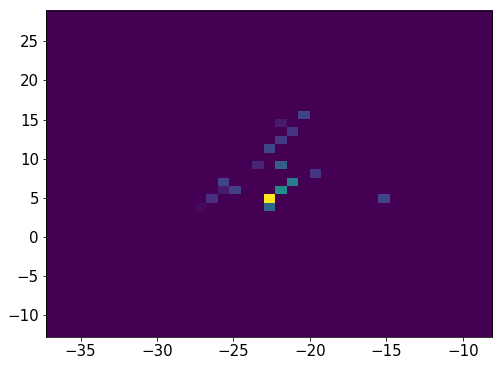

25463    22
25464    22
25465    22
25466    22
25467    22
25468    22
25469    22
25470    22
25471    22
25472    22
25473    22
25474    22
25475    22
25476    22
Name: Nsipm, dtype: uint16


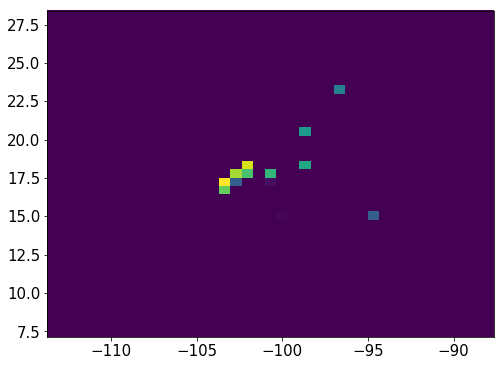

25481    24
25482    24
25483    24
25484    24
25485    24
25486    24
25487    24
25488    24
25489    24
25490    24
25491    24
25492    24
25493    24
25494    24
25495    24
25496    24
25497    24
25499    24
Name: Nsipm, dtype: uint16


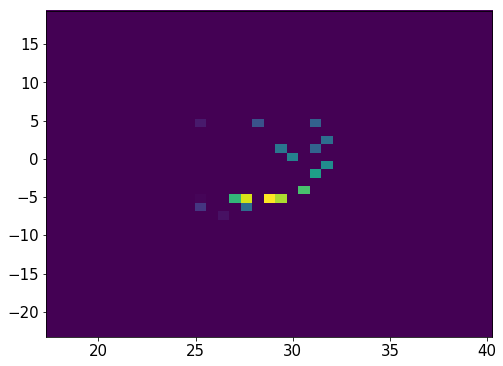

25502    27
25503    27
25504    27
25505    27
25506    27
25507    27
25508    27
25509    27
25510    27
25511    27
25512    27
25513    27
25514    27
25515    27
25516    27
25517    27
25518    27
25519    27
25520    27
25521    27
Name: Nsipm, dtype: uint16


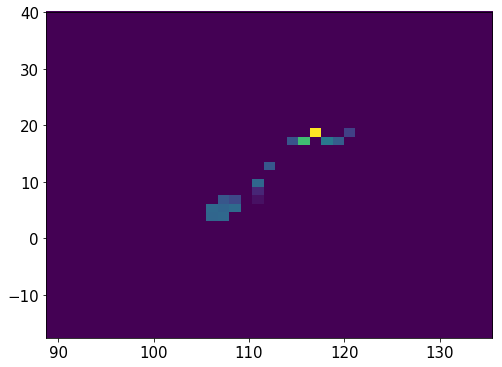

25526    40
25527    40
25528    40
25529    40
25530    40
25531    40
25532    40
25533    40
25534    40
25535    40
25536    40
25537    40
25538    40
25539    40
25540    40
25541    40
25542    40
25543    40
25544    40
25545    40
25546    40
Name: Nsipm, dtype: uint16


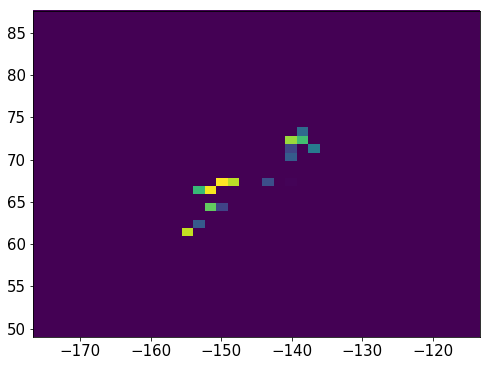

25550    45
25551    45
25552    45
25553    45
25554    45
25555    45
25556    45
25557    45
25558    45
25559    45
25560    45
25561    45
25562    45
Name: Nsipm, dtype: uint16


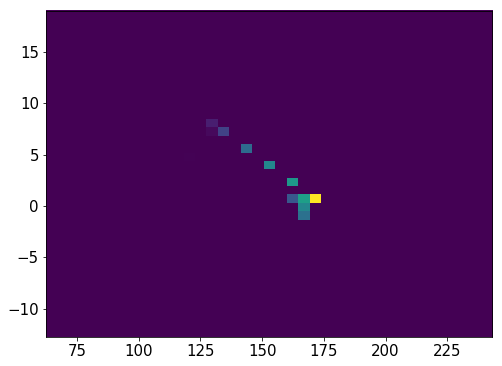

962118    17
962119    17
962120    17
962121    17
962126    17
962127    17
962128    17
962129    17
962130    17
962131    17
962132    17
962133    17
962134    17
962135    17
962136    17
962137    17
962138    17
962139    17
962140    17
962141    17
962142    17
Name: Nsipm, dtype: uint16


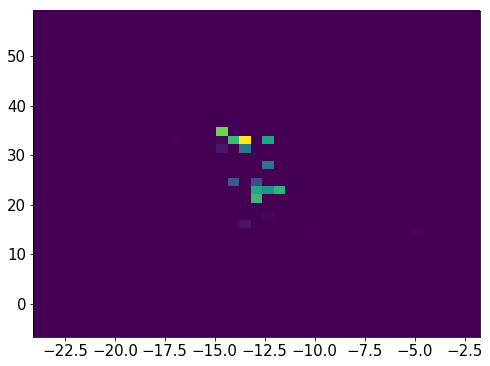

962143    26
962144    26
962145    26
962146    26
962147    26
962148    26
962149    26
962150    26
962151    26
962152    26
962155     3
962156     3
962157     3
962158     3
962165     1
962166     1
962167     1
962168     1
Name: Nsipm, dtype: uint16


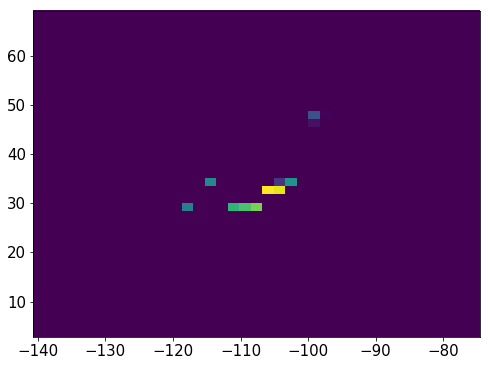

25568    45
25569    45
25570    45
25571    45
25572    45
25573    45
25574    45
25575    45
25576    45
25577    45
25578    45
25579    45
25586     3
25587     3
25588     3
25589     3
Name: Nsipm, dtype: uint16


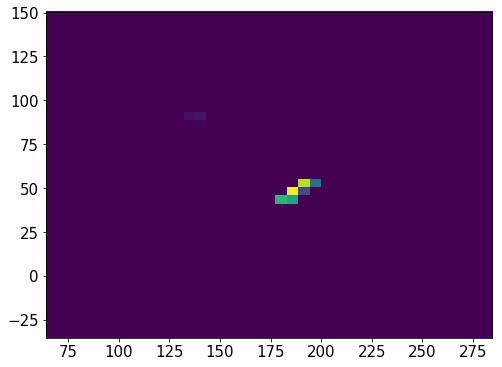

962173    35
962174    35
962175    35
962176    35
962177    35
962178    35
962179    35
962180    35
962181    35
962182    35
962183    35
962184    35
962185    35
962186    35
962187    35
962188    35
962189    35
962190    35
Name: Nsipm, dtype: uint16


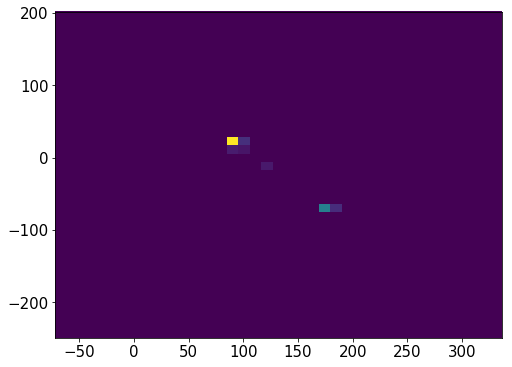

962202    20
962203    20
962204    20
962205    20
962206    20
962207    20
962208    20
962209    20
962210    20
962211    20
962212    20
962213    20
962214    20
962215    20
962216    20
962217    20
962218    20
962219    20
Name: Nsipm, dtype: uint16


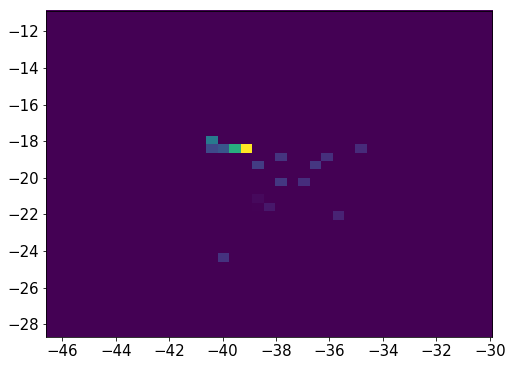

962220    46
962221    46
962222    46
962223    46
962224    46
962225    46
962226    46
962227    46
962228    46
962229    46
962230    46
962231    46
962232    46
962233    46
962234    46
962235    46
962236    46
962237    46
962238    46
962239    46
962240    46
962241    46
Name: Nsipm, dtype: uint16


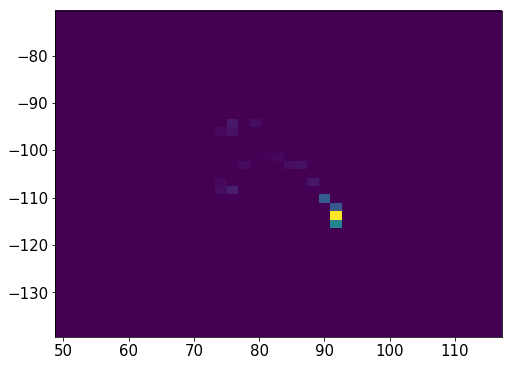

25594    23
25595    23
25596    23
25597    23
25598    23
25599    23
25600    23
25601    23
25602    23
25603    23
25604    23
25605    23
25606    23
25607    23
25608    23
25609    23
25610    23
25611    23
25612    23
Name: Nsipm, dtype: uint16


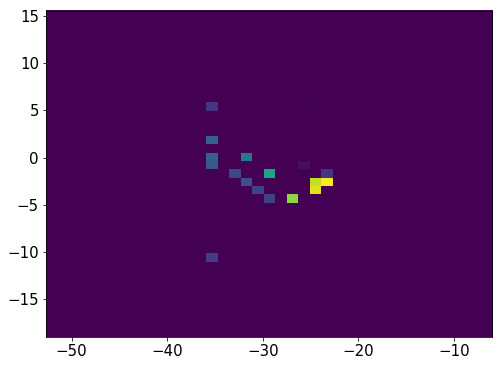

962245    25
962246    25
962247    25
962248    25
962249    25
962250    25
962251    25
962252    25
962253    25
962254    25
962255    25
962256    25
962257    25
962258    25
962259    25
962260    25
962261    25
962262    25
962263    25
962264    25
962265    25
962269    25
962270    25
962271    25
962272    25
962273    25
962275    25
962276    25
962277    25
962278    25
962286    25
962287    25
962288    25
962289    25
962291    25
Name: Nsipm, dtype: uint16


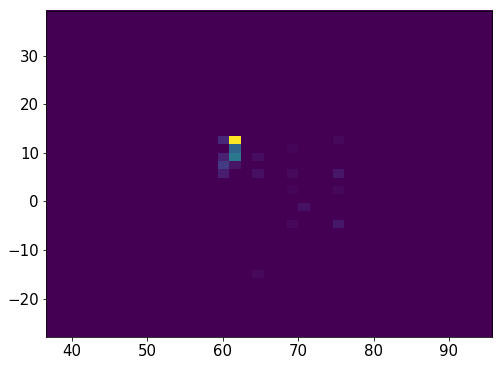

962300    31
962301    31
962302    31
962303    31
962304    31
962305    31
962306    31
962307    31
962308    31
962309    31
962310    31
Name: Nsipm, dtype: uint16


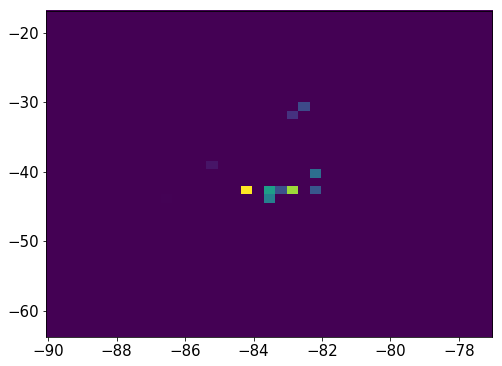

25618    23
25619    23
25620    23
25621    23
25622    23
25623    23
25624    23
25625    23
25626    23
25627    23
25628    23
25629    23
25630    23
25631    23
25632    23
25633    23
25634    23
25635    23
25636    23
25637    23
25638    23
25639    23
25640    23
25641    23
25642    23
Name: Nsipm, dtype: uint16


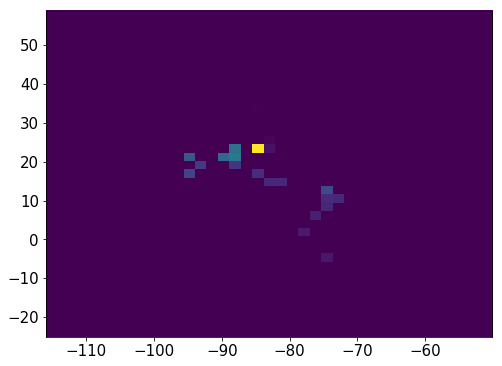

25647    19
25648    19
25649    19
25650    19
25651    19
25652    19
25653    19
25654    19
25659    18
25660    18
25661    18
25662    18
25663    18
25664    18
25665    18
25666    18
25667    18
25668    18
25669    18
25670    18
25671    18
25672    18
25673    18
25674    18
25675    18
25676    18
25677    18
25678    18
25679    18
25680    18
Name: Nsipm, dtype: uint16


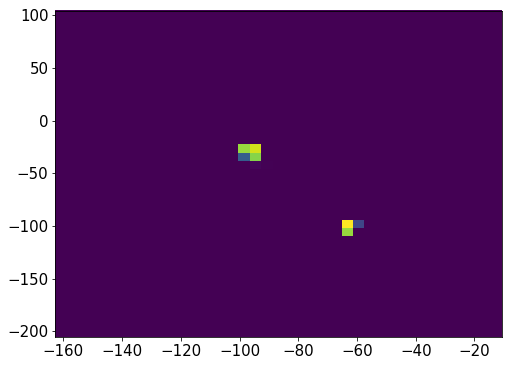

25685    24
25686    24
25687    24
25688    24
25689    24
25690    24
25691    24
25692    24
25693    24
25694    24
25695    24
25696    24
25697    24
25698    24
25699    24
25700    24
25701    24
25702    24
25703    24
25704    24
25705    24
Name: Nsipm, dtype: uint16


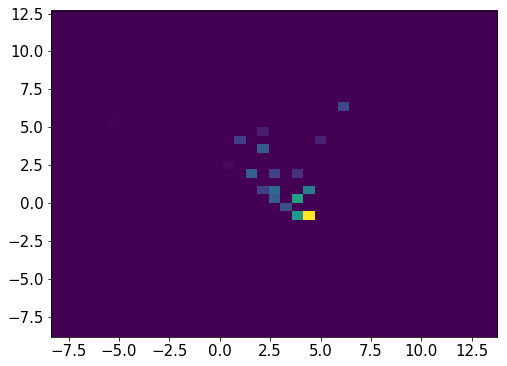

25710    26
25711    26
25712    26
25713    26
25714    26
25715    26
25716    26
25717    26
25718    26
25719    26
25720    26
25721    26
25722    26
Name: Nsipm, dtype: uint16


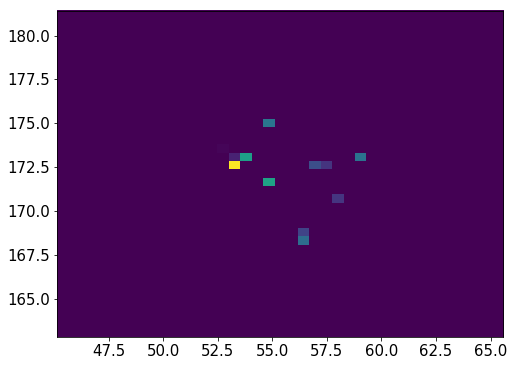

962336    34
962337    34
962338    34
962339    34
962340    34
962341    34
962342    34
962343    34
962344    34
962345    34
962346    34
962347    34
962348    34
962349    34
962350    34
962351    34
962352    34
962353    34
962354    34
962355    34
962356    34
962357    34
962358    34
962359    34
962360    34
Name: Nsipm, dtype: uint16


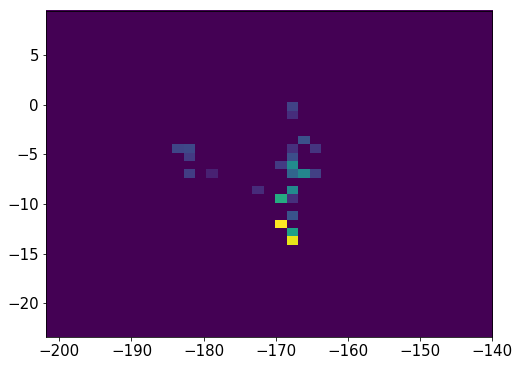

25727    21
25728    21
25729    21
25730    21
25731    21
25732    21
25733    21
25734    21
25735    21
25736    21
25737    21
25738    21
25739    21
Name: Nsipm, dtype: uint16


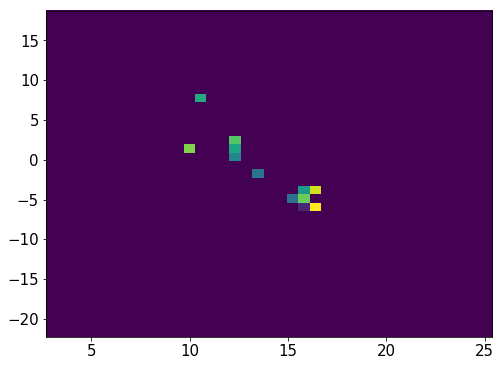

25744    36
25745    36
25746    36
25747    36
25748    36
25749    36
25750    36
25751    36
25752    36
25753    36
25754    36
25755    36
25756    36
25757    36
25758    36
25759    36
25760    36
25761    36
25762    36
25763    36
25764    36
25765    36
25766    36
25767    36
Name: Nsipm, dtype: uint16


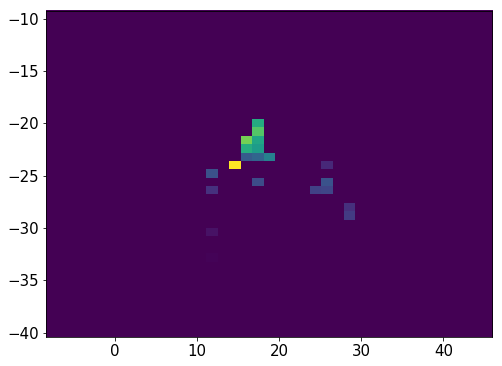

962365    27
962366    27
962367    27
962368    27
962369    27
962370    27
962371    27
962372    27
962373    27
962374    27
962375    27
962376    27
962377    27
962381    27
962382    27
962383    27
Name: Nsipm, dtype: uint16


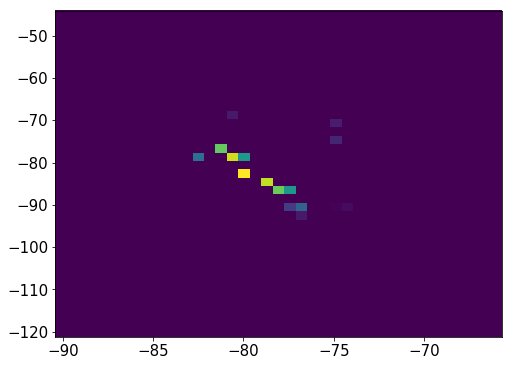

962389    28
962390    28
962391    28
962392    28
962393    28
962394    28
962395    28
962396    28
962397    28
962398    28
962399    28
962400    28
962401    28
Name: Nsipm, dtype: uint16


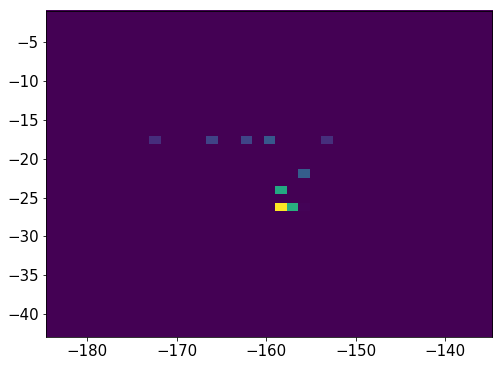

962405    19
962406    19
962407    19
962408    19
962409    19
962410    19
962411    19
962412    19
962413    19
962414    19
962415    19
962416    19
962417    19
962418    19
962419    19
962420    19
962421    19
962422    19
962423    19
962424    19
962425    19
962426    19
962431     1
962432     1
962433     1
962434     1
962435     1
Name: Nsipm, dtype: uint16


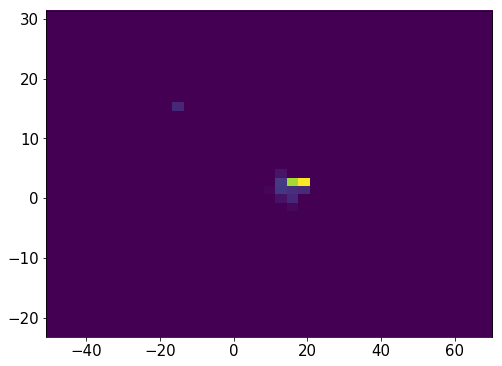

962441    27
962442    27
962443    27
962444    27
962445    27
962446    27
962447    27
962448    27
962449    27
962450    27
962451    27
962453    27
962454    27
962455    27
962456    27
962457    27
962458    27
962459    27
962460    27
962461    27
962462    27
962463    27
962464    27
962465    27
962466    27
962467    27
962468    27
Name: Nsipm, dtype: uint16


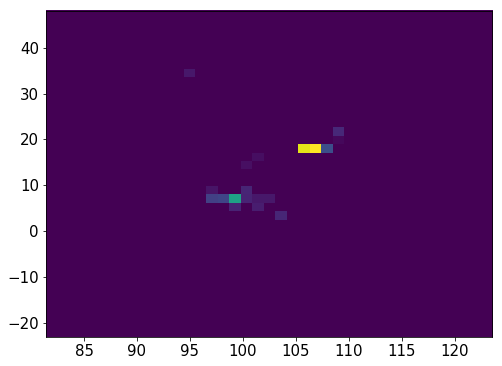

25772    36
25773    36
25774    36
25775    36
25776    36
25777    36
25778    36
25779    36
25780    36
25781    36
25782    36
25783    36
25784    36
25785    36
Name: Nsipm, dtype: uint16


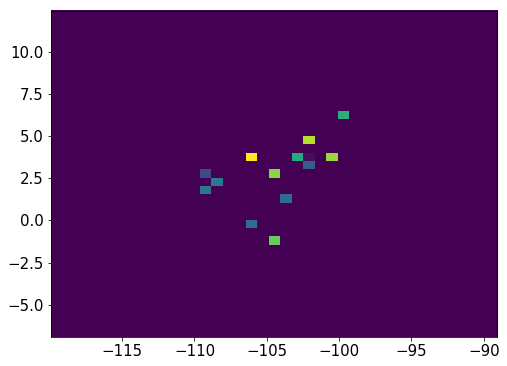

962473    37
962474    37
962475    37
962476    37
962477    37
962478    37
962479    37
962480    37
962481    37
962482    37
962483    37
962484    37
962485    37
962486    37
Name: Nsipm, dtype: uint16


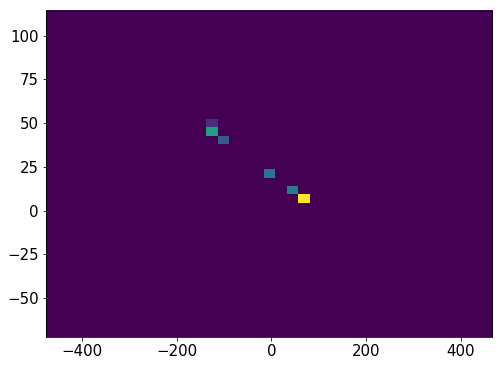

25792    26
25793    26
25794    26
25795    26
25796    26
25797    26
25798    26
25799    26
25800    26
25801    26
25802    26
25803    26
25804    26
25805    26
25806    26
25807    26
25808    26
25809    26
25810    26
25811    26
25812    26
25813    26
25814    26
25815    26
25816    26
25817    26
25818    26
25819    26
25820    26
25824     3
25825     3
25826     3
25827     3
25828     3
Name: Nsipm, dtype: uint16


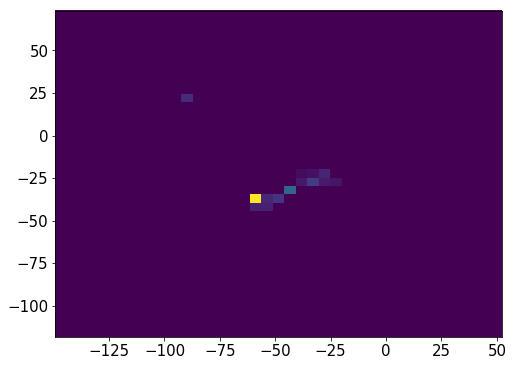

25832    26
25833    26
25834    26
25835    26
25836    26
25837    26
25838    26
25839    26
25840    26
25841    26
25842    26
25843    26
25844    26
Name: Nsipm, dtype: uint16


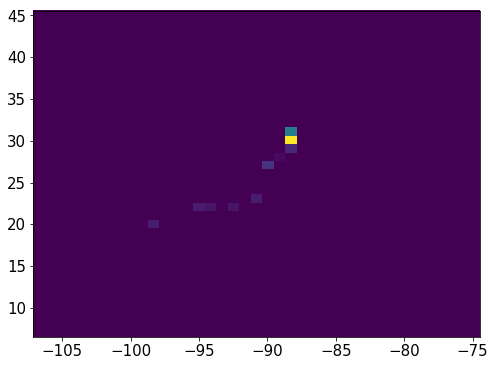

25849    25
25850    25
25851    25
25852    25
25853    25
25854    25
25855    25
25856    25
25857    25
25858    25
25859    25
25860    25
25861    25
25862    25
25863    25
25864    25
25865    25
25866    25
25867    25
25868    25
25869    25
25870    25
25871    25
25872    25
25873    25
25874    25
25875    25
25876    25
25877    25
Name: Nsipm, dtype: uint16


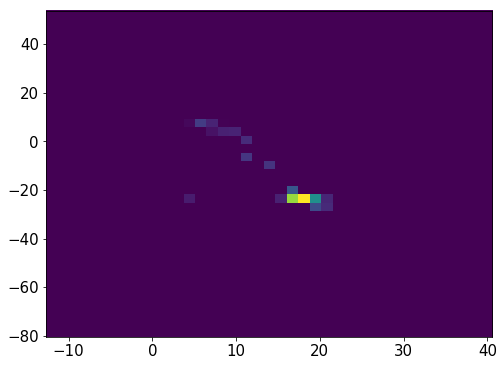

25881    26
25882    26
25883    26
25884    26
25885    26
25886    26
25887    26
25888    26
25889    26
25890    26
25891    26
25892    26
25893    26
25894    26
25895    26
25896    26
25897    26
25898    26
Name: Nsipm, dtype: uint16


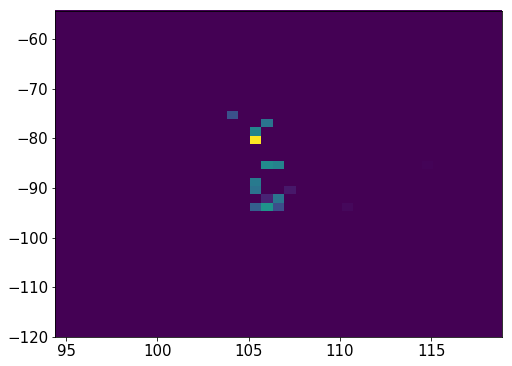

25903    33
25904    33
25905    33
25906    33
25910    33
25911    33
25912    33
25913    33
25914    33
25915    33
25916    33
25917    33
25918    33
25919    33
25920    33
25921    33
25922    33
25923    33
Name: Nsipm, dtype: uint16


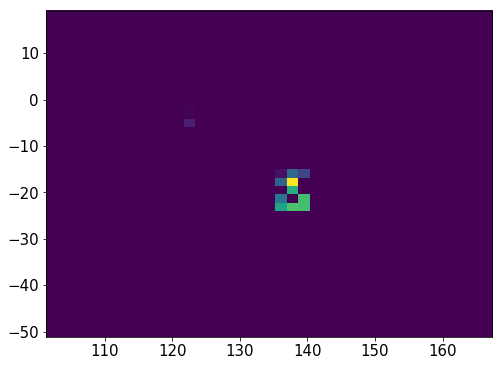

962564    26
962565    26
962566    26
962567    26
962568    26
962569    26
962570    26
962571    26
962572    26
962573    26
962574    26
962575    26
962576    26
962577    26
962578    26
962579    26
962580    26
962581    26
962582    26
962583    26
962588    13
962589    13
962590    13
962591    13
962592    13
962593    13
962594    13
962595    13
962596    13
962597    13
962598    13
962599    13
962600    13
Name: Nsipm, dtype: uint16


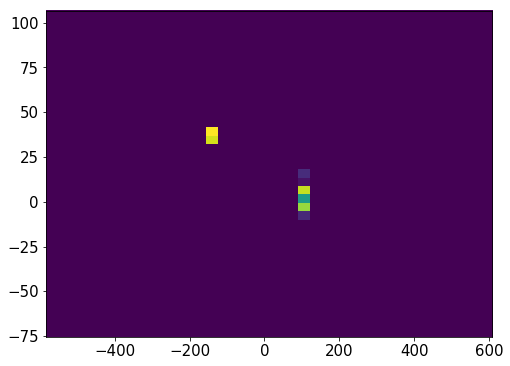

962606    40
962607    40
962608    40
962609    40
962610    40
962611    40
962612    40
962613    40
962614    40
962615    40
962616    40
962617    40
962618    40
962622     4
962623     4
962624     4
962625     4
962626     4
Name: Nsipm, dtype: uint16


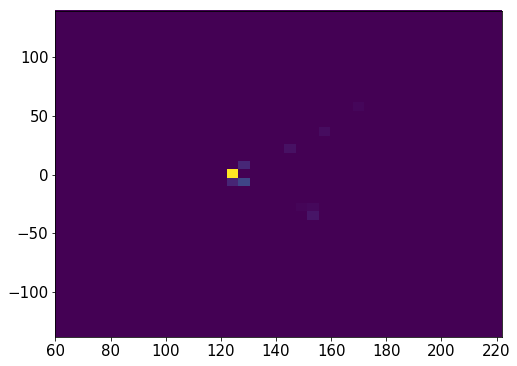

962635    29
962636    29
962637    29
962638    29
962639    29
962640    29
962641    29
962642    29
962643    29
962644    29
962645    29
962646    29
962647    29
962648    29
962649    29
962650    29
Name: Nsipm, dtype: uint16


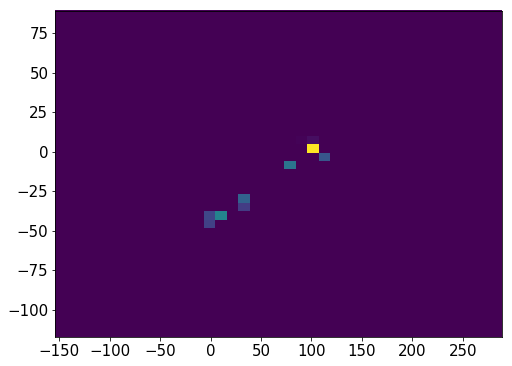

25925    27
25926    27
25927    27
25928    27
25929    27
25930    27
25931    27
25932    27
25933    27
25934    27
25935    27
25936    27
25937    27
25938    27
25939    27
25940    27
25941    27
25942    27
25943    27
25945    27
25946    27
25947    27
25948    27
25949    27
25951    27
25952    27
25953    27
25954    27
25955    27
Name: Nsipm, dtype: uint16


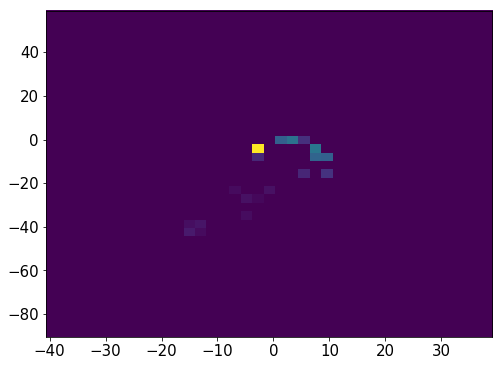

962651    23
962652    23
962653    23
962654    23
962655    23
962656    23
962657    23
962658    23
962659    23
962660    23
962661    23
962662    23
962663    23
962664    23
962665    23
962669     1
962670     1
962671     1
962672     1
Name: Nsipm, dtype: uint16


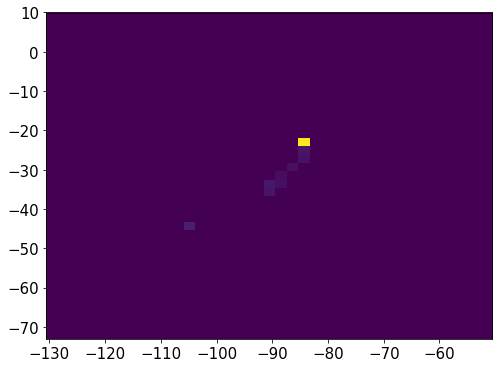

25961    22
25962    22
25963    22
25964    22
25965    22
25966    22
25967    22
25968    22
25969    22
25970    22
25971    22
25972    22
25973    22
25974    22
25976    22
25977    22
25978    22
25979    22
25980    22
Name: Nsipm, dtype: uint16


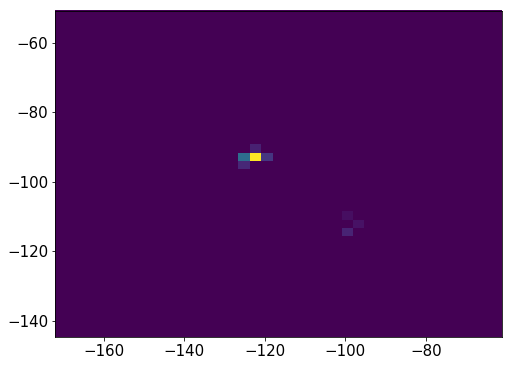

1667608    39
1667609    39
1667610    39
1667611    39
1667612    39
1667613    39
1667614    39
1667615    39
1667616    39
1667617    39
1667618    39
1667619    39
1667620    39
1667621    39
Name: Nsipm, dtype: uint16


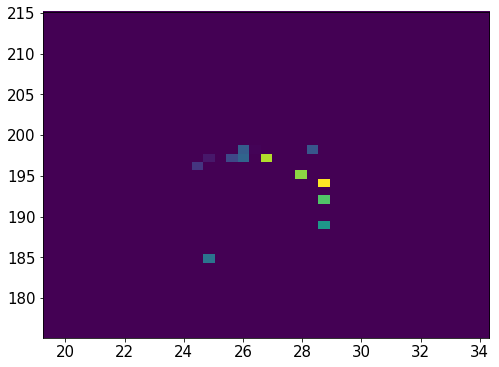

25985    23
25986    23
25987    23
25988    23
25989    23
25990    23
25991    23
25992    23
25993    23
25994    23
25995    23
25996    23
25997    23
25998    23
25999    23
26000    23
26001    23
26002    23
26003    23
26004    23
26005    23
26006    23
26007    23
26008    23
26009    23
26010    23
26011    23
26012    23
Name: Nsipm, dtype: uint16


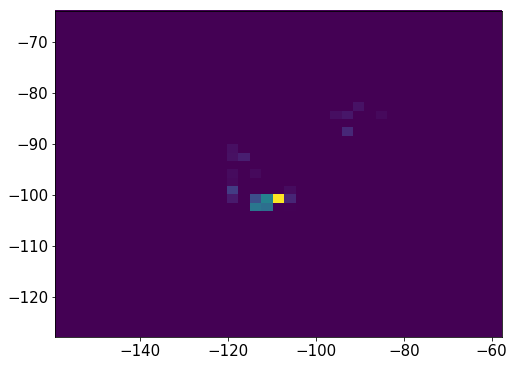

2268552    19
2268553    19
2268554    19
2268555    19
2268556    19
2268557    19
2268558    19
2268559    19
2268560    19
2268561    19
2268562    19
2268563    19
2268564    19
2268565    19
2268566    19
2268567    19
2268568    19
2268569    19
2268571    19
2268573    19
2268575    19
2268577    19
2268578    19
2268579    19
2268580    19
2268581    19
2268582    19
2268583    19
2268584    19
2268585    19
2268586    19
Name: Nsipm, dtype: uint16


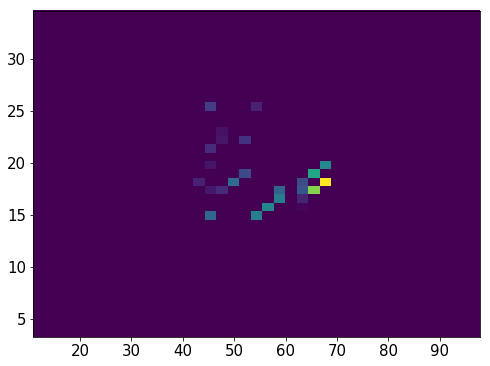

26015    33
26016    33
26017    33
26018    33
26019    33
26020    33
26021    33
26022    33
26023    33
26024    33
26025    33
Name: Nsipm, dtype: uint16


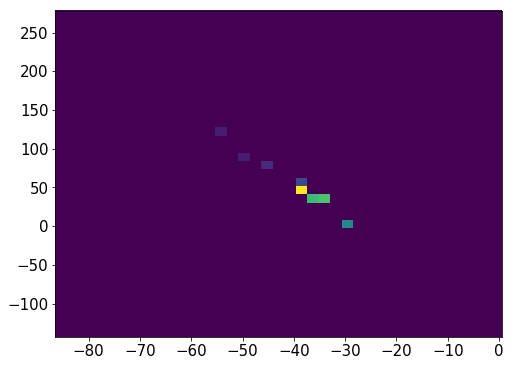

26030    20
26031    20
26032    20
26033    20
26034    20
26035    20
26036    20
26037    20
26038    20
26039    20
26040    20
26041    20
26042    20
26043    20
26044    20
Name: Nsipm, dtype: uint16


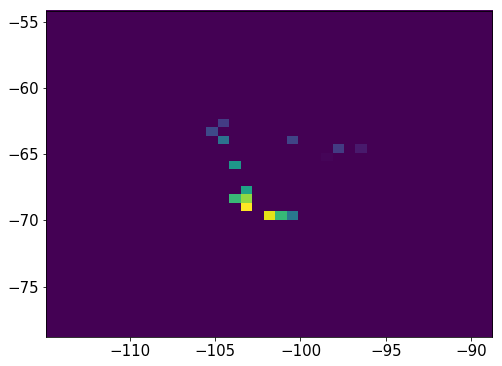

26048    30
26049    30
26050    30
26051    30
26052    30
26053    30
26055    30
26056    30
26057    30
26058    30
26059    30
26060    30
26061    30
26062    30
26063    30
26064    30
26065    30
26066    30
26067    30
26068    30
26069    30
26070    30
26071    30
26072    30
26073    30
26074    30
26075    30
26076    30
26077    30
Name: Nsipm, dtype: uint16


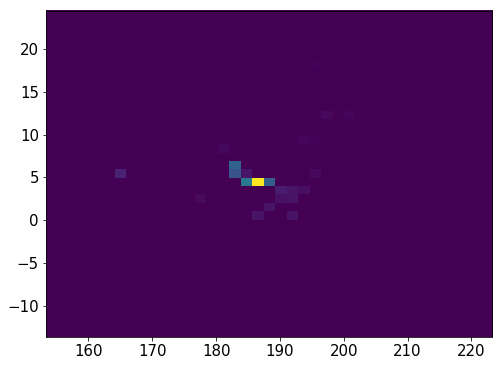

962734    22
962735    22
962736    22
962737    22
962738    22
962739    22
962740    22
962741    22
962745    10
962746    10
962747    10
962748    10
962749    10
962750    10
962751    10
Name: Nsipm, dtype: uint16


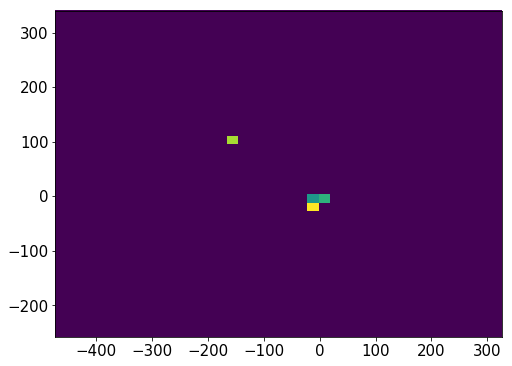

962754    17
962755    17
962756    17
962757    17
962758    17
962759    17
962760    17
962761    17
962762    17
962763    17
962764    17
962765    17
962770    12
962771    12
962772    12
962773    12
962774    12
962775    12
962776    12
962777    12
Name: Nsipm, dtype: uint16


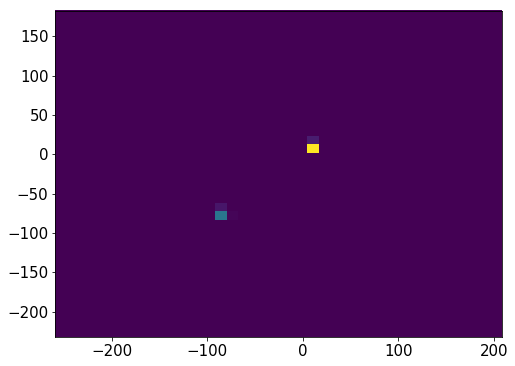

962782    33
962783    33
962784    33
962785    33
962786    33
962787    33
962788    33
962789    33
962790    33
962791    33
962792    33
962793    33
962794    33
962795    33
962796    33
962801    33
962802    33
962803    33
962804    33
962805    33
Name: Nsipm, dtype: uint16


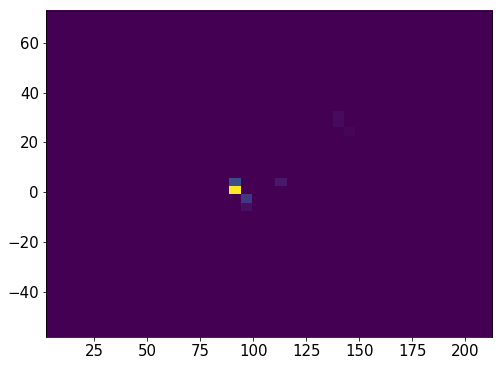

26079    24
26080    24
26081    24
26082    24
26083    24
26084    24
26085    24
26086    24
26087    24
26088    24
26089    24
26090    24
Name: Nsipm, dtype: uint16


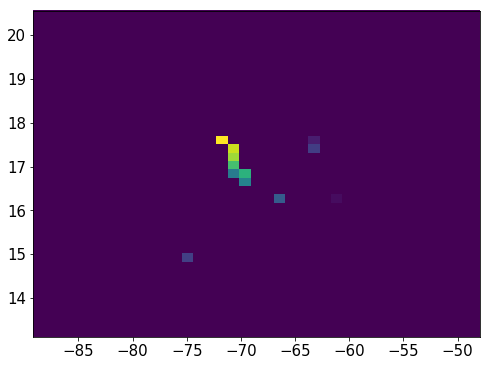

962809    26
962810    26
962811    26
962812    26
962813    26
962814    26
962815    26
962816    26
962817    26
962818    26
962819    26
962820    26
962821    26
962822    26
962827    15
962828    15
962829    15
962830    15
962831    15
962832    15
962833    15
962834    15
962835    15
962836    15
962837    15
962838    15
962839    15
962840    15
962841    15
962842    15
962843    15
962844    15
Name: Nsipm, dtype: uint16


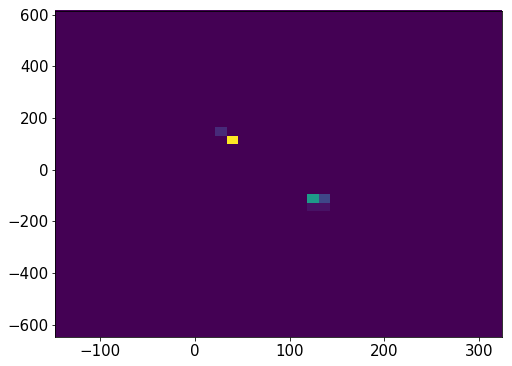

962853    31
962854    31
962855    31
962856    31
962857    31
962858    31
962859    31
962860    31
962861    31
962862    31
962863    31
962864    31
962865    31
962866    31
962867    31
962868    31
962869    31
962870    31
Name: Nsipm, dtype: uint16


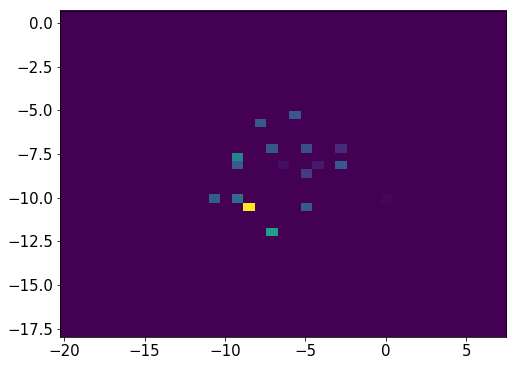

26094    21
26095    21
26096    21
26097    21
26098    21
26099    21
26100    21
26101    21
26102    21
26103    21
26104    21
26105    21
26106    21
26107    21
26113     1
26114     1
26115     1
26116     1
Name: Nsipm, dtype: uint16


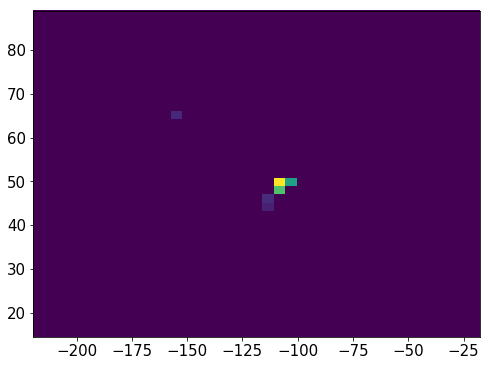

938094    44
938095    44
938096    44
938097    44
938098    44
938099    44
938100    44
938101    44
938102    44
938103    44
938104    44
938105    44
938106    44
938107    44
938108    44
938109    44
938110    44
938111    44
938112    44
938113    44
Name: Nsipm, dtype: uint16


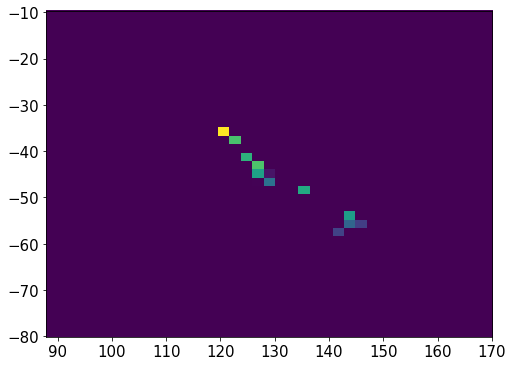

962910    22
962911    22
962912    22
962913    22
962914    22
962915    22
962916    22
962917    22
962918    22
962919    22
962920    22
962921    22
962922    22
962923    22
962924    22
962925    22
962926    22
962927    22
Name: Nsipm, dtype: uint16


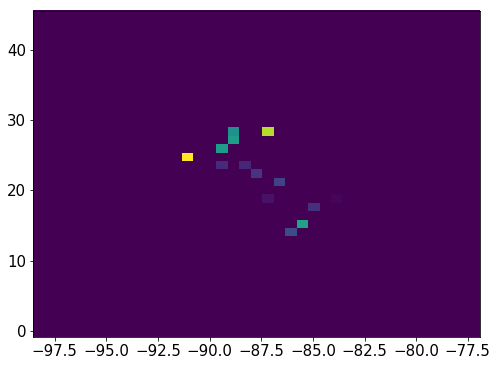

26120    34
26121    34
26122    34
26123    34
26124    34
26125    34
26126    34
26127    34
26128    34
26129    34
26130    34
26131    34
26132    34
Name: Nsipm, dtype: uint16


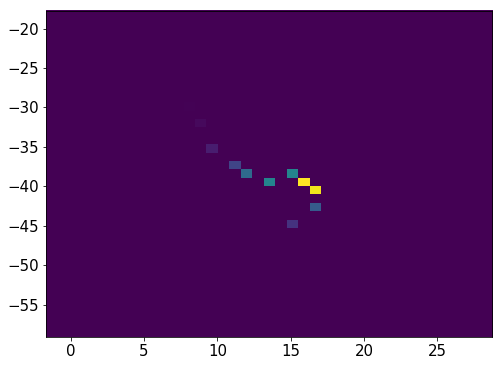

962933    22
962934    22
962935    22
962936    22
962937    22
962938    22
962939    22
962940    22
962941    22
962942    22
962943    22
962944    22
962945    22
962946    22
962947    22
962948    22
962949    22
962950    22
962951    22
962952    22
962953    22
962954    22
962955    22
Name: Nsipm, dtype: uint16


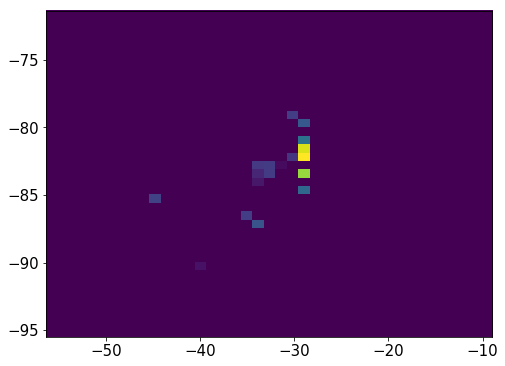

26136    23
26137    23
26138    23
26139    23
26140    23
26141    23
26142    23
26143    23
26144    23
26145    23
26146    23
26147    23
26148    23
26149    23
26150    23
26151    23
26152    23
26157     2
26158     2
26159     2
26160     2
Name: Nsipm, dtype: uint16


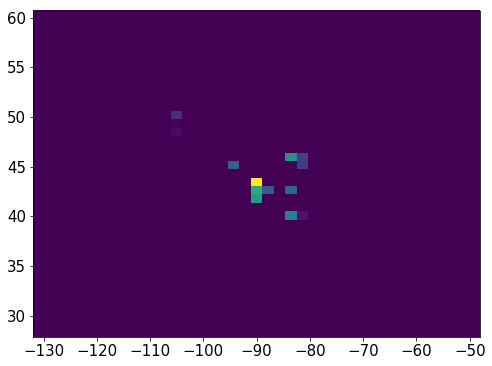

962961    23
962962    23
962963    23
962964    23
962965    23
962966    23
962967    23
962968    23
962969    23
962970    23
962971    23
962972    23
962973    23
962974    23
962975    23
962976    23
962977    23
962978    23
962979    23
962980    23
962984    23
962985    23
962986    23
962987    23
962994     4
962995     4
962996     4
962997     4
962998     4
962999     4
963000     4
963001     4
Name: Nsipm, dtype: uint16


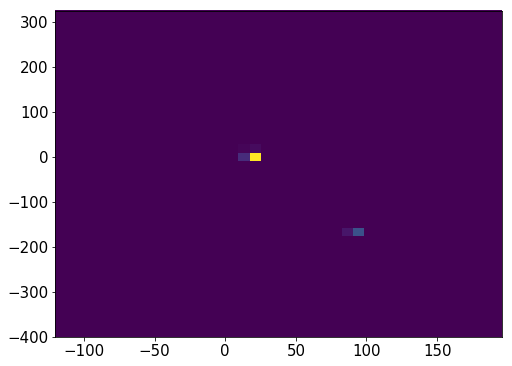

963007    23
963008    23
963009    23
963010    23
963011    23
963012    23
963013    23
963014    23
963015    23
963016    23
963017    23
963018    23
963019    23
963020    23
963021    23
963022    23
963023    23
963024    23
963025    23
Name: Nsipm, dtype: uint16


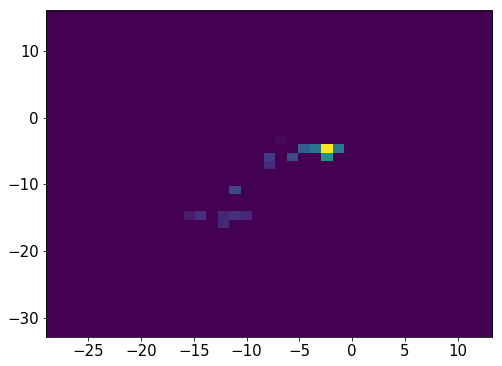

26165    26
26166    26
26167    26
26168    26
26169    26
26170    26
26171    26
26172    26
26173    26
26174    26
26175    26
26176    26
26177    26
26178    26
26179    26
26180    26
26181    26
26182    26
26183    26
26184    26
26185    26
26186    26
26192    26
26193    26
26194    26
26195    26
26196    26
Name: Nsipm, dtype: uint16


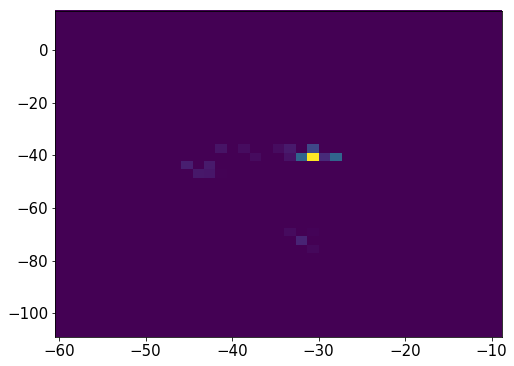

26198    53
26199    53
26200    53
26201    53
26202    53
26203    53
26204    53
26205    53
26206    53
26207    53
26208    53
26209    53
26210    53
26211    53
26212    53
26213    53
26214    53
26215    53
26216    53
26217    53
26218    53
26219    53
26220    53
Name: Nsipm, dtype: uint16


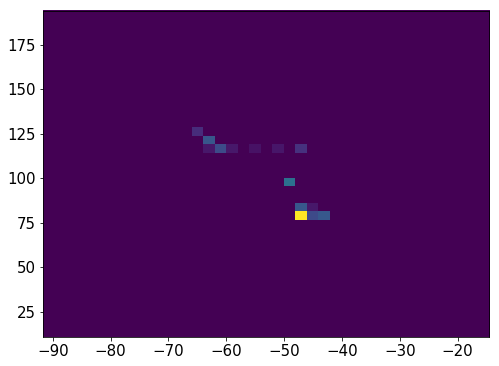

26224    23
26225    23
26226    23
26227    23
26228    23
26229    23
26230    23
26231    23
26232    23
26233    23
26234    23
26235    23
26236    23
26237    23
26238    23
26239    23
26240    23
Name: Nsipm, dtype: uint16


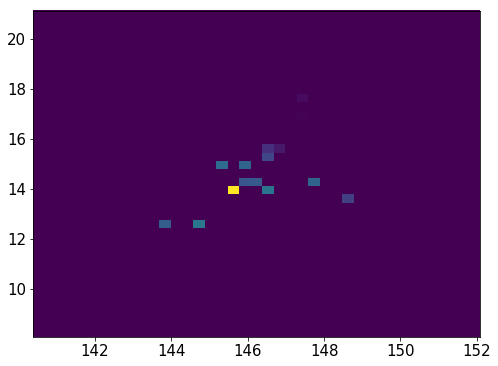

963030    27
963031    27
963032    27
963033    27
963034    27
963035    27
963036    27
963037    27
963038    27
963039    27
963040    27
963041    27
963042    27
963043    27
963044    27
963045    27
963046    27
963047    27
963048    27
Name: Nsipm, dtype: uint16


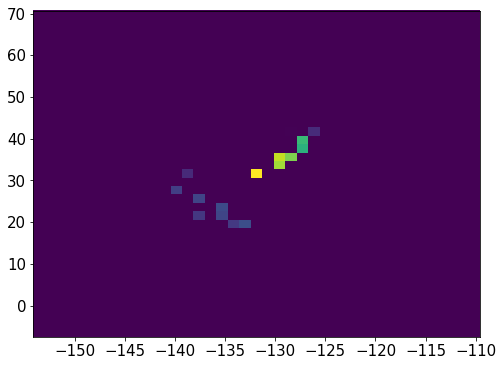

2273096    23
2273097    23
2273098    23
2273099    23
2273100    23
2273101    23
2273102    23
2273103    23
2273104    23
2273105    23
2273106    23
2273107    23
2273108    23
2273109    23
2273110    23
2273111    23
2273112    23
2273113    23
2273114    23
Name: Nsipm, dtype: uint16


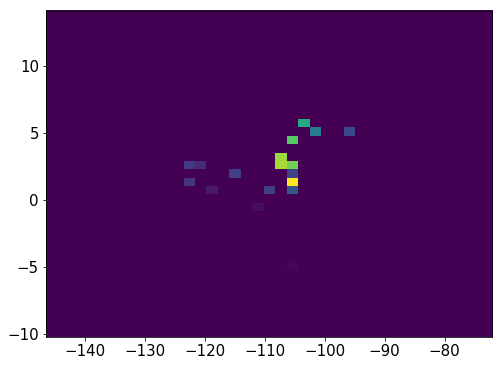

26246    28
26247    28
26248    28
26249    28
26250    28
26251    28
26252    28
26253    28
26254    28
26255    28
26256    28
26257    28
26258    28
26259    28
26260    28
26261    28
26262    28
26263    28
26264    28
26265    28
26266    28
26267    28
26268    28
26269    28
26270    28
Name: Nsipm, dtype: uint16


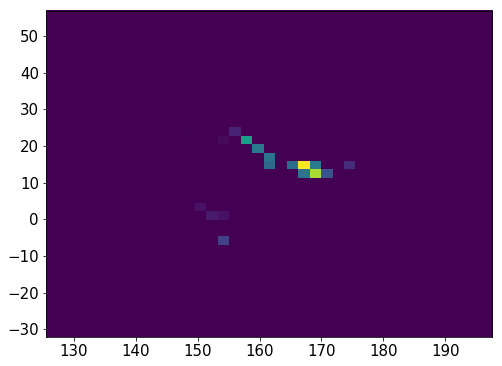

26275    30
26276    30
26277    30
26278    30
26279    30
26280    30
26281    30
26282    30
26283    30
26284    30
26285    30
26286    30
26287    30
26288    30
26289    30
26290    30
26291    30
26292    30
Name: Nsipm, dtype: uint16


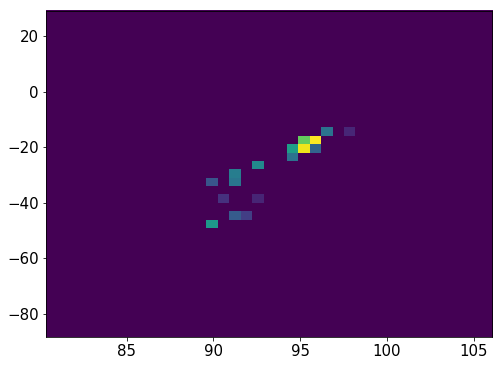

26295    21
26296    21
26297    21
26298    21
26299    21
26300    21
26301    21
26302    21
26303    21
26304    21
26309    16
26310    16
26311    16
26312    16
26313    16
26314    16
26315    16
26321    16
26322    16
26323    16
26324    16
Name: Nsipm, dtype: uint16


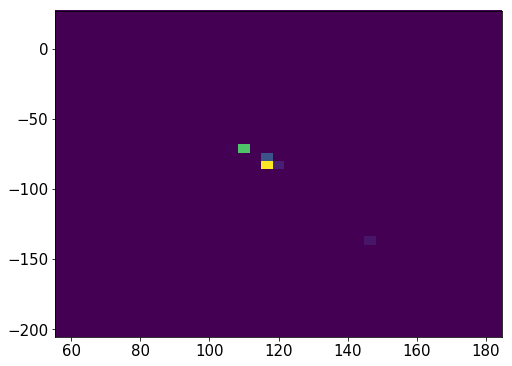

26329    26
26330    26
26331    26
26332    26
26333    26
26334    26
26335    26
26336    26
26337    26
26338    26
26339    26
26340    26
26341    26
26342    26
26343    26
26344    26
26345    26
26346    26
26347    26
26351    26
26352    26
26353    26
26354    26
26355    26
26356    26
26357    26
26358    26
26359    26
26360    26
26361    26
Name: Nsipm, dtype: uint16


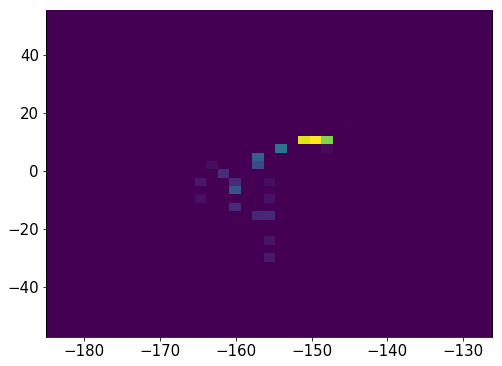

26366    26
26367    26
26368    26
26369    26
26370    26
26371    26
26372    26
26373    26
26374    26
26375    26
26376    26
26377    26
26378    26
26379    26
26380    26
26381    26
26382    26
26383    26
26384    26
26385    26
26386    26
26387    26
Name: Nsipm, dtype: uint16


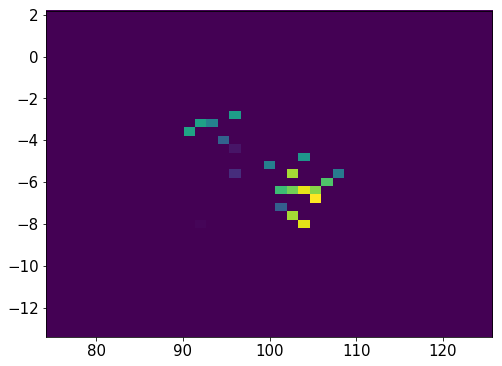

963053    30
963054    30
963055    30
963056    30
963057    30
963058    30
963059    30
963060    30
963061    30
963062    30
963063    30
963064    30
963065    30
963067    30
963068    30
963069    30
963070    30
963071    30
963072    30
963073    30
Name: Nsipm, dtype: uint16


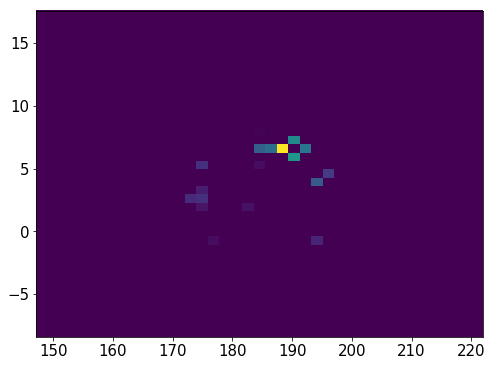

26394    36
26395    36
26396    36
26397    36
26398    36
26399    36
26400    36
26401    36
26402    36
26403    36
26404    36
26405    36
26406    36
26407    36
26414    36
26415    36
26416    36
Name: Nsipm, dtype: uint16


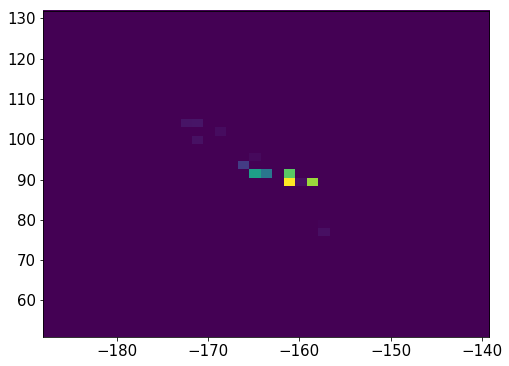

963100    22
963101    22
963102    22
963103    22
963104    22
963105    22
963106    22
963107    22
963108    22
963109    22
963110    22
963111    22
963112    22
963113    22
963114    22
963115    22
963116    22
963117    22
963118    22
963119    22
Name: Nsipm, dtype: uint16


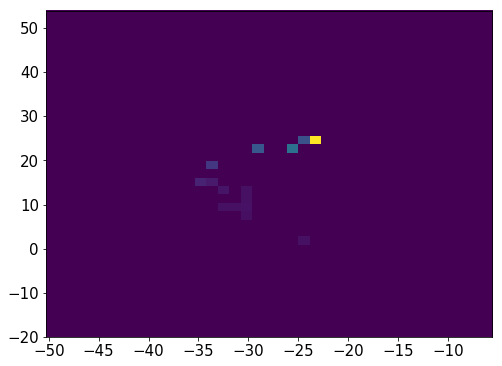

26417    27
26418    27
26419    27
26420    27
26421    27
26422    27
26423    27
26424    27
26425    27
26426    27
26427    27
26428    27
26429    27
26430    27
26431    27
26432    27
26433    27
26434    27
26435    27
26436    27
26437    27
Name: Nsipm, dtype: uint16


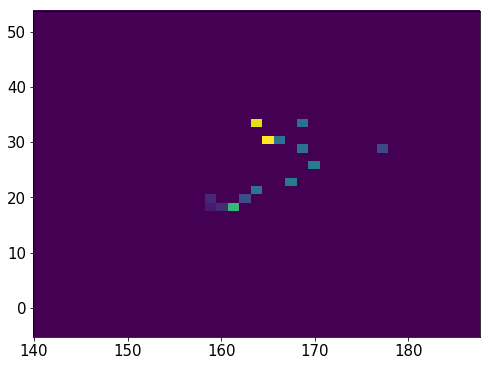

963141    31
963142    31
963143    31
963144    31
963145    31
963146    31
963147    31
963148    31
963149    31
963150    31
963151    31
963152    31
Name: Nsipm, dtype: uint16


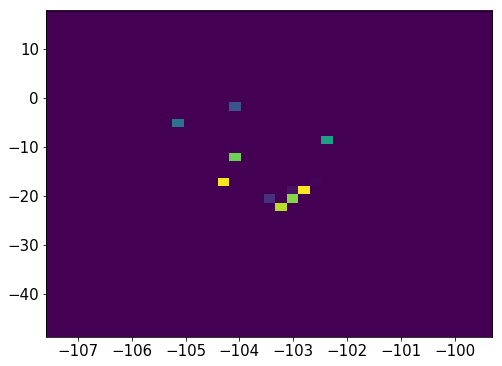

26442    27
26443    27
26444    27
26445    27
26446    27
26447    27
26448    27
26449    27
26450    27
26451    27
26452    27
26453    27
26454    27
26455    27
26456    27
26457    27
26458    27
26459    27
26460    27
26461    27
26462    27
26463    27
26464    27
26465    27
Name: Nsipm, dtype: uint16


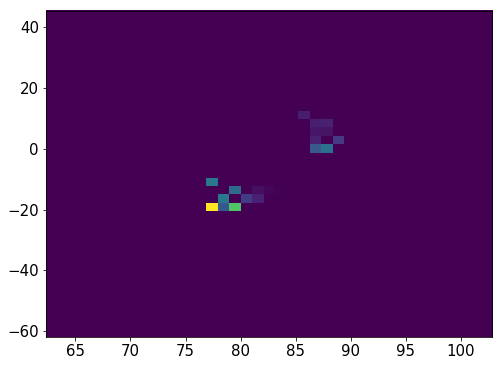

938124    18
938125    18
938126    18
938127    18
938128    18
938129    18
938130    18
938131    18
938132    18
938133    18
938134    18
938135    18
938136    18
938137    18
Name: Nsipm, dtype: uint16


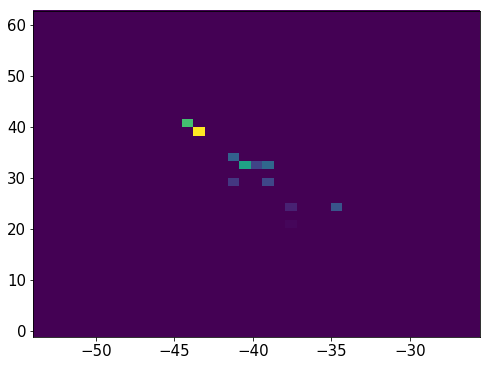

963188    43
963189    43
963190    43
963191    43
963192    43
963193    43
963194    43
963195    43
963196    43
963197    43
963198    43
963199    43
963200    43
963201    43
963202    43
963203    43
963204    43
Name: Nsipm, dtype: uint16


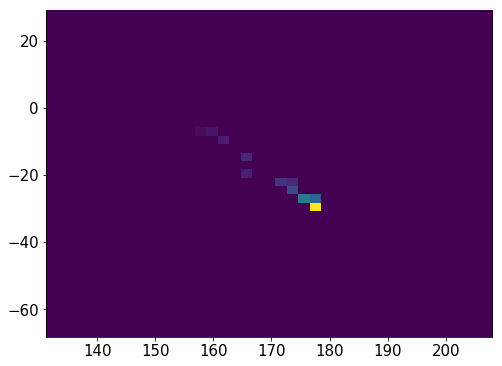

26466    28
26467    28
26468    28
26469    28
26470    28
26471    28
26472    28
26473    28
26474    28
26475    28
26476    28
Name: Nsipm, dtype: uint16


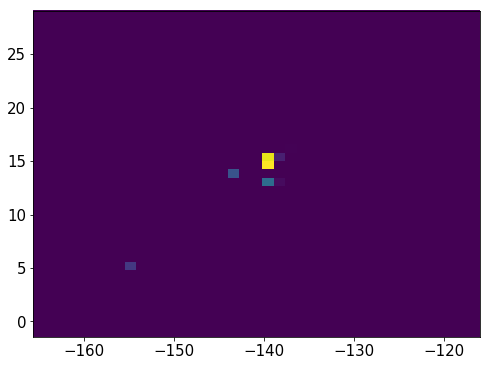

963246    28
963247    28
963248    28
963249    28
963250    28
963251    28
963252    28
963253    28
963254    28
963255    28
963256    28
963257    28
963258    28
963259    28
963260    28
Name: Nsipm, dtype: uint16


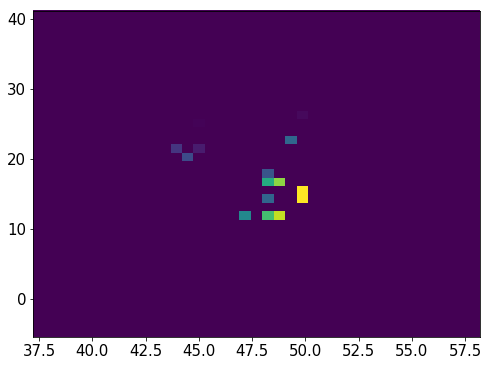

26481    24
26482    24
26483    24
26484    24
26485    24
26486    24
26487    24
26488    24
26489    24
26490    24
26491    24
26492    24
26493    24
26494    24
26495    24
26496    24
26497    24
26498    24
26499    24
26500    24
26501    24
26502    24
26503    24
26504    24
Name: Nsipm, dtype: uint16


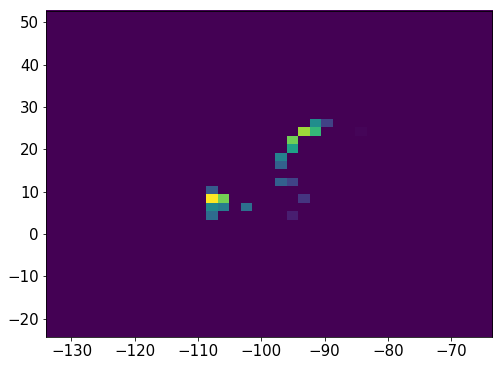

963265    20
963266    20
963267    20
963268    20
963269    20
963270    20
963271    20
963272    20
963273    20
963274    20
963275    20
963276    20
963277    20
963278    20
963279    20
963280    20
963281    20
963282    20
963283    20
963284    20
963285    20
963286    20
963287    20
Name: Nsipm, dtype: uint16


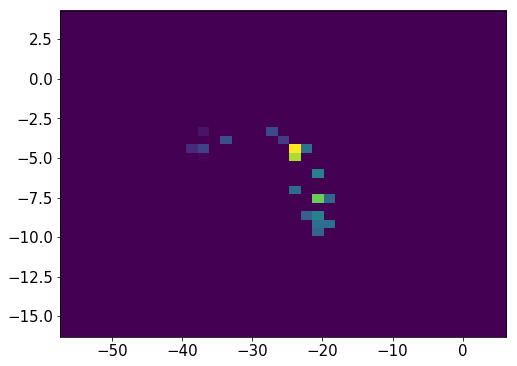

26508    21
26509    21
26510    21
26511    21
26512    21
26513    21
26514    21
26515    21
26516    21
26517    21
26518    21
26519    21
26520    21
26521    21
Name: Nsipm, dtype: uint16


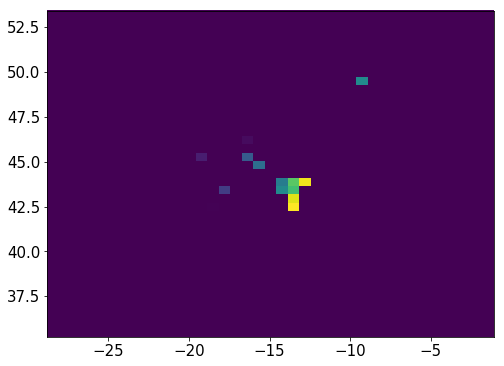

26527    31
26528    31
26529    31
26530    31
26531    31
26532    31
26533    31
26534    31
26535    31
26536    31
26537    31
26538    31
26539    31
26540    31
26541    31
26542    31
Name: Nsipm, dtype: uint16


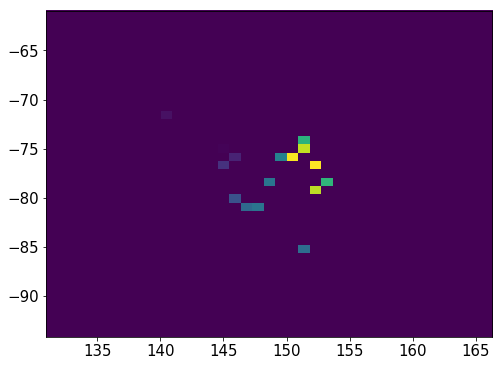

963319    24
963320    24
963321    24
963322    24
963323    24
963324    24
963325    24
963326    24
963327    24
963328    24
963329    24
963330    24
963331    24
963332    24
963333    24
963334    24
963335    24
963336    24
963337    24
963338    24
963339    24
963340    24
963341    24
963342    24
963343    24
Name: Nsipm, dtype: uint16


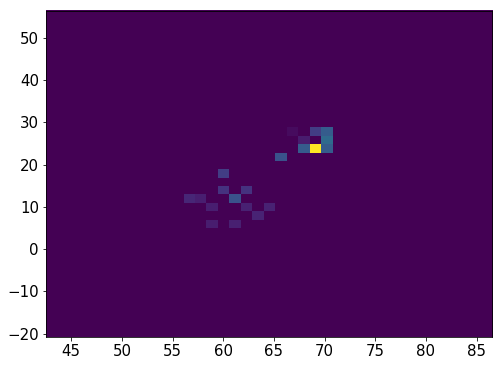

963350    28
963351    28
963352    28
963353    28
963354    28
963355    28
963356    28
963357    28
963358    28
963359    28
963360    28
963361    28
Name: Nsipm, dtype: uint16


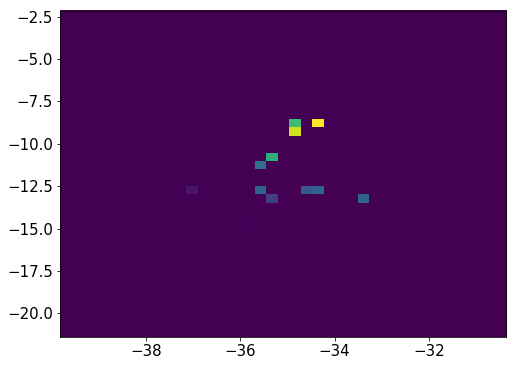

26546    25
26547    25
26548    25
26549    25
26550    25
26551    25
26552    25
26553    25
26554    25
26555    25
26556    25
26557    25
26558    25
26559    25
26560    25
26561    25
26562    25
26563    25
26564    25
26565    25
Name: Nsipm, dtype: uint16


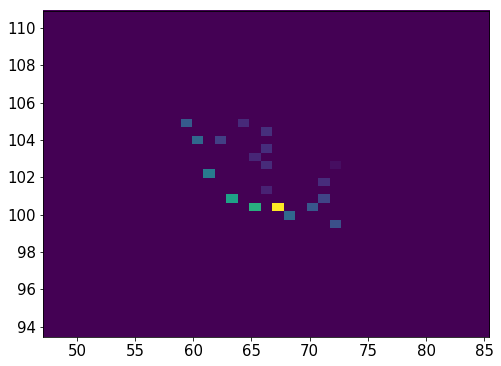

26568    28
26569    28
26570    28
26571    28
26572    28
26573    28
26574    28
26575    28
26576    28
26577    28
26578    28
26579    28
26580    28
26581    28
26582    28
26583    28
26584    28
26585    28
26586    28
26587    28
26588    28
Name: Nsipm, dtype: uint16


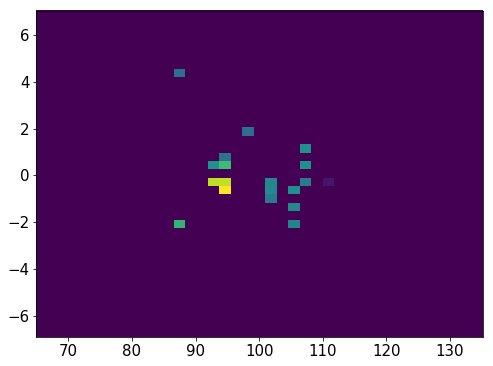

26592    31
26593    31
26594    31
26595    31
26596    31
26597    31
26598    31
26599    31
26600    31
26601    31
26602    31
26603    31
26604    31
26605    31
26606    31
26613    31
26614    31
26615    31
Name: Nsipm, dtype: uint16


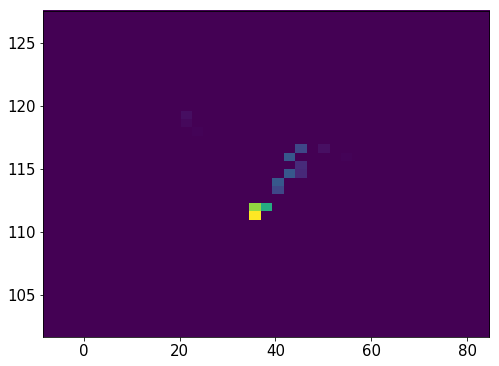

26617    21
26618    21
26619    21
26620    21
26621    21
26622    21
26623    21
26624    21
26625    21
26626    21
26627    21
26628    21
26629    21
26630    21
26631    21
26632    21
26638     3
26639     3
26640     3
26641     3
26642     3
26643     3
26644     3
26645     3
26646     3
26647     3
Name: Nsipm, dtype: uint16


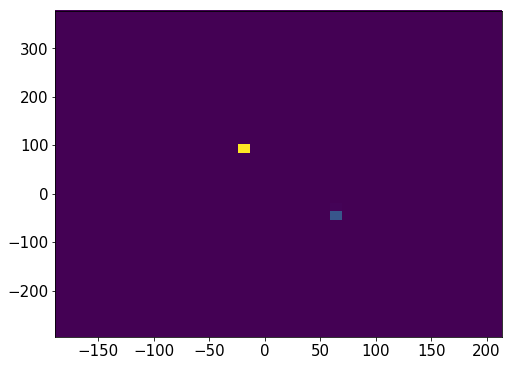

963366    27
963367    27
963368    27
963369    27
963370    27
963371    27
963372    27
963373    27
963374    27
963375    27
963376    27
963377    27
963378    27
963379    27
963380    27
963381    27
963382    27
963383    27
963384    27
Name: Nsipm, dtype: uint16


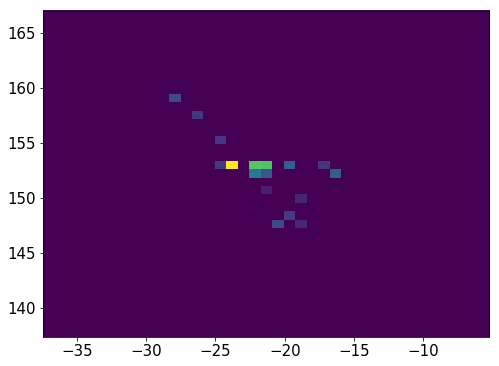

26652    31
26653    31
26654    31
26655    31
26656    31
26657    31
26658    31
26659    31
26660    31
26661    31
26662    31
26663    31
26664    31
26665    31
26666    31
26667    31
26668    31
26669    31
26670    31
26671    31
Name: Nsipm, dtype: uint16


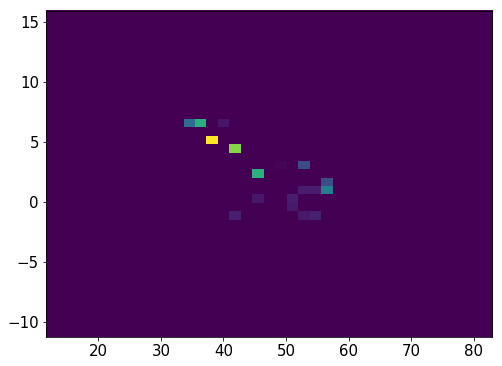

963389    24
963390    24
963391    24
963392    24
963393    24
963394    24
963395    24
963396    24
963397    24
963398    24
963399    24
963400    24
963401    24
963402    24
963403    24
963404    24
Name: Nsipm, dtype: uint16


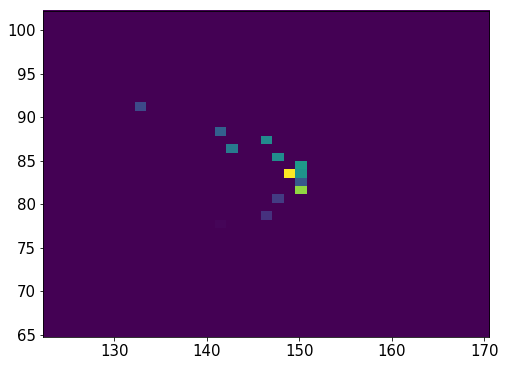

26678    23
26679    23
26680    23
26681    23
26682    23
26683    23
26684    23
26685    23
26686    23
26687    23
26688    23
26689    23
26690    23
26691    23
26692    23
26693    23
26694    23
26695    23
26696    23
26697    23
26698    23
26699    23
26700    23
26701    23
26702    23
Name: Nsipm, dtype: uint16


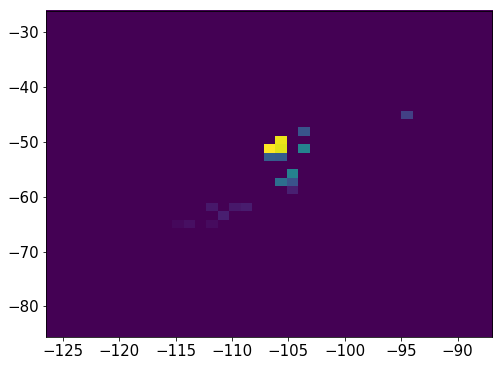

963437    25
963438    25
963439    25
963440    25
963441    25
963442    25
963443    25
963444    25
963445    25
963446    25
963447    25
963448    25
963449    25
963450    25
963451    25
963452    25
963455     1
963456     1
963457     1
963458     1
963459     1
Name: Nsipm, dtype: uint16


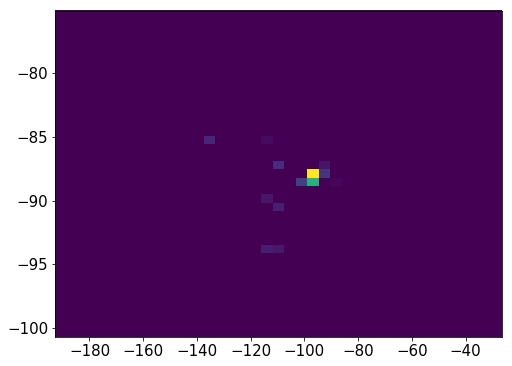

26707    19
26708    19
26709    19
26710    19
26711    19
26712    19
26713    19
26714    19
26715    19
26716    19
26717    19
26718    19
Name: Nsipm, dtype: uint16


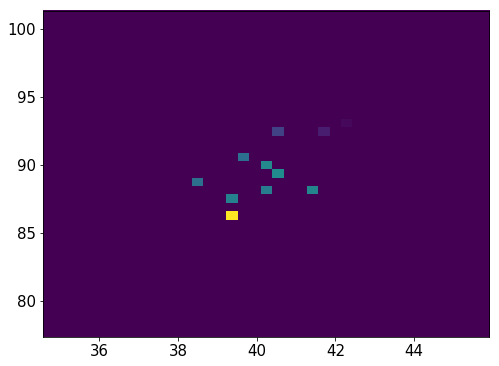

26724    30
26725    30
26726    30
26727    30
26728    30
26729    30
26730    30
26731    30
26732    30
26733    30
26734    30
26735    30
26736    30
26737    30
26738    30
26739    30
26740    30
26741    30
26742    30
26743    30
26744    30
26745    30
26746    30
26747    30
26748    30
26749    30
26750    30
26751    30
26752    30
26753    30
26754    30
26755    30
Name: Nsipm, dtype: uint16


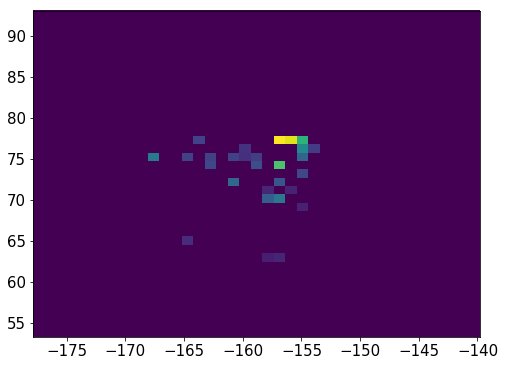

26760    24
26761    24
26762    24
26763    24
26764    24
26765    24
26766    24
26767    24
26768    24
26769    24
26770    24
26771    24
26772    24
26773    24
26774    24
26775    24
26776    24
26777    24
26778    24
26780    24
Name: Nsipm, dtype: uint16


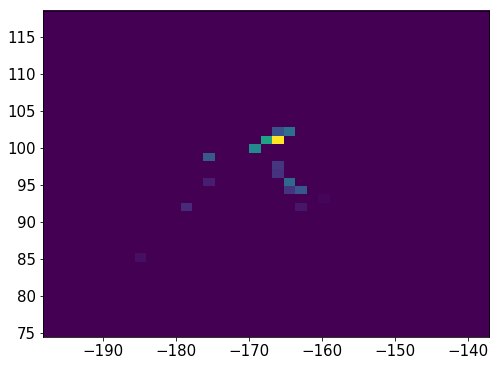

963464    27
963465    27
963466    27
963467    27
963468    27
963469    27
963470    27
963471    27
963472    27
963473    27
963474    27
963475    27
963476    27
963477    27
963478    27
963479    27
Name: Nsipm, dtype: uint16


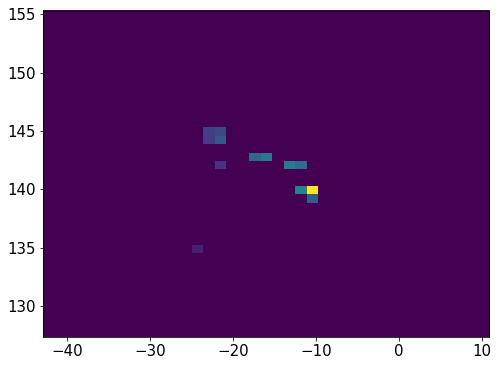

26792    31
26793    31
26794    31
26795    31
26796    31
26797    31
26798    31
26799    31
26800    31
26801    31
26802    31
26803    31
26804    31
26805    31
26806    31
Name: Nsipm, dtype: uint16


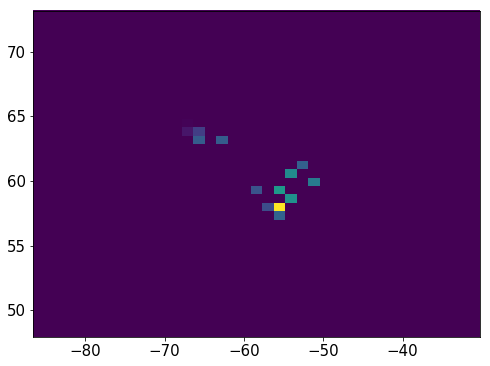

26811    26
26812    26
26813    26
26814    26
26815    26
26816    26
26817    26
26818    26
26819    26
26820    26
26821    26
26822    26
26823    26
26824    26
26825    26
26826    26
26827    26
26828    26
26829    26
26830    26
26831    26
26832    26
Name: Nsipm, dtype: uint16


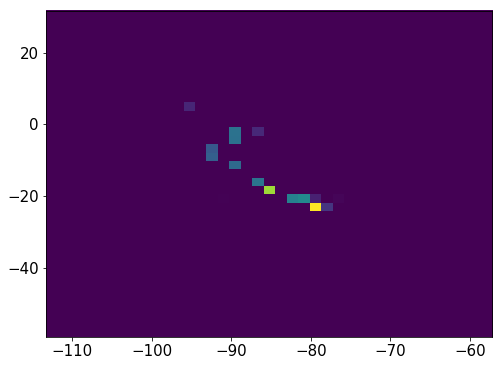

963516    26
963517    26
963518    26
963519    26
963520    26
963521    26
963522    26
963523    26
963524    26
963525    26
963526    26
963527    26
963528    26
963529    26
963530    26
963531    26
963532    26
963533    26
Name: Nsipm, dtype: uint16


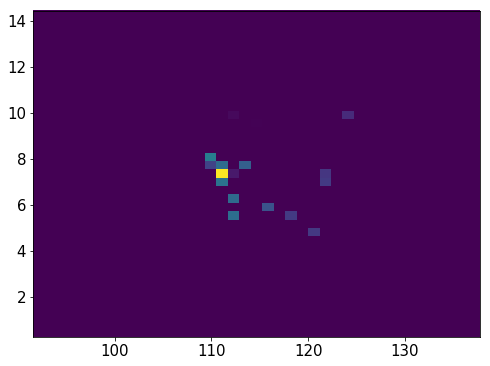

963538    29
963539    29
963540    29
963541    29
963542    29
963543    29
963544    29
963545    29
963546    29
963547    29
963548    29
963549    29
963550    29
963551    29
963552    29
963553    29
963554    29
963555    29
963556    29
963557    29
963558    29
963559    29
963564     3
963565     3
963566     3
963567     3
963568     3
Name: Nsipm, dtype: uint16


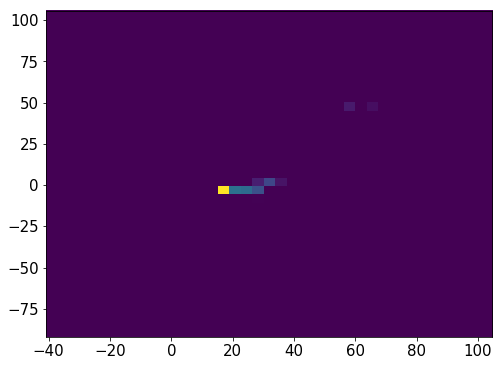

963573    34
963574    34
963575    34
963576    34
963577    34
963578    34
963579    34
963580    34
963581    34
963582    34
963583    34
963584    34
963585    34
963586    34
963587    34
963588    34
963589    34
Name: Nsipm, dtype: uint16


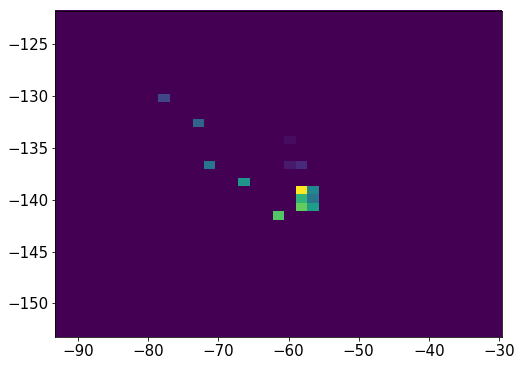

26837    25
26838    25
26839    25
26840    25
26841    25
26842    25
26843    25
26844    25
26845    25
26846    25
26847    25
26848    25
26849    25
26850    25
26851    25
26852    25
26853    25
26854    25
26855    25
26856    25
Name: Nsipm, dtype: uint16


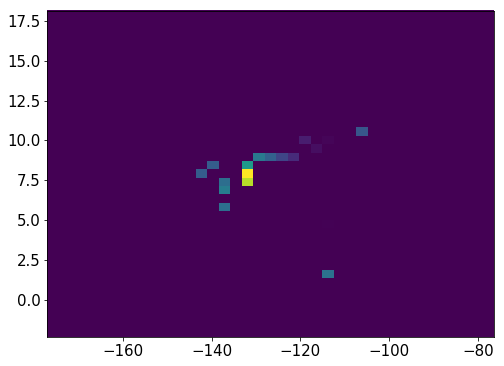

963593    22
963594    22
963595    22
963596    22
963597    22
963598    22
963599    22
963600    22
963601    22
963602    22
963603    22
963604    22
963605    22
963606    22
963607    22
963608    22
963609    22
963610    22
963611    22
963612    22
963613    22
963614    22
963615    22
963616    22
963617    22
Name: Nsipm, dtype: uint16


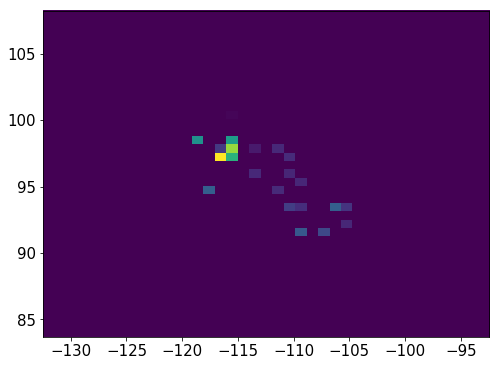

963622    30
963623    30
963624    30
963625    30
963626    30
963627    30
963628    30
963629    30
963630    30
963631    30
963632    30
963633    30
963634    30
963635    30
963636    30
963637    30
963638    30
963639    30
Name: Nsipm, dtype: uint16


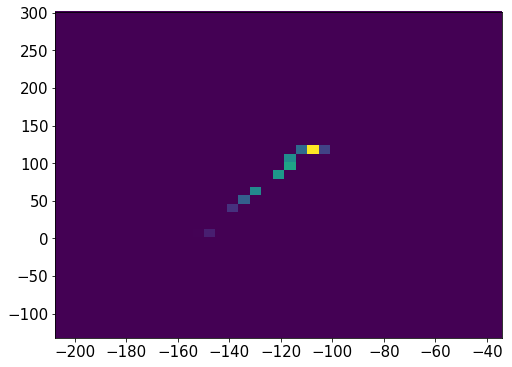

963645    22
963646    22
963647    22
963648    22
963649    22
963650    22
963651    22
963652    22
963653    22
963654    22
963655    22
963656    22
963657    22
963658    22
963659    22
963660    22
963661    22
963662    22
963663    22
963664    22
963665    22
963666    22
963670     3
963671     3
963672     3
963673     3
963674     3
Name: Nsipm, dtype: uint16


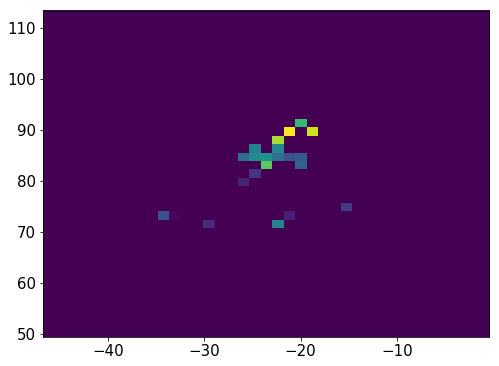

963678    25
963679    25
963680    25
963681    25
963682    25
963683    25
963684    25
963685    25
963686    25
963687    25
963688    25
963689    25
963690    25
963691    25
963692    25
963693    25
963694    25
963695    25
963696    25
963697    25
Name: Nsipm, dtype: uint16


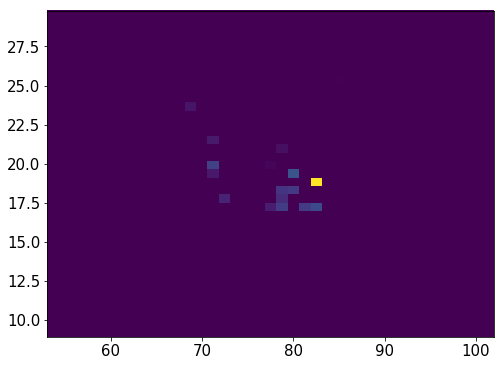

963703    22
963704    22
963705    22
963706    22
963707    22
963708    22
963709    22
963710    22
963711    22
963712    22
963713    22
963714    22
963715    22
963716    22
963718    22
Name: Nsipm, dtype: uint16


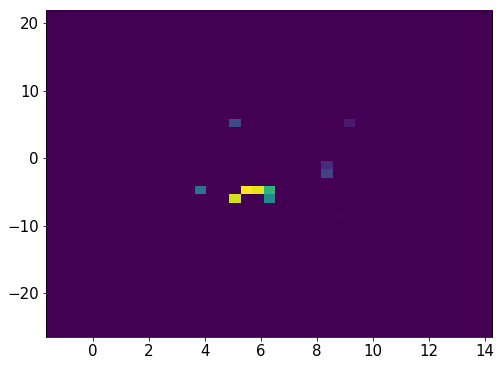

26861    32
26862    32
26863    32
26864    32
26865    32
26866    32
26867    32
26868    32
26869    32
26870    32
26871    32
26872    32
26873    32
26874    32
26875    32
26876    32
Name: Nsipm, dtype: uint16


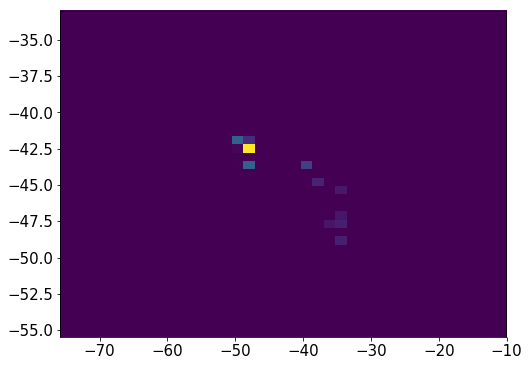

963724    23
963725    23
963726    23
963727    23
963728    23
963729    23
963730    23
963731    23
963732    23
963733    23
963734    23
963735    23
963736    23
963737    23
963738    23
963739    23
963740    23
963741    23
963742    23
963743    23
963744    23
963745    23
963746    23
963751     1
963752     1
963753     1
963754     1
963755     1
963756     1
Name: Nsipm, dtype: uint16


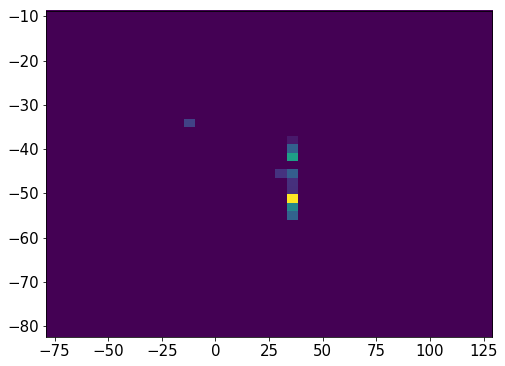

26881    21
26882    21
26883    21
26884    21
26885    21
26886    21
26887    21
26888    21
26889    21
26890    21
26891    21
26892    21
26893    21
26894    21
26895    21
26896    21
26897    21
26898    21
26899    21
26900    21
26901    21
26902    21
26903    21
Name: Nsipm, dtype: uint16


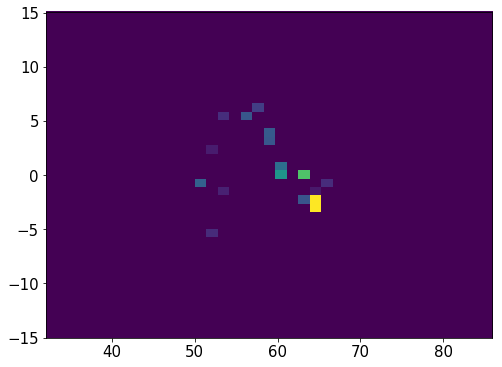

963789    27
963790    27
963791    27
963792    27
963793    27
963794    27
963795    27
963796    27
963797    27
963798    27
963799    27
963800    27
963801    27
963802    27
963803    27
963804    27
963805    27
Name: Nsipm, dtype: uint16


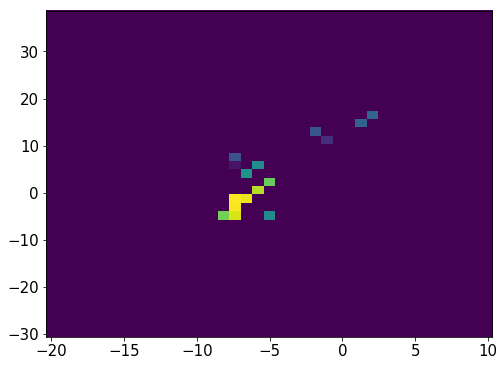

963810    36
963811    36
963812    36
963813    36
963814    36
963815    36
963816    36
963817    36
963818    36
963819    36
963820    36
963821    36
963822    36
963823    36
963824    36
963825    36
963826    36
963827    36
963828    36
963829    36
Name: Nsipm, dtype: uint16


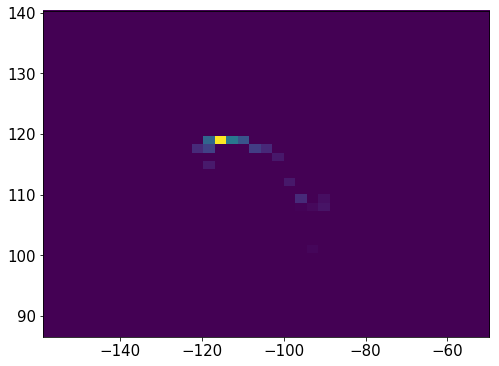

963833    19
963834    19
963835    19
963836    19
963837    19
963838    19
963839    19
963840    19
963841    19
963842    19
963843    19
963844    19
963845    19
963846    19
963847    19
963848    19
963849    19
963850    19
Name: Nsipm, dtype: uint16


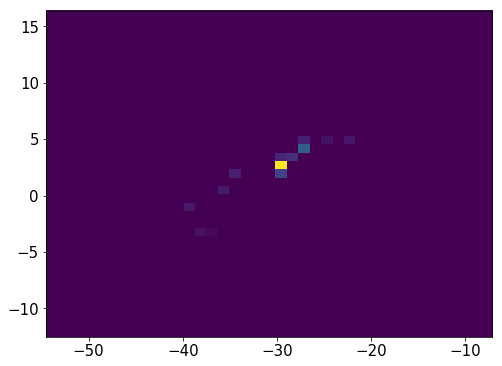

26909    25
26910    25
26911    25
26912    25
26913    25
26914    25
26915    25
26916    25
26917    25
26918    25
26919    25
26920    25
26921    25
26922    25
Name: Nsipm, dtype: uint16


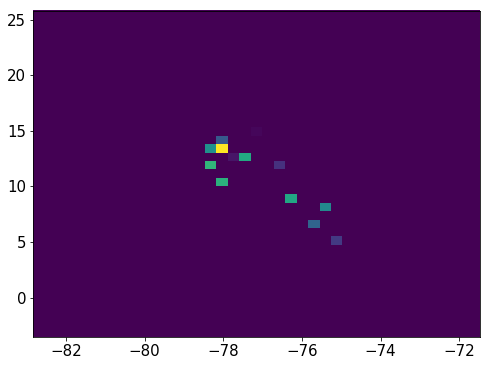

963855    22
963856    22
963857    22
963858    22
963859    22
963860    22
963861    22
963862    22
963863    22
963864    22
963866    22
963867    22
963868    22
963869    22
963870    22
963871    22
963872    22
963873    22
Name: Nsipm, dtype: uint16


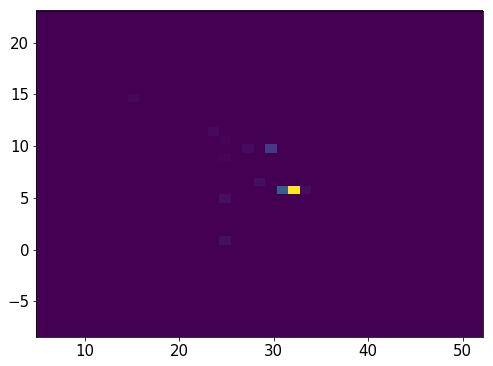

26926    22
26927    22
26928    22
26929    22
26930    22
26931    22
26932    22
26933    22
26934    22
26935    22
26936    22
26937    22
26938    22
26939    22
26940    22
26941    22
26942    22
26943    22
26944    22
26945    22
26946    22
26947    22
Name: Nsipm, dtype: uint16


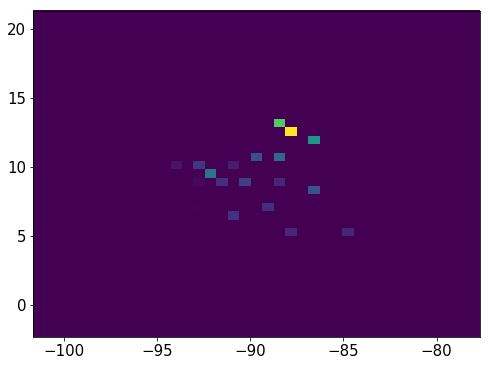

1667780    25
1667781    25
1667782    25
1667783    25
1667784    25
1667785    25
1667786    25
1667787    25
1667788    25
1667789    25
1667790    25
1667791    25
Name: Nsipm, dtype: uint16


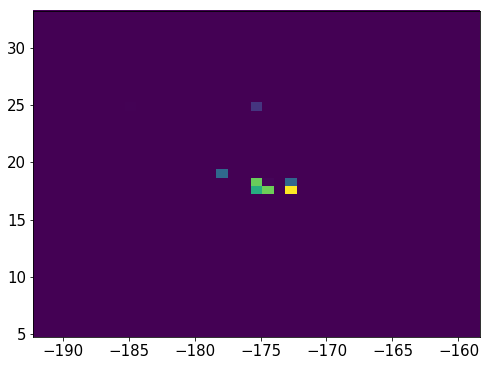

26952    30
26953    30
26954    30
26955    30
26956    30
26957    30
26958    30
26959    30
26960    30
26961    30
26962    30
26963    30
26964    30
26965    30
26966    30
26967    30
26968    30
26969    30
26970    30
26971    30
26973     7
26974     7
26975     7
26976     7
26977     7
26978     7
26979     7
26980     7
26981     7
Name: Nsipm, dtype: uint16


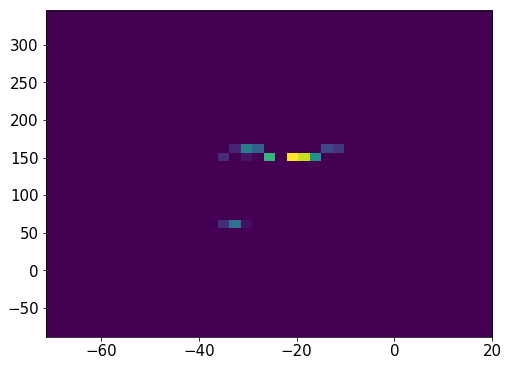

26986    37
26987    37
26988    37
26989    37
26990    37
26991    37
26992    37
26993    37
26994    37
26995    37
26996    37
26997    37
Name: Nsipm, dtype: uint16


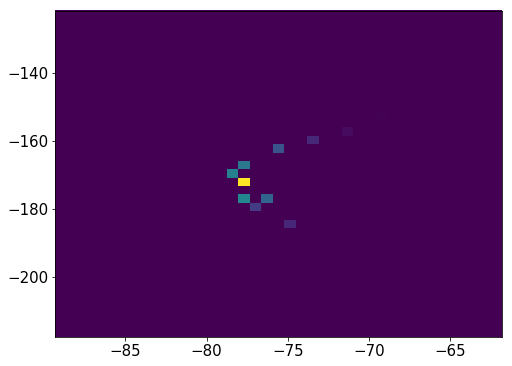

963945    62
963946    62
963947    62
963948    62
963949    62
963950    62
963951    62
963952    62
963953    62
963954    62
963955    62
963956    62
963957    62
963958    62
963959    62
963960    62
963961    62
963962    62
963963    62
963964    62
963965    62
963966    62
963967    62
963968    62
963969    62
963970    62
963971    62
963972    62
963973    62
963974    62
963975    62
963976    62
963977    62
963978    62
963979    62
963980    62
963981    62
963982    62
963983    62
963984    62
963985    62
963986    62
963987    62
963988    62
963989    62
963990    62
963991    62
963992    62
963993    62
963994    62
963995    62
963996    62
963997    62
963998    62
Name: Nsipm, dtype: uint16


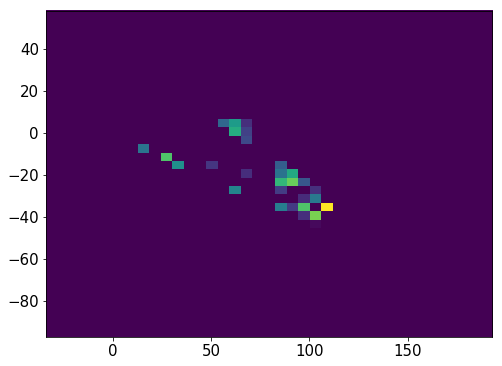

27000    37
27001    37
27002    37
27003    37
27004    37
27005    37
27006    37
27007    37
27008    37
27009    37
27010    37
27011    37
27012    37
27013    37
27014    37
Name: Nsipm, dtype: uint16


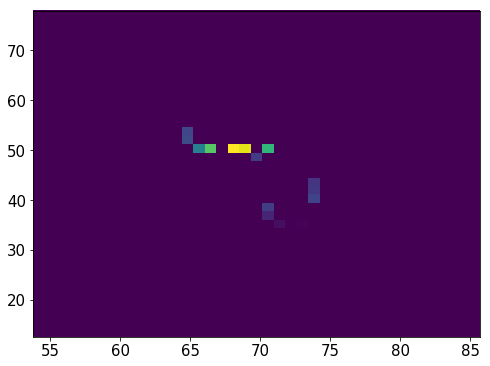

964005    24
964006    24
964007    24
964008    24
964009    24
964010    24
964011    24
964012    24
964013    24
964014    24
964015    24
964016    24
964017    24
964018    24
964019    24
964020    24
964021    24
Name: Nsipm, dtype: uint16


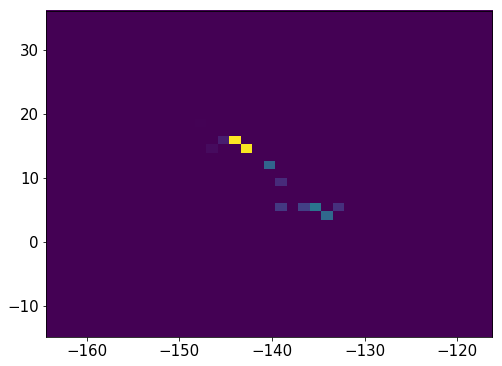

27019    25
27020    25
27021    25
27022    25
27023    25
27024    25
27025    25
27026    25
27027    25
27028    25
27029    25
27030    25
27031    25
27032    25
27033    25
27034    25
27035    25
27036    25
27040     3
27041     3
27042     3
27043     3
Name: Nsipm, dtype: uint16


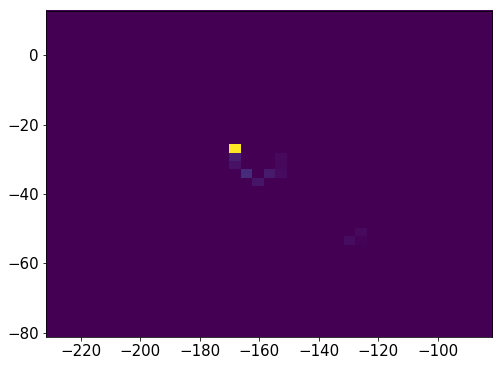

27048    23
27049    23
27050    23
27051    23
27052    23
27053    23
27054    23
27055    23
27056    23
27057    23
27058    23
27059    23
27060    23
27061    23
27062    23
27063    23
27064    23
27065    23
Name: Nsipm, dtype: uint16


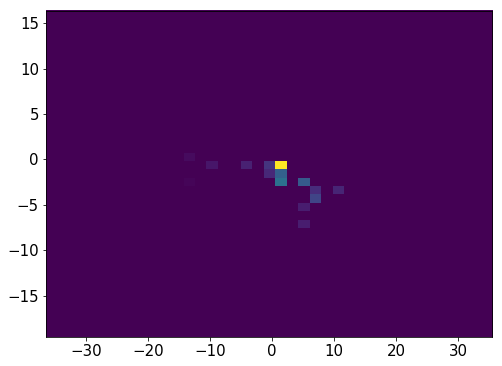

27071    20
27072    20
27073    20
27074    20
27075    20
27076    20
27077    20
27078    20
27079    20
27080    20
Name: Nsipm, dtype: uint16


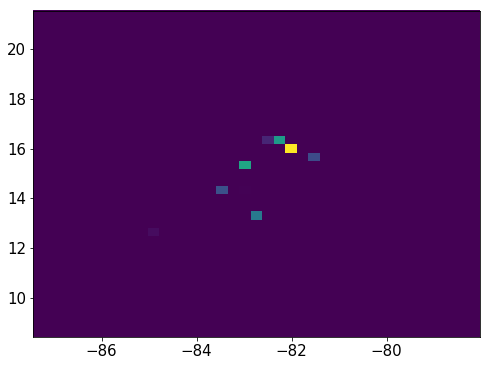

964053    38
964054    38
964055    38
964056    38
964057    38
964058    38
964059    38
964060    38
Name: Nsipm, dtype: uint16


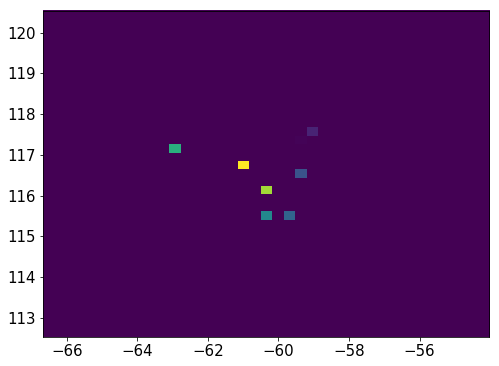

964065    29
964066    29
964067    29
964068    29
964069    29
964070    29
964071    29
964072    29
964073    29
964074    29
964075    29
964076    29
964077    29
964078    29
964079    29
964080    29
964081    29
964082    29
964083    29
964084    29
964085    29
964086    29
964087    29
964088    29
964089    29
964090    29
964091    29
964092    29
964093    29
964094    29
964095    29
964096    29
Name: Nsipm, dtype: uint16


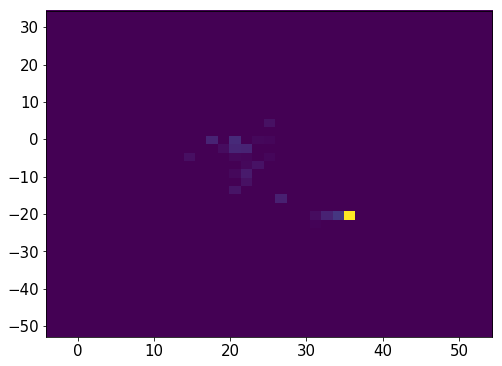

27086    34
27087    34
27088    34
27089    34
27090    34
27091    34
27092    34
27093    34
27094    34
27095    34
27096    34
27097    34
27098    34
27099    34
27100    34
27101    34
27102    34
Name: Nsipm, dtype: uint16


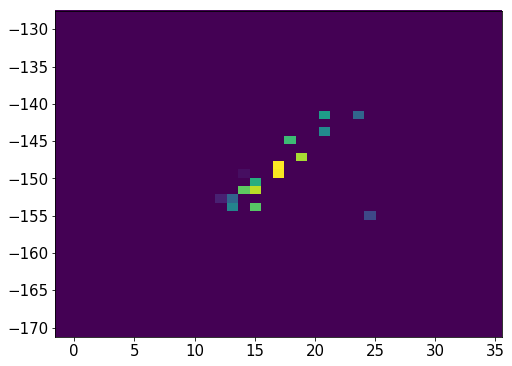

964100    27
964101    27
964102    27
964103    27
964104    27
964105    27
964106    27
964107    27
964108    27
964109    27
964110    27
964111    27
964112    27
964113    27
964114    27
Name: Nsipm, dtype: uint16


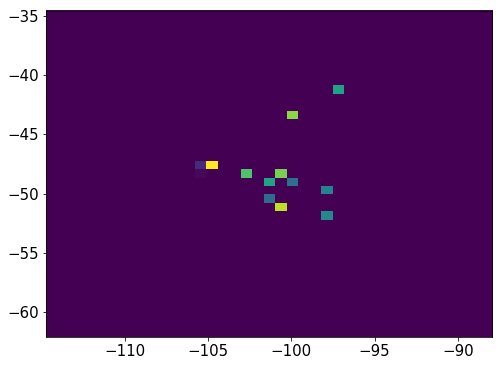

964119    33
964120    33
964121    33
964122    33
964123    33
964124    33
964125    33
964126    33
964127    33
964128    33
964129    33
964130    33
964131    33
964132    33
964133    33
964134    33
964135    33
964136    33
964137    33
964138    33
964139    33
964140    33
Name: Nsipm, dtype: uint16


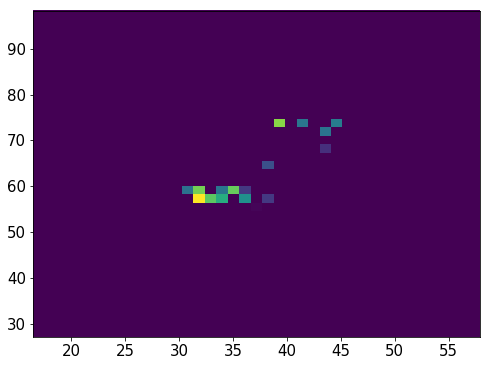

27108    34
27109    34
27110    34
27111    34
27112    34
27113    34
27114    34
27115    34
27116    34
27117    34
27118    34
27119    34
27120    34
27121    34
27122    34
27123    34
27124    34
27125    34
27126    34
27127    34
Name: Nsipm, dtype: uint16


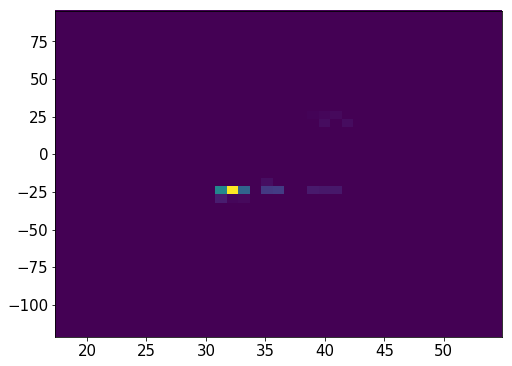

27131    26
27132    26
27133    26
27134    26
27135    26
27136    26
27137    26
27138    26
27139    26
27140    26
27141    26
27142    26
27143    26
27144    26
27145    26
27146    26
27147    26
27148    26
Name: Nsipm, dtype: uint16


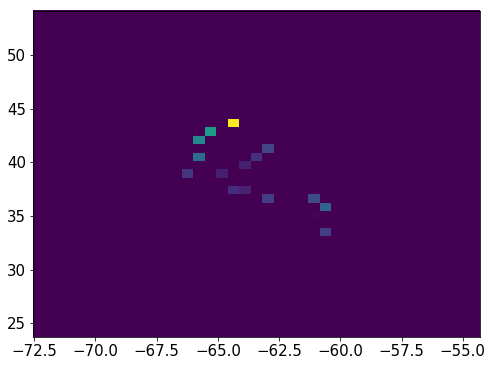

27152    22
27153    22
27154    22
27155    22
27156    22
27157    22
27158    22
27159    22
27160    22
27161    22
27162    22
27163    22
27164    22
27165    22
27166    22
Name: Nsipm, dtype: uint16


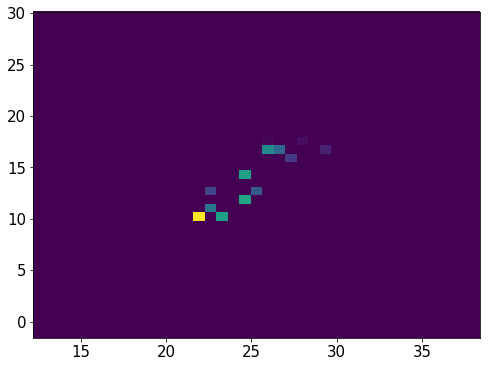

964144    34
964145    34
964146    34
964147    34
964148    34
964149    34
964150    34
964151    34
964152    34
964153    34
964154    34
964155    34
Name: Nsipm, dtype: uint16


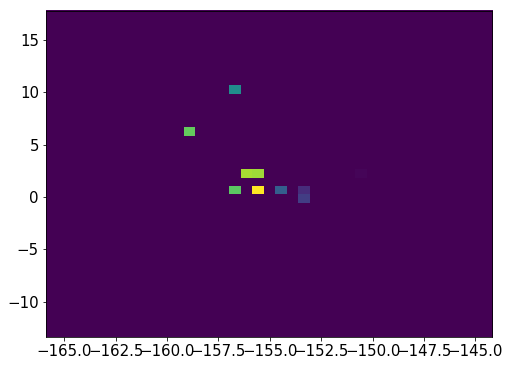

964161    21
964162    21
964163    21
964164    21
964165    21
964166    21
964167    21
964168    21
964169    21
964170    21
964171    21
964172    21
964173    21
964174    21
964175    21
964176    21
964177    21
964178    21
964179    21
964180    21
964181    21
964182    21
964183    21
964184    21
Name: Nsipm, dtype: uint16


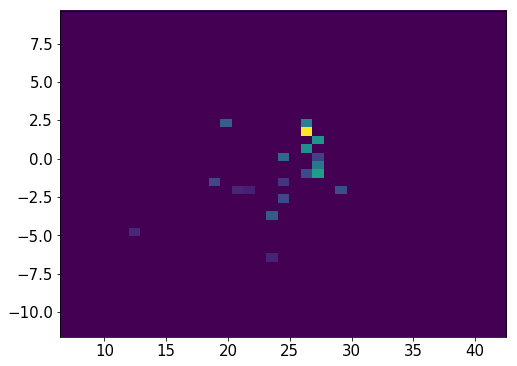

964191    24
964192    24
964193    24
964194    24
964195    24
964196    24
964197    24
964198    24
964199    24
964200    24
964201    24
964202    24
964203    24
964204    24
964205    24
964206    24
964207    24
964208    24
964209    24
964210    24
Name: Nsipm, dtype: uint16


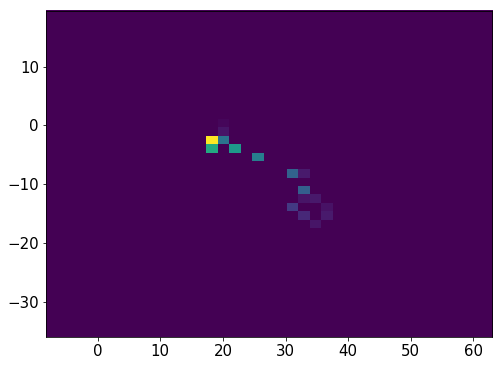

27172    25
27173    25
27174    25
27175    25
27176    25
27177    25
27178    25
27179    25
27180    25
27181    25
27182    25
27183    25
27184    25
27185    25
27186    25
27187    25
Name: Nsipm, dtype: uint16


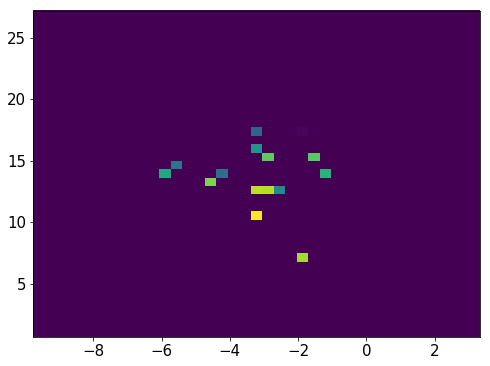

938222    29
938223    29
938224    29
938225    29
938226    29
938227    29
938228    29
938229    29
938230    29
938231    29
938232    29
938233    29
938234    29
938235    29
938236    29
938237    29
938238    29
938239    29
938240    29
938241    29
938242    29
938243    29
938244    29
938245    29
938246    29
938247    29
938248    29
938249    29
Name: Nsipm, dtype: uint16


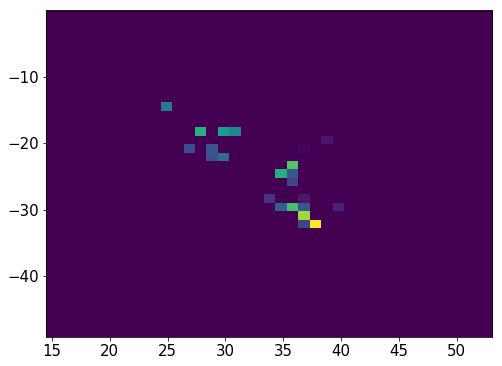

964232    23
964233    23
964234    23
964235    23
964236    23
964237    23
964238    23
964239    23
964240    23
964241    23
964242    23
964243    23
Name: Nsipm, dtype: uint16


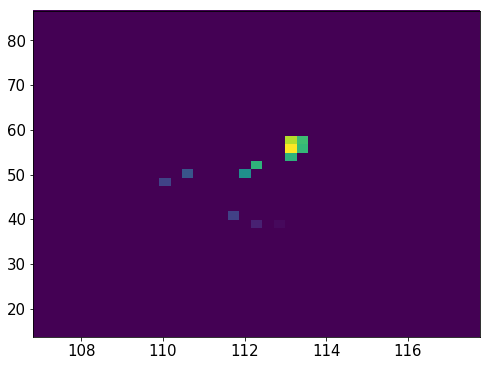

964248    27
964249    27
964250    27
964251    27
964252    27
964253    27
964254    27
964255    27
964256    27
964257    27
964258    27
964259    27
964260    27
964261    27
964262    27
964263    27
964264    27
964265    27
964266    27
Name: Nsipm, dtype: uint16


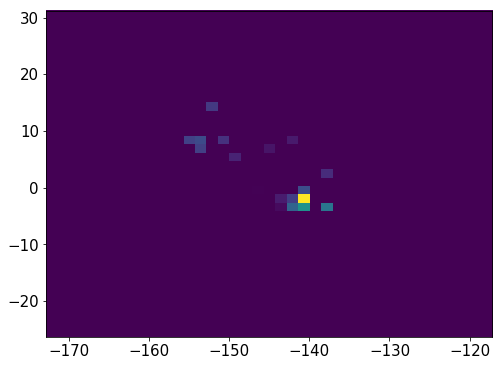

27192    25
27193    25
27194    25
27195    25
27196    25
27197    25
27198    25
27199    25
27200    25
27201    25
27202    25
27203    25
27204    25
27205    25
27206    25
27207    25
27208    25
27209    25
27210    25
27211    25
27212    25
27213    25
27214    25
27215    25
27216    25
Name: Nsipm, dtype: uint16


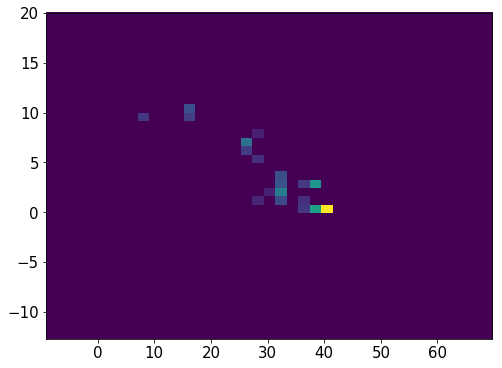

27231    35
27232    35
27233    35
27234    35
27235    35
27236    35
27237    35
27238    35
27239    35
27240    35
27241    35
27242    35
27250    35
27251    35
27252    35
27253    35
27254    35
27255    35
27256    35
27257    35
Name: Nsipm, dtype: uint16


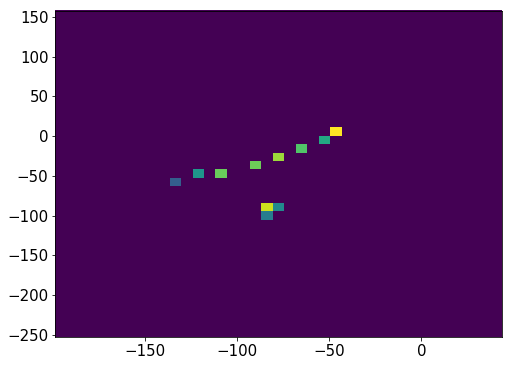

964271    28
964272    28
964273    28
964274    28
964275    28
964276    28
964277    28
964278    28
964279    28
964280    28
964281    28
964282    28
964283    28
964284    28
964285    28
964286    28
964287    28
964288    28
964289    28
964290    28
964291    28
Name: Nsipm, dtype: uint16


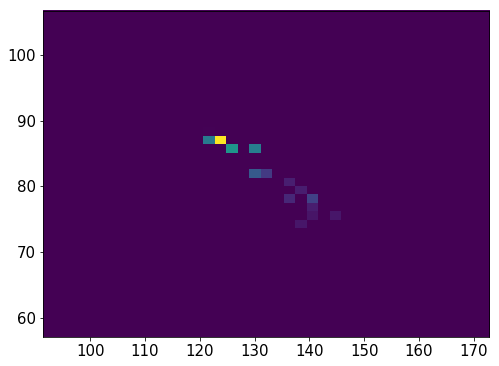

27258    25
27259    25
27260    25
27261    25
27262    25
27263    25
27264    25
27265    25
27266    25
27267    25
27268    25
27269    25
27270    25
27271    25
27272    25
27273    25
27274    25
27275    25
27276    25
27277    25
27278    25
27279    25
Name: Nsipm, dtype: uint16


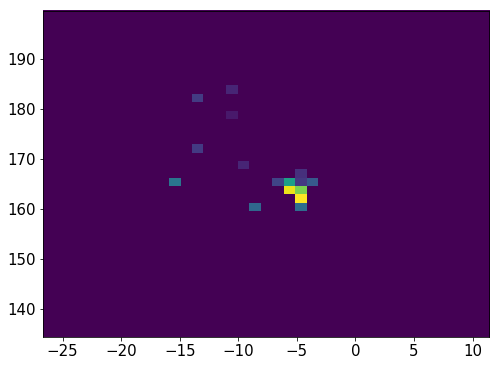

27284    31
27285    31
27286    31
27287    31
27288    31
27289    31
27290    31
27291    31
27292    31
27293    31
27294    31
27295    31
27296    31
27297    31
27298    31
27299    31
27300    31
27301    31
27302    31
27303    31
27304    31
27305    31
27306    31
27307    31
27308    31
27309    31
27310    31
27311    31
27312    31
27313    31
27314    31
27315    31
27316    31
27317    31
27318    31
27319    31
27321     6
27322     6
27323     6
27324     6
27325     6
27326     6
27327     6
27328     6
Name: Nsipm, dtype: uint16


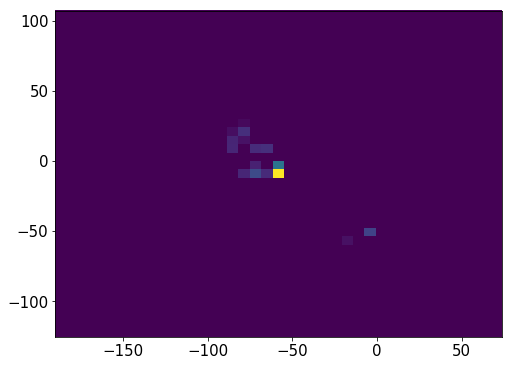

964296    44
964297    44
964298    44
964299    44
964300    44
964301    44
964302    44
964303    44
964304    44
964305    44
964306    44
964307    44
964308    44
964309    44
964310    44
964311    44
964312    44
964313    44
Name: Nsipm, dtype: uint16


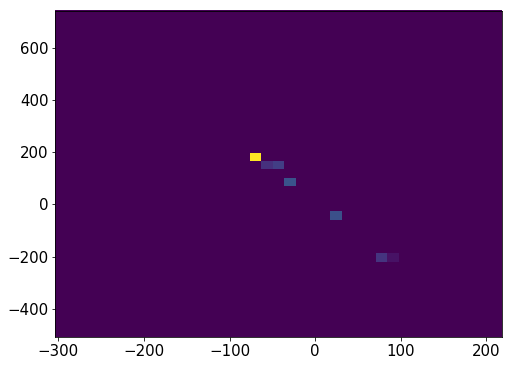

964317    35
964318    35
964319    35
964320    35
964321    35
964322    35
964323    35
964324    35
964325    35
964326    35
964327    35
964328    35
964329    35
964330    35
964331    35
964332    35
964333    35
964334    35
964335    35
964336    35
964337    35
964340    35
Name: Nsipm, dtype: uint16


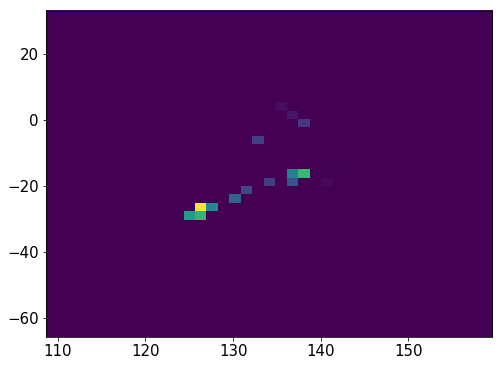

27335    23
27336    23
27337    23
27338    23
27339    23
27340    23
27341    23
27342    23
27343    23
27347     7
27348     7
27349     7
27350     7
27351     7
27352     7
27353     7
27357     1
27358     1
27359     1
27360     1
27361     1
Name: Nsipm, dtype: uint16


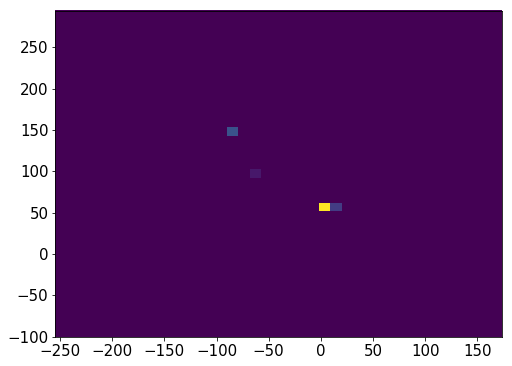

964368    27
964369    27
964370    27
964371    27
964372    27
964373    27
964374    27
964375    27
964376    27
964377    27
964378    27
964379    27
964380    27
964381    27
964382    27
964383    27
964384    27
964385    27
964386    27
Name: Nsipm, dtype: uint16


964391    33
964392    33
964393    33
964394    33
964395    33
964396    33
964397    33
964398    33
964399    33
964400    33
964401    33
964402    33
964403    33
964404    33
964405    33
964406    33
Name: Nsipm, dtype: uint16


27366    29
27367    29
27368    29
27369    29
27370    29
27371    29
27372    29
27373    29
27374    29
27375    29
27376    29
27377    29
27378    29
27379    29
27380    29
27384     3
27385     3
27386     3
Name: Nsipm, dtype: uint16


964411    20
964412    20
964413    20
964414    20
964415    20
964416    20
964417    20
964418    20
964419    20
964420    20
964421    20
964422    20
964423    20
964424    20
964425    20
964426    20
964427    20
964428    20
964429    20
Name: Nsipm, dtype: uint16


27389    27
27390    27
27391    27
27392    27
27393    27
27394    27
27395    27
27396    27
27397    27
27398    27
27399    27
27400    27
27401    27
27402    27
27403    27
27404    27
27405    27
27406    27
27407    27
Name: Nsipm, dtype: uint16


1918097    21
1918098    21
1918099    21
1918100    21
1918101    21
1918102    21
1918103    21
1918104    21
1918105    21
1918106    21
1918107    21
1918108    21
1918109    21
1918110    21
1918111    21
1918112    21
1918113    21
1918114    21
1918115    21
1918116    21
1918117    21
1918118    21
1918119    21
Name: Nsipm, dtype: uint16


27412    25
27413    25
27414    25
27415    25
27416    25
27417    25
27418    25
27419    25
27420    25
Name: Nsipm, dtype: uint16


964456    27
964457    27
964458    27
964459    27
964460    27
964461    27
964466     9
964467     9
964468     9
964469     9
964470     9
964471     9
964472     9
964473     9
964474     9
Name: Nsipm, dtype: uint16


964479    35
964480    35
964481    35
964482    35
964483    35
964484    35
964485    35
964486    35
964487    35
964488    35
964489    35
964490    35
964491    35
964492    35
964493    35
964494    35
Name: Nsipm, dtype: uint16


964499    28
964500    28
964501    28
964502    28
964503    28
964504    28
964505    28
964506    28
964507    28
964508    28
964509    28
964510    28
964514     3
964515     3
964516     3
964517     3
964518     3
964519     3
964520     3
964521     3
Name: Nsipm, dtype: uint16


27424    33
27425    33
27426    33
27427    33
27428    33
27429    33
27430    33
27431    33
27432    33
27433    33
27434    33
27435    33
27436    33
27437    33
27438    33
27439    33
27440    33
27441    33
27442    33
27443    33
27444    33
27445    33
Name: Nsipm, dtype: uint16


27451    30
27452    30
27453    30
27454    30
27455    30
27456    30
27457    30
27458    30
27459    30
27460    30
27461    30
27462    30
27463    30
27464    30
27465    30
27466    30
27467    30
27468    30
Name: Nsipm, dtype: uint16


27472    26
27473    26
27474    26
27475    26
27476    26
27477    26
27478    26
27479    26
27480    26
27481    26
27482    26
27483    26
27484    26
27485    26
27486    26
27487    26
27488    26
27489    26
27490    26
27491    26
27492    26
27493    26
Name: Nsipm, dtype: uint16


27497    37
27498    37
27499    37
27500    37
27501    37
27502    37
27503    37
27504    37
27505    37
27506    37
27507    37
27508    37
27509    37
27510    37
27511    37
Name: Nsipm, dtype: uint16


964545    27
964546    27
964547    27
964548    27
964549    27
964550    27
964551    27
964552    27
964553    27
964554    27
964555    27
964556    27
964557    27
964558    27
964559    27
964560    27
964561    27
964562    27
Name: Nsipm, dtype: uint16


27516    22
27517    22
27518    22
27519    22
27520    22
27521    22
27522    22
27523    22
27524    22
27525    22
27526    22
27527    22
27528    22
27529    22
27530    22
27531    22
27532    22
27533    22
27534    22
Name: Nsipm, dtype: uint16


27538    20
27539    20
27540    20
27541    20
27542    20
27543    20
27544    20
27545    20
27546    20
27547    20
27548    20
27549    20
27550    20
27551    20
27552    20
27553    20
27554    20
27555    20
27556    20
27557    20
27558    20
27559    20
27564     4
27565     4
27566     4
27567     4
27568     4
27569     4
27570     4
27571     4
Name: Nsipm, dtype: uint16


964595    29
964596    29
964597    29
964598    29
964599    29
964600    29
964601    29
964602    29
964603    29
964604    29
964605    29
964606    29
964607    29
964608    29
964609    29
Name: Nsipm, dtype: uint16


1667895    27
1667896    27
1667897    27
1667898    27
1667899    27
1667900    27
1667901    27
1667902    27
1667903    27
1667904    27
1667905    27
1667906    27
1667907    27
1667908    27
1667909    27
1667910    27
1667911    27
1667913    27
1667914    27
1667915    27
1667916    27
1667917    27
1667918    27
1667919    27
1667920    27
1667921    27
1667922    27
1667923    27
1667924    27
1667925    27
1667926    27
1667930    10
1667931    10
1667932    10
1667933    10
1667934    10
1667935    10
1667936    10
1667937    10
1667938    10
Name: Nsipm, dtype: uint16


27575    24
27576    24
27577    24
27582    24
27583    24
27584    24
27585    24
27586    24
27587    24
27588    24
27589    24
27590    24
27591    24
27592    24
27593    24
Name: Nsipm, dtype: uint16


27594    33
27595    33
27596    33
27597    33
27598    33
27599    33
27600    33
27601    33
27602    33
27603    33
27604    33
27605    33
27606    33
27607    33
Name: Nsipm, dtype: uint16


27611    23
27612    23
27613    23
27614    23
27615    23
27616    23
27617    23
27618    23
27619    23
27620    23
27621    23
27622    23
27623    23
27624    23
27625    23
27626    23
27627    23
27628    23
27629    23
27630    23
27631    23
27632    23
27633    23
27634    23
27635    23
27636    23
27637    23
27638    23
27639    23
27640    23
27641    23
27642    23
27643    23
27644    23
27645    23
27646    23
27647    23
27648    23
27649    23
27650    23
Name: Nsipm, dtype: uint16


27654    20
27655    20
27656    20
27657    20
27658    20
27659    20
27660    20
27661    20
27662    20
27667    12
27668    12
27669    12
27670    12
27671    12
27676     2
27677     2
27678     2
27679     2
Name: Nsipm, dtype: uint16


964655    22
964656    22
964657    22
964658    22
964659    22
964660    22
964661    22
964662    22
964663    22
964664    22
964665    22
964666    22
964667    22
964668    22
964669    22
964670    22
964671    22
964672    22
964673    22
964674    22
964675    22
Name: Nsipm, dtype: uint16


27684    24
27685    24
27686    24
27687    24
27688    24
27689    24
27690    24
27691    24
27692    24
27693    24
27694    24
27695    24
27696    24
27697    24
27698    24
27699    24
27700    24
27701    24
27702    24
27703    24
27704    24
27705    24
Name: Nsipm, dtype: uint16


964707    27
964708    27
964709    27
964710    27
964711    27
964712    27
964713    27
964714    27
964715    27
964716    27
964717    27
964718    27
964719    27
964720    27
964721    27
964722    27
964723    27
964725    27
Name: Nsipm, dtype: uint16


964730    30
964731    30
964732    30
964733    30
964734    30
964735    30
964736    30
964737    30
964738    30
964739    30
964740    30
964741    30
964742    30
964743    30
964744    30
964745    30
Name: Nsipm, dtype: uint16


27711    23
27712    23
27713    23
27714    23
27715    23
27716    23
27717    23
27718    23
27719    23
27720    23
27721    23
27722    23
27723    23
27724    23
27725    23
27726    23
27727    23
27728    23
27729    23
27730    23
27731    23
27732    23
Name: Nsipm, dtype: uint16


27737    23
27738    23
27739    23
27740    23
27741    23
27742    23
27743    23
27744    23
27745    23
27746    23
27747    23
27748    23
27749    23
27750    23
27751    23
27752    23
27753    23
27754    23
27755    23
27756    23
27757    23
27758    23
27759    23
27760    23
27761    23
27762    23
27763    23
Name: Nsipm, dtype: uint16


964750    27
964751    27
964752    27
964753    27
964754    27
964755    27
964756    27
964757    27
964758    27
964759    27
964760    27
964761    27
Name: Nsipm, dtype: uint16


964765    28
964766    28
964767    28
964768    28
964769    28
964770    28
964771    28
964772    28
964773    28
964774    28
964775    28
964776    28
Name: Nsipm, dtype: uint16


964781    24
964782    24
964783    24
964784    24
964785    24
964786    24
964787    24
964788    24
964789    24
964790    24
964791    24
964792    24
964793    24
964794    24
Name: Nsipm, dtype: uint16


27771    38
27772    38
27773    38
27774    38
27775    38
27776    38
27777    38
27778    38
27779    38
27780    38
27781    38
27782    38
27783    38
27784    38
27785    38
27786    38
27787    38
27788    38
27789    38
27790    38
Name: Nsipm, dtype: uint16


27795    20
27796    20
27797    20
27798    20
27799    20
27800    20
27801    20
27802    20
27803    20
27804    20
27805    20
27806    20
Name: Nsipm, dtype: uint16


27812    27
27813    27
27814    27
27815    27
27816    27
27817    27
27818    27
27819    27
27820    27
27821    27
27822    27
27823    27
27824    27
Name: Nsipm, dtype: uint16


964798    33
964799    33
964800    33
964801    33
964802    33
964803    33
964804    33
964805    33
964806    33
964807    33
964808    33
964809    33
964810    33
964811    33
964812    33
964813    33
964814    33
964815    33
964816    33
964817    33
Name: Nsipm, dtype: uint16


1667978    25
1667979    25
1667980    25
1667981    25
1667982    25
1667983    25
1667984    25
1667985    25
1667986    25
1667987    25
1667988    25
1667989    25
1667990    25
1667991    25
1668004     2
1668005     2
1668006     2
1668007     2
1668008     2
1668009     2
Name: Nsipm, dtype: uint16


27830    23
27831    23
27832    23
27833    23
27834    23
27835    23
27836    23
27837    23
27838    23
27839    23
27840    23
27841    23
27842    23
Name: Nsipm, dtype: uint16


27846    38
27847    38
27848    38
27849    38
27850    38
27851    38
27852    38
27853    38
27854    38
27855    38
27856    38
27857    38
27858    38
27859    38
27860    38
27861    38
27862    38
27863    38
27864    38
27865    38
Name: Nsipm, dtype: uint16


964847    34
964848    34
964849    34
964850    34
964851    34
964852    34
964853    34
964854    34
964855    34
964856    34
964857    34
964858    34
964859    34
964860    34
964861    34
964862    34
964863    34
964864    34
964865    34
Name: Nsipm, dtype: uint16


1668013    28
1668014    28
1668015    28
1668016    28
1668017    28
1668018    28
1668019    28
1668020    28
1668021    28
1668022    28
1668023    28
1668024    28
1668025    28
1668026    28
1668027    28
1668028    28
1668029    28
Name: Nsipm, dtype: uint16


27870    24
27871    24
27872    24
27873    24
27874    24
27875    24
27876    24
27881    24
27882    24
27883    24
27884    24
27885    17
27886    17
27887    17
27888    17
27889    17
27890    17
27891    17
27892    17
27893    17
27894    17
27895    17
27896    17
27897    17
Name: Nsipm, dtype: uint16


964870    27
964871    27
964872    27
964873    27
964874    27
964875    27
964876    27
964877    27
964878    27
964879    27
964880    27
964881    27
964882    27
964883    27
964884    27
964885    27
964886    27
Name: Nsipm, dtype: uint16


964890    22
964891    22
964892    22
964893    22
964894    22
964895    22
964896    22
964897    22
964898    22
964899    22
964900    22
964901    22
964907     5
964908     5
964909     5
964910     5
964911     5
964912     5
964913     5
964914     5
964915     5
Name: Nsipm, dtype: uint16


964923    26
964924    26
964925    26
964926    26
964927    26
964928    26
964929    26
964930    26
964931    26
964932    26
964933    26
964934    26
964935    26
964936    26
964937    26
964938    26
964939    26
964940    26
964941    26
964942    26
964943    26
964944    26
964945    26
964946    26
Name: Nsipm, dtype: uint16


27901    36
27902    36
27903    36
27904    36
27905    36
27906    36
27907    36
27908    36
27909    36
27910    36
27911    36
27912    36
27913    36
27914    36
27915    36
Name: Nsipm, dtype: uint16


27919    22
27920    22
27921    22
27922    22
27923    22
27924    22
27925    22
27926    22
27927    22
27928    22
27929    22
27930    22
27931    22
27932    22
27933    22
27934    22
27935    22
27936    22
Name: Nsipm, dtype: uint16


27942    18
27943    18
27944    18
27945    18
27946    18
27947    18
27948    18
27949    18
27950    18
27951    18
27952    18
27953    18
27954    18
27955    18
27956    18
27957    18
27958    18
Name: Nsipm, dtype: uint16


27963    21
27964    21
27965    21
27966    21
27967    21
27968    21
27969    21
27970    21
27971    21
27972    21
27973    21
27974    21
27975    21
27976    21
27977    21
27978    21
27979    21
27980    21
27981    21
27982    21
27983    21
27984    21
27985    21
27986    21
Name: Nsipm, dtype: uint16


964967    35
964968    35
964969    35
964970    35
964971    35
964972    35
964973    35
964974    35
964975    35
964976    35
964977    35
964978    35
964979    35
964980    35
964981    35
964982    35
964983    35
964984    35
Name: Nsipm, dtype: uint16


964988    23
964989    23
964990    23
964991    23
964992    23
964993    23
964994    23
964995    23
964996    23
964997    23
964998    23
964999    23
965000    23
965001    23
965002    23
965003    23
965006    23
965007    23
Name: Nsipm, dtype: uint16


27991    22
27992    22
27993    22
27994    22
27995    22
27996    22
27997    22
27998    22
27999    22
28000    22
28001    22
28002    22
28003    22
28004    22
28005    22
28006    22
28007    22
28008    22
28009    22
28010    22
28011    22
Name: Nsipm, dtype: uint16


965014    20
965015    20
965016    20
965017    20
965018    20
965019    20
965020    20
965021    20
965022    20
965023    20
965024    20
965025    20
965026    20
965027    20
965028    20
965029    20
Name: Nsipm, dtype: uint16


938389    28
938390    28
938391    28
938392    28
938393    28
938394    28
938395    28
938396    28
938397    28
938398    28
938399    28
938400    28
938401    28
938402    28
Name: Nsipm, dtype: uint16


965058    29
965059    29
965060    29
965061    29
965062    29
965063    29
965064    29
965065    29
965066    29
965067    29
965068    29
965069    29
965070    29
965071    29
965072    29
965073    29
965074    29
965075    29
965076    29
965077    29
965078    29
965079    29
Name: Nsipm, dtype: uint16


28017    21
28018    21
28019    21
28020    21
28021    21
28022    21
28023    21
28024    21
28025    21
28026    21
28027    21
28028    21
28029    21
28030    21
28031    21
28034    21
Name: Nsipm, dtype: uint16


28040    32
28041    32
28042    32
28043    32
28044    32
28045    32
28046    32
28047    32
28048    32
28049    32
28050    32
28051    32
28052    32
28053    32
28054    32
28055    32
28056    32
28057    32
28058    32
28059    32
28060    32
28061    32
Name: Nsipm, dtype: uint16


28067    19
28068    19
28069    19
28070    19
28071    19
28072    19
28073    19
28074    19
28075    19
28076    19
28077    19
28078    19
28079    19
Name: Nsipm, dtype: uint16


28083    36
28084    36
28085    36
28086    36
28087    36
28088    36
28089    36
28090    36
28091    36
28092    36
28093    36
28094    36
28095    36
Name: Nsipm, dtype: uint16


28099    32
28100    32
28101    32
28102    32
28103    32
28104    32
28105    32
28106    32
28107    32
28108    32
28109    32
28110    32
28111    32
28112    32
28113    32
28114    32
28115    32
28116    32
28117    32
Name: Nsipm, dtype: uint16


28123    23
28124    23
28125    23
28126    23
28127    23
28128    23
28129    23
28130    23
28131    23
28132    23
28133    23
28134    23
28135    23
28136    23
28137    23
28138    23
28139    23
28140    23
Name: Nsipm, dtype: uint16


965141    26
965142    26
965143    26
965144    26
965145    26
965146    26
965147    26
965148    26
965149    26
965150    26
965151    26
965152    26
965153    26
965154    26
965155    26
965156    26
965157    26
965158    26
965159    26
Name: Nsipm, dtype: uint16


28146    22
28147    22
28148    22
28149    22
28150    22
28151    22
28152    22
28153    22
28154    22
28155    22
28156    22
28157    22
28158    22
28159    22
28160    22
28161    22
28162    22
28163    22
28164    22
28165    22
28166    22
28167    22
28168    22
28172    22
28182     1
28183     1
28184     1
Name: Nsipm, dtype: uint16


28191    26
28192    26
28193    26
28194    26
28195    26
28196    26
28197    26
28198    26
28199    26
28200    26
28201    26
28202    26
28203    26
28204    26
28205    26
28206    26
28207    26
28208    26
28209    26
28210    26
28211    26
Name: Nsipm, dtype: uint16


965163    35
965164    35
965165    35
965166    35
965167    35
965168    35
965169    35
965170    35
965171    35
965172    35
965173    35
965174    35
965175    35
965176    35
965177    35
965178    35
965179    35
Name: Nsipm, dtype: uint16


965184    26
965185    26
965186    26
965187    26
965188    26
965189    26
965190    26
965191    26
965192    26
965193    26
965194    26
965195    26
965196    26
965197    26
965198    26
965199    26
965200    26
965201    26
965202    26
Name: Nsipm, dtype: uint16


965206    21
965207    21
965208    21
965209    21
965210    21
965211    21
965212    21
965213    21
965214    21
965215    21
965216    21
965222     5
965223     5
965224     5
965225     5
965226     5
965227     5
965228     5
965229     5
Name: Nsipm, dtype: uint16


965234    21
965235    21
965236    21
965237    21
965238    21
965239    21
965240    21
965241    21
965242    21
965243    21
965244    21
965245    21
965246    21
965247    21
965248    21
965249    21
965250    21
965251    21
965252    21
965253    21
965254    21
965255    21
965256    21
965257    21
965258    21
965265     1
965266     1
965267     1
965268     1
965269     1
Name: Nsipm, dtype: uint16


28216    25
28217    25
28218    25
28219    25
28220    25
28221    25
28222    25
28223    25
28224    25
28225    25
28226    25
28227    25
28228    25
28229    25
28230    25
28231    25
Name: Nsipm, dtype: uint16


965273    20
965274    20
965275    20
965276    20
965277    20
965278    20
965279    20
965280    20
965281    20
965282    20
965283    20
965284    20
965285    20
Name: Nsipm, dtype: uint16


965290    24
965291    24
965292    24
965293    24
965294    24
965295    24
965296    24
965297    24
965298    24
965299    24
965300    24
965301    24
965302    24
965303    24
965304    24
965305    24
965306    24
965307    24
965308    24
965309    24
965310    24
Name: Nsipm, dtype: uint16


28235    23
28236    23
28237    23
28238    23
28239    23
28240    23
28241    23
28242    23
28243    23
28244    23
28245    23
28246    23
28247    23
28248    23
28249    23
28250    23
28251    23
Name: Nsipm, dtype: uint16


28256    28
28257    28
28258    28
28259    28
28260    28
28261    28
28262    28
28263    28
28264    28
Name: Nsipm, dtype: uint16


965315    30
965316    30
965317    30
965318    30
965319    30
965320    30
965321    30
965322    30
965323    30
965324    30
965325    30
965326    30
965327    30
965328    30
965329    30
965330    30
965331    30
965332    30
Name: Nsipm, dtype: uint16


28269    31
28270    31
28271    31
28272    31
28273    31
28274    31
28275    31
28276    31
28277    31
28278    31
28279    31
28280    31
28281    31
28282    31
28283    31
28284    31
28285    31
28286    31
28287    31
28288    31
Name: Nsipm, dtype: uint16


28293    27
28294    27
28295    27
28296    27
28297    27
28298    27
28299    27
28300    27
28301    27
28302    27
28303    27
28304    27
28305    27
28306    27
28307    27
28308    27
28309    27
28310    27
28311    27
Name: Nsipm, dtype: uint16


28316    31
28317    31
28318    31
28319    31
28320    31
28321    31
28322    31
28323    31
28324    31
28325    31
28326    31
28327    31
28328    31
28329    31
28330    31
28331    31
28332    31
28333    31
28334    31
28335    31
28336    31
Name: Nsipm, dtype: uint16


28340    33
28341    33
28342    33
28343    33
28344    33
28345    33
28346    33
28347    33
28348    33
28349    33
28350    33
28351    33
28352    33
Name: Nsipm, dtype: uint16


938468    32
938469    32
938470    32
938471    32
938472    32
938473    32
938474    32
938475    32
938476    32
938477    32
938478    32
938479    32
938480    32
938481    32
938482    32
938483    32
938484    32
938485    32
938486    32
938487    32
Name: Nsipm, dtype: uint16


965366    21
965367    21
965368    21
965369    21
965370    21
965371    21
965372    21
965373    21
965374    21
965375    21
965376    21
965377    21
965378    21
965379    21
965380    21
965381    21
965382    21
965383    21
965384    21
965385    21
965386    21
965387    21
965388    21
Name: Nsipm, dtype: uint16


965394    29
965395    29
965396    29
965397    29
965398    29
965399    29
965400    29
965401    29
965402    29
965403    29
965404    29
965405    29
965406    29
965407    29
965408    29
965409    29
Name: Nsipm, dtype: uint16


965415    24
965416    24
965417    24
965418    24
965419    24
965420    24
965421    24
965422    24
965423    24
965424    24
965429    14
965430    14
965431    14
965432    14
965433    14
965434    14
965440    14
965441    14
965442    14
965443    14
965444    14
965445    14
965446    14
965447    14
965448    14
Name: Nsipm, dtype: uint16


965451    30
965452    30
965453    30
965454    30
965455    30
965456    30
965457    30
965458    30
965459    30
965460    30
965461    30
965462    30
965463    30
965464    30
965465    30
965466    30
965467    30
965468    30
965469    30
965470    30
965471    30
Name: Nsipm, dtype: uint16


28357    33
28358    33
28359    33
28360    33
28361    33
28362    33
28363    33
28364    33
28365    33
28366    33
Name: Nsipm, dtype: uint16


965475    22
965476    22
965477    22
965478    22
965479    22
965480    22
965481    22
965482    22
965483    22
965484    22
965485    22
965486    22
965487    22
965488    22
965489    22
965490    22
965491    22
965492    22
965493    22
965494    22
965495    22
965496    22
965497    22
965498    22
965504    27
965505    27
965506    27
965507    27
965508    27
965509    27
965510    27
965511    27
965512    27
965513    27
965514    27
965515    27
965516    27
965517    27
965518    27
965519    27
965520    27
965521    27
965522    27
965523    27
965524    27
Name: Nsipm, dtype: uint16


28371    24
28372    24
28373    24
28374    24
28375    24
28376    24
28377    24
28378    24
28379    24
28380    24
28381    24
28382    24
28383    24
28384    24
28385    24
28386    24
28387    24
28388    24
28389    24
28390    24
Name: Nsipm, dtype: uint16


965568    28
965569    28
965570    28
965571    28
965572    28
965573    28
965574    28
965575    28
965576    28
965577    28
965578    28
965579    28
965580    28
965581    28
965582    28
965583    28
965584    28
Name: Nsipm, dtype: uint16


28396    23
28397    23
28398    23
28399    23
28400    23
28401    23
28402    23
28403    23
28404    23
28405    23
28406    23
28407    23
28408    23
28409    23
28410    23
Name: Nsipm, dtype: uint16


965590    21
965591    21
965592    21
965593    21
965594    21
965595    21
965596    21
965597    21
965598    21
965599    21
965600    21
965601    21
965602    21
965603    21
965604    21
965605    21
965606    21
965607    21
965608    21
965609    21
965610    21
Name: Nsipm, dtype: uint16


28414    33
28415    33
28416    33
28417    33
28418    33
28419    33
28420    33
28421    33
28422    33
28423    33
28424    33
28425    33
28426    33
28427    33
Name: Nsipm, dtype: uint16


28432    18
28433    18
28434    18
28435    18
28436    18
28437    18
28438    18
28439    18
28440    18
28441    18
28442    18
28443    18
28444    18
28445    18
28446    18
28447    18
28448    18
28449    18
28450    18
28451    18
28452    18
28453    18
28454    18
28455    18
28456    18
Name: Nsipm, dtype: uint16


28460    31
28461    31
28462    31
28463    31
28464    31
28465    31
28466    31
28467    31
28468    31
28469    31
28470    31
28471    31
28472    31
28473    31
28474    31
28475    31
28476    31
28477    31
28478    31
Name: Nsipm, dtype: uint16


965616    26
965617    26
965618    26
965619    26
965620    26
965621    26
965622    26
965623    26
965624    26
965625    26
965626    26
965627    26
965628    26
965629    26
965630    26
965631    26
965632    26
965633    26
965634    26
965635    26
Name: Nsipm, dtype: uint16


965641    42
965642    42
965643    42
965644    42
965645    42
965646    42
965647    42
965648    42
965649    42
965650    42
965651    42
965652    42
965653    42
965654    42
965655    42
965656    42
965657    42
965658    42
965659    42
965660    42
965661    42
965662    42
Name: Nsipm, dtype: uint16


965666    28
965667    28
965668    28
965669    28
965670    28
965671    28
965672    28
965673    28
965674    28
965675    28
965676    28
965677    28
965678    28
Name: Nsipm, dtype: uint16


938563    25
938564    25
938565    25
938566    25
938567    25
938568    25
938569    25
938570    25
938571    25
938572    25
938573    25
938574    25
938575    25
938576    25
Name: Nsipm, dtype: uint16


965684    23
965685    23
965686    23
965687    23
965688    23
965689    23
965690    23
965691    23
965692    23
965693    23
965694    23
965695    23
965696    23
965697    23
965698    23
965699    23
965700    23
965701    23
Name: Nsipm, dtype: uint16


28484    24
28485    24
28486    24
28487    24
28488    24
28489    24
28490    24
28491    24
28492    24
28493    24
28494    24
28495    24
28496    24
28497    24
28498    24
28499    24
28500    24
28501    24
28502    24
28503    24
Name: Nsipm, dtype: uint16


965706    19
965707    19
965708    19
965709    19
965710    19
965711    19
965712    19
965713    19
965714    19
965715    19
965716    19
965717    19
965718    19
965719    19
965720    19
965721    19
965722    19
965723    19
965724    19
Name: Nsipm, dtype: uint16


28509    19
28510    19
28511    19
28512    19
28513    19
28514    19
28515    19
28516    19
28517    19
28518    19
28519    19
28520    19
28521    19
28522    19
Name: Nsipm, dtype: uint16


965757    38
965758    38
965759    38
965760    38
965761    38
965762    38
965763    38
965764    38
965765    38
965766    38
965767    38
965768    38
Name: Nsipm, dtype: uint16


938580    27
938581    27
938582    27
938583    27
938584    27
938585    27
938586    27
938587    27
Name: Nsipm, dtype: uint16


28528    25
28529    25
28530    25
28531    25
28532    25
28533    25
28534    25
28535    25
28536    25
28537    25
28538    25
28539    25
28540    25
28541    25
28542    25
28543    25
28544    25
28545    25
28546    25
28547    25
Name: Nsipm, dtype: uint16


1668160    23
1668161    23
1668162    23
1668163    23
1668164    23
1668165    23
1668166    23
1668167    23
1668168    23
1668169    23
1668170    23
1668171    23
1668172    23
1668173    23
Name: Nsipm, dtype: uint16


28552    24
28553    24
28554    24
28555    24
28556    24
28557    24
28558    24
28559    24
28560    24
28561    24
28562    24
28563    24
28564    24
28565    24
28566    24
28567    24
28568    24
28569    24
Name: Nsipm, dtype: uint16


28574    25
28575    25
28576    25
28577    25
28578    25
28579    25
28580    25
28581    25
28582    25
28583    25
28584    25
28585    25
28586    25
28587    25
28588    25
28589    25
28590    25
28591    25
28592    25
28593    25
28594    25
Name: Nsipm, dtype: uint16


965789    20
965790    20
965791    20
965792    20
965793    20
965794    20
965795    20
965796    20
965797    20
965798    20
965799    20
965800    20
965801    20
965802    20
965803    20
965804    20
965805    20
965806    20
965807    20
965808    20
965809    20
Name: Nsipm, dtype: uint16


1668178    23
1668179    23
1668180    23
1668181    23
1668182    23
1668183    23
1668184    23
1668185    23
1668186    23
1668187    23
1668188    23
1668189    23
1668190    23
1668191    23
1668192    23
1668193    23
1668194    23
1668195    23
1668196    23
1668197    23
1668198    23
1668199    23
1668200    23
1668201    23
1668202    23
1668203    23
1668204    23
1668205    23
1668206    23
1668207    23
1668208    23
1668209    23
1668210    23
Name: Nsipm, dtype: uint16


965816    32
965817    32
965818    32
965819    32
965820    32
965821    32
965822    32
965823    32
965824    32
965825    32
965826    32
965827    32
965828    32
965829    32
965830    32
965831    32
Name: Nsipm, dtype: uint16


28598    46
28599    46
28600    46
28601    46
28602    46
28603    46
28604    46
28605    46
28606    46
28607    46
28608    46
28609    46
28610    46
28611    46
28612    46
28613    46
28614    46
Name: Nsipm, dtype: uint16


965837    19
965838    19
965839    19
965840    19
965841    19
965842    19
965843    19
965844    19
965845    19
965846    19
965847    19
965848    19
965849    19
965850    19
965851    19
965852    19
965853    19
965854    19
Name: Nsipm, dtype: uint16


28618    22
28619    22
28620    22
28621    22
28622    22
28623    22
28624    22
28625    22
28626    22
28627    22
28628    22
28629    22
28630    22
28631    22
28632    22
28633    22
28635    22
28636    22
28637    22
28638    22
28639    22
28640    22
28641    22
Name: Nsipm, dtype: uint16


28646    21
28647    21
28648    21
28649    21
28650    21
28651    21
28652    21
28653    21
28654    21
28655    21
28656    21
28657    21
28658    21
28659    21
28660    21
28661    21
28662    21
28663    21
28664    21
28665    21
28666    21
28667    21
28668    21
28669    21
28670    21
28671    21
28672    21
Name: Nsipm, dtype: uint16


28678    24
28679    24
28680    24
28681    24
28682    24
28683    24
28684    24
28685    24
28686    24
28687    24
28688    24
28689    24
28690    24
28691    24
28692    24
28693    24
28694    24
28695    24
28696    24
28697    24
28698    24
28699    24
Name: Nsipm, dtype: uint16


28705    32
28706    32
28707    32
28708    32
28709    32
28710    32
28711    32
28712    32
28713    32
28714    32
28715    32
28716    32
Name: Nsipm, dtype: uint16


965894    36
965895    36
965896    36
965897    36
965898    36
965899    36
965900    36
965901    36
965902    36
965903    36
965904    36
965905    36
965906    36
965907    36
965911    36
965912    36
965913    36
965914    36
965915    36
Name: Nsipm, dtype: uint16


28723    28
28724    28
28725    28
28726    28
28727    28
28728    28
28729    28
28730    28
28731    28
28732    28
28733    28
28734    28
28736    28
28737    28
28738    28
28739    28
28740    28
28741    28
28742    28
Name: Nsipm, dtype: uint16


28748    29
28749    29
28750    29
28751    29
28752    29
28753    29
28754    29
28755    29
28756    29
28757    29
28758    29
28759    29
28760    29
28761    29
28762    29
28763    29
Name: Nsipm, dtype: uint16


28768    34
28769    34
28770    34
28771    34
28772    34
28773    34
28774    34
28775    34
28776    34
28777    34
28778    34
28779    34
28780    34
28781    34
28782    34
28783    34
28784    34
28785    34
28786    34
28787    34
28788    34
Name: Nsipm, dtype: uint16


28792    28
28793    28
28794    28
28795    28
28796    28
28797    28
28798    28
28799    28
28800    28
28801    28
28802    28
28803    28
28804    28
28805    28
28806    28
28807    28
28808    28
Name: Nsipm, dtype: uint16


28814    22
28815    22
28816    22
28817    22
28818    22
28819    22
28820    22
28821    22
28822    22
28823    22
28824    22
28825    22
28826    22
28827    22
28828    22
28829    22
28830    22
28831    22
28832    22
28833    22
Name: Nsipm, dtype: uint16


965949    27
965950    27
965951    27
965952    27
965953    27
965954    27
965955    27
965956    27
965957    27
965958    27
965959    27
965960    27
Name: Nsipm, dtype: uint16


1918460    31
1918461    31
1918462    31
1918463    31
1918464    31
1918465    31
1918466    31
1918467    31
1918468    31
1918469    31
1918470    31
1918471    31
1918473    31
1918474    31
1918475    31
1918479     2
1918480     2
1918481     2
1918482     2
1918483     2
1918484     2
Name: Nsipm, dtype: uint16


28838    27
28839    27
28840    27
28841    27
28842    27
28843    27
28844    27
28845    27
28846    27
28847    27
28848    27
28849    27
28850    27
Name: Nsipm, dtype: uint16


28854    22
28855    22
28856    22
28857    22
28858    22
28859    22
28860    22
28861    22
28862    22
28863    22
28864    22
28865    22
28866    22
28867    22
28868    22
28869    22
28870    22
28871    22
28872    22
28873    22
28874    22
28875    22
28876    22
28877    22
28878    22
28879    22
28880    22
28881    22
28883    22
28885    22
28886    22
28887    22
28888    22
28889    22
28890    22
28891    22
28892    22
28893    22
Name: Nsipm, dtype: uint16


966006    20
966007    20
966008    20
966009    20
966010    20
966011    20
966012    20
966013    20
966014    20
966015    20
966016    20
966017    20
966018    20
Name: Nsipm, dtype: uint16


966023    23
966024    23
966025    23
966026    23
966027    23
966028    23
966029    23
966030    23
966031    23
966032    23
966033    23
966034    23
966035    23
966036    23
966037    23
966038    23
966039    23
966040    23
966041    23
966042    23
966043    23
966044    23
966045    23
966046    23
966047    23
966048    23
966049    23
966050    23
966051    23
966052    23
966053    23
966054    23
Name: Nsipm, dtype: uint16


28898    23
28899    23
28900    23
28901    23
28902    23
28903    23
28904    23
28905    23
28906    23
28907    23
28908    23
28909    23
28910    23
28911    23
Name: Nsipm, dtype: uint16


28916    28
28917    28
28918    28
28919    28
28920    28
28921    28
28922    28
28923    28
28924    28
28925    28
28926    28
28927    28
Name: Nsipm, dtype: uint16


966086    31
966087    31
966088    31
966089    31
966090    31
966091    31
966092    31
966093    31
966094    31
966095    31
966096    31
966097    31
966098    31
966099    31
966100    31
966101    31
Name: Nsipm, dtype: uint16


28932    26
28933    26
28934    26
28935    26
28936    26
28937    26
28938    26
28939    26
28940    26
28941    26
28942    26
28943    26
28944    26
28945    26
28946    26
28947    26
Name: Nsipm, dtype: uint16


966108    21
966109    21
966110    21
966111    21
966112    21
966113    21
966114    21
966115    21
966116    21
966117    21
966118    21
966119    21
966120    21
966121    21
966122    21
966123    21
966124    21
966125    21
966126    21
966127    21
966128    21
966129    21
966130    21
966131    21
Name: Nsipm, dtype: uint16


28953    21
28954    21
28955    21
28956    21
28957    21
28958    21
28959    21
28960    21
28961    21
28962    21
28963    21
28964    21
28965    21
28966    21
28967    21
28968    21
28969    21
28970    21
28971    21
28972    21
Name: Nsipm, dtype: uint16


966136    22
966137    22
966138    22
966139    22
966140    22
966141    22
966142    22
966143    22
966144    22
966145    22
966146    22
966147    22
966148    22
966149    22
966150    22
966151    22
Name: Nsipm, dtype: uint16


28977    51
28978    51
28979    51
28980    51
28981    51
28982    51
28983    51
28984    51
28985    51
28986    51
28987    51
28988    51
28989    51
28990    51
28991    51
28992    51
28993    51
28994    51
28995    51
28996    51
28997    51
28998    51
28999    51
29000    51
Name: Nsipm, dtype: uint16


966157    36
966158    36
966159    36
966160    36
966161    36
966162    36
966163    36
966164    36
966165    36
966166    36
966167    36
966168    36
966169    36
966170    36
966171    36
966172    36
966173    36
966174    36
966175    36
966176    36
Name: Nsipm, dtype: uint16


29004    28
29005    28
29006    28
29007    28
29008    28
29009    28
29010    28
29011    28
29012    28
29013    28
29014    28
29015    28
29016    28
29022    28
29023    28
29024    28
29025    28
29026    28
29027    28
29028    28
29029    28
29030    28
29031    28
29032    28
29034     8
29035     8
29036     8
29037     8
29038     8
29039     8
29040     8
29041     8
29042     8
29043     8
29044     8
Name: Nsipm, dtype: uint16


966181    35
966182    35
966183    35
966184    35
966185    35
966186    35
966187    35
966188    35
Name: Nsipm, dtype: uint16


29049    20
29050    20
29051    20
29052    20
29053    20
29054    20
29055    20
29056    20
29057    20
29058    20
29059    20
29060    20
29061    20
29062    20
29063    20
29064    20
29065    20
29066    20
29067    20
29068    20
29069    20
29070    20
29071    20
29072    20
29073    20
Name: Nsipm, dtype: uint16


966218    32
966219    32
966220    32
966221    32
966222    32
966223    32
966224    32
966225    32
966226    32
966227    32
966228    32
966229    32
966230    32
966231    32
966232    32
966233    32
Name: Nsipm, dtype: uint16


29078    25
29079    25
29080    25
29081    25
29082    25
29083    25
29084    25
29085    25
29086    25
29087    25
29088    25
29089    25
29090    25
29091    25
29092    25
Name: Nsipm, dtype: uint16


966258    23
966259    23
966260    23
966261    23
966262    23
966263    23
966264    23
966265    23
966266    23
966267    23
966268    23
966269    23
966270    23
Name: Nsipm, dtype: uint16


966275    26
966276    26
966277    26
966278    26
966279    26
966280    26
966281    26
966282    26
966283    26
966284    26
966285    26
966286    26
966287    26
966288    26
966289    26
966290    26
966291    26
966292    26
966293    26
966294    26
966295    26
Name: Nsipm, dtype: uint16


29098    29
29099    29
29100    29
29101    29
29102    29
29103    29
29104    29
29105    29
29106    29
29107    29
29108    29
29109    29
29111    29
29112    29
29113    29
29114    29
29115    29
29116    29
29117    29
29118    29
29119    29
29120    29
29121    29
29122    29
Name: Nsipm, dtype: uint16


966324    33
966325    33
966326    33
966327    33
966328    33
966329    33
966330    33
966331    33
966332    33
966333    33
966334    33
966335    33
966336    33
966337    33
966338    33
966339    33
966340    33
966341    33
Name: Nsipm, dtype: uint16


29127    77
29128    77
29129    77
29130    77
29131    77
29132    77
29133    77
29134    77
29135    77
29136    77
29137    77
29138    77
29139    77
29140    77
29141    77
29142    77
29143    77
29144    77
29145    77
29146    77
29147    77
29148    77
29149    77
29150    77
29151    77
29152    77
29153    77
29154    77
29155    77
29156    77
29157    77
29158    77
Name: Nsipm, dtype: uint16


29163    27
29164    27
29165    27
29166    27
29167    27
29168    27
29169    27
29170    27
29171    27
29172    27
29173    27
29174    27
29175    27
29176    27
29177    27
Name: Nsipm, dtype: uint16


1899054    34
1899055    34
1899056    34
1899057    34
1899058    34
1899059    34
1899060    34
1899061    34
1899062    34
1899063    34
1899064    34
1899065    34
1899066    34
1899067    34
1899068    34
1899075     2
1899076     2
1899077     2
1899078     2
1899079     2
Name: Nsipm, dtype: uint16


966383    56
966384    56
966385    56
966386    56
966387    56
966388    56
966389    56
966390    56
966391    56
966392    56
966393    56
966394    56
966395    56
966396    56
966397    56
966398    56
966399    56
966400    56
966401    56
966402    56
966403    56
966404    56
966405    56
966406    56
966407    56
966408    56
966409    56
966410    56
966411    56
966412    56
966413    56
966414    56
966415    56
966416    56
966417    56
966418    56
966419    56
966420    56
Name: Nsipm, dtype: uint16


966421    37
966422    37
966423    37
966424    37
966425    37
966426    37
966427    37
966428    37
966429    37
966430    37
966431    37
966432    37
966433    37
966434    37
966438    37
966439    37
966440    37
966441    37
966442    37
966443    37
966444    37
966445    37
966451    37
966452    37
966453    37
966454    37
966455    37
966456    37
966457    37
966458    37
966459    37
966460    37
Name: Nsipm, dtype: uint16


966463    26
966464    26
966465    26
966466    26
966467    26
966468    26
966469    26
966470    26
966471    26
966472    26
966473    26
966474    26
966475    26
966476    26
966477    26
966478    26
966479    26
Name: Nsipm, dtype: uint16


966485    40
966486    40
966487    40
966488    40
966489    40
966490    40
966491    40
966492    40
966493    40
966494    40
966495    40
966496    40
966497    40
966498    40
966499    40
966500    40
966501    40
966502    40
966503    40
966504    40
966505    40
966506    40
966507    40
Name: Nsipm, dtype: uint16


966508    22
966509    22
966510    22
966511    22
966512    22
966513    22
966514    22
966515    22
966516    22
966517    22
966518    22
966519    22
966520    22
966521    22
966522    22
966523    22
966524    22
966525    22
966526    22
966527    22
966528    22
966529    22
966530    22
966531    22
Name: Nsipm, dtype: uint16


966537    37
966538    37
966539    37
966540    37
966541    37
966542    37
966543    37
966544    37
966545    37
966546    37
966547    37
966548    37
966549    37
966550    37
Name: Nsipm, dtype: uint16


966554    23
966555    23
966556    23
966557    23
966558    23
966559    23
966560    23
966561    23
966562    23
966563    23
966569     5
966570     5
966571     5
966572     5
966573     5
966574     5
Name: Nsipm, dtype: uint16


966592    22
966593    22
966594    22
966595    22
966599    22
966600    22
966601    22
966602    22
966603    22
966604    22
966605    22
966606    22
966607    22
966608    22
966609    22
966610    22
966611    22
966612    22
966613    22
966614    22
966615    22
966616    22
966617    22
966618    22
Name: Nsipm, dtype: uint16


2273817    21
2273818    21
2273819    21
2273820    21
2273821    21
2273822    21
2273823    21
2273824    21
2273825    21
2273826    21
2273827    21
2273828    21
2273829    21
2273830    21
Name: Nsipm, dtype: uint16


29183    32
29184    32
29185    32
29186    32
29187    32
29188    32
29189    32
29190    32
29191    32
29192    32
29193    32
29194    32
29195    32
29196    32
29197    32
29198    32
29199    32
29200    32
29201    32
29202    32
Name: Nsipm, dtype: uint16


29207    26
29208    26
29209    26
29210    26
29211    26
29212    26
29213    26
29214    26
29215    26
29216    26
29217    26
29218    26
29219    26
29220    26
29221    26
29222    26
Name: Nsipm, dtype: uint16


966638    37
966639    37
966640    37
966641    37
966642    37
966643    37
966644    37
966645    37
966646    37
966647    37
966648    37
966649    37
966650    37
966651    37
966652    37
966653    37
966654    37
966655    37
966656    37
966657    37
Name: Nsipm, dtype: uint16


29227    28
29228    28
29229    28
29230    28
29231    28
29232    28
29233    28
29234    28
29235    28
29236    28
29237    28
29238    28
29239    28
29240    28
29241    28
29242    28
29243    28
29244    28
Name: Nsipm, dtype: uint16


966661    21
966662    21
966663    21
966664    21
966665    21
966666    21
966667    21
966668    21
966669    21
966670    21
966671    21
966672    21
Name: Nsipm, dtype: uint16


29251    27
29252    27
29253    27
29254    27
29255    27
29256    27
29257    27
29258    27
29259    27
29260    27
29261    27
29262    27
29263    27
29264    27
Name: Nsipm, dtype: uint16


966682    22
966683    22
966684    22
966685    22
966686    22
966687    22
966688    22
966689    22
966690    22
Name: Nsipm, dtype: uint16


29268    27
29269    27
29270    27
29271    27
29272    27
29273    27
29274    27
29275    27
29276    27
29277    27
29278    27
29279    27
29280    27
29281    27
29282    27
29283    27
29284    27
29285    27
29286    27
29287    27
Name: Nsipm, dtype: uint16


966692    22
966693    22
966694    22
966695    22
966696    22
966697    22
966698    22
966699    22
966700    22
966701    22
966702    22
966708    10
966709    10
966710    10
966711    10
966712    10
966713    10
966714    10
966715    10
966716    10
966717    10
966718    10
Name: Nsipm, dtype: uint16


966724    35
966725    35
966726    35
966727    35
966728    35
966729    35
966730    35
966731    35
966732    35
966733    35
966734    35
966735    35
Name: Nsipm, dtype: uint16


966740    28
966741    28
966742    28
966743    28
966744    28
966745    28
966746    28
966747    28
966748    28
966749    28
966750    28
966751    28
966752    28
966753    28
966754    28
966755    28
966756    28
966757    28
966758    28
966759    28
966760    28
966761    28
966762    28
Name: Nsipm, dtype: uint16


29289    21
29290    21
29291    21
29292    21
29293    21
29294    21
29295    21
29296    21
29297    21
29298    21
29299    21
29300    21
29301    21
29302    21
29303    21
29304    21
29305    21
29306    21
Name: Nsipm, dtype: uint16


2273835    18
2273836    18
2273837    18
2273838    18
2273839    18
2273840    18
2273841    18
2273842    18
2273843    18
2273844    18
2273845    18
2273846    18
2273847    18
2273848    18
2273849    18
2273850    18
2273851    18
2273852    18
2273853    18
2273857     3
2273858     3
2273859     3
2273860     3
2273861     3
2273862     3
2273863     3
2273864     3
2273865     3
Name: Nsipm, dtype: uint16


29311    20
29312    20
29313    20
29314    20
29318    20
29319    20
29320    20
29321    20
29322    20
29323    20
29324    20
29325    20
29326    20
29327    20
29328    20
29329    20
29330    20
29331    20
29332    20
29334     9
29335     9
29336     9
29337     9
29338     9
29339     9
29340     9
29341     9
Name: Nsipm, dtype: uint16


29345    42
29346    42
29347    42
29348    42
29349    42
29350    42
29351    42
29352    42
29353    42
29354    42
29355    42
29356    42
29357    42
29358    42
29359    42
29360    42
29361    42
29362    42
Name: Nsipm, dtype: uint16


29366    32
29367    32
29368    32
29369    32
29370    32
29371    32
29372    32
29373    32
29374    32
29375    32
29376    32
29377    32
29378    32
29383    32
29384    32
29385    32
29386    32
Name: Nsipm, dtype: uint16


966816    35
966817    35
966818    35
966819    35
966820    35
966821    35
966822    35
966823    35
966824    35
966825    35
966826    35
966827    35
966828    35
966829    35
966830    35
Name: Nsipm, dtype: uint16


966835    23
966836    23
966837    23
966838    23
966839    23
966840    23
966841    23
966842    23
966843    23
966844    23
966845    23
966846    23
966847    23
966848    23
966849    23
966850    23
966851    23
966852    23
966853    23
966854    23
966855    23
Name: Nsipm, dtype: uint16


966860    31
966861    31
966862    31
966863    31
966864    31
966865    31
966866    31
966867    31
966868    31
966869    31
966870    31
966871    31
966872    31
Name: Nsipm, dtype: uint16


966876    20
966877    20
966878    20
966879    20
966880    20
966884    20
966885    20
966886    20
966887    20
966888    20
966889    20
966890    20
966891    20
966892    20
966893    20
966894    20
966895    20
966896    20
966897    20
966898    20
966899    20
966900    20
966901    20
Name: Nsipm, dtype: uint16


966902    23
966903    23
966904    23
966905    23
966906    23
966907    23
966908    23
966909    23
966910    23
966911    23
966912    23
966913    23
966914    23
966915    23
966916    23
966917    23
966920    23
966921    23
966922    23
966925    23
966926    23
966927    23
966928    23
966929    23
966930    23
966931    23
966932    23
966933    23
966934    23
966935    23
966936    23
966937    23
966938    23
966939    23
966940    23
966941    23
966942    23
Name: Nsipm, dtype: uint16


29417    21
29418    21
29419    21
29420    21
29421    21
29422    21
29423    21
29424    21
29425    21
29426    21
29433     2
29434     2
29435     2
29436     2
29437     2
Name: Nsipm, dtype: uint16


966949    31
966950    31
966951    31
966952    31
966953    31
966954    31
966955    31
966956    31
966957    31
966958    31
966959    31
966960    31
966961    31
966962    31
966963    31
966964    31
966965    31
966966    31
966967    31
966968    31
966969    31
966970    31
966971    31
966972    31
966973    31
966974    31
966975    31
966976    31
966977    31
966978    31
966979    31
966980    31
966981    31
966982    31
966983    31
966984    31
966990     1
966991     1
966992     1
Name: Nsipm, dtype: uint16


966998    26
966999    26
967000    26
967001    26
967002    26
967003    26
967004    26
967005    26
967006    26
967007    26
967008    26
967009    26
967010    26
967011    26
967012    26
967013    26
967014    26
967015    26
967016    26
967017    26
967018    26
967019    26
967020    26
967021    26
967022    26
967023    26
967024    26
967025    26
967026    26
967027    26
Name: Nsipm, dtype: uint16


29462    28
29463    28
29464    28
29465    28
29466    28
29467    28
29468    28
29469    28
29470    28
29471    28
29472    28
29473    28
29474    28
29475    28
29476    28
29477    28
29478    28
Name: Nsipm, dtype: uint16


29483    26
29484    26
29485    26
29486    26
29487    26
29488    26
29489    26
29490    26
29491    26
29492    26
29493    26
29494    26
29495    26
29496    26
Name: Nsipm, dtype: uint16


29502    37
29503    37
29504    37
29505    37
29506    37
29507    37
29508    37
29509    37
29510    37
29511    37
29512    37
29513    37
29514    37
29515    37
29516    37
29517    37
29518    37
29519    37
29520    37
29521    37
29522    37
29523    37
29524    37
29525    37
29526    37
Name: Nsipm, dtype: uint16


29527    23
29528    23
29529    23
29530    23
29531    23
29532    23
29533    23
29534    23
29535    23
29536    23
29537    23
29538    23
29539    23
29540    23
29541    23
29542    23
29543    23
Name: Nsipm, dtype: uint16


29549    22
29550    22
29551    22
29552    22
29553    22
29554    22
29555    22
29556    22
29557    22
29558    22
29559    22
29560    22
29561    22
29562    22
29563    22
29564    22
29565    22
29566    22
Name: Nsipm, dtype: uint16


967109    28
967110    28
967111    28
967112    28
967113    28
967114    28
967115    28
967116    28
967117    28
967118    28
967119    28
967120    28
967121    28
967122    28
967123    28
967124    28
967125    28
967126    28
967127    28
Name: Nsipm, dtype: uint16


29571    28
29572    28
29573    28
29574    28
29575    28
29576    28
29577    28
29578    28
29579    28
29580    28
29581    28
29582    28
29583    28
29584    28
29585    28
29586    28
29587    28
29588    28
Name: Nsipm, dtype: uint16


29594    37
29595    37
29596    37
29597    37
29598    37
29599    37
29600    37
29601    37
29602    37
29603    37
29604    37
29605    37
29606    37
29607    37
29608    37
29609    37
29610    37
29611    37
29612    37
29613    37
29614    37
29615    37
29616    37
29617    37
29618    37
29619    37
29620    37
29621    37
29622    37
Name: Nsipm, dtype: uint16


29626    33
29627    33
29628    33
29629    33
29630    33
29631    33
29632    33
29633    33
29634    33
29635    33
29636    33
29637    33
29638    33
29639    33
29640    33
29641    33
29642    33
29643    33
29644    33
29645    33
Name: Nsipm, dtype: uint16


938733    21
938734    21
938735    21
938736    21
938737    21
938738    21
938739    21
938740    21
938741    21
938742    21
938743    21
938744    21
938745    21
938746    21
938747    21
938748    21
938749    21
938750    21
938751    21
938752    21
938753    21
938754    21
938755    21
938756    21
938757    21
938758    21
Name: Nsipm, dtype: uint16


967175    38
967176    38
967177    38
967178    38
967179    38
967180    38
967181    38
967182    38
967183    38
967184    38
967185    38
967186    38
967187    38
967188    38
Name: Nsipm, dtype: uint16


967192    24
967193    24
967194    24
967195    24
967196    24
967197    24
967198    24
967199    24
967200    24
967201    24
967202    24
967203    24
967204    24
967205    24
967206    24
967207    24
967208    24
967209    24
Name: Nsipm, dtype: uint16


29673    19
29674    19
29675    19
29676    19
29677    19
29678    19
29679    19
29680    19
29681    19
29682    19
29683    19
29684    19
29685    19
29686    19
29687    19
Name: Nsipm, dtype: uint16


967213    17
967214    17
967215    17
967216    17
967217    17
967218    17
967219    17
967220    17
967221    17
967222    17
967223    17
967224    17
967225    17
967226    17
967227    17
967228    17
967229    17
967230    17
Name: Nsipm, dtype: uint16


967234    23
967235    23
967236    23
967237    23
967238    23
967239    23
967240    23
967241    23
967242    23
967243    23
967244    23
967245    23
967246    23
967247    23
967248    23
967249    23
967250    23
967251    23
967252    23
Name: Nsipm, dtype: uint16


29692    22
29693    22
29694    22
29695    22
29696    22
29697    22
29698    22
29699    22
29700    22
29701    22
29702    22
29703    22
29704    22
29705    22
29706    22
29707    22
29708    22
29709    22
29710    22
29711    22
29712    22
29713    22
29714    22
29715    22
Name: Nsipm, dtype: uint16


967260    29
967261    29
967262    29
967263    29
967264    29
967265    29
967266    29
967267    29
967268    29
967269    29
967270    29
967271    29
967272    29
967273    29
967274    29
967275    29
967276    29
967277    29
Name: Nsipm, dtype: uint16


967282    23
967283    23
967284    23
967285    23
967286    23
967287    23
967288    23
967289    23
967290    23
967291    23
967292    23
967293    23
967294    23
967295    23
967296    23
Name: Nsipm, dtype: uint16


29719    35
29720    35
29721    35
29722    35
29723    35
29724    35
29725    35
29726    35
29727    35
29728    35
29729    35
29730    35
29731    35
29732    35
29733    35
29734    35
29735    35
29736    35
29737    35
29738    35
Name: Nsipm, dtype: uint16


29743    24
29744    24
29745    24
29746    24
29747    24
29748    24
29749    24
29750    24
29751    24
29752    24
29753    24
29754    24
29755    24
29756    24
29757    24
29758    24
29759    24
29760    24
29761    24
29762    24
29763    24
29764    24
29765    24
29766    24
29767    24
29768    24
29774     2
29775     2
29776     2
29777     2
29781    14
29782    14
29783    14
29784    14
29785    14
29786    14
29787    14
29788    14
29789    14
Name: Nsipm, dtype: uint16


967322    26
967323    26
967324    26
967325    26
967326    26
967327    26
967328    26
967329    26
967330    26
967331    26
967332    26
967333    26
967334    26
967341     1
967342     1
967343     1
967344     1
967345     1
Name: Nsipm, dtype: uint16


29793    31
29794    31
29795    31
29796    31
29797    31
29798    31
29799    31
29800    31
29801    31
29802    31
29803    31
29804    31
29805    31
29806    31
29807    31
29808    31
29809    31
29810    31
29811    31
29812    31
29813    31
29814    31
29815    31
29816    31
29817    31
29818    31
29819    31
Name: Nsipm, dtype: uint16


29825    22
29826    22
29827    22
29828    22
29829    22
29830    22
29833    22
29834    22
29835    22
29836    22
29837    22
29838    22
29839    22
29840    22
29841    22
29842    22
29843    22
29844    22
29845    22
29846    22
29847    22
Name: Nsipm, dtype: uint16


967370    24
967371    24
967372    24
967373    24
967374    24
967375    24
967376    24
967377    24
967378    24
967379    24
Name: Nsipm, dtype: uint16


967383    44
967384    44
967385    44
967386    44
967387    44
967388    44
967389    44
967390    44
967391    44
967392    44
967393    44
967394    44
967395    44
967396    44
967397    44
967398    44
967403     4
967404     4
967405     4
967406     4
967407     4
967408     4
Name: Nsipm, dtype: uint16


967412    21
967413    21
967414    21
967415    21
967416    21
967417    21
967418    21
967419    21
967420    21
967421    21
967422    21
967423    21
967424    21
967425    21
967426    21
967427    21
967428    21
967429    21
967430    21
967431    21
967432    21
967433    21
967434    21
967435    21
967436    21
967437    21
967438    21
967439    21
967440    21
967441    21
967442    21
967445    21
967446    21
967447    21
967448    21
967449    21
Name: Nsipm, dtype: uint16


1668433    49
1668434    49
1668435    49
1668436    49
1668437    49
1668438    49
1668439    49
1668440    49
1668441    49
1668442    49
1668443    49
1668444    49
1668445    49
1668446    49
1668447    49
1668448    49
1668449    49
1668452    13
1668453    13
1668454    13
1668455    13
1668456    13
1668457    13
1668458    13
1668459    13
1668460    13
Name: Nsipm, dtype: uint16


29848    23
29849    23
29850    23
29851    23
29852    23
29853    23
29854    23
29855    23
29856    23
29857    23
29858    23
29859    23
29860    23
29861    23
29862    23
29863    23
29864    23
29865    23
29866    23
29867    23
29868    23
Name: Nsipm, dtype: uint16


29874    26
29875    26
29876    26
29877    26
29878    26
29879    26
29880    26
29881    26
29882    26
29883    26
29884    26
29885    26
Name: Nsipm, dtype: uint16


29890    24
29891    24
29892    24
29893    24
29894    24
29895    24
29896    24
29897    24
29898    24
29899    24
29900    24
29901    24
29902    24
29903    24
29904    24
29905    24
29906    24
29907    24
29908    24
29909    24
29910    24
29911    24
29912    24
Name: Nsipm, dtype: uint16


967455    30
967456    30
967457    30
967458    30
967459    30
967460    30
967461    30
967462    30
967463    30
967464    30
967465    30
967466    30
967467    30
967468    30
967469    30
967470    30
Name: Nsipm, dtype: uint16


967474    35
967475    35
967476    35
967477    35
967478    35
967479    35
967480    35
967481    35
967482    35
967483    35
967484    35
967485    35
967486    35
967487    35
967488    35
967489    35
967490    35
967491    35
967495     2
967496     2
967497     2
967498     2
967499     2
967500     2
Name: Nsipm, dtype: uint16


29917    21
29918    21
29919    21
29920    21
29921    21
29922    21
29923    21
29924    21
29925    21
29926    21
29927    21
29928    21
29929    21
29930    21
29931    21
29932    21
Name: Nsipm, dtype: uint16


29937    23
29938    23
29939    23
29940    23
29941    23
29942    23
29943    23
29944    23
29945    23
29946    23
29947    23
29948    23
29949    23
29950    23
29951    23
29952    23
29953    23
29954    23
29955    23
29956    23
29957    23
Name: Nsipm, dtype: uint16


29962    27
29963    27
29964    27
29965    27
29966    27
29967    27
29968    27
29969    27
29970    27
29971    27
29972    27
29973    27
29974    27
29975    27
29976    27
29977    27
29978    27
29979    27
29980    27
29981    27
Name: Nsipm, dtype: uint16


29986    28
29987    28
29988    28
29989    28
29990    28
29991    28
29992    28
29993    28
29994    28
29995    28
29996    28
29997    28
29998    28
29999    28
30000    28
30001    28
30002    28
Name: Nsipm, dtype: uint16


30006    21
30007    21
30008    21
30009    21
30010    21
30011    21
30012    21
30013    21
30014    21
30015    21
30016    21
30017    21
30018    21
30022    14
30023    14
30024    14
30025    14
30026    14
30027    14
30028    14
30029    14
30030    14
Name: Nsipm, dtype: uint16


30034    31
30035    31
30036    31
30037    31
30038    31
30039    31
30040    31
30041    31
30042    31
30043    31
30044    31
30045    31
30046    31
30047    31
30048    31
30049    31
Name: Nsipm, dtype: uint16


967560    24
967561    24
967562    24
967563    24
967564    24
967565    24
967566    24
967567    24
967568    24
967569    24
967570    24
967574    13
967575    13
967576    13
967577    13
967578    13
967579    13
Name: Nsipm, dtype: uint16


30055    25
30056    25
30057    25
30058    25
30059    25
30060    25
30061    25
30062    25
30063    25
30064    25
30065    25
30066    25
30067    25
30068    25
30069    25
30070    25
30071    25
30072    25
30073    25
30074    25
30075    25
30081     1
30082     1
30083     1
30084     1
30085     1
Name: Nsipm, dtype: uint16


30090    30
30091    30
30092    30
30093    30
30094    30
30095    30
30096    30
30097    30
30098    30
30099    30
30100    30
Name: Nsipm, dtype: uint16


30104    39
30105    39
30106    39
30107    39
30108    39
30109    39
30110    39
30111    39
30112    39
30113    39
30114    39
30115    39
30116    39
30121    39
30122    39
30123    39
30124    39
30125    39
30126    39
30127    39
30128    39
30130    39
30131    39
30134    39
30137    39
30138    39
30139    39
30140    39
30141    39
30142    39
Name: Nsipm, dtype: uint16


30148    35
30149    35
30150    35
30152    35
30154    35
30156    35
30157    35
30158    35
30159    35
30160    35
30161    35
30162    35
30163    35
30164    35
30165    35
30166    35
30167    35
30168    35
30169    35
30170    35
30171    35
30172    35
30173    35
30174    35
30175    35
30176    35
30177    35
30178    35
Name: Nsipm, dtype: uint16


30179    26
30180    26
30181    26
30182    26
30183    26
30184    26
30185    26
30186    26
30187    26
30188    26
30189    26
30190    26
30191    26
30192    26
30193    26
30194    26
30195    26
30196    26
30197    26
30198    26
30199    26
30200    26
30201    26
30205    26
30206    26
30207    26
30208    26
Name: Nsipm, dtype: uint16


967622    18
967623    18
967624    18
967625    18
967626    18
967627    18
967628    18
967629    18
967630    18
967631    18
967632    18
Name: Nsipm, dtype: uint16


5102    20
5103    20
5104    20
5105    20
5106    20
5107    20
5108    20
5109    20
5110    20
5111    20
Name: Nsipm, dtype: uint16


967686    34
967687    34
967688    34
967689    34
967690    34
967691    34
967692    34
967693    34
967694    34
967695    34
967696    34
967697    34
967698    34
967703     6
967704     6
967705     6
967706     6
967707     6
967708     6
Name: Nsipm, dtype: uint16


967713    27
967714    27
967715    27
967716    27
967717    27
967718    27
967719    27
967720    27
967721    27
967722    27
967723    27
967724    27
967725    27
967726    27
967727    27
Name: Nsipm, dtype: uint16


1918610    28
1918611    28
1918612    28
1918613    28
1918614    28
1918615    28
1918616    28
1918617    28
1918618    28
1918619    28
1918620    28
1918621    28
1918622    28
1918623    28
1918624    28
Name: Nsipm, dtype: uint16


30214    28
30215    28
30216    28
30217    28
30218    28
30219    28
30220    28
30221    28
30222    28
30223    28
30224    28
30225    28
30226    28
30227    28
30228    28
30229    28
30230    28
30231    28
Name: Nsipm, dtype: uint16


30235    26
30236    26
30237    26
30238    26
30239    26
30240    26
30241    26
30242    26
30243    26
30244    26
30245    26
30246    26
30247    26
30248    26
30249    26
30250    26
30251    26
30252    26
30253    26
30254    26
30255    26
Name: Nsipm, dtype: uint16


967774    28
967775    28
967776    28
967777    28
967778    28
967779    28
967780    28
967781    28
967782    28
967783    28
967784    28
967785    28
967786    28
967787    28
967788    28
967789    28
967790    28
967791    28
967792    28
967793    28
967794    28
967795    28
967802    10
967803    10
967804    10
967805    10
967806    10
967807    10
967808    10
967809    10
967810    10
967811    10
967812    10
Name: Nsipm, dtype: uint16


30260    24
30261    24
30262    24
30263    24
30264    24
30265    24
30266    24
30267    24
30268    24
30269    24
30270    24
30271    24
30272    24
30273    24
30274    24
Name: Nsipm, dtype: uint16


30278    34
30279    34
30280    34
30281    34
30282    34
30283    34
30284    34
30285    34
30286    34
30287    34
30288    34
30289    34
30290    34
30291    34
30292    34
30293    34
30294    34
30295    34
30296    34
30297    34
30298    34
30299    34
30304     2
30305     2
30306     2
30307     2
30308     2
Name: Nsipm, dtype: uint16


967816    34
967817    34
967818    34
967819    34
967820    34
967821    34
967822    34
967823    34
967824    34
967825    34
967826    34
967827    34
967828    34
967831    34
967832    34
967833    34
967834    34
967835    34
967836    34
967837    34
967838    34
967839    34
967840    34
967841    34
967842    34
967843    34
967844    34
967845    34
967846    34
967847    34
967848    34
967849    34
967850    34
967851    34
967852    34
967853    34
967854    34
967855    34
967856    34
967857    34
967858    34
Name: Nsipm, dtype: uint16


30312    24
30313    24
30314    24
30315    24
30316    24
30317    24
30318    24
30319    24
30320    24
30321    24
30322    24
30323    24
30324    24
30325    24
30326    24
30327    24
30328    24
30329    24
30330    24
30331    24
30332    24
30333    24
30334    24
Name: Nsipm, dtype: uint16


30340    27
30341    27
30342    27
30343    27
30344    27
30345    27
30346    27
30347    27
30348    27
30349    27
30350    27
30351    27
30352    27
30353    27
30354    27
30355    27
30356    27
30357    27
30358    27
30359    27
30360    27
30361    27
30362    27
30363    27
30364    27
30365    27
30366    27
30367    27
30368    27
30369    27
30370    27
30371    27
30372    27
30373    27
30374    27
30375    27
30376    27
30377    27
30378    27
30379    27
30380    27
30381    27
30382    27
30383    27
30384    27
30385    27
30386    27
30387    27
30388    27
30389    27
30392    27
30393    27
30394    27
30395    27
30396    27
30397    27
30398    27
30399    27
Name: Nsipm, dtype: uint16


30404    19
30405    19
30406    19
30407    19
30408    19
30409    19
30410    19
30411    19
30412    19
30413    19
30414    19
30415    19
30416    19
30417    19
30418    19
30419    19
30420    19
30421    19
30422    19
Name: Nsipm, dtype: uint16


30428    33
30429    33
30430    33
30431    33
30432    33
30433    33
30434    33
30435    33
30436    33
30437    33
30438    33
30439    33
30440    33
30441    33
30442    33
30443    33
30444    33
Name: Nsipm, dtype: uint16


30448    31
30449    31
30450    31
30451    31
30452    31
30453    31
30454    31
30455    31
30456    31
30457    31
30458    31
30459    31
30460    31
30461    31
30462    31
30463    31
30464    31
30465    31
30466    31
30467    31
30468    31
30469    31
30470    31
30471    31
30472    31
30473    31
Name: Nsipm, dtype: uint16


967962    37
967963    37
967964    37
967965    37
967966    37
967967    37
967968    37
967969    37
967970    37
967971    37
967972    37
Name: Nsipm, dtype: uint16


30478    28
30479    28
30480    28
30481    28
30482    28
30483    28
30484    28
30485    28
30486    28
30487    28
30488    28
30489    28
30490    28
30491    28
30492    28
30493    28
30494    28
30495    28
30496    28
30497    28
30498    28
30499    28
30500    28
30501    28
30502    28
30503    28
30507     2
30508     2
30509     2
30510     2
30511     2
30512     2
Name: Nsipm, dtype: uint16


967977    23
967978    23
967979    23
967980    23
967981    23
967982    23
967983    23
967984    23
967985    23
967986    23
967987    23
967988    23
967989    23
967990    23
967991    23
967992    23
967993    23
967994    23
967995    23
968000    27
968001    27
968002    27
968003    27
968004    27
968005    27
968006    27
968007    27
968008    27
968009    27
968010    27
968011    27
968012    27
968013    27
968014    27
Name: Nsipm, dtype: uint16


30515    29
30516    29
30517    29
30518    29
30519    29
30520    29
30521    29
30522    29
30523    29
30524    29
30525    29
30526    29
30527    29
30528    29
30529    29
30530    29
30531    29
30532    29
30533    29
Name: Nsipm, dtype: uint16


30538    26
30539    26
30540    26
30541    26
30542    26
30543    26
30544    26
30545    26
30546    26
30547    26
30548    26
30549    26
30550    26
30551    26
Name: Nsipm, dtype: uint16


968019    21
968020    21
968021    21
968022    21
968026    21
968027    21
968028    21
968029    21
968030    21
968031    21
968032    21
968033    21
968034    21
968035    21
968036    21
968037    21
968038    21
968039    21
968040    21
968041    21
968042    21
968043    21
968044    21
968045    21
968046    21
968047    21
968048    21
968049    21
968050    21
968051    21
968052    21
968053    21
Name: Nsipm, dtype: uint16


30556    20
30558    20
30559    20
30560    20
30561    20
30562    20
30563    20
30564    20
30565    20
30566    20
30567    20
30568    20
30569    20
30570    20
30571    20
30572    20
30573    20
30574    20
30575    20
30576    20
30577    20
30578    20
Name: Nsipm, dtype: uint16


968054    34
968055    34
968056    34
968057    34
968058    34
968059    34
968060    34
968061    34
968062    34
968063    34
968064    34
968065    34
968066    34
968067    34
968068    34
968069    34
968070    34
968071    34
968072    34
Name: Nsipm, dtype: uint16


968078    21
968079    21
968080    21
968081    21
968082    21
968083    21
968084    21
968085    21
968086    21
968087    21
968088    21
968089    21
968090    21
968091    21
968092    21
968093    21
968096    21
968097    21
968098    21
968102    21
968103    21
968104    21
968105    21
968106    21
968109    21
968110    21
968111    21
968112    21
968113    21
Name: Nsipm, dtype: uint16


968118    28
968119    28
968120    28
968121    28
968122    28
968123    28
968124    28
968125    28
968126    28
968127    28
968128    28
968129    28
968130    28
968131    28
968132    28
Name: Nsipm, dtype: uint16


30584    50
30585    50
30586    50
30587    50
30588    50
30589    50
30590    50
30591    50
30592    50
30593    50
30594    50
30595    50
30596    50
30598    50
30599    50
30605     7
30606     7
30607     7
30608     7
30609     7
30610     7
30611     7
30612     7
30613     7
30614     7
30615     7
Name: Nsipm, dtype: uint16


968137    29
968138    29
968139    29
968140    29
968141    29
968142    29
968143    29
968144    29
968145    29
968146    29
968147    29
968148    29
968149    29
968150    29
968151    29
968152    29
968153    29
968154    29
968155    29
968156    29
968157    29
968158    29
968159    29
Name: Nsipm, dtype: uint16


1918763    24
1918764    24
1918765    24
1918766    24
1918767    24
1918770    24
1918771    24
1918772    24
1918773    24
1918774    24
1918775    24
1918776    24
1918777    24
1918778    24
1918779    24
1918780    24
1918781    24
1918782    24
1918783    24
1918784    24
1918785    24
1918786    24
1918787    24
1918788    24
1918789    24
1918790    24
1918792    24
1918793    24
1918794    24
1918795    24
1918796    24
1918797    24
1918798    24
1918799    24
1918800    24
1918801    24
1918802    24
Name: Nsipm, dtype: uint16


30621    21
30622    21
30623    21
30624    21
30625    21
30626    21
30627    21
30628    21
30629    21
30630    21
30631    21
30632    21
30633    21
30634    21
Name: Nsipm, dtype: uint16


30640    24
30641    24
30642    24
30643    24
30644    24
30645    24
30646    24
30647    24
30648    24
30649    24
30650    24
30651    24
30652    24
30653    24
30654    24
30659    24
30660    24
30661    24
30662    24
30663    24
Name: Nsipm, dtype: uint16


30668    27
30669    27
30670    27
30671    27
30672    27
30673    27
30674    27
30675    27
30676    27
30677    27
30678    27
30679    27
30680    27
30681    27
30682    27
30683    27
30684    27
Name: Nsipm, dtype: uint16


968188    43
968189    43
968190    43
968191    43
968192    43
968193    43
968194    43
968195    43
968196    43
Name: Nsipm, dtype: uint16


30689    27
30690    27
30691    27
30692    27
30693    27
30694    27
30695    27
30696    27
30697    27
30698    27
30699    27
30700    27
30701    27
30702    27
30703    27
Name: Nsipm, dtype: uint16


30708    23
30709    23
30710    23
30711    23
30712    23
30713    23
30714    23
30715    23
30716    23
30717    23
30718    23
30719    23
30720    23
30721    23
30722    23
30723    23
30724    23
Name: Nsipm, dtype: uint16


30730    30
30731    30
30732    30
30733    30
30734    30
30735    30
30736    30
30737    30
30738    30
30739    30
30740    30
30741    30
30742    30
30743    30
30744    30
30745    30
30746    30
30747    30
Name: Nsipm, dtype: uint16


30750    35
30751    35
30752    35
30753    35
30754    35
30755    35
30756    35
30757    35
30758    35
30759    35
30760    35
30761    35
30762    35
30763    35
30764    35
30765    35
30766    35
30767    35
30768    35
Name: Nsipm, dtype: uint16


5186    21
5187    21
5188    21
5189    21
5190    21
5191    21
5192    21
5193    21
5194    21
5195    21
5196    21
5197    21
5198    21
5199    21
5200    21
Name: Nsipm, dtype: uint16


30773    34
30774    34
30775    34
30776    34
30777    34
30778    34
30779    34
30780    34
30781    34
30782    34
30783    34
30784    34
30785    34
30786    34
30787    34
30788    34
30789    34
30790    34
30791    34
30792    34
30793    34
30794    34
30798    34
30799    34
30800    34
30801    34
30802    34
30803    34
30808    15
30809    15
30810    15
30811    15
30812    15
30813    15
30814    15
30815    15
30816    15
30817    15
30819    15
30820    15
30821    15
30822    15
30823    15
30824    15
Name: Nsipm, dtype: uint16


30828    23
30829    23
30830    23
30831    23
30832    23
30833    23
30834    23
30835    23
30836    23
30837    23
30838    23
30839    23
30840    23
30841    23
30842    23
30843    23
30844    23
30845    23
30856    23
30857    23
Name: Nsipm, dtype: uint16


968279    24
968280    24
968281    24
968282    24
968283    24
968284    24
968285    24
968286    24
968287    24
968288    24
968289    24
968290    24
968291    24
968292    24
968293    24
Name: Nsipm, dtype: uint16


968298    24
968299    24
968300    24
968304    24
968305    24
968306    24
968307    24
968308    24
968309    24
968310    24
968311    24
968312    24
968313    24
968314    24
968315    24
968316    24
968317    24
968318    24
968319    24
968320    24
968321    24
968322    24
968323    24
Name: Nsipm, dtype: uint16


30859    28
30860    28
30861    28
30862    28
30863    28
30864    28
30865    28
30866    28
30867    28
30868    28
30869    28
30870    28
30871    28
30872    28
30873    28
30874    28
30875    28
30876    28
30877    28
30878    28
Name: Nsipm, dtype: uint16


968325    19
968326    19
968327    19
968328    19
968329    19
968330    19
968331    19
968332    19
968333    19
968334    19
968335    19
968336    19
968337    19
968342     1
968343     1
968345     1
968346     1
968347     1
968354     7
968355     7
968356     7
968357     7
968358     7
968359     7
968360     7
968361     7
968362     7
Name: Nsipm, dtype: uint16


30882    26
30883    26
30884    26
30885    26
30886    26
30887    26
30888    26
30889    26
30890    26
30891    26
30892    26
30893    26
30894    26
30895    26
Name: Nsipm, dtype: uint16


968392    31
968393    31
968394    31
968395    31
968396    31
968397    31
968398    31
968399    31
968400    31
968401    31
968402    31
968403    31
968404    31
968407    31
968408    31
968409    31
968410    31
Name: Nsipm, dtype: uint16


30903    22
30904    22
30905    22
30906    22
30907    22
30908    22
30913    22
30914    22
30915    22
30916    22
30917    22
30918    22
30919    22
30920    22
30921    22
30922    22
30923    22
30924    22
30925    22
30926    22
30927    22
30928    22
30929    22
30930    22
Name: Nsipm, dtype: uint16


30931    26
30932    26
30933    26
30934    26
30935    26
30936    26
30944    21
30945    21
30946    21
30947    21
30948    21
30949    21
30950    21
30951    21
30952    21
30953    21
30954    21
30955    21
30956    21
30957    21
30958    21
Name: Nsipm, dtype: uint16


968415    35
968416    35
968417    35
968418    35
968419    35
968420    35
968421    35
968422    35
968423    35
968424    35
968425    35
968426    35
968427    35
968428    35
968429    35
968430    35
968444    35
968446    35
968451    35
968452    35
968453    35
968454    35
968455    35
968456    35
968457    35
968459    35
968460    35
968461    35
968462    35
968463    35
968464    35
968465    35
968466    35
968467    35
968468    35
968469    35
968470    35
968471    35
968472    35
968473    35
968474    35
968475    35
968476    35
968477    35
968478    35
968479    35
Name: Nsipm, dtype: uint16


30963    31
30964    31
30965    31
30966    31
30967    31
30968    31
30969    31
30970    31
30971    31
30972    31
30973    31
30974    31
30975    31
30976    31
30977    31
30978    31
30979    31
30980    31
30981    31
Name: Nsipm, dtype: uint16


968516    24
968517    24
968518    24
968519    24
968520    24
968521    24
968522    24
968523    24
968524    24
968525    24
968526    24
968527    24
968528    24
968529    24
968530    24
968531    24
968532    24
968533    24
968534    24
968535    24
968536    24
968537    24
968538    24
968539    24
968540    24
Name: Nsipm, dtype: uint16


968545    31
968546    31
968547    31
968548    31
968549    31
968550    31
968551    31
968552    31
968553    31
968554    31
968555    31
968556    31
968557    31
968558    31
968559    31
968560    31
Name: Nsipm, dtype: uint16


1668572    38
1668573    38
1668574    38
1668575    38
1668576    38
1668577    38
1668578    38
1668579    38
1668580    38
1668581    38
1668582    38
1668583    38
1668584    38
1668585    38
1668586    38
1668587    38
1668588    38
1668589    38
1668593     4
1668594     4
1668595     4
1668596     4
1668597     4
1668598     4
Name: Nsipm, dtype: uint16


968565    25
968566    25
968567    25
968568    25
968569    25
968570    25
968571    25
968572    25
968573    25
968574    25
968575    25
968576    25
968577    25
968578    25
968579    25
968580    25
968581    25
968582    25
968583    25
Name: Nsipm, dtype: uint16


968588    22
968589    22
968590    22
968591    22
968592    22
968593    22
968594    22
968595    22
968596    22
968597    22
968598    22
968599    22
968600    22
968601    22
Name: Nsipm, dtype: uint16


2274267    22
2274268    22
2274269    22
2274270    22
2274271    22
2274272    22
2274273    22
2274274    22
2274275    22
2274276    22
2274277    22
2274278    22
2274279    22
2274283    16
2274284    16
2274285    16
2274286    16
2274287    16
2274288    16
2274289    16
2274290    16
2274291    16
2274292    16
2274293    16
Name: Nsipm, dtype: uint16


30985    26
30986    26
30987    26
30988    26
30989    26
30990    26
30991    26
30992    26
30993    26
30994    26
30995    26
30996    26
30997    26
30998    26
30999    26
31000    26
31001    26
31002    26
31003    26
Name: Nsipm, dtype: uint16


5225    22
5226    22
5227    22
5228    22
5229    22
5230    22
5231    22
5232    22
5233    22
5234    22
5235    22
5236    22
5237    22
Name: Nsipm, dtype: uint16


968653    24
968654    24
968655    24
968656    24
968657    24
968661    24
968662    24
968663    24
968664    24
968665    24
968666    24
968667    24
968668    24
968669    24
968670    24
968671    24
968672    24
968673    24
968674    24
968675    24
968676    24
Name: Nsipm, dtype: uint16


968677    21
968678    21
968679    21
968680    21
968681    21
968682    21
968683    21
968684    21
968685    21
968686    21
968687    21
968688    21
968689    21
968690    21
968691    21
968692    21
968693    21
968694    21
968695    21
968696    21
968697    21
968698    21
968699    21
Name: Nsipm, dtype: uint16


31007    31
31008    31
31009    31
31010    31
31011    31
31012    31
31013    31
31014    31
31015    31
31016    31
31017    31
Name: Nsipm, dtype: uint16


31022    24
31023    24
31024    24
31025    24
31026    24
31027    24
31028    24
31029    24
31030    24
31031    24
31032    24
31033    24
31034    24
31035    24
31036    24
31037    24
Name: Nsipm, dtype: uint16


31043    26
31045    26
31046    26
31047    26
31049    26
31050    26
31051    26
31052    26
31053    26
31054    26
31055    26
31056    26
31057    26
31058    26
31059    26
31060    26
31061    26
31062    26
31063    26
31064    26
31065    26
31066    26
31067    26
31068    26
31069    26
31070    26
31071    26
Name: Nsipm, dtype: uint16


31072    34
31073    34
31074    34
31075    34
31076    34
31077    34
31078    34
31079    34
31080    34
31081    34
31082    34
31083    34
31084    34
31085    34
31086    34
31087    34
31088    34
31089    34
31090    34
31091    34
31092    34
31097     2
31098     2
31099     2
31100     2
31101     2
31102     2
31103     2
Name: Nsipm, dtype: uint16


968721    27
968722    27
968723    27
968724    27
968725    27
968726    27
968727    27
968728    27
968729    27
968730    27
968731    27
968732    27
968733    27
968734    27
968735    27
968736    27
968737    27
968738    27
Name: Nsipm, dtype: uint16


31108    24
31109    24
31110    24
31111    24
31112    24
31113    24
31114    24
31115    24
31116    24
31117    24
31118    24
31119    24
31120    24
31121    24
31122    24
Name: Nsipm, dtype: uint16


31128    37
31129    37
31130    37
31131    37
31132    37
31133    37
31134    37
31135    37
31136    37
31137    37
31138    37
31139    37
31140    37
31141    37
31142    37
Name: Nsipm, dtype: uint16


968774    23
968775    23
968776    23
968777    23
968778    23
968779    23
968780    23
968781    23
968782    23
968783    23
968784    23
968785    23
968786    23
968787    23
968788    23
968789    23
968790    23
968791    23
968792    23
968793    23
968794    23
968795    23
968796    23
968797    23
968798    23
968799    23
Name: Nsipm, dtype: uint16


31148    27
31149    27
31150    27
31151    27
31152    27
31153    27
31154    27
31155    27
31156    27
31157    27
31158    27
31159    27
31160    27
Name: Nsipm, dtype: uint16


31165    37
31166    37
31167    37
31168    37
31169    37
31170    37
31171    37
31172    37
31173    37
31174    37
31175    37
31176    37
31177    37
31178    37
31179    37
31180    37
31181    37
31182    37
Name: Nsipm, dtype: uint16


31186    27
31187    27
31188    27
31189    27
31190    27
31191    27
31192    27
31193    27
31194    27
31195    27
31196    27
31197    27
Name: Nsipm, dtype: uint16


2139761    27
2139762    27
2139763    27
2139764    27
2139765    27
2139766    27
2139767    27
2139768    27
2139769    27
2139770    27
2139771    27
2139772    27
2139773    27
2139774    27
2139775    27
2139776    27
2139777    27
2139778    27
2139779    27
2139783    16
2139784    16
2139785    16
2139786    16
2139787    16
2139788    16
2139789    16
2139790    16
2139791    16
2139792    16
2139793    16
2139794    16
Name: Nsipm, dtype: uint16


31202    33
31203    33
31204    33
31205    33
31206    33
31207    33
31208    33
31209    33
31210    33
31211    33
31212    33
31213    33
31214    33
31215    33
31216    33
31217    33
31218    33
Name: Nsipm, dtype: uint16


31223    28
31224    28
31225    28
31226    28
31227    28
31228    28
31229    28
31230    28
31231    28
31232    28
31233    28
31234    28
Name: Nsipm, dtype: uint16


968826    25
968827    25
968828    25
968829    25
968830    25
968831    25
968832    25
968833    25
968834    25
968835    25
968836    25
968837    25
968838    25
968839    25
968840    25
968841    25
968842    25
968843    25
968844    25
968845    25
Name: Nsipm, dtype: uint16


31240    21
31241    21
31242    21
31243    21
31244    21
31245    21
31246    21
31247    21
31248    21
31249    21
31250    21
31251    21
31252    21
31253    21
31254    21
31255    21
31256    21
31261     1
31262     1
31263     1
31264     1
31265     1
Name: Nsipm, dtype: uint16


31270    30
31271    30
31272    30
31273    30
31274    30
31275    30
31276    30
31277    30
31278    30
31279    30
31280    30
31281    30
31282    30
31283    30
31285    30
31286    30
31287    30
31288    30
31289    30
31290    30
31291    30
31298     5
31299     5
31300     5
31301     5
31302     5
31303     5
31304     5
31305     5
31306     5
31307     5
31308     5
31309     5
31310     5
31311     5
31312     5
Name: Nsipm, dtype: uint16


31318    23
31319    23
31320    23
31321    23
31322    23
31323    23
31324    23
31325    23
31326    23
31327    23
31328    23
31329    23
31330    23
31331    23
31332    23
31333    23
31334    23
Name: Nsipm, dtype: uint16


31340    30
31341    30
31342    30
31343    30
31344    30
31345    30
31346    30
31347    30
31348    30
31349    30
31350    30
31351    30
31352    30
31353    30
31354    30
31355    30
Name: Nsipm, dtype: uint16


31359    33
31360    33
31361    33
31362    33
31363    33
31364    33
31365    33
31366    33
31367    33
31368    33
31369    33
31370    33
31371    33
31372    33
31373    33
31374    33
31378    17
31379    17
31380    17
31381    17
31382    17
31383    17
31384    17
31385    17
31386    17
31387    17
31388    17
31389    17
31390    17
Name: Nsipm, dtype: uint16


968851    5
968852    5
968853    5
968854    5
968855    5
968856    5
968857    5
968858    5
968859    5
968860    5
968861    5
968862    5
968863    5
968864    5
968865    5
968866    5
Name: Nsipm, dtype: uint16


968867    52
968868    52
968869    52
968870    52
968871    52
968872    52
968873    52
968874    52
968875    52
968876    52
968877    52
968878    52
968879    52
968880    52
968881    52
Name: Nsipm, dtype: uint16


31395    25
31396    25
31397    25
31398    25
31399    25
31400    25
31401    25
31402    25
31403    25
31404    25
31405    25
31406    25
31407    25
31408    25
31409    25
31410    25
31411    25
31412    25
31413    25
31414    25
31415    25
31416    25
31419    25
31420    25
31421    25
31422    25
31423    25
31424    25
31425    25
31426    25
31427    25
Name: Nsipm, dtype: uint16


968885    32
968886    32
968887    32
968888    32
968889    32
968890    32
968891    32
968892    32
968893    32
Name: Nsipm, dtype: uint16


31431    32
31432    32
31433    32
31434    32
31435    32
31436    32
31437    32
31438    32
31439    32
31440    32
31441    32
31442    32
31443    32
31444    32
31445    32
31446    32
31447    32
Name: Nsipm, dtype: uint16


968897    29
968898    29
968899    29
968900    29
968901    29
968902    29
968903    29
968904    29
968905    29
968906    29
968907    29
968908    29
968909    29
968910    29
968911    29
968912    29
968913    29
968914    29
968915    29
Name: Nsipm, dtype: uint16


968922    30
968923    30
968924    30
968925    30
968926    30
968927    30
968928    30
968929    30
968930    30
968931    30
968932    30
968933    30
968934    30
968935    30
968936    30
968937    30
968938    30
968939    30
968940    30
968941    30
Name: Nsipm, dtype: uint16


31452    25
31453    25
31454    25
31455    25
31456    25
31457    25
31458    25
31459    25
31460    25
31461    25
31462    25
31463    25
31464    25
31465    25
31466    25
31467    25
31468    25
31469    25
31470    25
31471    25
31472    25
31473    25
Name: Nsipm, dtype: uint16


968946    35
968947    35
968948    35
968949    35
968950    35
968951    35
968952    35
968953    35
968954    35
968955    35
968956    35
968957    35
968958    35
968959    35
968960    35
968961    35
968962    35
Name: Nsipm, dtype: uint16


31478    22
31479    22
31480    22
31481    22
31482    22
31483    22
31484    22
31485    22
31486    22
31487    22
31488    22
31489    22
31490    22
31491    22
31492    22
Name: Nsipm, dtype: uint16


31502    22
31503    22
31504    22
31505    22
31506    22
31507    22
31508    22
31509    22
31510    22
31511    22
31512    22
31513    22
31514    22
31515    22
31516    22
31517    22
31518    22
31519    22
31520    22
31521    22
31522    22
31523    22
Name: Nsipm, dtype: uint16


31528    24
31529    24
31530    24
31531    24
31532    24
31533    24
31534    24
31535    24
31536    24
31537    24
31538    24
31539    24
31540    24
31541    24
31542    24
31543    24
31544    24
31545    24
31546    24
31547    24
31548    24
31549    24
31550    24
31551    24
31552    24
Name: Nsipm, dtype: uint16


5287    24
5288    24
5289    24
5290    24
5291    24
5292    24
5293    24
5294    24
5295    24
5296    24
5297    24
5298    24
5299    24
5300    24
5301    24
5302    24
5303    24
Name: Nsipm, dtype: uint16


31556    25
31557    25
31558    25
31559    25
31560    25
31561    25
31562    25
31563    25
31564    25
31565    25
31566    25
31567    25
31568    25
31569    25
31570    25
31571    25
31572    25
31582    25
31583    25
31584    25
31585    25
Name: Nsipm, dtype: uint16


31586    29
31587    29
31588    29
31589    29
31590    29
31591    29
31592    29
31593    29
31594    29
31595    29
31596    29
31597    29
31598    29
Name: Nsipm, dtype: uint16


969018    20
969019    20
969020    20
969021    20
969022    20
969023    20
969024    20
969025    20
969026    20
969027    20
969028    20
969029    20
969030    20
Name: Nsipm, dtype: uint16


31602    19
31603    19
31604    19
31605    19
31606    19
31607    19
31608    19
31609    19
31610    19
31611    19
31612    19
31613    19
31614    19
31615    19
31616    19
31617    19
31618    19
31619    19
31629    19
31630    19
31631    19
31632    19
31633    19
Name: Nsipm, dtype: uint16


969063    27
969064    27
969065    27
969066    27
969067    27
969068    27
969069    27
969070    27
969071    27
969072    27
969073    27
969074    27
969075    27
969076    27
969077    27
969078    27
969079    27
969080    27
Name: Nsipm, dtype: uint16


31635    27
31636    27
31637    27
31638    27
31639    27
31640    27
31641    27
31642    27
31643    27
31644    27
31645    27
31648    27
31649    27
31650    27
31651    27
Name: Nsipm, dtype: uint16


969084    20
969085    20
969086    20
969087    20
969088    20
969089    20
969090    20
969091    20
969092    20
969093    20
969094    20
969095    20
969096    20
969097    20
969098    20
969099    20
969100    20
969101    20
969102    20
969103    20
969109     1
969110     1
969111     1
969112     1
Name: Nsipm, dtype: uint16


969116    46
969117    46
969118    46
969119    46
969120    46
969121    46
969122    46
969123    46
969124    46
969125    46
969126    46
969127    46
969128    46
969129    46
Name: Nsipm, dtype: uint16


31655    17
31656    17
31657    17
31658    17
31659    17
31660    17
31661    17
31662    17
31663    17
31664    17
31665    17
31666    17
31667    17
31668    17
31669    17
31670    17
Name: Nsipm, dtype: uint16


969137    29
969138    29
969139    29
969140    29
969141    29
969142    29
969143    29
969144    29
969145    29
969146    29
969147    29
Name: Nsipm, dtype: uint16


31677    28
31678    28
31679    28
31680    28
31681    28
31682    28
31683    28
31684    28
31685    28
31686    28
31687    28
31688    28
31689    28
31690    28
31691    28
31692    28
31693    28
31694    28
Name: Nsipm, dtype: uint16


969148    27
969149    27
969150    27
969151    27
969152    27
969153    27
969154    27
969155    27
969156    27
969157    27
969158    27
969159    27
969160    27
969161    27
969162    27
969163    27
Name: Nsipm, dtype: uint16


31700    22
31701    22
31702    22
31703    22
31704    22
31705    22
31706    22
31707    22
31708    22
31709    22
31710    22
Name: Nsipm, dtype: uint16


31714    27
31715    27
31716    27
31717    27
31718    27
31719    27
31720    27
31721    27
31722    27
31723    27
31724    27
31725    27
31726    27
31727    27
31728    27
31729    27
31730    27
31731    27
31732    27
31739     6
31740     6
31741     6
31742     6
31743     6
31744     6
31745     6
31746     6
Name: Nsipm, dtype: uint16


969191    31
969192    31
969193    31
969194    31
969195    31
969196    31
969197    31
969198    31
969199    31
969200    31
969201    31
969202    31
969203    31
969204    31
969205    31
969206    31
969207    31
969208    31
969209    31
969210    31
969211    31
969212    31
Name: Nsipm, dtype: uint16


31753    31
31754    31
31755    31
31756    31
31757    31
31758    31
31759    31
31760    31
31761    31
31762    31
31763    31
31764    31
31765    31
31766    31
31767    31
31768    31
31769    31
31770    31
31771    31
31772    31
31773    31
31774    31
31775    31
Name: Nsipm, dtype: uint16


31779    24
31780    24
31781    24
31782    24
31783    24
31784    24
31785    24
31786    24
31787    24
31788    24
31789    24
31790    24
31791    24
31797     3
31798     3
31799     3
31803     7
31804     7
31805     7
31806     7
31807     7
Name: Nsipm, dtype: uint16


969251    33
969252    33
969253    33
969254    33
969255    33
969256    33
969257    33
969258    33
969259    33
Name: Nsipm, dtype: uint16


31810    28
31811    28
31812    28
31813    28
31814    28
31815    28
31816    28
31817    28
31818    28
31819    28
31820    28
31821    28
31822    28
Name: Nsipm, dtype: uint16


969265    23
969266    23
969267    23
969268    23
969269    23
969270    23
969271    23
969272    23
969273    23
969274    23
969275    23
969276    23
969277    23
969278    23
969279    23
969280    23
969281    23
969282    23
969283    23
Name: Nsipm, dtype: uint16


31828    34
31829    34
31830    34
31831    34
31832    34
31833    34
31834    34
31835    34
31836    34
31837    34
31838    34
31839    34
31840    34
31841    34
31842    34
31843    34
31844    34
31845    34
Name: Nsipm, dtype: uint16


31848    22
31849    22
31850    22
31851    22
31852    22
31853    22
31854    22
31855    22
31856    22
31857    22
31858    22
31859    22
31860    22
31861    22
31862    22
31863    22
31864    22
31865    22
31866    22
31867    22
31868    22
Name: Nsipm, dtype: uint16


969304    23
969305    23
969306    23
969307    23
969308    23
969309    23
969310    23
969311    23
969312    23
969313    23
969314    23
969315    23
969316    23
969317    23
969318    23
969319    23
969320    23
969321    23
969322    23
969324    23
Name: Nsipm, dtype: uint16


969327    25
969328    25
969329    25
969330    25
969331    25
969332    25
969333    25
969334    25
969335    25
969336    25
969337    25
969338    25
969339    25
969340    25
969341    25
969342    25
969343    25
969344    25
969345    25
969346    25
969347    25
969348    25
Name: Nsipm, dtype: uint16


31873    24
31874    24
31875    24
31876    24
31877    24
31878    24
31879    24
31880    24
31881    24
31882    24
31883    24
31884    24
31885    24
31888    24
31889    24
31890    24
31891    24
31892    24
31893    24
31894    24
31895    24
31896    24
31897    24
31898    24
Name: Nsipm, dtype: uint16


31904    25
31905    25
31906    25
31907    25
31908    25
31909    25
31910    25
31911    25
31912    25
31913    25
Name: Nsipm, dtype: uint16


31919    29
31920    29
31921    29
31922    29
31923    29
31924    29
31925    29
31926    29
31927    29
31928    29
31929    29
31930    29
31931    29
Name: Nsipm, dtype: uint16


969380    25
969381    25
969382    25
969383    25
969384    25
969385    25
969386    25
969387    25
969388    25
969389    25
969390    25
969391    25
969392    25
969393    25
969394    25
969395    25
969396    25
969397    25
969398    25
969399    25
969400    25
969401    25
969402    25
969403    25
969404    25
969405    25
969406    25
969407    25
969408    25
969409    25
969410    25
969411    25
969412    25
969413    25
969414    25
Name: Nsipm, dtype: uint16


31936    25
31937    25
31938    25
31939    25
31940    25
31941    25
31942    25
31943    25
31944    25
31945    25
31946    25
31947    25
31948    25
31949    25
31950    25
31951    25
31952    25
31953    25
31954    25
31955    25
31956    25
Name: Nsipm, dtype: uint16


31963    24
31964    24
31965    24
31966    24
31967    24
31968    24
31969    24
31970    24
31971    24
31972    24
31973    24
31974    24
31975    24
31976    24
31977    24
Name: Nsipm, dtype: uint16


969436    25
969437    25
969438    25
969439    25
969440    25
969441    25
969442    25
969443    25
969444    25
969445    25
969446    25
969447    25
969448    25
969449    25
969450    25
969451    25
969452    25
969453    25
969454    25
969455    25
969456    25
969457    25
969458    25
969459    25
969460    25
969461    25
969462    25
969463    25
969464    25
Name: Nsipm, dtype: uint16


31981    57
31982    57
31983    57
31984    57
31985    57
31986    57
31987    57
31988    57
31989    57
31990    57
31991    57
31992    57
31993    57
Name: Nsipm, dtype: uint16


969469    25
969470    25
969471    25
969472    25
969473    25
969474    25
969475    25
969476    25
969477    25
969478    25
969479    25
969480    25
969481    25
969482    25
969483    25
969484    25
969485    25
969486    25
969487    25
969488    25
Name: Nsipm, dtype: uint16


31997    26
31998    26
31999    26
32000    26
32001    26
32002    26
32003    26
32004    26
32005    26
32006    26
32007    26
32008    26
32009    26
32010    26
32011    26
32012    26
32013    26
32014    26
32015    26
32016    26
Name: Nsipm, dtype: uint16


32021    26
32022    26
32023    26
32024    26
32025    26
32026    26
32027    26
32028    26
32029    26
32030    26
32031    26
32032    26
32033    26
32034    26
32035    26
32036    26
32037    26
32038    26
32039    26
32040    26
32041    26
32042    26
32043    26
32044    26
32045    26
32046    26
32047    26
32048    26
32053     1
32054     1
32055     1
32056     1
32057     1
Name: Nsipm, dtype: uint16


969494    21
969495    21
969496    21
969497    21
969498    21
969499    21
969500    21
969501    21
969502    21
969503    21
969504    21
969505    21
969506    21
969507    21
969508    21
969509    21
969510    21
969511    21
969512    21
969513    21
969514    21
969515    21
969516    21
Name: Nsipm, dtype: uint16


969521    29
969522    29
969523    29
969524    29
969525    29
969526    29
969527    29
969528    29
969529    29
969530    29
969531    29
969532    29
969533    29
969534    29
969535    29
969536    29
969537    29
969538    29
969539    29
969540    29
969541    29
969542    29
969543    29
969544    29
969545    29
969546    29
969547    29
969548    29
969549    29
Name: Nsipm, dtype: uint16


32061    21
32062    21
32063    21
32064    21
32065    21
32066    21
32067    21
32068    21
32069    21
32070    21
32071    21
32072    21
32073    21
32074    21
32075    21
32076    21
32077    21
32078    21
32079    21
32080    21
Name: Nsipm, dtype: uint16


32085    26
32086    26
32087    26
32088    26
32089    26
32090    26
32091    26
32092    26
32093    26
32094    26
32095    26
32096    26
32097    26
Name: Nsipm, dtype: uint16


32102    20
32103    20
32104    20
32105    20
32106    20
32107    20
32108    20
32109    20
32110    20
32111    20
32112    20
32113    20
32114    20
32115    20
32116    20
32117    20
32118    20
32119    20
32120    20
32121    20
32122    20
32123    20
Name: Nsipm, dtype: uint16


32128    30
32129    30
32130    30
32131    30
32132    30
32133    30
32134    30
32135    30
32136    30
32137    30
32138    30
32139    30
32140    30
32141    30
32142    30
32143    30
32144    30
32145    30
32146    30
32147    30
32148    30
Name: Nsipm, dtype: uint16


32152    23
32153    23
32154    23
32155    23
32156    23
32157    23
32158    23
32159    23
32160    23
32161    23
32162    23
32163    23
32164    23
32165    23
32166    23
32167    23
32168    23
32169    23
32170    23
Name: Nsipm, dtype: uint16


969572    24
969573    24
969574    24
969575    24
969576    24
969577    24
969578    24
969579    24
969580    24
969581    24
969582    24
969583    24
969584    24
969585    24
969586    24
969587    24
969593    13
969594    13
969595    13
969596    13
969597    13
969598    13
969599    13
Name: Nsipm, dtype: uint16


969606    28
969607    28
969608    28
969609    28
969610    28
969611    28
969612    28
969613    28
969614    28
969615    28
969616    28
969617    28
Name: Nsipm, dtype: uint16


32174    23
32175    23
32176    23
32177    23
32178    23
32179    23
32180    23
32181    23
32182    23
32183    23
32184    23
Name: Nsipm, dtype: uint16


1668754    20
1668755    20
1668756    20
1668757    20
1668758    20
1668759    20
1668760    20
1668761    20
1668762    20
1668763    20
1668764    20
1668765    20
1668766    20
1668767    20
1668768    20
1668769    20
1668770    20
1668771    20
1668772    20
1668779     1
1668780     1
1668781     1
1668782     1
Name: Nsipm, dtype: uint16


32190    21
32191    21
32192    21
32193    21
32194    21
32195    21
32196    21
32197    21
32198    21
32199    21
32200    21
32201    21
32202    21
32203    21
32204    21
32205    21
32206    21
32207    21
32208    21
32209    21
Name: Nsipm, dtype: uint16


32214    27
32215    27
32216    27
32217    27
32218    27
32219    27
32220    27
32221    27
32222    27
32223    27
32224    27
32225    27
32226    27
32227    27
32228    27
Name: Nsipm, dtype: uint16


32232    25
32233    25
32234    25
32235    25
32236    25
32237    25
32238    25
32239    25
32240    25
32241    25
32242    25
32243    25
32244    25
32245    25
32246    25
32251     2
32252     2
32253     2
32254     2
32255     2
32256     2
32259     7
32260     7
32261     7
32262     7
32263     7
32264     7
32265     7
32266     7
32267     7
Name: Nsipm, dtype: uint16


32279    15
32280    15
32281    15
32285    15
32286    15
32287    15
32288    15
32289    15
32290    15
32291    15
32292    15
32293    15
32294    15
32295    15
Name: Nsipm, dtype: uint16


969703    30
969704    30
969705    30
969706    30
969707    30
969708    30
969709    30
969710    30
969711    30
969712    30
969713    30
969714    30
969715    30
969716    30
Name: Nsipm, dtype: uint16


32296    20
32297    20
32298    20
32299    20
32300    20
32301    20
32302    20
32303    20
32304    20
32305    20
32306    20
32307    20
32308    20
32309    20
32310    20
32311    20
32312    20
32313    20
Name: Nsipm, dtype: uint16


32319    23
32320    23
32321    23
32322    23
32323    23
32324    23
32325    23
32326    23
32327    23
32328    23
32329    23
32330    23
32331    23
32332    23
32333    23
32334    23
32335    23
32336    23
32341     1
32342     1
32343     1
32344     1
Name: Nsipm, dtype: uint16


32349    28
32350    28
32351    28
32352    28
32353    28
32354    28
32355    28
32356    28
32357    28
32358    28
Name: Nsipm, dtype: uint16


32364    21
32365    21
32366    21
32367    21
32368    21
32369    21
32370    21
32371    21
32372    21
32373    21
32374    21
32375    21
32376    21
32377    21
32378    21
32379    21
32380    21
32381    21
32382    21
32383    21
32384    21
32385    21
32386    21
32387    21
32388    21
Name: Nsipm, dtype: uint16


32394    21
32395    21
32396    21
32397    21
32398    21
32399    21
32400    21
32401    21
32402    21
32403    21
32404    21
32405    21
32406    21
32407    21
32408    21
32409    21
32410    21
Name: Nsipm, dtype: uint16


32415    20
32416    20
32417    20
32418    20
32419    20
32420    20
32421    20
32422    20
32423    20
32424    20
32425    20
32426    20
32427    20
32428    20
32429    20
32430    20
Name: Nsipm, dtype: uint16


969766    36
969767    36
969768    36
969769    36
969770    36
969771    36
969772    36
969773    36
969774    36
969775    36
969776    36
969777    36
969778    36
969779    36
969780    36
969781    36
Name: Nsipm, dtype: uint16


969787    29
969788    29
969789    29
969790    29
969791    29
969792    29
969793    29
969794    29
969795    29
969796    29
969797    29
969798    29
969799    29
969800    29
Name: Nsipm, dtype: uint16


32434    27
32435    27
32436    27
32437    27
32438    27
32439    27
32440    27
32444    13
32445    13
32446    13
32447    13
32448    13
32449    13
Name: Nsipm, dtype: uint16


32454    28
32455    28
32456    28
32457    28
32458    28
32459    28
32460    28
32461    28
32462    28
32463    28
32464    28
32465    28
32466    28
32467    28
32468    28
32469    28
32470    28
32471    28
32472    28
32473    28
Name: Nsipm, dtype: uint16


32481    21
32482    21
32483    21
32484    21
32485    21
32486    21
32487    21
32488    21
32489    21
32490    21
32491    21
32492    21
32493    21
32494    21
32495    21
32496    21
Name: Nsipm, dtype: uint16


32499    36
32500    36
32501    36
32502    36
32503    36
32504    36
32505    36
32506    36
32507    36
32508    36
32509    36
32510    36
32511    36
32512    36
32513    36
32514    36
32515    36
32516    36
Name: Nsipm, dtype: uint16


32519    28
32520    28
32521    28
32522    28
32523    28
32524    28
32525    28
32526    28
32527    28
32528    28
32529    28
32530    28
32531    28
32532    28
32533    28
32534    28
32535    28
32536    28
32537    28
32538    28
32539    28
32540    28
32541    28
32542    28
32543    28
32544    28
32545    28
32546    28
Name: Nsipm, dtype: uint16


32552    25
32553    25
32554    25
32555    25
32556    25
32557    25
32558    25
32559    25
32560    25
32561    25
32562    25
32563    25
32564    25
32565    25
32566    25
32567    25
32568    25
32569    25
32570    25
Name: Nsipm, dtype: uint16


32576    33
32577    33
32578    33
32579    33
32580    33
32581    33
32582    33
32583    33
32584    33
32585    33
32586    33
32587    33
32588    33
32589    33
32590    33
32591    33
32592    33
32593    33
32594    33
32595    33
32596    33
32597    33
32598    33
32599    33
32600    33
32601    33
32602    33
32603    33
32604    33
32605    33
32606    33
32607    33
32611     1
32612     1
32613     1
Name: Nsipm, dtype: uint16


969869    25
969870    25
969871    25
969872    25
969873    25
969874    25
969875    25
969876    25
969877    25
969878    25
969879    25
969883    15
969884    15
969885    15
969886    15
969887    15
969888    15
969889    15
969890    15
969891    15
969892    15
969893    15
Name: Nsipm, dtype: uint16


32618    31
32619    31
32620    31
32621    31
32622    31
32623    31
32624    31
32625    31
32626    31
32627    31
32628    31
32629    31
32630    31
32631    31
32632    31
32633    31
Name: Nsipm, dtype: uint16


32638    31
32639    31
32640    31
32641    31
32642    31
32643    31
32644    31
32645    31
32646    31
32647    31
32648    31
32649    31
32650    31
32651    31
32652    31
32653    31
32654    31
32655    31
Name: Nsipm, dtype: uint16


969898    22
969899    22
969900    22
969901    22
969902    22
969903    22
969904    22
969905    22
969906    22
969907    22
969908    22
969909    22
969910    22
969911    22
969912    22
969913    22
969914    22
969915    22
969916    22
969917    22
969918    22
969919    22
969920    22
969921    22
Name: Nsipm, dtype: uint16


32659    17
32660    17
32661    17
32662    17
32663    17
32664    17
32665    17
32666    17
32667    17
32668    17
32669    17
32670    17
32671    17
32672    17
32673    17
32674    17
32675    17
32679    11
32680    11
32681    11
32682    11
32683    11
32684    11
32685    11
32686    11
32687    11
32688    11
Name: Nsipm, dtype: uint16


969968    4
969969    4
969970    4
969971    4
969972    4
Name: Nsipm, dtype: uint16


32692    25
32693    25
32694    25
32695    25
32696    25
32697    25
32698    25
32699    25
32700    25
32701    25
32702    25
32703    25
32704    25
32705    25
32706    25
32707    25
32708    25
32709    25
32710    25
32711    25
32712    25
32713    25
32714    25
32715    25
32716    25
32717    25
32718    25
32719    25
32720    25
32721    25
32722    25
32723    25
32724    25
32725    25
32726    25
Name: Nsipm, dtype: uint16


969976    26
969977    26
969978    26
969979    26
969980    26
969981    26
969982    26
969983    26
969984    26
969985    26
969986    26
969987    26
969988    26
969989    26
969990    26
969991    26
969992    26
969993    26
969994    26
969995    26
969996    26
969997    26
969998    26
969999    26
970001    26
970002    26
970003    26
970004    26
970005    26
970006    26
970007    26
970008    26
970009    26
Name: Nsipm, dtype: uint16


32748    1
32749    1
Name: Nsipm, dtype: uint16


ValueError: Found bin edge of size <= 0. Did you specify `bins` withnon-monotonic sequence?

In [14]:
for g in group.groups:
    data = group.get_group(g)
    xbins = np.linspace(data.X.mean() - data.X.std()*5, data.X.mean() + data.X.std()*5, 40)
    ybins = np.linspace(data.Y.mean() - data.Y.std()*5, data.Y.mean() + data.Y.std()*5, 40)
    xybins = xbins, ybins
    print(data.Nsipm)
    hist2d(data.X.values, data.Y.values, xybins, weights = data.Ecorr)
    plt.show()

In [130]:
full = dstf.load_dst(ifile, "DST", "Tracks")
group = full.groupby("event")

In [77]:
pdf(full.npeak.mean(), 5, (0,5))
labels("Number of S2 signals", "Entries")

In [125]:
Ebins = np.linspace(1e3, 1e4, 100)
hist(group.E.sum()    , Ebins)
hist(group.Ecorr.sum(), Ebins);

In [83]:
Zbins = np.linspace(  0, 200,  50)
Ebins = np.linspace(1e3, 1e4, 100)
hist2d(full.Z.mean(), full.E.sum()    , (Zbins, Ebins))
hist2d(full.Z.mean(), full.Ecorr.sum(), (Zbins, Ebins));